In [14]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm
from shapely import geometry
from collections import Counter
import geopandas as gpd
import math
import datetime

def distance_Haversine(lon1, lat1, lon2, lat2):
    R = 6371393  # m
    dLon = np.radians(lon2 - lon1)
    lat1 = np.radians(lat1)
    lat2 = np.radians(lat2)
    dLat = lat2 - lat1
    a = np.sin(dLat / 2.0) * np.sin(dLat / 2.0) + np.sin(dLon / 2.0) * np.sin(dLon / 2.0) * np.cos(lat1) * np.cos(lat2)
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    d = R * c
    return d


def getcenter(x1, y1, x2, y2, t1, t2):
    return x1 * t1 / (t1 + t2) + x2 * t2 / (t1 + t2), y1 * t1 / (t1 + t2) + y2 * t2 / (t1 + t2)


class staypoint():
    def __init__(self, testtrajs, spatial_threshold1=60.0, temporal_threshold1=300.0, spatial_threshold2=100.0,
                 temporal_threshold2=1200.0, spatial_threshold3=100.0, mergespatial=60, mergetime=240):
        super(staypoint, self).__init__()
        self.testtrajs = testtrajs
        self.spatial_threshold1 = spatial_threshold1
        self.temporal_threshold1 = temporal_threshold1
        self.spatial_threshold2 = spatial_threshold2
        self.temporal_threshold2 = temporal_threshold2
        self.spatial_threshold3 = spatial_threshold3
        self.mergespatial = mergespatial
        self.mergetime = mergetime

    def cal_distance(self, traj, i, j):
        distance = distance_Haversine(traj.iloc[i].Longitude, traj.iloc[i].Latitude, traj.iloc[j].Longitude,
                                      traj.iloc[j].Latitude)
        return distance

    def _retrieve_neighbors(self, index_center, matrix):
        centerpoint = np.copy(matrix[index_center, :])
#         if type(centerpoint[2]) != type(datetime.datetime.now()):
#             centerpoint[2] = datetime.datetime.strptime(centerpoint[2], '%Y-%m-%d %H:%M:%S')
        distances = 0
        temp = []
        distances = 0
        for i in range(index_center + 1, matrix.shape[0]):
            point = matrix[i, :]
#             if type(point[2]) != type(datetime.datetime.now()):
#                 point[2] = datetime.datetime.strptime(matrix[i, 2], '%Y-%m-%d %H:%M:%S')
            distance1 = distance_Haversine(point[0], point[1], centerpoint[0], centerpoint[1])
            #            distances+=point[3]
#             point[2] = datetime.datetime.strptime(point[2], '%Y-%m-%d %H:%M:%S')
#             print(type(point[2]), type(centerpoint[2]))
            time1 = (point[2] - centerpoint[2]).total_seconds()
            if time1 == 0:
                temp.append(i)
                continue
            if distance1 < self.spatial_threshold1 and (distances / time1 < 1.2):
                temp.append(i)
            #                 distances+=(distance_Haversine(matrix[i-1, :][0],matrix[i-1, :][1],matrix[i, :][0],matrix[i, :][1]))
            else:
                break
        if len(temp) > 0:
            time_delta = (matrix[temp[-1], 2] - centerpoint[2]).total_seconds()
            dis = distance_Haversine(matrix[temp[-1], 0], matrix[temp[-1], 1], centerpoint[0], centerpoint[1])

            if time_delta >= self.temporal_threshold1:
                # print(index_center,distances/dis)
                return temp
        return []

    def fit_transform(self, df, col_lat, col_lon, col_time, col_distance,
                      col_cluster='cluster'):
        """
        :df: DataFrame input
        :col_lat: Latitude column name
        :col_lon:  Longitude column name
        :col_time: Timestamp column name
        :col_cluster: Alias for predicted cluster
        """
        cluster_label = 0
        noise = -1
        unmarked = 999999
        stack = []

        df = df[[col_lon, col_lat, col_time, col_distance]].copy()
        if df.shape[0] == 0:
            return None
        df.loc[:, col_cluster] = unmarked
        df.loc[:, 'index'] = range(df.shape[0])
        matrix = df.values
#         print(matrix[:,2])
#         matrix[:,2] = datetime.datetime.strptime(matrix[:,2], '%Y-%m-%d %H:%M:%S')
#         print(matrix)
        for index in range(matrix.shape[0]):

#             matrix[index,2] = datetime.datetime.strptime(matrix[index,2], '%Y-%m-%d %H:%M:%S')
#             print(type(matrix[index,2]))
            if matrix[index, 4] == unmarked:
                neighborhood = self._retrieve_neighbors(index, matrix)
                if neighborhood == []:
                    matrix[index, 4] = noise
                    continue
                time_delta = (matrix[neighborhood[-1], 2] - matrix[index, 2]).total_seconds()
                if time_delta < self.temporal_threshold1:
                    matrix[index, 4] = noise
                else:
                    cluster_label += 1
                    matrix[index, 4] = cluster_label
                    # print(index,neighborhood)
                    for neig_index in neighborhood:
                        matrix[neig_index, 4] = cluster_label
                        stack.append(neig_index)
                    while len(stack) > 0:
                        current_point_index = stack.pop()
                        new_neighborhood = self._retrieve_neighbors(current_point_index, matrix)
                        if new_neighborhood != []:
                            time_delta = (matrix[new_neighborhood[-1], 2] - matrix[
                                current_point_index, 2]).total_seconds()
                            if time_delta >= self.temporal_threshold1:
                                for neig_index in new_neighborhood:
                                    neig_cluster = matrix[neig_index, 4]
                                    if any([neig_cluster == noise,
                                            neig_cluster == unmarked]):
                                        matrix[neig_index, 4] = cluster_label
                                        stack.append(neig_index)
        df.loc[:, col_cluster] = matrix[:, 4]
        return df.cluster

    def get_otherstaypoint(self, traj):
        result = []
        for i in range(1, traj.shape[0]):
#             if type(traj.iloc[i].Datetime) != type(datetime.datetime.now()):
#                 traj[i,'Datetime'] = datetime.datetime.strptime(traj.iloc[i].Datetime, '%Y-%m-%d %H:%M:%S')
#             if type(traj.iloc[i - 1].Datetime) != type(datetime.datetime.now()):
#                 traj[i-1,'Datetime'] = datetime.datetime.strptime(traj.iloc[i - 1].Datetime, '%Y-%m-%d %H:%M:%S')
            if (traj.iloc[i].Datetime - traj.iloc[i - 1].Datetime).total_seconds() > self.temporal_threshold2:
                distance = self.cal_distance(traj, i, i - 1)
                if distance < self.spatial_threshold2:
                    centerx = (traj.iloc[i - 1].Longitude + traj.iloc[i].Longitude) / 2
                    centery = (traj.iloc[i - 1].Latitude + traj.iloc[i].Latitude) / 2
                    radius = distance / 2
                    result.append([traj.iloc[i - 1].Datetime, traj.iloc[i].Datetime, centerx, centery, 100, 2])
        today = traj.iloc[traj.shape[0] - 1].Datetime.date().strftime('%Y-%m-%d')
        lastmoment = datetime.datetime.strptime(today + ' 23:59:59', "%Y-%m-%d %H:%M:%S")
        if (lastmoment - traj.iloc[traj.shape[0] - 1].Datetime).total_seconds() > 600:
            if self.cal_distance(traj, 0, traj.shape[0] - 1) <= self.spatial_threshold3:
                endtime = lastmoment
                centerx = (traj.iloc[0].Longitude + traj.iloc[traj.shape[0] - 1].Longitude) / 2
                centery = (traj.iloc[0].Latitude + traj.iloc[traj.shape[0] - 1].Latitude) / 2
                result.append([traj.iloc[traj.shape[0] - 1].Datetime, endtime, centerx, centery, 100, 3])
        return result

    def getcluster(self, clusterlabel, testtraj, otherstaypoint):
        labels = clusterlabel.unique()
        results = []
        for label in labels:

            maxradius = 0
            if label > 0:
                centerx = 0
                centery = 0
                timestart = 0
                timeend = 0
                temp = []
                for i in range(len(clusterlabel)):
                    if clusterlabel[i] == label:
                        temp.append(i)
                        centerx += testtraj.iloc[i].Longitude
                        centery += testtraj.iloc[i].Latitude
                centerx = centerx / len(temp)
                centery = centery / len(temp)
                for i in range(len(temp)):
                    distance = distance_Haversine(centerx, centery, testtraj.iloc[temp[i]].Longitude,
                                                  testtraj.iloc[temp[i]].Latitude)
                    if distance > maxradius:
                        maxradius = distance
                timestart = testtraj.iloc[temp[0]].Datetime
                timeend = testtraj.iloc[temp[-1]].Datetime
                results.append([timestart, timeend, centerx, centery, maxradius, 1])
        for sp in otherstaypoint:
            results.append(sp)
        results.sort(key=lambda x: x[0])
        return results

    def merge(self, staypoints):
        newsp = []
        for sp in staypoints:
            if len(newsp) == 0:
                newsp.append(sp)
            else:
                distance = distance_Haversine(sp[2], sp[3], newsp[-1][2], newsp[-1][3])
                if sp[0] >= newsp[-1][1]:
                    if (sp[0] - newsp[-1][1]).total_seconds() < self.mergetime and distance < self.mergespatial:
                        t1 = (sp[1] - sp[0]).total_seconds()
                        t2 = (newsp[-1][1] - newsp[-1][0]).total_seconds()
                        newsp[-1][1] = sp[1]
                        newsp[-1][2], newsp[-1][3] = getcenter(sp[2], sp[3], newsp[-1][2], newsp[-1][3], t1, t2)
                    else:
                        newsp.append(sp)
                elif sp[1] < newsp[-1][1]:
                    continue
                elif sp[1] > newsp[-1][1]:
                    if distance < self.mergespatial:
                        newsp[-1][1] = sp[1]
                        t1 = (sp[1] - sp[0]).total_seconds()
                        t2 = (newsp[-1][1] - newsp[-1][0]).total_seconds()
                        newsp[-1][2], newsp[-1][3] = getcenter(sp[2], sp[3], newsp[-1][2], newsp[-1][3], t1, t2)
                    else:
                        newsp.append(sp)

        return newsp

    def getsp(self):
        # Staypoint= staypoint(60,300,200,1200,100,60,600)
        testtraj = self.testtraj
        if testtraj.shape[0] == 0:
            return pd.DataFrame([])
        a = self.fit_transform(df=testtraj, col_lat='Latitude', col_lon='Longitude', col_time='Datetime',
                               col_distance='distance')
        if a is None:
            return pd.DataFrame([])
        otherresult = self.get_otherstaypoint(testtraj)

        clusterresult = self.getcluster(a, testtraj, otherresult)

        sp = self.merge(clusterresult)
        sp_df = pd.DataFrame(sp, columns=['starttime', 'endtime', 'lon', 'lat', 'maxradius', 'type'])
        sp_df['user'] = testtraj.iloc[0].user

        print('共有%d个停留点' % sp_df.shape[0])
        # isinsp(testtraj,sp_df)
        # sp_df.to_csv(sp_filepath)
        return sp_df

    def run(self):
        spresults = []
        inivalue = 20
        for index, testtraj in enumerate(self.testtrajs):
            if testtraj.shape[0] == 0:
                continue
            a = self.fit_transform(df=testtraj, col_lat='Latitude', col_lon='Longitude', col_time='Datetime',
                                   col_distance='distance')

            otherresult = self.get_otherstaypoint(testtraj)
            clusterresult = self.getcluster(a, testtraj, otherresult)
            sp = self.merge(clusterresult)
            sp_df = pd.DataFrame(sp, columns=['starttime', 'endtime', 'lon', 'lat', 'maxradius', 'type'])
            sp_df['user'] = testtraj.iloc[0].user
            spresults.append(sp_df)
        return spresults


def getsp(testtraj):
    Staypoint = staypoint(testtraj, 100, 600, 200, 1200, 200, 90, 540)
    a = Staypoint.fit_transform(df=testtraj, col_lat='Latitude', col_lon='Longitude', col_time='Datetime',
                                col_distance='distance')
    if a is None:
        return pd.DataFrame([])

    otherresult = Staypoint.get_otherstaypoint(testtraj)

    clusterresult = Staypoint.getcluster(a, testtraj, otherresult)
    sp = Staypoint.merge(clusterresult)
    sp_df = pd.DataFrame(sp, columns=['starttime', 'endtime', 'lon', 'lat', 'maxradius', 'type'])
    sp_df['user'] = testtraj.iloc[0].user
    #     sp_df['geometry']=[geometry.Point(a) for a in zip(geometry.lon,geometry.lat)]
    #     sp_df=gpd.GeoDataFrame(sp_df,geometry='geometry')
    #     sp_df.crs='epsg:4326'
    #     sp_df=sp_df.to_crs('epsg:3857')
    #     sp_df['gridid']=[getloc(project_bound.geometry[0].x,project_bound.geometry[0].y,grid_sizex,grid_sizey,p.x,p.y) for p in sp_df.geometry]
    print('There are %d stop points in total' % sp_df.shape[0])
    # isinsp(testtraj,sp_df)
    # sp_df.to_csv(sp_filepath)
    return sp_df

def run(processtraj):
    idlist = processtraj['trajectory_id'].unique()
    allsp = []
    for i in tqdm(range(0, len(idlist))):
        testtraj = processtraj[processtraj.trajectory_id == idlist[i]].reset_index(drop=True)
        sp = getsp(testtraj)
        allsp.append(sp)
    allsp_df = pd.concat(allsp, ignore_index=True)
    allsp_df.loc[allsp_df.maxradius < 10, 'maxradius'] = 10
    return allsp_df


In [ ]:
d = pd.read_csv('processed_traj.csv', low_memory=False)
d = d.drop(columns='Unnamed: 0')
d['Latitude'] = pd.to_numeric(d['Latitude'])
d['Longitude'] = pd.to_numeric(d['Longitude'])
d['altitude'] = pd.to_numeric(d['altitude'])
d['trajectory_id'] = pd.to_numeric(d['trajectory_id'])
d['user'] = pd.to_numeric(d['user'])
d['distance'] = pd.to_numeric(d['distance'])
d['velocity'] = pd.to_numeric(d['velocity'])
d['acceleration'] = pd.to_numeric(d['acceleration'])
d['bearing'] = pd.to_numeric(d['bearing'])
d['speed'] = pd.to_numeric(d['speed'])
d['angle'] = pd.to_numeric(d['angle'])
d['Datetime']= pd.to_datetime(d['Datetime'])
SP = run(d)

  0%|                                                                                                                                                                  | 1/16500 [00:02<12:45:04,  2.78s/it]

There are 2 stop points in total


  0%|                                                                                                                                                                   | 2/16500 [00:03<6:40:03,  1.45s/it]

There are 2 stop points in total


  0%|                                                                                                                                                                   | 3/16500 [00:03<4:37:21,  1.01s/it]

There are 0 stop points in total
There are 0 stop points in total


  0%|                                                                                                                                                                   | 7/16500 [00:05<2:31:27,  1.81it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  0%|                                                                                                                                                                  | 10/16500 [00:09<3:35:55,  1.27it/s]

There are 6 stop points in total
There are 2 stop points in total


  0%|                                                                                                                                                                  | 11/16500 [00:10<4:39:40,  1.02s/it]

There are 1 stop points in total


  0%|                                                                                                                                                                  | 12/16500 [00:11<4:08:34,  1.11it/s]

There are 3 stop points in total
There are 1 stop points in total


  0%|▏                                                                                                                                                                 | 14/16500 [00:11<2:44:41,  1.67it/s]

There are 1 stop points in total


  0%|▏                                                                                                                                                                 | 15/16500 [00:11<2:20:34,  1.95it/s]

There are 3 stop points in total


  0%|▏                                                                                                                                                                 | 17/16500 [00:12<1:43:07,  2.66it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


  0%|▏                                                                                                                                                                   | 22/16500 [00:12<50:06,  5.48it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  0%|▏                                                                                                                                                                   | 25/16500 [00:13<39:31,  6.95it/s]

There are 0 stop points in total
There are 0 stop points in total


  0%|▎                                                                                                                                                                   | 28/16500 [00:13<28:36,  9.60it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  0%|▎                                                                                                                                                                   | 30/16500 [00:13<28:50,  9.52it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  0%|▎                                                                                                                                                                   | 32/16500 [00:13<27:46,  9.88it/s]

There are 0 stop points in total
There are 0 stop points in total


  0%|▎                                                                                                                                                                   | 37/16500 [00:14<25:36, 10.72it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


  0%|▍                                                                                                                                                                   | 40/16500 [00:14<25:27, 10.78it/s]

There are 0 stop points in total
There are 2 stop points in total


  0%|▍                                                                                                                                                                   | 42/16500 [00:14<24:10, 11.35it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 6 stop points in total


  0%|▍                                                                                                                                                                 | 44/16500 [00:20<4:10:33,  1.09it/s]

There are 6 stop points in total


  0%|▍                                                                                                                                                                 | 45/16500 [00:22<4:21:22,  1.05it/s]

There are 4 stop points in total
There are 1 stop points in total


  0%|▍                                                                                                                                                                 | 47/16500 [00:23<4:21:58,  1.05it/s]

There are 5 stop points in total


  0%|▍                                                                                                                                                               | 48/16500 [04:59<234:18:57, 51.27s/it]

There are 12 stop points in total


  0%|▍                                                                                                                                                               | 49/16500 [05:07<192:39:57, 42.16s/it]

There are 7 stop points in total


  0%|▍                                                                                                                                                               | 51/16500 [05:09<114:07:33, 24.98s/it]

There are 5 stop points in total
There are 0 stop points in total


  0%|▌                                                                                                                                                                | 52/16500 [05:11<86:13:46, 18.87s/it]

There are 4 stop points in total


  0%|▌                                                                                                                                                                | 54/16500 [05:13<47:28:39, 10.39s/it]

There are 7 stop points in total
There are 0 stop points in total


  0%|▌                                                                                                                                                                | 55/16500 [05:18<40:23:01,  8.84s/it]

There are 3 stop points in total


  0%|▌                                                                                                                                                                | 56/16500 [05:20<31:06:07,  6.81s/it]

There are 3 stop points in total
There are 0 stop points in total


  0%|▌                                                                                                                                                                | 59/16500 [05:23<15:32:10,  3.40s/it]

There are 7 stop points in total
There are 1 stop points in total


  0%|▌                                                                                                                                                                | 60/16500 [05:25<13:06:38,  2.87s/it]

There are 2 stop points in total


  0%|▌                                                                                                                                                                | 61/16500 [05:30<15:45:03,  3.45s/it]

There are 8 stop points in total


  0%|▌                                                                                                                                                                 | 63/16500 [05:31<9:31:42,  2.09s/it]

There are 4 stop points in total
There are 0 stop points in total


  0%|▌                                                                                                                                                                | 64/16500 [05:35<11:38:48,  2.55s/it]

There are 3 stop points in total


  0%|▋                                                                                                                                                                 | 65/16500 [05:35<8:44:17,  1.91s/it]

There are 0 stop points in total


  0%|▋                                                                                                                                                                 | 66/16500 [05:37<7:58:07,  1.75s/it]

There are 5 stop points in total


  0%|▋                                                                                                                                                                 | 67/16500 [05:37<6:39:31,  1.46s/it]

There are 3 stop points in total


  0%|▋                                                                                                                                                                 | 68/16500 [05:38<6:14:46,  1.37s/it]

There are 4 stop points in total
There are 0 stop points in total


  0%|▋                                                                                                                                                                 | 70/16500 [05:39<4:07:18,  1.11it/s]

There are 2 stop points in total


  0%|▋                                                                                                                                                                 | 71/16500 [05:39<3:21:50,  1.36it/s]

There are 0 stop points in total


  0%|▋                                                                                                                                                                 | 73/16500 [05:41<3:13:26,  1.42it/s]

There are 3 stop points in total
There are 0 stop points in total


  0%|▋                                                                                                                                                                 | 74/16500 [05:47<9:56:26,  2.18s/it]

There are 6 stop points in total


  0%|▋                                                                                                                                                                 | 76/16500 [05:51<8:38:11,  1.89s/it]

There are 4 stop points in total
There are 0 stop points in total


  0%|▊                                                                                                                                                                 | 77/16500 [05:52<8:10:59,  1.79s/it]

There are 4 stop points in total


  0%|▊                                                                                                                                                                 | 78/16500 [05:53<6:03:53,  1.33s/it]

There are 1 stop points in total


  0%|▊                                                                                                                                                                 | 79/16500 [05:53<5:03:52,  1.11s/it]

There are 3 stop points in total


  0%|▊                                                                                                                                                                | 80/16500 [05:58<10:14:50,  2.25s/it]

There are 9 stop points in total


  0%|▊                                                                                                                                                                | 81/16500 [06:09<21:29:30,  4.71s/it]

There are 6 stop points in total


  0%|▊                                                                                                                                                                | 82/16500 [06:13<21:06:16,  4.63s/it]

There are 7 stop points in total


  1%|▊                                                                                                                                                                | 83/16500 [06:17<20:06:58,  4.41s/it]

There are 5 stop points in total


  1%|▊                                                                                                                                                                | 84/16500 [06:21<20:04:50,  4.40s/it]

There are 5 stop points in total


  1%|▊                                                                                                                                                                | 85/16500 [06:22<15:25:17,  3.38s/it]

There are 7 stop points in total
There are 0 stop points in total


  1%|▊                                                                                                                                                                 | 88/16500 [06:24<7:25:07,  1.63s/it]

There are 4 stop points in total
There are 0 stop points in total


  1%|▊                                                                                                                                                                 | 89/16500 [06:24<5:44:38,  1.26s/it]

There are 2 stop points in total


  1%|▉                                                                                                                                                                 | 91/16500 [06:26<4:38:26,  1.02s/it]

There are 4 stop points in total
There are 0 stop points in total


  1%|▉                                                                                                                                                                 | 92/16500 [06:26<3:29:52,  1.30it/s]

There are 0 stop points in total


  1%|▉                                                                                                                                                                 | 93/16500 [06:26<3:13:47,  1.41it/s]

There are 2 stop points in total


  1%|▉                                                                                                                                                                 | 95/16500 [06:27<2:43:45,  1.67it/s]

There are 2 stop points in total
There are 0 stop points in total


  1%|▉                                                                                                                                                                 | 96/16500 [06:29<4:06:59,  1.11it/s]

There are 2 stop points in total
There are 0 stop points in total


  1%|▉                                                                                                                                                                 | 98/16500 [06:30<3:02:52,  1.49it/s]

There are 3 stop points in total


  1%|▉                                                                                                                                                                 | 99/16500 [06:30<2:32:28,  1.79it/s]

There are 0 stop points in total


  1%|▉                                                                                                                                                                | 101/16500 [06:32<2:41:58,  1.69it/s]

There are 7 stop points in total
There are 0 stop points in total


  1%|▉                                                                                                                                                                | 102/16500 [06:33<3:16:19,  1.39it/s]

There are 4 stop points in total


  1%|█                                                                                                                                                                | 103/16500 [06:34<3:54:49,  1.16it/s]

There are 4 stop points in total


  1%|█                                                                                                                                                                | 104/16500 [06:36<6:01:22,  1.32s/it]

There are 5 stop points in total


  1%|█                                                                                                                                                                | 105/16500 [06:37<5:05:46,  1.12s/it]

There are 2 stop points in total


  1%|█                                                                                                                                                                | 106/16500 [06:38<5:11:24,  1.14s/it]

There are 4 stop points in total


  1%|█                                                                                                                                                                | 107/16500 [06:39<5:10:33,  1.14s/it]

There are 1 stop points in total


  1%|█                                                                                                                                                                | 108/16500 [06:41<5:57:42,  1.31s/it]

There are 6 stop points in total


  1%|█                                                                                                                                                                | 110/16500 [06:42<3:34:33,  1.27it/s]

There are 3 stop points in total
There are 0 stop points in total


  1%|█                                                                                                                                                                | 113/16500 [06:42<1:41:13,  2.70it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  1%|█                                                                                                                                                                | 114/16500 [06:44<3:07:35,  1.46it/s]

There are 3 stop points in total


  1%|█                                                                                                                                                                | 115/16500 [06:45<3:26:24,  1.32it/s]

There are 2 stop points in total


  1%|█▏                                                                                                                                                               | 116/16500 [06:45<3:00:36,  1.51it/s]

There are 0 stop points in total


  1%|█▏                                                                                                                                                               | 117/16500 [06:46<3:00:42,  1.51it/s]

There are 2 stop points in total


  1%|█▏                                                                                                                                                               | 118/16500 [06:46<2:32:32,  1.79it/s]

There are 0 stop points in total


  1%|█▏                                                                                                                                                               | 119/16500 [06:49<5:34:35,  1.23s/it]

There are 4 stop points in total


  1%|█▏                                                                                                                                                               | 120/16500 [06:50<5:15:10,  1.15s/it]

There are 5 stop points in total


  1%|█▏                                                                                                                                                               | 121/16500 [06:50<4:01:05,  1.13it/s]

There are 0 stop points in total


  1%|█▏                                                                                                                                                               | 122/16500 [06:53<6:54:09,  1.52s/it]

There are 4 stop points in total


  1%|█▏                                                                                                                                                              | 123/16500 [07:00<13:55:58,  3.06s/it]

There are 7 stop points in total


  1%|█▏                                                                                                                                                              | 124/16500 [07:03<13:39:03,  3.00s/it]

There are 7 stop points in total


  1%|█▏                                                                                                                                                               | 126/16500 [07:03<7:33:28,  1.66s/it]

There are 4 stop points in total
There are 0 stop points in total


  1%|█▏                                                                                                                                                               | 127/16500 [07:04<5:30:25,  1.21s/it]

There are 1 stop points in total


  1%|█▏                                                                                                                                                               | 128/16500 [07:06<7:34:31,  1.67s/it]

There are 7 stop points in total


  1%|█▎                                                                                                                                                               | 129/16500 [07:08<7:03:56,  1.55s/it]

There are 1 stop points in total


  1%|█▎                                                                                                                                                               | 130/16500 [07:09<7:09:13,  1.57s/it]

There are 8 stop points in total


  1%|█▎                                                                                                                                                               | 131/16500 [07:11<6:49:30,  1.50s/it]

There are 4 stop points in total


  1%|█▎                                                                                                                                                               | 132/16500 [07:12<7:16:17,  1.60s/it]

There are 6 stop points in total


  1%|█▎                                                                                                                                                               | 133/16500 [07:15<7:57:54,  1.75s/it]

There are 4 stop points in total


  1%|█▎                                                                                                                                                               | 135/16500 [07:16<4:57:10,  1.09s/it]

There are 3 stop points in total
There are 0 stop points in total


  1%|█▎                                                                                                                                                               | 136/16500 [07:17<5:15:30,  1.16s/it]

There are 4 stop points in total


  1%|█▎                                                                                                                                                              | 137/16500 [07:44<41:17:48,  9.09s/it]

There are 12 stop points in total


  1%|█▎                                                                                                                                                              | 138/16500 [07:45<29:53:17,  6.58s/it]

There are 2 stop points in total


  1%|█▎                                                                                                                                                              | 139/16500 [07:48<24:02:37,  5.29s/it]

There are 4 stop points in total


  1%|█▎                                                                                                                                                              | 140/16500 [07:48<17:07:12,  3.77s/it]

There are 0 stop points in total


  1%|█▎                                                                                                                                                              | 141/16500 [07:49<13:36:41,  3.00s/it]

There are 2 stop points in total


  1%|█▍                                                                                                                                                              | 142/16500 [08:01<25:44:05,  5.66s/it]

There are 8 stop points in total


  1%|█▍                                                                                                                                                              | 143/16500 [08:02<20:10:04,  4.44s/it]

There are 4 stop points in total


  1%|█▍                                                                                                                                                              | 144/16500 [08:03<15:11:48,  3.34s/it]

There are 3 stop points in total
There are 0 stop points in total


  1%|█▍                                                                                                                                                              | 146/16500 [08:08<12:48:35,  2.82s/it]

There are 13 stop points in total


  1%|█▍                                                                                                                                                              | 147/16500 [08:08<10:23:40,  2.29s/it]

There are 5 stop points in total


  1%|█▍                                                                                                                                                              | 148/16500 [08:15<15:15:30,  3.36s/it]

There are 7 stop points in total


  1%|█▍                                                                                                                                                              | 149/16500 [08:15<12:03:48,  2.66s/it]

There are 3 stop points in total


  1%|█▍                                                                                                                                                              | 150/16500 [08:27<23:22:13,  5.15s/it]

There are 3 stop points in total


  1%|█▍                                                                                                                                                              | 151/16500 [08:29<18:43:22,  4.12s/it]

There are 4 stop points in total


  1%|█▍                                                                                                                                                              | 152/16500 [08:32<18:06:03,  3.99s/it]

There are 5 stop points in total


  1%|█▍                                                                                                                                                              | 153/16500 [08:32<13:05:08,  2.88s/it]

There are 0 stop points in total


  1%|█▍                                                                                                                                                              | 154/16500 [08:34<10:57:19,  2.41s/it]

There are 3 stop points in total
There are 0 stop points in total


  1%|█▌                                                                                                                                                               | 156/16500 [08:35<6:56:17,  1.53s/it]

There are 0 stop points in total


  1%|█▌                                                                                                                                                               | 157/16500 [08:35<6:02:24,  1.33s/it]

There are 2 stop points in total


  1%|█▌                                                                                                                                                               | 158/16500 [08:39<9:08:11,  2.01s/it]

There are 2 stop points in total


  1%|█▌                                                                                                                                                               | 160/16500 [08:41<5:55:58,  1.31s/it]

There are 5 stop points in total
There are 0 stop points in total


  1%|█▌                                                                                                                                                               | 162/16500 [08:41<3:28:00,  1.31it/s]

There are 1 stop points in total
There are 0 stop points in total


  1%|█▌                                                                                                                                                              | 163/16500 [09:00<23:36:46,  5.20s/it]

There are 11 stop points in total


  1%|█▌                                                                                                                                                              | 164/16500 [09:05<23:05:26,  5.09s/it]

There are 7 stop points in total


  1%|█▌                                                                                                                                                              | 165/16500 [09:05<17:32:49,  3.87s/it]

There are 2 stop points in total


  1%|█▌                                                                                                                                                              | 166/16500 [09:13<22:29:48,  4.96s/it]

There are 2 stop points in total


  1%|█▌                                                                                                                                                              | 167/16500 [09:14<16:53:16,  3.72s/it]

There are 1 stop points in total


  1%|█▋                                                                                                                                                              | 168/16500 [09:16<14:35:04,  3.21s/it]

There are 6 stop points in total


  1%|█▋                                                                                                                                                              | 169/16500 [09:22<18:15:36,  4.03s/it]

There are 13 stop points in total


  1%|█▋                                                                                                                                                              | 170/16500 [09:26<18:22:48,  4.05s/it]

There are 4 stop points in total


  1%|█▋                                                                                                                                                              | 171/16500 [09:31<19:55:58,  4.39s/it]

There are 3 stop points in total


  1%|█▋                                                                                                                                                              | 172/16500 [09:31<14:51:18,  3.28s/it]

There are 2 stop points in total


  1%|█▋                                                                                                                                                              | 173/16500 [09:32<10:47:08,  2.38s/it]

There are 0 stop points in total
There are 0 stop points in total


  1%|█▋                                                                                                                                                               | 176/16500 [09:32<4:55:46,  1.09s/it]

There are 2 stop points in total
There are 0 stop points in total


  1%|█▋                                                                                                                                                               | 177/16500 [09:33<3:50:15,  1.18it/s]

There are 0 stop points in total


  1%|█▋                                                                                                                                                               | 178/16500 [09:33<3:34:45,  1.27it/s]

There are 1 stop points in total


  1%|█▋                                                                                                                                                               | 179/16500 [09:35<4:16:51,  1.06it/s]

There are 5 stop points in total


  1%|█▊                                                                                                                                                               | 180/16500 [09:35<4:14:57,  1.07it/s]

There are 1 stop points in total


  1%|█▊                                                                                                                                                               | 181/16500 [09:39<7:17:16,  1.61s/it]

There are 4 stop points in total


  1%|█▊                                                                                                                                                               | 182/16500 [09:42<8:53:28,  1.96s/it]

There are 7 stop points in total


  1%|█▊                                                                                                                                                               | 183/16500 [09:42<6:38:19,  1.46s/it]

There are 1 stop points in total


  1%|█▊                                                                                                                                                               | 184/16500 [09:42<5:00:10,  1.10s/it]

There are 1 stop points in total


  1%|█▊                                                                                                                                                               | 185/16500 [09:42<4:03:17,  1.12it/s]

There are 2 stop points in total


  1%|█▊                                                                                                                                                               | 186/16500 [09:44<4:52:32,  1.08s/it]

There are 2 stop points in total


  1%|█▊                                                                                                                                                               | 187/16500 [09:44<4:01:21,  1.13it/s]

There are 1 stop points in total


  1%|█▊                                                                                                                                                              | 189/16500 [11:17<90:21:26, 19.94s/it]

There are 4 stop points in total
There are 1 stop points in total


  1%|█▊                                                                                                                                                              | 190/16500 [11:18<63:39:44, 14.05s/it]

There are 0 stop points in total


  1%|█▊                                                                                                                                                              | 191/16500 [11:20<48:09:14, 10.63s/it]

There are 6 stop points in total


  1%|█▊                                                                                                                                                              | 192/16500 [11:23<37:59:33,  8.39s/it]

There are 4 stop points in total


  1%|█▊                                                                                                                                                              | 193/16500 [11:25<28:22:50,  6.27s/it]

There are 3 stop points in total


  1%|█▉                                                                                                                                                              | 194/16500 [11:25<20:28:48,  4.52s/it]

There are 0 stop points in total


  1%|█▉                                                                                                                                                              | 195/16500 [11:25<14:43:04,  3.25s/it]

There are 1 stop points in total


  1%|█▉                                                                                                                                                              | 196/16500 [11:26<11:35:52,  2.56s/it]

There are 6 stop points in total


  1%|█▉                                                                                                                                                               | 197/16500 [11:27<9:03:38,  2.00s/it]

There are 2 stop points in total


  1%|█▉                                                                                                                                                               | 198/16500 [11:27<6:41:18,  1.48s/it]

There are 1 stop points in total


  1%|█▉                                                                                                                                                               | 199/16500 [11:28<5:08:22,  1.14s/it]

There are 0 stop points in total


  1%|█▉                                                                                                                                                               | 200/16500 [11:29<5:15:48,  1.16s/it]

There are 1 stop points in total


  1%|█▉                                                                                                                                                              | 201/16500 [11:38<16:24:52,  3.63s/it]

There are 6 stop points in total


  1%|█▉                                                                                                                                                              | 202/16500 [11:41<14:47:47,  3.27s/it]

There are 5 stop points in total


  1%|█▉                                                                                                                                                              | 203/16500 [11:41<11:12:09,  2.47s/it]

There are 1 stop points in total


  1%|█▉                                                                                                                                                              | 204/16500 [11:47<15:51:46,  3.50s/it]

There are 6 stop points in total


  1%|█▉                                                                                                                                                              | 205/16500 [11:48<11:36:36,  2.57s/it]

There are 1 stop points in total
There are 0 stop points in total


  1%|██                                                                                                                                                               | 207/16500 [11:49<7:08:42,  1.58s/it]

There are 2 stop points in total


  1%|██                                                                                                                                                               | 208/16500 [11:49<5:54:35,  1.31s/it]

There are 0 stop points in total


  1%|██                                                                                                                                                               | 209/16500 [11:51<6:46:57,  1.50s/it]

There are 2 stop points in total


  1%|██                                                                                                                                                               | 210/16500 [11:52<5:33:05,  1.23s/it]

There are 2 stop points in total


  1%|██                                                                                                                                                               | 211/16500 [11:52<4:36:40,  1.02s/it]

There are 0 stop points in total


  1%|██                                                                                                                                                               | 212/16500 [11:53<3:56:42,  1.15it/s]

There are 2 stop points in total


  1%|██                                                                                                                                                               | 213/16500 [11:53<3:08:20,  1.44it/s]

There are 1 stop points in total


  1%|██                                                                                                                                                               | 214/16500 [11:53<2:32:15,  1.78it/s]

There are 1 stop points in total


  1%|██                                                                                                                                                               | 215/16500 [11:53<2:09:17,  2.10it/s]

There are 1 stop points in total


  1%|██                                                                                                                                                               | 216/16500 [11:54<1:52:26,  2.41it/s]

There are 1 stop points in total


  1%|██                                                                                                                                                               | 217/16500 [11:54<1:57:46,  2.30it/s]

There are 3 stop points in total


  1%|██▏                                                                                                                                                              | 218/16500 [11:54<1:47:45,  2.52it/s]

There are 0 stop points in total


  1%|██▏                                                                                                                                                              | 219/16500 [11:55<1:57:42,  2.31it/s]

There are 1 stop points in total


  1%|██▏                                                                                                                                                              | 220/16500 [11:55<1:42:56,  2.64it/s]

There are 1 stop points in total


  1%|██▏                                                                                                                                                              | 224/16500 [11:57<1:50:48,  2.45it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  1%|██▏                                                                                                                                                              | 225/16500 [11:59<3:16:35,  1.38it/s]

There are 3 stop points in total


  1%|██▏                                                                                                                                                              | 226/16500 [11:59<2:48:18,  1.61it/s]

There are 1 stop points in total


  1%|██▏                                                                                                                                                              | 227/16500 [12:00<2:31:53,  1.79it/s]

There are 1 stop points in total


  1%|██▏                                                                                                                                                              | 228/16500 [12:05<7:59:30,  1.77s/it]

There are 10 stop points in total


  1%|██▏                                                                                                                                                              | 229/16500 [12:05<6:23:39,  1.41s/it]

There are 1 stop points in total


  1%|██▏                                                                                                                                                              | 230/16500 [12:07<6:15:28,  1.38s/it]

There are 4 stop points in total


  1%|██▎                                                                                                                                                              | 231/16500 [12:07<5:07:46,  1.14s/it]

There are 1 stop points in total


  1%|██▎                                                                                                                                                              | 232/16500 [12:08<4:37:05,  1.02s/it]

There are 1 stop points in total


  1%|██▎                                                                                                                                                              | 233/16500 [12:09<5:02:20,  1.12s/it]

There are 3 stop points in total


  1%|██▎                                                                                                                                                              | 234/16500 [12:10<4:05:16,  1.11it/s]

There are 1 stop points in total


  1%|██▎                                                                                                                                                             | 235/16500 [12:55<63:35:22, 14.07s/it]

There are 4 stop points in total


  1%|██▎                                                                                                                                                             | 236/16500 [12:56<45:20:50, 10.04s/it]

There are 1 stop points in total


  1%|██▎                                                                                                                                                             | 237/16500 [12:58<34:51:32,  7.72s/it]

There are 1 stop points in total


  1%|██▎                                                                                                                                                             | 238/16500 [13:05<34:30:05,  7.64s/it]

There are 1 stop points in total


  1%|██▎                                                                                                                                                             | 239/16500 [13:13<34:26:15,  7.62s/it]

There are 6 stop points in total


  1%|██▎                                                                                                                                                             | 240/16500 [13:18<31:22:51,  6.95s/it]

There are 6 stop points in total


  1%|██▎                                                                                                                                                             | 241/16500 [13:26<31:56:53,  7.07s/it]

There are 7 stop points in total


  1%|██▎                                                                                                                                                             | 242/16500 [13:26<23:22:47,  5.18s/it]

There are 1 stop points in total


  1%|██▎                                                                                                                                                             | 244/16500 [13:33<17:31:04,  3.88s/it]

There are 1 stop points in total
There are 0 stop points in total


  1%|██▍                                                                                                                                                             | 245/16500 [13:39<20:49:53,  4.61s/it]

There are 4 stop points in total


  1%|██▍                                                                                                                                                             | 246/16500 [13:40<16:15:21,  3.60s/it]

There are 3 stop points in total


  1%|██▍                                                                                                                                                             | 247/16500 [13:41<12:08:32,  2.69s/it]

There are 2 stop points in total


  2%|██▍                                                                                                                                                             | 248/16500 [13:49<19:05:32,  4.23s/it]

There are 2 stop points in total


  2%|██▍                                                                                                                                                             | 249/16500 [13:49<13:55:16,  3.08s/it]

There are 0 stop points in total


  2%|██▍                                                                                                                                                             | 250/16500 [13:59<23:17:22,  5.16s/it]

There are 1 stop points in total


  2%|██▍                                                                                                                                                             | 251/16500 [14:14<36:43:56,  8.14s/it]

There are 9 stop points in total


  2%|██▍                                                                                                                                                             | 252/16500 [14:17<29:26:40,  6.52s/it]

There are 5 stop points in total


  2%|██▍                                                                                                                                                             | 253/16500 [14:17<21:05:35,  4.67s/it]

There are 1 stop points in total


  2%|██▍                                                                                                                                                             | 254/16500 [14:25<25:11:44,  5.58s/it]

There are 2 stop points in total


  2%|██▍                                                                                                                                                             | 255/16500 [14:25<18:00:53,  3.99s/it]

There are 1 stop points in total


  2%|██▍                                                                                                                                                             | 257/16500 [14:34<16:48:24,  3.72s/it]

There are 2 stop points in total
There are 1 stop points in total


  2%|██▌                                                                                                                                                             | 258/16500 [14:34<12:39:42,  2.81s/it]

There are 1 stop points in total


  2%|██▌                                                                                                                                                             | 259/16500 [14:35<10:05:04,  2.24s/it]

There are 1 stop points in total


  2%|██▌                                                                                                                                                              | 260/16500 [14:36<7:41:07,  1.70s/it]

There are 1 stop points in total


  2%|██▌                                                                                                                                                              | 261/16500 [14:36<5:45:47,  1.28s/it]

There are 0 stop points in total


  2%|██▌                                                                                                                                                             | 262/16500 [14:42<12:19:48,  2.73s/it]

There are 4 stop points in total


  2%|██▌                                                                                                                                                             | 263/16500 [14:47<15:53:02,  3.52s/it]

There are 6 stop points in total


  2%|██▌                                                                                                                                                             | 264/16500 [14:53<18:12:37,  4.04s/it]

There are 5 stop points in total


  2%|██▌                                                                                                                                                             | 265/16500 [14:59<20:48:58,  4.62s/it]

There are 8 stop points in total


  2%|██▌                                                                                                                                                             | 266/16500 [15:02<18:55:19,  4.20s/it]

There are 5 stop points in total


  2%|██▌                                                                                                                                                             | 267/16500 [15:11<25:21:50,  5.62s/it]

There are 5 stop points in total


  2%|██▌                                                                                                                                                             | 268/16500 [15:18<27:23:59,  6.08s/it]

There are 5 stop points in total


  2%|██▌                                                                                                                                                             | 269/16500 [15:22<24:41:00,  5.47s/it]

There are 9 stop points in total


  2%|██▌                                                                                                                                                             | 270/16500 [15:28<25:09:56,  5.58s/it]

There are 5 stop points in total


  2%|██▋                                                                                                                                                             | 271/16500 [15:28<18:16:07,  4.05s/it]

There are 1 stop points in total


  2%|██▋                                                                                                                                                             | 272/16500 [15:33<19:00:42,  4.22s/it]

There are 3 stop points in total


  2%|██▋                                                                                                                                                             | 273/16500 [15:33<13:38:21,  3.03s/it]

There are 0 stop points in total


  2%|██▋                                                                                                                                                             | 274/16500 [15:34<10:05:52,  2.24s/it]

There are 1 stop points in total


  2%|██▋                                                                                                                                                             | 275/16500 [15:37<11:41:42,  2.59s/it]

There are 5 stop points in total


  2%|██▋                                                                                                                                                              | 276/16500 [15:38<9:14:29,  2.05s/it]

There are 1 stop points in total


  2%|██▋                                                                                                                                                              | 277/16500 [15:38<7:17:12,  1.62s/it]

There are 2 stop points in total


  2%|██▋                                                                                                                                                              | 278/16500 [15:39<5:55:48,  1.32s/it]

There are 2 stop points in total


  2%|██▋                                                                                                                                                              | 279/16500 [15:39<4:35:08,  1.02s/it]

There are 0 stop points in total


  2%|██▋                                                                                                                                                             | 280/16500 [15:53<21:06:48,  4.69s/it]

There are 4 stop points in total


  2%|██▋                                                                                                                                                             | 281/16500 [15:55<17:44:11,  3.94s/it]

There are 4 stop points in total


  2%|██▋                                                                                                                                                             | 282/16500 [15:55<13:11:52,  2.93s/it]

There are 2 stop points in total


  2%|██▋                                                                                                                                                             | 283/16500 [15:57<11:19:35,  2.51s/it]

There are 2 stop points in total


  2%|██▊                                                                                                                                                              | 284/16500 [15:58<9:22:07,  2.08s/it]

There are 2 stop points in total


  2%|██▊                                                                                                                                                              | 285/16500 [15:59<7:29:13,  1.66s/it]

There are 2 stop points in total


  2%|██▊                                                                                                                                                             | 286/16500 [16:04<11:50:29,  2.63s/it]

There are 2 stop points in total


  2%|██▊                                                                                                                                                              | 287/16500 [16:04<8:56:29,  1.99s/it]

There are 2 stop points in total


  2%|██▊                                                                                                                                                              | 288/16500 [16:05<7:02:30,  1.56s/it]

There are 2 stop points in total


  2%|██▊                                                                                                                                                              | 289/16500 [16:05<5:40:02,  1.26s/it]

There are 3 stop points in total


  2%|██▊                                                                                                                                                              | 290/16500 [16:05<4:22:48,  1.03it/s]

There are 0 stop points in total


  2%|██▊                                                                                                                                                              | 291/16500 [16:09<7:22:30,  1.64s/it]

There are 9 stop points in total


  2%|██▊                                                                                                                                                             | 292/16500 [16:16<14:28:55,  3.22s/it]

There are 5 stop points in total


  2%|██▊                                                                                                                                                             | 293/16500 [16:16<10:40:00,  2.37s/it]

There are 1 stop points in total


  2%|██▊                                                                                                                                                              | 294/16500 [16:16<7:56:11,  1.76s/it]

There are 0 stop points in total


  2%|██▉                                                                                                                                                              | 295/16500 [16:17<6:17:52,  1.40s/it]

There are 2 stop points in total


  2%|██▉                                                                                                                                                              | 296/16500 [16:17<5:19:06,  1.18s/it]

There are 1 stop points in total


  2%|██▉                                                                                                                                                             | 297/16500 [16:26<14:42:57,  3.27s/it]

There are 3 stop points in total


  2%|██▉                                                                                                                                                             | 298/16500 [16:31<17:22:12,  3.86s/it]

There are 7 stop points in total


  2%|██▉                                                                                                                                                             | 299/16500 [16:31<12:50:31,  2.85s/it]

There are 2 stop points in total


  2%|██▉                                                                                                                                                              | 300/16500 [16:32<9:55:41,  2.21s/it]

There are 1 stop points in total


  2%|██▉                                                                                                                                                             | 301/16500 [16:35<10:17:07,  2.29s/it]

There are 6 stop points in total
There are 0 stop points in total


  2%|██▉                                                                                                                                                             | 303/16500 [16:42<13:12:35,  2.94s/it]

There are 3 stop points in total
There are 0 stop points in total


  2%|██▉                                                                                                                                                              | 307/16500 [16:43<5:27:13,  1.21s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  2%|███                                                                                                                                                              | 308/16500 [16:43<4:29:03,  1.00it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  2%|███                                                                                                                                                              | 311/16500 [16:43<2:38:28,  1.70it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███                                                                                                                                                              | 313/16500 [16:44<1:57:59,  2.29it/s]

There are 0 stop points in total


  2%|███                                                                                                                                                              | 314/16500 [16:44<2:17:19,  1.96it/s]

There are 2 stop points in total


  2%|███                                                                                                                                                              | 315/16500 [16:45<2:02:30,  2.20it/s]

There are 0 stop points in total


  2%|███                                                                                                                                                              | 317/16500 [16:46<2:28:17,  1.82it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 0 stop points in total


  2%|███                                                                                                                                                              | 319/16500 [16:47<2:09:54,  2.08it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▏                                                                                                                                                             | 321/16500 [16:48<2:14:29,  2.00it/s]

There are 1 stop points in total


  2%|███▏                                                                                                                                                             | 322/16500 [16:50<3:22:12,  1.33it/s]

There are 1 stop points in total


  2%|███▏                                                                                                                                                             | 323/16500 [16:51<3:49:48,  1.17it/s]

There are 1 stop points in total


  2%|███▏                                                                                                                                                             | 324/16500 [16:53<4:57:44,  1.10s/it]

There are 3 stop points in total
There are 1 stop points in total


  2%|███▏                                                                                                                                                             | 326/16500 [16:53<3:14:38,  1.38it/s]

There are 1 stop points in total


  2%|███▏                                                                                                                                                             | 328/16500 [16:54<2:56:13,  1.53it/s]

There are 1 stop points in total
There are 0 stop points in total


  2%|███▏                                                                                                                                                             | 329/16500 [16:55<3:20:23,  1.34it/s]

There are 0 stop points in total


  2%|███▏                                                                                                                                                             | 330/16500 [16:57<3:55:47,  1.14it/s]

There are 0 stop points in total


  2%|███▏                                                                                                                                                             | 331/16500 [16:58<4:26:08,  1.01it/s]

There are 1 stop points in total
There are 0 stop points in total


  2%|███▎                                                                                                                                                             | 334/16500 [16:59<2:57:23,  1.52it/s]

There are 1 stop points in total
There are 0 stop points in total


  2%|███▎                                                                                                                                                             | 335/16500 [17:00<3:08:58,  1.43it/s]

There are 1 stop points in total


  2%|███▎                                                                                                                                                             | 336/16500 [17:02<4:45:10,  1.06s/it]

There are 5 stop points in total


  2%|███▎                                                                                                                                                             | 337/16500 [17:06<8:00:20,  1.78s/it]

There are 2 stop points in total
There are 1 stop points in total


  2%|███▎                                                                                                                                                             | 340/16500 [17:07<4:10:37,  1.07it/s]

There are 1 stop points in total
There are 0 stop points in total


  2%|███▎                                                                                                                                                             | 341/16500 [17:07<3:20:09,  1.35it/s]

There are 0 stop points in total


  2%|███▎                                                                                                                                                             | 342/16500 [17:08<3:24:24,  1.32it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▎                                                                                                                                                             | 344/16500 [17:09<2:57:53,  1.51it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▍                                                                                                                                                             | 346/16500 [17:10<2:34:15,  1.75it/s]

There are 0 stop points in total


  2%|███▍                                                                                                                                                             | 347/16500 [17:10<2:27:49,  1.82it/s]

There are 0 stop points in total


  2%|███▍                                                                                                                                                             | 348/16500 [17:11<2:49:18,  1.59it/s]

There are 0 stop points in total


  2%|███▍                                                                                                                                                             | 349/16500 [17:14<5:06:50,  1.14s/it]

There are 4 stop points in total


  2%|███▍                                                                                                                                                             | 350/16500 [17:17<7:21:20,  1.64s/it]

There are 3 stop points in total


  2%|███▍                                                                                                                                                             | 352/16500 [17:18<5:12:32,  1.16s/it]

There are 4 stop points in total
There are 0 stop points in total


  2%|███▍                                                                                                                                                             | 353/16500 [17:19<5:16:16,  1.18s/it]

There are 0 stop points in total


  2%|███▍                                                                                                                                                             | 354/16500 [17:21<5:32:54,  1.24s/it]

There are 1 stop points in total


  2%|███▍                                                                                                                                                             | 355/16500 [17:22<5:54:03,  1.32s/it]

There are 2 stop points in total
There are 1 stop points in total


  2%|███▍                                                                                                                                                             | 357/16500 [17:23<3:43:57,  1.20it/s]

There are 0 stop points in total


  2%|███▍                                                                                                                                                             | 358/16500 [17:24<4:07:32,  1.09it/s]

There are 1 stop points in total


  2%|███▌                                                                                                                                                             | 359/16500 [17:25<4:05:32,  1.10it/s]

There are 0 stop points in total


  2%|███▌                                                                                                                                                             | 360/16500 [17:25<3:19:37,  1.35it/s]

There are 0 stop points in total


  2%|███▌                                                                                                                                                             | 361/16500 [17:26<3:25:01,  1.31it/s]

There are 0 stop points in total


  2%|███▌                                                                                                                                                             | 362/16500 [17:27<3:55:10,  1.14it/s]

There are 2 stop points in total


  2%|███▌                                                                                                                                                             | 363/16500 [17:28<4:02:50,  1.11it/s]

There are 1 stop points in total


  2%|███▌                                                                                                                                                             | 364/16500 [17:29<3:39:05,  1.23it/s]

There are 1 stop points in total


  2%|███▌                                                                                                                                                             | 365/16500 [17:29<3:23:48,  1.32it/s]

There are 1 stop points in total


  2%|███▌                                                                                                                                                             | 366/16500 [17:30<2:53:03,  1.55it/s]

There are 2 stop points in total


  2%|███▌                                                                                                                                                             | 367/16500 [17:31<3:08:29,  1.43it/s]

There are 1 stop points in total


  2%|███▌                                                                                                                                                             | 368/16500 [17:31<3:17:55,  1.36it/s]

There are 1 stop points in total


  2%|███▌                                                                                                                                                             | 369/16500 [17:32<2:44:22,  1.64it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▌                                                                                                                                                             | 371/16500 [17:32<2:14:29,  2.00it/s]

There are 0 stop points in total


  2%|███▋                                                                                                                                                             | 372/16500 [17:33<2:06:34,  2.12it/s]

There are 2 stop points in total


  2%|███▋                                                                                                                                                             | 373/16500 [17:34<2:32:54,  1.76it/s]

There are 0 stop points in total
There are 1 stop points in total


  2%|███▋                                                                                                                                                             | 376/16500 [17:35<1:54:58,  2.34it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▋                                                                                                                                                             | 377/16500 [17:35<2:13:05,  2.02it/s]

There are 0 stop points in total
There are 1 stop points in total


  2%|███▋                                                                                                                                                             | 379/16500 [17:36<2:08:50,  2.09it/s]

There are 0 stop points in total


  2%|███▋                                                                                                                                                             | 380/16500 [17:37<2:28:59,  1.80it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▋                                                                                                                                                             | 382/16500 [17:38<2:02:29,  2.19it/s]

There are 0 stop points in total


  2%|███▋                                                                                                                                                             | 383/16500 [17:41<4:23:40,  1.02it/s]

There are 3 stop points in total


  2%|███▋                                                                                                                                                             | 384/16500 [17:41<4:17:21,  1.04it/s]

There are 0 stop points in total


  2%|███▊                                                                                                                                                             | 385/16500 [17:42<4:09:15,  1.08it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▊                                                                                                                                                             | 387/16500 [17:44<3:37:11,  1.24it/s]

There are 0 stop points in total


  2%|███▊                                                                                                                                                             | 388/16500 [17:44<3:21:48,  1.33it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▊                                                                                                                                                             | 391/16500 [17:45<1:54:01,  2.35it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▊                                                                                                                                                             | 392/16500 [17:46<2:31:48,  1.77it/s]

There are 0 stop points in total


  2%|███▊                                                                                                                                                             | 393/16500 [17:47<3:26:08,  1.30it/s]

There are 1 stop points in total


  2%|███▊                                                                                                                                                             | 394/16500 [17:48<3:27:15,  1.30it/s]

There are 0 stop points in total


  2%|███▊                                                                                                                                                             | 396/16500 [17:48<2:23:46,  1.87it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▊                                                                                                                                                             | 397/16500 [17:49<2:37:22,  1.71it/s]

There are 0 stop points in total


  2%|███▉                                                                                                                                                             | 399/16500 [17:49<1:41:03,  2.66it/s]

There are 0 stop points in total
There are 0 stop points in total


  2%|███▉                                                                                                                                                             | 400/16500 [17:50<2:17:43,  1.95it/s]

There are 0 stop points in total
There are 1 stop points in total


  2%|███▉                                                                                                                                                             | 403/16500 [17:55<4:50:27,  1.08s/it]

There are 5 stop points in total
There are 1 stop points in total


  2%|███▉                                                                                                                                                             | 404/16500 [17:56<4:33:37,  1.02s/it]

There are 8 stop points in total


  2%|███▉                                                                                                                                                             | 405/16500 [17:58<5:13:56,  1.17s/it]

There are 8 stop points in total
There are 0 stop points in total


  2%|███▉                                                                                                                                                             | 407/16500 [17:59<3:57:43,  1.13it/s]

There are 7 stop points in total


  2%|███▉                                                                                                                                                             | 408/16500 [18:00<4:16:02,  1.05it/s]

There are 6 stop points in total


  2%|███▉                                                                                                                                                             | 409/16500 [18:02<5:09:28,  1.15s/it]

There are 7 stop points in total


  2%|████                                                                                                                                                             | 410/16500 [18:03<5:54:39,  1.32s/it]

There are 4 stop points in total


  2%|████                                                                                                                                                             | 411/16500 [18:04<4:50:39,  1.08s/it]

There are 3 stop points in total


  2%|████                                                                                                                                                             | 412/16500 [18:06<5:42:16,  1.28s/it]

There are 6 stop points in total


  3%|████                                                                                                                                                             | 413/16500 [18:06<4:40:52,  1.05s/it]

There are 2 stop points in total
There are 0 stop points in total


  3%|████                                                                                                                                                             | 415/16500 [18:08<4:54:45,  1.10s/it]

There are 6 stop points in total
There are 0 stop points in total


  3%|████                                                                                                                                                             | 417/16500 [18:09<3:15:51,  1.37it/s]

There are 0 stop points in total
There are 0 stop points in total


  3%|████                                                                                                                                                             | 420/16500 [18:10<2:22:03,  1.89it/s]

There are 4 stop points in total
There are 0 stop points in total


  3%|████                                                                                                                                                             | 421/16500 [18:10<2:22:51,  1.88it/s]

There are 6 stop points in total


  3%|████                                                                                                                                                             | 422/16500 [18:13<4:13:48,  1.06it/s]

There are 7 stop points in total
There are 0 stop points in total


  3%|████▏                                                                                                                                                            | 424/16500 [18:16<5:24:34,  1.21s/it]

There are 4 stop points in total


  3%|████                                                                                                                                                            | 425/16500 [18:39<27:58:36,  6.27s/it]

There are 5 stop points in total


  3%|████▏                                                                                                                                                           | 426/16500 [18:40<21:31:00,  4.82s/it]

There are 4 stop points in total


  3%|████▏                                                                                                                                                           | 427/16500 [19:22<65:04:12, 14.57s/it]

There are 6 stop points in total
There are 0 stop points in total


  3%|████▏                                                                                                                                                           | 429/16500 [19:22<37:46:03,  8.46s/it]

There are 3 stop points in total
There are 0 stop points in total


  3%|████▏                                                                                                                                                           | 431/16500 [19:24<24:21:18,  5.46s/it]

There are 7 stop points in total
There are 0 stop points in total


  3%|████▏                                                                                                                                                           | 433/16500 [19:25<16:39:02,  3.73s/it]

There are 4 stop points in total
There are 0 stop points in total


  3%|████▏                                                                                                                                                           | 435/16500 [19:27<12:51:57,  2.88s/it]

There are 4 stop points in total


  3%|████▏                                                                                                                                                           | 436/16500 [19:27<10:45:59,  2.41s/it]

There are 1 stop points in total


  3%|████▎                                                                                                                                                            | 437/16500 [19:29<9:30:36,  2.13s/it]

There are 5 stop points in total


  3%|████▎                                                                                                                                                            | 439/16500 [19:30<6:27:41,  1.45s/it]

There are 5 stop points in total
There are 0 stop points in total


  3%|████▎                                                                                                                                                            | 442/16500 [19:31<3:25:48,  1.30it/s]

There are 6 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  3%|████▎                                                                                                                                                            | 443/16500 [19:31<2:59:34,  1.49it/s]

There are 3 stop points in total


  3%|████▎                                                                                                                                                            | 444/16500 [19:33<3:59:47,  1.12it/s]

There are 3 stop points in total
There are 0 stop points in total


  3%|████▎                                                                                                                                                            | 446/16500 [19:34<3:34:47,  1.25it/s]

There are 5 stop points in total


  3%|████▎                                                                                                                                                            | 447/16500 [19:36<5:06:23,  1.15s/it]

There are 3 stop points in total


  3%|████▎                                                                                                                                                           | 448/16500 [20:05<35:28:17,  7.96s/it]

There are 10 stop points in total


  3%|████▎                                                                                                                                                           | 449/16500 [20:06<27:00:41,  6.06s/it]

There are 5 stop points in total


  3%|████▎                                                                                                                                                           | 450/16500 [20:40<60:59:53, 13.68s/it]

There are 8 stop points in total


  3%|████▍                                                                                                                                                           | 452/16500 [20:40<32:00:39,  7.18s/it]

There are 1 stop points in total
There are 0 stop points in total


  3%|████▍                                                                                                                                                           | 453/16500 [21:07<56:33:18, 12.69s/it]

There are 11 stop points in total


  3%|████▍                                                                                                                                                           | 454/16500 [21:13<47:43:22, 10.71s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  3%|████▍                                                                                                                                                           | 457/16500 [21:13<21:52:38,  4.91s/it]

There are 3 stop points in total


  3%|████▍                                                                                                                                                           | 458/16500 [21:30<33:13:36,  7.46s/it]

There are 6 stop points in total


  3%|████▍                                                                                                                                                           | 459/16500 [21:31<26:24:22,  5.93s/it]

There are 3 stop points in total
There are 0 stop points in total


  3%|████▍                                                                                                                                                           | 461/16500 [21:32<16:51:18,  3.78s/it]

There are 3 stop points in total


  3%|████▍                                                                                                                                                           | 462/16500 [21:38<19:06:55,  4.29s/it]

There are 7 stop points in total


  3%|████▍                                                                                                                                                           | 463/16500 [21:41<17:08:26,  3.85s/it]

There are 4 stop points in total


  3%|████▍                                                                                                                                                           | 464/16500 [21:45<17:11:26,  3.86s/it]

There are 9 stop points in total


  3%|████▌                                                                                                                                                           | 465/16500 [21:45<12:59:46,  2.92s/it]

There are 5 stop points in total


  3%|████▌                                                                                                                                                           | 466/16500 [21:49<14:20:23,  3.22s/it]

There are 2 stop points in total


  3%|████▌                                                                                                                                                           | 467/16500 [21:58<21:08:05,  4.75s/it]

There are 8 stop points in total


  3%|████▌                                                                                                                                                           | 468/16500 [21:59<16:17:22,  3.66s/it]

There are 5 stop points in total


  3%|████▌                                                                                                                                                           | 469/16500 [22:03<17:30:22,  3.93s/it]

There are 6 stop points in total
There are 1 stop points in total


  3%|████▌                                                                                                                                                           | 471/16500 [22:10<16:36:02,  3.73s/it]

There are 2 stop points in total


  3%|████▌                                                                                                                                                           | 472/16500 [22:13<15:16:41,  3.43s/it]

There are 8 stop points in total


  3%|████▌                                                                                                                                                           | 473/16500 [22:19<18:25:28,  4.14s/it]

There are 9 stop points in total


  3%|████▌                                                                                                                                                           | 474/16500 [22:19<13:48:01,  3.10s/it]

There are 2 stop points in total


  3%|████▌                                                                                                                                                           | 475/16500 [22:25<17:43:58,  3.98s/it]

There are 3 stop points in total


  3%|████▌                                                                                                                                                           | 476/16500 [22:30<18:42:02,  4.20s/it]

There are 4 stop points in total


  3%|████▋                                                                                                                                                           | 478/16500 [22:54<31:19:55,  7.04s/it]

There are 4 stop points in total
There are 2 stop points in total
There are 0 stop points in total


  3%|████▋                                                                                                                                                           | 480/16500 [22:56<19:18:45,  4.34s/it]

There are 3 stop points in total


  3%|████▋                                                                                                                                                           | 481/16500 [22:59<16:54:17,  3.80s/it]

There are 3 stop points in total


  3%|████▋                                                                                                                                                           | 482/16500 [23:03<17:44:54,  3.99s/it]

There are 6 stop points in total


  3%|████▋                                                                                                                                                           | 483/16500 [23:06<15:53:09,  3.57s/it]

There are 4 stop points in total
There are 0 stop points in total


  3%|████▋                                                                                                                                                           | 485/16500 [23:09<11:57:53,  2.69s/it]

There are 5 stop points in total
There are 1 stop points in total


  3%|████▊                                                                                                                                                            | 489/16500 [23:10<5:33:35,  1.25s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


  3%|████▊                                                                                                                                                            | 490/16500 [23:12<6:23:03,  1.44s/it]

There are 3 stop points in total


  3%|████▊                                                                                                                                                            | 491/16500 [23:14<7:08:15,  1.61s/it]

There are 6 stop points in total
There are 0 stop points in total


  3%|████▊                                                                                                                                                           | 493/16500 [23:23<11:51:29,  2.67s/it]

There are 8 stop points in total


  3%|████▊                                                                                                                                                            | 494/16500 [23:24<9:58:15,  2.24s/it]

There are 3 stop points in total


  3%|████▊                                                                                                                                                            | 495/16500 [23:24<8:00:15,  1.80s/it]

There are 1 stop points in total


  3%|████▊                                                                                                                                                            | 498/16500 [23:25<3:49:32,  1.16it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  3%|████▊                                                                                                                                                           | 499/16500 [23:39<17:16:52,  3.89s/it]

There are 3 stop points in total


  3%|████▊                                                                                                                                                           | 500/16500 [23:41<15:47:26,  3.55s/it]

There are 4 stop points in total
There are 0 stop points in total


  3%|████▉                                                                                                                                                            | 502/16500 [23:42<9:34:37,  2.16s/it]

There are 1 stop points in total


  3%|████▉                                                                                                                                                            | 503/16500 [23:42<7:38:39,  1.72s/it]

There are 1 stop points in total


  3%|████▉                                                                                                                                                           | 504/16500 [23:50<14:24:27,  3.24s/it]

There are 2 stop points in total


  3%|████▉                                                                                                                                                           | 505/16500 [24:02<25:16:25,  5.69s/it]

There are 4 stop points in total
There are 0 stop points in total


  3%|████▉                                                                                                                                                           | 507/16500 [24:03<14:47:58,  3.33s/it]

There are 2 stop points in total


  3%|████▉                                                                                                                                                           | 508/16500 [24:03<12:05:37,  2.72s/it]

There are 1 stop points in total


  3%|████▉                                                                                                                                                            | 509/16500 [24:04<9:20:35,  2.10s/it]

There are 1 stop points in total


  3%|████▉                                                                                                                                                            | 510/16500 [24:04<7:16:02,  1.64s/it]

There are 1 stop points in total


  3%|████▉                                                                                                                                                            | 511/16500 [24:04<5:33:52,  1.25s/it]

There are 1 stop points in total
There are 0 stop points in total


  3%|█████                                                                                                                                                            | 513/16500 [24:06<5:12:43,  1.17s/it]

There are 9 stop points in total


  3%|█████                                                                                                                                                            | 514/16500 [24:07<4:31:19,  1.02s/it]

There are 2 stop points in total
There are 0 stop points in total


  3%|█████                                                                                                                                                            | 516/16500 [24:09<4:33:28,  1.03s/it]

There are 7 stop points in total


  3%|█████                                                                                                                                                            | 517/16500 [24:12<6:32:09,  1.47s/it]

There are 4 stop points in total


  3%|█████                                                                                                                                                            | 518/16500 [24:12<5:23:19,  1.21s/it]

There are 0 stop points in total


  3%|█████                                                                                                                                                            | 519/16500 [24:13<4:25:22,  1.00it/s]

There are 2 stop points in total


  3%|█████                                                                                                                                                            | 520/16500 [24:13<3:36:50,  1.23it/s]

There are 4 stop points in total


  3%|█████                                                                                                                                                            | 522/16500 [24:14<2:22:46,  1.87it/s]

There are 2 stop points in total
There are 0 stop points in total


  3%|█████                                                                                                                                                            | 523/16500 [24:14<1:50:46,  2.40it/s]

There are 0 stop points in total


  3%|█████                                                                                                                                                            | 525/16500 [24:14<1:22:57,  3.21it/s]

There are 3 stop points in total
There are 2 stop points in total


  3%|█████▏                                                                                                                                                           | 526/16500 [24:15<2:41:36,  1.65it/s]

There are 2 stop points in total


  3%|█████▏                                                                                                                                                           | 527/16500 [24:16<2:27:22,  1.81it/s]

There are 1 stop points in total


  3%|█████▏                                                                                                                                                           | 528/16500 [24:17<3:12:14,  1.38it/s]

There are 1 stop points in total


  3%|█████▏                                                                                                                                                           | 529/16500 [24:17<2:34:32,  1.72it/s]

There are 0 stop points in total


  3%|█████▏                                                                                                                                                           | 530/16500 [24:18<2:16:27,  1.95it/s]

There are 0 stop points in total


  3%|█████▏                                                                                                                                                           | 531/16500 [24:18<1:56:19,  2.29it/s]

There are 1 stop points in total


  3%|█████▏                                                                                                                                                           | 532/16500 [24:19<2:28:10,  1.80it/s]

There are 2 stop points in total


  3%|█████▏                                                                                                                                                          | 533/16500 [24:44<35:14:02,  7.94s/it]

There are 11 stop points in total


  3%|█████▏                                                                                                                                                          | 535/16500 [24:52<24:37:54,  5.55s/it]

There are 3 stop points in total
There are 0 stop points in total


  3%|█████▏                                                                                                                                                          | 536/16500 [24:54<20:44:57,  4.68s/it]

There are 6 stop points in total


  3%|█████▏                                                                                                                                                          | 537/16500 [24:55<15:23:42,  3.47s/it]

There are 6 stop points in total


  3%|█████▏                                                                                                                                                          | 538/16500 [24:56<11:51:42,  2.68s/it]

There are 1 stop points in total


  3%|█████▏                                                                                                                                                          | 539/16500 [24:59<11:57:53,  2.70s/it]

There are 3 stop points in total


  3%|█████▏                                                                                                                                                          | 540/16500 [25:22<39:47:36,  8.98s/it]

There are 8 stop points in total


  3%|█████▏                                                                                                                                                          | 541/16500 [25:23<29:06:17,  6.57s/it]

There are 3 stop points in total
There are 0 stop points in total


  3%|█████▎                                                                                                                                                          | 543/16500 [25:24<16:04:39,  3.63s/it]

There are 2 stop points in total


  3%|█████▎                                                                                                                                                          | 544/16500 [25:25<13:36:10,  3.07s/it]

There are 7 stop points in total


  3%|█████▎                                                                                                                                                          | 545/16500 [25:26<10:58:14,  2.48s/it]

There are 4 stop points in total


  3%|█████▎                                                                                                                                                           | 546/16500 [25:26<8:51:12,  2.00s/it]

There are 4 stop points in total
There are 0 stop points in total


  3%|█████▎                                                                                                                                                          | 548/16500 [25:47<29:54:45,  6.75s/it]

There are 3 stop points in total


  3%|█████▎                                                                                                                                                          | 549/16500 [25:48<23:39:54,  5.34s/it]

There are 3 stop points in total


  3%|█████▎                                                                                                                                                          | 550/16500 [25:49<17:13:28,  3.89s/it]

There are 1 stop points in total
There are 0 stop points in total


  3%|█████▎                                                                                                                                                          | 552/16500 [25:50<10:05:48,  2.28s/it]

There are 4 stop points in total


  3%|█████▍                                                                                                                                                           | 553/16500 [25:51<8:50:56,  2.00s/it]

There are 8 stop points in total


  3%|█████▍                                                                                                                                                           | 554/16500 [25:52<8:22:56,  1.89s/it]

There are 7 stop points in total


  3%|█████▍                                                                                                                                                           | 556/16500 [25:53<5:04:41,  1.15s/it]

There are 1 stop points in total
There are 0 stop points in total


  3%|█████▍                                                                                                                                                           | 557/16500 [25:54<5:09:24,  1.16s/it]

There are 6 stop points in total
There are 1 stop points in total
There are 0 stop points in total


  3%|█████▍                                                                                                                                                           | 560/16500 [25:54<2:31:43,  1.75it/s]

There are 0 stop points in total


  3%|█████▍                                                                                                                                                           | 561/16500 [25:55<2:13:46,  1.99it/s]

There are 2 stop points in total


  3%|█████▍                                                                                                                                                           | 563/16500 [25:55<1:41:46,  2.61it/s]

There are 4 stop points in total
There are 0 stop points in total


  3%|█████▌                                                                                                                                                           | 565/16500 [26:04<8:09:46,  1.84s/it]

There are 15 stop points in total
There are 0 stop points in total


  3%|█████▌                                                                                                                                                           | 566/16500 [26:05<7:00:56,  1.59s/it]

There are 7 stop points in total


  3%|█████▌                                                                                                                                                           | 567/16500 [26:06<6:46:21,  1.53s/it]

There are 7 stop points in total


  3%|█████▌                                                                                                                                                          | 568/16500 [26:23<26:15:12,  5.93s/it]

There are 12 stop points in total


  3%|█████▌                                                                                                                                                          | 569/16500 [26:23<19:06:13,  4.32s/it]

There are 2 stop points in total


  3%|█████▌                                                                                                                                                          | 570/16500 [26:23<13:48:10,  3.12s/it]

There are 1 stop points in total
There are 0 stop points in total


  3%|█████▌                                                                                                                                                          | 572/16500 [26:26<10:16:36,  2.32s/it]

There are 6 stop points in total


  3%|█████▌                                                                                                                                                           | 573/16500 [26:27<8:48:52,  1.99s/it]

There are 6 stop points in total


  3%|█████▌                                                                                                                                                           | 574/16500 [26:28<7:16:39,  1.65s/it]

There are 1 stop points in total


  3%|█████▌                                                                                                                                                           | 575/16500 [26:28<5:39:03,  1.28s/it]

There are 1 stop points in total


  3%|█████▌                                                                                                                                                          | 576/16500 [26:35<12:54:01,  2.92s/it]

There are 10 stop points in total


  3%|█████▌                                                                                                                                                          | 577/16500 [26:38<13:08:21,  2.97s/it]

There are 4 stop points in total
There are 0 stop points in total


  4%|█████▋                                                                                                                                                           | 581/16500 [26:40<5:37:49,  1.27s/it]

There are 5 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  4%|█████▋                                                                                                                                                           | 582/16500 [26:41<4:49:31,  1.09s/it]

There are 4 stop points in total
There are 0 stop points in total


  4%|█████▋                                                                                                                                                           | 584/16500 [26:41<3:24:03,  1.30it/s]

There are 3 stop points in total
There are 0 stop points in total


  4%|█████▋                                                                                                                                                           | 586/16500 [26:42<2:41:46,  1.64it/s]

There are 3 stop points in total
There are 0 stop points in total


  4%|█████▋                                                                                                                                                           | 588/16500 [26:43<2:16:39,  1.94it/s]

There are 4 stop points in total
There are 0 stop points in total


  4%|█████▊                                                                                                                                                           | 592/16500 [26:43<1:20:19,  3.30it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  4%|█████▊                                                                                                                                                           | 593/16500 [26:45<2:22:59,  1.85it/s]

There are 5 stop points in total


  4%|█████▊                                                                                                                                                           | 594/16500 [26:45<2:14:26,  1.97it/s]

There are 5 stop points in total
There are 0 stop points in total


  4%|█████▊                                                                                                                                                           | 596/16500 [26:46<1:46:48,  2.48it/s]

There are 4 stop points in total
There are 0 stop points in total


  4%|█████▊                                                                                                                                                           | 598/16500 [26:46<1:24:12,  3.15it/s]

There are 1 stop points in total


  4%|█████▊                                                                                                                                                           | 599/16500 [26:48<2:58:12,  1.49it/s]

There are 7 stop points in total
There are 0 stop points in total


  4%|█████▊                                                                                                                                                           | 601/16500 [26:48<2:13:36,  1.98it/s]

There are 3 stop points in total
There are 0 stop points in total


  4%|█████▊                                                                                                                                                          | 604/16500 [27:12<15:17:01,  3.46s/it]

There are 1 stop points in total
There are 2 stop points in total


  4%|█████▊                                                                                                                                                          | 605/16500 [27:14<14:19:12,  3.24s/it]

There are 12 stop points in total
There are 0 stop points in total


  4%|█████▉                                                                                                                                                           | 608/16500 [27:17<9:12:30,  2.09s/it]

There are 8 stop points in total
There are 0 stop points in total


  4%|█████▉                                                                                                                                                           | 609/16500 [27:18<7:54:51,  1.79s/it]

There are 6 stop points in total


  4%|█████▉                                                                                                                                                           | 610/16500 [27:20<7:59:45,  1.81s/it]

There are 10 stop points in total
There are 0 stop points in total


  4%|█████▉                                                                                                                                                           | 612/16500 [27:21<5:47:17,  1.31s/it]

There are 7 stop points in total


  4%|█████▉                                                                                                                                                          | 613/16500 [27:28<11:26:32,  2.59s/it]

There are 9 stop points in total
There are 0 stop points in total


  4%|██████                                                                                                                                                           | 615/16500 [27:29<7:19:50,  1.66s/it]

There are 5 stop points in total
There are 0 stop points in total


  4%|██████                                                                                                                                                           | 617/16500 [27:30<5:47:37,  1.31s/it]

There are 6 stop points in total
There are 0 stop points in total


  4%|██████                                                                                                                                                           | 619/16500 [27:31<4:36:47,  1.05s/it]

There are 4 stop points in total


  4%|██████                                                                                                                                                          | 620/16500 [27:39<10:14:38,  2.32s/it]

There are 11 stop points in total
There are 0 stop points in total


  4%|██████                                                                                                                                                           | 622/16500 [27:39<6:50:09,  1.55s/it]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████                                                                                                                                                           | 624/16500 [27:39<4:46:39,  1.08s/it]

There are 2 stop points in total


  4%|██████                                                                                                                                                           | 626/16500 [27:40<3:26:00,  1.28it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  4%|██████▏                                                                                                                                                          | 628/16500 [27:41<2:31:54,  1.74it/s]

There are 4 stop points in total


  4%|██████▏                                                                                                                                                          | 629/16500 [27:42<3:24:22,  1.29it/s]

There are 2 stop points in total


  4%|██████▏                                                                                                                                                          | 630/16500 [27:43<3:13:17,  1.37it/s]

There are 6 stop points in total


  4%|██████▏                                                                                                                                                          | 631/16500 [27:44<4:06:22,  1.07it/s]

There are 8 stop points in total
There are 0 stop points in total


  4%|██████▏                                                                                                                                                          | 633/16500 [27:44<2:37:27,  1.68it/s]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████▏                                                                                                                                                          | 635/16500 [27:45<1:55:39,  2.29it/s]

There are 3 stop points in total


  4%|██████▏                                                                                                                                                          | 636/16500 [27:45<1:52:59,  2.34it/s]

There are 6 stop points in total


  4%|██████▏                                                                                                                                                          | 637/16500 [27:46<2:43:46,  1.61it/s]

There are 6 stop points in total
There are 0 stop points in total


  4%|██████▏                                                                                                                                                          | 639/16500 [27:47<2:23:55,  1.84it/s]

There are 4 stop points in total


  4%|██████▏                                                                                                                                                          | 640/16500 [27:54<8:44:54,  1.99s/it]

There are 3 stop points in total
There are 0 stop points in total


  4%|██████▎                                                                                                                                                          | 642/16500 [27:55<6:04:03,  1.38s/it]

There are 4 stop points in total
There are 0 stop points in total


  4%|██████▎                                                                                                                                                          | 644/16500 [27:58<6:10:35,  1.40s/it]

There are 5 stop points in total


  4%|██████▎                                                                                                                                                          | 645/16500 [28:00<6:25:45,  1.46s/it]

There are 10 stop points in total


  4%|██████▎                                                                                                                                                          | 646/16500 [28:01<6:37:49,  1.51s/it]

There are 9 stop points in total


  4%|██████▎                                                                                                                                                          | 647/16500 [28:02<5:31:50,  1.26s/it]

There are 3 stop points in total


  4%|██████▎                                                                                                                                                         | 648/16500 [28:11<14:14:19,  3.23s/it]

There are 6 stop points in total


  4%|██████▎                                                                                                                                                         | 649/16500 [28:16<16:11:39,  3.68s/it]

There are 9 stop points in total
There are 0 stop points in total


  4%|██████▎                                                                                                                                                          | 651/16500 [28:16<9:37:11,  2.19s/it]

There are 4 stop points in total
There are 0 stop points in total


  4%|██████▎                                                                                                                                                          | 653/16500 [28:17<6:13:01,  1.41s/it]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████▍                                                                                                                                                          | 655/16500 [28:17<4:44:08,  1.08s/it]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████▍                                                                                                                                                          | 657/16500 [28:18<3:36:48,  1.22it/s]

There are 4 stop points in total
There are 0 stop points in total


  4%|██████▍                                                                                                                                                          | 659/16500 [28:23<6:08:10,  1.39s/it]

There are 7 stop points in total
There are 0 stop points in total


  4%|██████▍                                                                                                                                                          | 661/16500 [28:24<4:47:30,  1.09s/it]

There are 6 stop points in total


  4%|██████▍                                                                                                                                                          | 662/16500 [28:27<6:30:45,  1.48s/it]

There are 6 stop points in total
There are 0 stop points in total


  4%|██████▍                                                                                                                                                          | 664/16500 [28:28<4:34:35,  1.04s/it]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████▍                                                                                                                                                          | 666/16500 [28:28<3:16:33,  1.34it/s]

There are 2 stop points in total


  4%|██████▌                                                                                                                                                          | 667/16500 [28:29<3:03:39,  1.44it/s]

There are 3 stop points in total


  4%|██████▌                                                                                                                                                          | 670/16500 [28:29<1:52:03,  2.35it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  4%|██████▌                                                                                                                                                          | 671/16500 [28:30<2:07:35,  2.07it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  4%|██████▌                                                                                                                                                          | 675/16500 [28:30<1:07:58,  3.88it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total


  4%|██████▋                                                                                                                                                            | 678/16500 [28:30<44:47,  5.89it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total


  4%|██████▋                                                                                                                                                          | 680/16500 [28:38<5:13:39,  1.19s/it]

There are 5 stop points in total
There are 0 stop points in total


  4%|██████▋                                                                                                                                                          | 682/16500 [28:38<3:53:09,  1.13it/s]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████▋                                                                                                                                                          | 685/16500 [28:39<2:32:29,  1.73it/s]

There are 0 stop points in total
There are 1 stop points in total


  4%|██████▋                                                                                                                                                          | 687/16500 [28:39<1:46:37,  2.47it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  4%|██████▋                                                                                                                                                          | 689/16500 [28:39<1:20:55,  3.26it/s]

There are 1 stop points in total
There are 0 stop points in total


  4%|██████▋                                                                                                                                                          | 691/16500 [28:40<1:30:29,  2.91it/s]

There are 7 stop points in total
There are 0 stop points in total


  4%|██████▊                                                                                                                                                          | 693/16500 [28:40<1:20:57,  3.25it/s]

There are 5 stop points in total


  4%|██████▊                                                                                                                                                          | 695/16500 [28:41<1:15:08,  3.51it/s]

There are 2 stop points in total
There are 1 stop points in total


  4%|██████▊                                                                                                                                                          | 696/16500 [28:41<1:04:38,  4.07it/s]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████▊                                                                                                                                                          | 698/16500 [28:42<1:40:56,  2.61it/s]

There are 9 stop points in total


  4%|██████▊                                                                                                                                                          | 700/16500 [28:42<1:18:28,  3.36it/s]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████▊                                                                                                                                                          | 701/16500 [28:43<1:27:47,  3.00it/s]

There are 2 stop points in total
There are 0 stop points in total


  4%|██████▊                                                                                                                                                          | 703/16500 [28:44<1:39:07,  2.66it/s]

There are 3 stop points in total


  4%|██████▊                                                                                                                                                          | 704/16500 [28:45<2:37:10,  1.68it/s]

There are 9 stop points in total


  4%|██████▉                                                                                                                                                          | 705/16500 [28:46<2:33:02,  1.72it/s]

There are 1 stop points in total


  4%|██████▉                                                                                                                                                          | 706/16500 [28:46<2:12:31,  1.99it/s]

There are 1 stop points in total
There are 0 stop points in total


  4%|██████▉                                                                                                                                                          | 708/16500 [28:46<1:42:54,  2.56it/s]

There are 4 stop points in total


  4%|██████▉                                                                                                                                                          | 709/16500 [28:47<2:08:22,  2.05it/s]

There are 7 stop points in total
There are 0 stop points in total


  4%|██████▉                                                                                                                                                          | 711/16500 [28:49<3:02:48,  1.44it/s]

There are 10 stop points in total


  4%|██████▉                                                                                                                                                          | 712/16500 [28:50<3:05:47,  1.42it/s]

There are 3 stop points in total
There are 0 stop points in total


  4%|██████▉                                                                                                                                                          | 714/16500 [28:51<2:32:02,  1.73it/s]

There are 0 stop points in total
There are 0 stop points in total


  4%|██████▉                                                                                                                                                          | 716/16500 [28:53<3:50:49,  1.14it/s]

There are 1 stop points in total


  4%|██████▉                                                                                                                                                          | 717/16500 [28:54<3:42:29,  1.18it/s]

There are 2 stop points in total


  4%|███████                                                                                                                                                          | 718/16500 [28:55<3:58:56,  1.10it/s]

There are 1 stop points in total
There are 0 stop points in total


  4%|███████                                                                                                                                                          | 720/16500 [28:56<3:01:10,  1.45it/s]

There are 6 stop points in total
There are 0 stop points in total


  4%|███████                                                                                                                                                          | 722/16500 [28:59<4:04:29,  1.08it/s]

There are 7 stop points in total


  4%|███████                                                                                                                                                          | 723/16500 [29:01<4:58:26,  1.13s/it]

There are 8 stop points in total
There are 0 stop points in total


  4%|███████                                                                                                                                                          | 725/16500 [29:02<4:38:21,  1.06s/it]

There are 8 stop points in total


  4%|███████                                                                                                                                                          | 726/16500 [29:04<5:08:43,  1.17s/it]

There are 6 stop points in total


  4%|███████                                                                                                                                                          | 727/16500 [29:06<5:56:32,  1.36s/it]

There are 5 stop points in total
There are 0 stop points in total


  4%|███████                                                                                                                                                          | 729/16500 [29:08<4:55:28,  1.12s/it]

There are 4 stop points in total
There are 0 stop points in total


  4%|███████▏                                                                                                                                                         | 731/16500 [29:09<4:04:11,  1.08it/s]

There are 4 stop points in total


  4%|███████▏                                                                                                                                                         | 732/16500 [29:10<4:31:12,  1.03s/it]

There are 8 stop points in total


  4%|███████▏                                                                                                                                                         | 734/16500 [29:11<3:30:11,  1.25it/s]

There are 2 stop points in total
There are 0 stop points in total


  4%|███████▏                                                                                                                                                         | 735/16500 [29:16<7:57:04,  1.82s/it]

There are 6 stop points in total


  4%|███████▏                                                                                                                                                         | 736/16500 [29:18<8:01:40,  1.83s/it]

There are 1 stop points in total


  4%|███████▏                                                                                                                                                         | 737/16500 [29:18<6:29:30,  1.48s/it]

There are 1 stop points in total
There are 1 stop points in total


  4%|███████▏                                                                                                                                                         | 739/16500 [29:19<4:04:04,  1.08it/s]

There are 1 stop points in total


  4%|███████▏                                                                                                                                                         | 740/16500 [29:20<4:05:27,  1.07it/s]

There are 5 stop points in total


  4%|███████▏                                                                                                                                                         | 741/16500 [29:24<7:17:28,  1.67s/it]

There are 8 stop points in total


  4%|███████▏                                                                                                                                                         | 742/16500 [29:25<7:07:46,  1.63s/it]

There are 10 stop points in total


  5%|███████▏                                                                                                                                                         | 743/16500 [29:26<5:46:32,  1.32s/it]

There are 4 stop points in total
There are 0 stop points in total


  5%|███████▎                                                                                                                                                         | 745/16500 [29:26<3:38:38,  1.20it/s]

There are 4 stop points in total
There are 0 stop points in total


  5%|███████▎                                                                                                                                                         | 747/16500 [29:27<2:36:24,  1.68it/s]

There are 4 stop points in total


  5%|███████▎                                                                                                                                                         | 748/16500 [29:31<6:06:58,  1.40s/it]

There are 1 stop points in total


  5%|███████▎                                                                                                                                                         | 749/16500 [29:31<5:15:10,  1.20s/it]

There are 3 stop points in total
There are 0 stop points in total


  5%|███████▎                                                                                                                                                         | 751/16500 [29:33<4:20:57,  1.01it/s]

There are 4 stop points in total


  5%|███████▎                                                                                                                                                         | 752/16500 [29:34<4:11:00,  1.05it/s]

There are 2 stop points in total


  5%|███████▎                                                                                                                                                         | 753/16500 [29:34<3:35:03,  1.22it/s]

There are 3 stop points in total


  5%|███████▎                                                                                                                                                         | 754/16500 [29:35<4:17:31,  1.02it/s]

There are 7 stop points in total


  5%|███████▎                                                                                                                                                         | 755/16500 [29:37<5:19:57,  1.22s/it]

There are 2 stop points in total


  5%|███████▍                                                                                                                                                         | 756/16500 [29:38<4:58:53,  1.14s/it]

There are 6 stop points in total


  5%|███████▍                                                                                                                                                         | 757/16500 [29:41<7:21:56,  1.68s/it]

There are 11 stop points in total


  5%|███████▍                                                                                                                                                         | 758/16500 [29:43<7:02:48,  1.61s/it]

There are 8 stop points in total


  5%|███████▍                                                                                                                                                         | 759/16500 [29:45<7:28:59,  1.71s/it]

There are 6 stop points in total


  5%|███████▍                                                                                                                                                         | 760/16500 [29:45<5:39:02,  1.29s/it]

There are 2 stop points in total
There are 0 stop points in total


  5%|███████▍                                                                                                                                                         | 762/16500 [29:47<5:17:37,  1.21s/it]

There are 6 stop points in total


  5%|███████▍                                                                                                                                                         | 763/16500 [29:48<4:24:09,  1.01s/it]

There are 6 stop points in total


  5%|███████▍                                                                                                                                                         | 764/16500 [29:48<4:12:46,  1.04it/s]

There are 7 stop points in total


  5%|███████▍                                                                                                                                                         | 765/16500 [29:50<4:23:39,  1.01s/it]

There are 3 stop points in total
There are 0 stop points in total


  5%|███████▍                                                                                                                                                         | 767/16500 [29:50<3:13:44,  1.35it/s]

There are 8 stop points in total


  5%|███████▍                                                                                                                                                         | 768/16500 [29:52<4:18:43,  1.01it/s]

There are 6 stop points in total


  5%|███████▌                                                                                                                                                         | 769/16500 [29:54<5:17:18,  1.21s/it]

There are 7 stop points in total


  5%|███████▌                                                                                                                                                         | 770/16500 [29:56<5:37:54,  1.29s/it]

There are 6 stop points in total
There are 0 stop points in total


  5%|███████▌                                                                                                                                                         | 772/16500 [29:56<3:40:03,  1.19it/s]

There are 5 stop points in total


  5%|███████▌                                                                                                                                                         | 773/16500 [29:57<3:35:05,  1.22it/s]

There are 8 stop points in total


  5%|███████▌                                                                                                                                                         | 774/16500 [29:59<5:14:38,  1.20s/it]

There are 2 stop points in total
There are 0 stop points in total


  5%|███████▌                                                                                                                                                         | 776/16500 [30:00<4:14:26,  1.03it/s]

There are 9 stop points in total


  5%|███████▌                                                                                                                                                         | 777/16500 [30:02<4:30:44,  1.03s/it]

There are 3 stop points in total


  5%|███████▌                                                                                                                                                         | 778/16500 [30:04<5:35:19,  1.28s/it]

There are 6 stop points in total


  5%|███████▌                                                                                                                                                         | 780/16500 [30:07<6:05:42,  1.40s/it]

There are 10 stop points in total
There are 0 stop points in total


  5%|███████▌                                                                                                                                                         | 781/16500 [30:08<4:52:02,  1.11s/it]

There are 6 stop points in total


  5%|███████▌                                                                                                                                                        | 782/16500 [30:18<16:16:33,  3.73s/it]

There are 6 stop points in total
There are 0 stop points in total


  5%|███████▋                                                                                                                                                         | 784/16500 [30:19<9:33:01,  2.19s/it]

There are 6 stop points in total
There are 0 stop points in total


  5%|███████▋                                                                                                                                                         | 786/16500 [30:21<7:43:29,  1.77s/it]

There are 12 stop points in total


  5%|███████▋                                                                                                                                                         | 787/16500 [30:22<6:55:45,  1.59s/it]

There are 7 stop points in total


  5%|███████▋                                                                                                                                                         | 788/16500 [30:23<6:17:18,  1.44s/it]

There are 3 stop points in total
There are 0 stop points in total


  5%|███████▋                                                                                                                                                         | 790/16500 [30:24<4:26:12,  1.02s/it]

There are 4 stop points in total


  5%|███████▋                                                                                                                                                         | 791/16500 [30:25<5:12:41,  1.19s/it]

There are 10 stop points in total
There are 1 stop points in total


  5%|███████▋                                                                                                                                                         | 793/16500 [30:26<3:43:32,  1.17it/s]

There are 2 stop points in total


  5%|███████▋                                                                                                                                                         | 794/16500 [30:27<3:14:08,  1.35it/s]

There are 1 stop points in total


  5%|███████▊                                                                                                                                                         | 795/16500 [30:28<3:48:27,  1.15it/s]

There are 6 stop points in total


  5%|███████▊                                                                                                                                                         | 797/16500 [30:29<2:56:20,  1.48it/s]

There are 6 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  5%|███████▊                                                                                                                                                         | 799/16500 [30:32<4:17:26,  1.02it/s]

There are 4 stop points in total


  5%|███████▊                                                                                                                                                         | 800/16500 [30:33<4:51:29,  1.11s/it]

There are 3 stop points in total


  5%|███████▊                                                                                                                                                         | 801/16500 [30:34<4:45:49,  1.09s/it]

There are 12 stop points in total


  5%|███████▊                                                                                                                                                         | 802/16500 [30:35<4:12:06,  1.04it/s]

There are 7 stop points in total


  5%|███████▊                                                                                                                                                         | 804/16500 [30:35<2:50:19,  1.54it/s]

There are 7 stop points in total
There are 0 stop points in total


  5%|███████▊                                                                                                                                                         | 806/16500 [30:37<2:46:23,  1.57it/s]

There are 6 stop points in total
There are 0 stop points in total


  5%|███████▊                                                                                                                                                         | 807/16500 [30:39<4:26:32,  1.02s/it]

There are 7 stop points in total


  5%|███████▊                                                                                                                                                        | 808/16500 [30:47<14:14:06,  3.27s/it]

There are 9 stop points in total


  5%|███████▊                                                                                                                                                        | 809/16500 [30:48<10:44:28,  2.46s/it]

There are 2 stop points in total


  5%|███████▉                                                                                                                                                         | 810/16500 [30:49<8:40:15,  1.99s/it]

There are 5 stop points in total


  5%|███████▉                                                                                                                                                         | 811/16500 [30:51<8:36:51,  1.98s/it]

There are 10 stop points in total


  5%|███████▉                                                                                                                                                         | 812/16500 [30:52<7:30:27,  1.72s/it]

There are 5 stop points in total


  5%|███████▉                                                                                                                                                         | 813/16500 [30:53<6:37:49,  1.52s/it]

There are 8 stop points in total


  5%|███████▉                                                                                                                                                         | 814/16500 [30:54<5:21:53,  1.23s/it]

There are 4 stop points in total
There are 1 stop points in total


  5%|███████▉                                                                                                                                                        | 816/16500 [31:01<10:50:52,  2.49s/it]

There are 9 stop points in total
There are 0 stop points in total


  5%|███████▉                                                                                                                                                         | 819/16500 [31:02<5:43:04,  1.31s/it]

There are 5 stop points in total
There are 0 stop points in total


  5%|████████                                                                                                                                                         | 820/16500 [31:03<4:55:11,  1.13s/it]

There are 5 stop points in total


  5%|████████                                                                                                                                                         | 821/16500 [31:03<4:18:47,  1.01it/s]

There are 7 stop points in total
There are 0 stop points in total


  5%|████████                                                                                                                                                         | 823/16500 [31:04<3:04:11,  1.42it/s]

There are 5 stop points in total
There are 0 stop points in total


  5%|████████                                                                                                                                                         | 825/16500 [31:07<3:56:35,  1.10it/s]

There are 7 stop points in total


  5%|████████                                                                                                                                                         | 826/16500 [31:08<4:01:07,  1.08it/s]

There are 5 stop points in total


  5%|████████                                                                                                                                                         | 827/16500 [31:10<5:40:39,  1.30s/it]

There are 9 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  5%|████████                                                                                                                                                         | 830/16500 [31:11<3:02:25,  1.43it/s]

There are 5 stop points in total


  5%|████████                                                                                                                                                         | 831/16500 [31:11<3:05:37,  1.41it/s]

There are 11 stop points in total


  5%|████████                                                                                                                                                         | 832/16500 [31:12<2:48:10,  1.55it/s]

There are 5 stop points in total
There are 0 stop points in total


  5%|████████▏                                                                                                                                                        | 834/16500 [31:12<2:10:51,  2.00it/s]

There are 7 stop points in total
There are 0 stop points in total


  5%|████████▏                                                                                                                                                        | 836/16500 [31:13<1:38:19,  2.66it/s]

There are 2 stop points in total
There are 0 stop points in total


  5%|████████▏                                                                                                                                                        | 838/16500 [31:13<1:21:08,  3.22it/s]

There are 2 stop points in total
There are 0 stop points in total


  5%|████████▏                                                                                                                                                        | 840/16500 [31:14<1:23:12,  3.14it/s]

There are 3 stop points in total
There are 0 stop points in total


  5%|████████▏                                                                                                                                                        | 842/16500 [31:14<1:19:09,  3.30it/s]

There are 4 stop points in total


  5%|████████▏                                                                                                                                                        | 843/16500 [31:15<1:44:38,  2.49it/s]

There are 9 stop points in total


  5%|████████▏                                                                                                                                                        | 844/16500 [31:15<1:38:18,  2.65it/s]

There are 6 stop points in total


  5%|████████▎                                                                                                                                                        | 846/16500 [31:17<2:14:35,  1.94it/s]

There are 5 stop points in total
There are 1 stop points in total


  5%|████████▎                                                                                                                                                        | 847/16500 [31:17<2:07:16,  2.05it/s]

There are 2 stop points in total


  5%|████████▎                                                                                                                                                        | 848/16500 [31:18<1:57:10,  2.23it/s]

There are 1 stop points in total


  5%|████████▎                                                                                                                                                        | 849/16500 [31:18<2:04:35,  2.09it/s]

There are 3 stop points in total
There are 0 stop points in total


  5%|████████▎                                                                                                                                                        | 851/16500 [31:19<1:31:14,  2.86it/s]

There are 4 stop points in total


  5%|████████▎                                                                                                                                                        | 852/16500 [31:19<1:44:31,  2.50it/s]

There are 8 stop points in total


  5%|████████▎                                                                                                                                                        | 853/16500 [31:20<1:45:18,  2.48it/s]

There are 6 stop points in total


  5%|████████▎                                                                                                                                                        | 854/16500 [31:22<3:30:03,  1.24it/s]

There are 7 stop points in total


  5%|████████▎                                                                                                                                                        | 855/16500 [31:22<2:59:43,  1.45it/s]

There are 1 stop points in total


  5%|████████▎                                                                                                                                                        | 856/16500 [31:22<2:40:33,  1.62it/s]

There are 1 stop points in total


  5%|████████▍                                                                                                                                                        | 859/16500 [31:24<1:51:03,  2.35it/s]

There are 4 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  5%|████████▍                                                                                                                                                        | 861/16500 [31:24<1:31:01,  2.86it/s]

There are 7 stop points in total


  5%|████████▍                                                                                                                                                        | 863/16500 [31:24<1:13:39,  3.54it/s]

There are 3 stop points in total
There are 1 stop points in total


  5%|████████▍                                                                                                                                                        | 864/16500 [31:25<1:28:52,  2.93it/s]

There are 6 stop points in total


  5%|████████▍                                                                                                                                                        | 865/16500 [31:26<2:09:13,  2.02it/s]

There are 6 stop points in total


  5%|████████▍                                                                                                                                                        | 866/16500 [31:27<2:42:48,  1.60it/s]

There are 9 stop points in total
There are 0 stop points in total


  5%|████████▍                                                                                                                                                        | 868/16500 [31:28<2:36:35,  1.66it/s]

There are 3 stop points in total


  5%|████████▍                                                                                                                                                        | 869/16500 [31:30<4:25:59,  1.02s/it]

There are 3 stop points in total
There are 0 stop points in total


  5%|████████▍                                                                                                                                                        | 871/16500 [31:31<2:56:44,  1.47it/s]

There are 2 stop points in total
There are 0 stop points in total


  5%|████████▌                                                                                                                                                        | 873/16500 [31:31<2:19:07,  1.87it/s]

There are 6 stop points in total


  5%|████████▌                                                                                                                                                        | 874/16500 [31:32<2:10:13,  2.00it/s]

There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  5%|████████▌                                                                                                                                                        | 878/16500 [31:33<1:32:15,  2.82it/s]

There are 4 stop points in total
There are 0 stop points in total


  5%|████████▌                                                                                                                                                        | 879/16500 [31:34<2:05:39,  2.07it/s]

There are 4 stop points in total


  5%|████████▌                                                                                                                                                        | 880/16500 [31:35<2:39:21,  1.63it/s]

There are 1 stop points in total


  5%|████████▌                                                                                                                                                        | 881/16500 [31:40<7:34:27,  1.75s/it]

There are 9 stop points in total


  5%|████████▌                                                                                                                                                        | 882/16500 [31:43<8:57:51,  2.07s/it]

There are 3 stop points in total


  5%|████████▋                                                                                                                                                        | 885/16500 [31:43<3:58:12,  1.09it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  5%|████████▋                                                                                                                                                        | 886/16500 [31:44<3:21:14,  1.29it/s]

There are 5 stop points in total


  5%|████████▋                                                                                                                                                        | 887/16500 [31:45<3:57:55,  1.09it/s]

There are 9 stop points in total


  5%|████████▋                                                                                                                                                        | 888/16500 [31:46<4:08:57,  1.05it/s]

There are 2 stop points in total
There are 0 stop points in total


  5%|████████▋                                                                                                                                                        | 890/16500 [31:46<2:44:55,  1.58it/s]

There are 4 stop points in total
There are 0 stop points in total


  5%|████████▋                                                                                                                                                        | 892/16500 [31:47<2:01:28,  2.14it/s]

There are 2 stop points in total
There are 0 stop points in total


  5%|████████▋                                                                                                                                                        | 894/16500 [31:48<2:21:59,  1.83it/s]

There are 4 stop points in total
There are 0 stop points in total


  5%|████████▋                                                                                                                                                        | 896/16500 [31:48<1:48:59,  2.39it/s]

There are 3 stop points in total


  5%|████████▊                                                                                                                                                        | 897/16500 [31:49<2:04:00,  2.10it/s]

There are 8 stop points in total


  5%|████████▊                                                                                                                                                        | 898/16500 [31:50<1:57:10,  2.22it/s]

There are 5 stop points in total


  5%|████████▊                                                                                                                                                        | 899/16500 [31:51<3:10:16,  1.37it/s]

There are 6 stop points in total


  5%|████████▊                                                                                                                                                        | 900/16500 [31:52<3:01:48,  1.43it/s]

There are 8 stop points in total


  5%|████████▊                                                                                                                                                        | 901/16500 [31:54<4:57:14,  1.14s/it]

There are 6 stop points in total


  5%|████████▊                                                                                                                                                        | 902/16500 [31:55<4:35:28,  1.06s/it]

There are 2 stop points in total


  5%|████████▊                                                                                                                                                        | 903/16500 [31:56<3:52:33,  1.12it/s]

There are 3 stop points in total


  5%|████████▊                                                                                                                                                        | 904/16500 [31:56<3:27:23,  1.25it/s]

There are 6 stop points in total


  5%|████████▊                                                                                                                                                        | 905/16500 [31:57<3:54:53,  1.11it/s]

There are 5 stop points in total


  5%|████████▊                                                                                                                                                       | 906/16500 [32:09<18:11:16,  4.20s/it]

There are 8 stop points in total


  5%|████████▊                                                                                                                                                       | 907/16500 [32:13<17:07:20,  3.95s/it]

There are 6 stop points in total


  6%|████████▊                                                                                                                                                       | 908/16500 [32:15<14:22:57,  3.32s/it]

There are 6 stop points in total


  6%|████████▊                                                                                                                                                       | 909/16500 [32:16<11:28:19,  2.65s/it]

There are 3 stop points in total
There are 0 stop points in total


  6%|████████▉                                                                                                                                                        | 911/16500 [32:16<6:29:55,  1.50s/it]

There are 2 stop points in total
There are 0 stop points in total


  6%|████████▉                                                                                                                                                        | 913/16500 [32:17<4:25:49,  1.02s/it]

There are 9 stop points in total


  6%|████████▉                                                                                                                                                        | 914/16500 [32:17<4:13:21,  1.03it/s]

There are 5 stop points in total


  6%|████████▉                                                                                                                                                        | 915/16500 [32:18<3:35:07,  1.21it/s]

There are 4 stop points in total


  6%|████████▉                                                                                                                                                        | 916/16500 [32:19<4:27:00,  1.03s/it]

There are 5 stop points in total


  6%|████████▉                                                                                                                                                        | 917/16500 [32:22<6:06:23,  1.41s/it]

There are 7 stop points in total


  6%|████████▉                                                                                                                                                        | 918/16500 [32:23<5:46:21,  1.33s/it]

There are 4 stop points in total
There are 0 stop points in total


  6%|████████▉                                                                                                                                                        | 920/16500 [32:24<4:27:54,  1.03s/it]

There are 9 stop points in total


  6%|████████▉                                                                                                                                                        | 921/16500 [32:25<4:32:24,  1.05s/it]

There are 6 stop points in total


  6%|████████▉                                                                                                                                                        | 922/16500 [32:26<4:06:37,  1.05it/s]

There are 7 stop points in total
There are 0 stop points in total


  6%|█████████                                                                                                                                                        | 924/16500 [32:27<3:22:20,  1.28it/s]

There are 7 stop points in total
There are 0 stop points in total


  6%|█████████                                                                                                                                                        | 926/16500 [32:28<2:48:05,  1.54it/s]

There are 3 stop points in total


  6%|█████████                                                                                                                                                        | 927/16500 [32:29<3:12:02,  1.35it/s]

There are 5 stop points in total


  6%|█████████                                                                                                                                                        | 928/16500 [32:31<4:57:32,  1.15s/it]

There are 11 stop points in total


  6%|█████████                                                                                                                                                        | 929/16500 [32:32<4:37:21,  1.07s/it]

There are 3 stop points in total


  6%|█████████                                                                                                                                                        | 930/16500 [32:33<4:00:17,  1.08it/s]

There are 1 stop points in total


  6%|█████████                                                                                                                                                        | 931/16500 [32:33<3:41:07,  1.17it/s]

There are 3 stop points in total
There are 0 stop points in total


  6%|█████████                                                                                                                                                        | 933/16500 [32:34<2:16:54,  1.90it/s]

There are 0 stop points in total


  6%|█████████                                                                                                                                                        | 934/16500 [32:35<2:44:24,  1.58it/s]

There are 4 stop points in total


  6%|█████████                                                                                                                                                        | 935/16500 [32:36<3:45:33,  1.15it/s]

There are 3 stop points in total


  6%|█████████▏                                                                                                                                                       | 936/16500 [32:38<4:34:11,  1.06s/it]

There are 4 stop points in total


  6%|█████████▏                                                                                                                                                       | 937/16500 [32:41<6:45:57,  1.57s/it]

There are 5 stop points in total
There are 0 stop points in total


  6%|█████████▏                                                                                                                                                       | 939/16500 [32:41<4:00:22,  1.08it/s]

There are 1 stop points in total
There are 0 stop points in total


  6%|█████████▏                                                                                                                                                       | 943/16500 [32:42<2:01:15,  2.14it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▏                                                                                                                                                      | 944/16500 [32:52<10:48:49,  2.50s/it]

There are 4 stop points in total


  6%|█████████▏                                                                                                                                                       | 945/16500 [32:53<8:44:16,  2.02s/it]

There are 1 stop points in total


  6%|█████████▏                                                                                                                                                       | 946/16500 [32:53<7:23:35,  1.71s/it]

There are 2 stop points in total


  6%|█████████▏                                                                                                                                                      | 947/16500 [33:08<21:21:53,  4.95s/it]

There are 2 stop points in total


  6%|█████████▏                                                                                                                                                      | 948/16500 [33:09<16:54:34,  3.91s/it]

There are 1 stop points in total


  6%|█████████▏                                                                                                                                                      | 949/16500 [33:26<32:46:23,  7.59s/it]

There are 6 stop points in total


  6%|█████████▏                                                                                                                                                      | 950/16500 [33:33<31:58:51,  7.40s/it]

There are 1 stop points in total


  6%|█████████▏                                                                                                                                                      | 953/16500 [33:35<13:42:27,  3.17s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▎                                                                                                                                                      | 954/16500 [33:45<21:22:08,  4.95s/it]

There are 3 stop points in total
There are 1 stop points in total


  6%|█████████▎                                                                                                                                                      | 956/16500 [33:48<14:59:54,  3.47s/it]

There are 6 stop points in total


  6%|█████████▎                                                                                                                                                      | 959/16500 [34:02<15:23:29,  3.57s/it]

There are 12 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▎                                                                                                                                                      | 960/16500 [34:02<12:10:31,  2.82s/it]

There are 0 stop points in total


  6%|█████████▎                                                                                                                                                      | 961/16500 [34:08<15:47:22,  3.66s/it]

There are 8 stop points in total


  6%|█████████▎                                                                                                                                                      | 962/16500 [34:09<12:08:51,  2.81s/it]

There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▍                                                                                                                                                       | 964/16500 [34:09<7:16:32,  1.69s/it]

There are 0 stop points in total


  6%|█████████▍                                                                                                                                                       | 965/16500 [34:11<7:34:11,  1.75s/it]

There are 3 stop points in total


  6%|█████████▍                                                                                                                                                       | 966/16500 [34:11<6:06:25,  1.42s/it]

There are 1 stop points in total
There are 1 stop points in total


  6%|█████████▍                                                                                                                                                       | 967/16500 [34:11<4:44:18,  1.10s/it]

There are 0 stop points in total


  6%|█████████▍                                                                                                                                                       | 969/16500 [34:15<5:50:48,  1.36s/it]

There are 2 stop points in total


  6%|█████████▍                                                                                                                                                       | 970/16500 [34:19<8:48:01,  2.04s/it]

There are 5 stop points in total
There are 0 stop points in total


  6%|█████████▍                                                                                                                                                       | 972/16500 [34:22<7:24:43,  1.72s/it]

There are 5 stop points in total
There are 0 stop points in total


  6%|█████████▌                                                                                                                                                       | 974/16500 [34:22<5:04:01,  1.17s/it]

There are 1 stop points in total
There are 0 stop points in total


  6%|█████████▌                                                                                                                                                       | 976/16500 [34:23<4:04:56,  1.06it/s]

There are 3 stop points in total


  6%|█████████▌                                                                                                                                                       | 977/16500 [34:25<4:39:42,  1.08s/it]

There are 3 stop points in total
There are 0 stop points in total


  6%|█████████▌                                                                                                                                                       | 979/16500 [34:25<3:17:50,  1.31it/s]

There are 1 stop points in total


  6%|█████████▌                                                                                                                                                       | 980/16500 [34:26<3:32:36,  1.22it/s]

There are 4 stop points in total


  6%|█████████▌                                                                                                                                                       | 981/16500 [34:29<5:44:26,  1.33s/it]

There are 2 stop points in total
There are 0 stop points in total


  6%|█████████▌                                                                                                                                                       | 985/16500 [34:30<2:35:10,  1.67it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 2 stop points in total


  6%|█████████▋                                                                                                                                                       | 987/16500 [34:30<1:48:26,  2.38it/s]

There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▋                                                                                                                                                       | 988/16500 [34:30<1:50:32,  2.34it/s]

There are 0 stop points in total
There are 1 stop points in total


  6%|█████████▌                                                                                                                                                      | 991/16500 [34:45<11:09:22,  2.59s/it]

There are 4 stop points in total
There are 0 stop points in total


  6%|█████████▋                                                                                                                                                       | 992/16500 [34:46<8:33:45,  1.99s/it]

There are 0 stop points in total


  6%|█████████▋                                                                                                                                                       | 993/16500 [34:47<7:40:13,  1.78s/it]

There are 2 stop points in total


  6%|█████████▋                                                                                                                                                      | 994/16500 [34:53<12:19:02,  2.86s/it]

There are 7 stop points in total


  6%|█████████▋                                                                                                                                                      | 995/16500 [35:03<21:44:24,  5.05s/it]

There are 8 stop points in total


  6%|█████████▋                                                                                                                                                      | 997/16500 [35:06<13:55:14,  3.23s/it]

There are 8 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▋                                                                                                                                                      | 1001/16500 [35:07<5:08:45,  1.20s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▋                                                                                                                                                     | 1003/16500 [36:32<68:25:28, 15.90s/it]

There are 18 stop points in total


  6%|█████████▋                                                                                                                                                     | 1004/16500 [36:42<63:15:09, 14.69s/it]

There are 5 stop points in total


  6%|█████████▋                                                                                                                                                     | 1005/16500 [37:07<73:31:36, 17.08s/it]

There are 5 stop points in total


  6%|█████████▋                                                                                                                                                     | 1006/16500 [37:08<56:31:24, 13.13s/it]

There are 1 stop points in total


  6%|█████████▋                                                                                                                                                     | 1007/16500 [37:09<43:21:15, 10.07s/it]

There are 3 stop points in total


  6%|█████████▋                                                                                                                                                     | 1009/16500 [37:10<23:25:36,  5.44s/it]

There are 1 stop points in total
There are 0 stop points in total


  6%|█████████▊                                                                                                                                                     | 1012/16500 [37:11<10:21:03,  2.41s/it]

There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▊                                                                                                                                                      | 1014/16500 [37:11<6:25:23,  1.49s/it]

There are 0 stop points in total
There are 1 stop points in total


  6%|█████████▊                                                                                                                                                      | 1016/16500 [37:12<4:03:34,  1.06it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|█████████▊                                                                                                                                                      | 1018/16500 [37:12<2:34:53,  1.67it/s]

There are 1 stop points in total
There are 1 stop points in total


  6%|█████████▉                                                                                                                                                      | 1020/16500 [37:12<1:49:36,  2.35it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|██████████                                                                                                                                                        | 1025/16500 [37:13<59:07,  4.36it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  6%|██████████                                                                                                                                                        | 1026/16500 [37:13<56:48,  4.54it/s]

There are 0 stop points in total


  6%|█████████▉                                                                                                                                                      | 1027/16500 [37:13<1:08:29,  3.77it/s]

There are 0 stop points in total


  6%|█████████▉                                                                                                                                                      | 1028/16500 [37:15<2:21:19,  1.82it/s]

There are 2 stop points in total


  6%|█████████▉                                                                                                                                                      | 1030/16500 [37:15<1:41:30,  2.54it/s]

There are 0 stop points in total
There are 1 stop points in total


  6%|█████████▉                                                                                                                                                      | 1031/16500 [37:16<1:51:13,  2.32it/s]

There are 1 stop points in total


  6%|██████████                                                                                                                                                      | 1032/16500 [37:16<2:10:30,  1.98it/s]

There are 1 stop points in total


  6%|██████████                                                                                                                                                      | 1033/16500 [37:17<2:28:34,  1.74it/s]

There are 1 stop points in total


  6%|██████████                                                                                                                                                      | 1034/16500 [37:23<9:23:45,  2.19s/it]

There are 4 stop points in total


  6%|██████████                                                                                                                                                      | 1035/16500 [37:24<7:59:46,  1.86s/it]

There are 6 stop points in total
There are 0 stop points in total


  6%|██████████                                                                                                                                                      | 1039/16500 [37:26<3:32:57,  1.21it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  6%|██████████                                                                                                                                                      | 1040/16500 [37:29<5:34:13,  1.30s/it]

There are 4 stop points in total


  6%|██████████                                                                                                                                                      | 1041/16500 [37:31<6:16:49,  1.46s/it]

There are 3 stop points in total


  6%|██████████                                                                                                                                                      | 1043/16500 [37:31<3:56:32,  1.09it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  6%|██████████▏                                                                                                                                                     | 1045/16500 [37:32<2:48:07,  1.53it/s]

There are 1 stop points in total


  6%|██████████▏                                                                                                                                                     | 1046/16500 [37:32<2:22:59,  1.80it/s]

There are 0 stop points in total


  6%|██████████▏                                                                                                                                                     | 1047/16500 [37:33<2:34:35,  1.67it/s]

There are 1 stop points in total


  6%|██████████▏                                                                                                                                                     | 1048/16500 [37:34<2:38:57,  1.62it/s]

There are 1 stop points in total


  6%|██████████                                                                                                                                                     | 1049/16500 [37:49<19:40:55,  4.59s/it]

There are 4 stop points in total
There are 1 stop points in total


  6%|██████████▏                                                                                                                                                     | 1053/16500 [37:49<6:59:12,  1.63s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  6%|██████████▏                                                                                                                                                    | 1054/16500 [37:56<11:34:17,  2.70s/it]

There are 4 stop points in total
There are 0 stop points in total


  6%|██████████▏                                                                                                                                                     | 1056/16500 [37:56<7:50:22,  1.83s/it]

There are 3 stop points in total


  6%|██████████▎                                                                                                                                                     | 1059/16500 [37:59<5:11:32,  1.21s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  6%|██████████▎                                                                                                                                                     | 1060/16500 [38:03<8:01:02,  1.87s/it]

There are 7 stop points in total


  6%|██████████▎                                                                                                                                                     | 1061/16500 [38:03<6:31:06,  1.52s/it]

There are 1 stop points in total
There are 0 stop points in total


  6%|██████████▎                                                                                                                                                     | 1063/16500 [38:05<5:04:14,  1.18s/it]

There are 3 stop points in total


  6%|██████████▎                                                                                                                                                     | 1064/16500 [38:07<6:25:42,  1.50s/it]

There are 2 stop points in total


  6%|██████████▎                                                                                                                                                    | 1065/16500 [38:13<10:18:02,  2.40s/it]

There are 8 stop points in total


  6%|██████████▎                                                                                                                                                    | 1066/16500 [38:15<10:06:42,  2.36s/it]

There are 7 stop points in total


  6%|██████████▎                                                                                                                                                    | 1067/16500 [38:18<11:27:47,  2.67s/it]

There are 3 stop points in total


  6%|██████████▎                                                                                                                                                    | 1068/16500 [38:26<17:53:27,  4.17s/it]

There are 9 stop points in total


  6%|██████████▎                                                                                                                                                    | 1069/16500 [38:28<14:29:39,  3.38s/it]

There are 3 stop points in total


  6%|██████████▎                                                                                                                                                    | 1070/16500 [38:29<12:18:59,  2.87s/it]

There are 3 stop points in total


  6%|██████████▍                                                                                                                                                     | 1071/16500 [38:30<9:31:48,  2.22s/it]

There are 2 stop points in total


  6%|██████████▎                                                                                                                                                    | 1072/16500 [38:39<17:33:21,  4.10s/it]

There are 3 stop points in total


  7%|██████████▎                                                                                                                                                    | 1073/16500 [38:40<13:23:26,  3.12s/it]

There are 4 stop points in total


  7%|██████████▎                                                                                                                                                    | 1074/16500 [38:41<11:11:22,  2.61s/it]

There are 5 stop points in total


  7%|██████████▎                                                                                                                                                    | 1075/16500 [38:47<16:09:16,  3.77s/it]

There are 3 stop points in total


  7%|██████████▎                                                                                                                                                    | 1076/16500 [38:49<13:02:24,  3.04s/it]

There are 2 stop points in total
There are 1 stop points in total


  7%|██████████▍                                                                                                                                                     | 1078/16500 [38:50<8:14:47,  1.93s/it]

There are 1 stop points in total


  7%|██████████▍                                                                                                                                                    | 1079/16500 [38:59<16:01:15,  3.74s/it]

There are 4 stop points in total


  7%|██████████▍                                                                                                                                                    | 1080/16500 [39:00<12:20:45,  2.88s/it]

There are 1 stop points in total


  7%|██████████▍                                                                                                                                                     | 1081/16500 [39:01<9:55:03,  2.32s/it]

There are 3 stop points in total


  7%|██████████▌                                                                                                                                                     | 1083/16500 [39:01<5:31:34,  1.29s/it]

There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total


  7%|██████████▌                                                                                                                                                     | 1085/16500 [39:02<4:12:56,  1.02it/s]

There are 2 stop points in total


  7%|██████████▌                                                                                                                                                     | 1086/16500 [39:04<5:33:01,  1.30s/it]

There are 5 stop points in total


  7%|██████████▌                                                                                                                                                     | 1087/16500 [39:05<4:27:05,  1.04s/it]

There are 3 stop points in total


  7%|██████████▌                                                                                                                                                     | 1088/16500 [39:06<5:06:56,  1.19s/it]

There are 2 stop points in total


  7%|██████████▌                                                                                                                                                     | 1089/16500 [39:09<6:41:17,  1.56s/it]

There are 3 stop points in total


  7%|██████████▌                                                                                                                                                     | 1090/16500 [39:10<5:36:03,  1.31s/it]

There are 2 stop points in total


  7%|██████████▌                                                                                                                                                     | 1091/16500 [39:12<7:35:38,  1.77s/it]

There are 4 stop points in total
There are 0 stop points in total


  7%|██████████▌                                                                                                                                                     | 1093/16500 [39:15<6:13:30,  1.45s/it]

There are 2 stop points in total


  7%|██████████▌                                                                                                                                                     | 1094/16500 [39:16<6:38:55,  1.55s/it]

There are 6 stop points in total


  7%|██████████▋                                                                                                                                                     | 1096/16500 [39:19<5:42:14,  1.33s/it]

There are 4 stop points in total
There are 1 stop points in total


  7%|██████████▋                                                                                                                                                     | 1097/16500 [39:19<4:34:58,  1.07s/it]

There are 4 stop points in total
There are 0 stop points in total


  7%|██████████▋                                                                                                                                                     | 1099/16500 [39:21<4:25:05,  1.03s/it]

There are 3 stop points in total


  7%|██████████▋                                                                                                                                                     | 1100/16500 [39:27<8:41:47,  2.03s/it]

There are 9 stop points in total
There are 0 stop points in total


  7%|██████████▋                                                                                                                                                     | 1102/16500 [39:30<7:52:33,  1.84s/it]

There are 2 stop points in total


  7%|██████████▋                                                                                                                                                     | 1103/16500 [39:32<8:25:36,  1.97s/it]

There are 2 stop points in total


  7%|██████████▋                                                                                                                                                     | 1104/16500 [39:34<8:53:41,  2.08s/it]

There are 2 stop points in total


  7%|██████████▋                                                                                                                                                     | 1105/16500 [39:35<6:55:19,  1.62s/it]

There are 2 stop points in total


  7%|██████████▋                                                                                                                                                     | 1106/16500 [39:35<5:32:46,  1.30s/it]

There are 2 stop points in total


  7%|██████████▋                                                                                                                                                     | 1107/16500 [39:36<4:56:30,  1.16s/it]

There are 1 stop points in total


  7%|██████████▋                                                                                                                                                     | 1108/16500 [39:37<4:17:58,  1.01s/it]

There are 0 stop points in total


  7%|██████████▋                                                                                                                                                    | 1109/16500 [39:42<10:08:05,  2.37s/it]

There are 3 stop points in total


  7%|██████████▊                                                                                                                                                     | 1110/16500 [39:43<7:35:52,  1.78s/it]

There are 0 stop points in total


  7%|██████████▊                                                                                                                                                     | 1112/16500 [39:45<5:47:53,  1.36s/it]

There are 4 stop points in total
There are 0 stop points in total


  7%|██████████▊                                                                                                                                                     | 1113/16500 [39:45<4:27:36,  1.04s/it]

There are 1 stop points in total


  7%|██████████▊                                                                                                                                                     | 1114/16500 [39:47<5:48:03,  1.36s/it]

There are 4 stop points in total


  7%|██████████▋                                                                                                                                                    | 1115/16500 [39:54<12:19:57,  2.89s/it]

There are 6 stop points in total


  7%|██████████▊                                                                                                                                                    | 1116/16500 [39:55<10:47:52,  2.53s/it]

There are 4 stop points in total


  7%|██████████▊                                                                                                                                                    | 1117/16500 [40:01<14:25:42,  3.38s/it]

There are 5 stop points in total


  7%|██████████▊                                                                                                                                                    | 1118/16500 [40:02<11:28:36,  2.69s/it]

There are 1 stop points in total


  7%|██████████▊                                                                                                                                                     | 1119/16500 [40:02<8:28:58,  1.99s/it]

There are 0 stop points in total


  7%|██████████▊                                                                                                                                                    | 1120/16500 [40:11<16:47:00,  3.93s/it]

There are 9 stop points in total


  7%|██████████▉                                                                                                                                                     | 1122/16500 [40:12<9:11:39,  2.15s/it]

There are 1 stop points in total
There are 1 stop points in total


  7%|██████████▉                                                                                                                                                     | 1123/16500 [40:13<8:28:22,  1.98s/it]

There are 3 stop points in total


  7%|██████████▉                                                                                                                                                     | 1124/16500 [40:15<8:03:30,  1.89s/it]

There are 2 stop points in total


  7%|██████████▉                                                                                                                                                     | 1125/16500 [40:16<6:21:17,  1.49s/it]

There are 1 stop points in total


  7%|██████████▊                                                                                                                                                    | 1126/16500 [40:21<11:09:06,  2.61s/it]

There are 2 stop points in total


  7%|██████████▊                                                                                                                                                    | 1127/16500 [40:24<12:07:49,  2.84s/it]

There are 5 stop points in total


  7%|██████████▉                                                                                                                                                     | 1128/16500 [40:25<9:33:18,  2.24s/it]

There are 2 stop points in total


  7%|██████████▉                                                                                                                                                     | 1129/16500 [40:26<8:29:39,  1.99s/it]

There are 2 stop points in total


  7%|██████████▉                                                                                                                                                    | 1130/16500 [40:30<10:53:21,  2.55s/it]

There are 6 stop points in total


  7%|██████████▉                                                                                                                                                    | 1131/16500 [40:32<10:15:27,  2.40s/it]

There are 1 stop points in total


  7%|██████████▉                                                                                                                                                    | 1132/16500 [40:35<10:51:59,  2.55s/it]

There are 2 stop points in total


  7%|██████████▉                                                                                                                                                    | 1133/16500 [40:43<17:17:39,  4.05s/it]

There are 3 stop points in total


  7%|██████████▉                                                                                                                                                    | 1134/16500 [40:43<12:58:39,  3.04s/it]

There are 0 stop points in total


  7%|██████████▉                                                                                                                                                    | 1135/16500 [40:45<10:35:52,  2.48s/it]

There are 2 stop points in total


  7%|███████████                                                                                                                                                     | 1136/16500 [40:46<9:25:18,  2.21s/it]

There are 1 stop points in total


  7%|██████████▉                                                                                                                                                    | 1137/16500 [40:49<10:49:04,  2.53s/it]

There are 4 stop points in total


  7%|███████████                                                                                                                                                     | 1138/16500 [40:51<8:53:49,  2.09s/it]

There are 2 stop points in total


  7%|███████████                                                                                                                                                     | 1139/16500 [40:53<9:28:23,  2.22s/it]

There are 1 stop points in total


  7%|███████████                                                                                                                                                     | 1140/16500 [40:55<9:13:15,  2.16s/it]

There are 3 stop points in total


  7%|███████████                                                                                                                                                     | 1141/16500 [40:56<7:27:15,  1.75s/it]

There are 1 stop points in total


  7%|███████████                                                                                                                                                     | 1142/16500 [40:57<6:35:21,  1.54s/it]

There are 3 stop points in total


  7%|███████████                                                                                                                                                     | 1143/16500 [40:59<7:02:56,  1.65s/it]

There are 3 stop points in total


  7%|███████████                                                                                                                                                     | 1144/16500 [40:59<5:36:35,  1.32s/it]

There are 2 stop points in total


  7%|███████████                                                                                                                                                     | 1146/16500 [41:00<3:43:57,  1.14it/s]

There are 1 stop points in total
There are 1 stop points in total


  7%|███████████                                                                                                                                                     | 1147/16500 [41:02<5:10:59,  1.22s/it]

There are 2 stop points in total


  7%|███████████▏                                                                                                                                                    | 1148/16500 [41:03<4:08:24,  1.03it/s]

There are 1 stop points in total


  7%|███████████▏                                                                                                                                                    | 1149/16500 [41:03<3:25:31,  1.24it/s]

There are 1 stop points in total


  7%|███████████▏                                                                                                                                                    | 1150/16500 [41:05<4:05:13,  1.04it/s]

There are 4 stop points in total


  7%|███████████▏                                                                                                                                                    | 1151/16500 [41:05<3:47:22,  1.13it/s]

There are 0 stop points in total


  7%|███████████                                                                                                                                                    | 1152/16500 [41:12<10:36:18,  2.49s/it]

There are 8 stop points in total


  7%|███████████▏                                                                                                                                                    | 1153/16500 [41:13<9:41:25,  2.27s/it]

There are 3 stop points in total


  7%|███████████▏                                                                                                                                                    | 1154/16500 [41:14<7:07:44,  1.67s/it]

There are 0 stop points in total


  7%|███████████▏                                                                                                                                                   | 1155/16500 [41:40<39:20:38,  9.23s/it]

There are 2 stop points in total


  7%|███████████▏                                                                                                                                                   | 1156/16500 [41:46<34:09:28,  8.01s/it]

There are 5 stop points in total


  7%|███████████▏                                                                                                                                                   | 1157/16500 [41:46<24:30:52,  5.75s/it]

There are 0 stop points in total


  7%|███████████▏                                                                                                                                                   | 1158/16500 [41:47<18:08:22,  4.26s/it]

There are 1 stop points in total


  7%|███████████▏                                                                                                                                                   | 1159/16500 [41:49<15:01:03,  3.52s/it]

There are 4 stop points in total


  7%|███████████▏                                                                                                                                                   | 1160/16500 [41:49<11:16:40,  2.65s/it]

There are 1 stop points in total


  7%|███████████▏                                                                                                                                                   | 1161/16500 [41:51<10:40:45,  2.51s/it]

There are 5 stop points in total


  7%|███████████▏                                                                                                                                                   | 1162/16500 [41:55<11:28:35,  2.69s/it]

There are 2 stop points in total


  7%|███████████▏                                                                                                                                                   | 1163/16500 [42:00<14:49:11,  3.48s/it]

There are 3 stop points in total


  7%|███████████▏                                                                                                                                                   | 1164/16500 [42:04<16:13:55,  3.81s/it]

There are 4 stop points in total


  7%|███████████▏                                                                                                                                                   | 1165/16500 [42:32<46:07:59, 10.83s/it]

There are 2 stop points in total


  7%|███████████▏                                                                                                                                                   | 1166/16500 [42:33<34:28:27,  8.09s/it]

There are 2 stop points in total


  7%|███████████▏                                                                                                                                                   | 1167/16500 [42:50<45:13:55, 10.62s/it]

There are 1 stop points in total


  7%|███████████▎                                                                                                                                                   | 1168/16500 [42:51<33:35:08,  7.89s/it]

There are 2 stop points in total


  7%|███████████▎                                                                                                                                                   | 1169/16500 [42:54<26:54:31,  6.32s/it]

There are 1 stop points in total


  7%|███████████▎                                                                                                                                                   | 1170/16500 [43:44<83:09:12, 19.53s/it]

There are 4 stop points in total


  7%|███████████▎                                                                                                                                                   | 1171/16500 [43:51<67:02:34, 15.74s/it]

There are 4 stop points in total


  7%|███████████▎                                                                                                                                                   | 1172/16500 [43:59<56:15:07, 13.21s/it]

There are 3 stop points in total


  7%|███████████▎                                                                                                                                                   | 1173/16500 [44:02<43:07:23, 10.13s/it]

There are 6 stop points in total


  7%|███████████▎                                                                                                                                                   | 1174/16500 [44:03<31:50:47,  7.48s/it]

There are 4 stop points in total


  7%|███████████▎                                                                                                                                                   | 1175/16500 [44:04<24:18:53,  5.71s/it]

There are 1 stop points in total


  7%|███████████▎                                                                                                                                                   | 1176/16500 [44:06<18:38:54,  4.38s/it]

There are 1 stop points in total


  7%|███████████▎                                                                                                                                                   | 1177/16500 [44:09<16:52:49,  3.97s/it]

There are 4 stop points in total


  7%|███████████▎                                                                                                                                                   | 1178/16500 [44:27<34:42:39,  8.16s/it]

There are 2 stop points in total


  7%|███████████▎                                                                                                                                                   | 1179/16500 [44:37<37:29:41,  8.81s/it]

There are 2 stop points in total


  7%|███████████▎                                                                                                                                                   | 1180/16500 [44:41<31:52:21,  7.49s/it]

There are 4 stop points in total


  7%|███████████▍                                                                                                                                                   | 1181/16500 [44:52<36:09:39,  8.50s/it]

There are 3 stop points in total


  7%|███████████▍                                                                                                                                                   | 1182/16500 [44:53<26:45:41,  6.29s/it]

There are 2 stop points in total


  7%|███████████▍                                                                                                                                                   | 1183/16500 [45:06<34:14:33,  8.05s/it]

There are 4 stop points in total


  7%|███████████▍                                                                                                                                                   | 1184/16500 [45:06<24:21:49,  5.73s/it]

There are 0 stop points in total


  7%|███████████▍                                                                                                                                                   | 1185/16500 [45:34<52:35:32, 12.36s/it]

There are 1 stop points in total


  7%|███████████▍                                                                                                                                                   | 1186/16500 [45:34<37:11:57,  8.74s/it]

There are 1 stop points in total


  7%|███████████▍                                                                                                                                                   | 1187/16500 [45:51<48:06:16, 11.31s/it]

There are 1 stop points in total


  7%|███████████▍                                                                                                                                                   | 1188/16500 [46:00<44:31:53, 10.47s/it]

There are 4 stop points in total


  7%|███████████▍                                                                                                                                                   | 1189/16500 [46:05<37:22:38,  8.79s/it]

There are 4 stop points in total


  7%|███████████▍                                                                                                                                                   | 1191/16500 [46:06<19:53:06,  4.68s/it]

There are 0 stop points in total
There are 0 stop points in total


  7%|███████████▍                                                                                                                                                   | 1192/16500 [46:07<14:11:52,  3.34s/it]

There are 0 stop points in total


  7%|███████████▍                                                                                                                                                   | 1193/16500 [46:07<10:42:19,  2.52s/it]

There are 0 stop points in total


  7%|███████████▌                                                                                                                                                    | 1194/16500 [46:08<8:24:18,  1.98s/it]

There are 0 stop points in total


  7%|███████████▌                                                                                                                                                    | 1195/16500 [46:08<6:11:31,  1.46s/it]

There are 0 stop points in total


  7%|███████████▌                                                                                                                                                    | 1196/16500 [46:08<4:39:35,  1.10s/it]

There are 0 stop points in total


  7%|███████████▌                                                                                                                                                    | 1197/16500 [46:10<4:48:46,  1.13s/it]

There are 0 stop points in total


  7%|███████████▌                                                                                                                                                    | 1198/16500 [46:10<3:44:05,  1.14it/s]

There are 0 stop points in total


  7%|███████████▋                                                                                                                                                    | 1199/16500 [46:10<2:56:20,  1.45it/s]

There are 0 stop points in total


  7%|███████████▋                                                                                                                                                    | 1200/16500 [46:10<2:27:01,  1.73it/s]

There are 0 stop points in total


  7%|███████████▋                                                                                                                                                    | 1201/16500 [46:11<2:14:57,  1.89it/s]

There are 0 stop points in total


  7%|███████████▋                                                                                                                                                    | 1203/16500 [46:12<2:27:49,  1.72it/s]

There are 0 stop points in total
There are 0 stop points in total


  7%|███████████▋                                                                                                                                                    | 1205/16500 [46:13<1:55:54,  2.20it/s]

There are 0 stop points in total
There are 1 stop points in total


  7%|███████████▋                                                                                                                                                    | 1208/16500 [46:14<1:27:25,  2.92it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  7%|███████████▋                                                                                                                                                    | 1209/16500 [46:16<3:05:41,  1.37it/s]

There are 0 stop points in total


  7%|███████████▋                                                                                                                                                    | 1210/16500 [46:18<5:01:03,  1.18s/it]

There are 1 stop points in total


  7%|███████████▋                                                                                                                                                    | 1211/16500 [46:23<8:30:43,  2.00s/it]

There are 2 stop points in total


  7%|███████████▊                                                                                                                                                    | 1212/16500 [46:23<6:52:04,  1.62s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1213/16500 [46:25<7:03:29,  1.66s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1214/16500 [46:27<7:38:48,  1.80s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1215/16500 [46:28<6:36:12,  1.56s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1216/16500 [46:29<6:12:53,  1.46s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1217/16500 [46:30<5:32:49,  1.31s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1218/16500 [46:31<5:05:42,  1.20s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1219/16500 [46:33<5:18:55,  1.25s/it]

There are 1 stop points in total


  7%|███████████▊                                                                                                                                                    | 1220/16500 [46:34<5:34:10,  1.31s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1221/16500 [46:35<5:30:21,  1.30s/it]

There are 1 stop points in total


  7%|███████████▊                                                                                                                                                    | 1222/16500 [46:36<5:13:52,  1.23s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1223/16500 [46:37<4:16:48,  1.01s/it]

There are 0 stop points in total


  7%|███████████▊                                                                                                                                                    | 1224/16500 [46:38<4:22:33,  1.03s/it]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1225/16500 [46:38<3:35:56,  1.18it/s]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1226/16500 [46:40<4:54:28,  1.16s/it]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1227/16500 [46:41<4:26:33,  1.05s/it]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1228/16500 [46:42<4:19:30,  1.02s/it]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1229/16500 [46:43<3:39:21,  1.16it/s]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1230/16500 [46:44<4:06:11,  1.03it/s]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1231/16500 [46:44<3:34:56,  1.18it/s]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1232/16500 [46:46<4:34:24,  1.08s/it]

There are 1 stop points in total


  7%|███████████▉                                                                                                                                                    | 1233/16500 [46:47<5:06:05,  1.20s/it]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1234/16500 [46:48<4:42:45,  1.11s/it]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1235/16500 [46:49<4:24:00,  1.04s/it]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1236/16500 [46:52<6:28:51,  1.53s/it]

There are 0 stop points in total


  7%|███████████▉                                                                                                                                                    | 1237/16500 [46:54<7:54:03,  1.86s/it]

There are 0 stop points in total


  8%|███████████▉                                                                                                                                                   | 1238/16500 [46:59<11:45:46,  2.77s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1239/16500 [47:00<9:33:32,  2.25s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1240/16500 [47:03<9:31:53,  2.25s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1241/16500 [47:04<7:57:06,  1.88s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1242/16500 [47:05<6:39:22,  1.57s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1243/16500 [47:05<5:22:52,  1.27s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1244/16500 [47:06<5:02:25,  1.19s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1245/16500 [47:07<4:31:45,  1.07s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1246/16500 [47:08<4:29:04,  1.06s/it]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1247/16500 [47:08<3:49:20,  1.11it/s]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1248/16500 [47:10<4:00:10,  1.06it/s]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1249/16500 [47:10<3:21:56,  1.26it/s]

There are 0 stop points in total


  8%|████████████                                                                                                                                                    | 1250/16500 [47:12<4:40:48,  1.10s/it]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1251/16500 [47:13<4:17:54,  1.01s/it]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1252/16500 [47:13<3:40:20,  1.15it/s]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1253/16500 [47:13<2:55:27,  1.45it/s]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1254/16500 [47:14<3:06:35,  1.36it/s]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1255/16500 [47:15<2:52:31,  1.47it/s]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1256/16500 [47:16<3:02:00,  1.40it/s]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1257/16500 [47:17<3:53:48,  1.09it/s]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1258/16500 [47:18<3:40:48,  1.15it/s]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1259/16500 [47:19<4:41:08,  1.11s/it]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1260/16500 [47:20<3:42:13,  1.14it/s]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1261/16500 [47:22<4:57:15,  1.17s/it]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1262/16500 [47:22<4:30:15,  1.06s/it]

There are 0 stop points in total


  8%|████████████▏                                                                                                                                                   | 1263/16500 [47:23<4:18:28,  1.02s/it]

There are 1 stop points in total


  8%|████████████▎                                                                                                                                                   | 1264/16500 [47:24<4:30:36,  1.07s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                   | 1265/16500 [47:28<7:36:36,  1.80s/it]

There are 2 stop points in total


  8%|████████████▎                                                                                                                                                   | 1266/16500 [47:31<8:58:55,  2.12s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                   | 1267/16500 [47:32<7:05:39,  1.68s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                   | 1268/16500 [47:32<5:34:29,  1.32s/it]

There are 1 stop points in total


  8%|████████████▎                                                                                                                                                   | 1269/16500 [47:33<5:42:11,  1.35s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                   | 1270/16500 [47:34<5:14:28,  1.24s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                   | 1271/16500 [47:38<7:57:48,  1.88s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                  | 1272/16500 [47:51<22:11:12,  5.25s/it]

There are 3 stop points in total


  8%|████████████▎                                                                                                                                                  | 1273/16500 [47:52<17:05:32,  4.04s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                  | 1274/16500 [47:55<15:20:29,  3.63s/it]

There are 0 stop points in total
There are 0 stop points in total


  8%|████████████▎                                                                                                                                                  | 1276/16500 [48:04<16:57:47,  4.01s/it]

There are 2 stop points in total


  8%|████████████▎                                                                                                                                                  | 1277/16500 [48:06<15:11:15,  3.59s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                  | 1278/16500 [48:06<11:45:00,  2.78s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                  | 1279/16500 [48:28<33:46:24,  7.99s/it]

There are 4 stop points in total


  8%|████████████▎                                                                                                                                                  | 1280/16500 [48:29<25:22:09,  6.00s/it]

There are 0 stop points in total


  8%|████████████▎                                                                                                                                                  | 1281/16500 [48:35<24:34:29,  5.81s/it]

There are 2 stop points in total


  8%|████████████▎                                                                                                                                                  | 1282/16500 [48:36<19:26:34,  4.60s/it]

There are 1 stop points in total


  8%|████████████▎                                                                                                                                                  | 1283/16500 [48:40<17:58:22,  4.25s/it]

There are 1 stop points in total


  8%|████████████▎                                                                                                                                                  | 1284/16500 [48:42<15:04:08,  3.57s/it]

There are 0 stop points in total


  8%|████████████▍                                                                                                                                                  | 1285/16500 [48:42<11:29:36,  2.72s/it]

There are 0 stop points in total


  8%|████████████▍                                                                                                                                                  | 1286/16500 [48:47<13:24:15,  3.17s/it]

There are 1 stop points in total


  8%|████████████▍                                                                                                                                                  | 1287/16500 [48:48<11:13:32,  2.66s/it]

There are 0 stop points in total


  8%|████████████▍                                                                                                                                                   | 1288/16500 [48:49<9:41:14,  2.29s/it]

There are 1 stop points in total


  8%|████████████▍                                                                                                                                                  | 1289/16500 [49:05<25:58:27,  6.15s/it]

There are 3 stop points in total


  8%|████████████▍                                                                                                                                                  | 1290/16500 [49:07<21:33:08,  5.10s/it]

There are 2 stop points in total


  8%|████████████▍                                                                                                                                                  | 1291/16500 [49:09<16:41:58,  3.95s/it]

There are 0 stop points in total


  8%|████████████▍                                                                                                                                                  | 1292/16500 [49:24<30:59:55,  7.34s/it]

There are 3 stop points in total


  8%|████████████▍                                                                                                                                                 | 1293/16500 [50:31<106:42:06, 25.26s/it]

There are 2 stop points in total


  8%|████████████▍                                                                                                                                                  | 1294/16500 [50:32<76:34:01, 18.13s/it]

There are 1 stop points in total


  8%|████████████▍                                                                                                                                                  | 1297/16500 [50:33<29:24:22,  6.96s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  8%|████████████▌                                                                                                                                                  | 1300/16500 [50:33<14:55:51,  3.54s/it]

There are 0 stop points in total
There are 0 stop points in total


  8%|████████████▌                                                                                                                                                  | 1301/16500 [50:34<12:56:33,  3.07s/it]

There are 0 stop points in total


  8%|████████████▌                                                                                                                                                  | 1302/16500 [50:35<10:51:02,  2.57s/it]

There are 0 stop points in total


  8%|████████████▋                                                                                                                                                   | 1303/16500 [50:37<9:53:36,  2.34s/it]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  8%|████████████▋                                                                                                                                                   | 1306/16500 [50:37<5:17:14,  1.25s/it]

There are 0 stop points in total


  8%|████████████▋                                                                                                                                                   | 1307/16500 [50:38<4:50:20,  1.15s/it]

There are 0 stop points in total


  8%|████████████▋                                                                                                                                                   | 1308/16500 [50:39<4:20:01,  1.03s/it]

There are 0 stop points in total


  8%|████████████▋                                                                                                                                                   | 1309/16500 [50:39<3:51:06,  1.10it/s]

There are 0 stop points in total


  8%|████████████▋                                                                                                                                                   | 1310/16500 [50:41<5:07:25,  1.21s/it]

There are 1 stop points in total
There are 0 stop points in total


  8%|████████████▋                                                                                                                                                   | 1312/16500 [50:42<3:42:08,  1.14it/s]

There are 1 stop points in total


  8%|████████████▋                                                                                                                                                   | 1313/16500 [50:45<5:19:10,  1.26s/it]

There are 0 stop points in total


  8%|████████████▋                                                                                                                                                   | 1314/16500 [50:45<4:49:23,  1.14s/it]

There are 0 stop points in total


  8%|████████████▊                                                                                                                                                   | 1315/16500 [50:46<4:01:59,  1.05it/s]

There are 1 stop points in total


  8%|████████████▊                                                                                                                                                   | 1316/16500 [50:49<6:28:10,  1.53s/it]

There are 0 stop points in total


  8%|████████████▊                                                                                                                                                   | 1317/16500 [50:50<5:41:28,  1.35s/it]

There are 0 stop points in total
There are 0 stop points in total


  8%|████████████▊                                                                                                                                                   | 1319/16500 [50:50<3:17:51,  1.28it/s]

There are 0 stop points in total


  8%|████████████▊                                                                                                                                                   | 1320/16500 [50:51<3:34:00,  1.18it/s]

There are 0 stop points in total


  8%|████████████▊                                                                                                                                                   | 1321/16500 [50:51<2:48:24,  1.50it/s]

There are 0 stop points in total


  8%|████████████▊                                                                                                                                                   | 1323/16500 [50:52<1:55:07,  2.20it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|████████████▊                                                                                                                                                   | 1324/16500 [50:52<1:45:07,  2.41it/s]

There are 0 stop points in total


  8%|████████████▊                                                                                                                                                   | 1325/16500 [50:54<3:44:47,  1.13it/s]

There are 2 stop points in total


  8%|████████████▊                                                                                                                                                   | 1326/16500 [50:56<4:50:26,  1.15s/it]

There are 1 stop points in total


  8%|████████████▊                                                                                                                                                   | 1327/16500 [50:57<4:33:14,  1.08s/it]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1328/16500 [50:57<3:30:10,  1.20it/s]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1329/16500 [50:58<3:06:52,  1.35it/s]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1331/16500 [50:58<2:01:12,  2.09it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1332/16500 [50:59<2:29:27,  1.69it/s]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1333/16500 [51:00<2:44:23,  1.54it/s]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1334/16500 [51:00<2:15:53,  1.86it/s]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1335/16500 [51:00<1:53:57,  2.22it/s]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1336/16500 [51:01<2:34:41,  1.63it/s]

There are 1 stop points in total


  8%|████████████▉                                                                                                                                                   | 1337/16500 [51:02<2:33:49,  1.64it/s]

There are 1 stop points in total


  8%|████████████▉                                                                                                                                                   | 1338/16500 [51:02<2:08:09,  1.97it/s]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1339/16500 [51:03<2:18:41,  1.82it/s]

There are 0 stop points in total


  8%|████████████▉                                                                                                                                                   | 1340/16500 [51:04<2:26:38,  1.72it/s]

There are 1 stop points in total
There are 1 stop points in total


  8%|█████████████                                                                                                                                                   | 1342/16500 [51:05<2:16:31,  1.85it/s]

There are 0 stop points in total


  8%|█████████████                                                                                                                                                   | 1343/16500 [51:05<2:01:02,  2.09it/s]

There are 1 stop points in total


  8%|█████████████                                                                                                                                                   | 1344/16500 [51:05<2:10:09,  1.94it/s]

There are 0 stop points in total
There are 1 stop points in total


  8%|█████████████                                                                                                                                                   | 1346/16500 [51:06<1:57:39,  2.15it/s]

There are 1 stop points in total


  8%|█████████████                                                                                                                                                   | 1347/16500 [51:08<3:42:28,  1.14it/s]

There are 2 stop points in total


  8%|█████████████                                                                                                                                                   | 1349/16500 [51:09<2:25:32,  1.73it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████                                                                                                                                                   | 1350/16500 [51:09<2:24:10,  1.75it/s]

There are 1 stop points in total


  8%|█████████████                                                                                                                                                   | 1351/16500 [51:10<2:03:50,  2.04it/s]

There are 0 stop points in total


  8%|█████████████                                                                                                                                                   | 1352/16500 [51:10<1:52:19,  2.25it/s]

There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1354/16500 [51:10<1:21:11,  3.11it/s]

There are 0 stop points in total
There are 1 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1355/16500 [51:11<1:10:02,  3.60it/s]

There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1356/16500 [51:11<1:19:13,  3.19it/s]

There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1357/16500 [51:12<1:32:42,  2.72it/s]

There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1358/16500 [51:12<1:38:42,  2.56it/s]

There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1359/16500 [51:12<1:46:34,  2.37it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1361/16500 [51:13<1:23:30,  3.02it/s]

There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1362/16500 [51:13<1:33:49,  2.69it/s]

There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1363/16500 [51:14<1:35:18,  2.65it/s]

There are 0 stop points in total


  8%|█████████████▏                                                                                                                                                  | 1365/16500 [51:14<1:26:00,  2.93it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▎                                                                                                                                                  | 1367/16500 [51:15<1:09:38,  3.62it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▎                                                                                                                                                  | 1368/16500 [51:15<1:16:48,  3.28it/s]

There are 0 stop points in total


  8%|█████████████▎                                                                                                                                                  | 1370/16500 [51:16<1:09:03,  3.65it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▎                                                                                                                                                  | 1371/16500 [51:17<2:40:43,  1.57it/s]

There are 2 stop points in total


  8%|█████████████▎                                                                                                                                                  | 1372/16500 [51:18<2:26:01,  1.73it/s]

There are 0 stop points in total


  8%|█████████████▎                                                                                                                                                  | 1374/16500 [51:19<1:59:36,  2.11it/s]

There are 1 stop points in total
There are 0 stop points in total


  8%|█████████████▎                                                                                                                                                  | 1376/16500 [51:19<1:28:03,  2.86it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▎                                                                                                                                                  | 1379/16500 [51:20<1:02:54,  4.01it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▍                                                                                                                                                  | 1381/16500 [51:20<1:03:06,  3.99it/s]

There are 0 stop points in total


  8%|█████████████▍                                                                                                                                                  | 1384/16500 [51:21<1:02:35,  4.03it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


  8%|█████████████▌                                                                                                                                                    | 1385/16500 [51:21<59:02,  4.27it/s]

There are 0 stop points in total


  8%|█████████████▍                                                                                                                                                  | 1386/16500 [51:22<1:17:43,  3.24it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▍                                                                                                                                                  | 1388/16500 [51:22<1:11:14,  3.54it/s]

There are 0 stop points in total


  8%|█████████████▍                                                                                                                                                  | 1390/16500 [51:24<2:00:38,  2.09it/s]

There are 2 stop points in total
There are 0 stop points in total


  8%|█████████████▍                                                                                                                                                  | 1391/16500 [51:24<1:49:37,  2.30it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▌                                                                                                                                                  | 1393/16500 [51:25<1:40:52,  2.50it/s]

There are 0 stop points in total


  8%|█████████████▌                                                                                                                                                  | 1395/16500 [51:25<1:19:39,  3.16it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


  8%|█████████████▌                                                                                                                                                  | 1397/16500 [51:26<1:05:23,  3.85it/s]

There are 0 stop points in total


  8%|█████████████▌                                                                                                                                                  | 1398/16500 [51:26<1:25:19,  2.95it/s]

There are 0 stop points in total


  8%|█████████████▌                                                                                                                                                  | 1400/16500 [51:27<1:12:06,  3.49it/s]

There are 0 stop points in total
There are 0 stop points in total


  8%|█████████████▊                                                                                                                                                    | 1402/16500 [51:27<53:33,  4.70it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|█████████████▊                                                                                                                                                    | 1403/16500 [51:27<56:41,  4.44it/s]

There are 0 stop points in total


  9%|█████████████▊                                                                                                                                                    | 1405/16500 [51:28<57:35,  4.37it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|█████████████▋                                                                                                                                                  | 1406/16500 [51:28<1:08:33,  3.67it/s]

There are 0 stop points in total


  9%|█████████████▋                                                                                                                                                  | 1408/16500 [51:29<1:05:32,  3.84it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|█████████████▋                                                                                                                                                  | 1409/16500 [51:29<1:00:30,  4.16it/s]

There are 0 stop points in total


  9%|█████████████▋                                                                                                                                                  | 1410/16500 [51:30<1:18:16,  3.21it/s]

There are 1 stop points in total


  9%|█████████████▊                                                                                                                                                    | 1413/16500 [51:30<54:43,  4.60it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|█████████████▉                                                                                                                                                    | 1414/16500 [51:30<48:38,  5.17it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  9%|█████████████▉                                                                                                                                                    | 1417/16500 [51:31<43:08,  5.83it/s]

There are 0 stop points in total


  9%|█████████████▊                                                                                                                                                  | 1418/16500 [51:32<1:19:29,  3.16it/s]

There are 0 stop points in total


  9%|█████████████▊                                                                                                                                                  | 1420/16500 [51:32<1:23:41,  3.00it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|█████████████▊                                                                                                                                                  | 1421/16500 [51:33<1:26:05,  2.92it/s]

There are 0 stop points in total


  9%|█████████████▊                                                                                                                                                  | 1422/16500 [51:33<1:47:41,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|█████████████▊                                                                                                                                                  | 1424/16500 [51:34<1:12:28,  3.47it/s]

There are 0 stop points in total


  9%|█████████████▊                                                                                                                                                  | 1427/16500 [51:34<1:03:22,  3.96it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████                                                                                                                                                    | 1429/16500 [51:35<46:31,  5.40it/s]

There are 0 stop points in total


  9%|██████████████                                                                                                                                                    | 1431/16500 [51:35<51:25,  4.88it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


  9%|█████████████▉                                                                                                                                                  | 1433/16500 [51:36<1:06:54,  3.75it/s]

There are 0 stop points in total


  9%|█████████████▉                                                                                                                                                  | 1434/16500 [51:36<1:19:14,  3.17it/s]

There are 0 stop points in total


  9%|█████████████▉                                                                                                                                                  | 1435/16500 [51:37<1:19:21,  3.16it/s]

There are 0 stop points in total


  9%|█████████████▉                                                                                                                                                  | 1437/16500 [51:38<1:32:39,  2.71it/s]

There are 3 stop points in total
There are 0 stop points in total


  9%|█████████████▉                                                                                                                                                  | 1438/16500 [51:38<1:40:49,  2.49it/s]

There are 0 stop points in total


  9%|█████████████▉                                                                                                                                                  | 1440/16500 [51:39<1:18:17,  3.21it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|█████████████▉                                                                                                                                                  | 1442/16500 [51:39<1:04:08,  3.91it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▏                                                                                                                                                   | 1444/16500 [51:39<49:58,  5.02it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▏                                                                                                                                                   | 1446/16500 [51:39<40:27,  6.20it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


  9%|██████████████▏                                                                                                                                                   | 1449/16500 [51:40<37:37,  6.67it/s]

There are 0 stop points in total


  9%|██████████████▏                                                                                                                                                   | 1451/16500 [51:40<45:00,  5.57it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                   | 1453/16500 [51:41<41:32,  6.04it/s]

There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                   | 1455/16500 [51:41<46:45,  5.36it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                   | 1457/16500 [51:41<41:25,  6.05it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                   | 1460/16500 [51:42<49:03,  5.11it/s]

There are 0 stop points in total
There are 1 stop points in total


  9%|██████████████▎                                                                                                                                                   | 1461/16500 [51:42<56:33,  4.43it/s]

There are 1 stop points in total


  9%|██████████████▏                                                                                                                                                 | 1462/16500 [51:44<2:21:12,  1.77it/s]

There are 1 stop points in total


  9%|██████████████▏                                                                                                                                                 | 1464/16500 [51:44<1:40:15,  2.50it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▏                                                                                                                                                 | 1465/16500 [51:45<1:52:20,  2.23it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                   | 1469/16500 [51:45<54:21,  4.61it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


  9%|██████████████▍                                                                                                                                                   | 1471/16500 [51:46<49:09,  5.10it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


  9%|██████████████▍                                                                                                                                                   | 1473/16500 [51:46<49:22,  5.07it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                   | 1474/16500 [51:46<51:47,  4.84it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                   | 1475/16500 [51:47<59:35,  4.20it/s]

There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                 | 1476/16500 [51:47<1:08:03,  3.68it/s]

There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                 | 1478/16500 [51:48<1:16:03,  3.29it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                 | 1479/16500 [51:48<1:09:09,  3.62it/s]

There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                 | 1480/16500 [51:49<1:29:21,  2.80it/s]

There are 0 stop points in total


  9%|██████████████▎                                                                                                                                                 | 1481/16500 [51:49<1:40:40,  2.49it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1483/16500 [51:50<1:22:37,  3.03it/s]

There are 1 stop points in total
There are 0 stop points in total


  9%|██████████████▌                                                                                                                                                   | 1486/16500 [51:50<49:53,  5.02it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1487/16500 [51:51<1:29:24,  2.80it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1488/16500 [51:52<1:36:17,  2.60it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1489/16500 [51:52<1:42:45,  2.43it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1491/16500 [51:53<1:22:33,  3.03it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1492/16500 [51:54<2:23:51,  1.74it/s]

There are 1 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1493/16500 [51:54<2:10:14,  1.92it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1494/16500 [51:55<2:47:11,  1.50it/s]

There are 0 stop points in total


  9%|██████████████▍                                                                                                                                                 | 1495/16500 [51:56<2:42:38,  1.54it/s]

There are 2 stop points in total
There are 0 stop points in total


  9%|██████████████▌                                                                                                                                                 | 1498/16500 [51:56<1:25:30,  2.92it/s]

There are 0 stop points in total
There are 1 stop points in total


  9%|██████████████▌                                                                                                                                                 | 1499/16500 [51:57<1:38:41,  2.53it/s]

There are 1 stop points in total


  9%|██████████████▌                                                                                                                                                 | 1501/16500 [51:57<1:27:43,  2.85it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▊                                                                                                                                                   | 1505/16500 [51:58<39:29,  6.33it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▊                                                                                                                                                   | 1509/16500 [51:58<30:02,  8.31it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▋                                                                                                                                                 | 1511/16500 [52:04<4:19:20,  1.04s/it]

There are 10 stop points in total
There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▋                                                                                                                                                 | 1513/16500 [52:05<3:43:13,  1.12it/s]

There are 4 stop points in total
There are 0 stop points in total


  9%|██████████████▋                                                                                                                                                 | 1515/16500 [52:05<2:46:32,  1.50it/s]

There are 1 stop points in total


  9%|██████████████▋                                                                                                                                                 | 1516/16500 [52:06<2:35:06,  1.61it/s]

There are 3 stop points in total


  9%|██████████████▋                                                                                                                                                 | 1517/16500 [52:06<2:23:29,  1.74it/s]

There are 2 stop points in total


  9%|██████████████▋                                                                                                                                                 | 1519/16500 [52:07<2:01:04,  2.06it/s]

There are 2 stop points in total
There are 0 stop points in total


  9%|██████████████▋                                                                                                                                                 | 1520/16500 [52:07<1:55:13,  2.17it/s]

There are 0 stop points in total


  9%|██████████████▋                                                                                                                                                 | 1521/16500 [52:08<1:50:33,  2.26it/s]

There are 2 stop points in total


  9%|██████████████▊                                                                                                                                                 | 1522/16500 [52:08<1:39:33,  2.51it/s]

There are 2 stop points in total


  9%|██████████████▊                                                                                                                                                 | 1524/16500 [52:09<1:58:35,  2.10it/s]

There are 2 stop points in total
There are 0 stop points in total


  9%|██████████████▊                                                                                                                                                 | 1525/16500 [52:10<2:23:23,  1.74it/s]

There are 2 stop points in total


  9%|██████████████▊                                                                                                                                                 | 1526/16500 [52:12<4:00:35,  1.04it/s]

There are 5 stop points in total


  9%|██████████████▊                                                                                                                                                 | 1528/16500 [52:13<2:26:04,  1.71it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|██████████████▋                                                                                                                                                | 1529/16500 [52:22<13:55:03,  3.35s/it]

There are 4 stop points in total


  9%|██████████████▋                                                                                                                                                | 1530/16500 [52:24<11:12:00,  2.69s/it]

There are 3 stop points in total


  9%|██████████████▊                                                                                                                                                | 1531/16500 [52:26<10:24:11,  2.50s/it]

There are 3 stop points in total


  9%|██████████████▊                                                                                                                                                 | 1532/16500 [52:26<8:11:50,  1.97s/it]

There are 2 stop points in total


  9%|██████████████▊                                                                                                                                                 | 1533/16500 [52:27<7:12:39,  1.73s/it]

There are 5 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1534/16500 [52:29<6:47:27,  1.63s/it]

There are 3 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1535/16500 [52:29<5:11:56,  1.25s/it]

There are 0 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1536/16500 [52:30<4:23:15,  1.06s/it]

There are 1 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1537/16500 [52:31<4:03:51,  1.02it/s]

There are 1 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1538/16500 [52:31<3:07:39,  1.33it/s]

There are 0 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1539/16500 [52:33<5:26:24,  1.31s/it]

There are 4 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1540/16500 [52:34<4:25:43,  1.07s/it]

There are 2 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1541/16500 [52:34<3:44:09,  1.11it/s]

There are 1 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1542/16500 [52:36<4:21:59,  1.05s/it]

There are 5 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1544/16500 [52:37<3:04:58,  1.35it/s]

There are 3 stop points in total
There are 0 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1545/16500 [52:37<2:19:28,  1.79it/s]

There are 0 stop points in total


  9%|██████████████▉                                                                                                                                                 | 1546/16500 [52:38<2:28:16,  1.68it/s]

There are 0 stop points in total


  9%|███████████████                                                                                                                                                 | 1547/16500 [52:38<2:12:37,  1.88it/s]

There are 1 stop points in total


  9%|███████████████                                                                                                                                                 | 1548/16500 [52:39<2:14:51,  1.85it/s]

There are 1 stop points in total
There are 1 stop points in total


  9%|███████████████                                                                                                                                                 | 1550/16500 [52:39<1:43:11,  2.41it/s]

There are 1 stop points in total
There are 0 stop points in total


  9%|███████████████                                                                                                                                                 | 1552/16500 [52:40<1:20:31,  3.09it/s]

There are 0 stop points in total


  9%|███████████████                                                                                                                                                 | 1553/16500 [52:41<2:20:16,  1.78it/s]

There are 4 stop points in total


  9%|███████████████                                                                                                                                                 | 1554/16500 [52:42<2:45:34,  1.50it/s]

There are 4 stop points in total


  9%|███████████████                                                                                                                                                 | 1556/16500 [52:43<2:21:58,  1.75it/s]

There are 2 stop points in total
There are 0 stop points in total


  9%|███████████████                                                                                                                                                 | 1558/16500 [52:43<1:37:00,  2.57it/s]

There are 0 stop points in total
There are 0 stop points in total


  9%|███████████████                                                                                                                                                 | 1559/16500 [52:44<1:25:38,  2.91it/s]

There are 1 stop points in total


  9%|███████████████▏                                                                                                                                                | 1560/16500 [52:44<1:35:24,  2.61it/s]

There are 1 stop points in total


  9%|███████████████▏                                                                                                                                                | 1561/16500 [52:45<1:50:46,  2.25it/s]

There are 1 stop points in total


  9%|███████████████▏                                                                                                                                                | 1562/16500 [52:45<2:09:14,  1.93it/s]

There are 2 stop points in total


  9%|███████████████▏                                                                                                                                                | 1563/16500 [52:46<2:16:30,  1.82it/s]

There are 1 stop points in total


  9%|███████████████▏                                                                                                                                                | 1564/16500 [52:47<2:40:36,  1.55it/s]

There are 2 stop points in total


  9%|███████████████▏                                                                                                                                                | 1565/16500 [52:47<2:30:03,  1.66it/s]

There are 1 stop points in total


  9%|███████████████▏                                                                                                                                                | 1566/16500 [52:48<2:05:02,  1.99it/s]

There are 0 stop points in total


  9%|███████████████▏                                                                                                                                                | 1567/16500 [52:49<2:44:32,  1.51it/s]

There are 3 stop points in total


 10%|███████████████▏                                                                                                                                                | 1568/16500 [52:49<2:42:52,  1.53it/s]

There are 2 stop points in total


 10%|███████████████▏                                                                                                                                                | 1569/16500 [52:51<4:09:31,  1.00s/it]

There are 0 stop points in total


 10%|███████████████▏                                                                                                                                               | 1571/16500 [53:14<21:55:21,  5.29s/it]

There are 2 stop points in total
There are 0 stop points in total


 10%|███████████████▏                                                                                                                                               | 1572/16500 [53:21<23:35:05,  5.69s/it]

There are 1 stop points in total


 10%|███████████████▏                                                                                                                                               | 1573/16500 [53:23<19:06:29,  4.61s/it]

There are 1 stop points in total


 10%|███████████████▏                                                                                                                                               | 1574/16500 [53:24<14:48:58,  3.57s/it]

There are 0 stop points in total


 10%|███████████████▏                                                                                                                                               | 1575/16500 [53:25<11:36:31,  2.80s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                                | 1576/16500 [53:26<9:25:02,  2.27s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                                | 1577/16500 [53:27<7:44:16,  1.87s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                                | 1578/16500 [53:27<6:22:11,  1.54s/it]

There are 0 stop points in total
There are 0 stop points in total


 10%|███████████████▎                                                                                                                                                | 1580/16500 [53:29<4:46:19,  1.15s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                                | 1581/16500 [53:31<5:37:47,  1.36s/it]

There are 1 stop points in total


 10%|███████████████▎                                                                                                                                                | 1582/16500 [53:33<6:59:14,  1.69s/it]

There are 2 stop points in total


 10%|███████████████▎                                                                                                                                                | 1583/16500 [53:34<6:07:49,  1.48s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                                | 1584/16500 [53:35<5:35:18,  1.35s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                                | 1585/16500 [53:37<5:34:19,  1.34s/it]

There are 0 stop points in total


 10%|███████████████▍                                                                                                                                                | 1586/16500 [53:38<5:42:06,  1.38s/it]

There are 0 stop points in total


 10%|███████████████▍                                                                                                                                                | 1587/16500 [53:39<5:16:51,  1.27s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                               | 1588/16500 [54:42<80:17:31, 19.38s/it]

There are 3 stop points in total


 10%|███████████████▎                                                                                                                                               | 1589/16500 [54:44<58:49:45, 14.20s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                               | 1590/16500 [54:56<56:43:23, 13.70s/it]

There are 9 stop points in total


 10%|███████████████▎                                                                                                                                               | 1591/16500 [54:58<41:39:34, 10.06s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                               | 1592/16500 [55:00<31:21:20,  7.57s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                               | 1593/16500 [55:01<24:03:32,  5.81s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                               | 1594/16500 [55:03<18:40:38,  4.51s/it]

There are 0 stop points in total


 10%|███████████████▎                                                                                                                                               | 1595/16500 [55:05<15:18:24,  3.70s/it]

There are 0 stop points in total
There are 0 stop points in total


 10%|███████████████▍                                                                                                                                                | 1597/16500 [55:06<9:44:30,  2.35s/it]

There are 0 stop points in total


 10%|███████████████▍                                                                                                                                               | 1598/16500 [55:23<24:36:30,  5.94s/it]

There are 1 stop points in total


 10%|███████████████▍                                                                                                                                               | 1600/16500 [55:25<15:14:45,  3.68s/it]

There are 1 stop points in total
There are 1 stop points in total


 10%|███████████████▌                                                                                                                                                | 1602/16500 [55:27<9:01:56,  2.18s/it]

There are 3 stop points in total
There are 1 stop points in total


 10%|███████████████▍                                                                                                                                               | 1603/16500 [55:32<12:10:11,  2.94s/it]

There are 1 stop points in total


 10%|███████████████▍                                                                                                                                               | 1604/16500 [55:34<11:06:47,  2.69s/it]

There are 2 stop points in total


 10%|███████████████▍                                                                                                                                               | 1605/16500 [55:36<11:10:04,  2.70s/it]

There are 3 stop points in total


 10%|███████████████▍                                                                                                                                               | 1606/16500 [55:45<18:00:19,  4.35s/it]

There are 2 stop points in total


 10%|███████████████▍                                                                                                                                               | 1607/16500 [55:53<22:56:57,  5.55s/it]

There are 7 stop points in total


 10%|███████████████▍                                                                                                                                               | 1608/16500 [56:01<26:24:04,  6.38s/it]

There are 5 stop points in total


 10%|███████████████▌                                                                                                                                               | 1609/16500 [56:05<23:14:55,  5.62s/it]

There are 4 stop points in total


 10%|███████████████▌                                                                                                                                               | 1610/16500 [56:11<23:52:08,  5.77s/it]

There are 2 stop points in total


 10%|███████████████▌                                                                                                                                               | 1611/16500 [56:17<23:34:53,  5.70s/it]

There are 2 stop points in total


 10%|███████████████▌                                                                                                                                               | 1612/16500 [56:23<24:15:54,  5.87s/it]

There are 3 stop points in total


 10%|███████████████▌                                                                                                                                               | 1613/16500 [56:25<18:49:37,  4.55s/it]

There are 0 stop points in total


 10%|███████████████▌                                                                                                                                               | 1614/16500 [56:27<15:36:18,  3.77s/it]

There are 0 stop points in total


 10%|███████████████▌                                                                                                                                               | 1615/16500 [56:27<11:38:57,  2.82s/it]

There are 1 stop points in total


 10%|███████████████▌                                                                                                                                               | 1616/16500 [56:29<10:44:31,  2.60s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                                | 1617/16500 [56:31<9:14:11,  2.23s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                                | 1618/16500 [56:33<8:46:09,  2.12s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                                | 1619/16500 [56:33<6:52:52,  1.66s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                                | 1620/16500 [56:36<7:50:35,  1.90s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                                | 1621/16500 [56:37<6:56:33,  1.68s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                                | 1622/16500 [56:39<7:46:22,  1.88s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                                | 1623/16500 [56:40<6:53:15,  1.67s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                                | 1624/16500 [56:42<6:44:36,  1.63s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                                | 1625/16500 [56:44<7:17:50,  1.77s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                                | 1626/16500 [56:46<7:26:22,  1.80s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                                | 1627/16500 [56:47<7:18:12,  1.77s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                                | 1628/16500 [56:49<7:10:26,  1.74s/it]

There are 1 stop points in total


 10%|███████████████▋                                                                                                                                               | 1629/16500 [56:53<10:20:22,  2.50s/it]

There are 2 stop points in total


 10%|███████████████▊                                                                                                                                                | 1630/16500 [56:55<9:02:42,  2.19s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                               | 1631/16500 [57:10<24:29:44,  5.93s/it]

There are 3 stop points in total


 10%|███████████████▋                                                                                                                                               | 1632/16500 [57:11<18:55:08,  4.58s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                               | 1633/16500 [57:13<15:31:12,  3.76s/it]

There are 0 stop points in total


 10%|███████████████▋                                                                                                                                               | 1634/16500 [57:15<13:18:59,  3.22s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                               | 1635/16500 [57:17<11:45:43,  2.85s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                               | 1636/16500 [57:18<10:17:33,  2.49s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                                | 1637/16500 [57:20<9:25:30,  2.28s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1638/16500 [57:22<8:53:13,  2.15s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1639/16500 [57:24<8:30:32,  2.06s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1641/16500 [57:26<5:59:39,  1.45s/it]

There are 0 stop points in total
There are 1 stop points in total


 10%|███████████████▉                                                                                                                                                | 1642/16500 [57:28<6:39:37,  1.61s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1643/16500 [57:30<6:41:09,  1.62s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1644/16500 [57:31<6:46:23,  1.64s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1645/16500 [57:33<6:34:06,  1.59s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1646/16500 [57:34<6:26:54,  1.56s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1647/16500 [57:36<6:48:43,  1.65s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1648/16500 [57:38<6:45:02,  1.64s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                                | 1649/16500 [57:39<6:55:13,  1.68s/it]

There are 1 stop points in total


 10%|████████████████                                                                                                                                                | 1650/16500 [57:41<6:58:36,  1.69s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1651/16500 [57:42<6:24:25,  1.55s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1652/16500 [57:44<6:03:23,  1.47s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1653/16500 [57:45<6:27:57,  1.57s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1655/16500 [57:47<4:52:41,  1.18s/it]

There are 0 stop points in total
There are 1 stop points in total


 10%|████████████████                                                                                                                                                | 1656/16500 [57:49<5:52:41,  1.43s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1658/16500 [57:51<4:27:12,  1.08s/it]

There are 0 stop points in total
There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1659/16500 [57:53<4:52:40,  1.18s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1660/16500 [57:55<5:53:05,  1.43s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1661/16500 [57:56<5:44:25,  1.39s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                                | 1662/16500 [57:57<5:14:49,  1.27s/it]

There are 0 stop points in total


 10%|████████████████▏                                                                                                                                               | 1663/16500 [57:59<6:26:00,  1.56s/it]

There are 0 stop points in total


 10%|████████████████▏                                                                                                                                               | 1664/16500 [58:02<7:38:27,  1.85s/it]

There are 0 stop points in total


 10%|████████████████▏                                                                                                                                               | 1665/16500 [58:02<6:12:59,  1.51s/it]

There are 0 stop points in total


 10%|████████████████▏                                                                                                                                               | 1666/16500 [58:05<7:25:41,  1.80s/it]

There are 1 stop points in total


 10%|████████████████▏                                                                                                                                               | 1667/16500 [58:06<7:11:31,  1.75s/it]

There are 1 stop points in total


 10%|████████████████▏                                                                                                                                               | 1668/16500 [58:08<6:41:55,  1.63s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                            | 1669/16500 [1:01:52<281:23:48, 68.30s/it]

There are 1 stop points in total


 10%|███████████████▊                                                                                                                                            | 1670/16500 [1:01:54<200:15:34, 48.61s/it]

There are 1 stop points in total


 10%|███████████████▊                                                                                                                                            | 1671/16500 [1:01:55<141:27:58, 34.34s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                            | 1672/16500 [1:02:00<104:15:13, 25.31s/it]

There are 0 stop points in total
There are 1 stop points in total


 10%|███████████████▉                                                                                                                                             | 1674/16500 [1:02:00<56:32:15, 13.73s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                             | 1675/16500 [1:02:01<43:03:05, 10.45s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                             | 1676/16500 [1:02:01<32:10:56,  7.82s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                             | 1677/16500 [1:02:01<23:44:33,  5.77s/it]

There are 0 stop points in total


 10%|███████████████▊                                                                                                                                           | 1678/16500 [1:07:44<411:43:30, 100.00s/it]

There are 1 stop points in total
There are 0 stop points in total


 10%|███████████████▉                                                                                                                                            | 1680/16500 [1:07:44<229:08:40, 55.66s/it]

There are 0 stop points in total


 10%|███████████████▉                                                                                                                                            | 1681/16500 [1:07:45<174:51:42, 42.48s/it]

There are 1 stop points in total


 10%|███████████████▉                                                                                                                                            | 1682/16500 [1:07:46<130:38:23, 31.74s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                             | 1683/16500 [1:07:46<96:31:17, 23.45s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                             | 1684/16500 [1:07:47<70:03:02, 17.02s/it]

There are 0 stop points in total
There are 1 stop points in total


 10%|████████████████                                                                                                                                             | 1686/16500 [1:07:48<40:11:20,  9.77s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                             | 1687/16500 [1:07:49<31:44:22,  7.71s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                             | 1688/16500 [1:07:50<24:39:14,  5.99s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                             | 1689/16500 [1:07:50<18:32:07,  4.51s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                             | 1690/16500 [1:07:52<15:13:22,  3.70s/it]

There are 0 stop points in total


 10%|████████████████                                                                                                                                             | 1691/16500 [1:07:52<11:18:58,  2.75s/it]

There are 0 stop points in total


 10%|████████████████▏                                                                                                                                             | 1692/16500 [1:07:53<8:32:13,  2.08s/it]

There are 0 stop points in total


 10%|████████████████▏                                                                                                                                             | 1693/16500 [1:07:53<6:39:46,  1.62s/it]

There are 1 stop points in total


 10%|████████████████                                                                                                                                             | 1694/16500 [1:07:59<11:32:17,  2.81s/it]

There are 2 stop points in total


 10%|████████████████▏                                                                                                                                             | 1696/16500 [1:08:03<8:57:04,  2.18s/it]

There are 0 stop points in total
There are 1 stop points in total


 10%|████████████████▎                                                                                                                                             | 1697/16500 [1:08:03<6:30:43,  1.58s/it]

There are 0 stop points in total


 10%|████████████████▎                                                                                                                                             | 1698/16500 [1:08:04<5:53:36,  1.43s/it]

There are 4 stop points in total


 10%|████████████████▎                                                                                                                                             | 1699/16500 [1:08:05<5:27:30,  1.33s/it]

There are 4 stop points in total


 10%|████████████████▎                                                                                                                                             | 1700/16500 [1:08:08<7:00:05,  1.70s/it]

There are 9 stop points in total


 10%|████████████████▎                                                                                                                                             | 1701/16500 [1:08:09<6:47:02,  1.65s/it]

There are 6 stop points in total


 10%|████████████████▎                                                                                                                                             | 1702/16500 [1:08:09<5:12:10,  1.27s/it]

There are 4 stop points in total


 10%|████████████████▎                                                                                                                                             | 1703/16500 [1:08:10<4:05:18,  1.01it/s]

There are 4 stop points in total


 10%|████████████████▎                                                                                                                                             | 1704/16500 [1:08:10<3:28:51,  1.18it/s]

There are 2 stop points in total


 10%|████████████████▎                                                                                                                                             | 1705/16500 [1:08:11<3:04:35,  1.34it/s]

There are 2 stop points in total


 10%|████████████████▎                                                                                                                                             | 1706/16500 [1:08:11<2:31:38,  1.63it/s]

There are 2 stop points in total


 10%|████████████████▎                                                                                                                                             | 1707/16500 [1:08:13<3:55:04,  1.05it/s]

There are 4 stop points in total


 10%|████████████████▎                                                                                                                                             | 1708/16500 [1:08:15<4:48:30,  1.17s/it]

There are 5 stop points in total


 10%|████████████████▎                                                                                                                                             | 1709/16500 [1:08:16<4:41:05,  1.14s/it]

There are 1 stop points in total


 10%|████████████████▎                                                                                                                                             | 1710/16500 [1:08:18<6:28:56,  1.58s/it]

There are 5 stop points in total


 10%|████████████████▍                                                                                                                                             | 1711/16500 [1:08:19<5:35:50,  1.36s/it]

There are 0 stop points in total


 10%|████████████████▍                                                                                                                                             | 1712/16500 [1:08:20<4:58:31,  1.21s/it]

There are 0 stop points in total


 10%|████████████████▍                                                                                                                                             | 1713/16500 [1:08:21<4:27:53,  1.09s/it]

There are 0 stop points in total


 10%|████████████████▍                                                                                                                                             | 1714/16500 [1:08:22<4:06:50,  1.00s/it]

There are 0 stop points in total


 10%|████████████████▍                                                                                                                                             | 1715/16500 [1:08:23<4:08:50,  1.01s/it]

There are 2 stop points in total


 10%|████████████████▍                                                                                                                                             | 1716/16500 [1:08:24<4:08:56,  1.01s/it]

There are 2 stop points in total


 10%|████████████████▍                                                                                                                                             | 1717/16500 [1:08:24<3:28:13,  1.18it/s]

There are 0 stop points in total


 10%|████████████████▍                                                                                                                                             | 1719/16500 [1:08:24<2:05:23,  1.96it/s]

There are 0 stop points in total
There are 2 stop points in total


 10%|████████████████▍                                                                                                                                             | 1721/16500 [1:08:25<1:25:04,  2.90it/s]

There are 0 stop points in total
There are 0 stop points in total


 10%|████████████████▍                                                                                                                                             | 1722/16500 [1:08:26<2:06:03,  1.95it/s]

There are 3 stop points in total


 10%|████████████████▍                                                                                                                                             | 1723/16500 [1:08:26<1:57:23,  2.10it/s]

There are 0 stop points in total


 10%|████████████████▌                                                                                                                                             | 1724/16500 [1:08:27<1:50:08,  2.24it/s]

There are 0 stop points in total


 10%|████████████████▌                                                                                                                                             | 1725/16500 [1:08:29<3:47:10,  1.08it/s]

There are 6 stop points in total


 10%|████████████████▌                                                                                                                                             | 1726/16500 [1:08:30<4:03:26,  1.01it/s]

There are 5 stop points in total


 10%|████████████████▌                                                                                                                                             | 1727/16500 [1:08:30<3:08:26,  1.31it/s]

There are 0 stop points in total


 10%|████████████████▌                                                                                                                                             | 1728/16500 [1:08:30<2:38:32,  1.55it/s]

There are 0 stop points in total


 10%|████████████████▌                                                                                                                                             | 1729/16500 [1:08:32<3:37:17,  1.13it/s]

There are 2 stop points in total


 10%|████████████████▌                                                                                                                                             | 1730/16500 [1:08:33<3:57:25,  1.04it/s]

There are 0 stop points in total


 10%|████████████████▌                                                                                                                                             | 1731/16500 [1:08:33<3:05:19,  1.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|████████████████▌                                                                                                                                             | 1733/16500 [1:08:33<1:52:33,  2.19it/s]

There are 1 stop points in total


 11%|████████████████▌                                                                                                                                             | 1734/16500 [1:08:34<1:58:06,  2.08it/s]

There are 1 stop points in total


 11%|████████████████▌                                                                                                                                             | 1735/16500 [1:08:35<2:41:22,  1.52it/s]

There are 2 stop points in total


 11%|████████████████▌                                                                                                                                             | 1736/16500 [1:08:36<2:43:27,  1.51it/s]

There are 1 stop points in total


 11%|████████████████▋                                                                                                                                             | 1737/16500 [1:08:36<2:27:57,  1.66it/s]

There are 0 stop points in total


 11%|████████████████▋                                                                                                                                             | 1738/16500 [1:08:38<4:04:27,  1.01it/s]

There are 2 stop points in total


 11%|████████████████▋                                                                                                                                             | 1739/16500 [1:08:39<3:49:29,  1.07it/s]

There are 3 stop points in total


 11%|████████████████▋                                                                                                                                             | 1740/16500 [1:08:39<3:03:23,  1.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|████████████████▋                                                                                                                                             | 1742/16500 [1:08:40<1:55:14,  2.13it/s]

There are 0 stop points in total


 11%|████████████████▋                                                                                                                                             | 1743/16500 [1:08:40<1:39:50,  2.46it/s]

There are 0 stop points in total


 11%|████████████████▋                                                                                                                                             | 1744/16500 [1:08:40<1:28:06,  2.79it/s]

There are 1 stop points in total


 11%|████████████████▋                                                                                                                                             | 1746/16500 [1:08:41<1:16:22,  3.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|████████████████▋                                                                                                                                             | 1747/16500 [1:08:42<3:10:36,  1.29it/s]

There are 2 stop points in total


 11%|████████████████▋                                                                                                                                             | 1748/16500 [1:08:43<2:50:04,  1.45it/s]

There are 1 stop points in total
There are 0 stop points in total


 11%|████████████████▊                                                                                                                                             | 1750/16500 [1:08:43<1:59:13,  2.06it/s]

There are 0 stop points in total


 11%|████████████████▊                                                                                                                                             | 1751/16500 [1:08:45<2:44:43,  1.49it/s]

There are 3 stop points in total


 11%|████████████████▊                                                                                                                                             | 1752/16500 [1:08:45<2:51:54,  1.43it/s]

There are 0 stop points in total


 11%|████████████████▊                                                                                                                                             | 1753/16500 [1:08:46<2:20:57,  1.74it/s]

There are 0 stop points in total


 11%|████████████████▊                                                                                                                                             | 1754/16500 [1:08:46<1:56:20,  2.11it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|████████████████▊                                                                                                                                             | 1756/16500 [1:08:47<1:41:06,  2.43it/s]

There are 2 stop points in total


 11%|████████████████▊                                                                                                                                             | 1758/16500 [1:08:47<1:22:07,  2.99it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|████████████████▊                                                                                                                                             | 1759/16500 [1:08:47<1:15:56,  3.24it/s]

There are 1 stop points in total


 11%|████████████████▊                                                                                                                                             | 1760/16500 [1:08:48<1:48:23,  2.27it/s]

There are 2 stop points in total


 11%|████████████████▊                                                                                                                                             | 1761/16500 [1:08:49<1:53:27,  2.17it/s]

There are 2 stop points in total


 11%|████████████████▊                                                                                                                                             | 1762/16500 [1:08:49<1:40:48,  2.44it/s]

There are 0 stop points in total


 11%|████████████████▉                                                                                                                                             | 1763/16500 [1:08:50<1:55:45,  2.12it/s]

There are 2 stop points in total


 11%|████████████████▉                                                                                                                                             | 1764/16500 [1:08:50<1:56:06,  2.12it/s]

There are 1 stop points in total


 11%|████████████████▉                                                                                                                                             | 1765/16500 [1:08:50<1:51:25,  2.20it/s]

There are 2 stop points in total


 11%|████████████████▉                                                                                                                                             | 1766/16500 [1:08:51<1:34:16,  2.60it/s]

There are 0 stop points in total


 11%|████████████████▉                                                                                                                                             | 1767/16500 [1:08:51<1:30:36,  2.71it/s]

There are 0 stop points in total


 11%|████████████████▉                                                                                                                                             | 1768/16500 [1:08:51<1:19:21,  3.09it/s]

There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                              | 1771/16500 [1:08:52<49:08,  4.99it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 11%|████████████████▉                                                                                                                                             | 1772/16500 [1:08:52<1:05:25,  3.75it/s]

There are 0 stop points in total


 11%|████████████████▉                                                                                                                                             | 1773/16500 [1:08:52<1:16:13,  3.22it/s]

There are 1 stop points in total


 11%|████████████████▉                                                                                                                                             | 1774/16500 [1:08:53<1:29:05,  2.75it/s]

There are 0 stop points in total


 11%|████████████████▉                                                                                                                                             | 1775/16500 [1:08:53<1:36:01,  2.56it/s]

There are 0 stop points in total


 11%|█████████████████                                                                                                                                             | 1776/16500 [1:08:54<1:23:49,  2.93it/s]

There are 0 stop points in total


 11%|█████████████████                                                                                                                                             | 1778/16500 [1:08:54<1:02:56,  3.90it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|█████████████████                                                                                                                                             | 1779/16500 [1:08:54<1:16:44,  3.20it/s]

There are 2 stop points in total


 11%|█████████████████                                                                                                                                             | 1780/16500 [1:08:55<1:25:37,  2.87it/s]

There are 0 stop points in total


 11%|█████████████████                                                                                                                                             | 1781/16500 [1:08:55<1:18:30,  3.12it/s]

There are 0 stop points in total


 11%|█████████████████                                                                                                                                             | 1782/16500 [1:08:56<1:32:06,  2.66it/s]

There are 0 stop points in total


 11%|█████████████████                                                                                                                                             | 1783/16500 [1:08:56<2:03:53,  1.98it/s]

There are 0 stop points in total


 11%|█████████████████                                                                                                                                             | 1784/16500 [1:08:57<2:01:25,  2.02it/s]

There are 2 stop points in total


 11%|█████████████████                                                                                                                                             | 1785/16500 [1:08:58<2:50:09,  1.44it/s]

There are 0 stop points in total


 11%|█████████████████                                                                                                                                             | 1786/16500 [1:08:59<3:18:14,  1.24it/s]

There are 1 stop points in total


 11%|█████████████████                                                                                                                                             | 1787/16500 [1:09:00<3:26:03,  1.19it/s]

There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                            | 1789/16500 [1:09:02<3:06:00,  1.32it/s]

There are 2 stop points in total
There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                            | 1790/16500 [1:09:02<2:20:21,  1.75it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                            | 1792/16500 [1:09:02<1:39:12,  2.47it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                            | 1794/16500 [1:09:02<1:13:22,  3.34it/s]

There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                            | 1796/16500 [1:09:03<1:10:43,  3.47it/s]

There are 2 stop points in total
There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                            | 1798/16500 [1:09:04<1:24:50,  2.89it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                            | 1800/16500 [1:09:05<1:15:44,  3.23it/s]

There are 1 stop points in total
There are 0 stop points in total


 11%|█████████████████▏                                                                                                                                            | 1801/16500 [1:09:06<2:06:14,  1.94it/s]

There are 1 stop points in total
There are 0 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1803/16500 [1:09:07<2:32:54,  1.60it/s]

There are 1 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1804/16500 [1:09:08<2:26:53,  1.67it/s]

There are 0 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1805/16500 [1:09:08<2:39:32,  1.54it/s]

There are 0 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1806/16500 [1:09:09<2:24:48,  1.69it/s]

There are 0 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1807/16500 [1:09:09<2:15:40,  1.80it/s]

There are 1 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1808/16500 [1:09:10<2:14:40,  1.82it/s]

There are 1 stop points in total
There are 0 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1810/16500 [1:09:11<2:52:32,  1.42it/s]

There are 1 stop points in total
There are 1 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1812/16500 [1:09:12<1:58:14,  2.07it/s]

There are 1 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1813/16500 [1:09:12<2:03:38,  1.98it/s]

There are 1 stop points in total


 11%|█████████████████▎                                                                                                                                            | 1814/16500 [1:09:13<1:45:49,  2.31it/s]

There are 0 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1815/16500 [1:09:14<2:53:06,  1.41it/s]

There are 3 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1816/16500 [1:09:14<2:27:46,  1.66it/s]

There are 0 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1817/16500 [1:09:16<4:05:21,  1.00s/it]

There are 3 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1818/16500 [1:09:17<4:03:54,  1.00it/s]

There are 2 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1819/16500 [1:09:18<3:32:11,  1.15it/s]

There are 1 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1820/16500 [1:09:18<2:53:52,  1.41it/s]

There are 1 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1821/16500 [1:09:19<2:19:34,  1.75it/s]

There are 0 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1822/16500 [1:09:19<1:55:23,  2.12it/s]

There are 0 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1824/16500 [1:09:19<1:30:54,  2.69it/s]

There are 1 stop points in total
There are 0 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1825/16500 [1:09:20<1:18:27,  3.12it/s]

There are 0 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1826/16500 [1:09:21<2:13:08,  1.84it/s]

There are 4 stop points in total


 11%|█████████████████▍                                                                                                                                            | 1827/16500 [1:09:21<2:23:14,  1.71it/s]

There are 1 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1828/16500 [1:09:22<1:58:53,  2.06it/s]

There are 0 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1829/16500 [1:09:22<1:44:07,  2.35it/s]

There are 0 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1830/16500 [1:09:24<4:14:22,  1.04s/it]

There are 2 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1831/16500 [1:09:25<3:24:17,  1.20it/s]

There are 0 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1833/16500 [1:09:25<2:15:33,  1.80it/s]

There are 0 stop points in total
There are 2 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1834/16500 [1:09:25<1:45:59,  2.31it/s]

There are 2 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1835/16500 [1:09:26<1:40:31,  2.43it/s]

There are 0 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1836/16500 [1:09:27<2:50:03,  1.44it/s]

There are 3 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1837/16500 [1:09:27<2:15:22,  1.81it/s]

There are 1 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1838/16500 [1:09:30<4:12:47,  1.03s/it]

There are 2 stop points in total


 11%|█████████████████▌                                                                                                                                            | 1840/16500 [1:09:30<2:31:40,  1.61it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1841/16500 [1:09:31<2:34:07,  1.59it/s]

There are 0 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1842/16500 [1:09:31<2:12:25,  1.84it/s]

There are 0 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1843/16500 [1:09:32<2:25:24,  1.68it/s]

There are 2 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1844/16500 [1:09:32<2:09:22,  1.89it/s]

There are 0 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1845/16500 [1:09:32<1:54:21,  2.14it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1847/16500 [1:09:33<1:17:10,  3.16it/s]

There are 0 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1848/16500 [1:09:33<1:12:48,  3.35it/s]

There are 0 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1849/16500 [1:09:33<1:22:36,  2.96it/s]

There are 1 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1850/16500 [1:09:34<1:18:24,  3.11it/s]

There are 0 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1851/16500 [1:09:36<3:52:53,  1.05it/s]

There are 4 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1852/16500 [1:09:37<3:16:17,  1.24it/s]

There are 1 stop points in total


 11%|█████████████████▋                                                                                                                                            | 1853/16500 [1:09:37<2:58:57,  1.36it/s]

There are 2 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1854/16500 [1:09:38<3:02:03,  1.34it/s]

There are 1 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1855/16500 [1:09:38<2:24:36,  1.69it/s]

There are 0 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1856/16500 [1:09:38<2:00:06,  2.03it/s]

There are 0 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1857/16500 [1:09:39<2:36:04,  1.56it/s]

There are 6 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1858/16500 [1:09:40<2:22:55,  1.71it/s]

There are 1 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1860/16500 [1:09:42<2:56:38,  1.38it/s]

There are 3 stop points in total
There are 0 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1861/16500 [1:09:42<2:18:36,  1.76it/s]

There are 0 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1862/16500 [1:09:42<2:01:11,  2.01it/s]

There are 2 stop points in total
There are 0 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1864/16500 [1:09:43<1:29:46,  2.72it/s]

There are 0 stop points in total


 11%|█████████████████▊                                                                                                                                            | 1866/16500 [1:09:44<1:39:50,  2.44it/s]

There are 2 stop points in total
There are 0 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1868/16500 [1:09:44<1:10:11,  3.47it/s]

There are 1 stop points in total
There are 1 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1869/16500 [1:09:45<1:21:39,  2.99it/s]

There are 0 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1870/16500 [1:09:46<2:54:07,  1.40it/s]

There are 1 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1871/16500 [1:09:47<2:42:41,  1.50it/s]

There are 2 stop points in total
There are 0 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1874/16500 [1:09:47<1:32:34,  2.63it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1875/16500 [1:09:48<1:16:12,  3.20it/s]

There are 1 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1876/16500 [1:09:48<1:36:25,  2.53it/s]

There are 0 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1878/16500 [1:09:52<3:49:20,  1.06it/s]

There are 4 stop points in total
There are 0 stop points in total


 11%|█████████████████▉                                                                                                                                            | 1879/16500 [1:09:53<4:37:56,  1.14s/it]

There are 2 stop points in total


 11%|██████████████████                                                                                                                                            | 1881/16500 [1:09:54<3:07:40,  1.30it/s]

There are 4 stop points in total
There are 1 stop points in total


 11%|██████████████████                                                                                                                                            | 1882/16500 [1:09:55<3:20:08,  1.22it/s]

There are 1 stop points in total


 11%|██████████████████                                                                                                                                            | 1883/16500 [1:09:56<2:49:55,  1.43it/s]

There are 2 stop points in total


 11%|██████████████████                                                                                                                                            | 1884/16500 [1:09:57<3:09:23,  1.29it/s]

There are 1 stop points in total


 11%|██████████████████                                                                                                                                            | 1885/16500 [1:09:57<3:10:12,  1.28it/s]

There are 3 stop points in total


 11%|██████████████████                                                                                                                                            | 1887/16500 [1:09:59<2:35:53,  1.56it/s]

There are 2 stop points in total
There are 1 stop points in total


 11%|██████████████████                                                                                                                                            | 1888/16500 [1:09:59<2:06:10,  1.93it/s]

There are 1 stop points in total


 11%|██████████████████                                                                                                                                            | 1889/16500 [1:09:59<1:53:17,  2.15it/s]

There are 0 stop points in total


 11%|██████████████████                                                                                                                                            | 1891/16500 [1:10:00<1:33:54,  2.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 11%|██████████████████                                                                                                                                            | 1892/16500 [1:10:00<1:14:44,  3.26it/s]

There are 0 stop points in total


 11%|██████████████████▏                                                                                                                                           | 1893/16500 [1:10:00<1:22:12,  2.96it/s]

There are 2 stop points in total


 11%|██████████████████▏                                                                                                                                           | 1894/16500 [1:10:02<3:09:15,  1.29it/s]

There are 4 stop points in total


 11%|██████████████████▏                                                                                                                                           | 1895/16500 [1:10:03<2:40:57,  1.51it/s]

There are 1 stop points in total


 11%|██████████████████▏                                                                                                                                           | 1896/16500 [1:10:04<3:19:59,  1.22it/s]

There are 5 stop points in total


 12%|██████████████████▏                                                                                                                                           | 1899/16500 [1:10:04<1:33:51,  2.59it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 12%|██████████████████▏                                                                                                                                           | 1900/16500 [1:10:04<1:17:51,  3.13it/s]

There are 0 stop points in total


 12%|██████████████████▏                                                                                                                                           | 1901/16500 [1:10:05<1:52:51,  2.16it/s]

There are 3 stop points in total


 12%|██████████████████▏                                                                                                                                           | 1902/16500 [1:10:05<1:38:16,  2.48it/s]

There are 0 stop points in total


 12%|██████████████████▏                                                                                                                                           | 1903/16500 [1:10:06<1:59:54,  2.03it/s]

There are 3 stop points in total


 12%|██████████████████▏                                                                                                                                           | 1904/16500 [1:10:07<2:10:27,  1.86it/s]

There are 0 stop points in total


 12%|██████████████████▏                                                                                                                                           | 1905/16500 [1:10:07<2:07:32,  1.91it/s]

There are 1 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1906/16500 [1:10:08<2:15:34,  1.79it/s]

There are 0 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1907/16500 [1:10:09<3:14:14,  1.25it/s]

There are 1 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1908/16500 [1:10:10<3:17:03,  1.23it/s]

There are 0 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1909/16500 [1:10:12<4:06:28,  1.01s/it]

There are 2 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1910/16500 [1:10:12<3:43:46,  1.09it/s]

There are 2 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1911/16500 [1:10:13<3:03:49,  1.32it/s]

There are 1 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1912/16500 [1:10:14<3:37:53,  1.12it/s]

There are 3 stop points in total
There are 0 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1914/16500 [1:10:15<2:33:12,  1.59it/s]

There are 2 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1915/16500 [1:10:15<2:31:53,  1.60it/s]

There are 0 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1916/16500 [1:10:17<3:43:39,  1.09it/s]

There are 4 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1917/16500 [1:10:19<4:27:28,  1.10s/it]

There are 2 stop points in total


 12%|██████████████████▎                                                                                                                                           | 1918/16500 [1:10:19<3:43:00,  1.09it/s]

There are 1 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1920/16500 [1:10:20<2:26:31,  1.66it/s]

There are 1 stop points in total
There are 0 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1921/16500 [1:10:20<2:21:59,  1.71it/s]

There are 0 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1922/16500 [1:10:22<3:56:34,  1.03it/s]

There are 5 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1923/16500 [1:10:23<3:52:43,  1.04it/s]

There are 0 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1924/16500 [1:10:23<3:01:31,  1.34it/s]

There are 0 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1925/16500 [1:10:24<2:33:32,  1.58it/s]

There are 2 stop points in total
There are 0 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1927/16500 [1:10:25<3:30:28,  1.15it/s]

There are 4 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1928/16500 [1:10:27<3:53:52,  1.04it/s]

There are 5 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1929/16500 [1:10:27<3:15:47,  1.24it/s]

There are 1 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1930/16500 [1:10:29<4:12:14,  1.04s/it]

There are 4 stop points in total


 12%|██████████████████▍                                                                                                                                           | 1931/16500 [1:10:29<3:51:41,  1.05it/s]

There are 0 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1932/16500 [1:10:30<3:11:22,  1.27it/s]

There are 2 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1934/16500 [1:10:30<2:05:17,  1.94it/s]

There are 2 stop points in total
There are 0 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1935/16500 [1:10:31<1:52:18,  2.16it/s]

There are 1 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1937/16500 [1:10:32<2:17:32,  1.76it/s]

There are 5 stop points in total
There are 0 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1938/16500 [1:10:33<1:57:38,  2.06it/s]

There are 0 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1939/16500 [1:10:35<4:22:04,  1.08s/it]

There are 5 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1940/16500 [1:10:35<3:35:11,  1.13it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1943/16500 [1:10:36<2:18:22,  1.75it/s]

There are 1 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1944/16500 [1:10:39<3:46:27,  1.07it/s]

There are 4 stop points in total


 12%|██████████████████▌                                                                                                                                           | 1945/16500 [1:10:40<3:45:22,  1.08it/s]

There are 0 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1946/16500 [1:10:40<3:19:33,  1.22it/s]

There are 1 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1947/16500 [1:10:42<4:09:07,  1.03s/it]

There are 5 stop points in total
There are 0 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1950/16500 [1:10:43<2:38:25,  1.53it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1952/16500 [1:10:44<2:00:49,  2.01it/s]

There are 2 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1953/16500 [1:10:44<1:57:59,  2.05it/s]

There are 1 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1954/16500 [1:10:45<1:54:21,  2.12it/s]

There are 3 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1955/16500 [1:10:45<1:45:34,  2.30it/s]

There are 1 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1956/16500 [1:10:45<1:31:58,  2.64it/s]

There are 0 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1957/16500 [1:10:46<1:54:44,  2.11it/s]

There are 3 stop points in total


 12%|██████████████████▋                                                                                                                                           | 1958/16500 [1:10:46<1:37:59,  2.47it/s]

There are 0 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1959/16500 [1:10:46<1:25:45,  2.83it/s]

There are 0 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1960/16500 [1:10:47<1:22:16,  2.95it/s]

There are 0 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1961/16500 [1:10:47<1:16:32,  3.17it/s]

There are 0 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1962/16500 [1:10:47<1:24:45,  2.86it/s]

There are 4 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1963/16500 [1:10:48<1:54:17,  2.12it/s]

There are 1 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1964/16500 [1:10:51<4:45:16,  1.18s/it]

There are 6 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1965/16500 [1:10:52<4:14:15,  1.05s/it]

There are 5 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1966/16500 [1:10:52<3:54:07,  1.03it/s]

There are 1 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1967/16500 [1:10:55<6:20:32,  1.57s/it]

There are 5 stop points in total
There are 0 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1969/16500 [1:10:57<4:32:36,  1.13s/it]

There are 3 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1970/16500 [1:10:57<3:54:57,  1.03it/s]

There are 1 stop points in total


 12%|██████████████████▊                                                                                                                                           | 1971/16500 [1:10:59<4:30:21,  1.12s/it]

There are 3 stop points in total


 12%|██████████████████▉                                                                                                                                           | 1974/16500 [1:11:01<3:00:56,  1.34it/s]

There are 5 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 12%|██████████████████▉                                                                                                                                           | 1976/16500 [1:11:01<1:58:00,  2.05it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 12%|██████████████████▉                                                                                                                                           | 1978/16500 [1:11:01<1:27:15,  2.77it/s]

There are 0 stop points in total
There are 0 stop points in total


 12%|██████████████████▉                                                                                                                                           | 1980/16500 [1:11:02<1:23:28,  2.90it/s]

There are 0 stop points in total


 12%|██████████████████▉                                                                                                                                           | 1982/16500 [1:11:03<1:52:18,  2.15it/s]

There are 5 stop points in total
There are 0 stop points in total


 12%|██████████████████▉                                                                                                                                           | 1983/16500 [1:11:04<2:10:43,  1.85it/s]

There are 2 stop points in total


 12%|██████████████████▉                                                                                                                                           | 1984/16500 [1:11:04<1:51:28,  2.17it/s]

There are 0 stop points in total


 12%|███████████████████                                                                                                                                           | 1985/16500 [1:11:04<1:40:20,  2.41it/s]

There are 0 stop points in total


 12%|███████████████████                                                                                                                                           | 1986/16500 [1:11:05<1:34:24,  2.56it/s]

There are 0 stop points in total


 12%|███████████████████                                                                                                                                           | 1987/16500 [1:11:05<1:45:15,  2.30it/s]

There are 0 stop points in total


 12%|███████████████████                                                                                                                                           | 1989/16500 [1:11:06<1:48:17,  2.23it/s]

There are 1 stop points in total
There are 1 stop points in total


 12%|███████████████████                                                                                                                                           | 1990/16500 [1:11:07<1:45:29,  2.29it/s]

There are 0 stop points in total


 12%|███████████████████                                                                                                                                           | 1991/16500 [1:11:08<2:54:07,  1.39it/s]

There are 3 stop points in total


 12%|███████████████████                                                                                                                                           | 1992/16500 [1:11:08<2:18:26,  1.75it/s]

There are 0 stop points in total


 12%|███████████████████                                                                                                                                           | 1993/16500 [1:11:10<3:20:13,  1.21it/s]

There are 3 stop points in total


 12%|███████████████████                                                                                                                                           | 1994/16500 [1:11:10<2:35:42,  1.55it/s]

There are 0 stop points in total
There are 1 stop points in total


 12%|███████████████████                                                                                                                                           | 1996/16500 [1:11:10<1:43:03,  2.35it/s]

There are 1 stop points in total


 12%|███████████████████                                                                                                                                           | 1997/16500 [1:11:12<2:35:39,  1.55it/s]

There are 4 stop points in total


 12%|███████████████████▏                                                                                                                                          | 1998/16500 [1:11:13<3:02:13,  1.33it/s]

There are 2 stop points in total


 12%|███████████████████▏                                                                                                                                          | 1999/16500 [1:11:13<2:28:55,  1.62it/s]

There are 0 stop points in total


 12%|███████████████████▏                                                                                                                                          | 2000/16500 [1:11:14<2:51:53,  1.41it/s]

There are 2 stop points in total


 12%|███████████████████▏                                                                                                                                          | 2001/16500 [1:11:14<2:19:19,  1.73it/s]

There are 0 stop points in total


 12%|███████████████████▏                                                                                                                                          | 2002/16500 [1:11:14<1:54:39,  2.11it/s]

There are 0 stop points in total


 12%|███████████████████▏                                                                                                                                          | 2003/16500 [1:11:15<2:32:46,  1.58it/s]

There are 3 stop points in total


 12%|███████████████████▏                                                                                                                                          | 2004/16500 [1:11:16<2:07:03,  1.90it/s]

There are 0 stop points in total


 12%|███████████████████                                                                                                                                          | 2005/16500 [1:11:30<18:03:39,  4.49s/it]

There are 7 stop points in total


 12%|███████████████████                                                                                                                                          | 2006/16500 [1:11:32<15:22:36,  3.82s/it]

There are 1 stop points in total


 12%|███████████████████                                                                                                                                          | 2007/16500 [1:11:32<11:24:01,  2.83s/it]

There are 1 stop points in total


 12%|███████████████████                                                                                                                                          | 2008/16500 [1:11:35<10:47:46,  2.68s/it]

There are 5 stop points in total


 12%|███████████████████▏                                                                                                                                          | 2009/16500 [1:11:35<7:57:47,  1.98s/it]

There are 0 stop points in total


 12%|███████████████████▏                                                                                                                                          | 2010/16500 [1:11:35<5:56:35,  1.48s/it]

There are 1 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2011/16500 [1:11:36<4:46:37,  1.19s/it]

There are 1 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2012/16500 [1:11:38<6:27:28,  1.60s/it]

There are 2 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2013/16500 [1:11:40<6:28:25,  1.61s/it]

There are 4 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2014/16500 [1:11:41<5:14:51,  1.30s/it]

There are 3 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2015/16500 [1:11:41<3:58:44,  1.01it/s]

There are 1 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2016/16500 [1:11:42<3:40:52,  1.09it/s]

There are 1 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2017/16500 [1:11:42<3:14:58,  1.24it/s]

There are 2 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2018/16500 [1:11:42<2:34:05,  1.57it/s]

There are 0 stop points in total


 12%|███████████████████▎                                                                                                                                          | 2019/16500 [1:11:43<3:02:34,  1.32it/s]

There are 1 stop points in total


 12%|███████████████████▏                                                                                                                                         | 2021/16500 [1:11:54<10:16:14,  2.55s/it]

There are 7 stop points in total
There are 0 stop points in total


 12%|███████████████████▏                                                                                                                                         | 2022/16500 [1:12:01<16:17:58,  4.05s/it]

There are 1 stop points in total


 12%|███████████████████▏                                                                                                                                         | 2023/16500 [1:12:03<13:08:54,  3.27s/it]

There are 2 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2024/16500 [1:12:04<10:16:08,  2.55s/it]

There are 0 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2025/16500 [1:12:07<11:26:19,  2.84s/it]

There are 2 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2026/16500 [1:12:16<18:45:09,  4.66s/it]

There are 3 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2027/16500 [1:12:16<13:30:38,  3.36s/it]

There are 0 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2028/16500 [1:12:18<10:53:23,  2.71s/it]

There are 1 stop points in total


 12%|███████████████████▍                                                                                                                                          | 2029/16500 [1:12:18<8:12:18,  2.04s/it]

There are 0 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2030/16500 [1:12:27<15:59:46,  3.98s/it]

There are 2 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2031/16500 [1:12:33<19:06:25,  4.75s/it]

There are 6 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2032/16500 [1:12:38<19:01:34,  4.73s/it]

There are 8 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2033/16500 [1:12:38<13:37:49,  3.39s/it]

There are 0 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2034/16500 [1:12:44<16:37:23,  4.14s/it]

There are 7 stop points in total
There are 0 stop points in total


 12%|███████████████████▎                                                                                                                                         | 2036/16500 [1:12:46<11:19:52,  2.82s/it]

There are 3 stop points in total
There are 0 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2038/16500 [1:12:49<8:41:17,  2.16s/it]

There are 4 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2039/16500 [1:12:49<6:34:10,  1.64s/it]

There are 0 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2040/16500 [1:12:53<8:53:29,  2.21s/it]

There are 6 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2043/16500 [1:12:55<5:05:15,  1.27s/it]

There are 4 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2044/16500 [1:12:55<4:03:34,  1.01s/it]

There are 0 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2045/16500 [1:12:56<3:16:02,  1.23it/s]

There are 0 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2047/16500 [1:12:56<2:01:41,  1.98it/s]

There are 0 stop points in total
There are 1 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2048/16500 [1:12:56<1:50:23,  2.18it/s]

There are 0 stop points in total


 12%|███████████████████▌                                                                                                                                          | 2049/16500 [1:13:03<9:20:26,  2.33s/it]

There are 2 stop points in total


 12%|███████████████████▋                                                                                                                                          | 2050/16500 [1:13:04<7:19:14,  1.82s/it]

There are 1 stop points in total


 12%|███████████████████▋                                                                                                                                          | 2051/16500 [1:13:08<9:48:12,  2.44s/it]

There are 3 stop points in total


 12%|███████████████████▌                                                                                                                                         | 2052/16500 [1:13:16<16:52:20,  4.20s/it]

There are 8 stop points in total
There are 1 stop points in total


 12%|███████████████████▋                                                                                                                                          | 2054/16500 [1:13:17<8:41:28,  2.17s/it]

There are 1 stop points in total


 12%|███████████████████▋                                                                                                                                          | 2055/16500 [1:13:17<6:40:46,  1.66s/it]

There are 1 stop points in total
There are 0 stop points in total


 12%|███████████████████▋                                                                                                                                          | 2057/16500 [1:13:18<4:07:42,  1.03s/it]

There are 0 stop points in total


 12%|███████████████████▌                                                                                                                                         | 2058/16500 [1:13:26<11:44:57,  2.93s/it]

There are 1 stop points in total


 12%|███████████████████▌                                                                                                                                         | 2059/16500 [1:13:43<26:15:24,  6.55s/it]

There are 1 stop points in total


 12%|███████████████████▌                                                                                                                                         | 2060/16500 [1:13:44<19:41:30,  4.91s/it]

There are 0 stop points in total


 12%|███████████████████▌                                                                                                                                         | 2061/16500 [1:13:56<28:32:16,  7.12s/it]

There are 2 stop points in total


 12%|███████████████████▌                                                                                                                                         | 2062/16500 [1:13:58<21:51:10,  5.45s/it]

There are 0 stop points in total
There are 0 stop points in total


 13%|███████████████████▋                                                                                                                                         | 2064/16500 [1:13:59<13:19:47,  3.32s/it]

There are 0 stop points in total


 13%|███████████████████▋                                                                                                                                         | 2065/16500 [1:14:02<12:55:25,  3.22s/it]

There are 5 stop points in total


 13%|███████████████████▊                                                                                                                                          | 2066/16500 [1:14:02<9:55:17,  2.47s/it]

There are 0 stop points in total


 13%|███████████████████▊                                                                                                                                          | 2067/16500 [1:14:03<8:28:13,  2.11s/it]

There are 1 stop points in total
There are 1 stop points in total


 13%|███████████████████▊                                                                                                                                          | 2069/16500 [1:14:04<5:10:02,  1.29s/it]

There are 0 stop points in total


 13%|███████████████████▊                                                                                                                                          | 2071/16500 [1:14:07<5:20:07,  1.33s/it]

There are 3 stop points in total
There are 0 stop points in total


 13%|███████████████████▊                                                                                                                                          | 2073/16500 [1:14:14<7:45:17,  1.94s/it]

There are 3 stop points in total
There are 0 stop points in total


 13%|███████████████████▊                                                                                                                                          | 2074/16500 [1:14:15<7:22:15,  1.84s/it]

There are 4 stop points in total


 13%|███████████████████▋                                                                                                                                         | 2075/16500 [1:14:21<11:41:52,  2.92s/it]

There are 5 stop points in total


 13%|███████████████████▉                                                                                                                                          | 2076/16500 [1:14:22<9:16:39,  2.32s/it]

There are 1 stop points in total


 13%|███████████████████▉                                                                                                                                          | 2077/16500 [1:14:23<8:38:18,  2.16s/it]

There are 6 stop points in total
There are 0 stop points in total


 13%|███████████████████▉                                                                                                                                          | 2079/16500 [1:14:24<5:07:01,  1.28s/it]

There are 0 stop points in total


 13%|███████████████████▉                                                                                                                                          | 2080/16500 [1:14:27<6:30:36,  1.63s/it]

There are 1 stop points in total


 13%|███████████████████▊                                                                                                                                         | 2081/16500 [1:14:32<10:51:20,  2.71s/it]

There are 6 stop points in total
There are 0 stop points in total


 13%|███████████████████▉                                                                                                                                          | 2084/16500 [1:14:34<5:46:34,  1.44s/it]

There are 3 stop points in total
There are 0 stop points in total


 13%|███████████████████▉                                                                                                                                          | 2085/16500 [1:14:39<9:30:54,  2.38s/it]

There are 1 stop points in total
There are 0 stop points in total


 13%|███████████████████▉                                                                                                                                          | 2087/16500 [1:14:40<6:18:19,  1.57s/it]

There are 2 stop points in total


 13%|███████████████████▉                                                                                                                                          | 2088/16500 [1:14:40<5:26:03,  1.36s/it]

There are 0 stop points in total


 13%|████████████████████                                                                                                                                          | 2089/16500 [1:14:44<7:28:53,  1.87s/it]

There are 3 stop points in total


 13%|████████████████████                                                                                                                                          | 2090/16500 [1:14:45<6:20:10,  1.58s/it]

There are 1 stop points in total


 13%|████████████████████                                                                                                                                          | 2091/16500 [1:14:46<5:33:30,  1.39s/it]

There are 1 stop points in total


 13%|████████████████████                                                                                                                                          | 2092/16500 [1:14:46<4:19:38,  1.08s/it]

There are 1 stop points in total


 13%|████████████████████                                                                                                                                          | 2094/16500 [1:14:47<2:57:32,  1.35it/s]

There are 2 stop points in total
There are 0 stop points in total


 13%|████████████████████                                                                                                                                          | 2095/16500 [1:14:47<2:20:11,  1.71it/s]

There are 0 stop points in total


 13%|████████████████████                                                                                                                                          | 2096/16500 [1:14:47<1:59:02,  2.02it/s]

There are 0 stop points in total


 13%|████████████████████                                                                                                                                          | 2097/16500 [1:14:48<1:53:23,  2.12it/s]

There are 1 stop points in total


 13%|████████████████████                                                                                                                                          | 2098/16500 [1:14:48<1:57:58,  2.03it/s]

There are 2 stop points in total
There are 1 stop points in total


 13%|████████████████████                                                                                                                                          | 2101/16500 [1:14:50<2:15:33,  1.77it/s]

There are 3 stop points in total
There are 0 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2102/16500 [1:14:50<1:54:04,  2.10it/s]

There are 0 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2103/16500 [1:14:53<3:54:46,  1.02it/s]

There are 2 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2104/16500 [1:14:53<3:16:30,  1.22it/s]

There are 2 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2106/16500 [1:14:55<3:12:42,  1.24it/s]

There are 8 stop points in total
There are 0 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2107/16500 [1:14:56<3:20:02,  1.20it/s]

There are 2 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2108/16500 [1:14:56<2:51:48,  1.40it/s]

There are 3 stop points in total
There are 0 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2110/16500 [1:14:57<1:58:14,  2.03it/s]

There are 1 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2111/16500 [1:14:58<2:15:48,  1.77it/s]

There are 0 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2112/16500 [1:15:01<5:11:38,  1.30s/it]

There are 10 stop points in total


 13%|████████████████████▏                                                                                                                                         | 2113/16500 [1:15:03<5:33:16,  1.39s/it]

There are 3 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2116/16500 [1:15:04<2:49:42,  1.41it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2119/16500 [1:15:04<1:47:28,  2.23it/s]

There are 1 stop points in total
There are 1 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2120/16500 [1:15:04<1:28:40,  2.70it/s]

There are 0 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2121/16500 [1:15:05<1:25:28,  2.80it/s]

There are 0 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2122/16500 [1:15:05<1:46:50,  2.24it/s]

There are 3 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2123/16500 [1:15:06<2:30:27,  1.59it/s]

There are 2 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2124/16500 [1:15:07<2:29:51,  1.60it/s]

There are 1 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2125/16500 [1:15:08<2:39:41,  1.50it/s]

There are 3 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2126/16500 [1:15:08<2:20:51,  1.70it/s]

There are 0 stop points in total


 13%|████████████████████▎                                                                                                                                         | 2127/16500 [1:15:08<1:57:32,  2.04it/s]

There are 0 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2128/16500 [1:15:09<2:00:44,  1.98it/s]

There are 1 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2129/16500 [1:15:09<1:48:19,  2.21it/s]

There are 2 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2130/16500 [1:15:10<1:33:02,  2.57it/s]

There are 3 stop points in total
There are 1 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2132/16500 [1:15:10<1:25:55,  2.79it/s]

There are 2 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2133/16500 [1:15:11<1:26:19,  2.77it/s]

There are 0 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2134/16500 [1:15:11<1:52:20,  2.13it/s]

There are 0 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2135/16500 [1:15:12<1:54:05,  2.10it/s]

There are 0 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2136/16500 [1:15:12<1:50:39,  2.16it/s]

There are 1 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2137/16500 [1:15:14<2:50:13,  1.41it/s]

There are 1 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2138/16500 [1:15:14<2:20:51,  1.70it/s]

There are 1 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2139/16500 [1:15:14<2:09:36,  1.85it/s]

There are 0 stop points in total


 13%|████████████████████▍                                                                                                                                         | 2140/16500 [1:15:15<2:04:22,  1.92it/s]

There are 1 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2141/16500 [1:15:15<2:11:52,  1.81it/s]

There are 0 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2142/16500 [1:15:16<2:13:14,  1.80it/s]

There are 0 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2143/16500 [1:15:18<3:37:27,  1.10it/s]

There are 4 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2145/16500 [1:15:18<2:17:46,  1.74it/s]

There are 1 stop points in total
There are 0 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2146/16500 [1:15:19<2:13:04,  1.80it/s]

There are 0 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2147/16500 [1:15:20<2:33:48,  1.56it/s]

There are 0 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2148/16500 [1:15:20<2:06:35,  1.89it/s]

There are 0 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2149/16500 [1:15:21<3:13:35,  1.24it/s]

There are 2 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2150/16500 [1:15:22<2:37:32,  1.52it/s]

There are 0 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2151/16500 [1:15:24<4:09:23,  1.04s/it]

There are 1 stop points in total


 13%|████████████████████▌                                                                                                                                         | 2152/16500 [1:15:26<6:19:20,  1.59s/it]

There are 3 stop points in total
There are 0 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2154/16500 [1:15:27<3:37:16,  1.10it/s]

There are 0 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2155/16500 [1:15:27<3:26:37,  1.16it/s]

There are 0 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2156/16500 [1:15:28<2:52:04,  1.39it/s]

There are 2 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2157/16500 [1:15:28<2:40:54,  1.49it/s]

There are 0 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2159/16500 [1:15:29<1:49:02,  2.19it/s]

There are 0 stop points in total
There are 1 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2160/16500 [1:15:29<1:46:10,  2.25it/s]

There are 2 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2161/16500 [1:15:30<1:54:12,  2.09it/s]

There are 0 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2162/16500 [1:15:31<2:16:00,  1.76it/s]

There are 1 stop points in total
There are 0 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2164/16500 [1:15:31<1:27:53,  2.72it/s]

There are 0 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2165/16500 [1:15:31<1:42:36,  2.33it/s]

There are 0 stop points in total


 13%|████████████████████▋                                                                                                                                         | 2166/16500 [1:15:32<1:34:06,  2.54it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2167/16500 [1:15:32<1:31:44,  2.60it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2168/16500 [1:15:33<1:34:52,  2.52it/s]

There are 2 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2169/16500 [1:15:33<1:48:37,  2.20it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2170/16500 [1:15:33<1:40:50,  2.37it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2171/16500 [1:15:34<1:33:41,  2.55it/s]

There are 0 stop points in total
There are 1 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2173/16500 [1:15:34<1:15:02,  3.18it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2174/16500 [1:15:35<1:19:54,  2.99it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2175/16500 [1:15:35<1:22:59,  2.88it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2176/16500 [1:15:36<2:14:52,  1.77it/s]

There are 1 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2177/16500 [1:15:37<2:14:41,  1.77it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2178/16500 [1:15:37<1:55:42,  2.06it/s]

There are 0 stop points in total


 13%|████████████████████▊                                                                                                                                         | 2179/16500 [1:15:37<1:46:27,  2.24it/s]

There are 1 stop points in total
There are 0 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2181/16500 [1:15:38<1:32:20,  2.58it/s]

There are 1 stop points in total
There are 1 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2184/16500 [1:15:40<1:49:33,  2.18it/s]

There are 0 stop points in total
There are 0 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2186/16500 [1:15:41<1:41:26,  2.35it/s]

There are 4 stop points in total
There are 0 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2187/16500 [1:15:41<1:36:49,  2.46it/s]

There are 0 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2188/16500 [1:15:41<1:34:05,  2.53it/s]

There are 0 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2189/16500 [1:15:42<1:39:34,  2.40it/s]

There are 1 stop points in total
There are 0 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2191/16500 [1:15:42<1:09:07,  3.45it/s]

There are 0 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2192/16500 [1:15:42<1:09:43,  3.42it/s]

There are 1 stop points in total


 13%|████████████████████▉                                                                                                                                         | 2193/16500 [1:15:46<5:02:24,  1.27s/it]

There are 7 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 13%|█████████████████████                                                                                                                                         | 2196/16500 [1:15:47<2:52:52,  1.38it/s]

There are 0 stop points in total


 13%|█████████████████████                                                                                                                                         | 2197/16500 [1:15:47<2:35:50,  1.53it/s]

There are 0 stop points in total


 13%|█████████████████████                                                                                                                                         | 2198/16500 [1:15:48<2:45:28,  1.44it/s]

There are 2 stop points in total


 13%|█████████████████████                                                                                                                                         | 2199/16500 [1:15:49<2:23:02,  1.67it/s]

There are 0 stop points in total


 13%|█████████████████████                                                                                                                                         | 2200/16500 [1:15:49<2:12:09,  1.80it/s]

There are 2 stop points in total


 13%|█████████████████████                                                                                                                                         | 2201/16500 [1:15:50<2:19:35,  1.71it/s]

There are 2 stop points in total


 13%|█████████████████████                                                                                                                                         | 2203/16500 [1:15:54<4:56:45,  1.25s/it]

There are 10 stop points in total
There are 0 stop points in total


 13%|█████████████████████                                                                                                                                         | 2204/16500 [1:15:55<3:54:51,  1.01it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2208/16500 [1:15:56<1:52:34,  2.12it/s]

There are 2 stop points in total
There are 0 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2209/16500 [1:15:57<2:33:42,  1.55it/s]

There are 1 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2210/16500 [1:15:58<3:11:50,  1.24it/s]

There are 1 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2211/16500 [1:16:00<4:39:30,  1.17s/it]

There are 3 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2212/16500 [1:16:01<3:48:30,  1.04it/s]

There are 1 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2213/16500 [1:16:05<7:23:28,  1.86s/it]

There are 8 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2215/16500 [1:16:06<4:58:31,  1.25s/it]

There are 2 stop points in total
There are 0 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2216/16500 [1:16:07<3:57:21,  1.00it/s]

There are 0 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2217/16500 [1:16:09<5:55:21,  1.49s/it]

There are 5 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2218/16500 [1:16:10<5:26:40,  1.37s/it]

There are 2 stop points in total


 13%|█████████████████████▏                                                                                                                                        | 2219/16500 [1:16:12<5:36:29,  1.41s/it]

There are 3 stop points in total


 13%|█████████████████████▎                                                                                                                                        | 2220/16500 [1:16:14<5:59:29,  1.51s/it]

There are 6 stop points in total


 13%|█████████████████████▎                                                                                                                                        | 2221/16500 [1:16:14<4:56:06,  1.24s/it]

There are 0 stop points in total


 13%|█████████████████████▎                                                                                                                                        | 2222/16500 [1:16:15<4:17:25,  1.08s/it]

There are 1 stop points in total


 13%|█████████████████████▎                                                                                                                                        | 2223/16500 [1:16:18<6:15:03,  1.58s/it]

There are 4 stop points in total


 13%|█████████████████████▎                                                                                                                                        | 2224/16500 [1:16:19<5:49:39,  1.47s/it]

There are 2 stop points in total


 13%|█████████████████████▎                                                                                                                                        | 2225/16500 [1:16:20<4:49:17,  1.22s/it]

There are 3 stop points in total


 13%|█████████████████████▎                                                                                                                                        | 2226/16500 [1:16:22<6:16:05,  1.58s/it]

There are 3 stop points in total
There are 0 stop points in total


 14%|█████████████████████▎                                                                                                                                        | 2228/16500 [1:16:23<4:15:47,  1.08s/it]

There are 2 stop points in total


 14%|█████████████████████▎                                                                                                                                        | 2229/16500 [1:16:24<3:53:24,  1.02it/s]

There are 2 stop points in total


 14%|█████████████████████▎                                                                                                                                        | 2230/16500 [1:16:26<4:51:01,  1.22s/it]

There are 3 stop points in total


 14%|█████████████████████▎                                                                                                                                        | 2231/16500 [1:16:27<4:55:34,  1.24s/it]

There are 2 stop points in total


 14%|█████████████████████▎                                                                                                                                        | 2232/16500 [1:16:27<4:04:29,  1.03s/it]

There are 1 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2233/16500 [1:16:29<4:28:11,  1.13s/it]

There are 2 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2234/16500 [1:16:30<4:22:28,  1.10s/it]

There are 0 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2235/16500 [1:16:32<5:48:55,  1.47s/it]

There are 5 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2236/16500 [1:16:32<4:24:33,  1.11s/it]

There are 1 stop points in total
There are 0 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2238/16500 [1:16:33<2:39:03,  1.49it/s]

There are 0 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2239/16500 [1:16:38<6:59:16,  1.76s/it]

There are 8 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2240/16500 [1:16:40<7:33:12,  1.91s/it]

There are 6 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2242/16500 [1:16:44<7:07:24,  1.80s/it]

There are 8 stop points in total
There are 0 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2243/16500 [1:16:44<5:28:05,  1.38s/it]

There are 0 stop points in total


 14%|█████████████████████▍                                                                                                                                        | 2245/16500 [1:16:45<3:12:26,  1.23it/s]

There are 0 stop points in total
There are 0 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2246/16500 [1:16:46<3:00:26,  1.32it/s]

There are 1 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2247/16500 [1:16:46<3:05:47,  1.28it/s]

There are 3 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2248/16500 [1:16:47<2:53:03,  1.37it/s]

There are 1 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2249/16500 [1:16:48<2:50:31,  1.39it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2252/16500 [1:16:48<1:30:26,  2.63it/s]

There are 1 stop points in total
There are 0 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2254/16500 [1:16:48<1:11:03,  3.34it/s]

There are 1 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2255/16500 [1:16:49<1:34:07,  2.52it/s]

There are 1 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2256/16500 [1:16:50<2:03:59,  1.91it/s]

There are 2 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2257/16500 [1:16:50<1:53:51,  2.08it/s]

There are 0 stop points in total


 14%|█████████████████████▌                                                                                                                                        | 2258/16500 [1:16:51<2:24:13,  1.65it/s]

There are 1 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2259/16500 [1:16:52<2:07:32,  1.86it/s]

There are 0 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2261/16500 [1:16:52<1:38:26,  2.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2262/16500 [1:16:53<1:29:00,  2.67it/s]

There are 0 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2263/16500 [1:16:54<2:12:33,  1.79it/s]

There are 2 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2264/16500 [1:16:54<2:01:16,  1.96it/s]

There are 0 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2266/16500 [1:16:56<2:14:19,  1.77it/s]

There are 0 stop points in total
There are 0 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2267/16500 [1:16:56<1:50:44,  2.14it/s]

There are 0 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2268/16500 [1:16:56<2:03:15,  1.92it/s]

There are 0 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2269/16500 [1:16:57<1:57:13,  2.02it/s]

There are 0 stop points in total


 14%|█████████████████████▋                                                                                                                                        | 2270/16500 [1:16:57<2:03:54,  1.91it/s]

There are 2 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2272/16500 [1:16:58<1:47:52,  2.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2273/16500 [1:16:59<1:46:34,  2.23it/s]

There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2274/16500 [1:16:59<1:45:44,  2.24it/s]

There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2275/16500 [1:17:00<1:41:45,  2.33it/s]

There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2276/16500 [1:17:01<2:16:58,  1.73it/s]

There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2277/16500 [1:17:02<3:12:06,  1.23it/s]

There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2279/16500 [1:17:03<2:19:24,  1.70it/s]

There are 1 stop points in total
There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2280/16500 [1:17:03<1:48:57,  2.18it/s]

There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2281/16500 [1:17:03<1:37:11,  2.44it/s]

There are 0 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2282/16500 [1:17:04<2:01:18,  1.95it/s]

There are 3 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2283/16500 [1:17:05<2:41:35,  1.47it/s]

There are 5 stop points in total


 14%|█████████████████████▊                                                                                                                                        | 2284/16500 [1:17:05<2:12:45,  1.78it/s]

There are 1 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2285/16500 [1:17:06<1:49:22,  2.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2287/16500 [1:17:06<1:50:17,  2.15it/s]

There are 3 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2288/16500 [1:17:07<2:17:16,  1.73it/s]

There are 1 stop points in total
There are 0 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2291/16500 [1:17:08<1:31:17,  2.59it/s]

There are 1 stop points in total
There are 0 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2292/16500 [1:17:08<1:20:52,  2.93it/s]

There are 0 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2293/16500 [1:17:10<2:25:38,  1.63it/s]

There are 2 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2294/16500 [1:17:10<2:38:11,  1.50it/s]

There are 0 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2295/16500 [1:17:11<2:27:15,  1.61it/s]

There are 0 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2296/16500 [1:17:12<2:43:00,  1.45it/s]

There are 2 stop points in total


 14%|█████████████████████▉                                                                                                                                        | 2297/16500 [1:17:13<2:53:40,  1.36it/s]

There are 0 stop points in total


 14%|██████████████████████                                                                                                                                        | 2298/16500 [1:17:13<2:29:26,  1.58it/s]

There are 0 stop points in total


 14%|██████████████████████                                                                                                                                        | 2299/16500 [1:17:14<2:22:14,  1.66it/s]

There are 0 stop points in total


 14%|██████████████████████                                                                                                                                        | 2300/16500 [1:17:15<3:52:18,  1.02it/s]

There are 5 stop points in total
There are 0 stop points in total


 14%|██████████████████████                                                                                                                                        | 2302/16500 [1:17:20<6:14:48,  1.58s/it]

There are 9 stop points in total


 14%|██████████████████████                                                                                                                                        | 2303/16500 [1:17:21<5:33:11,  1.41s/it]

There are 1 stop points in total


 14%|██████████████████████                                                                                                                                        | 2304/16500 [1:17:26<9:13:46,  2.34s/it]

There are 3 stop points in total


 14%|██████████████████████                                                                                                                                        | 2305/16500 [1:17:27<7:24:41,  1.88s/it]

There are 1 stop points in total


 14%|██████████████████████                                                                                                                                        | 2306/16500 [1:17:27<5:39:05,  1.43s/it]

There are 0 stop points in total


 14%|██████████████████████                                                                                                                                        | 2307/16500 [1:17:27<4:32:49,  1.15s/it]

There are 1 stop points in total


 14%|██████████████████████                                                                                                                                        | 2308/16500 [1:17:28<3:37:24,  1.09it/s]

There are 0 stop points in total


 14%|██████████████████████                                                                                                                                        | 2309/16500 [1:17:28<3:12:12,  1.23it/s]

There are 0 stop points in total


 14%|██████████████████████                                                                                                                                        | 2310/16500 [1:17:29<2:52:21,  1.37it/s]

There are 0 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2311/16500 [1:17:29<2:33:05,  1.54it/s]

There are 0 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2312/16500 [1:17:30<2:14:02,  1.76it/s]

There are 0 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2313/16500 [1:17:31<2:43:18,  1.45it/s]

There are 3 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2314/16500 [1:17:32<4:10:25,  1.06s/it]

There are 3 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2315/16500 [1:17:34<4:24:54,  1.12s/it]

There are 1 stop points in total
There are 0 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2317/16500 [1:17:34<2:50:09,  1.39it/s]

There are 0 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2319/16500 [1:17:36<3:02:45,  1.29it/s]

There are 2 stop points in total
There are 0 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2320/16500 [1:17:37<3:19:23,  1.19it/s]

There are 3 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2321/16500 [1:17:38<2:53:44,  1.36it/s]

There are 0 stop points in total


 14%|██████████████████████▏                                                                                                                                       | 2323/16500 [1:17:42<5:06:34,  1.30s/it]

There are 2 stop points in total
There are 0 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2324/16500 [1:17:42<3:45:42,  1.05it/s]

There are 0 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2326/16500 [1:17:43<2:19:55,  1.69it/s]

There are 1 stop points in total
There are 0 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2327/16500 [1:17:43<1:46:21,  2.22it/s]

There are 1 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2328/16500 [1:17:43<1:43:10,  2.29it/s]

There are 0 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2329/16500 [1:17:44<2:05:20,  1.88it/s]

There are 1 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2330/16500 [1:17:44<1:50:58,  2.13it/s]

There are 2 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2331/16500 [1:17:45<1:40:55,  2.34it/s]

There are 0 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2332/16500 [1:17:45<1:48:59,  2.17it/s]

There are 0 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2333/16500 [1:17:46<1:49:09,  2.16it/s]

There are 0 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2334/16500 [1:17:46<2:03:07,  1.92it/s]

There are 3 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2335/16500 [1:17:48<3:40:58,  1.07it/s]

There are 4 stop points in total


 14%|██████████████████████▎                                                                                                                                       | 2336/16500 [1:17:49<3:02:38,  1.29it/s]

There are 0 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2337/16500 [1:17:50<3:44:12,  1.05it/s]

There are 1 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2338/16500 [1:17:52<5:02:12,  1.28s/it]

There are 5 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2339/16500 [1:17:53<4:14:17,  1.08s/it]

There are 4 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2340/16500 [1:17:54<4:00:22,  1.02s/it]

There are 1 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2341/16500 [1:17:54<3:03:12,  1.29it/s]

There are 0 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2342/16500 [1:17:54<2:27:38,  1.60it/s]

There are 1 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2343/16500 [1:17:55<2:40:46,  1.47it/s]

There are 3 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2344/16500 [1:17:57<3:45:27,  1.05it/s]

There are 2 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2345/16500 [1:18:00<6:58:19,  1.77s/it]

There are 5 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2346/16500 [1:18:01<5:20:16,  1.36s/it]

There are 1 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2347/16500 [1:18:01<4:37:53,  1.18s/it]

There are 0 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2348/16500 [1:18:06<9:09:37,  2.33s/it]

There are 10 stop points in total


 14%|██████████████████████▍                                                                                                                                       | 2349/16500 [1:18:07<7:05:58,  1.81s/it]

There are 1 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2350/16500 [1:18:09<7:48:03,  1.98s/it]

There are 5 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2352/16500 [1:18:10<4:12:52,  1.07s/it]

There are 0 stop points in total
There are 0 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2353/16500 [1:18:11<4:03:52,  1.03s/it]

There are 1 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2354/16500 [1:18:11<3:29:56,  1.12it/s]

There are 0 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2355/16500 [1:18:13<4:40:32,  1.19s/it]

There are 3 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2356/16500 [1:18:14<4:01:35,  1.02s/it]

There are 0 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2357/16500 [1:18:16<5:37:11,  1.43s/it]

There are 4 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2359/16500 [1:18:17<3:30:58,  1.12it/s]

There are 0 stop points in total
There are 0 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2360/16500 [1:18:19<4:49:55,  1.23s/it]

There are 6 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2361/16500 [1:18:20<3:58:28,  1.01s/it]

There are 0 stop points in total


 14%|██████████████████████▌                                                                                                                                       | 2362/16500 [1:18:22<6:08:03,  1.56s/it]

There are 8 stop points in total
There are 0 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2364/16500 [1:18:24<4:27:23,  1.13s/it]

There are 1 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2365/16500 [1:18:25<4:36:56,  1.18s/it]

There are 2 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2366/16500 [1:18:27<5:32:26,  1.41s/it]

There are 8 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2367/16500 [1:18:29<6:23:37,  1.63s/it]

There are 6 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2368/16500 [1:18:30<5:02:34,  1.28s/it]

There are 1 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2369/16500 [1:18:34<9:02:39,  2.30s/it]

There are 6 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2370/16500 [1:18:35<6:41:49,  1.71s/it]

There are 0 stop points in total
There are 1 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2372/16500 [1:18:40<8:08:06,  2.07s/it]

There are 8 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2373/16500 [1:18:40<6:25:25,  1.64s/it]

There are 5 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2374/16500 [1:18:41<6:03:02,  1.54s/it]

There are 3 stop points in total


 14%|██████████████████████▋                                                                                                                                       | 2375/16500 [1:18:44<7:24:40,  1.89s/it]

There are 6 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2377/16500 [1:18:46<5:43:20,  1.46s/it]

There are 6 stop points in total
There are 0 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2379/16500 [1:18:50<6:02:56,  1.54s/it]

There are 7 stop points in total
There are 1 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2380/16500 [1:18:51<4:50:22,  1.23s/it]

There are 2 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2381/16500 [1:18:52<4:29:07,  1.14s/it]

There are 3 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2382/16500 [1:18:55<7:25:11,  1.89s/it]

There are 10 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2383/16500 [1:18:56<5:39:34,  1.44s/it]

There are 0 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2384/16500 [1:18:59<8:00:56,  2.04s/it]

There are 6 stop points in total
There are 0 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2386/16500 [1:19:00<4:14:00,  1.08s/it]

There are 0 stop points in total
There are 1 stop points in total


 14%|██████████████████████▊                                                                                                                                       | 2388/16500 [1:19:00<2:23:20,  1.64it/s]

There are 0 stop points in total


 14%|██████████████████████▉                                                                                                                                       | 2389/16500 [1:19:00<2:08:44,  1.83it/s]

There are 0 stop points in total


 14%|██████████████████████▉                                                                                                                                       | 2390/16500 [1:19:02<2:57:44,  1.32it/s]

There are 3 stop points in total


 14%|██████████████████████▉                                                                                                                                       | 2391/16500 [1:19:02<2:44:33,  1.43it/s]

There are 1 stop points in total


 14%|██████████████████████▉                                                                                                                                       | 2392/16500 [1:19:04<4:03:35,  1.04s/it]

There are 5 stop points in total


 15%|██████████████████████▉                                                                                                                                       | 2393/16500 [1:19:07<6:52:51,  1.76s/it]

There are 10 stop points in total


 15%|██████████████████████▉                                                                                                                                       | 2394/16500 [1:19:08<5:06:11,  1.30s/it]

There are 0 stop points in total


 15%|██████████████████████▊                                                                                                                                      | 2395/16500 [1:19:14<11:26:37,  2.92s/it]

There are 4 stop points in total


 15%|██████████████████████▊                                                                                                                                      | 2396/16500 [1:19:17<11:40:59,  2.98s/it]

There are 11 stop points in total


 15%|██████████████████████▉                                                                                                                                       | 2397/16500 [1:19:18<8:27:45,  2.16s/it]

There are 0 stop points in total


 15%|██████████████████████▉                                                                                                                                       | 2398/16500 [1:19:18<6:13:09,  1.59s/it]

There are 0 stop points in total


 15%|██████████████████████▉                                                                                                                                       | 2399/16500 [1:19:21<7:55:11,  2.02s/it]

There are 8 stop points in total


 15%|██████████████████████▉                                                                                                                                       | 2400/16500 [1:19:22<6:12:34,  1.59s/it]

There are 1 stop points in total


 15%|██████████████████████▉                                                                                                                                       | 2401/16500 [1:19:23<6:12:11,  1.58s/it]

There are 4 stop points in total


 15%|███████████████████████                                                                                                                                       | 2402/16500 [1:19:27<8:25:36,  2.15s/it]

There are 9 stop points in total


 15%|███████████████████████                                                                                                                                       | 2403/16500 [1:19:27<6:27:04,  1.65s/it]

There are 1 stop points in total


 15%|███████████████████████                                                                                                                                       | 2404/16500 [1:19:30<8:20:45,  2.13s/it]

There are 10 stop points in total


 15%|██████████████████████▉                                                                                                                                      | 2405/16500 [1:19:36<12:11:27,  3.11s/it]

There are 10 stop points in total


 15%|██████████████████████▉                                                                                                                                      | 2406/16500 [1:19:40<13:44:31,  3.51s/it]

There are 8 stop points in total


 15%|██████████████████████▉                                                                                                                                      | 2407/16500 [1:19:41<10:10:52,  2.60s/it]

There are 2 stop points in total


 15%|███████████████████████                                                                                                                                       | 2408/16500 [1:19:43<9:16:16,  2.37s/it]

There are 4 stop points in total


 15%|███████████████████████                                                                                                                                       | 2409/16500 [1:19:43<7:32:36,  1.93s/it]

There are 4 stop points in total


 15%|███████████████████████                                                                                                                                       | 2411/16500 [1:19:46<6:02:35,  1.54s/it]

There are 4 stop points in total
There are 0 stop points in total


 15%|███████████████████████                                                                                                                                       | 2412/16500 [1:19:46<4:34:20,  1.17s/it]

There are 1 stop points in total


 15%|██████████████████████▉                                                                                                                                      | 2413/16500 [1:19:52<10:15:48,  2.62s/it]

There are 14 stop points in total


 15%|██████████████████████▉                                                                                                                                      | 2414/16500 [1:19:57<13:00:16,  3.32s/it]

There are 9 stop points in total


 15%|██████████████████████▉                                                                                                                                      | 2415/16500 [1:20:00<12:33:34,  3.21s/it]

There are 5 stop points in total


 15%|██████████████████████▉                                                                                                                                      | 2416/16500 [1:20:03<12:03:45,  3.08s/it]

There are 5 stop points in total


 15%|██████████████████████▉                                                                                                                                      | 2417/16500 [1:20:06<12:00:20,  3.07s/it]

There are 6 stop points in total


 15%|███████████████████████                                                                                                                                      | 2418/16500 [1:20:11<14:03:44,  3.59s/it]

There are 10 stop points in total


 15%|███████████████████████                                                                                                                                      | 2419/16500 [1:20:13<12:20:36,  3.16s/it]

There are 5 stop points in total


 15%|███████████████████████                                                                                                                                      | 2420/16500 [1:20:17<12:42:18,  3.25s/it]

There are 10 stop points in total


 15%|███████████████████████                                                                                                                                      | 2421/16500 [1:20:20<13:17:21,  3.40s/it]

There are 7 stop points in total


 15%|███████████████████████                                                                                                                                      | 2422/16500 [1:20:22<10:36:46,  2.71s/it]

There are 4 stop points in total


 15%|███████████████████████▏                                                                                                                                      | 2424/16500 [1:20:23<6:47:27,  1.74s/it]

There are 8 stop points in total
There are 2 stop points in total


 15%|███████████████████████▏                                                                                                                                      | 2425/16500 [1:20:27<8:32:11,  2.18s/it]

There are 9 stop points in total


 15%|███████████████████████▏                                                                                                                                      | 2426/16500 [1:20:27<6:40:13,  1.71s/it]

There are 1 stop points in total


 15%|███████████████████████▏                                                                                                                                      | 2427/16500 [1:20:31<8:51:50,  2.27s/it]

There are 7 stop points in total
There are 1 stop points in total


 15%|███████████████████████▎                                                                                                                                      | 2429/16500 [1:20:31<5:02:15,  1.29s/it]

There are 2 stop points in total


 15%|███████████████████████▎                                                                                                                                      | 2430/16500 [1:20:31<4:07:52,  1.06s/it]

There are 1 stop points in total


 15%|███████████████████████▎                                                                                                                                      | 2431/16500 [1:20:32<3:17:22,  1.19it/s]

There are 0 stop points in total


 15%|███████████████████████▎                                                                                                                                      | 2432/16500 [1:20:32<3:03:00,  1.28it/s]

There are 3 stop points in total


 15%|███████████████████████▎                                                                                                                                      | 2433/16500 [1:20:34<3:50:55,  1.02it/s]

There are 5 stop points in total


 15%|███████████████████████▎                                                                                                                                      | 2435/16500 [1:20:36<3:46:31,  1.03it/s]

There are 6 stop points in total
There are 1 stop points in total


 15%|███████████████████████▎                                                                                                                                      | 2436/16500 [1:20:37<4:09:58,  1.07s/it]

There are 10 stop points in total


 15%|███████████████████████▎                                                                                                                                      | 2437/16500 [1:20:42<7:54:56,  2.03s/it]

There are 7 stop points in total


 15%|███████████████████████▏                                                                                                                                     | 2438/16500 [1:20:48<13:03:32,  3.34s/it]

There are 6 stop points in total


 15%|███████████████████████▏                                                                                                                                     | 2439/16500 [1:20:54<16:01:35,  4.10s/it]

There are 5 stop points in total


 15%|███████████████████████▏                                                                                                                                     | 2440/16500 [1:20:59<16:34:28,  4.24s/it]

There are 11 stop points in total


 15%|███████████████████████▏                                                                                                                                     | 2441/16500 [1:21:02<15:56:49,  4.08s/it]

There are 7 stop points in total


 15%|███████████████████████▏                                                                                                                                     | 2442/16500 [1:21:03<12:11:16,  3.12s/it]

There are 4 stop points in total


 15%|███████████████████████▏                                                                                                                                     | 2443/16500 [1:21:07<13:00:10,  3.33s/it]

There are 7 stop points in total


 15%|███████████████████████▎                                                                                                                                     | 2444/16500 [1:21:09<11:01:11,  2.82s/it]

There are 4 stop points in total


 15%|███████████████████████▎                                                                                                                                     | 2445/16500 [1:21:12<11:29:16,  2.94s/it]

There are 6 stop points in total


 15%|███████████████████████▍                                                                                                                                      | 2447/16500 [1:21:14<7:51:08,  2.01s/it]

There are 5 stop points in total
There are 0 stop points in total


 15%|███████████████████████▍                                                                                                                                      | 2448/16500 [1:21:15<5:38:37,  1.45s/it]

There are 0 stop points in total


 15%|███████████████████████▍                                                                                                                                      | 2449/16500 [1:21:20<9:56:37,  2.55s/it]

There are 11 stop points in total


 15%|███████████████████████▎                                                                                                                                     | 2450/16500 [1:21:23<11:18:45,  2.90s/it]

There are 9 stop points in total


 15%|███████████████████████▍                                                                                                                                      | 2451/16500 [1:21:25<9:31:10,  2.44s/it]

There are 3 stop points in total


 15%|███████████████████████▎                                                                                                                                     | 2452/16500 [1:21:29<11:23:50,  2.92s/it]

There are 10 stop points in total


 15%|███████████████████████▍                                                                                                                                      | 2454/16500 [1:21:33<8:54:53,  2.28s/it]

There are 13 stop points in total
There are 0 stop points in total


 15%|███████████████████████▌                                                                                                                                      | 2455/16500 [1:21:33<6:33:05,  1.68s/it]

There are 1 stop points in total


 15%|███████████████████████▌                                                                                                                                      | 2456/16500 [1:21:36<8:23:36,  2.15s/it]

There are 7 stop points in total


 15%|███████████████████████▍                                                                                                                                     | 2457/16500 [1:21:40<10:34:18,  2.71s/it]

There are 8 stop points in total


 15%|███████████████████████▍                                                                                                                                     | 2458/16500 [1:21:43<10:18:01,  2.64s/it]

There are 7 stop points in total


 15%|███████████████████████▌                                                                                                                                      | 2459/16500 [1:21:44<8:05:54,  2.08s/it]

There are 1 stop points in total


 15%|███████████████████████▍                                                                                                                                     | 2460/16500 [1:21:48<10:24:00,  2.67s/it]

There are 5 stop points in total


 15%|███████████████████████▍                                                                                                                                     | 2461/16500 [1:21:51<10:44:52,  2.76s/it]

There are 5 stop points in total


 15%|███████████████████████▍                                                                                                                                     | 2462/16500 [1:21:54<11:31:06,  2.95s/it]

There are 7 stop points in total


 15%|███████████████████████▌                                                                                                                                      | 2463/16500 [1:21:55<8:38:21,  2.22s/it]

There are 2 stop points in total


 15%|███████████████████████▌                                                                                                                                      | 2464/16500 [1:21:57<9:20:08,  2.39s/it]

There are 5 stop points in total


 15%|███████████████████████▌                                                                                                                                      | 2465/16500 [1:22:00<9:53:03,  2.54s/it]

There are 6 stop points in total


 15%|███████████████████████▌                                                                                                                                      | 2466/16500 [1:22:03<9:58:48,  2.56s/it]

There are 5 stop points in total


 15%|███████████████████████▌                                                                                                                                      | 2467/16500 [1:22:03<7:18:00,  1.87s/it]

There are 1 stop points in total


 15%|███████████████████████▋                                                                                                                                      | 2468/16500 [1:22:06<8:50:14,  2.27s/it]

There are 7 stop points in total


 15%|███████████████████████▋                                                                                                                                      | 2469/16500 [1:22:08<8:16:53,  2.12s/it]

There are 3 stop points in total


 15%|███████████████████████▋                                                                                                                                      | 2470/16500 [1:22:08<6:14:26,  1.60s/it]

There are 1 stop points in total


 15%|███████████████████████▋                                                                                                                                      | 2471/16500 [1:22:09<4:49:58,  1.24s/it]

There are 1 stop points in total


 15%|███████████████████████▋                                                                                                                                      | 2472/16500 [1:22:12<7:21:00,  1.89s/it]

There are 9 stop points in total


 15%|███████████████████████▋                                                                                                                                      | 2473/16500 [1:22:16<9:11:51,  2.36s/it]

There are 9 stop points in total


 15%|███████████████████████▌                                                                                                                                     | 2474/16500 [1:22:19<10:07:12,  2.60s/it]

There are 10 stop points in total


 15%|███████████████████████▌                                                                                                                                     | 2475/16500 [1:22:23<12:22:55,  3.18s/it]

There are 12 stop points in total


 15%|███████████████████████▌                                                                                                                                     | 2476/16500 [1:22:29<14:49:28,  3.81s/it]

There are 8 stop points in total


 15%|███████████████████████▌                                                                                                                                     | 2477/16500 [1:22:29<11:15:20,  2.89s/it]

There are 1 stop points in total


 15%|███████████████████████▋                                                                                                                                      | 2478/16500 [1:22:30<8:24:43,  2.16s/it]

There are 1 stop points in total


 15%|███████████████████████▌                                                                                                                                     | 2479/16500 [1:22:35<12:07:43,  3.11s/it]

There are 5 stop points in total


 15%|███████████████████████▊                                                                                                                                      | 2481/16500 [1:22:37<7:01:36,  1.80s/it]

There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 15%|███████████████████████▊                                                                                                                                      | 2483/16500 [1:22:37<3:55:59,  1.01s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 15%|███████████████████████▊                                                                                                                                      | 2487/16500 [1:22:37<1:55:48,  2.02it/s]

There are 3 stop points in total
There are 0 stop points in total


 15%|███████████████████████▊                                                                                                                                      | 2488/16500 [1:22:37<1:38:09,  2.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 15%|███████████████████████▊                                                                                                                                      | 2490/16500 [1:22:38<1:40:45,  2.32it/s]

There are 0 stop points in total


 15%|███████████████████████▊                                                                                                                                      | 2491/16500 [1:22:40<2:25:43,  1.60it/s]

There are 3 stop points in total


 15%|███████████████████████▊                                                                                                                                      | 2492/16500 [1:22:40<2:14:23,  1.74it/s]

There are 1 stop points in total


 15%|███████████████████████▊                                                                                                                                      | 2493/16500 [1:22:41<2:44:48,  1.42it/s]

There are 2 stop points in total


 15%|███████████████████████▉                                                                                                                                      | 2494/16500 [1:22:42<2:59:49,  1.30it/s]

There are 0 stop points in total


 15%|███████████████████████▉                                                                                                                                      | 2495/16500 [1:22:44<3:53:57,  1.00s/it]

There are 2 stop points in total


 15%|███████████████████████▉                                                                                                                                      | 2496/16500 [1:22:44<3:27:17,  1.13it/s]

There are 1 stop points in total


 15%|███████████████████████▉                                                                                                                                      | 2497/16500 [1:22:45<3:02:14,  1.28it/s]

There are 1 stop points in total


 15%|███████████████████████▉                                                                                                                                      | 2499/16500 [1:22:47<3:13:01,  1.21it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 15%|███████████████████████▉                                                                                                                                      | 2502/16500 [1:22:47<1:41:17,  2.30it/s]

There are 0 stop points in total
There are 0 stop points in total


 15%|███████████████████████▉                                                                                                                                      | 2504/16500 [1:22:48<1:25:16,  2.74it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 15%|████████████████████████▎                                                                                                                                       | 2507/16500 [1:22:48<44:24,  5.25it/s]

There are 1 stop points in total


 15%|████████████████████████▎                                                                                                                                       | 2509/16500 [1:22:49<59:48,  3.90it/s]

There are 4 stop points in total
There are 1 stop points in total


 15%|████████████████████████                                                                                                                                      | 2510/16500 [1:22:50<1:28:18,  2.64it/s]

There are 2 stop points in total


 15%|████████████████████████                                                                                                                                      | 2511/16500 [1:22:51<2:23:40,  1.62it/s]

There are 2 stop points in total


 15%|████████████████████████                                                                                                                                      | 2514/16500 [1:22:53<1:54:08,  2.04it/s]

There are 7 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 15%|████████████████████████                                                                                                                                      | 2517/16500 [1:22:53<1:07:58,  3.43it/s]

There are 1 stop points in total
There are 2 stop points in total


 15%|████████████████████████                                                                                                                                      | 2518/16500 [1:22:53<1:18:33,  2.97it/s]

There are 1 stop points in total


 15%|████████████████████████                                                                                                                                      | 2519/16500 [1:22:54<1:16:25,  3.05it/s]

There are 1 stop points in total


 15%|████████████████████████▏                                                                                                                                     | 2520/16500 [1:22:54<1:19:38,  2.93it/s]

There are 0 stop points in total


 15%|████████████████████████▏                                                                                                                                     | 2521/16500 [1:22:55<1:41:09,  2.30it/s]

There are 3 stop points in total


 15%|████████████████████████▏                                                                                                                                     | 2522/16500 [1:22:56<2:21:10,  1.65it/s]

There are 6 stop points in total


 15%|████████████████████████▏                                                                                                                                     | 2524/16500 [1:22:59<3:51:25,  1.01it/s]

There are 11 stop points in total
There are 2 stop points in total
There are 1 stop points in total


 15%|████████████████████████▏                                                                                                                                     | 2528/16500 [1:23:00<1:32:06,  2.53it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 2 stop points in total


 15%|████████████████████████▏                                                                                                                                     | 2529/16500 [1:23:00<1:22:18,  2.83it/s]

There are 0 stop points in total


 15%|████████████████████████▏                                                                                                                                     | 2530/16500 [1:23:01<2:23:28,  1.62it/s]

There are 4 stop points in total


 15%|████████████████████████▏                                                                                                                                     | 2532/16500 [1:23:02<1:39:11,  2.35it/s]

There are 1 stop points in total
There are 1 stop points in total


 15%|████████████████████████▎                                                                                                                                     | 2534/16500 [1:23:02<1:12:01,  3.23it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 15%|████████████████████████▌                                                                                                                                       | 2538/16500 [1:23:02<33:04,  7.03it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 15%|████████████████████████▋                                                                                                                                       | 2540/16500 [1:23:02<28:34,  8.14it/s]

There are 1 stop points in total
There are 0 stop points in total


 15%|████████████████████████▋                                                                                                                                       | 2542/16500 [1:23:03<30:00,  7.75it/s]

There are 1 stop points in total
There are 1 stop points in total


 15%|████████████████████████▋                                                                                                                                       | 2544/16500 [1:23:03<42:00,  5.54it/s]

There are 0 stop points in total


 15%|████████████████████████▋                                                                                                                                       | 2545/16500 [1:23:04<43:35,  5.34it/s]

There are 1 stop points in total


 15%|████████████████████████▍                                                                                                                                     | 2546/16500 [1:23:05<1:33:22,  2.49it/s]

There are 1 stop points in total


 15%|████████████████████████▍                                                                                                                                     | 2547/16500 [1:23:07<3:15:59,  1.19it/s]

There are 2 stop points in total


 15%|████████████████████████▍                                                                                                                                     | 2548/16500 [1:23:09<4:23:34,  1.13s/it]

There are 1 stop points in total
There are 0 stop points in total


 15%|████████████████████████▍                                                                                                                                     | 2552/16500 [1:23:11<2:29:45,  1.55it/s]

There are 6 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 15%|████████████████████████▍                                                                                                                                     | 2555/16500 [1:23:11<1:37:45,  2.38it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 16%|████████████████████████▊                                                                                                                                       | 2560/16500 [1:23:12<43:10,  5.38it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 16%|████████████████████████▊                                                                                                                                       | 2562/16500 [1:23:12<34:42,  6.69it/s]

There are 0 stop points in total


 16%|████████████████████████▊                                                                                                                                       | 2564/16500 [1:23:12<40:34,  5.72it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 16%|████████████████████████▉                                                                                                                                       | 2566/16500 [1:23:13<42:59,  5.40it/s]

There are 1 stop points in total


 16%|████████████████████████▉                                                                                                                                       | 2567/16500 [1:23:13<48:44,  4.76it/s]

There are 0 stop points in total


 16%|████████████████████████▉                                                                                                                                       | 2569/16500 [1:23:13<45:07,  5.14it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 16%|████████████████████████▉                                                                                                                                       | 2571/16500 [1:23:14<43:38,  5.32it/s]

There are 2 stop points in total


 16%|████████████████████████▉                                                                                                                                       | 2572/16500 [1:23:14<47:28,  4.89it/s]

There are 1 stop points in total


 16%|████████████████████████▋                                                                                                                                     | 2573/16500 [1:23:15<1:42:16,  2.27it/s]

There are 5 stop points in total


 16%|████████████████████████▋                                                                                                                                     | 2574/16500 [1:23:15<1:29:15,  2.60it/s]

There are 0 stop points in total


 16%|████████████████████████▋                                                                                                                                     | 2575/16500 [1:23:16<1:26:54,  2.67it/s]

There are 2 stop points in total
There are 0 stop points in total


 16%|████████████████████████▋                                                                                                                                     | 2577/16500 [1:23:16<1:14:43,  3.11it/s]

There are 2 stop points in total


 16%|████████████████████████▋                                                                                                                                     | 2578/16500 [1:23:17<1:16:43,  3.02it/s]

There are 0 stop points in total
There are 0 stop points in total


 16%|████████████████████████▋                                                                                                                                     | 2580/16500 [1:23:17<1:02:10,  3.73it/s]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                       | 2582/16500 [1:23:17<54:29,  4.26it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 16%|████████████████████████▋                                                                                                                                     | 2584/16500 [1:23:18<1:01:40,  3.76it/s]

There are 0 stop points in total
There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                       | 2586/16500 [1:23:18<48:05,  4.82it/s]

There are 1 stop points in total


 16%|█████████████████████████                                                                                                                                       | 2588/16500 [1:23:19<49:28,  4.69it/s]

There are 1 stop points in total
There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                       | 2590/16500 [1:23:19<47:23,  4.89it/s]

There are 1 stop points in total
There are 0 stop points in total


 16%|█████████████████████████▏                                                                                                                                      | 2593/16500 [1:23:19<30:06,  7.70it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 16%|█████████████████████████▏                                                                                                                                      | 2594/16500 [1:23:19<31:45,  7.30it/s]

There are 1 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▏                                                                                                                                      | 2596/16500 [1:23:20<31:06,  7.45it/s]

There are 0 stop points in total


 16%|█████████████████████████▏                                                                                                                                      | 2597/16500 [1:23:20<50:42,  4.57it/s]

There are 0 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▏                                                                                                                                      | 2600/16500 [1:23:20<38:12,  6.06it/s]

There are 1 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▏                                                                                                                                      | 2601/16500 [1:23:21<37:22,  6.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                      | 2605/16500 [1:23:21<42:36,  5.44it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                      | 2606/16500 [1:23:22<39:38,  5.84it/s]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                      | 2607/16500 [1:23:22<57:18,  4.04it/s]

There are 1 stop points in total


 16%|█████████████████████████▎                                                                                                                                      | 2608/16500 [1:23:22<55:25,  4.18it/s]

There are 1 stop points in total


 16%|█████████████████████████▎                                                                                                                                      | 2609/16500 [1:23:23<54:32,  4.24it/s]

There are 0 stop points in total


 16%|████████████████████████▉                                                                                                                                     | 2610/16500 [1:23:23<1:10:47,  3.27it/s]

There are 2 stop points in total


 16%|█████████████████████████                                                                                                                                     | 2611/16500 [1:23:24<1:24:51,  2.73it/s]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                     | 2612/16500 [1:23:24<1:29:58,  2.57it/s]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                     | 2613/16500 [1:23:26<3:49:16,  1.01it/s]

There are 1 stop points in total


 16%|█████████████████████████                                                                                                                                     | 2614/16500 [1:23:28<4:13:22,  1.09s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                     | 2615/16500 [1:23:32<7:08:51,  1.85s/it]

There are 2 stop points in total


 16%|█████████████████████████                                                                                                                                     | 2616/16500 [1:23:33<7:12:58,  1.87s/it]

There are 1 stop points in total
There are 1 stop points in total


 16%|████████████████████████▉                                                                                                                                    | 2618/16500 [1:23:42<11:08:01,  2.89s/it]

There are 0 stop points in total
There are 1 stop points in total


 16%|████████████████████████▊                                                                                                                                   | 2620/16500 [1:27:38<187:16:11, 48.57s/it]

There are 6 stop points in total


 16%|████████████████████████▊                                                                                                                                   | 2621/16500 [1:27:42<149:05:54, 38.67s/it]

There are 1 stop points in total


 16%|████████████████████████▊                                                                                                                                   | 2622/16500 [1:27:43<114:19:42, 29.66s/it]

There are 0 stop points in total
There are 1 stop points in total


 16%|████████████████████████▉                                                                                                                                    | 2624/16500 [1:27:44<68:58:36, 17.90s/it]

There are 0 stop points in total


 16%|████████████████████████▉                                                                                                                                    | 2625/16500 [1:27:47<55:33:44, 14.42s/it]

There are 0 stop points in total


 16%|████████████████████████▉                                                                                                                                    | 2626/16500 [1:27:47<42:22:21, 10.99s/it]

There are 1 stop points in total


 16%|████████████████████████▉                                                                                                                                    | 2627/16500 [1:27:51<35:17:59,  9.16s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2628/16500 [1:27:52<27:12:28,  7.06s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2629/16500 [1:27:53<20:34:20,  5.34s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2630/16500 [1:27:55<16:33:28,  4.30s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2631/16500 [1:27:58<15:12:42,  3.95s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2632/16500 [1:28:05<18:57:59,  4.92s/it]

There are 2 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2633/16500 [1:28:08<16:37:01,  4.31s/it]

There are 1 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2634/16500 [1:28:10<13:35:31,  3.53s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2635/16500 [1:28:12<12:19:50,  3.20s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                    | 2636/16500 [1:28:14<10:24:19,  2.70s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                    | 2637/16500 [1:28:14<7:47:38,  2.02s/it]

There are 1 stop points in total


 16%|█████████████████████████▎                                                                                                                                    | 2638/16500 [1:28:16<7:06:43,  1.85s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                    | 2639/16500 [1:28:17<6:46:53,  1.76s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                    | 2640/16500 [1:28:21<9:00:11,  2.34s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                    | 2641/16500 [1:28:23<9:07:31,  2.37s/it]

There are 0 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▎                                                                                                                                    | 2643/16500 [1:28:24<5:13:38,  1.36s/it]

There are 1 stop points in total


 16%|█████████████████████████▎                                                                                                                                    | 2644/16500 [1:28:26<6:36:34,  1.72s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                    | 2645/16500 [1:28:29<7:06:49,  1.85s/it]

There are 0 stop points in total


 16%|█████████████████████████                                                                                                                                   | 2646/16500 [1:30:13<114:36:49, 29.78s/it]

There are 11 stop points in total


 16%|█████████████████████████                                                                                                                                   | 2647/16500 [1:30:53<125:36:33, 32.64s/it]

There are 7 stop points in total


 16%|█████████████████████████▏                                                                                                                                   | 2648/16500 [1:30:53<89:59:26, 23.39s/it]

There are 1 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▏                                                                                                                                   | 2650/16500 [1:30:57<52:33:54, 13.66s/it]

There are 0 stop points in total


 16%|█████████████████████████▏                                                                                                                                   | 2651/16500 [1:30:59<41:29:31, 10.79s/it]

There are 0 stop points in total


 16%|█████████████████████████▏                                                                                                                                   | 2652/16500 [1:31:00<31:34:49,  8.21s/it]

There are 0 stop points in total


 16%|█████████████████████████▏                                                                                                                                   | 2653/16500 [1:31:01<24:38:42,  6.41s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                   | 2654/16500 [1:31:02<19:16:08,  5.01s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                   | 2655/16500 [1:31:03<14:48:19,  3.85s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                   | 2656/16500 [1:31:07<14:53:47,  3.87s/it]

There are 1 stop points in total


 16%|█████████████████████████▎                                                                                                                                   | 2657/16500 [1:31:08<11:22:06,  2.96s/it]

There are 0 stop points in total


 16%|█████████████████████████▎                                                                                                                                   | 2658/16500 [1:31:10<10:15:13,  2.67s/it]

There are 0 stop points in total


 16%|█████████████████████████▍                                                                                                                                    | 2659/16500 [1:31:11<7:50:43,  2.04s/it]

There are 0 stop points in total


 16%|█████████████████████████▍                                                                                                                                    | 2660/16500 [1:31:11<6:30:00,  1.69s/it]

There are 0 stop points in total


 16%|█████████████████████████▍                                                                                                                                    | 2661/16500 [1:31:12<5:37:37,  1.46s/it]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2663/16500 [1:31:13<3:29:49,  1.10it/s]

There are 0 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2664/16500 [1:31:14<3:49:02,  1.01it/s]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2665/16500 [1:31:16<3:59:51,  1.04s/it]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2666/16500 [1:31:16<3:41:07,  1.04it/s]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2667/16500 [1:31:17<3:00:28,  1.28it/s]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2668/16500 [1:31:17<2:57:11,  1.30it/s]

There are 0 stop points in total
There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2670/16500 [1:31:22<5:26:59,  1.42s/it]

There are 1 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2671/16500 [1:31:22<4:28:25,  1.16s/it]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2672/16500 [1:31:22<3:35:30,  1.07it/s]

There are 0 stop points in total
There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2674/16500 [1:31:23<2:42:46,  1.42it/s]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2675/16500 [1:31:24<2:45:30,  1.39it/s]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                    | 2676/16500 [1:31:24<2:25:48,  1.58it/s]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2677/16500 [1:31:25<2:22:59,  1.61it/s]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2678/16500 [1:31:25<1:58:48,  1.94it/s]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2679/16500 [1:31:26<2:36:52,  1.47it/s]

There are 1 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2680/16500 [1:31:27<2:25:51,  1.58it/s]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2681/16500 [1:31:27<2:01:22,  1.90it/s]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2682/16500 [1:31:28<2:09:36,  1.78it/s]

There are 0 stop points in total


 16%|█████████████████████████▌                                                                                                                                   | 2683/16500 [1:31:42<17:08:46,  4.47s/it]

There are 2 stop points in total


 16%|█████████████████████████▌                                                                                                                                   | 2684/16500 [1:31:42<12:46:36,  3.33s/it]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2685/16500 [1:31:43<9:41:00,  2.52s/it]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2686/16500 [1:31:43<7:15:58,  1.89s/it]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2687/16500 [1:31:44<5:55:31,  1.54s/it]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2688/16500 [1:31:46<6:36:01,  1.72s/it]

There are 0 stop points in total


 16%|█████████████████████████▋                                                                                                                                    | 2689/16500 [1:31:47<5:32:50,  1.45s/it]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2690/16500 [1:31:48<4:48:05,  1.25s/it]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2691/16500 [1:31:49<4:34:14,  1.19s/it]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2692/16500 [1:31:49<3:39:51,  1.05it/s]

There are 0 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2694/16500 [1:31:49<2:15:42,  1.70it/s]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2695/16500 [1:31:50<2:01:46,  1.89it/s]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2696/16500 [1:31:51<2:19:22,  1.65it/s]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2697/16500 [1:31:57<8:22:49,  2.19s/it]

There are 2 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2699/16500 [1:31:57<5:00:06,  1.30s/it]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2700/16500 [1:31:58<4:20:21,  1.13s/it]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2701/16500 [1:31:59<3:51:12,  1.01s/it]

There are 0 stop points in total


 16%|█████████████████████████▊                                                                                                                                    | 2702/16500 [1:32:00<3:50:11,  1.00s/it]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2703/16500 [1:32:00<3:28:41,  1.10it/s]

There are 0 stop points in total
There are 1 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2705/16500 [1:32:01<2:25:17,  1.58it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2706/16500 [1:32:01<2:10:11,  1.77it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2707/16500 [1:32:02<2:07:54,  1.80it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2708/16500 [1:32:02<2:22:43,  1.61it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2709/16500 [1:32:03<2:30:34,  1.53it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2710/16500 [1:32:04<2:06:40,  1.81it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2711/16500 [1:32:04<1:50:31,  2.08it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2712/16500 [1:32:05<2:04:16,  1.85it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2713/16500 [1:32:05<2:24:11,  1.59it/s]

There are 1 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2714/16500 [1:32:06<2:38:49,  1.45it/s]

There are 0 stop points in total


 16%|█████████████████████████▉                                                                                                                                    | 2715/16500 [1:32:11<7:41:00,  2.01s/it]

There are 0 stop points in total


 16%|██████████████████████████                                                                                                                                    | 2716/16500 [1:32:12<6:38:13,  1.73s/it]

There are 0 stop points in total
There are 1 stop points in total


 16%|██████████████████████████                                                                                                                                    | 2718/16500 [1:32:13<4:09:27,  1.09s/it]

There are 0 stop points in total


 16%|██████████████████████████                                                                                                                                    | 2719/16500 [1:32:14<3:44:41,  1.02it/s]

There are 0 stop points in total


 16%|██████████████████████████                                                                                                                                    | 2720/16500 [1:32:14<2:59:18,  1.28it/s]

There are 0 stop points in total


 16%|██████████████████████████                                                                                                                                    | 2721/16500 [1:32:15<2:55:03,  1.31it/s]

There are 0 stop points in total


 16%|██████████████████████████                                                                                                                                    | 2722/16500 [1:32:15<2:37:12,  1.46it/s]

There are 0 stop points in total


 17%|██████████████████████████                                                                                                                                    | 2724/16500 [1:32:16<1:48:32,  2.12it/s]

There are 0 stop points in total
There are 0 stop points in total


 17%|██████████████████████████                                                                                                                                    | 2725/16500 [1:32:16<2:08:59,  1.78it/s]

There are 0 stop points in total


 17%|██████████████████████████                                                                                                                                    | 2726/16500 [1:32:17<1:52:39,  2.04it/s]

There are 0 stop points in total


 17%|██████████████████████████                                                                                                                                    | 2727/16500 [1:32:17<1:36:14,  2.39it/s]

There are 0 stop points in total


 17%|██████████████████████████                                                                                                                                    | 2728/16500 [1:32:18<2:18:49,  1.65it/s]

There are 1 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2729/16500 [1:32:19<2:42:09,  1.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2731/16500 [1:32:20<2:16:56,  1.68it/s]

There are 1 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2732/16500 [1:32:21<2:42:45,  1.41it/s]

There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2733/16500 [1:32:22<2:38:51,  1.44it/s]

There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2734/16500 [1:32:22<2:15:12,  1.70it/s]

There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2735/16500 [1:32:23<2:18:20,  1.66it/s]

There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2736/16500 [1:32:23<2:20:02,  1.64it/s]

There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2737/16500 [1:32:24<2:13:17,  1.72it/s]

There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2739/16500 [1:32:24<1:34:46,  2.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2740/16500 [1:32:25<1:27:40,  2.62it/s]

There are 0 stop points in total


 17%|██████████████████████████▏                                                                                                                                   | 2741/16500 [1:32:25<1:36:50,  2.37it/s]

There are 0 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2742/16500 [1:32:26<1:48:44,  2.11it/s]

There are 0 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2744/16500 [1:32:26<1:30:07,  2.54it/s]

There are 0 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2745/16500 [1:32:27<2:08:44,  1.78it/s]

There are 0 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2746/16500 [1:32:28<2:22:58,  1.60it/s]

There are 0 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2747/16500 [1:32:28<2:00:56,  1.90it/s]

There are 0 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2748/16500 [1:32:29<2:33:16,  1.50it/s]

There are 0 stop points in total
There are 1 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2750/16500 [1:32:30<1:41:55,  2.25it/s]

There are 0 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2751/16500 [1:32:30<1:34:39,  2.42it/s]

There are 0 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2752/16500 [1:32:31<2:04:30,  1.84it/s]

There are 0 stop points in total
There are 1 stop points in total


 17%|██████████████████████████▎                                                                                                                                   | 2754/16500 [1:32:32<1:49:51,  2.09it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2755/16500 [1:32:32<1:50:32,  2.07it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2756/16500 [1:32:33<2:13:27,  1.72it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2757/16500 [1:32:34<2:20:47,  1.63it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2758/16500 [1:32:34<2:08:34,  1.78it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2759/16500 [1:32:35<2:39:20,  1.44it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2760/16500 [1:32:36<2:33:19,  1.49it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2761/16500 [1:32:37<2:41:07,  1.42it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2762/16500 [1:32:38<3:12:51,  1.19it/s]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2763/16500 [1:32:39<3:04:43,  1.24it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2766/16500 [1:32:41<3:10:40,  1.20it/s]

There are 3 stop points in total


 17%|██████████████████████████▍                                                                                                                                   | 2767/16500 [1:32:43<3:51:25,  1.01s/it]

There are 1 stop points in total


 17%|██████████████████████████▌                                                                                                                                   | 2768/16500 [1:32:45<4:55:51,  1.29s/it]

There are 2 stop points in total


 17%|██████████████████████████▌                                                                                                                                   | 2769/16500 [1:32:48<6:32:09,  1.71s/it]

There are 4 stop points in total


 17%|██████████████████████████▎                                                                                                                                  | 2770/16500 [1:32:53<10:02:25,  2.63s/it]

There are 5 stop points in total


 17%|██████████████████████████▎                                                                                                                                  | 2771/16500 [1:32:56<10:08:52,  2.66s/it]

There are 4 stop points in total


 17%|██████████████████████████▍                                                                                                                                  | 2772/16500 [1:33:00<11:52:01,  3.11s/it]

There are 3 stop points in total


 17%|██████████████████████████▍                                                                                                                                  | 2773/16500 [1:33:02<10:14:46,  2.69s/it]

There are 1 stop points in total


 17%|██████████████████████████▌                                                                                                                                   | 2774/16500 [1:33:04<9:55:47,  2.60s/it]

There are 1 stop points in total


 17%|██████████████████████████▌                                                                                                                                   | 2775/16500 [1:33:07<9:57:07,  2.61s/it]

There are 3 stop points in total


 17%|██████████████████████████▍                                                                                                                                  | 2776/16500 [1:33:12<12:27:01,  3.27s/it]

There are 4 stop points in total


 17%|██████████████████████████▌                                                                                                                                   | 2777/16500 [1:33:12<9:16:57,  2.44s/it]

There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                  | 2778/16500 [1:33:15<10:04:15,  2.64s/it]

There are 1 stop points in total


 17%|██████████████████████████▌                                                                                                                                   | 2779/16500 [1:33:16<8:05:23,  2.12s/it]

There are 1 stop points in total


 17%|██████████████████████████▌                                                                                                                                   | 2780/16500 [1:33:17<6:14:40,  1.64s/it]

There are 0 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▍                                                                                                                                  | 2782/16500 [1:33:28<13:01:12,  3.42s/it]

There are 8 stop points in total


 17%|██████████████████████████▍                                                                                                                                  | 2783/16500 [1:33:41<22:26:31,  5.89s/it]

There are 3 stop points in total


 17%|██████████████████████████▍                                                                                                                                  | 2784/16500 [1:33:49<24:20:45,  6.39s/it]

There are 3 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2786/16500 [1:33:51<14:36:50,  3.84s/it]

There are 2 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2787/16500 [1:33:54<13:28:55,  3.54s/it]

There are 3 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2788/16500 [1:34:02<18:10:37,  4.77s/it]

There are 8 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2789/16500 [1:34:12<24:17:57,  6.38s/it]

There are 2 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2791/16500 [1:34:15<15:51:30,  4.16s/it]

There are 1 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2793/16500 [1:34:28<21:18:08,  5.59s/it]

There are 6 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2794/16500 [1:34:31<18:44:30,  4.92s/it]

There are 5 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2795/16500 [1:34:32<14:04:42,  3.70s/it]

There are 1 stop points in total
There are 1 stop points in total


 17%|██████████████████████████▌                                                                                                                                  | 2797/16500 [1:34:36<11:14:08,  2.95s/it]

There are 2 stop points in total


 17%|██████████████████████████▊                                                                                                                                   | 2798/16500 [1:34:36<9:06:56,  2.39s/it]

There are 1 stop points in total


 17%|██████████████████████████▊                                                                                                                                   | 2799/16500 [1:34:37<7:31:46,  1.98s/it]

There are 0 stop points in total


 17%|██████████████████████████▊                                                                                                                                   | 2800/16500 [1:34:38<6:18:27,  1.66s/it]

There are 0 stop points in total


 17%|██████████████████████████▊                                                                                                                                   | 2801/16500 [1:34:38<5:07:00,  1.34s/it]

There are 0 stop points in total


 17%|██████████████████████████▋                                                                                                                                  | 2802/16500 [1:34:55<21:17:28,  5.60s/it]

There are 8 stop points in total


 17%|██████████████████████████▋                                                                                                                                  | 2803/16500 [1:34:55<15:33:20,  4.09s/it]

There are 0 stop points in total


 17%|██████████████████████████▋                                                                                                                                  | 2804/16500 [1:34:56<11:43:32,  3.08s/it]

There are 0 stop points in total


 17%|██████████████████████████▊                                                                                                                                   | 2805/16500 [1:34:56<8:45:18,  2.30s/it]

There are 0 stop points in total


 17%|██████████████████████████▊                                                                                                                                   | 2806/16500 [1:34:57<7:36:50,  2.00s/it]

There are 2 stop points in total


 17%|██████████████████████████▋                                                                                                                                  | 2807/16500 [1:35:06<14:35:04,  3.83s/it]

There are 4 stop points in total


 17%|██████████████████████████▋                                                                                                                                  | 2808/16500 [1:35:12<17:14:38,  4.53s/it]

There are 8 stop points in total


 17%|██████████████████████████▉                                                                                                                                   | 2810/16500 [1:35:12<9:00:45,  2.37s/it]

There are 1 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▋                                                                                                                                  | 2811/16500 [1:35:25<20:08:33,  5.30s/it]

There are 2 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2812/16500 [1:35:25<14:22:54,  3.78s/it]

There are 0 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2813/16500 [1:35:26<11:08:14,  2.93s/it]

There are 2 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2814/16500 [1:35:29<11:09:02,  2.93s/it]

There are 3 stop points in total


 17%|██████████████████████████▉                                                                                                                                   | 2815/16500 [1:35:29<8:31:02,  2.24s/it]

There are 1 stop points in total


 17%|██████████████████████████▉                                                                                                                                   | 2817/16500 [1:35:31<5:59:10,  1.58s/it]

There are 2 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▉                                                                                                                                   | 2818/16500 [1:35:32<5:13:14,  1.37s/it]

There are 2 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2819/16500 [1:36:01<35:50:02,  9.43s/it]

There are 9 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2820/16500 [1:36:01<25:51:20,  6.80s/it]

There are 3 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2821/16500 [1:36:19<38:12:14, 10.05s/it]

There are 1 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2822/16500 [1:36:20<28:26:55,  7.49s/it]

There are 1 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2823/16500 [1:36:23<23:10:23,  6.10s/it]

There are 1 stop points in total


 17%|██████████████████████████▊                                                                                                                                  | 2824/16500 [1:36:24<16:30:55,  4.35s/it]

There are 1 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2825/16500 [1:36:31<20:15:52,  5.33s/it]

There are 7 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2826/16500 [1:36:33<16:00:46,  4.22s/it]

There are 3 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2827/16500 [1:36:35<13:18:15,  3.50s/it]

There are 5 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2828/16500 [1:36:57<34:39:40,  9.13s/it]

There are 3 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2831/16500 [1:37:23<28:57:56,  7.63s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2833/16500 [1:37:54<38:07:33, 10.04s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2835/16500 [1:37:56<22:52:01,  6.02s/it]

There are 1 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2836/16500 [1:38:09<29:35:38,  7.80s/it]

There are 5 stop points in total


 17%|██████████████████████████▉                                                                                                                                  | 2837/16500 [1:38:32<43:28:17, 11.45s/it]

There are 4 stop points in total


 17%|███████████████████████████                                                                                                                                  | 2838/16500 [1:38:35<35:06:48,  9.25s/it]

There are 2 stop points in total


 17%|███████████████████████████                                                                                                                                  | 2839/16500 [1:38:39<30:21:54,  8.00s/it]

There are 3 stop points in total


 17%|███████████████████████████                                                                                                                                  | 2840/16500 [1:38:59<42:17:11, 11.14s/it]

There are 6 stop points in total


 17%|███████████████████████████                                                                                                                                  | 2841/16500 [1:39:48<83:46:08, 22.08s/it]

There are 6 stop points in total


 17%|██████████████████████████▊                                                                                                                                 | 2842/16500 [1:43:35<309:50:08, 81.67s/it]

There are 4 stop points in total


 17%|██████████████████████████▉                                                                                                                                 | 2843/16500 [1:43:36<219:30:06, 57.86s/it]

There are 0 stop points in total


 17%|██████████████████████████▉                                                                                                                                 | 2844/16500 [1:43:37<156:38:28, 41.29s/it]

There are 2 stop points in total
There are 0 stop points in total


 17%|███████████████████████████                                                                                                                                  | 2847/16500 [1:44:03<81:01:34, 21.36s/it]

There are 10 stop points in total
There are 0 stop points in total


 17%|███████████████████████████                                                                                                                                  | 2848/16500 [1:44:04<60:06:55, 15.85s/it]

There are 0 stop points in total


 17%|███████████████████████████                                                                                                                                  | 2850/16500 [1:44:04<31:56:03,  8.42s/it]

There are 1 stop points in total
There are 0 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2851/16500 [1:44:07<26:06:46,  6.89s/it]

There are 5 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2852/16500 [1:44:12<24:24:35,  6.44s/it]

There are 8 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2853/16500 [1:44:45<53:53:17, 14.22s/it]

There are 6 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2854/16500 [1:44:52<45:00:38, 11.87s/it]

There are 3 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2855/16500 [1:45:12<54:55:01, 14.49s/it]

There are 2 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2856/16500 [1:45:13<39:14:43, 10.35s/it]

There are 2 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2857/16500 [1:45:29<45:36:53, 12.04s/it]

There are 1 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2858/16500 [1:45:30<33:03:38,  8.72s/it]

There are 1 stop points in total
There are 0 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2861/16500 [1:45:32<14:41:41,  3.88s/it]

There are 3 stop points in total
There are 0 stop points in total


 17%|███████████████████████████▏                                                                                                                                 | 2862/16500 [1:45:42<20:49:43,  5.50s/it]

There are 3 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2864/16500 [1:45:43<11:48:50,  3.12s/it]

There are 4 stop points in total
There are 1 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2865/16500 [1:46:08<35:01:12,  9.25s/it]

There are 6 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2866/16500 [1:46:13<30:45:33,  8.12s/it]

There are 4 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2867/16500 [1:46:26<36:17:00,  9.58s/it]

There are 5 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2868/16500 [1:46:41<41:48:29, 11.04s/it]

There are 3 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2869/16500 [1:47:18<71:07:18, 18.78s/it]

There are 5 stop points in total


 17%|███████████████████████████▏                                                                                                                                | 2870/16500 [1:48:05<102:53:35, 27.18s/it]

There are 4 stop points in total


 17%|███████████████████████████▏                                                                                                                                | 2871/16500 [1:48:52<125:32:48, 33.16s/it]

There are 3 stop points in total
There are 0 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2873/16500 [1:48:52<68:00:13, 17.97s/it]

There are 0 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2874/16500 [1:49:29<85:51:28, 22.68s/it]

There are 2 stop points in total
There are 0 stop points in total


 17%|███████████████████████████▎                                                                                                                                 | 2876/16500 [1:49:36<55:19:57, 14.62s/it]

There are 10 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2877/16500 [1:49:36<42:53:04, 11.33s/it]

There are 0 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2878/16500 [1:49:45<40:30:32, 10.71s/it]

There are 8 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2879/16500 [1:50:33<77:25:13, 20.46s/it]

There are 9 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2880/16500 [1:50:34<57:32:55, 15.21s/it]

There are 2 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2881/16500 [1:50:59<68:10:30, 18.02s/it]

There are 1 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2882/16500 [1:51:03<53:15:11, 14.08s/it]

There are 5 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2883/16500 [1:51:26<62:48:50, 16.61s/it]

There are 8 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2884/16500 [1:51:53<74:23:20, 19.67s/it]

There are 9 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 17%|███████████████████████████▍                                                                                                                                 | 2886/16500 [1:51:54<40:41:51, 10.76s/it]

There are 1 stop points in total


 18%|███████████████████████████▍                                                                                                                                 | 2888/16500 [1:51:57<27:13:50,  7.20s/it]

There are 4 stop points in total


 18%|███████████████████████████▍                                                                                                                                 | 2889/16500 [1:52:07<29:54:22,  7.91s/it]

There are 1 stop points in total


 18%|███████████████████████████▍                                                                                                                                 | 2890/16500 [1:52:54<64:41:24, 17.11s/it]

There are 6 stop points in total


 18%|███████████████████████████▎                                                                                                                                | 2891/16500 [1:54:02<113:49:14, 30.11s/it]

There are 5 stop points in total


 18%|███████████████████████████▎                                                                                                                                | 2892/16500 [1:54:48<129:50:57, 34.35s/it]

There are 21 stop points in total


 18%|███████████████████████████▎                                                                                                                                | 2893/16500 [1:55:04<110:53:18, 29.34s/it]

There are 1 stop points in total


 18%|███████████████████████████▎                                                                                                                                | 2894/16500 [1:55:51<129:01:02, 34.14s/it]

There are 2 stop points in total


 18%|███████████████████████████▎                                                                                                                                | 2895/16500 [1:56:29<134:06:13, 35.48s/it]

There are 5 stop points in total


 18%|███████████████████████████▌                                                                                                                                 | 2896/16500 [1:56:30<95:24:44, 25.25s/it]

There are 0 stop points in total


 18%|███████████████████████████▍                                                                                                                                | 2897/16500 [1:58:09<177:49:06, 47.06s/it]

There are 3 stop points in total


 18%|███████████████████████████▏                                                                                                                               | 2898/16500 [2:07:30<751:44:26, 198.96s/it]

There are 2 stop points in total


 18%|███████████████████████████▏                                                                                                                               | 2899/16500 [2:07:50<550:44:34, 145.77s/it]

There are 11 stop points in total
There are 0 stop points in total


 18%|███████████████████████████▍                                                                                                                                | 2902/16500 [2:07:57<229:15:48, 60.70s/it]

There are 8 stop points in total
There are 0 stop points in total


 18%|███████████████████████████▍                                                                                                                                | 2904/16500 [2:08:03<127:35:08, 33.78s/it]

There are 8 stop points in total
There are 1 stop points in total


 18%|███████████████████████████▋                                                                                                                                 | 2905/16500 [2:08:04<93:17:08, 24.70s/it]

There are 2 stop points in total


 18%|███████████████████████████▋                                                                                                                                 | 2906/16500 [2:08:08<70:43:24, 18.73s/it]

There are 6 stop points in total


 18%|███████████████████████████▋                                                                                                                                 | 2907/16500 [2:08:12<54:24:50, 14.41s/it]

There are 6 stop points in total


 18%|███████████████████████████▋                                                                                                                                 | 2908/16500 [2:08:42<71:30:10, 18.94s/it]

There are 11 stop points in total


 18%|███████████████████████████▋                                                                                                                                 | 2909/16500 [2:08:53<62:46:26, 16.63s/it]

There are 3 stop points in total
There are 0 stop points in total


 18%|███████████████████████████▋                                                                                                                                 | 2911/16500 [2:08:54<34:53:07,  9.24s/it]

There are 1 stop points in total
There are 1 stop points in total


 18%|███████████████████████████▋                                                                                                                                 | 2913/16500 [2:08:56<22:26:45,  5.95s/it]

There are 4 stop points in total


 18%|███████████████████████████▋                                                                                                                                 | 2916/16500 [2:08:58<11:47:56,  3.13s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 18%|███████████████████████████▉                                                                                                                                  | 2917/16500 [2:08:58<9:22:30,  2.48s/it]

There are 0 stop points in total


 18%|███████████████████████████▉                                                                                                                                  | 2920/16500 [2:09:06<8:25:48,  2.23s/it]

There are 6 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 18%|███████████████████████████▊                                                                                                                                 | 2921/16500 [2:09:12<11:47:14,  3.13s/it]

There are 2 stop points in total
There are 1 stop points in total


 18%|████████████████████████████                                                                                                                                  | 2925/16500 [2:09:16<6:43:55,  1.79s/it]

There are 7 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 18%|████████████████████████████                                                                                                                                  | 2926/16500 [2:09:17<5:54:48,  1.57s/it]

There are 2 stop points in total


 18%|████████████████████████████                                                                                                                                  | 2927/16500 [2:09:22<8:54:40,  2.36s/it]

There are 7 stop points in total


 18%|████████████████████████████                                                                                                                                  | 2928/16500 [2:09:23<7:18:55,  1.94s/it]

There are 2 stop points in total


 18%|████████████████████████████                                                                                                                                  | 2929/16500 [2:09:27<9:27:47,  2.51s/it]

There are 3 stop points in total


 18%|████████████████████████████                                                                                                                                  | 2930/16500 [2:09:29<8:36:40,  2.28s/it]

There are 3 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2931/16500 [2:09:36<13:42:30,  3.64s/it]

There are 4 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2932/16500 [2:09:39<13:03:24,  3.46s/it]

There are 4 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2933/16500 [2:09:40<10:56:20,  2.90s/it]

There are 3 stop points in total


 18%|████████████████████████████                                                                                                                                  | 2934/16500 [2:09:42<9:50:49,  2.61s/it]

There are 5 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2935/16500 [2:09:48<13:44:09,  3.65s/it]

There are 4 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2936/16500 [2:10:03<26:29:56,  7.03s/it]

There are 6 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2937/16500 [2:10:04<19:24:59,  5.15s/it]

There are 4 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2939/16500 [2:10:05<10:00:45,  2.66s/it]

There are 1 stop points in total
There are 0 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2940/16500 [2:10:16<20:21:08,  5.40s/it]

There are 5 stop points in total


 18%|███████████████████████████▉                                                                                                                                 | 2942/16500 [2:10:18<11:30:18,  3.05s/it]

There are 3 stop points in total
There are 0 stop points in total


 18%|████████████████████████████                                                                                                                                 | 2943/16500 [2:10:38<30:18:09,  8.05s/it]

There are 4 stop points in total


 18%|████████████████████████████                                                                                                                                 | 2944/16500 [2:10:44<28:31:56,  7.58s/it]

There are 6 stop points in total


 18%|████████████████████████████                                                                                                                                 | 2945/16500 [2:10:45<20:26:14,  5.43s/it]

There are 1 stop points in total
There are 0 stop points in total


 18%|████████████████████████████                                                                                                                                 | 2947/16500 [2:10:51<16:15:19,  4.32s/it]

There are 8 stop points in total


 18%|████████████████████████████                                                                                                                                 | 2948/16500 [2:10:52<13:14:08,  3.52s/it]

There are 2 stop points in total


 18%|████████████████████████████                                                                                                                                 | 2949/16500 [2:10:52<10:00:51,  2.66s/it]

There are 0 stop points in total


 18%|████████████████████████████▏                                                                                                                                 | 2950/16500 [2:10:53<8:23:39,  2.23s/it]

There are 1 stop points in total


 18%|████████████████████████████▎                                                                                                                                 | 2951/16500 [2:10:54<7:12:10,  1.91s/it]

There are 2 stop points in total


 18%|████████████████████████████▎                                                                                                                                 | 2952/16500 [2:10:55<6:12:56,  1.65s/it]

There are 2 stop points in total


 18%|████████████████████████████▎                                                                                                                                 | 2953/16500 [2:10:56<4:39:34,  1.24s/it]

There are 0 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▎                                                                                                                                 | 2955/16500 [2:11:00<6:33:52,  1.74s/it]

There are 5 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2956/16500 [2:11:10<14:10:01,  3.77s/it]

There are 4 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2957/16500 [2:11:15<14:49:17,  3.94s/it]

There are 3 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2958/16500 [2:11:41<37:17:31,  9.91s/it]

There are 3 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2959/16500 [2:11:43<29:38:29,  7.88s/it]

There are 4 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2960/16500 [2:11:47<25:08:53,  6.69s/it]

There are 5 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2961/16500 [2:11:48<19:10:38,  5.10s/it]

There are 2 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2962/16500 [2:11:53<19:03:52,  5.07s/it]

There are 8 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2963/16500 [2:11:54<14:02:04,  3.73s/it]

There are 0 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2964/16500 [2:11:54<10:26:05,  2.78s/it]

There are 0 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2965/16500 [2:12:00<13:38:15,  3.63s/it]

There are 5 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2966/16500 [2:12:02<12:19:15,  3.28s/it]

There are 2 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2967/16500 [2:12:05<12:00:24,  3.19s/it]

There are 2 stop points in total


 18%|████████████████████████████▏                                                                                                                                | 2968/16500 [2:12:20<24:27:53,  6.51s/it]

There are 2 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2969/16500 [2:12:21<18:14:45,  4.85s/it]

There are 3 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2970/16500 [2:13:29<89:09:58, 23.72s/it]

There are 3 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2971/16500 [2:13:32<66:20:24, 17.65s/it]

There are 6 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2972/16500 [2:13:37<52:12:12, 13.89s/it]

There are 3 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2973/16500 [2:13:42<42:01:58, 11.19s/it]

There are 8 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2974/16500 [2:13:43<29:59:17,  7.98s/it]

There are 1 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2975/16500 [2:13:47<26:22:39,  7.02s/it]

There are 2 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2976/16500 [2:13:49<20:29:25,  5.45s/it]

There are 5 stop points in total
There are 1 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2978/16500 [2:14:02<21:55:17,  5.84s/it]

There are 5 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2979/16500 [2:14:03<17:43:17,  4.72s/it]

There are 5 stop points in total


 18%|████████████████████████████▎                                                                                                                                | 2980/16500 [2:14:18<27:50:45,  7.41s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▍                                                                                                                                | 2984/16500 [2:14:21<12:11:26,  3.25s/it]

There are 5 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▌                                                                                                                                 | 2986/16500 [2:14:23<8:45:31,  2.33s/it]

There are 2 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▍                                                                                                                                | 2988/16500 [2:14:33<12:22:08,  3.30s/it]

There are 3 stop points in total


 18%|████████████████████████████▍                                                                                                                                | 2989/16500 [2:14:37<12:34:46,  3.35s/it]

There are 3 stop points in total


 18%|████████████████████████████▍                                                                                                                                | 2990/16500 [2:14:37<10:19:51,  2.75s/it]

There are 3 stop points in total


 18%|████████████████████████████▋                                                                                                                                 | 2991/16500 [2:14:38<8:34:19,  2.28s/it]

There are 2 stop points in total


 18%|████████████████████████████▍                                                                                                                                | 2992/16500 [2:14:44<11:48:30,  3.15s/it]

There are 5 stop points in total


 18%|████████████████████████████▍                                                                                                                                | 2993/16500 [2:14:47<11:51:34,  3.16s/it]

There are 4 stop points in total


 18%|████████████████████████████▋                                                                                                                                 | 2994/16500 [2:14:47<8:59:25,  2.40s/it]

There are 1 stop points in total


 18%|████████████████████████████▋                                                                                                                                 | 2995/16500 [2:14:48<6:51:24,  1.83s/it]

There are 0 stop points in total


 18%|████████████████████████████▋                                                                                                                                 | 2996/16500 [2:14:48<5:33:43,  1.48s/it]

There are 0 stop points in total


 18%|████████████████████████████▋                                                                                                                                 | 2997/16500 [2:14:50<6:22:44,  1.70s/it]

There are 1 stop points in total


 18%|████████████████████████████▌                                                                                                                                | 2998/16500 [2:14:56<10:37:55,  2.83s/it]

There are 1 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▋                                                                                                                                 | 3000/16500 [2:14:58<7:04:53,  1.89s/it]

There are 2 stop points in total


 18%|████████████████████████████▋                                                                                                                                 | 3001/16500 [2:14:59<6:58:49,  1.86s/it]

There are 4 stop points in total


 18%|████████████████████████████▋                                                                                                                                 | 3002/16500 [2:15:00<5:24:32,  1.44s/it]

There are 0 stop points in total


 18%|████████████████████████████▌                                                                                                                                | 3003/16500 [2:15:09<13:18:12,  3.55s/it]

There are 4 stop points in total


 18%|████████████████████████████▌                                                                                                                                | 3004/16500 [2:15:50<53:04:29, 14.16s/it]

There are 5 stop points in total


 18%|████████████████████████████▌                                                                                                                                | 3005/16500 [2:15:53<41:04:58, 10.96s/it]

There are 5 stop points in total


 18%|████████████████████████████▌                                                                                                                                | 3006/16500 [2:15:54<29:39:44,  7.91s/it]

There are 2 stop points in total


 18%|████████████████████████████▌                                                                                                                                | 3007/16500 [2:16:54<87:19:03, 23.30s/it]

There are 1 stop points in total


 18%|████████████████████████████▌                                                                                                                                | 3008/16500 [2:16:58<65:55:07, 17.59s/it]

There are 3 stop points in total


 18%|████████████████████████████▋                                                                                                                                | 3009/16500 [2:17:11<60:17:31, 16.09s/it]

There are 6 stop points in total
There are 1 stop points in total


 18%|████████████████████████████▋                                                                                                                                | 3011/16500 [2:17:33<51:24:08, 13.72s/it]

There are 4 stop points in total


 18%|████████████████████████████▋                                                                                                                                | 3012/16500 [2:17:50<54:54:55, 14.66s/it]

There are 3 stop points in total


 18%|████████████████████████████▋                                                                                                                                | 3013/16500 [2:17:51<41:10:00, 10.99s/it]

There are 1 stop points in total


 18%|████████████████████████████▋                                                                                                                                | 3014/16500 [2:18:06<46:03:59, 12.30s/it]

There are 1 stop points in total


 18%|████████████████████████████▌                                                                                                                               | 3015/16500 [2:20:11<163:30:29, 43.65s/it]

There are 6 stop points in total


 18%|████████████████████████████▌                                                                                                                               | 3016/16500 [2:20:23<129:48:53, 34.66s/it]

There are 5 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▋                                                                                                                                | 3018/16500 [2:20:24<72:10:51, 19.27s/it]

There are 1 stop points in total


 18%|████████████████████████████▋                                                                                                                                | 3019/16500 [2:20:24<55:05:56, 14.71s/it]

There are 0 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▊                                                                                                                                | 3022/16500 [2:20:25<23:46:33,  6.35s/it]

There are 0 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▊                                                                                                                                | 3024/16500 [2:20:25<14:02:32,  3.75s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 18%|████████████████████████████▉                                                                                                                                 | 3026/16500 [2:20:26<8:34:43,  2.29s/it]

There are 1 stop points in total


 18%|████████████████████████████▉                                                                                                                                 | 3027/16500 [2:20:26<6:55:04,  1.85s/it]

There are 1 stop points in total


 18%|████████████████████████████▉                                                                                                                                 | 3028/16500 [2:20:27<5:39:40,  1.51s/it]

There are 0 stop points in total


 18%|█████████████████████████████                                                                                                                                 | 3029/16500 [2:20:27<4:39:03,  1.24s/it]

There are 0 stop points in total
There are 0 stop points in total


 18%|█████████████████████████████                                                                                                                                 | 3032/16500 [2:20:28<2:30:23,  1.49it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 18%|█████████████████████████████                                                                                                                                 | 3034/16500 [2:20:28<1:56:28,  1.93it/s]

There are 0 stop points in total


 18%|█████████████████████████████                                                                                                                                 | 3036/16500 [2:20:29<1:32:33,  2.42it/s]

There are 0 stop points in total
There are 1 stop points in total


 18%|█████████████████████████████                                                                                                                                 | 3037/16500 [2:20:29<1:19:03,  2.84it/s]

There are 0 stop points in total
There are 0 stop points in total


 18%|█████████████████████████████                                                                                                                                 | 3039/16500 [2:20:29<1:00:31,  3.71it/s]

There are 0 stop points in total


 18%|█████████████████████████████▌                                                                                                                                  | 3044/16500 [2:20:31<45:22,  4.94it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 18%|█████████████████████████████▌                                                                                                                                  | 3046/16500 [2:20:31<39:45,  5.64it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 18%|█████████████████████████████▌                                                                                                                                  | 3050/16500 [2:20:31<29:52,  7.51it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 18%|█████████████████████████████▌                                                                                                                                  | 3052/16500 [2:20:32<34:23,  6.52it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▌                                                                                                                                  | 3055/16500 [2:20:32<30:54,  7.25it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▋                                                                                                                                  | 3059/16500 [2:20:32<30:38,  7.31it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 19%|█████████████████████████████▋                                                                                                                                  | 3063/16500 [2:20:33<28:53,  7.75it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 19%|█████████████████████████████▋                                                                                                                                  | 3065/16500 [2:20:33<27:49,  8.05it/s]

There are 0 stop points in total


 19%|█████████████████████████████▋                                                                                                                                  | 3066/16500 [2:20:33<32:40,  6.85it/s]

There are 0 stop points in total


 19%|█████████████████████████████▎                                                                                                                                | 3067/16500 [2:20:35<2:03:22,  1.81it/s]

There are 2 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3068/16500 [2:20:36<1:48:37,  2.06it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3071/16500 [2:20:36<1:06:19,  3.37it/s]

There are 1 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3072/16500 [2:20:37<1:42:15,  2.19it/s]

There are 1 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3073/16500 [2:20:38<1:43:58,  2.15it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3075/16500 [2:20:39<1:44:03,  2.15it/s]

There are 0 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3076/16500 [2:20:39<1:32:53,  2.41it/s]

There are 0 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3077/16500 [2:20:40<2:13:59,  1.67it/s]

There are 0 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3078/16500 [2:20:40<1:57:48,  1.90it/s]

There are 0 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3079/16500 [2:20:41<2:14:02,  1.67it/s]

There are 0 stop points in total


 19%|█████████████████████████████▍                                                                                                                                | 3080/16500 [2:20:42<2:41:54,  1.38it/s]

There are 1 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▌                                                                                                                                | 3082/16500 [2:20:43<1:46:15,  2.10it/s]

There are 0 stop points in total


 19%|█████████████████████████████▌                                                                                                                                | 3083/16500 [2:20:45<3:19:08,  1.12it/s]

There are 0 stop points in total


 19%|█████████████████████████████▌                                                                                                                                | 3085/16500 [2:20:45<2:22:35,  1.57it/s]

There are 1 stop points in total
There are 0 stop points in total


 19%|█████████████████████████████▌                                                                                                                                | 3086/16500 [2:20:46<1:52:10,  1.99it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▉                                                                                                                                  | 3090/16500 [2:20:46<53:15,  4.20it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▉                                                                                                                                  | 3091/16500 [2:20:46<58:30,  3.82it/s]

There are 1 stop points in total


 19%|█████████████████████████████▉                                                                                                                                  | 3092/16500 [2:20:47<57:05,  3.91it/s]

There are 0 stop points in total


 19%|█████████████████████████████▌                                                                                                                                | 3093/16500 [2:20:47<1:17:42,  2.88it/s]

There are 1 stop points in total


 19%|█████████████████████████████▋                                                                                                                                | 3094/16500 [2:20:48<1:28:02,  2.54it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▋                                                                                                                                | 3096/16500 [2:20:48<1:02:57,  3.55it/s]

There are 0 stop points in total


 19%|█████████████████████████████▋                                                                                                                                | 3097/16500 [2:20:48<1:00:19,  3.70it/s]

There are 0 stop points in total


 19%|██████████████████████████████                                                                                                                                  | 3100/16500 [2:20:49<54:26,  4.10it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████                                                                                                                                  | 3101/16500 [2:20:49<57:49,  3.86it/s]

There are 0 stop points in total


 19%|█████████████████████████████▋                                                                                                                                | 3102/16500 [2:20:50<1:15:54,  2.94it/s]

There are 0 stop points in total


 19%|█████████████████████████████▋                                                                                                                                | 3103/16500 [2:20:50<1:18:57,  2.83it/s]

There are 1 stop points in total


 19%|█████████████████████████████▋                                                                                                                                | 3105/16500 [2:20:51<1:11:24,  3.13it/s]

There are 0 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▏                                                                                                                                 | 3107/16500 [2:20:51<54:56,  4.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▏                                                                                                                                 | 3109/16500 [2:20:52<44:44,  4.99it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▏                                                                                                                                 | 3112/16500 [2:20:52<36:50,  6.06it/s]

There are 1 stop points in total


 19%|█████████████████████████████▊                                                                                                                                | 3113/16500 [2:20:53<1:32:01,  2.42it/s]

There are 2 stop points in total


 19%|█████████████████████████████▊                                                                                                                                | 3114/16500 [2:20:54<1:41:24,  2.20it/s]

There are 0 stop points in total


 19%|█████████████████████████████▊                                                                                                                                | 3116/16500 [2:20:55<1:31:30,  2.44it/s]

There are 0 stop points in total
There are 0 stop points in total


 19%|█████████████████████████████▊                                                                                                                                | 3117/16500 [2:20:55<1:13:34,  3.03it/s]

There are 1 stop points in total


 19%|█████████████████████████████▊                                                                                                                                | 3118/16500 [2:20:55<1:22:23,  2.71it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▊                                                                                                                                | 3119/16500 [2:20:56<1:11:59,  3.10it/s]

There are 1 stop points in total


 19%|█████████████████████████████▉                                                                                                                                | 3121/16500 [2:20:57<2:06:25,  1.76it/s]

There are 3 stop points in total


 19%|█████████████████████████████▉                                                                                                                                | 3122/16500 [2:20:58<1:55:33,  1.93it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▉                                                                                                                                | 3124/16500 [2:20:58<1:23:11,  2.68it/s]

There are 1 stop points in total
There are 0 stop points in total


 19%|█████████████████████████████▉                                                                                                                                | 3126/16500 [2:20:59<1:41:48,  2.19it/s]

There are 2 stop points in total


 19%|█████████████████████████████▉                                                                                                                                | 3128/16500 [2:21:00<1:36:01,  2.32it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 19%|█████████████████████████████▉                                                                                                                                | 3130/16500 [2:21:01<1:36:48,  2.30it/s]

There are 2 stop points in total


 19%|█████████████████████████████▉                                                                                                                                | 3131/16500 [2:21:02<1:52:51,  1.97it/s]

There are 1 stop points in total


 19%|█████████████████████████████▉                                                                                                                                | 3132/16500 [2:21:02<1:43:40,  2.15it/s]

There are 1 stop points in total


 19%|██████████████████████████████                                                                                                                                | 3133/16500 [2:21:03<2:24:26,  1.54it/s]

There are 1 stop points in total


 19%|██████████████████████████████                                                                                                                                | 3135/16500 [2:21:05<2:41:12,  1.38it/s]

There are 1 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████                                                                                                                                | 3136/16500 [2:21:05<2:08:09,  1.74it/s]

There are 1 stop points in total


 19%|██████████████████████████████                                                                                                                                | 3139/16500 [2:21:06<1:07:04,  3.32it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████                                                                                                                                | 3141/16500 [2:21:06<1:05:32,  3.40it/s]

There are 1 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▍                                                                                                                                 | 3144/16500 [2:21:07<50:45,  4.39it/s]

There are 0 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▌                                                                                                                                 | 3147/16500 [2:21:07<40:40,  5.47it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▌                                                                                                                                 | 3149/16500 [2:21:07<33:46,  6.59it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▌                                                                                                                                 | 3151/16500 [2:21:08<38:22,  5.80it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▌                                                                                                                                 | 3153/16500 [2:21:08<34:15,  6.49it/s]

There are 0 stop points in total


 19%|██████████████████████████████▌                                                                                                                                 | 3154/16500 [2:21:09<52:51,  4.21it/s]

There are 2 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▏                                                                                                                               | 3156/16500 [2:21:10<1:41:27,  2.19it/s]

There are 1 stop points in total


 19%|██████████████████████████████▏                                                                                                                               | 3158/16500 [2:21:11<1:29:35,  2.48it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▏                                                                                                                               | 3159/16500 [2:21:12<1:54:25,  1.94it/s]

There are 1 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3160/16500 [2:21:12<1:53:27,  1.96it/s]

There are 0 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3161/16500 [2:21:13<1:42:29,  2.17it/s]

There are 1 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3163/16500 [2:21:13<1:09:11,  3.21it/s]

There are 0 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3164/16500 [2:21:15<2:49:08,  1.31it/s]

There are 1 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3165/16500 [2:21:15<2:20:06,  1.59it/s]

There are 1 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3166/16500 [2:21:16<2:07:31,  1.74it/s]

There are 0 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3167/16500 [2:21:17<2:47:20,  1.33it/s]

There are 3 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3168/16500 [2:21:18<2:26:18,  1.52it/s]

There are 0 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3169/16500 [2:21:19<3:29:35,  1.06it/s]

There are 2 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3170/16500 [2:21:20<2:53:33,  1.28it/s]

There are 1 stop points in total


 19%|██████████████████████████████▎                                                                                                                               | 3171/16500 [2:21:20<2:41:04,  1.38it/s]

There are 1 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3173/16500 [2:21:21<1:48:25,  2.05it/s]

There are 1 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3174/16500 [2:21:21<1:44:55,  2.12it/s]

There are 0 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3175/16500 [2:21:22<2:04:09,  1.79it/s]

There are 0 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3176/16500 [2:21:22<2:01:20,  1.83it/s]

There are 0 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3178/16500 [2:21:23<1:52:16,  1.98it/s]

There are 1 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3179/16500 [2:21:23<1:28:04,  2.52it/s]

There are 0 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3181/16500 [2:21:24<1:07:13,  3.30it/s]

There are 2 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3182/16500 [2:21:26<2:29:27,  1.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3184/16500 [2:21:26<1:50:43,  2.00it/s]

There are 1 stop points in total


 19%|██████████████████████████████▍                                                                                                                               | 3185/16500 [2:21:27<1:56:50,  1.90it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▌                                                                                                                               | 3187/16500 [2:21:27<1:32:38,  2.39it/s]

There are 0 stop points in total


 19%|██████████████████████████████▌                                                                                                                               | 3188/16500 [2:21:30<3:05:53,  1.19it/s]

There are 2 stop points in total


 19%|██████████████████████████████▌                                                                                                                               | 3189/16500 [2:21:30<2:44:08,  1.35it/s]

There are 1 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▌                                                                                                                               | 3191/16500 [2:21:30<1:52:35,  1.97it/s]

There are 0 stop points in total


 19%|██████████████████████████████▌                                                                                                                               | 3192/16500 [2:21:31<1:46:59,  2.07it/s]

There are 0 stop points in total


 19%|██████████████████████████████▌                                                                                                                               | 3193/16500 [2:21:31<1:53:25,  1.96it/s]

There are 1 stop points in total


 19%|██████████████████████████████▌                                                                                                                               | 3195/16500 [2:21:32<1:42:24,  2.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▌                                                                                                                               | 3196/16500 [2:21:33<1:37:26,  2.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3199/16500 [2:21:34<1:50:18,  2.01it/s]

There are 1 stop points in total
There are 0 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3200/16500 [2:21:36<2:23:43,  1.54it/s]

There are 1 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3201/16500 [2:21:36<2:06:28,  1.75it/s]

There are 1 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3202/16500 [2:21:37<2:14:46,  1.64it/s]

There are 0 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3203/16500 [2:21:37<1:57:13,  1.89it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3205/16500 [2:21:38<1:40:42,  2.20it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3208/16500 [2:21:38<1:06:10,  3.35it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3209/16500 [2:21:39<1:26:21,  2.57it/s]

There are 0 stop points in total
There are 1 stop points in total


 19%|██████████████████████████████▋                                                                                                                               | 3211/16500 [2:21:39<1:03:42,  3.48it/s]

There are 0 stop points in total


 19%|██████████████████████████████▊                                                                                                                               | 3212/16500 [2:21:40<1:11:52,  3.08it/s]

There are 0 stop points in total


 19%|██████████████████████████████▊                                                                                                                               | 3213/16500 [2:21:40<1:45:07,  2.11it/s]

There are 1 stop points in total


 19%|██████████████████████████████▊                                                                                                                               | 3214/16500 [2:21:42<2:34:05,  1.44it/s]

There are 1 stop points in total


 19%|██████████████████████████████▊                                                                                                                               | 3215/16500 [2:21:43<2:40:20,  1.38it/s]

There are 0 stop points in total


 19%|██████████████████████████████▊                                                                                                                               | 3216/16500 [2:21:44<2:55:51,  1.26it/s]

There are 0 stop points in total
There are 1 stop points in total


 20%|██████████████████████████████▊                                                                                                                               | 3218/16500 [2:21:44<2:03:43,  1.79it/s]

There are 0 stop points in total


 20%|██████████████████████████████▊                                                                                                                               | 3219/16500 [2:21:46<2:57:30,  1.25it/s]

There are 0 stop points in total


 20%|██████████████████████████████▊                                                                                                                               | 3220/16500 [2:21:46<2:24:34,  1.53it/s]

There are 1 stop points in total


 20%|██████████████████████████████▊                                                                                                                               | 3221/16500 [2:21:46<2:19:44,  1.58it/s]

There are 0 stop points in total


 20%|██████████████████████████████▊                                                                                                                               | 3222/16500 [2:21:47<2:10:12,  1.70it/s]

There are 0 stop points in total


 20%|██████████████████████████████▊                                                                                                                               | 3223/16500 [2:21:47<1:54:30,  1.93it/s]

There are 0 stop points in total


 20%|██████████████████████████████▊                                                                                                                               | 3224/16500 [2:21:48<1:48:17,  2.04it/s]

There are 0 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3226/16500 [2:21:48<1:20:22,  2.75it/s]

There are 0 stop points in total
There are 1 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3227/16500 [2:21:49<2:07:35,  1.73it/s]

There are 1 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3228/16500 [2:21:50<2:13:58,  1.65it/s]

There are 0 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3229/16500 [2:21:50<1:49:07,  2.03it/s]

There are 0 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3232/16500 [2:21:51<1:11:22,  3.10it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3233/16500 [2:21:52<1:51:20,  1.99it/s]

There are 2 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3234/16500 [2:21:53<1:52:15,  1.97it/s]

There are 0 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3235/16500 [2:21:53<1:55:47,  1.91it/s]

There are 0 stop points in total
There are 1 stop points in total


 20%|██████████████████████████████▉                                                                                                                               | 3237/16500 [2:21:55<2:58:43,  1.24it/s]

There are 2 stop points in total


 20%|███████████████████████████████                                                                                                                               | 3238/16500 [2:21:57<3:16:29,  1.12it/s]

There are 0 stop points in total


 20%|███████████████████████████████                                                                                                                               | 3239/16500 [2:21:58<3:18:25,  1.11it/s]

There are 0 stop points in total
There are 1 stop points in total


 20%|███████████████████████████████                                                                                                                               | 3241/16500 [2:21:58<2:06:47,  1.74it/s]

There are 0 stop points in total


 20%|███████████████████████████████                                                                                                                               | 3243/16500 [2:21:58<1:31:51,  2.41it/s]

There are 0 stop points in total
There are 1 stop points in total


 20%|███████████████████████████████                                                                                                                               | 3244/16500 [2:21:59<1:35:25,  2.32it/s]

There are 0 stop points in total


 20%|███████████████████████████████                                                                                                                               | 3245/16500 [2:21:59<1:43:25,  2.14it/s]

There are 0 stop points in total


 20%|███████████████████████████████                                                                                                                               | 3246/16500 [2:22:00<1:34:31,  2.34it/s]

There are 0 stop points in total


 20%|███████████████████████████████                                                                                                                               | 3248/16500 [2:22:00<1:14:53,  2.95it/s]

There are 2 stop points in total
There are 1 stop points in total


 20%|███████████████████████████████▌                                                                                                                                | 3251/16500 [2:22:00<43:33,  5.07it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▌                                                                                                                                | 3252/16500 [2:22:01<43:24,  5.09it/s]

There are 1 stop points in total


 20%|███████████████████████████████▏                                                                                                                              | 3253/16500 [2:22:02<1:39:07,  2.23it/s]

There are 1 stop points in total


 20%|███████████████████████████████▏                                                                                                                              | 3254/16500 [2:22:02<1:48:46,  2.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▏                                                                                                                              | 3256/16500 [2:22:03<1:21:03,  2.72it/s]

There are 0 stop points in total


 20%|███████████████████████████████▏                                                                                                                              | 3257/16500 [2:22:03<1:34:01,  2.35it/s]

There are 0 stop points in total


 20%|███████████████████████████████▏                                                                                                                              | 3260/16500 [2:22:04<1:02:53,  3.51it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▏                                                                                                                              | 3261/16500 [2:22:04<1:05:16,  3.38it/s]

There are 0 stop points in total


 20%|███████████████████████████████▏                                                                                                                              | 3262/16500 [2:22:06<1:49:16,  2.02it/s]

There are 0 stop points in total


 20%|███████████████████████████████▏                                                                                                                              | 3263/16500 [2:22:06<1:51:57,  1.97it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3264/16500 [2:22:06<1:39:40,  2.21it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3265/16500 [2:22:07<1:59:15,  1.85it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3266/16500 [2:22:10<4:35:53,  1.25s/it]

There are 1 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3267/16500 [2:22:11<3:54:24,  1.06s/it]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3268/16500 [2:22:12<3:35:07,  1.03it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3269/16500 [2:22:12<3:10:07,  1.16it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3270/16500 [2:22:13<2:47:49,  1.31it/s]

There are 2 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3271/16500 [2:22:13<2:43:00,  1.35it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3272/16500 [2:22:14<2:43:15,  1.35it/s]

There are 1 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3273/16500 [2:22:14<2:09:28,  1.70it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3274/16500 [2:22:15<1:58:19,  1.86it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3275/16500 [2:22:15<2:15:06,  1.63it/s]

There are 0 stop points in total


 20%|███████████████████████████████▎                                                                                                                              | 3276/16500 [2:22:17<3:18:14,  1.11it/s]

There are 1 stop points in total


 20%|███████████████████████████████▍                                                                                                                              | 3277/16500 [2:22:18<2:58:56,  1.23it/s]

There are 0 stop points in total


 20%|███████████████████████████████▍                                                                                                                              | 3278/16500 [2:22:18<2:41:00,  1.37it/s]

There are 0 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▍                                                                                                                              | 3280/16500 [2:22:18<1:40:41,  2.19it/s]

There are 0 stop points in total


 20%|███████████████████████████████▍                                                                                                                              | 3282/16500 [2:22:20<1:50:30,  1.99it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 20%|███████████████████████████████▍                                                                                                                              | 3284/16500 [2:22:20<1:10:32,  3.12it/s]

There are 0 stop points in total


 20%|███████████████████████████████▊                                                                                                                                | 3286/16500 [2:22:20<57:08,  3.85it/s]

There are 1 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▍                                                                                                                              | 3287/16500 [2:22:21<1:33:44,  2.35it/s]

There are 1 stop points in total


 20%|███████████████████████████████▍                                                                                                                              | 3288/16500 [2:22:22<1:57:42,  1.87it/s]

There are 0 stop points in total


 20%|███████████████████████████████▍                                                                                                                              | 3289/16500 [2:22:22<1:50:59,  1.98it/s]

There are 0 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3290/16500 [2:22:26<4:44:55,  1.29s/it]

There are 2 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3292/16500 [2:22:30<5:41:17,  1.55s/it]

There are 1 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3293/16500 [2:22:30<4:19:55,  1.18s/it]

There are 0 stop points in total
There are 1 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3295/16500 [2:22:31<2:59:53,  1.22it/s]

There are 0 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3296/16500 [2:22:31<2:28:03,  1.49it/s]

There are 0 stop points in total
There are 1 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3298/16500 [2:22:32<1:44:20,  2.11it/s]

There are 0 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3299/16500 [2:22:32<1:53:55,  1.93it/s]

There are 1 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3300/16500 [2:22:33<1:55:22,  1.91it/s]

There are 0 stop points in total


 20%|███████████████████████████████▌                                                                                                                              | 3302/16500 [2:22:33<1:24:28,  2.60it/s]

There are 0 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3303/16500 [2:22:35<2:31:06,  1.46it/s]

There are 0 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3304/16500 [2:22:36<2:29:42,  1.47it/s]

There are 1 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3305/16500 [2:22:36<2:27:03,  1.50it/s]

There are 0 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3307/16500 [2:22:37<1:56:30,  1.89it/s]

There are 0 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3308/16500 [2:22:39<2:57:24,  1.24it/s]

There are 0 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3309/16500 [2:22:41<4:21:43,  1.19s/it]

There are 0 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3310/16500 [2:22:42<4:45:54,  1.30s/it]

There are 0 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3311/16500 [2:22:44<4:55:26,  1.34s/it]

There are 1 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3313/16500 [2:22:44<2:57:20,  1.24it/s]

There are 2 stop points in total
There are 1 stop points in total


 20%|███████████████████████████████▋                                                                                                                              | 3315/16500 [2:22:46<2:30:53,  1.46it/s]

There are 1 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▊                                                                                                                              | 3318/16500 [2:22:46<1:12:58,  3.01it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▊                                                                                                                              | 3321/16500 [2:22:47<1:03:21,  3.47it/s]

There are 2 stop points in total
There are 1 stop points in total


 20%|████████████████████████████████▏                                                                                                                               | 3322/16500 [2:22:47<53:45,  4.09it/s]

There are 0 stop points in total


 20%|███████████████████████████████▊                                                                                                                              | 3323/16500 [2:22:49<3:08:58,  1.16it/s]

There are 1 stop points in total


 20%|███████████████████████████████▊                                                                                                                              | 3324/16500 [2:22:50<3:05:03,  1.19it/s]

There are 1 stop points in total


 20%|███████████████████████████████▊                                                                                                                              | 3325/16500 [2:22:51<2:53:48,  1.26it/s]

There are 1 stop points in total


 20%|███████████████████████████████▊                                                                                                                              | 3326/16500 [2:22:51<2:33:00,  1.43it/s]

There are 2 stop points in total


 20%|███████████████████████████████▊                                                                                                                              | 3327/16500 [2:22:55<5:39:09,  1.54s/it]

There are 1 stop points in total


 20%|███████████████████████████████▊                                                                                                                              | 3328/16500 [2:22:58<7:07:52,  1.95s/it]

There are 1 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3331/16500 [2:22:59<3:23:51,  1.08it/s]

There are 1 stop points in total
There are 0 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3332/16500 [2:22:59<2:41:10,  1.36it/s]

There are 1 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3334/16500 [2:23:00<2:06:10,  1.74it/s]

There are 2 stop points in total
There are 1 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3335/16500 [2:23:01<1:45:26,  2.08it/s]

There are 0 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3336/16500 [2:23:01<2:00:29,  1.82it/s]

There are 1 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3337/16500 [2:23:02<2:13:26,  1.64it/s]

There are 0 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3338/16500 [2:23:03<2:25:50,  1.50it/s]

There are 1 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3339/16500 [2:23:03<2:18:55,  1.58it/s]

There are 0 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3340/16500 [2:23:04<2:53:20,  1.27it/s]

There are 1 stop points in total


 20%|███████████████████████████████▉                                                                                                                              | 3341/16500 [2:23:05<2:23:10,  1.53it/s]

There are 1 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3342/16500 [2:23:05<2:02:14,  1.79it/s]

There are 0 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3343/16500 [2:23:06<2:00:49,  1.81it/s]

There are 0 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3344/16500 [2:23:06<1:49:33,  2.00it/s]

There are 0 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3345/16500 [2:23:10<6:04:54,  1.66s/it]

There are 2 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3346/16500 [2:23:11<5:03:39,  1.39s/it]

There are 1 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3347/16500 [2:23:12<4:02:48,  1.11s/it]

There are 0 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3348/16500 [2:23:13<4:34:19,  1.25s/it]

There are 1 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3349/16500 [2:23:14<4:29:15,  1.23s/it]

There are 1 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3350/16500 [2:23:15<3:30:42,  1.04it/s]

There are 0 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3351/16500 [2:23:15<2:47:26,  1.31it/s]

There are 0 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3352/16500 [2:23:16<3:06:52,  1.17it/s]

There are 1 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3353/16500 [2:23:16<2:34:54,  1.41it/s]

There are 0 stop points in total


 20%|████████████████████████████████                                                                                                                              | 3354/16500 [2:23:17<2:14:16,  1.63it/s]

There are 1 stop points in total
There are 0 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3356/16500 [2:23:17<1:24:09,  2.60it/s]

There are 0 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3357/16500 [2:23:18<1:56:07,  1.89it/s]

There are 0 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3358/16500 [2:23:19<2:25:12,  1.51it/s]

There are 1 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3359/16500 [2:23:21<3:28:05,  1.05it/s]

There are 2 stop points in total
There are 1 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3362/16500 [2:23:21<1:50:48,  1.98it/s]

There are 1 stop points in total
There are 0 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3363/16500 [2:23:23<3:06:39,  1.17it/s]

There are 1 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3364/16500 [2:23:24<2:42:45,  1.35it/s]

There are 2 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3365/16500 [2:23:24<2:36:04,  1.40it/s]

There are 1 stop points in total


 20%|████████████████████████████████▏                                                                                                                             | 3367/16500 [2:23:26<2:31:58,  1.44it/s]

There are 1 stop points in total
There are 0 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3368/16500 [2:23:26<2:09:43,  1.69it/s]

There are 1 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3370/16500 [2:23:27<1:26:48,  2.52it/s]

There are 0 stop points in total
There are 0 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3371/16500 [2:23:27<1:31:29,  2.39it/s]

There are 0 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3372/16500 [2:23:28<2:03:04,  1.78it/s]

There are 1 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3373/16500 [2:23:29<2:36:14,  1.40it/s]

There are 1 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3374/16500 [2:23:30<2:38:20,  1.38it/s]

There are 1 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3375/16500 [2:23:30<2:19:32,  1.57it/s]

There are 0 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3376/16500 [2:23:31<2:54:34,  1.25it/s]

There are 1 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3377/16500 [2:23:32<2:22:59,  1.53it/s]

There are 0 stop points in total
There are 2 stop points in total


 20%|████████████████████████████████▎                                                                                                                             | 3379/16500 [2:23:32<1:30:54,  2.41it/s]

There are 1 stop points in total
There are 0 stop points in total


 20%|████████████████████████████████▍                                                                                                                             | 3381/16500 [2:23:40<6:26:43,  1.77s/it]

There are 4 stop points in total


 20%|████████████████████████████████▍                                                                                                                             | 3382/16500 [2:23:41<5:41:32,  1.56s/it]

There are 0 stop points in total


 21%|████████████████████████████████▍                                                                                                                             | 3383/16500 [2:23:41<4:44:37,  1.30s/it]

There are 0 stop points in total
There are 0 stop points in total


 21%|████████████████████████████████▍                                                                                                                             | 3385/16500 [2:23:42<3:44:06,  1.03s/it]

There are 1 stop points in total


 21%|████████████████████████████████▍                                                                                                                             | 3386/16500 [2:23:44<3:56:36,  1.08s/it]

There are 1 stop points in total


 21%|████████████████████████████████▍                                                                                                                             | 3387/16500 [2:23:44<3:49:14,  1.05s/it]

There are 0 stop points in total


 21%|████████████████████████████████▍                                                                                                                             | 3388/16500 [2:23:45<3:08:17,  1.16it/s]

There are 1 stop points in total


 21%|████████████████████████████████▍                                                                                                                             | 3389/16500 [2:23:48<5:19:55,  1.46s/it]

There are 3 stop points in total


 21%|████████████████████████████████▍                                                                                                                             | 3391/16500 [2:23:48<3:10:13,  1.15it/s]

There are 1 stop points in total
There are 0 stop points in total


 21%|████████████████████████████████▍                                                                                                                             | 3392/16500 [2:23:49<2:49:09,  1.29it/s]

There are 0 stop points in total
There are 1 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3394/16500 [2:23:49<1:45:20,  2.07it/s]

There are 1 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3395/16500 [2:23:50<1:49:16,  2.00it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3396/16500 [2:23:52<3:18:28,  1.10it/s]

There are 2 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3397/16500 [2:23:52<2:51:03,  1.28it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3398/16500 [2:23:53<2:41:19,  1.35it/s]

There are 1 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3399/16500 [2:23:54<3:13:09,  1.13it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3400/16500 [2:23:54<2:37:30,  1.39it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3401/16500 [2:23:55<2:16:05,  1.60it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3402/16500 [2:23:55<1:51:35,  1.96it/s]

There are 1 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3403/16500 [2:23:56<1:56:12,  1.88it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3404/16500 [2:23:56<1:53:49,  1.92it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3405/16500 [2:23:57<1:42:57,  2.12it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3406/16500 [2:23:57<1:46:30,  2.05it/s]

There are 0 stop points in total


 21%|████████████████████████████████▌                                                                                                                             | 3407/16500 [2:23:58<2:44:26,  1.33it/s]

There are 0 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3408/16500 [2:23:59<2:21:07,  1.55it/s]

There are 1 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3409/16500 [2:24:00<2:32:03,  1.43it/s]

There are 1 stop points in total
There are 1 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3412/16500 [2:24:01<2:02:50,  1.78it/s]

There are 1 stop points in total
There are 2 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3413/16500 [2:24:02<2:13:06,  1.64it/s]

There are 0 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3415/16500 [2:24:05<3:30:33,  1.04it/s]

There are 3 stop points in total
There are 0 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3416/16500 [2:24:06<3:03:23,  1.19it/s]

There are 1 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3417/16500 [2:24:06<2:40:30,  1.36it/s]

There are 1 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3418/16500 [2:24:06<2:11:25,  1.66it/s]

There are 0 stop points in total
There are 1 stop points in total


 21%|████████████████████████████████▋                                                                                                                             | 3420/16500 [2:24:08<2:13:53,  1.63it/s]

There are 0 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3422/16500 [2:24:08<1:36:01,  2.27it/s]

There are 0 stop points in total
There are 0 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3423/16500 [2:24:09<2:09:38,  1.68it/s]

There are 0 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3424/16500 [2:24:10<2:05:40,  1.73it/s]

There are 0 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3425/16500 [2:24:10<2:13:28,  1.63it/s]

There are 0 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3426/16500 [2:24:11<2:00:08,  1.81it/s]

There are 0 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3427/16500 [2:24:12<2:19:22,  1.56it/s]

There are 1 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3428/16500 [2:24:13<2:56:01,  1.24it/s]

There are 1 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3430/16500 [2:24:13<1:50:38,  1.97it/s]

There are 1 stop points in total
There are 1 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3432/16500 [2:24:14<1:21:11,  2.68it/s]

There are 0 stop points in total
There are 1 stop points in total


 21%|████████████████████████████████▊                                                                                                                             | 3433/16500 [2:24:14<1:27:47,  2.48it/s]

There are 0 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3434/16500 [2:24:15<1:58:58,  1.83it/s]

There are 0 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3435/16500 [2:24:18<3:55:40,  1.08s/it]

There are 1 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3436/16500 [2:24:18<3:13:38,  1.12it/s]

There are 0 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3437/16500 [2:24:18<2:37:08,  1.39it/s]

There are 1 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3438/16500 [2:24:19<2:27:54,  1.47it/s]

There are 0 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3439/16500 [2:24:20<2:59:40,  1.21it/s]

There are 0 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3440/16500 [2:24:21<3:32:44,  1.02it/s]

There are 2 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3442/16500 [2:24:24<3:53:33,  1.07s/it]

There are 1 stop points in total
There are 0 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3443/16500 [2:24:25<3:52:39,  1.07s/it]

There are 1 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3444/16500 [2:24:26<3:19:00,  1.09it/s]

There are 2 stop points in total


 21%|████████████████████████████████▉                                                                                                                             | 3445/16500 [2:24:27<3:20:46,  1.08it/s]

There are 1 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3447/16500 [2:24:27<2:11:01,  1.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3448/16500 [2:24:28<2:33:56,  1.41it/s]

There are 2 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3449/16500 [2:24:30<3:52:44,  1.07s/it]

There are 2 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3450/16500 [2:24:30<2:57:58,  1.22it/s]

There are 1 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3451/16500 [2:24:31<2:25:28,  1.49it/s]

There are 0 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3452/16500 [2:24:31<2:11:16,  1.66it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3455/16500 [2:24:31<1:08:05,  3.19it/s]

There are 0 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3456/16500 [2:24:33<1:49:43,  1.98it/s]

There are 1 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3457/16500 [2:24:34<2:05:26,  1.73it/s]

There are 1 stop points in total


 21%|█████████████████████████████████                                                                                                                             | 3458/16500 [2:24:35<2:39:29,  1.36it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3461/16500 [2:24:35<1:23:30,  2.60it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3462/16500 [2:24:35<1:18:54,  2.75it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3463/16500 [2:24:36<1:14:03,  2.93it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3465/16500 [2:24:37<1:38:50,  2.20it/s]

There are 1 stop points in total
There are 0 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3466/16500 [2:24:38<1:51:51,  1.94it/s]

There are 0 stop points in total
There are 1 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3468/16500 [2:24:38<1:26:03,  2.52it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3469/16500 [2:24:39<1:45:31,  2.06it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3470/16500 [2:24:40<2:12:38,  1.64it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▏                                                                                                                            | 3472/16500 [2:24:42<2:35:48,  1.39it/s]

There are 2 stop points in total
There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3473/16500 [2:24:43<2:34:12,  1.41it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3474/16500 [2:24:44<2:49:03,  1.28it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3475/16500 [2:24:44<2:33:44,  1.41it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3476/16500 [2:24:45<2:52:13,  1.26it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3477/16500 [2:24:46<3:27:05,  1.05it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3478/16500 [2:24:49<4:49:02,  1.33s/it]

There are 2 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3479/16500 [2:24:50<4:35:07,  1.27s/it]

There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3480/16500 [2:24:51<4:31:02,  1.25s/it]

There are 1 stop points in total
There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3482/16500 [2:24:52<3:14:44,  1.11it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3483/16500 [2:24:53<3:32:03,  1.02it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3484/16500 [2:24:54<3:25:43,  1.05it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▎                                                                                                                            | 3485/16500 [2:24:56<4:00:35,  1.11s/it]

There are 1 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3486/16500 [2:24:56<3:33:08,  1.02it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3487/16500 [2:24:57<3:45:14,  1.04s/it]

There are 0 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3488/16500 [2:24:58<3:25:19,  1.06it/s]

There are 2 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3489/16500 [2:24:59<2:57:38,  1.22it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3490/16500 [2:24:59<2:45:38,  1.31it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3491/16500 [2:25:00<2:49:14,  1.28it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3493/16500 [2:25:02<2:37:14,  1.38it/s]

There are 1 stop points in total
There are 1 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3494/16500 [2:25:03<3:04:58,  1.17it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3495/16500 [2:25:04<3:31:42,  1.02it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3496/16500 [2:25:04<2:44:07,  1.32it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3497/16500 [2:25:05<2:54:21,  1.24it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▍                                                                                                                            | 3498/16500 [2:25:06<2:25:01,  1.49it/s]

There are 2 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3499/16500 [2:25:07<2:45:56,  1.31it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3500/16500 [2:25:07<2:34:07,  1.41it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3501/16500 [2:25:07<2:05:08,  1.73it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3502/16500 [2:25:08<2:11:28,  1.65it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3503/16500 [2:25:09<2:22:41,  1.52it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3504/16500 [2:25:10<2:38:35,  1.37it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3505/16500 [2:25:13<5:47:47,  1.61s/it]

There are 3 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3506/16500 [2:25:14<5:00:52,  1.39s/it]

There are 0 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3507/16500 [2:25:15<4:16:56,  1.19s/it]

There are 0 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3508/16500 [2:25:16<4:12:35,  1.17s/it]

There are 0 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3509/16500 [2:25:18<4:33:52,  1.26s/it]

There are 0 stop points in total


 21%|█████████████████████████████████▌                                                                                                                            | 3510/16500 [2:25:18<3:34:46,  1.01it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3512/16500 [2:25:19<2:13:58,  1.62it/s]

There are 0 stop points in total
There are 1 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3513/16500 [2:25:19<2:20:59,  1.54it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3514/16500 [2:25:20<2:31:45,  1.43it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3515/16500 [2:25:21<2:37:27,  1.37it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3516/16500 [2:25:22<2:57:22,  1.22it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3517/16500 [2:25:22<2:26:49,  1.47it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3518/16500 [2:25:23<2:39:33,  1.36it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3519/16500 [2:25:24<2:42:37,  1.33it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3520/16500 [2:25:24<2:19:01,  1.56it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3521/16500 [2:25:26<2:53:48,  1.24it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3522/16500 [2:25:27<3:06:30,  1.16it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3523/16500 [2:25:28<3:10:01,  1.14it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▋                                                                                                                            | 3524/16500 [2:25:28<3:08:01,  1.15it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3525/16500 [2:25:29<2:45:38,  1.31it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3527/16500 [2:25:30<2:17:08,  1.58it/s]

There are 1 stop points in total
There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3528/16500 [2:25:31<2:33:57,  1.40it/s]

There are 0 stop points in total
There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3530/16500 [2:25:31<1:36:09,  2.25it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3531/16500 [2:25:32<1:58:58,  1.82it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3532/16500 [2:25:32<1:39:17,  2.18it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3533/16500 [2:25:33<1:27:13,  2.48it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3534/16500 [2:25:33<1:30:55,  2.38it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3535/16500 [2:25:34<2:17:37,  1.57it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3536/16500 [2:25:36<3:14:28,  1.11it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▊                                                                                                                            | 3537/16500 [2:25:36<2:41:50,  1.33it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3538/16500 [2:25:37<3:02:21,  1.18it/s]

There are 2 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3539/16500 [2:25:37<2:24:32,  1.49it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3540/16500 [2:25:38<2:22:11,  1.52it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3541/16500 [2:25:39<2:33:42,  1.41it/s]

There are 1 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3542/16500 [2:25:39<2:15:07,  1.60it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3543/16500 [2:25:40<2:45:50,  1.30it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3544/16500 [2:25:41<2:43:50,  1.32it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3545/16500 [2:25:42<2:42:46,  1.33it/s]

There are 0 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3546/16500 [2:25:44<4:12:47,  1.17s/it]

There are 1 stop points in total


 21%|█████████████████████████████████▉                                                                                                                            | 3547/16500 [2:25:50<9:03:56,  2.52s/it]

There are 10 stop points in total


 22%|█████████████████████████████████▉                                                                                                                            | 3548/16500 [2:25:51<7:10:10,  1.99s/it]

There are 0 stop points in total


 22%|█████████████████████████████████▉                                                                                                                            | 3549/16500 [2:25:51<5:26:30,  1.51s/it]

There are 1 stop points in total


 22%|█████████████████████████████████▉                                                                                                                            | 3550/16500 [2:25:54<6:53:06,  1.91s/it]

There are 0 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3551/16500 [2:25:55<5:41:30,  1.58s/it]

There are 0 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3552/16500 [2:25:55<4:48:11,  1.34s/it]

There are 1 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3553/16500 [2:25:57<4:55:04,  1.37s/it]

There are 1 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3554/16500 [2:25:57<4:04:16,  1.13s/it]

There are 1 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3555/16500 [2:25:58<3:50:00,  1.07s/it]

There are 0 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3556/16500 [2:25:59<3:17:10,  1.09it/s]

There are 0 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3558/16500 [2:25:59<2:05:47,  1.71it/s]

There are 0 stop points in total
There are 1 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3559/16500 [2:26:00<2:10:12,  1.66it/s]

There are 0 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3561/16500 [2:26:00<1:27:01,  2.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3562/16500 [2:26:01<1:21:05,  2.66it/s]

There are 0 stop points in total


 22%|██████████████████████████████████                                                                                                                            | 3563/16500 [2:26:02<1:55:55,  1.86it/s]

There are 0 stop points in total
There are 1 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3565/16500 [2:26:03<1:51:22,  1.94it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3566/16500 [2:26:04<2:35:03,  1.39it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3567/16500 [2:26:05<3:03:35,  1.17it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3569/16500 [2:26:06<2:13:34,  1.61it/s]

There are 0 stop points in total
There are 1 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3570/16500 [2:26:06<1:47:29,  2.00it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3571/16500 [2:26:07<2:11:53,  1.63it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3572/16500 [2:26:08<2:02:27,  1.76it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3573/16500 [2:26:11<4:39:08,  1.30s/it]

There are 4 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3574/16500 [2:26:11<3:42:59,  1.04s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3575/16500 [2:26:12<3:26:13,  1.04it/s]

There are 2 stop points in total


 22%|██████████████████████████████████▏                                                                                                                           | 3576/16500 [2:26:13<3:15:06,  1.10it/s]

There are 2 stop points in total
There are 1 stop points in total


 22%|██████████████████████████████████▎                                                                                                                           | 3578/16500 [2:26:13<2:10:02,  1.66it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▎                                                                                                                           | 3579/16500 [2:26:14<2:02:46,  1.75it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▎                                                                                                                           | 3581/16500 [2:26:14<1:26:26,  2.49it/s]

There are 1 stop points in total
There are 1 stop points in total


 22%|██████████████████████████████████▋                                                                                                                             | 3583/16500 [2:26:14<59:34,  3.61it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                             | 3585/16500 [2:26:14<44:37,  4.82it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▊                                                                                                                             | 3586/16500 [2:26:15<54:00,  3.99it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▎                                                                                                                           | 3587/16500 [2:26:16<1:27:46,  2.45it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▎                                                                                                                           | 3588/16500 [2:26:17<2:18:17,  1.56it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▎                                                                                                                           | 3589/16500 [2:26:18<2:41:14,  1.33it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3590/16500 [2:26:18<2:12:38,  1.62it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3591/16500 [2:26:19<2:10:59,  1.64it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3592/16500 [2:26:19<1:55:04,  1.87it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3594/16500 [2:26:20<1:36:35,  2.23it/s]

There are 0 stop points in total
There are 0 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3595/16500 [2:26:21<1:31:00,  2.36it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3596/16500 [2:26:22<2:17:08,  1.57it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3597/16500 [2:26:22<2:16:18,  1.58it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3598/16500 [2:26:23<2:49:29,  1.27it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3599/16500 [2:26:25<3:16:08,  1.10it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3600/16500 [2:26:26<3:21:49,  1.07it/s]

There are 3 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3601/16500 [2:26:26<2:52:32,  1.25it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▍                                                                                                                           | 3602/16500 [2:26:27<2:45:47,  1.30it/s]

There are 0 stop points in total
There are 0 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3604/16500 [2:26:27<1:49:01,  1.97it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3605/16500 [2:26:28<1:51:46,  1.92it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3606/16500 [2:26:29<2:53:44,  1.24it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3607/16500 [2:26:30<2:25:52,  1.47it/s]

There are 2 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3608/16500 [2:26:31<3:03:37,  1.17it/s]

There are 3 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3610/16500 [2:26:33<2:37:13,  1.37it/s]

There are 2 stop points in total
There are 0 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3611/16500 [2:26:33<2:23:09,  1.50it/s]

There are 1 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3612/16500 [2:26:33<2:04:31,  1.72it/s]

There are 0 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3613/16500 [2:26:34<1:51:04,  1.93it/s]

There are 2 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3614/16500 [2:26:34<2:04:47,  1.72it/s]

There are 2 stop points in total


 22%|██████████████████████████████████▌                                                                                                                           | 3615/16500 [2:26:36<2:46:43,  1.29it/s]

There are 4 stop points in total


 22%|██████████████████████████████████▋                                                                                                                           | 3616/16500 [2:26:40<6:16:36,  1.75s/it]

There are 9 stop points in total


 22%|██████████████████████████████████▋                                                                                                                           | 3617/16500 [2:26:40<4:52:50,  1.36s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▋                                                                                                                           | 3618/16500 [2:26:43<6:13:05,  1.74s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▍                                                                                                                          | 3619/16500 [2:26:49<11:14:58,  3.14s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▍                                                                                                                          | 3620/16500 [2:26:52<10:49:40,  3.03s/it]

There are 4 stop points in total


 22%|██████████████████████████████████▋                                                                                                                           | 3621/16500 [2:26:52<7:59:02,  2.23s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▋                                                                                                                           | 3622/16500 [2:26:54<7:19:52,  2.05s/it]

There are 3 stop points in total


 22%|██████████████████████████████████▋                                                                                                                           | 3623/16500 [2:26:54<5:24:33,  1.51s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▋                                                                                                                           | 3624/16500 [2:26:57<7:03:11,  1.97s/it]

There are 5 stop points in total


 22%|██████████████████████████████████▋                                                                                                                           | 3625/16500 [2:26:58<6:10:21,  1.73s/it]

There are 4 stop points in total


 22%|██████████████████████████████████▌                                                                                                                          | 3626/16500 [2:27:04<10:08:14,  2.83s/it]

There are 3 stop points in total


 22%|██████████████████████████████████▌                                                                                                                          | 3628/16500 [2:27:16<13:48:13,  3.86s/it]

There are 3 stop points in total
There are 0 stop points in total


 22%|██████████████████████████████████▌                                                                                                                          | 3629/16500 [2:27:23<17:41:38,  4.95s/it]

There are 5 stop points in total


 22%|██████████████████████████████████▌                                                                                                                          | 3630/16500 [2:27:23<12:45:22,  3.57s/it]

There are 0 stop points in total


 22%|██████████████████████████████████▌                                                                                                                          | 3631/16500 [2:27:25<10:26:03,  2.92s/it]

There are 4 stop points in total


 22%|██████████████████████████████████▊                                                                                                                           | 3632/16500 [2:27:26<8:45:20,  2.45s/it]

There are 2 stop points in total
There are 0 stop points in total


 22%|██████████████████████████████████▊                                                                                                                           | 3634/16500 [2:27:31<9:01:56,  2.53s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▊                                                                                                                           | 3635/16500 [2:27:34<8:49:18,  2.47s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▊                                                                                                                           | 3636/16500 [2:27:36<8:38:49,  2.42s/it]

There are 3 stop points in total


 22%|██████████████████████████████████▊                                                                                                                           | 3637/16500 [2:27:37<6:55:52,  1.94s/it]

There are 0 stop points in total


 22%|██████████████████████████████████▊                                                                                                                           | 3638/16500 [2:27:38<6:45:53,  1.89s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3639/16500 [2:27:47<13:10:28,  3.69s/it]

There are 8 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3640/16500 [2:27:50<12:46:21,  3.58s/it]

There are 5 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3641/16500 [2:27:51<10:21:32,  2.90s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3642/16500 [2:27:58<14:07:14,  3.95s/it]

There are 4 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3643/16500 [2:28:00<12:08:53,  3.40s/it]

There are 3 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3644/16500 [2:28:02<10:26:07,  2.92s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▉                                                                                                                           | 3645/16500 [2:28:04<9:49:35,  2.75s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▉                                                                                                                           | 3646/16500 [2:28:06<8:36:01,  2.41s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3647/16500 [2:28:11<12:08:20,  3.40s/it]

There are 4 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3648/16500 [2:28:13<10:27:37,  2.93s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▉                                                                                                                           | 3649/16500 [2:28:14<8:25:17,  2.36s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3650/16500 [2:28:56<50:20:23, 14.10s/it]

There are 5 stop points in total


 22%|██████████████████████████████████▋                                                                                                                          | 3651/16500 [2:28:56<35:49:30, 10.04s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▌                                                                                                                         | 3652/16500 [2:30:12<106:33:03, 29.86s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3653/16500 [2:30:14<75:57:19, 21.28s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3654/16500 [2:30:14<53:53:58, 15.10s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3655/16500 [2:30:15<38:13:46, 10.71s/it]

There are 0 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3656/16500 [2:30:15<27:12:47,  7.63s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3657/16500 [2:30:16<19:44:23,  5.53s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3658/16500 [2:30:17<15:08:34,  4.25s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3659/16500 [2:30:18<11:40:32,  3.27s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3660/16500 [2:31:28<83:15:20, 23.34s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3661/16500 [2:31:31<61:07:32, 17.14s/it]

There are 2 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3662/16500 [2:31:31<43:24:23, 12.17s/it]

There are 0 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3663/16500 [2:31:32<30:57:04,  8.68s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▊                                                                                                                          | 3664/16500 [2:31:32<22:12:22,  6.23s/it]

There are 0 stop points in total
There are 0 stop points in total


 22%|██████████████████████████████████▉                                                                                                                          | 3666/16500 [2:31:34<13:16:33,  3.72s/it]

There are 1 stop points in total


 22%|██████████████████████████████████▉                                                                                                                          | 3667/16500 [2:31:35<10:22:28,  2.91s/it]

There are 0 stop points in total


 22%|███████████████████████████████████                                                                                                                           | 3668/16500 [2:31:35<8:11:02,  2.30s/it]

There are 0 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3669/16500 [2:31:36<6:45:40,  1.90s/it]

There are 2 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3670/16500 [2:31:38<7:22:54,  2.07s/it]

There are 3 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3671/16500 [2:31:39<5:41:42,  1.60s/it]

There are 0 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3672/16500 [2:31:40<4:44:08,  1.33s/it]

There are 3 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3673/16500 [2:31:41<4:27:26,  1.25s/it]

There are 2 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3674/16500 [2:31:41<3:47:11,  1.06s/it]

There are 1 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3675/16500 [2:31:42<3:41:20,  1.04s/it]

There are 1 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3676/16500 [2:31:43<3:10:27,  1.12it/s]

There are 0 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3677/16500 [2:31:43<2:43:13,  1.31it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3678/16500 [2:31:44<2:41:49,  1.32it/s]

There are 4 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3679/16500 [2:31:46<4:06:58,  1.16s/it]

There are 2 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3680/16500 [2:31:47<3:28:26,  1.03it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▏                                                                                                                          | 3681/16500 [2:31:47<3:14:30,  1.10it/s]

There are 0 stop points in total


 22%|███████████████████████████████████▎                                                                                                                          | 3682/16500 [2:31:48<2:56:23,  1.21it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▎                                                                                                                          | 3683/16500 [2:31:48<2:33:40,  1.39it/s]

There are 0 stop points in total


 22%|███████████████████████████████████▎                                                                                                                          | 3684/16500 [2:31:49<2:44:00,  1.30it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▎                                                                                                                          | 3685/16500 [2:31:50<2:34:44,  1.38it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▎                                                                                                                          | 3686/16500 [2:31:50<2:20:44,  1.52it/s]

There are 0 stop points in total


 22%|███████████████████████████████████                                                                                                                          | 3687/16500 [2:32:07<19:23:38,  5.45s/it]

There are 2 stop points in total


 22%|███████████████████████████████████                                                                                                                          | 3688/16500 [2:32:08<14:08:35,  3.97s/it]

There are 0 stop points in total


 22%|███████████████████████████████████                                                                                                                          | 3689/16500 [2:32:08<10:27:03,  2.94s/it]

There are 2 stop points in total
There are 1 stop points in total


 22%|███████████████████████████████████▎                                                                                                                          | 3691/16500 [2:32:09<6:17:57,  1.77s/it]

There are 2 stop points in total


 22%|███████████████████████████████████▎                                                                                                                          | 3692/16500 [2:32:09<5:04:24,  1.43s/it]

There are 2 stop points in total
There are 0 stop points in total


 22%|███████████████████████████████████▎                                                                                                                          | 3694/16500 [2:32:10<3:08:20,  1.13it/s]

There are 0 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3695/16500 [2:32:12<4:08:05,  1.16s/it]

There are 7 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3696/16500 [2:32:12<3:48:31,  1.07s/it]

There are 1 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3697/16500 [2:32:13<3:22:54,  1.05it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3698/16500 [2:32:14<3:03:31,  1.16it/s]

There are 2 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3699/16500 [2:32:14<2:39:59,  1.33it/s]

There are 0 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3700/16500 [2:32:15<2:45:37,  1.29it/s]

There are 3 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3701/16500 [2:32:16<2:52:14,  1.24it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3703/16500 [2:32:17<1:57:42,  1.81it/s]

There are 0 stop points in total
There are 1 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3704/16500 [2:32:17<2:02:20,  1.74it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3705/16500 [2:32:18<1:57:53,  1.81it/s]

There are 0 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3706/16500 [2:32:18<2:07:06,  1.68it/s]

There are 0 stop points in total


 22%|███████████████████████████████████▍                                                                                                                          | 3707/16500 [2:32:19<1:59:01,  1.79it/s]

There are 0 stop points in total
There are 1 stop points in total


 22%|███████████████████████████████████▌                                                                                                                          | 3709/16500 [2:32:20<1:41:32,  2.10it/s]

There are 2 stop points in total


 22%|███████████████████████████████████▌                                                                                                                          | 3710/16500 [2:32:21<2:20:41,  1.52it/s]

There are 1 stop points in total


 22%|███████████████████████████████████▌                                                                                                                          | 3711/16500 [2:32:22<2:24:20,  1.48it/s]

There are 0 stop points in total


 22%|███████████████████████████████████▌                                                                                                                          | 3712/16500 [2:32:23<2:43:42,  1.30it/s]

There are 1 stop points in total


 23%|███████████████████████████████████▌                                                                                                                          | 3713/16500 [2:32:24<3:35:28,  1.01s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▌                                                                                                                          | 3714/16500 [2:32:26<4:01:01,  1.13s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▌                                                                                                                          | 3715/16500 [2:32:28<4:57:42,  1.40s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▌                                                                                                                          | 3716/16500 [2:32:29<4:31:50,  1.28s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▌                                                                                                                          | 3717/16500 [2:32:29<3:53:02,  1.09s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▌                                                                                                                          | 3718/16500 [2:32:30<3:43:50,  1.05s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▌                                                                                                                          | 3719/16500 [2:32:31<3:39:42,  1.03s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▌                                                                                                                          | 3720/16500 [2:32:32<3:26:52,  1.03it/s]

There are 0 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3721/16500 [2:32:33<3:32:34,  1.00it/s]

There are 1 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3722/16500 [2:32:34<3:51:16,  1.09s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3723/16500 [2:32:36<4:42:36,  1.33s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3724/16500 [2:32:37<4:18:37,  1.21s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3725/16500 [2:32:38<4:00:32,  1.13s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3726/16500 [2:32:39<4:03:58,  1.15s/it]

There are 2 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3727/16500 [2:32:41<4:04:06,  1.15s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3728/16500 [2:32:41<3:35:17,  1.01s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3729/16500 [2:32:48<9:42:38,  2.74s/it]

There are 2 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3730/16500 [2:32:49<7:32:47,  2.13s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3732/16500 [2:32:50<4:36:39,  1.30s/it]

There are 0 stop points in total
There are 0 stop points in total


 23%|███████████████████████████████████▋                                                                                                                          | 3733/16500 [2:32:51<4:41:13,  1.32s/it]

There are 1 stop points in total
There are 1 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3735/16500 [2:32:52<3:24:22,  1.04it/s]

There are 0 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3736/16500 [2:32:54<3:38:30,  1.03s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3737/16500 [2:32:57<6:17:32,  1.77s/it]

There are 3 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3738/16500 [2:32:58<5:16:45,  1.49s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3739/16500 [2:32:59<4:52:06,  1.37s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3740/16500 [2:33:00<4:29:25,  1.27s/it]

There are 2 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3741/16500 [2:33:02<4:35:39,  1.30s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3742/16500 [2:33:02<4:09:12,  1.17s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3743/16500 [2:33:03<3:55:13,  1.11s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3744/16500 [2:33:04<3:46:52,  1.07s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▊                                                                                                                          | 3745/16500 [2:33:05<3:43:05,  1.05s/it]

There are 0 stop points in total
There are 1 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3747/16500 [2:33:06<2:52:59,  1.23it/s]

There are 0 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3748/16500 [2:33:08<3:30:15,  1.01it/s]

There are 2 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3749/16500 [2:33:09<3:33:24,  1.00s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3750/16500 [2:33:10<3:29:05,  1.02it/s]

There are 1 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3751/16500 [2:33:11<3:38:26,  1.03s/it]

There are 0 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3752/16500 [2:33:18<9:13:57,  2.61s/it]

There are 10 stop points in total
There are 0 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3754/16500 [2:33:19<5:55:54,  1.68s/it]

There are 1 stop points in total
There are 1 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3756/16500 [2:33:19<3:34:04,  1.01s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3758/16500 [2:33:21<3:02:32,  1.16it/s]

There are 6 stop points in total
There are 0 stop points in total


 23%|███████████████████████████████████▉                                                                                                                          | 3759/16500 [2:33:23<4:22:08,  1.23s/it]

There are 10 stop points in total


 23%|████████████████████████████████████                                                                                                                          | 3760/16500 [2:33:26<6:03:58,  1.71s/it]

There are 7 stop points in total


 23%|███████████████████████████████████▊                                                                                                                         | 3761/16500 [2:33:33<11:19:48,  3.20s/it]

There are 7 stop points in total


 23%|████████████████████████████████████                                                                                                                          | 3763/16500 [2:33:35<7:03:57,  2.00s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████                                                                                                                          | 3765/16500 [2:33:35<3:58:59,  1.13s/it]

There are 0 stop points in total


 23%|████████████████████████████████████                                                                                                                          | 3766/16500 [2:33:35<3:19:12,  1.07it/s]

There are 0 stop points in total


 23%|████████████████████████████████████                                                                                                                          | 3767/16500 [2:33:38<5:10:35,  1.46s/it]

There are 6 stop points in total
There are 1 stop points in total


 23%|████████████████████████████████████                                                                                                                          | 3769/16500 [2:33:41<4:37:50,  1.31s/it]

There are 3 stop points in total


 23%|████████████████████████████████████                                                                                                                          | 3771/16500 [2:33:45<5:31:08,  1.56s/it]

There are 6 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████▏                                                                                                                         | 3773/16500 [2:33:48<5:32:25,  1.57s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▏                                                                                                                         | 3774/16500 [2:33:49<4:44:50,  1.34s/it]

There are 1 stop points in total


 23%|████████████████████████████████████▏                                                                                                                         | 3775/16500 [2:33:53<6:47:05,  1.92s/it]

There are 6 stop points in total


 23%|████████████████████████████████████▏                                                                                                                         | 3776/16500 [2:33:56<7:56:49,  2.25s/it]

There are 1 stop points in total


 23%|████████████████████████████████████▏                                                                                                                         | 3777/16500 [2:33:59<8:57:06,  2.53s/it]

There are 3 stop points in total


 23%|███████████████████████████████████▉                                                                                                                         | 3778/16500 [2:34:04<11:04:46,  3.14s/it]

There are 6 stop points in total


 23%|████████████████████████████████████▏                                                                                                                         | 3779/16500 [2:34:04<8:20:08,  2.36s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▏                                                                                                                         | 3780/16500 [2:34:07<8:59:20,  2.54s/it]

There are 1 stop points in total


 23%|███████████████████████████████████▉                                                                                                                         | 3781/16500 [2:34:14<12:56:51,  3.66s/it]

There are 6 stop points in total


 23%|████████████████████████████████████▏                                                                                                                         | 3783/16500 [2:34:17<8:47:33,  2.49s/it]

There are 7 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████                                                                                                                         | 3784/16500 [2:34:21<10:30:09,  2.97s/it]

There are 6 stop points in total


 23%|████████████████████████████████████                                                                                                                         | 3785/16500 [2:34:27<13:25:04,  3.80s/it]

There are 9 stop points in total


 23%|████████████████████████████████████                                                                                                                         | 3786/16500 [2:34:30<13:31:26,  3.83s/it]

There are 8 stop points in total


 23%|████████████████████████████████████                                                                                                                         | 3787/16500 [2:34:40<19:31:37,  5.53s/it]

There are 7 stop points in total


 23%|████████████████████████████████████                                                                                                                         | 3788/16500 [2:34:41<14:42:53,  4.17s/it]

There are 2 stop points in total


 23%|████████████████████████████████████                                                                                                                         | 3789/16500 [2:34:41<10:35:07,  3.00s/it]

There are 0 stop points in total


 23%|████████████████████████████████████                                                                                                                         | 3790/16500 [2:34:44<10:13:26,  2.90s/it]

There are 7 stop points in total


 23%|████████████████████████████████████▎                                                                                                                         | 3791/16500 [2:34:46<9:21:52,  2.65s/it]

There are 8 stop points in total


 23%|████████████████████████████████████▎                                                                                                                         | 3792/16500 [2:34:46<6:53:39,  1.95s/it]

There are 0 stop points in total
There are 1 stop points in total


 23%|████████████████████████████████████▎                                                                                                                         | 3794/16500 [2:34:48<5:06:02,  1.45s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▎                                                                                                                         | 3795/16500 [2:34:48<4:03:56,  1.15s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▎                                                                                                                         | 3796/16500 [2:34:49<3:40:28,  1.04s/it]

There are 3 stop points in total


 23%|████████████████████████████████████▎                                                                                                                         | 3797/16500 [2:34:49<2:56:23,  1.20it/s]

There are 0 stop points in total


 23%|████████████████████████████████████▎                                                                                                                         | 3798/16500 [2:34:53<5:44:09,  1.63s/it]

There are 14 stop points in total


 23%|████████████████████████████████████▏                                                                                                                        | 3799/16500 [2:35:10<21:31:35,  6.10s/it]

There are 9 stop points in total


 23%|████████████████████████████████████▏                                                                                                                        | 3800/16500 [2:35:16<21:36:51,  6.13s/it]

There are 4 stop points in total


 23%|████████████████████████████████████▏                                                                                                                        | 3801/16500 [2:35:17<15:32:18,  4.40s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▏                                                                                                                        | 3802/16500 [2:35:19<13:27:00,  3.81s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▍                                                                                                                         | 3803/16500 [2:35:19<9:46:17,  2.77s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▏                                                                                                                        | 3804/16500 [2:35:23<10:15:24,  2.91s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▏                                                                                                                        | 3805/16500 [2:35:28<12:52:52,  3.65s/it]

There are 8 stop points in total


 23%|████████████████████████████████████▏                                                                                                                        | 3806/16500 [2:35:30<10:49:46,  3.07s/it]

There are 2 stop points in total


 23%|████████████████████████████████████▍                                                                                                                         | 3807/16500 [2:35:30<7:49:58,  2.22s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▍                                                                                                                         | 3808/16500 [2:35:33<8:30:36,  2.41s/it]

There are 3 stop points in total


 23%|████████████████████████████████████▏                                                                                                                        | 3809/16500 [2:35:47<20:48:40,  5.90s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▎                                                                                                                        | 3810/16500 [2:35:50<18:09:41,  5.15s/it]

There are 7 stop points in total


 23%|████████████████████████████████████▎                                                                                                                        | 3811/16500 [2:35:50<12:58:34,  3.68s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▎                                                                                                                        | 3812/16500 [2:35:52<10:30:27,  2.98s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▌                                                                                                                         | 3813/16500 [2:35:54<9:20:23,  2.65s/it]

There are 6 stop points in total


 23%|████████████████████████████████████▌                                                                                                                         | 3814/16500 [2:35:57<9:40:14,  2.74s/it]

There are 6 stop points in total


 23%|████████████████████████████████████▌                                                                                                                         | 3815/16500 [2:35:57<7:01:36,  1.99s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▌                                                                                                                         | 3817/16500 [2:36:00<5:55:30,  1.68s/it]

There are 2 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████▌                                                                                                                         | 3818/16500 [2:36:05<9:34:11,  2.72s/it]

There are 4 stop points in total


 23%|████████████████████████████████████▎                                                                                                                        | 3819/16500 [2:36:12<13:16:52,  3.77s/it]

There are 9 stop points in total


 23%|████████████████████████████████████▎                                                                                                                        | 3820/16500 [2:36:20<18:35:33,  5.28s/it]

There are 4 stop points in total


 23%|████████████████████████████████████▎                                                                                                                        | 3821/16500 [2:36:21<13:19:19,  3.78s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▎                                                                                                                        | 3822/16500 [2:36:22<11:09:54,  3.17s/it]

There are 4 stop points in total


 23%|████████████████████████████████████▌                                                                                                                         | 3823/16500 [2:36:23<8:04:45,  2.29s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▌                                                                                                                         | 3824/16500 [2:36:25<8:31:21,  2.42s/it]

There are 4 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3826/16500 [2:36:27<5:44:26,  1.63s/it]

There are 6 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3827/16500 [2:36:28<4:32:29,  1.29s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3828/16500 [2:36:31<6:51:23,  1.95s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3829/16500 [2:36:32<5:05:18,  1.45s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3830/16500 [2:36:35<6:35:21,  1.87s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▍                                                                                                                        | 3831/16500 [2:36:42<12:18:26,  3.50s/it]

There are 6 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3832/16500 [2:36:43<9:43:59,  2.77s/it]

There are 1 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3833/16500 [2:36:45<8:39:46,  2.46s/it]

There are 1 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3834/16500 [2:36:45<6:21:00,  1.80s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3835/16500 [2:36:46<5:15:55,  1.50s/it]

There are 1 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3836/16500 [2:36:46<3:59:05,  1.13s/it]

There are 0 stop points in total


 23%|████████████████████████████████████▋                                                                                                                         | 3837/16500 [2:36:47<4:00:31,  1.14s/it]

There are 1 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████▊                                                                                                                         | 3839/16500 [2:36:50<4:48:34,  1.37s/it]

There are 8 stop points in total


 23%|████████████████████████████████████▊                                                                                                                         | 3840/16500 [2:36:51<4:17:55,  1.22s/it]

There are 2 stop points in total


 23%|████████████████████████████████████▊                                                                                                                         | 3842/16500 [2:36:51<2:33:59,  1.37it/s]

There are 1 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████▊                                                                                                                         | 3843/16500 [2:36:55<5:11:11,  1.48s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▊                                                                                                                         | 3844/16500 [2:36:56<5:37:38,  1.60s/it]

There are 3 stop points in total


 23%|████████████████████████████████████▊                                                                                                                         | 3845/16500 [2:36:57<4:28:34,  1.27s/it]

There are 1 stop points in total


 23%|████████████████████████████████████▊                                                                                                                         | 3846/16500 [2:37:02<8:48:27,  2.51s/it]

There are 8 stop points in total


 23%|████████████████████████████████████▌                                                                                                                        | 3848/16500 [2:37:12<11:40:13,  3.32s/it]

There are 9 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████▌                                                                                                                        | 3849/16500 [2:37:16<12:35:19,  3.58s/it]

There are 7 stop points in total


 23%|████████████████████████████████████▋                                                                                                                        | 3850/16500 [2:37:18<10:06:04,  2.87s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 23%|████████████████████████████████████▉                                                                                                                         | 3853/16500 [2:37:22<7:17:28,  2.08s/it]

There are 8 stop points in total


 23%|████████████████████████████████████▉                                                                                                                         | 3854/16500 [2:37:25<8:05:54,  2.31s/it]

There are 7 stop points in total


 23%|████████████████████████████████████▉                                                                                                                         | 3855/16500 [2:37:28<8:19:02,  2.37s/it]

There are 8 stop points in total


 23%|████████████████████████████████████▉                                                                                                                         | 3856/16500 [2:37:30<7:54:49,  2.25s/it]

There are 4 stop points in total
There are 1 stop points in total


 23%|████████████████████████████████████▉                                                                                                                         | 3858/16500 [2:37:35<8:32:35,  2.43s/it]

There are 4 stop points in total


 23%|████████████████████████████████████▋                                                                                                                        | 3859/16500 [2:37:54<21:33:30,  6.14s/it]

There are 5 stop points in total


 23%|████████████████████████████████████▋                                                                                                                        | 3860/16500 [2:37:55<17:51:25,  5.09s/it]

There are 3 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████▋                                                                                                                        | 3862/16500 [2:38:05<18:24:52,  5.25s/it]

There are 7 stop points in total


 23%|████████████████████████████████████▊                                                                                                                        | 3863/16500 [2:38:08<16:18:36,  4.65s/it]

There are 2 stop points in total


 23%|████████████████████████████████████▊                                                                                                                        | 3865/16500 [2:38:12<11:33:28,  3.29s/it]

There are 7 stop points in total
There are 0 stop points in total


 23%|█████████████████████████████████████                                                                                                                         | 3867/16500 [2:38:16<8:18:54,  2.37s/it]

There are 3 stop points in total
There are 0 stop points in total


 23%|████████████████████████████████████▊                                                                                                                        | 3868/16500 [2:38:21<10:49:08,  3.08s/it]

There are 6 stop points in total


 23%|█████████████████████████████████████                                                                                                                         | 3869/16500 [2:38:21<7:49:39,  2.23s/it]

There are 0 stop points in total


 23%|█████████████████████████████████████                                                                                                                         | 3870/16500 [2:38:22<7:08:55,  2.04s/it]

There are 2 stop points in total


 23%|█████████████████████████████████████                                                                                                                         | 3871/16500 [2:38:23<5:29:37,  1.57s/it]

There are 0 stop points in total


 23%|█████████████████████████████████████                                                                                                                         | 3872/16500 [2:38:25<6:00:24,  1.71s/it]

There are 5 stop points in total


 23%|█████████████████████████████████████                                                                                                                         | 3873/16500 [2:38:26<5:46:52,  1.65s/it]

There are 3 stop points in total


 23%|█████████████████████████████████████                                                                                                                         | 3875/16500 [2:38:27<3:10:11,  1.11it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3878/16500 [2:38:28<1:45:28,  1.99it/s]

There are 1 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3879/16500 [2:38:32<5:17:43,  1.51s/it]

There are 3 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3880/16500 [2:38:35<6:34:44,  1.88s/it]

There are 9 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3881/16500 [2:38:35<4:57:23,  1.41s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3882/16500 [2:38:36<4:24:37,  1.26s/it]

There are 2 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3883/16500 [2:38:36<3:21:43,  1.04it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3884/16500 [2:38:38<4:24:28,  1.26s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3885/16500 [2:38:38<3:22:41,  1.04it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3886/16500 [2:38:40<3:47:27,  1.08s/it]

There are 3 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3888/16500 [2:38:42<4:15:08,  1.21s/it]

There are 4 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▏                                                                                                                        | 3890/16500 [2:38:47<7:09:07,  2.04s/it]

There are 6 stop points in total


 24%|█████████████████████████████████████                                                                                                                        | 3891/16500 [2:38:54<11:54:00,  3.40s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████                                                                                                                        | 3892/16500 [2:38:57<11:43:48,  3.35s/it]

There are 4 stop points in total


 24%|█████████████████████████████████████▎                                                                                                                        | 3893/16500 [2:38:58<9:35:32,  2.74s/it]

There are 3 stop points in total


 24%|█████████████████████████████████████▎                                                                                                                        | 3894/16500 [2:39:01<9:25:17,  2.69s/it]

There are 7 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▎                                                                                                                        | 3897/16500 [2:39:04<5:43:00,  1.63s/it]

There are 7 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████                                                                                                                        | 3898/16500 [2:39:11<11:35:55,  3.31s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▎                                                                                                                        | 3899/16500 [2:39:13<9:52:53,  2.82s/it]

There are 3 stop points in total


 24%|█████████████████████████████████████▎                                                                                                                        | 3900/16500 [2:39:14<7:32:33,  2.16s/it]

There are 0 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▎                                                                                                                        | 3902/16500 [2:39:14<4:16:58,  1.22s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3904/16500 [2:39:15<3:18:25,  1.06it/s]

There are 2 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3905/16500 [2:39:17<3:53:43,  1.11s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3906/16500 [2:39:17<3:08:12,  1.12it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3907/16500 [2:39:18<3:09:10,  1.11it/s]

There are 3 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3908/16500 [2:39:20<3:54:45,  1.12s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3909/16500 [2:39:20<3:03:03,  1.15it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3910/16500 [2:39:21<3:31:32,  1.01s/it]

There are 3 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3911/16500 [2:39:22<3:43:19,  1.06s/it]

There are 4 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3912/16500 [2:39:23<2:51:34,  1.22it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3913/16500 [2:39:23<2:15:35,  1.55it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3914/16500 [2:39:24<2:33:18,  1.37it/s]

There are 1 stop points in total
There are 1 stop points in total


 24%|█████████████████████████████████████▍                                                                                                                        | 3916/16500 [2:39:24<1:38:45,  2.12it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3917/16500 [2:39:26<2:32:04,  1.38it/s]

There are 4 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3918/16500 [2:39:28<4:18:06,  1.23s/it]

There are 2 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3919/16500 [2:39:28<3:17:48,  1.06it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3920/16500 [2:39:30<4:27:59,  1.28s/it]

There are 6 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3921/16500 [2:39:31<3:23:00,  1.03it/s]

There are 0 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3922/16500 [2:39:33<4:36:42,  1.32s/it]

There are 7 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3923/16500 [2:39:35<5:09:39,  1.48s/it]

There are 4 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3924/16500 [2:39:38<6:43:38,  1.93s/it]

There are 6 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3926/16500 [2:39:39<4:28:35,  1.28s/it]

There are 6 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▎                                                                                                                       | 3927/16500 [2:39:46<10:14:29,  2.93s/it]

There are 6 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3928/16500 [2:39:47<8:08:18,  2.33s/it]

There are 1 stop points in total


 24%|█████████████████████████████████████▌                                                                                                                        | 3929/16500 [2:39:49<7:27:00,  2.13s/it]

There are 6 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3930/16500 [2:39:51<8:04:59,  2.31s/it]

There are 3 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3931/16500 [2:39:52<6:02:02,  1.73s/it]

There are 1 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3932/16500 [2:39:53<5:22:53,  1.54s/it]

There are 2 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3933/16500 [2:39:53<4:04:27,  1.17s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3934/16500 [2:39:57<6:53:08,  1.97s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3935/16500 [2:39:59<7:27:33,  2.14s/it]

There are 4 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3936/16500 [2:40:01<6:50:32,  1.96s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3937/16500 [2:40:05<8:46:10,  2.51s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3938/16500 [2:40:07<8:03:51,  2.31s/it]

There are 1 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3939/16500 [2:40:09<8:18:02,  2.38s/it]

There are 3 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3940/16500 [2:40:09<6:03:13,  1.74s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3941/16500 [2:40:13<7:32:49,  2.16s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▋                                                                                                                        | 3942/16500 [2:40:13<5:32:15,  1.59s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3943/16500 [2:40:13<4:08:15,  1.19s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3944/16500 [2:40:16<6:22:53,  1.83s/it]

There are 6 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3945/16500 [2:40:17<4:59:12,  1.43s/it]

There are 1 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3946/16500 [2:40:20<7:14:26,  2.08s/it]

There are 3 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3947/16500 [2:40:24<8:39:11,  2.48s/it]

There are 3 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3948/16500 [2:40:27<9:04:29,  2.60s/it]

There are 4 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3949/16500 [2:40:27<6:37:22,  1.90s/it]

There are 0 stop points in total
There are 1 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3951/16500 [2:40:28<4:24:13,  1.26s/it]

There are 2 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3952/16500 [2:40:30<5:08:47,  1.48s/it]

There are 4 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3953/16500 [2:40:32<5:52:33,  1.69s/it]

There are 6 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3954/16500 [2:40:34<5:46:06,  1.66s/it]

There are 4 stop points in total


 24%|█████████████████████████████████████▊                                                                                                                        | 3955/16500 [2:40:34<4:34:02,  1.31s/it]

There are 1 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3956/16500 [2:40:38<6:32:14,  1.88s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3957/16500 [2:40:41<8:01:08,  2.30s/it]

There are 2 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3958/16500 [2:40:43<7:23:12,  2.12s/it]

There are 7 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3959/16500 [2:40:46<8:36:08,  2.47s/it]

There are 5 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3960/16500 [2:40:46<6:20:17,  1.82s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3961/16500 [2:40:47<4:44:42,  1.36s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3962/16500 [2:40:47<4:04:32,  1.17s/it]

There are 1 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3963/16500 [2:40:50<5:35:04,  1.60s/it]

There are 6 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3964/16500 [2:40:50<4:08:55,  1.19s/it]

There are 0 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3966/16500 [2:40:53<3:54:15,  1.12s/it]

There are 5 stop points in total
There are 0 stop points in total


 24%|█████████████████████████████████████▉                                                                                                                        | 3968/16500 [2:40:54<2:45:30,  1.26it/s]

There are 3 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████                                                                                                                        | 3969/16500 [2:40:56<3:47:00,  1.09s/it]

There are 4 stop points in total
There are 1 stop points in total


 24%|██████████████████████████████████████                                                                                                                        | 3971/16500 [2:40:59<5:05:19,  1.46s/it]

There are 6 stop points in total


 24%|██████████████████████████████████████                                                                                                                        | 3973/16500 [2:41:00<3:23:30,  1.03it/s]

There are 2 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████                                                                                                                        | 3975/16500 [2:41:01<2:29:54,  1.39it/s]

There are 5 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████                                                                                                                        | 3977/16500 [2:41:03<2:34:06,  1.35it/s]

There are 8 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████                                                                                                                        | 3980/16500 [2:41:04<1:36:45,  2.16it/s]

There are 1 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████                                                                                                                        | 3981/16500 [2:41:04<1:42:11,  2.04it/s]

There are 2 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3982/16500 [2:41:05<2:16:12,  1.53it/s]

There are 4 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3984/16500 [2:41:07<2:32:49,  1.36it/s]

There are 4 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3985/16500 [2:41:07<1:54:46,  1.82it/s]

There are 0 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3987/16500 [2:41:08<1:29:27,  2.33it/s]

There are 3 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3988/16500 [2:41:10<2:45:59,  1.26it/s]

There are 6 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3989/16500 [2:41:12<3:52:44,  1.12s/it]

There are 4 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3991/16500 [2:41:12<2:18:22,  1.51it/s]

There are 0 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3992/16500 [2:41:13<2:44:05,  1.27it/s]

There are 3 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3993/16500 [2:41:13<2:18:37,  1.50it/s]

There are 0 stop points in total


 24%|██████████████████████████████████████▏                                                                                                                       | 3994/16500 [2:41:14<2:04:21,  1.68it/s]

There are 0 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 3995/16500 [2:41:14<1:44:26,  2.00it/s]

There are 0 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 3998/16500 [2:41:15<1:25:01,  2.45it/s]

There are 8 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 3999/16500 [2:41:16<1:17:19,  2.69it/s]

There are 1 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 4001/16500 [2:41:17<1:28:14,  2.36it/s]

There are 4 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 4003/16500 [2:41:17<1:04:50,  3.21it/s]

There are 1 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 4004/16500 [2:41:18<1:35:29,  2.18it/s]

There are 7 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 4005/16500 [2:41:21<3:51:40,  1.11s/it]

There are 6 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 4006/16500 [2:41:21<3:04:39,  1.13it/s]

There are 1 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                       | 4007/16500 [2:41:21<2:40:05,  1.30it/s]

There are 1 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                       | 4009/16500 [2:41:22<2:16:43,  1.52it/s]

There are 7 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                       | 4010/16500 [2:41:24<2:38:16,  1.32it/s]

There are 4 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                       | 4011/16500 [2:41:24<2:43:58,  1.27it/s]

There are 7 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                       | 4013/16500 [2:41:25<2:00:54,  1.72it/s]

There are 3 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                       | 4014/16500 [2:41:26<2:11:26,  1.58it/s]

There are 1 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                       | 4015/16500 [2:41:28<3:51:32,  1.11s/it]

There are 5 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                       | 4016/16500 [2:41:29<3:40:54,  1.06s/it]

There are 4 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                       | 4020/16500 [2:41:30<1:40:05,  2.08it/s]

There are 5 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▌                                                                                                                       | 4022/16500 [2:41:31<1:29:07,  2.33it/s]

There are 2 stop points in total


 24%|██████████████████████████████████████▌                                                                                                                       | 4023/16500 [2:41:31<1:30:36,  2.30it/s]

There are 3 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▌                                                                                                                       | 4025/16500 [2:41:33<1:48:23,  1.92it/s]

There are 4 stop points in total


 24%|██████████████████████████████████████▌                                                                                                                       | 4027/16500 [2:41:34<1:42:26,  2.03it/s]

There are 3 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▌                                                                                                                       | 4028/16500 [2:41:35<2:47:48,  1.24it/s]

There are 5 stop points in total


 24%|██████████████████████████████████████▌                                                                                                                       | 4029/16500 [2:41:37<3:36:36,  1.04s/it]

There are 5 stop points in total


 24%|██████████████████████████████████████▌                                                                                                                       | 4031/16500 [2:41:39<3:04:12,  1.13it/s]

There are 5 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▌                                                                                                                       | 4032/16500 [2:41:40<3:31:29,  1.02s/it]

There are 8 stop points in total


 24%|██████████████████████████████████████▎                                                                                                                      | 4033/16500 [2:41:59<21:14:22,  6.13s/it]

There are 13 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                      | 4034/16500 [2:42:01<17:17:17,  4.99s/it]

There are 7 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                      | 4035/16500 [2:42:04<15:01:01,  4.34s/it]

There are 8 stop points in total


 24%|██████████████████████████████████████▋                                                                                                                       | 4037/16500 [2:42:05<8:15:44,  2.39s/it]

There are 4 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▋                                                                                                                       | 4038/16500 [2:42:06<6:59:43,  2.02s/it]

There are 6 stop points in total


 24%|██████████████████████████████████████▋                                                                                                                       | 4039/16500 [2:42:08<6:19:22,  1.83s/it]

There are 6 stop points in total
There are 0 stop points in total


 24%|██████████████████████████████████████▋                                                                                                                       | 4041/16500 [2:42:11<5:43:59,  1.66s/it]

There are 1 stop points in total


 24%|██████████████████████████████████████▍                                                                                                                      | 4042/16500 [2:42:17<10:06:11,  2.92s/it]

There are 3 stop points in total
There are 1 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                       | 4044/16500 [2:42:18<6:26:15,  1.86s/it]

There are 1 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                       | 4045/16500 [2:42:19<5:50:26,  1.69s/it]

There are 1 stop points in total


 25%|██████████████████████████████████████▍                                                                                                                      | 4046/16500 [2:42:30<13:21:17,  3.86s/it]

There are 1 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4047/16500 [2:42:31<11:13:33,  3.25s/it]

There are 2 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4048/16500 [2:42:35<11:45:52,  3.40s/it]

There are 6 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4049/16500 [2:42:50<22:52:01,  6.61s/it]

There are 7 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4050/16500 [2:42:50<16:58:53,  4.91s/it]

There are 0 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4051/16500 [2:42:52<13:23:31,  3.87s/it]

There are 4 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4052/16500 [2:42:54<11:38:17,  3.37s/it]

There are 2 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4053/16500 [2:42:56<10:00:50,  2.90s/it]

There are 1 stop points in total


 25%|██████████████████████████████████████▊                                                                                                                       | 4054/16500 [2:42:57<7:56:43,  2.30s/it]

There are 1 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4055/16500 [2:43:04<13:06:59,  3.79s/it]

There are 5 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4056/16500 [2:43:16<21:31:13,  6.23s/it]

There are 9 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4057/16500 [2:44:07<68:10:50, 19.73s/it]

There are 2 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4058/16500 [2:44:19<59:44:08, 17.28s/it]

There are 2 stop points in total


 25%|██████████████████████████████████████▌                                                                                                                      | 4059/16500 [2:44:24<47:01:39, 13.61s/it]

There are 3 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                      | 4060/16500 [2:44:36<45:33:32, 13.18s/it]

There are 8 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                      | 4061/16500 [2:44:46<42:32:46, 12.31s/it]

There are 9 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                      | 4062/16500 [2:45:17<61:23:07, 17.77s/it]

There are 4 stop points in total
There are 0 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                      | 4064/16500 [2:45:32<45:26:15, 13.15s/it]

There are 6 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                      | 4066/16500 [2:45:33<25:32:55,  7.40s/it]

There are 0 stop points in total
There are 0 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                      | 4067/16500 [2:45:33<18:58:22,  5.49s/it]

There are 0 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                      | 4068/16500 [2:45:34<14:07:04,  4.09s/it]

There are 0 stop points in total


 25%|██████████████████████████████████████▋                                                                                                                      | 4069/16500 [2:45:34<10:28:12,  3.03s/it]

There are 0 stop points in total
There are 0 stop points in total


 25%|██████████████████████████████████████▉                                                                                                                       | 4071/16500 [2:45:35<6:07:21,  1.77s/it]

There are 0 stop points in total


 25%|██████████████████████████████████████▉                                                                                                                       | 4072/16500 [2:45:36<5:55:50,  1.72s/it]

There are 4 stop points in total


 25%|███████████████████████████████████████                                                                                                                       | 4075/16500 [2:45:37<2:48:16,  1.23it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████                                                                                                                       | 4076/16500 [2:45:37<2:38:19,  1.31it/s]

There are 0 stop points in total
There are 1 stop points in total


 25%|███████████████████████████████████████                                                                                                                       | 4078/16500 [2:45:38<2:23:25,  1.44it/s]

There are 1 stop points in total


 25%|███████████████████████████████████████                                                                                                                       | 4079/16500 [2:45:39<2:12:48,  1.56it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████                                                                                                                       | 4083/16500 [2:45:39<1:05:51,  3.14it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▌                                                                                                                        | 4085/16500 [2:45:40<56:04,  3.69it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                        | 4087/16500 [2:45:40<49:03,  4.22it/s]

There are 1 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                        | 4089/16500 [2:45:41<54:01,  3.83it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                        | 4091/16500 [2:45:41<38:13,  5.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                        | 4095/16500 [2:45:41<29:05,  7.11it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                        | 4096/16500 [2:45:42<38:13,  5.41it/s]

There are 1 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                        | 4098/16500 [2:45:42<44:12,  4.68it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                        | 4099/16500 [2:45:43<54:31,  3.79it/s]

There are 1 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                        | 4101/16500 [2:45:43<52:01,  3.97it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                        | 4102/16500 [2:45:43<51:19,  4.03it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                        | 4103/16500 [2:45:44<56:03,  3.69it/s]

There are 2 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                        | 4106/16500 [2:45:44<45:37,  4.53it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                        | 4111/16500 [2:45:44<22:04,  9.36it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▉                                                                                                                        | 4113/16500 [2:45:45<31:01,  6.65it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 25%|███████████████████████████████████████▍                                                                                                                      | 4116/16500 [2:45:48<1:53:33,  1.82it/s]

There are 2 stop points in total


 25%|███████████████████████████████████████▍                                                                                                                      | 4117/16500 [2:45:48<1:51:44,  1.85it/s]

There are 0 stop points in total
There are 1 stop points in total


 25%|███████████████████████████████████████▍                                                                                                                      | 4119/16500 [2:45:49<1:37:01,  2.13it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▍                                                                                                                      | 4121/16500 [2:45:50<1:18:43,  2.62it/s]

There are 1 stop points in total
There are 2 stop points in total


 25%|███████████████████████████████████████▍                                                                                                                      | 4122/16500 [2:45:50<1:17:23,  2.67it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▍                                                                                                                      | 4123/16500 [2:45:50<1:15:09,  2.74it/s]

There are 0 stop points in total
There are 1 stop points in total


 25%|████████████████████████████████████████                                                                                                                        | 4125/16500 [2:45:51<54:21,  3.79it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                        | 4127/16500 [2:45:51<51:41,  3.99it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                        | 4129/16500 [2:45:52<54:56,  3.75it/s]

There are 0 stop points in total
There are 2 stop points in total


 25%|████████████████████████████████████████                                                                                                                        | 4130/16500 [2:45:52<45:56,  4.49it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▌                                                                                                                      | 4131/16500 [2:45:53<1:48:46,  1.90it/s]

There are 2 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▌                                                                                                                      | 4133/16500 [2:45:54<1:28:27,  2.33it/s]

There are 1 stop points in total


 25%|███████████████████████████████████████▌                                                                                                                      | 4134/16500 [2:45:54<1:21:03,  2.54it/s]

There are 0 stop points in total
There are 1 stop points in total


 25%|███████████████████████████████████████▌                                                                                                                      | 4136/16500 [2:45:55<1:24:00,  2.45it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▌                                                                                                                      | 4137/16500 [2:45:55<1:18:35,  2.62it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▌                                                                                                                      | 4138/16500 [2:45:55<1:12:12,  2.85it/s]

There are 3 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                      | 4139/16500 [2:45:56<1:17:17,  2.67it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                      | 4141/16500 [2:45:57<1:45:22,  1.95it/s]

There are 1 stop points in total
There are 1 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                      | 4144/16500 [2:45:58<1:04:17,  3.20it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                       | 4145/16500 [2:45:58<55:50,  3.69it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                      | 4147/16500 [2:46:00<1:43:53,  1.98it/s]

There are 2 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                      | 4148/16500 [2:46:00<1:40:17,  2.05it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                      | 4149/16500 [2:46:01<1:42:00,  2.02it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▋                                                                                                                      | 4151/16500 [2:46:02<2:05:04,  1.65it/s]

There are 1 stop points in total
There are 1 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                      | 4152/16500 [2:46:03<1:44:48,  1.96it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                      | 4154/16500 [2:46:03<1:31:05,  2.26it/s]

There are 2 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████▎                                                                                                                       | 4157/16500 [2:46:04<59:48,  3.44it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████▎                                                                                                                       | 4158/16500 [2:46:04<54:45,  3.76it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████▎                                                                                                                       | 4159/16500 [2:46:04<57:23,  3.58it/s]

There are 1 stop points in total


 25%|████████████████████████████████████████▎                                                                                                                       | 4161/16500 [2:46:05<54:36,  3.77it/s]

There are 0 stop points in total
There are 1 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                      | 4162/16500 [2:46:05<1:10:28,  2.92it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                      | 4163/16500 [2:46:06<1:08:49,  2.99it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▊                                                                                                                      | 4164/16500 [2:46:06<1:21:58,  2.51it/s]

There are 0 stop points in total


 25%|███████████████████████████████████████▉                                                                                                                      | 4165/16500 [2:46:07<1:21:32,  2.52it/s]

There are 1 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▉                                                                                                                      | 4168/16500 [2:46:07<1:00:37,  3.39it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████▍                                                                                                                       | 4169/16500 [2:46:07<51:41,  3.98it/s]

There are 1 stop points in total


 25%|████████████████████████████████████████▍                                                                                                                       | 4170/16500 [2:46:08<52:45,  3.90it/s]

There are 2 stop points in total


 25%|███████████████████████████████████████▉                                                                                                                      | 4171/16500 [2:46:08<1:22:27,  2.49it/s]

There are 3 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▉                                                                                                                      | 4173/16500 [2:46:11<2:32:38,  1.35it/s]

There are 1 stop points in total


 25%|███████████████████████████████████████▉                                                                                                                      | 4174/16500 [2:46:11<2:08:26,  1.60it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|███████████████████████████████████████▉                                                                                                                      | 4177/16500 [2:46:12<1:18:07,  2.63it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4179/16500 [2:46:12<1:14:22,  2.76it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4180/16500 [2:46:13<1:19:18,  2.59it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4182/16500 [2:46:13<1:08:14,  3.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4183/16500 [2:46:14<1:09:26,  2.96it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4184/16500 [2:46:14<1:09:49,  2.94it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4185/16500 [2:46:17<3:15:05,  1.05it/s]

There are 1 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4186/16500 [2:46:17<2:50:26,  1.20it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4187/16500 [2:46:17<2:20:54,  1.46it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4188/16500 [2:46:18<1:59:39,  1.72it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████                                                                                                                      | 4189/16500 [2:46:18<2:09:55,  1.58it/s]

There are 1 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4191/16500 [2:46:19<1:31:51,  2.23it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4192/16500 [2:46:20<2:29:00,  1.38it/s]

There are 9 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4193/16500 [2:46:21<2:11:56,  1.55it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4195/16500 [2:46:23<2:36:26,  1.31it/s]

There are 4 stop points in total
There are 1 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4196/16500 [2:46:23<2:00:29,  1.70it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4197/16500 [2:46:24<1:55:38,  1.77it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4198/16500 [2:46:24<1:39:04,  2.07it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4199/16500 [2:46:24<1:36:22,  2.13it/s]

There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4201/16500 [2:46:25<1:10:34,  2.90it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████▏                                                                                                                     | 4202/16500 [2:46:25<1:17:58,  2.63it/s]

There are 1 stop points in total


 25%|████████████████████████████████████████▎                                                                                                                     | 4204/16500 [2:46:27<1:47:06,  1.91it/s]

There are 2 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████▎                                                                                                                     | 4206/16500 [2:46:28<1:27:43,  2.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 25%|████████████████████████████████████████▎                                                                                                                     | 4207/16500 [2:46:28<1:14:16,  2.76it/s]

There are 1 stop points in total


 26%|████████████████████████████████████████▎                                                                                                                     | 4208/16500 [2:46:30<2:48:59,  1.21it/s]

There are 7 stop points in total


 26%|████████████████████████████████████████▎                                                                                                                     | 4210/16500 [2:46:30<1:46:33,  1.92it/s]

There are 0 stop points in total
There are 0 stop points in total


 26%|████████████████████████████████████████▎                                                                                                                     | 4211/16500 [2:46:31<1:41:20,  2.02it/s]

There are 2 stop points in total


 26%|████████████████████████████████████████▎                                                                                                                     | 4213/16500 [2:46:31<1:20:26,  2.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 26%|████████████████████████████████████████▎                                                                                                                     | 4214/16500 [2:46:32<1:13:41,  2.78it/s]

There are 0 stop points in total


 26%|████████████████████████████████████████▎                                                                                                                     | 4215/16500 [2:46:32<1:08:18,  3.00it/s]

There are 1 stop points in total


 26%|████████████████████████████████████████▎                                                                                                                     | 4216/16500 [2:46:32<1:00:53,  3.36it/s]

There are 0 stop points in total
There are 0 stop points in total


 26%|████████████████████████████████████████▍                                                                                                                     | 4218/16500 [2:46:33<1:07:14,  3.04it/s]

There are 0 stop points in total


 26%|████████████████████████████████████████▍                                                                                                                     | 4219/16500 [2:46:33<1:23:24,  2.45it/s]

There are 1 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                       | 4221/16500 [2:46:34<59:21,  3.45it/s]

There are 0 stop points in total
There are 1 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                       | 4223/16500 [2:46:34<45:50,  4.46it/s]

There are 0 stop points in total
There are 1 stop points in total


 26%|████████████████████████████████████████▍                                                                                                                     | 4224/16500 [2:46:35<2:00:05,  1.70it/s]

There are 1 stop points in total


 26%|████████████████████████████████████████▍                                                                                                                     | 4227/16500 [2:46:36<1:00:38,  3.37it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 26%|████████████████████████████████████████▍                                                                                                                     | 4228/16500 [2:46:36<1:04:16,  3.18it/s]

There are 0 stop points in total


 26%|████████████████████████████████████████▍                                                                                                                     | 4229/16500 [2:46:37<1:14:56,  2.73it/s]

There are 0 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4231/16500 [2:46:38<1:42:06,  2.00it/s]

There are 2 stop points in total
There are 0 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4232/16500 [2:46:39<1:32:21,  2.21it/s]

There are 0 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4233/16500 [2:46:39<1:31:16,  2.24it/s]

There are 0 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4234/16500 [2:46:40<1:48:17,  1.89it/s]

There are 4 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4235/16500 [2:46:40<1:35:45,  2.13it/s]

There are 4 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4236/16500 [2:46:41<2:21:16,  1.45it/s]

There are 6 stop points in total
There are 1 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4238/16500 [2:46:42<1:27:08,  2.35it/s]

There are 0 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4239/16500 [2:46:42<1:24:28,  2.42it/s]

There are 4 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4240/16500 [2:46:43<1:35:49,  2.13it/s]

There are 5 stop points in total
There are 1 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                     | 4242/16500 [2:46:44<1:38:05,  2.08it/s]

There are 0 stop points in total
There are 3 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                     | 4244/16500 [2:46:46<2:39:42,  1.28it/s]

There are 6 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                     | 4245/16500 [2:46:46<2:10:55,  1.56it/s]

There are 5 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                     | 4246/16500 [2:46:46<1:57:25,  1.74it/s]

There are 4 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                     | 4247/16500 [2:46:47<1:40:52,  2.02it/s]

There are 3 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                     | 4249/16500 [2:46:48<2:02:01,  1.67it/s]

There are 7 stop points in total
There are 1 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                     | 4250/16500 [2:46:50<3:10:20,  1.07it/s]

There are 5 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                     | 4251/16500 [2:46:51<2:45:26,  1.23it/s]

There are 1 stop points in total
There are 0 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                     | 4253/16500 [2:46:51<1:50:02,  1.85it/s]

There are 5 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4256/16500 [2:46:51<1:11:09,  2.87it/s]

There are 2 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4257/16500 [2:46:52<1:18:31,  2.60it/s]

There are 5 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4258/16500 [2:46:52<1:23:09,  2.45it/s]

There are 2 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4259/16500 [2:46:53<1:46:59,  1.91it/s]

There are 5 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4261/16500 [2:46:55<2:13:30,  1.53it/s]

There are 2 stop points in total
There are 0 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4262/16500 [2:46:55<1:48:10,  1.89it/s]

There are 1 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4263/16500 [2:46:56<1:56:05,  1.76it/s]

There are 5 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4264/16500 [2:46:57<2:22:17,  1.43it/s]

There are 6 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4265/16500 [2:47:00<4:33:45,  1.34s/it]

There are 8 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4266/16500 [2:47:01<3:42:27,  1.09s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4267/16500 [2:47:02<4:00:53,  1.18s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                     | 4268/16500 [2:47:03<3:49:17,  1.12s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                     | 4269/16500 [2:47:03<3:11:57,  1.06it/s]

There are 3 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                     | 4270/16500 [2:47:05<3:43:10,  1.09s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                     | 4272/16500 [2:47:07<3:02:08,  1.12it/s]

There are 3 stop points in total
There are 1 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                     | 4273/16500 [2:47:07<2:53:40,  1.17it/s]

There are 5 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                     | 4274/16500 [2:47:08<2:59:43,  1.13it/s]

There are 8 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                     | 4275/16500 [2:47:11<5:22:06,  1.58s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                     | 4276/16500 [2:47:12<4:22:30,  1.29s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                    | 4277/16500 [2:47:31<22:39:03,  6.67s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                    | 4278/16500 [2:47:38<22:44:14,  6.70s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                    | 4279/16500 [2:47:56<34:10:09, 10.07s/it]

There are 3 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                    | 4280/16500 [2:48:33<62:02:09, 18.28s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                    | 4281/16500 [2:48:46<55:49:27, 16.45s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                    | 4282/16500 [2:49:12<65:53:19, 19.41s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4283/16500 [2:49:56<91:00:38, 26.82s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4284/16500 [2:50:15<82:45:34, 24.39s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4285/16500 [2:50:46<89:25:59, 26.36s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4286/16500 [2:50:54<70:43:43, 20.85s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4287/16500 [2:50:54<49:58:18, 14.73s/it]

There are 2 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4288/16500 [2:51:14<54:45:16, 16.14s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4289/16500 [2:51:38<62:58:47, 18.57s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4290/16500 [2:52:03<69:49:16, 20.59s/it]

There are 6 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4291/16500 [2:52:21<67:24:33, 19.88s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4292/16500 [2:52:57<82:57:30, 24.46s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4293/16500 [2:53:30<91:53:50, 27.10s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                    | 4294/16500 [2:53:40<74:40:20, 22.02s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                   | 4295/16500 [2:54:57<130:55:24, 38.62s/it]

There are 8 stop points in total


 26%|████████████████████████████████████████▌                                                                                                                   | 4296/16500 [2:55:29<124:15:58, 36.66s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                   | 4297/16500 [2:55:54<112:03:13, 33.06s/it]

There are 6 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                   | 4298/16500 [2:56:15<100:03:14, 29.52s/it]

There are 6 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                   | 4299/16500 [2:57:12<128:00:02, 37.77s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                   | 4300/16500 [2:57:43<121:12:22, 35.77s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                    | 4301/16500 [2:57:57<99:01:22, 29.22s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                    | 4302/16500 [2:58:18<90:27:36, 26.70s/it]

There are 2 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                   | 4303/16500 [2:58:55<100:41:04, 29.72s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                   | 4304/16500 [2:59:39<115:18:45, 34.04s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                   | 4305/16500 [3:00:05<107:23:47, 31.70s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▋                                                                                                                   | 4306/16500 [3:00:43<113:00:54, 33.37s/it]

There are 8 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                    | 4307/16500 [3:00:59<96:14:51, 28.42s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                    | 4308/16500 [3:01:18<86:18:56, 25.49s/it]

There are 5 stop points in total


 26%|█████████████████████████████████████████                                                                                                                    | 4309/16500 [3:01:23<65:43:07, 19.41s/it]

There are 5 stop points in total


 26%|█████████████████████████████████████████                                                                                                                    | 4310/16500 [3:01:54<77:35:31, 22.91s/it]

There are 6 stop points in total


 26%|█████████████████████████████████████████                                                                                                                    | 4311/16500 [3:02:26<86:05:40, 25.43s/it]

There are 8 stop points in total


 26%|█████████████████████████████████████████                                                                                                                    | 4312/16500 [3:02:48<82:37:03, 24.40s/it]

There are 9 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                   | 4313/16500 [3:03:49<119:40:28, 35.35s/it]

There are 16 stop points in total


 26%|█████████████████████████████████████████                                                                                                                    | 4314/16500 [3:03:57<92:01:44, 27.19s/it]

There are 5 stop points in total


 26%|█████████████████████████████████████████                                                                                                                    | 4315/16500 [3:04:14<82:21:19, 24.33s/it]

There are 4 stop points in total


 26%|█████████████████████████████████████████                                                                                                                    | 4316/16500 [3:04:24<67:09:21, 19.84s/it]

There are 4 stop points in total


 26%|█████████████████████████████████████████                                                                                                                    | 4317/16500 [3:04:41<64:50:37, 19.16s/it]

There are 2 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                   | 4318/16500 [3:05:41<105:41:09, 31.23s/it]

There are 13 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                   | 4319/16500 [3:06:15<108:28:03, 32.06s/it]

There are 8 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                   | 4320/16500 [3:07:52<174:47:41, 51.66s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                   | 4321/16500 [3:08:00<130:17:06, 38.51s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                   | 4322/16500 [3:08:20<111:37:48, 33.00s/it]

There are 2 stop points in total


 26%|████████████████████████████████████████▊                                                                                                                   | 4323/16500 [3:08:59<117:43:21, 34.80s/it]

There are 6 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                   | 4324/16500 [3:09:36<119:49:22, 35.43s/it]

There are 8 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                   | 4325/16500 [3:10:15<123:06:13, 36.40s/it]

There are 7 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                   | 4326/16500 [3:10:35<106:58:10, 31.63s/it]

There are 5 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                   | 4327/16500 [3:11:33<133:10:57, 39.39s/it]

There are 4 stop points in total


 26%|████████████████████████████████████████▉                                                                                                                   | 4328/16500 [3:11:40<100:33:14, 29.74s/it]

There are 4 stop points in total


 26%|█████████████████████████████████████████▏                                                                                                                   | 4329/16500 [3:11:46<76:04:51, 22.50s/it]

There are 2 stop points in total


 26%|█████████████████████████████████████████▏                                                                                                                   | 4330/16500 [3:12:10<77:50:55, 23.03s/it]

There are 7 stop points in total


 26%|█████████████████████████████████████████▏                                                                                                                   | 4331/16500 [3:12:36<81:18:09, 24.05s/it]

There are 7 stop points in total


 26%|█████████████████████████████████████████▏                                                                                                                   | 4333/16500 [3:13:39<84:09:47, 24.90s/it]

There are 15 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 26%|█████████████████████████████████████████▏                                                                                                                   | 4335/16500 [3:13:48<52:44:16, 15.61s/it]

There are 4 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4336/16500 [3:13:49<40:06:55, 11.87s/it]

There are 0 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4337/16500 [3:13:50<30:59:51,  9.17s/it]

There are 3 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4338/16500 [3:13:52<23:51:38,  7.06s/it]

There are 3 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4339/16500 [3:13:54<19:22:06,  5.73s/it]

There are 5 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4340/16500 [3:14:04<23:54:51,  7.08s/it]

There are 1 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4341/16500 [3:14:06<18:51:53,  5.59s/it]

There are 2 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4342/16500 [3:14:07<14:23:42,  4.26s/it]

There are 1 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4343/16500 [3:14:23<25:12:59,  7.47s/it]

There are 2 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4344/16500 [3:14:25<20:28:25,  6.06s/it]

There are 3 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4345/16500 [3:14:33<22:23:04,  6.63s/it]

There are 11 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4346/16500 [3:14:34<16:18:51,  4.83s/it]

There are 1 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4347/16500 [3:14:36<14:06:30,  4.18s/it]

There are 1 stop points in total


 26%|█████████████████████████████████████████▎                                                                                                                   | 4348/16500 [3:14:41<14:54:20,  4.42s/it]

There are 3 stop points in total


 26%|█████████████████████████████████████████▍                                                                                                                   | 4349/16500 [3:14:42<10:40:44,  3.16s/it]

There are 0 stop points in total


 26%|█████████████████████████████████████████▍                                                                                                                   | 4350/16500 [3:14:47<12:45:30,  3.78s/it]

There are 3 stop points in total
There are 0 stop points in total


 26%|█████████████████████████████████████████▍                                                                                                                   | 4352/16500 [3:14:52<11:08:53,  3.30s/it]

There are 6 stop points in total
There are 1 stop points in total


 26%|█████████████████████████████████████████▋                                                                                                                    | 4354/16500 [3:14:53<6:55:31,  2.05s/it]

There are 1 stop points in total


 26%|█████████████████████████████████████████▋                                                                                                                    | 4355/16500 [3:14:55<7:22:53,  2.19s/it]

There are 2 stop points in total


 26%|█████████████████████████████████████████▋                                                                                                                    | 4358/16500 [3:14:57<3:59:31,  1.18s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 26%|█████████████████████████████████████████▍                                                                                                                   | 4359/16500 [3:15:07<11:06:22,  3.29s/it]

There are 7 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4360/16500 [3:15:08<9:09:30,  2.72s/it]

There are 1 stop points in total
There are 1 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4362/16500 [3:15:12<7:54:09,  2.34s/it]

There are 9 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4363/16500 [3:15:12<6:34:10,  1.95s/it]

There are 1 stop points in total


 26%|█████████████████████████████████████████▌                                                                                                                   | 4364/16500 [3:15:23<14:08:07,  4.19s/it]

There are 4 stop points in total


 26%|█████████████████████████████████████████▌                                                                                                                   | 4365/16500 [3:15:25<11:50:46,  3.51s/it]

There are 2 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4366/16500 [3:15:26<9:10:58,  2.72s/it]

There are 1 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4367/16500 [3:15:29<9:24:36,  2.79s/it]

There are 3 stop points in total
There are 0 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4369/16500 [3:15:29<5:29:44,  1.63s/it]

There are 1 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4370/16500 [3:15:30<5:03:40,  1.50s/it]

There are 3 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4371/16500 [3:15:32<5:41:51,  1.69s/it]

There are 4 stop points in total


 26%|█████████████████████████████████████████▊                                                                                                                    | 4372/16500 [3:15:38<9:13:11,  2.74s/it]

There are 6 stop points in total
There are 1 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                    | 4374/16500 [3:15:38<5:28:11,  1.62s/it]

There are 1 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                    | 4375/16500 [3:15:43<8:05:03,  2.40s/it]

There are 5 stop points in total
There are 1 stop points in total


 27%|█████████████████████████████████████████▋                                                                                                                   | 4377/16500 [3:16:00<16:23:01,  4.87s/it]

There are 13 stop points in total


 27%|█████████████████████████████████████████▋                                                                                                                   | 4378/16500 [3:16:01<13:18:19,  3.95s/it]

There are 2 stop points in total


 27%|█████████████████████████████████████████▋                                                                                                                   | 4379/16500 [3:16:02<10:55:29,  3.24s/it]

There are 4 stop points in total


 27%|█████████████████████████████████████████▋                                                                                                                   | 4380/16500 [3:16:17<20:48:32,  6.18s/it]

There are 13 stop points in total


 27%|█████████████████████████████████████████▋                                                                                                                   | 4382/16500 [3:16:19<12:20:57,  3.67s/it]

There are 4 stop points in total
There are 1 stop points in total


 27%|█████████████████████████████████████████▋                                                                                                                   | 4383/16500 [3:16:26<16:18:31,  4.85s/it]

There are 9 stop points in total


 27%|█████████████████████████████████████████▋                                                                                                                   | 4384/16500 [3:16:27<12:21:26,  3.67s/it]

There are 3 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                    | 4386/16500 [3:16:31<9:01:16,  2.68s/it]

There are 4 stop points in total
There are 1 stop points in total


 27%|██████████████████████████████████████████                                                                                                                    | 4387/16500 [3:16:32<7:21:25,  2.19s/it]

There are 3 stop points in total


 27%|██████████████████████████████████████████                                                                                                                    | 4388/16500 [3:16:34<6:46:30,  2.01s/it]

There are 4 stop points in total


 27%|██████████████████████████████████████████                                                                                                                    | 4389/16500 [3:16:35<5:59:15,  1.78s/it]

There are 3 stop points in total


 27%|██████████████████████████████████████████                                                                                                                    | 4390/16500 [3:16:37<6:25:49,  1.91s/it]

There are 4 stop points in total


 27%|██████████████████████████████████████████                                                                                                                    | 4391/16500 [3:16:38<4:58:37,  1.48s/it]

There are 2 stop points in total


 27%|██████████████████████████████████████████                                                                                                                    | 4392/16500 [3:16:38<3:49:28,  1.14s/it]

There are 3 stop points in total


 27%|██████████████████████████████████████████                                                                                                                    | 4393/16500 [3:16:43<7:50:53,  2.33s/it]

There are 7 stop points in total


 27%|██████████████████████████████████████████                                                                                                                    | 4394/16500 [3:16:46<8:03:54,  2.40s/it]

There are 4 stop points in total


 27%|█████████████████████████████████████████▊                                                                                                                   | 4395/16500 [3:16:53<12:23:52,  3.69s/it]

There are 3 stop points in total


 27%|█████████████████████████████████████████▊                                                                                                                   | 4396/16500 [3:17:04<20:29:41,  6.10s/it]

There are 4 stop points in total
There are 0 stop points in total


 27%|█████████████████████████████████████████▊                                                                                                                   | 4398/16500 [3:17:06<12:37:50,  3.76s/it]

There are 0 stop points in total


 27%|█████████████████████████████████████████▊                                                                                                                   | 4399/16500 [3:17:24<24:04:15,  7.16s/it]

There are 10 stop points in total


 27%|█████████████████████████████████████████▊                                                                                                                   | 4400/16500 [3:17:50<40:30:10, 12.05s/it]

There are 10 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                   | 4401/16500 [3:17:58<37:30:21, 11.16s/it]

There are 4 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                   | 4402/16500 [3:18:22<49:15:18, 14.66s/it]

There are 8 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                   | 4403/16500 [3:18:47<58:47:54, 17.50s/it]

There are 10 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                   | 4404/16500 [3:18:48<43:21:46, 12.91s/it]

There are 1 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                   | 4405/16500 [3:18:49<31:12:14,  9.29s/it]

There are 1 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                   | 4406/16500 [3:18:50<22:52:08,  6.81s/it]

There are 0 stop points in total
There are 0 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                   | 4408/16500 [3:18:51<13:26:27,  4.00s/it]

There are 2 stop points in total


 27%|█████████████████████████████████████████▉                                                                                                                   | 4409/16500 [3:18:52<11:02:22,  3.29s/it]

There are 1 stop points in total


 27%|██████████████████████████████████████████▏                                                                                                                   | 4410/16500 [3:18:53<8:38:05,  2.57s/it]

There are 0 stop points in total


 27%|██████████████████████████████████████████▏                                                                                                                   | 4411/16500 [3:18:53<6:46:22,  2.02s/it]

There are 0 stop points in total


 27%|██████████████████████████████████████████▏                                                                                                                   | 4412/16500 [3:18:54<5:25:52,  1.62s/it]

There are 2 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4413/16500 [3:18:54<4:13:30,  1.26s/it]

There are 0 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4414/16500 [3:18:55<3:33:23,  1.06s/it]

There are 1 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4416/16500 [3:18:56<2:20:44,  1.43it/s]

There are 2 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4417/16500 [3:18:56<2:17:57,  1.46it/s]

There are 3 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4418/16500 [3:18:57<2:05:10,  1.61it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4420/16500 [3:18:58<1:44:06,  1.93it/s]

There are 1 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4421/16500 [3:18:58<1:23:20,  2.42it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4423/16500 [3:18:58<1:00:26,  3.33it/s]

There are 1 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4424/16500 [3:18:59<1:05:44,  3.06it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▎                                                                                                                   | 4425/16500 [3:19:00<2:02:58,  1.64it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4426/16500 [3:19:04<5:46:39,  1.72s/it]

There are 3 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4429/16500 [3:19:05<2:31:10,  1.33it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4430/16500 [3:19:06<2:33:37,  1.31it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4431/16500 [3:19:07<2:51:07,  1.18it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4432/16500 [3:19:07<2:19:15,  1.44it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4434/16500 [3:19:09<2:27:03,  1.37it/s]

There are 1 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4435/16500 [3:19:10<2:34:04,  1.31it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4436/16500 [3:19:10<2:18:23,  1.45it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4437/16500 [3:19:10<1:53:49,  1.77it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▍                                                                                                                   | 4438/16500 [3:19:11<2:28:16,  1.36it/s]

There are 3 stop points in total


 27%|██████████████████████████████████████████▌                                                                                                                   | 4439/16500 [3:19:12<2:07:18,  1.58it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▌                                                                                                                   | 4440/16500 [3:19:12<1:56:33,  1.72it/s]

There are 0 stop points in total
There are 1 stop points in total


 27%|██████████████████████████████████████████▌                                                                                                                   | 4442/16500 [3:19:14<2:12:17,  1.52it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▌                                                                                                                   | 4443/16500 [3:19:15<2:26:38,  1.37it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▌                                                                                                                   | 4445/16500 [3:19:15<1:42:07,  1.97it/s]

There are 1 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▌                                                                                                                   | 4446/16500 [3:19:16<2:01:34,  1.65it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▌                                                                                                                   | 4448/16500 [3:19:17<1:43:02,  1.95it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▌                                                                                                                   | 4451/16500 [3:19:18<1:33:36,  2.15it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4452/16500 [3:19:19<1:54:28,  1.75it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4453/16500 [3:19:19<1:38:23,  2.04it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4454/16500 [3:19:20<1:38:30,  2.04it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4455/16500 [3:19:21<2:20:45,  1.43it/s]

There are 3 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4456/16500 [3:19:23<3:15:22,  1.03it/s]

There are 3 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4457/16500 [3:19:23<2:47:51,  1.20it/s]

There are 3 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4458/16500 [3:19:26<4:45:26,  1.42s/it]

There are 6 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4459/16500 [3:19:26<3:35:40,  1.07s/it]

There are 1 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4461/16500 [3:19:27<2:40:34,  1.25it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4462/16500 [3:19:29<3:08:43,  1.06it/s]

There are 3 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4463/16500 [3:19:30<3:30:55,  1.05s/it]

There are 1 stop points in total


 27%|██████████████████████████████████████████▋                                                                                                                   | 4464/16500 [3:19:31<3:50:01,  1.15s/it]

There are 2 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4465/16500 [3:19:32<3:15:23,  1.03it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4467/16500 [3:19:33<2:10:19,  1.54it/s]

There are 1 stop points in total
There are 1 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4468/16500 [3:19:34<2:29:08,  1.34it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4469/16500 [3:19:34<2:07:24,  1.57it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4470/16500 [3:19:35<2:07:38,  1.57it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4471/16500 [3:19:35<2:16:27,  1.47it/s]

There are 3 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4473/16500 [3:19:36<1:23:37,  2.40it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4474/16500 [3:19:38<2:54:04,  1.15it/s]

There are 4 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4475/16500 [3:19:40<3:51:03,  1.15s/it]

There are 9 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4476/16500 [3:19:40<3:12:32,  1.04it/s]

There are 2 stop points in total


 27%|██████████████████████████████████████████▊                                                                                                                   | 4477/16500 [3:19:41<2:50:42,  1.17it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▉                                                                                                                   | 4479/16500 [3:19:41<1:52:24,  1.78it/s]

There are 1 stop points in total
There are 1 stop points in total


 27%|██████████████████████████████████████████▉                                                                                                                   | 4480/16500 [3:19:42<2:12:00,  1.52it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▉                                                                                                                   | 4481/16500 [3:19:43<1:50:33,  1.81it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 27%|██████████████████████████████████████████▉                                                                                                                   | 4484/16500 [3:19:43<1:28:55,  2.25it/s]

There are 2 stop points in total
There are 1 stop points in total


 27%|██████████████████████████████████████████▉                                                                                                                   | 4486/16500 [3:19:44<1:05:48,  3.04it/s]

There are 0 stop points in total


 27%|██████████████████████████████████████████▉                                                                                                                   | 4487/16500 [3:19:45<1:26:42,  2.31it/s]

There are 1 stop points in total


 27%|██████████████████████████████████████████▉                                                                                                                   | 4489/16500 [3:19:45<1:03:31,  3.15it/s]

There are 0 stop points in total
There are 0 stop points in total


 27%|███████████████████████████████████████████▌                                                                                                                    | 4491/16500 [3:19:45<48:27,  4.13it/s]

There are 0 stop points in total
There are 1 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4492/16500 [3:19:46<1:22:00,  2.44it/s]

There are 1 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4493/16500 [3:19:47<2:06:20,  1.58it/s]

There are 1 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4494/16500 [3:19:49<3:19:37,  1.00it/s]

There are 5 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4495/16500 [3:19:50<3:12:35,  1.04it/s]

There are 2 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4496/16500 [3:19:51<3:40:58,  1.10s/it]

There are 2 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4497/16500 [3:19:52<3:17:20,  1.01it/s]

There are 1 stop points in total
There are 0 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4500/16500 [3:19:53<2:07:35,  1.57it/s]

There are 3 stop points in total
There are 0 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4501/16500 [3:19:54<1:46:25,  1.88it/s]

There are 1 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4502/16500 [3:19:54<1:48:30,  1.84it/s]

There are 1 stop points in total


 27%|███████████████████████████████████████████                                                                                                                   | 4503/16500 [3:19:56<3:14:21,  1.03it/s]

There are 2 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4504/16500 [3:19:57<3:15:47,  1.02it/s]

There are 2 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4505/16500 [3:19:58<3:09:59,  1.05it/s]

There are 2 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4506/16500 [3:20:01<4:51:39,  1.46s/it]

There are 2 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4507/16500 [3:20:01<3:40:36,  1.10s/it]

There are 0 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4508/16500 [3:20:02<3:20:25,  1.00s/it]

There are 2 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4509/16500 [3:20:03<3:15:01,  1.02it/s]

There are 2 stop points in total
There are 0 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4511/16500 [3:20:03<1:55:00,  1.74it/s]

There are 0 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4512/16500 [3:20:04<1:59:19,  1.67it/s]

There are 2 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4513/16500 [3:20:05<2:20:59,  1.42it/s]

There are 2 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4514/16500 [3:20:05<2:09:54,  1.54it/s]

There are 0 stop points in total


 27%|███████████████████████████████████████████▏                                                                                                                  | 4516/16500 [3:20:10<4:14:00,  1.27s/it]

There are 5 stop points in total
There are 0 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4517/16500 [3:20:10<3:16:14,  1.02it/s]

There are 0 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4518/16500 [3:20:11<3:17:46,  1.01it/s]

There are 1 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4519/16500 [3:20:11<2:38:45,  1.26it/s]

There are 0 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4520/16500 [3:20:13<3:17:16,  1.01it/s]

There are 1 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4521/16500 [3:20:18<7:10:54,  2.16s/it]

There are 1 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4522/16500 [3:20:18<5:19:28,  1.60s/it]

There are 1 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4523/16500 [3:20:19<4:14:33,  1.28s/it]

There are 1 stop points in total


 27%|███████████████████████████████████████████                                                                                                                  | 4524/16500 [3:20:28<11:47:52,  3.55s/it]

There are 6 stop points in total
There are 1 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4526/16500 [3:20:28<6:59:28,  2.10s/it]

There are 0 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4527/16500 [3:20:29<6:06:45,  1.84s/it]

There are 2 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4528/16500 [3:20:30<5:02:44,  1.52s/it]

There are 0 stop points in total


 27%|███████████████████████████████████████████▎                                                                                                                  | 4529/16500 [3:20:31<4:48:23,  1.45s/it]

There are 4 stop points in total


 27%|███████████████████████████████████████████▍                                                                                                                  | 4530/16500 [3:20:32<4:04:28,  1.23s/it]

There are 2 stop points in total


 27%|███████████████████████████████████████████▍                                                                                                                  | 4531/16500 [3:20:32<3:09:12,  1.05it/s]

There are 0 stop points in total


 27%|███████████████████████████████████████████▍                                                                                                                  | 4532/16500 [3:20:35<4:30:52,  1.36s/it]

There are 7 stop points in total
There are 0 stop points in total


 27%|███████████████████████████████████████████▍                                                                                                                  | 4534/16500 [3:20:35<2:51:59,  1.16it/s]

There are 0 stop points in total


 27%|███████████████████████████████████████████▍                                                                                                                  | 4535/16500 [3:20:39<5:36:34,  1.69s/it]

There are 12 stop points in total


 27%|███████████████████████████████████████████▍                                                                                                                  | 4536/16500 [3:20:43<7:01:48,  2.12s/it]

There are 6 stop points in total


 27%|███████████████████████████████████████████▍                                                                                                                  | 4537/16500 [3:20:44<5:54:57,  1.78s/it]

There are 0 stop points in total


 28%|███████████████████████████████████████████▍                                                                                                                  | 4538/16500 [3:20:46<6:52:30,  2.07s/it]

There are 4 stop points in total


 28%|███████████████████████████████████████████▏                                                                                                                 | 4539/16500 [3:20:52<10:44:41,  3.23s/it]

There are 9 stop points in total


 28%|███████████████████████████████████████████▍                                                                                                                  | 4540/16500 [3:20:54<9:26:26,  2.84s/it]

There are 3 stop points in total


 28%|███████████████████████████████████████████▏                                                                                                                 | 4541/16500 [3:21:00<11:51:43,  3.57s/it]

There are 9 stop points in total


 28%|███████████████████████████████████████████▍                                                                                                                  | 4542/16500 [3:21:00<8:52:08,  2.67s/it]

There are 1 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                  | 4544/16500 [3:21:01<5:18:07,  1.60s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                  | 4546/16500 [3:21:02<3:14:15,  1.03it/s]

There are 0 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                  | 4547/16500 [3:21:07<6:24:01,  1.93s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                  | 4548/16500 [3:21:07<4:55:16,  1.48s/it]

There are 0 stop points in total


 28%|███████████████████████████████████████████▎                                                                                                                 | 4549/16500 [3:21:17<12:28:53,  3.76s/it]

There are 8 stop points in total


 28%|███████████████████████████████████████████▎                                                                                                                 | 4550/16500 [3:21:24<15:36:43,  4.70s/it]

There are 5 stop points in total


 28%|███████████████████████████████████████████▎                                                                                                                 | 4551/16500 [3:21:25<11:38:38,  3.51s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▎                                                                                                                 | 4552/16500 [3:21:30<13:27:09,  4.05s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                  | 4553/16500 [3:21:30<9:47:57,  2.95s/it]

There are 1 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                  | 4554/16500 [3:21:31<7:25:22,  2.24s/it]

There are 1 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                  | 4555/16500 [3:21:33<7:13:00,  2.18s/it]

There are 5 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4556/16500 [3:21:34<6:36:10,  1.99s/it]

There are 0 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4557/16500 [3:21:35<4:56:43,  1.49s/it]

There are 0 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4558/16500 [3:21:38<6:24:30,  1.93s/it]

There are 5 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4559/16500 [3:21:40<6:57:45,  2.10s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4560/16500 [3:21:40<5:08:33,  1.55s/it]

There are 0 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4561/16500 [3:21:43<6:43:42,  2.03s/it]

There are 0 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4562/16500 [3:21:44<5:25:19,  1.64s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4563/16500 [3:21:48<7:41:13,  2.32s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4564/16500 [3:21:49<6:06:00,  1.84s/it]

There are 0 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4565/16500 [3:21:53<8:45:45,  2.64s/it]

There are 5 stop points in total


 28%|███████████████████████████████████████████▍                                                                                                                 | 4566/16500 [3:22:01<14:11:28,  4.28s/it]

There are 7 stop points in total
There are 1 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                  | 4568/16500 [3:22:02<8:04:21,  2.44s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▊                                                                                                                  | 4569/16500 [3:22:04<7:51:05,  2.37s/it]

There are 1 stop points in total


 28%|███████████████████████████████████████████▊                                                                                                                  | 4570/16500 [3:22:09<9:59:13,  3.01s/it]

There are 4 stop points in total
There are 0 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4572/16500 [3:22:15<10:14:06,  3.09s/it]

There are 7 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4573/16500 [3:22:22<13:05:22,  3.95s/it]

There are 9 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4574/16500 [3:22:26<13:19:03,  4.02s/it]

There are 9 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4575/16500 [3:22:31<13:39:49,  4.12s/it]

There are 5 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4576/16500 [3:22:32<11:03:52,  3.34s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4577/16500 [3:22:37<12:17:57,  3.71s/it]

There are 5 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4578/16500 [3:22:38<10:02:28,  3.03s/it]

There are 3 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4579/16500 [3:22:44<12:29:57,  3.77s/it]

There are 6 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4580/16500 [3:22:48<13:12:59,  3.99s/it]

There are 8 stop points in total


 28%|███████████████████████████████████████████▌                                                                                                                 | 4581/16500 [3:22:49<10:01:39,  3.03s/it]

There are 2 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4582/16500 [3:22:50<8:23:06,  2.53s/it]

There are 1 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4583/16500 [3:22:53<8:42:35,  2.63s/it]

There are 3 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4584/16500 [3:22:55<8:01:44,  2.43s/it]

There are 6 stop points in total
There are 0 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4586/16500 [3:22:58<6:48:10,  2.06s/it]

There are 4 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4587/16500 [3:22:59<5:48:14,  1.75s/it]

There are 0 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4588/16500 [3:23:01<5:59:45,  1.81s/it]

There are 1 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4589/16500 [3:23:02<4:57:23,  1.50s/it]

There are 1 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4590/16500 [3:23:04<5:38:30,  1.71s/it]

There are 3 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4591/16500 [3:23:10<9:18:47,  2.82s/it]

There are 10 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                 | 4592/16500 [3:23:14<11:15:34,  3.40s/it]

There are 9 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                 | 4593/16500 [3:23:17<10:47:58,  3.27s/it]

There are 3 stop points in total


 28%|███████████████████████████████████████████▉                                                                                                                  | 4594/16500 [3:23:18<8:19:38,  2.52s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████                                                                                                                  | 4595/16500 [3:23:19<6:17:36,  1.90s/it]

There are 1 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                 | 4596/16500 [3:23:28<13:24:00,  4.05s/it]

There are 11 stop points in total


 28%|███████████████████████████████████████████▋                                                                                                                 | 4597/16500 [3:23:29<10:45:04,  3.25s/it]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 28%|████████████████████████████████████████████                                                                                                                  | 4600/16500 [3:23:32<6:23:09,  1.93s/it]

There are 4 stop points in total


 28%|████████████████████████████████████████████                                                                                                                  | 4602/16500 [3:23:33<4:17:52,  1.30s/it]

There are 0 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████                                                                                                                  | 4603/16500 [3:23:33<3:54:42,  1.18s/it]

There are 2 stop points in total


 28%|████████████████████████████████████████████                                                                                                                  | 4604/16500 [3:23:34<3:33:40,  1.08s/it]

There are 2 stop points in total


 28%|████████████████████████████████████████████                                                                                                                  | 4605/16500 [3:23:35<3:05:32,  1.07it/s]

There are 1 stop points in total


 28%|████████████████████████████████████████████                                                                                                                  | 4606/16500 [3:23:35<2:29:33,  1.33it/s]

There are 0 stop points in total


 28%|████████████████████████████████████████████                                                                                                                  | 4607/16500 [3:23:37<3:21:00,  1.01s/it]

There are 2 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4608/16500 [3:23:38<3:40:42,  1.11s/it]

There are 4 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4609/16500 [3:23:41<5:19:12,  1.61s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4610/16500 [3:23:43<5:36:03,  1.70s/it]

There are 7 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4611/16500 [3:23:45<6:19:47,  1.92s/it]

There are 6 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4613/16500 [3:23:47<4:31:03,  1.37s/it]

There are 3 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4614/16500 [3:23:50<6:20:59,  1.92s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4615/16500 [3:23:51<4:58:39,  1.51s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4616/16500 [3:23:52<4:46:38,  1.45s/it]

There are 0 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4617/16500 [3:23:54<5:00:47,  1.52s/it]

There are 5 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4618/16500 [3:23:54<4:02:48,  1.23s/it]

There are 2 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4620/16500 [3:23:56<2:54:10,  1.14it/s]

There are 2 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                 | 4621/16500 [3:23:59<5:25:45,  1.65s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4622/16500 [3:24:01<6:01:29,  1.83s/it]

There are 8 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4623/16500 [3:24:02<4:39:35,  1.41s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4625/16500 [3:24:04<4:06:34,  1.25s/it]

There are 7 stop points in total
There are 1 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4626/16500 [3:24:10<8:44:48,  2.65s/it]

There are 6 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4627/16500 [3:24:12<7:25:47,  2.25s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4628/16500 [3:24:12<5:25:36,  1.65s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4629/16500 [3:24:15<6:49:54,  2.07s/it]

There are 5 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4630/16500 [3:24:20<9:36:42,  2.92s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4631/16500 [3:24:21<7:39:32,  2.32s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4632/16500 [3:24:22<6:37:36,  2.01s/it]

There are 2 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4633/16500 [3:24:24<7:05:02,  2.15s/it]

There are 6 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                 | 4634/16500 [3:24:26<6:04:36,  1.84s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▍                                                                                                                 | 4635/16500 [3:24:30<8:39:10,  2.63s/it]

There are 6 stop points in total
There are 1 stop points in total


 28%|████████████████████████████████████████████▍                                                                                                                 | 4637/16500 [3:24:36<9:03:22,  2.75s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▍                                                                                                                 | 4638/16500 [3:24:39<9:21:17,  2.84s/it]

There are 4 stop points in total
There are 1 stop points in total


 28%|████████████████████████████████████████████▍                                                                                                                 | 4640/16500 [3:24:40<5:55:25,  1.80s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                | 4641/16500 [3:25:02<21:26:55,  6.51s/it]

There are 2 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                | 4642/16500 [3:25:04<17:31:31,  5.32s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                | 4643/16500 [3:25:10<18:08:09,  5.51s/it]

There are 5 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                | 4644/16500 [3:25:11<14:23:40,  4.37s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                | 4645/16500 [3:25:15<14:02:17,  4.26s/it]

There are 4 stop points in total


 28%|████████████████████████████████████████████▏                                                                                                                | 4646/16500 [3:25:18<12:50:49,  3.90s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▍                                                                                                                 | 4647/16500 [3:25:19<9:40:21,  2.94s/it]

There are 0 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4648/16500 [3:25:20<8:20:39,  2.53s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4649/16500 [3:25:20<6:08:47,  1.87s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4650/16500 [3:25:24<7:34:21,  2.30s/it]

There are 4 stop points in total


 28%|████████████████████████████████████████████▎                                                                                                                | 4651/16500 [3:25:37<18:43:42,  5.69s/it]

There are 6 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4653/16500 [3:25:38<9:51:52,  3.00s/it]

There are 2 stop points in total
There are 1 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4654/16500 [3:25:39<7:16:15,  2.21s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4655/16500 [3:25:41<6:51:59,  2.09s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4657/16500 [3:25:45<6:34:34,  2.00s/it]

There are 6 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4658/16500 [3:25:45<4:55:52,  1.50s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▌                                                                                                                 | 4659/16500 [3:25:46<3:41:07,  1.12s/it]

There are 1 stop points in total


 28%|████████████████████████████████████████████▋                                                                                                                 | 4661/16500 [3:25:46<2:08:09,  1.54it/s]

There are 0 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▋                                                                                                                 | 4663/16500 [3:25:46<1:21:58,  2.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▋                                                                                                                 | 4664/16500 [3:25:47<1:06:03,  2.99it/s]

There are 0 stop points in total


 28%|████████████████████████████████████████████▍                                                                                                                | 4665/16500 [3:25:57<10:42:15,  3.26s/it]

There are 7 stop points in total


 28%|████████████████████████████████████████████▋                                                                                                                 | 4666/16500 [3:25:58<8:57:56,  2.73s/it]

There are 2 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▋                                                                                                                 | 4669/16500 [3:25:59<3:52:36,  1.18s/it]

There are 1 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▋                                                                                                                 | 4670/16500 [3:25:59<3:09:02,  1.04it/s]

There are 1 stop points in total


 28%|████████████████████████████████████████████▋                                                                                                                 | 4672/16500 [3:25:59<1:59:50,  1.64it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4674/16500 [3:26:01<2:06:50,  1.55it/s]

There are 2 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4675/16500 [3:26:01<2:03:20,  1.60it/s]

There are 2 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4676/16500 [3:26:03<3:20:02,  1.02s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4677/16500 [3:26:05<3:55:20,  1.19s/it]

There are 4 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4678/16500 [3:26:05<3:06:36,  1.06it/s]

There are 1 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4679/16500 [3:26:06<2:31:54,  1.30it/s]

There are 1 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4680/16500 [3:26:06<2:07:42,  1.54it/s]

There are 1 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4682/16500 [3:26:07<1:27:24,  2.25it/s]

There are 1 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4683/16500 [3:26:07<1:07:59,  2.90it/s]

There are 0 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4684/16500 [3:26:09<3:05:06,  1.06it/s]

There are 3 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4685/16500 [3:26:12<4:30:34,  1.37s/it]

There are 2 stop points in total


 28%|████████████████████████████████████████████▊                                                                                                                 | 4686/16500 [3:26:13<4:38:23,  1.41s/it]

There are 3 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4688/16500 [3:26:14<2:46:30,  1.18it/s]

There are 2 stop points in total
There are 1 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4689/16500 [3:26:14<2:37:01,  1.25it/s]

There are 2 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4690/16500 [3:26:15<2:06:02,  1.56it/s]

There are 1 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4691/16500 [3:26:16<2:21:45,  1.39it/s]

There are 3 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4692/16500 [3:26:16<2:09:43,  1.52it/s]

There are 1 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4693/16500 [3:26:18<2:59:04,  1.10it/s]

There are 5 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4694/16500 [3:26:18<2:35:00,  1.27it/s]

There are 1 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4695/16500 [3:26:19<2:32:48,  1.29it/s]

There are 3 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4697/16500 [3:26:22<3:13:30,  1.02it/s]

There are 3 stop points in total
There are 0 stop points in total


 28%|████████████████████████████████████████████▉                                                                                                                 | 4699/16500 [3:26:22<1:47:26,  1.83it/s]

There are 0 stop points in total
There are 0 stop points in total


 28%|█████████████████████████████████████████████                                                                                                                 | 4700/16500 [3:26:22<1:43:14,  1.90it/s]

There are 1 stop points in total


 28%|█████████████████████████████████████████████                                                                                                                 | 4701/16500 [3:26:25<3:24:18,  1.04s/it]

There are 3 stop points in total


 28%|█████████████████████████████████████████████                                                                                                                 | 4702/16500 [3:26:25<3:01:53,  1.08it/s]

There are 2 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                 | 4703/16500 [3:26:29<5:38:16,  1.72s/it]

There are 3 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                 | 4705/16500 [3:26:29<3:15:28,  1.01it/s]

There are 2 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                 | 4707/16500 [3:26:30<1:54:58,  1.71it/s]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                 | 4709/16500 [3:26:30<1:14:35,  2.63it/s]

There are 0 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                 | 4710/16500 [3:26:30<1:02:47,  3.13it/s]

There are 0 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                 | 4711/16500 [3:26:31<1:27:37,  2.24it/s]

There are 3 stop points in total
There are 0 stop points in total


 29%|████████████████████████████████████████████▊                                                                                                                | 4713/16500 [3:26:46<11:00:58,  3.36s/it]

There are 2 stop points in total


 29%|████████████████████████████████████████████▊                                                                                                                | 4714/16500 [3:26:52<12:59:36,  3.97s/it]

There are 2 stop points in total


 29%|████████████████████████████████████████████▊                                                                                                                | 4715/16500 [3:26:54<11:55:45,  3.64s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▏                                                                                                                | 4716/16500 [3:26:55<9:08:22,  2.79s/it]

There are 2 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▏                                                                                                                | 4718/16500 [3:26:56<6:02:42,  1.85s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▏                                                                                                                | 4720/16500 [3:26:57<4:01:21,  1.23s/it]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▏                                                                                                                | 4721/16500 [3:26:58<4:21:57,  1.33s/it]

There are 3 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▏                                                                                                                | 4724/16500 [3:26:59<2:07:27,  1.54it/s]

There are 0 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                                | 4726/16500 [3:27:00<1:44:09,  1.88it/s]

There are 2 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                                | 4727/16500 [3:27:00<1:27:52,  2.23it/s]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                                | 4728/16500 [3:27:01<2:13:18,  1.47it/s]

There are 4 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                                | 4729/16500 [3:27:01<1:55:04,  1.70it/s]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                                | 4732/16500 [3:27:03<1:29:14,  2.20it/s]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                                | 4733/16500 [3:27:04<1:59:58,  1.63it/s]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                                | 4734/16500 [3:27:05<2:36:04,  1.26it/s]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                                | 4736/16500 [3:27:06<2:16:31,  1.44it/s]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                | 4738/16500 [3:27:41<24:12:40,  7.41s/it]

There are 2 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                | 4739/16500 [3:27:44<20:22:52,  6.24s/it]

There are 6 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                | 4740/16500 [3:27:45<15:12:58,  4.66s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                | 4741/16500 [3:27:47<12:10:59,  3.73s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████                                                                                                                | 4742/16500 [3:27:50<12:06:49,  3.71s/it]

There are 6 stop points in total


 29%|█████████████████████████████████████████████▍                                                                                                                | 4745/16500 [3:27:54<6:29:52,  1.99s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▍                                                                                                                | 4746/16500 [3:27:55<5:25:27,  1.66s/it]

There are 2 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▍                                                                                                                | 4748/16500 [3:27:58<5:27:58,  1.67s/it]

There are 6 stop points in total


 29%|█████████████████████████████████████████████▍                                                                                                                | 4749/16500 [3:28:02<6:55:37,  2.12s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▍                                                                                                                | 4750/16500 [3:28:02<5:48:03,  1.78s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▍                                                                                                                | 4751/16500 [3:28:05<6:24:23,  1.96s/it]

There are 5 stop points in total


 29%|█████████████████████████████████████████████▏                                                                                                               | 4752/16500 [3:28:13<12:09:45,  3.73s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▌                                                                                                                | 4753/16500 [3:28:14<8:59:05,  2.75s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▏                                                                                                               | 4754/16500 [3:28:18<10:36:50,  3.25s/it]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▌                                                                                                                | 4756/16500 [3:28:19<6:20:42,  1.95s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4757/16500 [3:28:51<29:56:57,  9.18s/it]

There are 3 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4758/16500 [3:29:08<36:46:13, 11.27s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4759/16500 [3:29:08<27:05:27,  8.31s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4760/16500 [3:29:12<23:27:13,  7.19s/it]

There are 5 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4761/16500 [3:29:13<17:39:09,  5.41s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4762/16500 [3:30:00<56:23:53, 17.30s/it]

There are 5 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4764/16500 [3:30:04<34:02:36, 10.44s/it]

There are 5 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4765/16500 [3:30:12<31:49:56,  9.77s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4766/16500 [3:30:12<23:48:51,  7.31s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▎                                                                                                               | 4768/16500 [3:30:13<12:57:37,  3.98s/it]

There are 2 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                                | 4769/16500 [3:30:13<9:39:48,  2.97s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                                | 4770/16500 [3:30:13<7:05:14,  2.18s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                                | 4772/16500 [3:30:22<9:45:15,  2.99s/it]

There are 3 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                                | 4773/16500 [3:30:23<7:08:17,  2.19s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                                | 4774/16500 [3:30:23<5:19:10,  1.63s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                                | 4776/16500 [3:30:24<3:11:04,  1.02it/s]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                                | 4777/16500 [3:30:26<4:49:51,  1.48s/it]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4779/16500 [3:30:27<2:41:44,  1.21it/s]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4781/16500 [3:30:30<3:22:42,  1.04s/it]

There are 3 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4783/16500 [3:30:30<1:54:45,  1.70it/s]

There are 1 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4784/16500 [3:30:30<1:41:28,  1.92it/s]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4785/16500 [3:30:34<4:57:44,  1.52s/it]

There are 3 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4786/16500 [3:30:37<6:33:27,  2.02s/it]

There are 3 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4787/16500 [3:30:38<4:50:06,  1.49s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4788/16500 [3:30:43<8:21:51,  2.57s/it]

There are 4 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                                | 4790/16500 [3:30:49<9:03:14,  2.78s/it]

There are 4 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4792/16500 [3:30:50<5:46:50,  1.78s/it]

There are 2 stop points in total
There are 1 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4793/16500 [3:30:51<5:21:51,  1.65s/it]

There are 3 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4794/16500 [3:30:54<6:04:11,  1.87s/it]

There are 6 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4795/16500 [3:30:54<4:35:53,  1.41s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4796/16500 [3:30:58<6:34:50,  2.02s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                               | 4797/16500 [3:31:04<10:24:21,  3.20s/it]

There are 7 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4798/16500 [3:31:04<7:32:46,  2.32s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4799/16500 [3:31:04<5:33:25,  1.71s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4800/16500 [3:31:05<4:34:47,  1.41s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4801/16500 [3:31:05<3:41:09,  1.13s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4802/16500 [3:31:06<2:50:50,  1.14it/s]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                                | 4803/16500 [3:31:06<2:13:28,  1.46it/s]

There are 1 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4804/16500 [3:31:08<3:50:02,  1.18s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                               | 4805/16500 [3:31:25<19:04:03,  5.87s/it]

There are 6 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                               | 4806/16500 [3:31:30<18:10:03,  5.59s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                               | 4807/16500 [3:31:34<16:15:08,  5.00s/it]

There are 7 stop points in total


 29%|█████████████████████████████████████████████▋                                                                                                               | 4808/16500 [3:31:36<13:49:15,  4.26s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4809/16500 [3:31:36<9:57:18,  3.07s/it]

There are 0 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4810/16500 [3:31:39<9:40:05,  2.98s/it]

There are 5 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4811/16500 [3:31:42<9:33:55,  2.95s/it]

There are 3 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4812/16500 [3:31:43<7:44:34,  2.38s/it]

There are 5 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4813/16500 [3:31:46<8:31:07,  2.62s/it]

There are 1 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4814/16500 [3:31:47<6:49:04,  2.10s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4815/16500 [3:31:48<5:26:50,  1.68s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████                                                                                                                | 4816/16500 [3:31:48<4:04:22,  1.25s/it]

There are 0 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                               | 4817/16500 [3:32:04<17:51:58,  5.51s/it]

There are 2 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                               | 4818/16500 [3:32:04<12:58:48,  4.00s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▌                                                                                                              | 4819/16500 [3:33:52<114:16:03, 35.22s/it]

There are 11 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                               | 4820/16500 [3:33:53<80:41:10, 24.87s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▊                                                                                                               | 4821/16500 [3:33:55<58:13:09, 17.95s/it]

There are 5 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                               | 4823/16500 [3:33:57<29:57:02,  9.23s/it]

There are 3 stop points in total
There are 0 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                               | 4824/16500 [3:33:58<21:54:12,  6.75s/it]

There are 1 stop points in total


 29%|█████████████████████████████████████████████▉                                                                                                               | 4826/16500 [3:34:00<12:29:43,  3.85s/it]

There are 5 stop points in total
There are 1 stop points in total


 29%|██████████████████████████████████████████████▏                                                                                                               | 4827/16500 [3:34:00<8:53:42,  2.74s/it]

There are 0 stop points in total
There are 1 stop points in total


 29%|██████████████████████████████████████████████▏                                                                                                               | 4829/16500 [3:34:01<5:04:15,  1.56s/it]

There are 0 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4830/16500 [3:34:06<8:04:52,  2.49s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4831/16500 [3:34:06<6:10:37,  1.91s/it]

There are 0 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4832/16500 [3:34:08<6:17:28,  1.94s/it]

There are 3 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4833/16500 [3:34:09<5:10:27,  1.60s/it]

There are 1 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4834/16500 [3:34:12<6:18:05,  1.94s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4835/16500 [3:34:15<7:20:21,  2.27s/it]

There are 3 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4837/16500 [3:34:21<7:58:38,  2.46s/it]

There are 1 stop points in total
There are 1 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4838/16500 [3:34:22<6:52:18,  2.12s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4839/16500 [3:34:23<5:03:09,  1.56s/it]

There are 0 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4840/16500 [3:34:26<6:20:48,  1.96s/it]

There are 4 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4841/16500 [3:34:29<7:28:50,  2.31s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████▎                                                                                                               | 4842/16500 [3:34:29<5:26:59,  1.68s/it]

There are 0 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4843/16500 [3:34:30<4:21:40,  1.35s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4844/16500 [3:34:30<3:18:52,  1.02s/it]

There are 0 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4845/16500 [3:34:31<3:29:42,  1.08s/it]

There are 2 stop points in total
There are 0 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4847/16500 [3:34:32<2:20:15,  1.38it/s]

There are 1 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4848/16500 [3:34:34<4:18:32,  1.33s/it]

There are 6 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4849/16500 [3:34:39<6:58:26,  2.15s/it]

There are 6 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4850/16500 [3:34:39<5:10:51,  1.60s/it]

There are 0 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4851/16500 [3:34:40<4:59:46,  1.54s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4852/16500 [3:34:40<3:42:51,  1.15s/it]

There are 0 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4853/16500 [3:34:41<3:12:00,  1.01it/s]

There are 2 stop points in total
There are 0 stop points in total


 29%|██████████████████████████████████████████████▍                                                                                                               | 4855/16500 [3:34:48<8:17:13,  2.56s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4857/16500 [3:34:49<4:24:47,  1.36s/it]

There are 0 stop points in total
There are 0 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4858/16500 [3:34:53<7:54:16,  2.44s/it]

There are 2 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4859/16500 [3:34:54<6:28:21,  2.00s/it]

There are 1 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4860/16500 [3:34:55<5:08:06,  1.59s/it]

There are 1 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4861/16500 [3:34:55<3:54:26,  1.21s/it]

There are 1 stop points in total
There are 0 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4863/16500 [3:34:56<2:23:08,  1.35it/s]

There are 1 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4864/16500 [3:34:56<2:06:56,  1.53it/s]

There are 1 stop points in total
There are 1 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4866/16500 [3:34:56<1:23:29,  2.32it/s]

There are 0 stop points in total


 29%|██████████████████████████████████████████████▌                                                                                                               | 4867/16500 [3:34:57<1:22:42,  2.34it/s]

There are 1 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                               | 4868/16500 [3:34:57<1:14:18,  2.61it/s]

There are 0 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                               | 4869/16500 [3:34:58<1:39:19,  1.95it/s]

There are 1 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                               | 4870/16500 [3:34:58<1:30:20,  2.15it/s]

There are 0 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                               | 4871/16500 [3:34:59<1:58:29,  1.64it/s]

There are 2 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                               | 4872/16500 [3:35:04<6:04:52,  1.88s/it]

There are 6 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                               | 4874/16500 [3:35:05<3:26:24,  1.07s/it]

There are 1 stop points in total
There are 0 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                               | 4875/16500 [3:35:05<2:39:56,  1.21it/s]

There are 0 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                               | 4877/16500 [3:35:06<1:39:29,  1.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                               | 4878/16500 [3:35:06<1:25:18,  2.27it/s]

There are 0 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                               | 4879/16500 [3:35:10<4:33:52,  1.41s/it]

There are 6 stop points in total


 30%|██████████████████████████████████████████████▍                                                                                                              | 4880/16500 [3:35:22<15:02:07,  4.66s/it]

There are 2 stop points in total


 30%|██████████████████████████████████████████████▍                                                                                                              | 4881/16500 [3:35:22<10:45:40,  3.33s/it]

There are 1 stop points in total
There are 0 stop points in total


 30%|██████████████████████████████████████████████▊                                                                                                               | 4883/16500 [3:35:23<6:40:27,  2.07s/it]

There are 3 stop points in total
There are 0 stop points in total


 30%|██████████████████████████████████████████████▊                                                                                                               | 4885/16500 [3:35:25<5:14:48,  1.63s/it]

There are 5 stop points in total


 30%|██████████████████████████████████████████████▊                                                                                                               | 4887/16500 [3:35:34<7:53:07,  2.44s/it]

There are 6 stop points in total
There are 1 stop points in total


 30%|██████████████████████████████████████████████▊                                                                                                               | 4888/16500 [3:35:35<7:07:51,  2.21s/it]

There are 1 stop points in total


 30%|██████████████████████████████████████████████▊                                                                                                               | 4889/16500 [3:35:38<7:25:14,  2.30s/it]

There are 4 stop points in total


 30%|██████████████████████████████████████████████▊                                                                                                               | 4890/16500 [3:35:39<5:55:35,  1.84s/it]

There are 1 stop points in total


 30%|██████████████████████████████████████████████▊                                                                                                               | 4891/16500 [3:35:39<4:39:38,  1.45s/it]

There are 1 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                              | 4892/16500 [3:35:50<13:37:32,  4.23s/it]

There are 2 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                              | 4893/16500 [3:35:51<10:30:51,  3.26s/it]

There are 2 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                              | 4894/16500 [3:37:10<82:08:58, 25.48s/it]

There are 3 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                              | 4895/16500 [3:37:32<79:01:59, 24.52s/it]

There are 2 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                              | 4897/16500 [3:38:17<69:00:38, 21.41s/it]

There are 4 stop points in total
There are 0 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                              | 4898/16500 [3:38:17<48:33:25, 15.07s/it]

There are 0 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                              | 4899/16500 [3:38:17<34:36:39, 10.74s/it]

There are 1 stop points in total


 30%|██████████████████████████████████████████████▌                                                                                                              | 4900/16500 [3:38:18<24:34:29,  7.63s/it]

There are 1 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                              | 4901/16500 [3:38:24<23:12:16,  7.20s/it]

There are 4 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                              | 4902/16500 [3:38:33<25:08:18,  7.80s/it]

There are 7 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                              | 4903/16500 [3:38:34<18:03:37,  5.61s/it]

There are 2 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                              | 4904/16500 [3:39:04<41:48:05, 12.98s/it]

There are 5 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                              | 4905/16500 [3:39:07<31:54:54,  9.91s/it]

There are 2 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                              | 4907/16500 [3:39:07<16:12:36,  5.03s/it]

There are 1 stop points in total
There are 0 stop points in total


 30%|██████████████████████████████████████████████▋                                                                                                              | 4908/16500 [3:39:08<11:32:19,  3.58s/it]

There are 0 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4910/16500 [3:39:08<6:09:57,  1.92s/it]

There are 2 stop points in total
There are 1 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4911/16500 [3:39:09<4:32:39,  1.41s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4914/16500 [3:39:09<2:11:11,  1.47it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4915/16500 [3:39:10<2:39:49,  1.21it/s]

There are 2 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4916/16500 [3:39:11<2:51:05,  1.13it/s]

There are 2 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4917/16500 [3:39:12<2:34:27,  1.25it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4918/16500 [3:39:12<2:26:17,  1.32it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4919/16500 [3:39:14<2:44:11,  1.18it/s]

There are 2 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4920/16500 [3:39:16<3:58:43,  1.24s/it]

There are 0 stop points in total


 30%|███████████████████████████████████████████████                                                                                                               | 4921/16500 [3:39:19<5:44:14,  1.78s/it]

There are 2 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4922/16500 [3:39:19<4:27:02,  1.38s/it]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4923/16500 [3:39:20<3:40:13,  1.14s/it]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4924/16500 [3:39:21<3:41:50,  1.15s/it]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4926/16500 [3:39:22<2:37:26,  1.23it/s]

There are 1 stop points in total
There are 2 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4928/16500 [3:39:22<1:31:24,  2.11it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4930/16500 [3:39:23<1:05:10,  2.96it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4931/16500 [3:39:24<2:03:04,  1.57it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4932/16500 [3:39:26<2:56:57,  1.09it/s]

There are 2 stop points in total


 30%|███████████████████████████████████████████████▏                                                                                                              | 4933/16500 [3:39:26<2:26:35,  1.32it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▎                                                                                                              | 4936/16500 [3:39:27<1:11:19,  2.70it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 30%|███████████████████████████████████████████████▎                                                                                                              | 4937/16500 [3:39:27<1:40:26,  1.92it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▎                                                                                                              | 4938/16500 [3:39:28<1:26:58,  2.22it/s]

There are 1 stop points in total
There are 2 stop points in total


 30%|███████████████████████████████████████████████▎                                                                                                              | 4940/16500 [3:39:28<1:05:59,  2.92it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▎                                                                                                              | 4941/16500 [3:39:29<1:12:49,  2.65it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                                | 4944/16500 [3:39:29<56:22,  3.42it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                                | 4945/16500 [3:39:30<51:34,  3.73it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                                | 4946/16500 [3:39:30<49:40,  3.88it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▎                                                                                                              | 4947/16500 [3:39:30<1:07:33,  2.85it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▍                                                                                                              | 4948/16500 [3:39:31<1:21:14,  2.37it/s]

There are 1 stop points in total


 30%|████████████████████████████████████████████████                                                                                                                | 4951/16500 [3:39:31<43:49,  4.39it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████                                                                                                                | 4953/16500 [3:39:32<35:54,  5.36it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▍                                                                                                              | 4954/16500 [3:39:33<1:06:40,  2.89it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▍                                                                                                              | 4955/16500 [3:39:33<1:11:16,  2.70it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▍                                                                                                              | 4956/16500 [3:39:34<1:32:01,  2.09it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▍                                                                                                              | 4957/16500 [3:39:34<1:22:27,  2.33it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▍                                                                                                              | 4958/16500 [3:39:35<1:23:47,  2.30it/s]

There are 1 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████                                                                                                                | 4961/16500 [3:39:35<53:04,  3.62it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                               | 4963/16500 [3:39:35<36:22,  5.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                               | 4965/16500 [3:39:36<42:15,  4.55it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                               | 4966/16500 [3:39:36<50:18,  3.82it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▌                                                                                                              | 4968/16500 [3:39:37<1:13:26,  2.62it/s]

There are 1 stop points in total
There are 0 stop points in total


 30%|███████████████████████████████████████████████▌                                                                                                              | 4969/16500 [3:39:38<1:09:04,  2.78it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                               | 4972/16500 [3:39:38<48:09,  3.99it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                               | 4973/16500 [3:39:39<45:46,  4.20it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▋                                                                                                              | 4974/16500 [3:39:39<1:13:21,  2.62it/s]

There are 1 stop points in total


 30%|████████████████████████████████████████████████▎                                                                                                               | 4977/16500 [3:39:40<45:50,  4.19it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 30%|████████████████████████████████████████████████▎                                                                                                               | 4978/16500 [3:39:40<47:15,  4.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████▎                                                                                                               | 4980/16500 [3:39:41<45:19,  4.24it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████▎                                                                                                               | 4981/16500 [3:39:41<53:12,  3.61it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▋                                                                                                              | 4983/16500 [3:39:42<1:10:49,  2.71it/s]

There are 2 stop points in total
There are 0 stop points in total


 30%|███████████████████████████████████████████████▋                                                                                                              | 4984/16500 [3:39:42<1:00:17,  3.18it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▋                                                                                                              | 4985/16500 [3:39:43<1:05:01,  2.95it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▋                                                                                                              | 4986/16500 [3:39:43<1:07:52,  2.83it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▊                                                                                                              | 4987/16500 [3:39:44<1:20:46,  2.38it/s]

There are 2 stop points in total
There are 1 stop points in total


 30%|███████████████████████████████████████████████▊                                                                                                              | 4989/16500 [3:39:45<1:37:03,  1.98it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▊                                                                                                              | 4991/16500 [3:39:46<1:43:28,  1.85it/s]

There are 0 stop points in total
There are 0 stop points in total


 30%|███████████████████████████████████████████████▊                                                                                                              | 4992/16500 [3:39:47<2:20:19,  1.37it/s]

There are 2 stop points in total
There are 1 stop points in total


 30%|███████████████████████████████████████████████▊                                                                                                              | 4994/16500 [3:39:50<2:51:18,  1.12it/s]

There are 5 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 30%|███████████████████████████████████████████████▊                                                                                                              | 4997/16500 [3:39:53<3:21:01,  1.05s/it]

There are 2 stop points in total
There are 1 stop points in total


 30%|███████████████████████████████████████████████▊                                                                                                              | 4999/16500 [3:39:54<2:33:20,  1.25it/s]

There are 1 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5000/16500 [3:39:57<4:02:53,  1.27s/it]

There are 0 stop points in total
There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5002/16500 [3:39:58<3:14:56,  1.02s/it]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5003/16500 [3:39:59<2:47:41,  1.14it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5004/16500 [3:39:59<2:27:53,  1.30it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5005/16500 [3:40:00<2:10:02,  1.47it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5006/16500 [3:40:01<3:03:55,  1.04it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5008/16500 [3:40:02<2:09:05,  1.48it/s]

There are 0 stop points in total
There are 1 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5009/16500 [3:40:03<2:39:14,  1.20it/s]

There are 0 stop points in total


 30%|███████████████████████████████████████████████▉                                                                                                              | 5010/16500 [3:40:04<2:23:21,  1.34it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5013/16500 [3:40:04<1:11:37,  2.67it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5014/16500 [3:40:05<1:21:14,  2.36it/s]

There are 1 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5015/16500 [3:40:06<1:37:14,  1.97it/s]

There are 1 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5016/16500 [3:40:06<1:30:36,  2.11it/s]

There are 1 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5017/16500 [3:40:07<2:04:18,  1.54it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5020/16500 [3:40:08<1:28:47,  2.15it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5021/16500 [3:40:09<1:28:06,  2.17it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5022/16500 [3:40:10<1:35:59,  1.99it/s]

There are 2 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5023/16500 [3:40:10<1:52:24,  1.70it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████                                                                                                              | 5024/16500 [3:40:12<2:30:44,  1.27it/s]

There are 2 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                             | 5026/16500 [3:40:13<2:36:38,  1.22it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                             | 5027/16500 [3:40:14<2:22:33,  1.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                             | 5030/16500 [3:40:16<1:57:26,  1.63it/s]

There are 1 stop points in total
There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                             | 5031/16500 [3:40:17<2:17:41,  1.39it/s]

There are 0 stop points in total


 30%|████████████████████████████████████████████████▏                                                                                                             | 5032/16500 [3:40:18<2:28:43,  1.29it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▏                                                                                                             | 5033/16500 [3:40:19<3:23:46,  1.07s/it]

There are 2 stop points in total


 31%|████████████████████████████████████████████████▏                                                                                                             | 5034/16500 [3:40:20<3:10:29,  1.00it/s]

There are 2 stop points in total


 31%|████████████████████████████████████████████████▏                                                                                                             | 5035/16500 [3:40:21<2:51:58,  1.11it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▏                                                                                                             | 5037/16500 [3:40:22<2:03:27,  1.55it/s]

There are 1 stop points in total


 31%|████████████████████████████████████████████████▏                                                                                                             | 5038/16500 [3:40:22<2:13:10,  1.43it/s]

There are 1 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5039/16500 [3:40:23<1:52:13,  1.70it/s]

There are 0 stop points in total
There are 1 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5041/16500 [3:40:23<1:20:41,  2.37it/s]

There are 1 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5042/16500 [3:40:24<2:03:02,  1.55it/s]

There are 1 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5043/16500 [3:40:25<2:03:54,  1.54it/s]

There are 3 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5045/16500 [3:40:28<2:43:29,  1.17it/s]

There are 3 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5046/16500 [3:40:30<3:34:49,  1.13s/it]

There are 3 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5048/16500 [3:40:30<2:06:37,  1.51it/s]

There are 1 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5050/16500 [3:40:32<2:11:11,  1.45it/s]

There are 2 stop points in total
There are 1 stop points in total


 31%|████████████████████████████████████████████████▎                                                                                                             | 5051/16500 [3:40:34<3:34:09,  1.12s/it]

There are 1 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5053/16500 [3:40:34<2:03:52,  1.54it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5054/16500 [3:40:38<5:28:29,  1.72s/it]

There are 2 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5056/16500 [3:40:40<3:55:39,  1.24s/it]

There are 2 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5057/16500 [3:40:40<2:55:28,  1.09it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5058/16500 [3:40:42<3:19:00,  1.04s/it]

There are 3 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5060/16500 [3:40:44<3:09:15,  1.01it/s]

There are 4 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5061/16500 [3:40:44<2:21:20,  1.35it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5062/16500 [3:40:47<3:58:12,  1.25s/it]

There are 3 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5063/16500 [3:40:47<3:11:33,  1.00s/it]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▍                                                                                                             | 5064/16500 [3:40:48<3:42:28,  1.17s/it]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5065/16500 [3:40:50<3:56:27,  1.24s/it]

There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5067/16500 [3:40:50<2:29:17,  1.28it/s]

There are 2 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5069/16500 [3:40:51<1:40:54,  1.89it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5070/16500 [3:40:51<1:21:47,  2.33it/s]

There are 0 stop points in total
There are 1 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5072/16500 [3:40:52<1:14:47,  2.55it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5073/16500 [3:40:52<1:21:52,  2.33it/s]

There are 3 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5074/16500 [3:40:54<2:11:24,  1.45it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5075/16500 [3:40:54<2:02:56,  1.55it/s]

There are 3 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5076/16500 [3:40:55<2:23:32,  1.33it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▌                                                                                                             | 5077/16500 [3:40:56<2:01:10,  1.57it/s]

There are 1 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5078/16500 [3:40:57<3:09:14,  1.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5080/16500 [3:40:59<2:28:17,  1.28it/s]

There are 1 stop points in total
There are 1 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5082/16500 [3:41:00<2:11:30,  1.45it/s]

There are 1 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5083/16500 [3:41:04<4:24:37,  1.39s/it]

There are 2 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5084/16500 [3:41:04<3:32:16,  1.12s/it]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5085/16500 [3:41:06<4:28:16,  1.41s/it]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5086/16500 [3:41:07<3:48:55,  1.20s/it]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5087/16500 [3:41:09<4:56:50,  1.56s/it]

There are 3 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5088/16500 [3:41:11<5:05:01,  1.60s/it]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▋                                                                                                             | 5090/16500 [3:41:11<2:49:56,  1.12it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5091/16500 [3:41:12<3:06:08,  1.02it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5093/16500 [3:41:13<2:00:21,  1.58it/s]

There are 0 stop points in total
There are 1 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5095/16500 [3:41:13<1:15:17,  2.52it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5096/16500 [3:41:15<2:01:58,  1.56it/s]

There are 2 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5097/16500 [3:41:16<2:38:55,  1.20it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5098/16500 [3:41:16<2:04:32,  1.53it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5099/16500 [3:41:18<3:06:10,  1.02it/s]

There are 2 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5100/16500 [3:41:19<3:28:34,  1.10s/it]

There are 3 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5101/16500 [3:41:19<2:39:50,  1.19it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5103/16500 [3:41:21<2:02:30,  1.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▊                                                                                                             | 5104/16500 [3:41:21<1:41:10,  1.88it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5105/16500 [3:41:22<2:08:50,  1.47it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5106/16500 [3:41:22<1:49:29,  1.73it/s]

There are 1 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5108/16500 [3:41:23<1:38:29,  1.93it/s]

There are 1 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5110/16500 [3:41:24<1:35:22,  1.99it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5112/16500 [3:41:24<1:00:57,  3.11it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5113/16500 [3:41:25<1:18:22,  2.42it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5114/16500 [3:41:26<1:34:55,  2.00it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5115/16500 [3:41:27<1:47:01,  1.77it/s]

There are 0 stop points in total


 31%|████████████████████████████████████████████████▉                                                                                                             | 5117/16500 [3:41:27<1:33:24,  2.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5118/16500 [3:41:28<1:54:52,  1.65it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5119/16500 [3:41:29<2:14:03,  1.41it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5120/16500 [3:41:30<1:54:15,  1.66it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5121/16500 [3:41:31<2:20:58,  1.35it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5122/16500 [3:41:31<2:07:55,  1.48it/s]

There are 4 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5123/16500 [3:41:32<1:47:17,  1.77it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5124/16500 [3:41:32<1:47:33,  1.76it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5125/16500 [3:41:33<2:03:07,  1.54it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5126/16500 [3:41:34<2:37:57,  1.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5128/16500 [3:41:35<1:44:31,  1.81it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████                                                                                                             | 5129/16500 [3:41:37<2:49:30,  1.12it/s]

There are 3 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5131/16500 [3:41:37<1:58:32,  1.60it/s]

There are 2 stop points in total
There are 1 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5132/16500 [3:41:38<1:45:09,  1.80it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5135/16500 [3:41:38<1:03:13,  3.00it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5136/16500 [3:41:39<1:34:57,  1.99it/s]

There are 1 stop points in total
There are 1 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5138/16500 [3:41:40<1:14:13,  2.55it/s]

There are 2 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5139/16500 [3:41:41<2:01:05,  1.56it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5140/16500 [3:41:42<1:57:17,  1.61it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5141/16500 [3:41:43<2:40:47,  1.18it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▏                                                                                                            | 5143/16500 [3:41:45<2:15:03,  1.40it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▎                                                                                                            | 5145/16500 [3:41:45<1:28:48,  2.13it/s]

There are 3 stop points in total


 31%|█████████████████████████████████████████████████▎                                                                                                            | 5146/16500 [3:41:45<1:23:17,  2.27it/s]

There are 0 stop points in total
There are 1 stop points in total


 31%|█████████████████████████████████████████████████▎                                                                                                            | 5148/16500 [3:41:47<1:56:34,  1.62it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▎                                                                                                            | 5149/16500 [3:41:48<2:02:58,  1.54it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████▎                                                                                                            | 5150/16500 [3:41:50<2:57:36,  1.07it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▎                                                                                                            | 5152/16500 [3:41:52<2:53:48,  1.09it/s]

There are 1 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▎                                                                                                            | 5153/16500 [3:41:56<5:29:35,  1.74s/it]

There are 6 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▎                                                                                                            | 5155/16500 [3:41:57<3:37:39,  1.15s/it]

There are 4 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5157/16500 [3:41:59<3:33:07,  1.13s/it]

There are 1 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5159/16500 [3:41:59<2:09:23,  1.46it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5160/16500 [3:42:00<1:48:41,  1.74it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5161/16500 [3:42:00<1:38:54,  1.91it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5162/16500 [3:42:00<1:24:26,  2.24it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5163/16500 [3:42:01<1:41:25,  1.86it/s]

There are 5 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5164/16500 [3:42:02<2:37:24,  1.20it/s]

There are 3 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5165/16500 [3:42:04<3:00:39,  1.05it/s]

There are 2 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5166/16500 [3:42:04<2:23:30,  1.32it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5167/16500 [3:42:04<1:54:19,  1.65it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5168/16500 [3:42:06<3:09:45,  1.00s/it]

There are 4 stop points in total


 31%|█████████████████████████████████████████████████▍                                                                                                            | 5169/16500 [3:42:09<4:38:25,  1.47s/it]

There are 6 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5170/16500 [3:42:09<3:32:18,  1.12s/it]

There are 2 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5171/16500 [3:42:10<2:50:49,  1.11it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5172/16500 [3:42:15<6:55:58,  2.20s/it]

There are 6 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5173/16500 [3:42:15<5:26:08,  1.73s/it]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5174/16500 [3:42:18<6:05:04,  1.93s/it]

There are 2 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5176/16500 [3:42:18<3:27:12,  1.10s/it]

There are 1 stop points in total
There are 1 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5178/16500 [3:42:20<2:27:50,  1.28it/s]

There are 1 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5179/16500 [3:42:22<3:36:04,  1.15s/it]

There are 4 stop points in total


 31%|█████████████████████████████████████████████████▌                                                                                                            | 5180/16500 [3:42:24<5:06:31,  1.62s/it]

There are 3 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5183/16500 [3:42:25<2:18:16,  1.36it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5184/16500 [3:42:27<3:14:51,  1.03s/it]

There are 6 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5185/16500 [3:42:27<2:44:06,  1.15it/s]

There are 1 stop points in total
There are 1 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5187/16500 [3:42:27<1:44:37,  1.80it/s]

There are 2 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5189/16500 [3:42:28<1:25:41,  2.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5190/16500 [3:42:29<2:19:01,  1.36it/s]

There are 2 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5191/16500 [3:42:30<1:53:28,  1.66it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5192/16500 [3:42:30<1:47:24,  1.75it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5193/16500 [3:42:32<2:35:35,  1.21it/s]

There are 1 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5194/16500 [3:42:33<3:26:14,  1.09s/it]

There are 2 stop points in total


 31%|█████████████████████████████████████████████████▋                                                                                                            | 5195/16500 [3:42:34<2:39:25,  1.18it/s]

There are 0 stop points in total


 31%|█████████████████████████████████████████████████▊                                                                                                            | 5196/16500 [3:42:34<2:31:48,  1.24it/s]

There are 2 stop points in total


 31%|█████████████████████████████████████████████████▊                                                                                                            | 5197/16500 [3:42:35<2:33:53,  1.22it/s]

There are 1 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5198/16500 [3:42:35<2:01:42,  1.55it/s]

There are 1 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5199/16500 [3:42:36<1:46:31,  1.77it/s]

There are 2 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5200/16500 [3:42:36<1:27:18,  2.16it/s]

There are 0 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5201/16500 [3:42:38<3:04:09,  1.02it/s]

There are 3 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5202/16500 [3:42:40<3:46:08,  1.20s/it]

There are 4 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5203/16500 [3:42:40<2:58:40,  1.05it/s]

There are 1 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5204/16500 [3:42:42<3:56:37,  1.26s/it]

There are 2 stop points in total
There are 0 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5206/16500 [3:42:43<2:27:27,  1.28it/s]

There are 1 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5207/16500 [3:42:44<2:18:50,  1.36it/s]

There are 2 stop points in total


 32%|█████████████████████████████████████████████████▊                                                                                                            | 5208/16500 [3:42:44<2:30:07,  1.25it/s]

There are 1 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5209/16500 [3:42:45<2:00:02,  1.57it/s]

There are 0 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5210/16500 [3:42:45<1:38:49,  1.90it/s]

There are 0 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5211/16500 [3:42:46<1:42:05,  1.84it/s]

There are 4 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5212/16500 [3:42:46<1:59:10,  1.58it/s]

There are 2 stop points in total
There are 0 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5215/16500 [3:42:47<1:03:01,  2.98it/s]

There are 2 stop points in total
There are 0 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5216/16500 [3:42:49<2:18:50,  1.35it/s]

There are 3 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5217/16500 [3:42:50<2:16:45,  1.38it/s]

There are 1 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5218/16500 [3:42:50<1:55:49,  1.62it/s]

There are 1 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5219/16500 [3:42:55<5:25:50,  1.73s/it]

There are 3 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5220/16500 [3:42:59<8:13:04,  2.62s/it]

There are 0 stop points in total


 32%|█████████████████████████████████████████████████▉                                                                                                            | 5221/16500 [3:43:00<6:07:31,  1.96s/it]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5222/16500 [3:43:01<5:25:14,  1.73s/it]

There are 5 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5223/16500 [3:43:02<5:02:59,  1.61s/it]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5224/16500 [3:43:03<4:44:52,  1.52s/it]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5225/16500 [3:43:04<3:32:36,  1.13s/it]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5226/16500 [3:43:05<3:45:35,  1.20s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5227/16500 [3:43:06<3:50:22,  1.23s/it]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5228/16500 [3:43:07<2:56:41,  1.06it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5229/16500 [3:43:07<2:18:28,  1.36it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5230/16500 [3:43:08<3:05:24,  1.01it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5231/16500 [3:43:10<3:26:28,  1.10s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5232/16500 [3:43:11<3:16:18,  1.05s/it]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5233/16500 [3:43:12<3:44:50,  1.20s/it]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████                                                                                                            | 5234/16500 [3:43:13<2:59:55,  1.04it/s]

There are 2 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5236/16500 [3:43:17<5:04:06,  1.62s/it]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5237/16500 [3:43:18<4:21:28,  1.39s/it]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5239/16500 [3:43:20<3:17:16,  1.05s/it]

There are 2 stop points in total
There are 2 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5240/16500 [3:43:20<2:35:32,  1.21it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5241/16500 [3:43:21<2:47:35,  1.12it/s]

There are 4 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5242/16500 [3:43:22<2:40:34,  1.17it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5243/16500 [3:43:22<2:05:35,  1.49it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5244/16500 [3:43:24<3:09:40,  1.01s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5245/16500 [3:43:25<2:58:44,  1.05it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5246/16500 [3:43:26<3:10:47,  1.02s/it]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▏                                                                                                           | 5247/16500 [3:43:26<2:29:14,  1.26it/s]

There are 0 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5249/16500 [3:43:27<1:58:56,  1.58it/s]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5250/16500 [3:43:29<2:45:13,  1.13it/s]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5251/16500 [3:43:30<2:45:40,  1.13it/s]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5252/16500 [3:43:30<2:30:06,  1.25it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5254/16500 [3:43:31<1:35:53,  1.95it/s]

There are 1 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5255/16500 [3:43:32<2:38:25,  1.18it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5256/16500 [3:43:34<3:29:05,  1.12s/it]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5258/16500 [3:43:34<2:05:14,  1.50it/s]

There are 1 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▎                                                                                                           | 5259/16500 [3:43:35<1:34:33,  1.98it/s]

There are 1 stop points in total
There are 1 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5261/16500 [3:43:37<2:23:11,  1.31it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5262/16500 [3:43:38<3:08:52,  1.01s/it]

There are 1 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5264/16500 [3:43:39<2:21:59,  1.32it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5265/16500 [3:43:40<2:25:51,  1.28it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5267/16500 [3:43:40<1:37:08,  1.93it/s]

There are 0 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5268/16500 [3:43:42<2:38:41,  1.18it/s]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5270/16500 [3:43:44<2:27:54,  1.27it/s]

There are 2 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5271/16500 [3:43:47<4:59:29,  1.60s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▍                                                                                                           | 5273/16500 [3:43:48<2:51:00,  1.09it/s]

There are 1 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5274/16500 [3:43:50<3:50:34,  1.23s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5276/16500 [3:43:52<3:30:53,  1.13s/it]

There are 1 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5277/16500 [3:43:53<2:38:06,  1.18it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5278/16500 [3:43:53<2:26:25,  1.28it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5279/16500 [3:43:54<2:44:34,  1.14it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5281/16500 [3:43:55<1:40:25,  1.86it/s]

There are 1 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5282/16500 [3:43:56<1:53:25,  1.65it/s]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5283/16500 [3:43:56<1:35:16,  1.96it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5284/16500 [3:43:57<2:05:11,  1.49it/s]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5285/16500 [3:43:57<1:45:03,  1.78it/s]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████▌                                                                                                           | 5286/16500 [3:43:57<1:30:40,  2.06it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5287/16500 [3:43:58<1:43:04,  1.81it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5288/16500 [3:43:59<1:30:51,  2.06it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5289/16500 [3:44:00<2:41:40,  1.16it/s]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5290/16500 [3:44:01<2:50:05,  1.10it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5291/16500 [3:44:02<2:53:30,  1.08it/s]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5293/16500 [3:44:03<1:48:14,  1.73it/s]

There are 2 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5294/16500 [3:44:04<2:31:17,  1.23it/s]

There are 2 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5297/16500 [3:44:05<1:19:27,  2.35it/s]

There are 1 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▋                                                                                                           | 5298/16500 [3:44:06<2:13:15,  1.40it/s]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5300/16500 [3:44:07<1:29:01,  2.10it/s]

There are 0 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5301/16500 [3:44:08<1:54:31,  1.63it/s]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5302/16500 [3:44:09<2:20:34,  1.33it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5305/16500 [3:44:11<2:18:24,  1.35it/s]

There are 5 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5306/16500 [3:44:12<2:25:43,  1.28it/s]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5307/16500 [3:44:14<3:16:45,  1.05s/it]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5308/16500 [3:44:16<4:14:56,  1.37s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5309/16500 [3:44:17<3:41:40,  1.19s/it]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5310/16500 [3:44:17<3:13:34,  1.04s/it]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████▊                                                                                                           | 5312/16500 [3:44:19<2:33:22,  1.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5313/16500 [3:44:20<3:06:30,  1.00s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5314/16500 [3:44:24<5:49:26,  1.87s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5315/16500 [3:44:24<4:22:40,  1.41s/it]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5316/16500 [3:44:28<6:16:36,  2.02s/it]

There are 5 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5317/16500 [3:44:30<6:07:01,  1.97s/it]

There are 3 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5318/16500 [3:44:30<4:45:58,  1.53s/it]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5320/16500 [3:44:33<4:23:56,  1.42s/it]

There are 0 stop points in total
There are 2 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5321/16500 [3:44:34<3:52:38,  1.25s/it]

There are 0 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5322/16500 [3:44:35<3:33:00,  1.14s/it]

There are 2 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5323/16500 [3:44:37<4:37:48,  1.49s/it]

There are 1 stop points in total


 32%|██████████████████████████████████████████████████▉                                                                                                           | 5325/16500 [3:44:39<3:22:33,  1.09s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5327/16500 [3:44:41<3:12:01,  1.03s/it]

There are 3 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5328/16500 [3:44:41<2:43:21,  1.14it/s]

There are 1 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5329/16500 [3:44:43<3:02:00,  1.02it/s]

There are 1 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5330/16500 [3:44:43<2:24:57,  1.28it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5331/16500 [3:44:44<2:16:18,  1.37it/s]

There are 2 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5332/16500 [3:44:45<3:14:55,  1.05s/it]

There are 2 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5333/16500 [3:44:46<2:31:47,  1.23it/s]

There are 1 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5334/16500 [3:44:46<2:00:26,  1.55it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5335/16500 [3:44:46<1:38:34,  1.89it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5336/16500 [3:44:49<3:52:55,  1.25s/it]

There are 2 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5337/16500 [3:44:52<5:27:54,  1.76s/it]

There are 4 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5338/16500 [3:44:52<4:05:27,  1.32s/it]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████                                                                                                           | 5339/16500 [3:44:53<3:04:26,  1.01it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5340/16500 [3:44:53<2:53:43,  1.07it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5341/16500 [3:44:54<2:41:14,  1.15it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5342/16500 [3:44:54<2:16:30,  1.36it/s]

There are 1 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5343/16500 [3:44:55<1:57:10,  1.59it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5344/16500 [3:44:55<1:37:29,  1.91it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5345/16500 [3:44:56<1:38:19,  1.89it/s]

There are 1 stop points in total
There are 2 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5347/16500 [3:44:56<1:10:03,  2.65it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5349/16500 [3:44:58<1:55:33,  1.61it/s]

There are 2 stop points in total
There are 0 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5350/16500 [3:44:59<2:09:41,  1.43it/s]

There are 1 stop points in total


 32%|███████████████████████████████████████████████████▏                                                                                                          | 5352/16500 [3:45:00<1:54:50,  1.62it/s]

There are 1 stop points in total
There are 0 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5353/16500 [3:45:01<2:02:57,  1.51it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5354/16500 [3:45:03<3:03:17,  1.01it/s]

There are 4 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5355/16500 [3:45:03<2:41:08,  1.15it/s]

There are 2 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5356/16500 [3:45:04<2:12:13,  1.40it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5357/16500 [3:45:05<2:32:47,  1.22it/s]

There are 5 stop points in total
There are 0 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5359/16500 [3:45:05<1:43:45,  1.79it/s]

There are 0 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5360/16500 [3:45:07<2:31:48,  1.22it/s]

There are 1 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5361/16500 [3:45:09<3:42:29,  1.20s/it]

There are 5 stop points in total


 32%|███████████████████████████████████████████████████▎                                                                                                          | 5362/16500 [3:45:10<3:03:48,  1.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|███████████████████████████████████████████████████▎                                                                                                          | 5365/16500 [3:45:10<1:39:33,  1.86it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5366/16500 [3:45:11<1:34:42,  1.96it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5367/16500 [3:45:11<1:29:42,  2.07it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5369/16500 [3:45:12<1:35:40,  1.94it/s]

There are 1 stop points in total
There are 0 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5370/16500 [3:45:16<4:34:10,  1.48s/it]

There are 5 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5371/16500 [3:45:17<4:12:07,  1.36s/it]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5372/16500 [3:45:20<5:13:56,  1.69s/it]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5373/16500 [3:45:20<3:56:32,  1.28s/it]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5374/16500 [3:45:22<4:28:44,  1.45s/it]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5375/16500 [3:45:22<3:23:56,  1.10s/it]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5376/16500 [3:45:23<3:34:49,  1.16s/it]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5377/16500 [3:45:25<3:44:22,  1.21s/it]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▍                                                                                                          | 5378/16500 [3:45:26<3:44:34,  1.21s/it]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5379/16500 [3:45:26<2:52:07,  1.08it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5380/16500 [3:45:27<2:38:00,  1.17it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5381/16500 [3:45:27<2:17:12,  1.35it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5382/16500 [3:45:29<2:42:04,  1.14it/s]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5383/16500 [3:45:29<2:20:38,  1.32it/s]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5384/16500 [3:45:29<1:54:41,  1.62it/s]

There are 1 stop points in total
There are 1 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5386/16500 [3:45:31<2:15:21,  1.37it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5387/16500 [3:45:31<1:51:52,  1.66it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5388/16500 [3:45:33<2:29:25,  1.24it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5389/16500 [3:45:33<2:26:47,  1.26it/s]

There are 1 stop points in total
There are 0 stop points in total


 33%|███████████████████████████████████████████████████▌                                                                                                          | 5391/16500 [3:45:35<2:32:04,  1.22it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5392/16500 [3:45:35<2:08:41,  1.44it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5393/16500 [3:45:37<2:45:45,  1.12it/s]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5394/16500 [3:45:39<3:34:50,  1.16s/it]

There are 3 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5395/16500 [3:45:40<3:33:18,  1.15s/it]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5396/16500 [3:45:42<3:58:19,  1.29s/it]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5397/16500 [3:45:42<3:04:06,  1.01it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5398/16500 [3:45:43<3:29:59,  1.13s/it]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5399/16500 [3:45:45<3:38:11,  1.18s/it]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5400/16500 [3:45:45<2:49:43,  1.09it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5401/16500 [3:45:45<2:12:20,  1.40it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5402/16500 [3:45:45<1:48:47,  1.70it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5403/16500 [3:45:48<3:53:26,  1.26s/it]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▋                                                                                                          | 5404/16500 [3:45:51<4:58:49,  1.62s/it]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5405/16500 [3:45:51<3:44:23,  1.21s/it]

There are 1 stop points in total
There are 0 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5407/16500 [3:45:51<2:14:16,  1.38it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5408/16500 [3:45:52<2:19:28,  1.33it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5409/16500 [3:45:53<2:16:47,  1.35it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5410/16500 [3:45:54<2:52:19,  1.07it/s]

There are 2 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5411/16500 [3:45:55<2:18:41,  1.33it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5412/16500 [3:45:55<1:51:41,  1.65it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5413/16500 [3:45:56<2:19:52,  1.32it/s]

There are 4 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5414/16500 [3:45:57<2:54:11,  1.06it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5415/16500 [3:45:58<2:21:00,  1.31it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5416/16500 [3:45:58<1:51:15,  1.66it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▊                                                                                                          | 5417/16500 [3:45:58<1:47:54,  1.71it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5418/16500 [3:45:59<1:58:10,  1.56it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5419/16500 [3:46:00<1:38:26,  1.88it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5420/16500 [3:46:00<1:22:13,  2.25it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5421/16500 [3:46:00<1:24:44,  2.18it/s]

There are 1 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5422/16500 [3:46:01<1:55:57,  1.59it/s]

There are 1 stop points in total
There are 0 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5424/16500 [3:46:02<1:45:04,  1.76it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5425/16500 [3:46:02<1:27:04,  2.12it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5426/16500 [3:46:03<1:14:16,  2.48it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5427/16500 [3:46:04<1:48:25,  1.70it/s]

There are 1 stop points in total
There are 1 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5429/16500 [3:46:05<1:41:54,  1.81it/s]

There are 0 stop points in total


 33%|███████████████████████████████████████████████████▉                                                                                                          | 5430/16500 [3:46:05<1:31:09,  2.02it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5431/16500 [3:46:07<2:23:41,  1.28it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5432/16500 [3:46:07<2:22:53,  1.29it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5433/16500 [3:46:09<3:17:34,  1.07s/it]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5434/16500 [3:46:10<2:45:11,  1.12it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5436/16500 [3:46:10<1:52:55,  1.63it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5437/16500 [3:46:14<4:35:51,  1.50s/it]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5438/16500 [3:46:15<3:50:57,  1.25s/it]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5439/16500 [3:46:15<2:57:15,  1.04it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5440/16500 [3:46:17<3:59:51,  1.30s/it]

There are 2 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5441/16500 [3:46:19<4:58:19,  1.62s/it]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5442/16500 [3:46:20<3:47:17,  1.23s/it]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████                                                                                                          | 5443/16500 [3:46:23<5:59:45,  1.95s/it]

There are 4 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5444/16500 [3:46:25<5:40:29,  1.85s/it]

There are 2 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5445/16500 [3:46:25<4:13:29,  1.38s/it]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5446/16500 [3:46:28<5:10:47,  1.69s/it]

There are 2 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5447/16500 [3:46:30<5:49:51,  1.90s/it]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5448/16500 [3:46:30<4:20:25,  1.41s/it]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5449/16500 [3:46:31<3:15:33,  1.06s/it]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5450/16500 [3:46:33<4:18:49,  1.41s/it]

There are 4 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5451/16500 [3:46:33<3:17:25,  1.07s/it]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5452/16500 [3:46:34<3:24:21,  1.11s/it]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5453/16500 [3:46:35<3:09:05,  1.03s/it]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▏                                                                                                         | 5455/16500 [3:46:36<1:52:09,  1.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▎                                                                                                         | 5457/16500 [3:46:36<1:13:19,  2.51it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▎                                                                                                         | 5458/16500 [3:46:36<1:06:38,  2.76it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▎                                                                                                         | 5459/16500 [3:46:36<1:04:54,  2.83it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▉                                                                                                           | 5461/16500 [3:46:37<54:04,  3.40it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▎                                                                                                         | 5463/16500 [3:46:38<1:01:52,  2.97it/s]

There are 1 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▎                                                                                                         | 5464/16500 [3:46:38<1:06:50,  2.75it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▎                                                                                                         | 5466/16500 [3:46:39<1:18:45,  2.33it/s]

There are 1 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▎                                                                                                         | 5467/16500 [3:46:39<1:01:22,  3.00it/s]

There are 0 stop points in total


 33%|█████████████████████████████████████████████████████                                                                                                           | 5468/16500 [3:46:40<54:39,  3.36it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|█████████████████████████████████████████████████████                                                                                                           | 5471/16500 [3:46:40<46:12,  3.98it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 33%|█████████████████████████████████████████████████████                                                                                                           | 5474/16500 [3:46:41<42:01,  4.37it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▍                                                                                                         | 5475/16500 [3:46:45<3:19:24,  1.09s/it]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▍                                                                                                         | 5477/16500 [3:46:45<2:05:37,  1.46it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▍                                                                                                         | 5478/16500 [3:46:45<1:35:52,  1.92it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▍                                                                                                         | 5479/16500 [3:46:45<1:21:52,  2.24it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▍                                                                                                         | 5480/16500 [3:46:46<1:18:53,  2.33it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▍                                                                                                         | 5481/16500 [3:46:46<1:07:30,  2.72it/s]

There are 0 stop points in total


 33%|█████████████████████████████████████████████████████▏                                                                                                          | 5483/16500 [3:46:46<52:49,  3.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▌                                                                                                         | 5484/16500 [3:46:47<1:03:08,  2.91it/s]

There are 1 stop points in total
There are 0 stop points in total


 33%|█████████████████████████████████████████████████████▏                                                                                                          | 5486/16500 [3:46:47<50:27,  3.64it/s]

There are 0 stop points in total


 33%|█████████████████████████████████████████████████████▏                                                                                                          | 5488/16500 [3:46:48<52:08,  3.52it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 33%|█████████████████████████████████████████████████████▏                                                                                                          | 5490/16500 [3:46:48<40:44,  4.50it/s]

There are 0 stop points in total


 33%|█████████████████████████████████████████████████████▏                                                                                                          | 5491/16500 [3:46:49<48:54,  3.75it/s]

There are 1 stop points in total


 33%|█████████████████████████████████████████████████████▎                                                                                                          | 5492/16500 [3:46:49<48:46,  3.76it/s]

There are 1 stop points in total


 33%|█████████████████████████████████████████████████████▎                                                                                                          | 5493/16500 [3:46:49<49:30,  3.71it/s]

There are 0 stop points in total


 33%|█████████████████████████████████████████████████████▎                                                                                                          | 5494/16500 [3:46:50<55:27,  3.31it/s]

There are 1 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5496/16500 [3:46:52<2:22:25,  1.29it/s]

There are 2 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5497/16500 [3:46:53<2:02:51,  1.49it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5498/16500 [3:46:53<1:45:02,  1.75it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5500/16500 [3:46:53<1:12:01,  2.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5501/16500 [3:46:54<1:09:56,  2.62it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5502/16500 [3:46:54<1:12:46,  2.52it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5504/16500 [3:46:55<1:02:24,  2.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5505/16500 [3:46:57<2:34:40,  1.18it/s]

There are 3 stop points in total
There are 1 stop points in total


 33%|████████████████████████████████████████████████████▋                                                                                                         | 5507/16500 [3:46:58<2:12:32,  1.38it/s]

There are 2 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5509/16500 [3:46:58<1:29:09,  2.05it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5510/16500 [3:46:59<1:17:03,  2.38it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5511/16500 [3:46:59<1:13:05,  2.51it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5512/16500 [3:47:00<1:46:02,  1.73it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5513/16500 [3:47:02<3:21:56,  1.10s/it]

There are 3 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5514/16500 [3:47:03<3:00:37,  1.01it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5515/16500 [3:47:03<2:19:26,  1.31it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5517/16500 [3:47:04<1:28:48,  2.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5519/16500 [3:47:05<1:12:25,  2.53it/s]

There are 1 stop points in total
There are 1 stop points in total


 33%|█████████████████████████████████████████████████████▌                                                                                                          | 5520/16500 [3:47:05<57:07,  3.20it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▊                                                                                                         | 5521/16500 [3:47:07<2:39:32,  1.15it/s]

There are 3 stop points in total
There are 0 stop points in total


 33%|████████████████████████████████████████████████████▉                                                                                                         | 5522/16500 [3:47:07<2:02:46,  1.49it/s]

There are 0 stop points in total


 33%|████████████████████████████████████████████████████▉                                                                                                         | 5524/16500 [3:47:08<1:34:52,  1.93it/s]

There are 5 stop points in total


 33%|████████████████████████████████████████████████████▉                                                                                                         | 5525/16500 [3:47:09<2:01:44,  1.50it/s]

There are 1 stop points in total


 33%|████████████████████████████████████████████████████▉                                                                                                         | 5526/16500 [3:47:11<3:00:23,  1.01it/s]

There are 1 stop points in total
There are 1 stop points in total


 34%|████████████████████████████████████████████████████▉                                                                                                         | 5528/16500 [3:47:11<1:55:06,  1.59it/s]

There are 0 stop points in total


 34%|████████████████████████████████████████████████████▉                                                                                                         | 5529/16500 [3:47:12<2:03:15,  1.48it/s]

There are 2 stop points in total


 34%|████████████████████████████████████████████████████▉                                                                                                         | 5530/16500 [3:47:13<2:47:26,  1.09it/s]

There are 0 stop points in total


 34%|████████████████████████████████████████████████████▉                                                                                                         | 5531/16500 [3:47:14<2:22:40,  1.28it/s]

There are 2 stop points in total


 34%|████████████████████████████████████████████████████▉                                                                                                         | 5532/16500 [3:47:16<3:47:38,  1.25s/it]

There are 1 stop points in total
There are 0 stop points in total


 34%|████████████████████████████████████████████████████▉                                                                                                         | 5534/16500 [3:47:18<2:58:36,  1.02it/s]

There are 1 stop points in total
There are 2 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5536/16500 [3:47:19<2:41:09,  1.13it/s]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5537/16500 [3:47:20<2:45:35,  1.10it/s]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5538/16500 [3:47:23<4:10:04,  1.37s/it]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5539/16500 [3:47:26<5:33:26,  1.83s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5540/16500 [3:47:30<6:49:33,  2.24s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5541/16500 [3:47:31<6:34:16,  2.16s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5542/16500 [3:47:33<6:15:46,  2.06s/it]

There are 2 stop points in total
There are 1 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5546/16500 [3:47:34<2:37:01,  1.16it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████                                                                                                         | 5547/16500 [3:47:35<2:40:52,  1.13it/s]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5549/16500 [3:47:36<1:51:34,  1.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5550/16500 [3:47:39<3:43:12,  1.22s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5551/16500 [3:47:41<4:30:25,  1.48s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5552/16500 [3:47:44<5:36:01,  1.84s/it]

There are 3 stop points in total
There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5554/16500 [3:47:44<3:31:33,  1.16s/it]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5556/16500 [3:47:45<2:14:25,  1.36it/s]

There are 0 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5557/16500 [3:47:45<1:58:14,  1.54it/s]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5558/16500 [3:47:49<4:26:30,  1.46s/it]

There are 2 stop points in total
There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5561/16500 [3:47:51<3:01:11,  1.01it/s]

There are 1 stop points in total
There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5562/16500 [3:47:53<4:02:21,  1.33s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5563/16500 [3:47:56<5:24:28,  1.78s/it]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5564/16500 [3:48:02<8:51:27,  2.92s/it]

There are 6 stop points in total
There are 1 stop points in total


 34%|████████████████████████████████████████████████████▉                                                                                                        | 5566/16500 [3:48:11<11:02:00,  3.63s/it]

There are 4 stop points in total


 34%|████████████████████████████████████████████████████▉                                                                                                        | 5567/16500 [3:48:14<10:08:33,  3.34s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5568/16500 [3:48:14<8:06:36,  2.67s/it]

There are 3 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5570/16500 [3:48:17<6:17:05,  2.07s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5571/16500 [3:48:17<5:12:09,  1.71s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5572/16500 [3:48:18<4:32:12,  1.49s/it]

There are 1 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5574/16500 [3:48:21<4:34:16,  1.51s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5575/16500 [3:48:23<4:26:33,  1.46s/it]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5576/16500 [3:48:24<4:19:13,  1.42s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5577/16500 [3:48:25<4:06:52,  1.36s/it]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5578/16500 [3:48:30<7:22:27,  2.43s/it]

There are 5 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5579/16500 [3:48:35<8:57:43,  2.95s/it]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5580/16500 [3:48:38<9:20:28,  3.08s/it]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5581/16500 [3:48:38<7:00:06,  2.31s/it]

There are 1 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5583/16500 [3:48:42<6:21:58,  2.10s/it]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5584/16500 [3:48:43<5:34:01,  1.84s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5585/16500 [3:48:48<7:39:28,  2.53s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                       | 5586/16500 [3:48:53<10:09:58,  3.35s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                       | 5587/16500 [3:48:57<10:29:27,  3.46s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                       | 5588/16500 [3:49:04<13:40:59,  4.51s/it]

There are 10 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                       | 5589/16500 [3:49:08<12:40:04,  4.18s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                       | 5590/16500 [3:49:09<10:06:05,  3.33s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                        | 5591/16500 [3:49:09<7:40:25,  2.53s/it]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                        | 5592/16500 [3:49:14<9:17:59,  3.07s/it]

There are 6 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                        | 5593/16500 [3:49:14<7:04:44,  2.34s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                        | 5594/16500 [3:49:16<6:44:25,  2.22s/it]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                        | 5595/16500 [3:49:18<6:19:19,  2.09s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▏                                                                                                       | 5596/16500 [3:49:25<10:40:05,  3.52s/it]

There are 4 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                       | 5598/16500 [3:49:32<10:18:10,  3.40s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                       | 5599/16500 [3:49:35<10:16:28,  3.39s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                        | 5600/16500 [3:49:37<8:55:46,  2.95s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                       | 5601/16500 [3:49:41<10:09:59,  3.36s/it]

There are 5 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5602/16500 [3:49:42<7:58:40,  2.64s/it]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5603/16500 [3:49:45<8:30:57,  2.81s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5604/16500 [3:49:47<8:03:14,  2.66s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5605/16500 [3:49:52<9:44:00,  3.22s/it]

There are 5 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5607/16500 [3:49:53<5:17:04,  1.75s/it]

There are 3 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5609/16500 [3:49:54<3:18:30,  1.09s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5611/16500 [3:49:57<4:09:30,  1.37s/it]

There are 2 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5614/16500 [3:49:57<2:10:04,  1.39it/s]

There are 1 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5615/16500 [3:49:59<2:38:27,  1.14it/s]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5616/16500 [3:50:00<2:55:37,  1.03it/s]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5617/16500 [3:50:01<3:03:09,  1.01s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5618/16500 [3:50:01<2:23:11,  1.27it/s]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5619/16500 [3:50:03<3:01:32,  1.00s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5620/16500 [3:50:06<4:48:22,  1.59s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5623/16500 [3:50:07<2:31:07,  1.20it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5624/16500 [3:50:08<2:09:57,  1.39it/s]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5625/16500 [3:50:08<1:49:13,  1.66it/s]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5626/16500 [3:50:08<1:32:01,  1.97it/s]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▉                                                                                                        | 5627/16500 [3:50:08<1:19:32,  2.28it/s]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                       | 5628/16500 [3:50:19<10:22:00,  3.43s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▉                                                                                                        | 5629/16500 [3:50:22<9:43:47,  3.22s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▉                                                                                                        | 5631/16500 [3:50:23<5:10:56,  1.72s/it]

There are 0 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▉                                                                                                        | 5632/16500 [3:50:27<7:46:25,  2.58s/it]

There are 8 stop points in total


 34%|█████████████████████████████████████████████████████▉                                                                                                        | 5633/16500 [3:50:28<5:54:12,  1.96s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                       | 5634/16500 [3:50:41<16:31:31,  5.47s/it]

There are 6 stop points in total


 34%|█████████████████████████████████████████████████████▌                                                                                                       | 5635/16500 [3:51:23<49:28:29, 16.39s/it]

There are 2 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                       | 5636/16500 [3:51:24<35:19:22, 11.70s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                      | 5637/16500 [3:54:47<208:14:02, 69.01s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                      | 5638/16500 [3:54:49<147:20:00, 48.83s/it]

There are 3 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                      | 5639/16500 [3:55:21<132:09:07, 43.80s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▎                                                                                                      | 5640/16500 [3:55:33<103:41:48, 34.37s/it]

There are 6 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                       | 5641/16500 [3:55:47<85:16:52, 28.27s/it]

There are 6 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                       | 5642/16500 [3:55:58<69:12:10, 22.94s/it]

There are 4 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                       | 5643/16500 [3:55:58<48:39:42, 16.14s/it]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                       | 5644/16500 [3:55:59<34:39:17, 11.49s/it]

There are 2 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                       | 5646/16500 [3:56:06<23:31:15,  7.80s/it]

There are 7 stop points in total
There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▋                                                                                                       | 5648/16500 [3:56:07<14:36:58,  4.85s/it]

There are 1 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                       | 5649/16500 [3:56:07<11:35:41,  3.85s/it]

There are 0 stop points in total


 34%|█████████████████████████████████████████████████████▊                                                                                                       | 5650/16500 [3:56:10<10:46:42,  3.58s/it]

There are 4 stop points in total


 34%|██████████████████████████████████████████████████████                                                                                                        | 5651/16500 [3:56:12<9:38:57,  3.20s/it]

There are 2 stop points in total


 34%|██████████████████████████████████████████████████████                                                                                                        | 5652/16500 [3:56:12<7:17:28,  2.42s/it]

There are 0 stop points in total
There are 1 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5654/16500 [3:56:15<5:55:07,  1.96s/it]

There are 4 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5655/16500 [3:56:16<5:11:23,  1.72s/it]

There are 1 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5656/16500 [3:56:16<4:21:13,  1.45s/it]

There are 1 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5657/16500 [3:56:20<5:55:02,  1.96s/it]

There are 5 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5658/16500 [3:56:22<6:18:06,  2.09s/it]

There are 1 stop points in total
There are 1 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5660/16500 [3:56:23<4:01:02,  1.33s/it]

There are 1 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5661/16500 [3:56:23<3:32:23,  1.18s/it]

There are 3 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5662/16500 [3:56:24<3:22:43,  1.12s/it]

There are 5 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5664/16500 [3:56:28<4:00:31,  1.33s/it]

There are 3 stop points in total
There are 0 stop points in total


 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5665/16500 [3:56:28<3:00:30,  1.00it/s]

There are 0 stop points in total


 34%|██████████████████████████████████████████████████████▎                                                                                                       | 5667/16500 [3:56:32<3:33:58,  1.19s/it]

There are 6 stop points in total
There are 0 stop points in total


 34%|██████████████████████████████████████████████████████▎                                                                                                       | 5670/16500 [3:56:32<1:38:33,  1.83it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 34%|██████████████████████████████████████████████████████▎                                                                                                       | 5671/16500 [3:56:33<1:44:24,  1.73it/s]

There are 2 stop points in total


 34%|██████████████████████████████████████████████████████▎                                                                                                       | 5672/16500 [3:56:34<2:15:10,  1.33it/s]

There are 2 stop points in total
There are 0 stop points in total


 34%|██████████████████████████████████████████████████████▎                                                                                                       | 5676/16500 [3:56:34<1:01:36,  2.93it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 34%|███████████████████████████████████████████████████████                                                                                                         | 5678/16500 [3:56:35<49:25,  3.65it/s]

There are 0 stop points in total
There are 0 stop points in total


 34%|███████████████████████████████████████████████████████                                                                                                         | 5681/16500 [3:56:36<48:27,  3.72it/s]

There are 2 stop points in total
There are 0 stop points in total


 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5682/16500 [3:56:37<1:37:00,  1.86it/s]

There are 2 stop points in total


 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5683/16500 [3:56:38<1:57:24,  1.54it/s]

There are 3 stop points in total


 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5684/16500 [3:56:39<2:17:33,  1.31it/s]

There are 3 stop points in total
There are 1 stop points in total


 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5688/16500 [3:56:40<1:03:00,  2.86it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 34%|███████████████████████████████████████████████████████▏                                                                                                        | 5689/16500 [3:56:40<56:06,  3.21it/s]

There are 0 stop points in total


 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5690/16500 [3:56:41<1:08:34,  2.63it/s]

There are 1 stop points in total


 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5691/16500 [3:56:41<1:05:06,  2.77it/s]

There are 0 stop points in total


 34%|██████████████████████████████████████████████████████▌                                                                                                       | 5692/16500 [3:56:42<1:30:59,  1.98it/s]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                        | 5695/16500 [3:56:42<54:05,  3.33it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                        | 5697/16500 [3:56:42<40:37,  4.43it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▌                                                                                                       | 5699/16500 [3:56:45<1:40:12,  1.80it/s]

There are 5 stop points in total
There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▌                                                                                                       | 5701/16500 [3:56:45<1:11:18,  2.52it/s]

There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▌                                                                                                       | 5702/16500 [3:56:45<1:09:11,  2.60it/s]

There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▌                                                                                                       | 5703/16500 [3:56:46<1:45:11,  1.71it/s]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▌                                                                                                       | 5704/16500 [3:56:51<4:27:07,  1.48s/it]

There are 2 stop points in total


 35%|██████████████████████████████████████████████████████▋                                                                                                       | 5705/16500 [3:56:59<9:32:57,  3.18s/it]

There are 8 stop points in total


 35%|██████████████████████████████████████████████████████▋                                                                                                       | 5706/16500 [3:56:59<7:12:49,  2.41s/it]

There are 0 stop points in total
There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▋                                                                                                       | 5708/16500 [3:57:05<8:12:26,  2.74s/it]

There are 8 stop points in total


 35%|██████████████████████████████████████████████████████▎                                                                                                      | 5709/16500 [3:57:12<11:18:46,  3.77s/it]

There are 3 stop points in total


 35%|██████████████████████████████████████████████████████▎                                                                                                      | 5710/16500 [3:57:15<10:23:32,  3.47s/it]

There are 3 stop points in total


 35%|██████████████████████████████████████████████████████▎                                                                                                      | 5711/16500 [3:57:19<11:07:27,  3.71s/it]

There are 5 stop points in total


 35%|██████████████████████████████████████████████████████▋                                                                                                       | 5712/16500 [3:57:22<9:59:18,  3.33s/it]

There are 4 stop points in total


 35%|██████████████████████████████████████████████████████▎                                                                                                      | 5713/16500 [3:57:28<12:18:56,  4.11s/it]

There are 6 stop points in total


 35%|██████████████████████████████████████████████████████▎                                                                                                      | 5714/16500 [3:57:30<10:37:27,  3.55s/it]

There are 2 stop points in total


 35%|██████████████████████████████████████████████████████▋                                                                                                       | 5715/16500 [3:57:30<8:02:11,  2.68s/it]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5718/16500 [3:57:31<3:26:44,  1.15s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5720/16500 [3:57:31<2:05:41,  1.43it/s]

There are 1 stop points in total
There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5721/16500 [3:57:34<3:36:38,  1.21s/it]

There are 4 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5722/16500 [3:57:34<2:49:50,  1.06it/s]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5723/16500 [3:57:35<2:38:31,  1.13it/s]

There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5724/16500 [3:57:35<2:04:27,  1.44it/s]

There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5725/16500 [3:57:35<1:46:30,  1.69it/s]

There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5727/16500 [3:57:36<1:11:06,  2.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▌                                                                                                        | 5729/16500 [3:57:36<50:03,  3.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▌                                                                                                        | 5730/16500 [3:57:36<42:36,  4.21it/s]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▌                                                                                                        | 5731/16500 [3:57:37<43:06,  4.16it/s]

There are 0 stop points in total
There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▌                                                                                                        | 5733/16500 [3:57:37<40:44,  4.40it/s]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▌                                                                                                        | 5734/16500 [3:57:37<40:16,  4.46it/s]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▌                                                                                                        | 5736/16500 [3:57:38<43:36,  4.11it/s]

There are 1 stop points in total
There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                       | 5737/16500 [3:57:39<1:36:14,  1.86it/s]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                       | 5739/16500 [3:57:40<1:05:20,  2.75it/s]

There are 0 stop points in total
There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                       | 5740/16500 [3:57:40<1:05:14,  2.75it/s]

There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                       | 5741/16500 [3:57:40<1:04:20,  2.79it/s]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▋                                                                                                        | 5742/16500 [3:57:40<57:05,  3.14it/s]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▋                                                                                                        | 5743/16500 [3:57:41<54:16,  3.30it/s]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▋                                                                                                        | 5744/16500 [3:57:41<52:44,  3.40it/s]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▋                                                                                                        | 5745/16500 [3:57:41<49:19,  3.63it/s]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▋                                                                                                        | 5747/16500 [3:57:42<44:39,  4.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                        | 5751/16500 [3:57:42<20:46,  8.63it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 2 stop points in total
There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                        | 5753/16500 [3:57:42<17:05, 10.48it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                        | 5757/16500 [3:57:43<24:37,  7.27it/s]

There are 1 stop points in total
There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                        | 5759/16500 [3:57:44<46:29,  3.85it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                      | 5764/16500 [3:57:48<1:25:06,  2.10it/s]

There are 10 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                      | 5765/16500 [3:58:42<20:35:14,  6.90s/it]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                      | 5766/16500 [3:58:47<19:51:52,  6.66s/it]

There are 14 stop points in total


 35%|██████████████████████████████████████████████████████▊                                                                                                      | 5767/16500 [3:58:51<18:32:45,  6.22s/it]

There are 7 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5768/16500 [3:58:59<19:20:32,  6.49s/it]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5769/16500 [3:58:59<15:26:44,  5.18s/it]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5770/16500 [3:59:02<13:41:53,  4.60s/it]

There are 8 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5771/16500 [3:59:03<10:59:07,  3.69s/it]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▎                                                                                                      | 5772/16500 [3:59:04<8:51:58,  2.98s/it]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5773/16500 [3:59:10<11:14:53,  3.77s/it]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5774/16500 [3:59:16<13:03:08,  4.38s/it]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5775/16500 [3:59:17<10:24:34,  3.49s/it]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▎                                                                                                      | 5776/16500 [3:59:19<8:29:20,  2.85s/it]

There are 1 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5777/16500 [3:59:29<14:59:48,  5.03s/it]

There are 5 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5778/16500 [3:59:39<19:40:42,  6.61s/it]

There are 5 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5779/16500 [3:59:42<16:15:56,  5.46s/it]

There are 0 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                      | 5780/16500 [3:59:45<13:52:43,  4.66s/it]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5781/16500 [4:00:11<33:21:41, 11.20s/it]

There are 3 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5782/16500 [4:00:33<42:30:31, 14.28s/it]

There are 2 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5783/16500 [4:00:35<32:07:24, 10.79s/it]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5784/16500 [4:00:38<24:45:42,  8.32s/it]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5785/16500 [4:01:24<58:42:08, 19.72s/it]

There are 7 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5786/16500 [4:01:39<53:55:01, 18.12s/it]

There are 5 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5787/16500 [4:01:52<49:17:24, 16.56s/it]

There are 3 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5788/16500 [4:02:05<46:05:21, 15.49s/it]

There are 3 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5789/16500 [4:02:17<42:56:05, 14.43s/it]

There are 4 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5790/16500 [4:02:26<38:27:01, 12.92s/it]

There are 3 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5791/16500 [4:02:28<28:57:05,  9.73s/it]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5792/16500 [4:02:31<22:15:50,  7.49s/it]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████                                                                                                      | 5793/16500 [4:02:53<35:21:36, 11.89s/it]

There are 7 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5794/16500 [4:03:11<40:41:46, 13.68s/it]

There are 3 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5795/16500 [4:03:14<31:42:18, 10.66s/it]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5796/16500 [4:03:18<25:26:03,  8.55s/it]

There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5797/16500 [4:04:04<59:12:52, 19.92s/it]

There are 9 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5798/16500 [4:04:39<72:38:33, 24.44s/it]

There are 5 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5799/16500 [4:04:50<60:05:15, 20.21s/it]

There are 2 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5800/16500 [4:05:00<51:23:02, 17.29s/it]

There are 2 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5801/16500 [4:05:09<44:05:46, 14.84s/it]

There are 4 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5802/16500 [4:05:18<38:57:25, 13.11s/it]

There are 4 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5803/16500 [4:05:34<41:43:36, 14.04s/it]

There are 6 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5804/16500 [4:05:51<43:43:08, 14.71s/it]

There are 6 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5805/16500 [4:06:35<69:50:14, 23.51s/it]

There are 11 stop points in total


 35%|███████████████████████████████████████████████████████▏                                                                                                     | 5806/16500 [4:06:50<62:43:16, 21.11s/it]

There are 5 stop points in total


 35%|██████████████████████████████████████████████████████▉                                                                                                     | 5810/16500 [4:11:01<116:51:42, 39.35s/it]

There are 5 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▎                                                                                                     | 5812/16500 [4:11:01<76:08:01, 25.64s/it]

There are 1 stop points in total
There are 2 stop points in total


 35%|███████████████████████████████████████████████████████▎                                                                                                     | 5814/16500 [4:11:01<50:59:30, 17.18s/it]

There are 7 stop points in total


 35%|███████████████████████████████████████████████████████▎                                                                                                     | 5816/16500 [4:11:02<32:32:42, 10.97s/it]

There are 3 stop points in total
There are 3 stop points in total


 35%|███████████████████████████████████████████████████████▎                                                                                                     | 5817/16500 [4:11:02<24:58:23,  8.42s/it]

There are 2 stop points in total
There are 3 stop points in total


 35%|███████████████████████████████████████████████████████▍                                                                                                     | 5820/16500 [4:11:02<10:17:31,  3.47s/it]

There are 2 stop points in total
There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                      | 5822/16500 [4:11:03<5:41:17,  1.92s/it]

There are 3 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                      | 5825/16500 [4:11:03<2:37:38,  1.13it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                      | 5827/16500 [4:11:04<2:02:45,  1.45it/s]

There are 1 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                      | 5828/16500 [4:11:04<1:50:32,  1.61it/s]

There are 4 stop points in total
There are 0 stop points in total


 35%|███████████████████████████████████████████████████████▊                                                                                                      | 5830/16500 [4:11:04<1:17:55,  2.28it/s]

There are 2 stop points in total
There are 1 stop points in total


 35%|████████████████████████████████████████████████████████▌                                                                                                       | 5832/16500 [4:11:05<59:16,  3.00it/s]

There are 3 stop points in total


 35%|████████████████████████████████████████████████████████▌                                                                                                       | 5834/16500 [4:11:05<47:32,  3.74it/s]

There are 4 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 35%|████████████████████████████████████████████████████████▋                                                                                                       | 5841/16500 [4:11:05<17:13, 10.31it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 35%|████████████████████████████████████████████████████████▋                                                                                                       | 5845/16500 [4:11:06<15:54, 11.16it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 35%|████████████████████████████████████████████████████████▋                                                                                                       | 5847/16500 [4:11:06<15:34, 11.40it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 35%|████████████████████████████████████████████████████████▊                                                                                                       | 5853/16500 [4:11:06<10:45, 16.49it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 35%|████████████████████████████████████████████████████████▊                                                                                                       | 5857/16500 [4:11:06<08:25, 21.05it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                      | 5860/16500 [4:11:29<6:57:12,  2.35s/it]

There are 5 stop points in total


 36%|███████████████████████████████████████████████████████▊                                                                                                     | 5861/16500 [4:11:47<12:37:57,  4.27s/it]

There are 5 stop points in total


 36%|███████████████████████████████████████████████████████▊                                                                                                     | 5862/16500 [4:12:02<17:28:20,  5.91s/it]

There are 3 stop points in total


 36%|███████████████████████████████████████████████████████▊                                                                                                     | 5863/16500 [4:12:04<15:22:51,  5.21s/it]

There are 3 stop points in total


 36%|███████████████████████████████████████████████████████                                                                                                    | 5864/16500 [4:27:05<550:01:05, 186.17s/it]

There are 6 stop points in total


 36%|███████████████████████████████████████████████████████                                                                                                    | 5865/16500 [4:27:22<437:50:15, 148.21s/it]

There are 3 stop points in total


 36%|███████████████████████████████████████████████████████                                                                                                    | 5866/16500 [4:27:42<346:16:27, 117.23s/it]

There are 6 stop points in total


 36%|███████████████████████████████████████████████████████▍                                                                                                    | 5867/16500 [4:27:54<265:49:29, 90.00s/it]

There are 2 stop points in total


 36%|███████████████████████████████████████████████████████▍                                                                                                    | 5868/16500 [4:27:55<195:22:06, 66.15s/it]

There are 1 stop points in total
There are 0 stop points in total


 36%|███████████████████████████████████████████████████████▍                                                                                                    | 5870/16500 [4:28:26<130:21:35, 44.15s/it]

There are 1 stop points in total


 36%|███████████████████████████████████████████████████████▌                                                                                                    | 5871/16500 [4:30:04<168:22:17, 57.03s/it]

There are 5 stop points in total


 36%|███████████████████████████████████████████████████████▌                                                                                                    | 5872/16500 [4:30:25<140:58:19, 47.75s/it]

There are 2 stop points in total


 36%|███████████████████████████████████████████████████████▌                                                                                                    | 5873/16500 [4:30:28<106:03:59, 35.93s/it]

There are 2 stop points in total


 36%|███████████████████████████████████████████████████████▌                                                                                                    | 5874/16500 [4:31:11<111:37:43, 37.82s/it]

There are 8 stop points in total


 36%|██████████████████████████████████████████████████████▊                                                                                                   | 5875/16500 [4:59:08<1475:29:02, 499.93s/it]

There are 4 stop points in total


 36%|██████████████████████████████████████████████████████▊                                                                                                   | 5876/16500 [5:00:47<1135:51:24, 384.89s/it]

There are 3 stop points in total


 36%|██████████████████████████████████████████████████████▊                                                                                                   | 5877/16500 [5:07:52<1169:59:40, 396.50s/it]

There are 4 stop points in total


 36%|███████████████████████████████████████████████████████▏                                                                                                   | 5878/16500 [5:09:16<899:56:29, 305.01s/it]

There are 6 stop points in total


 36%|██████████████████████████████████████████████████████▊                                                                                                   | 5879/16500 [5:31:27<1793:48:10, 608.01s/it]

There are 4 stop points in total


 36%|██████████████████████████████████████████████████████▉                                                                                                   | 5880/16500 [5:31:30<1263:46:47, 428.40s/it]

There are 3 stop points in total


 36%|███████████████████████████████████████████████████████▏                                                                                                   | 5881/16500 [5:31:33<890:09:27, 301.78s/it]

There are 5 stop points in total


 36%|███████████████████████████████████████████████████████▎                                                                                                   | 5882/16500 [5:31:35<625:59:15, 212.24s/it]

There are 4 stop points in total


 36%|███████████████████████████████████████████████████████▎                                                                                                   | 5883/16500 [5:31:45<448:14:48, 151.99s/it]

There are 6 stop points in total


 36%|███████████████████████████████████████████████████████▎                                                                                                   | 5884/16500 [5:31:54<321:22:57, 108.98s/it]

There are 2 stop points in total


 36%|███████████████████████████████████████████████████████▋                                                                                                    | 5885/16500 [5:31:58<229:17:18, 77.76s/it]

There are 3 stop points in total


 36%|███████████████████████████████████████████████████████▋                                                                                                    | 5886/16500 [5:32:02<163:30:16, 55.46s/it]

There are 6 stop points in total
There are 0 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5888/16500 [5:32:02<88:22:01, 29.98s/it]

There are 0 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5889/16500 [5:32:03<66:53:30, 22.69s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5890/16500 [5:32:05<50:56:27, 17.28s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5891/16500 [5:32:07<38:31:47, 13.07s/it]

There are 5 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5892/16500 [5:32:08<29:07:51,  9.89s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5893/16500 [5:32:17<28:21:14,  9.62s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5894/16500 [5:32:31<31:41:45, 10.76s/it]

There are 6 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5895/16500 [5:32:31<22:51:13,  7.76s/it]

There are 3 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5896/16500 [5:33:09<49:03:55, 16.66s/it]

There are 4 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5897/16500 [5:33:09<34:43:52, 11.79s/it]

There are 0 stop points in total


 36%|████████████████████████████████████████████████████████                                                                                                     | 5898/16500 [5:33:22<35:07:15, 11.93s/it]

There are 9 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5899/16500 [5:33:33<34:48:15, 11.82s/it]

There are 8 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5900/16500 [5:33:41<31:29:10, 10.69s/it]

There are 5 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5901/16500 [5:33:44<24:27:51,  8.31s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5902/16500 [5:33:50<22:20:13,  7.59s/it]

There are 3 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5903/16500 [5:33:55<20:22:01,  6.92s/it]

There are 6 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5904/16500 [5:34:09<26:24:37,  8.97s/it]

There are 3 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5905/16500 [5:34:14<23:01:34,  7.82s/it]

There are 3 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5906/16500 [5:34:16<17:28:20,  5.94s/it]

There are 7 stop points in total


 36%|███████████████████████████████████████████████████████▊                                                                                                    | 5907/16500 [5:36:12<115:05:29, 39.11s/it]

There are 5 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5908/16500 [5:36:25<91:55:14, 31.24s/it]

There are 4 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5909/16500 [5:36:36<73:53:23, 25.12s/it]

There are 6 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5910/16500 [5:36:48<62:14:44, 21.16s/it]

There are 7 stop points in total


 36%|████████████████████████████████████████████████████████▏                                                                                                    | 5911/16500 [5:36:52<46:48:43, 15.91s/it]

There are 4 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5912/16500 [5:36:58<38:22:07, 13.05s/it]

There are 4 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5913/16500 [5:37:03<31:38:28, 10.76s/it]

There are 6 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5914/16500 [5:37:06<24:29:55,  8.33s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5915/16500 [5:37:13<23:26:00,  7.97s/it]

There are 3 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5916/16500 [5:37:14<17:13:36,  5.86s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5917/16500 [5:37:15<12:28:39,  4.24s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5918/16500 [5:37:17<10:30:11,  3.57s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5919/16500 [5:37:27<16:52:52,  5.74s/it]

There are 3 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5920/16500 [5:37:29<13:16:47,  4.52s/it]

There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▎                                                                                                    | 5921/16500 [5:37:30<10:23:46,  3.54s/it]

There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▋                                                                                                     | 5922/16500 [5:37:32<8:30:38,  2.90s/it]

There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▋                                                                                                     | 5923/16500 [5:37:35<8:56:42,  3.04s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▋                                                                                                     | 5924/16500 [5:37:37<7:35:22,  2.58s/it]

There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▋                                                                                                     | 5925/16500 [5:37:38<6:27:33,  2.20s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                    | 5926/16500 [5:37:57<21:39:31,  7.37s/it]

There are 6 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                    | 5927/16500 [5:38:00<17:18:40,  5.89s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                    | 5928/16500 [5:38:01<13:10:46,  4.49s/it]

There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                    | 5929/16500 [5:38:06<13:42:27,  4.67s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                    | 5930/16500 [5:38:09<11:51:34,  4.04s/it]

There are 4 stop points in total


 36%|████████████████████████████████████████████████████████▊                                                                                                     | 5931/16500 [5:38:09<8:55:01,  3.04s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                    | 5932/16500 [5:38:29<23:19:30,  7.95s/it]

There are 4 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                    | 5933/16500 [5:38:31<17:57:10,  6.12s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                    | 5934/16500 [5:38:31<13:10:23,  4.49s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▊                                                                                                     | 5935/16500 [5:38:32<9:28:12,  3.23s/it]

There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▊                                                                                                     | 5936/16500 [5:38:34<8:27:11,  2.88s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▊                                                                                                     | 5938/16500 [5:38:34<4:25:32,  1.51s/it]

There are 0 stop points in total
There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▊                                                                                                     | 5939/16500 [5:38:35<4:11:40,  1.43s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▌                                                                                                    | 5940/16500 [5:38:44<10:53:59,  3.72s/it]

There are 4 stop points in total


 36%|████████████████████████████████████████████████████████▌                                                                                                    | 5941/16500 [5:38:52<14:22:57,  4.90s/it]

There are 4 stop points in total


 36%|████████████████████████████████████████████████████████▉                                                                                                     | 5947/16500 [5:39:10<8:10:24,  2.79s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▉                                                                                                     | 5949/16500 [5:39:13<7:20:34,  2.51s/it]

There are 2 stop points in total
There are 3 stop points in total


 36%|█████████████████████████████████████████████████████████                                                                                                     | 5955/16500 [5:39:19<4:07:23,  1.41s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 3 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 36%|█████████████████████████████████████████████████████████                                                                                                     | 5963/16500 [5:39:19<1:39:32,  1.76it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 36%|█████████████████████████████████████████████████████████▏                                                                                                    | 5966/16500 [5:39:20<1:30:59,  1.93it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▊                                                                                                    | 5968/16500 [5:41:09<34:27:37, 11.78s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▊                                                                                                    | 5969/16500 [5:43:47<90:12:08, 30.84s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▊                                                                                                    | 5970/16500 [5:43:49<76:59:22, 26.32s/it]

There are 1 stop points in total
There are 0 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                   | 5972/16500 [5:47:55<164:02:22, 56.09s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                   | 5973/16500 [5:47:55<134:34:48, 46.02s/it]

There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▍                                                                                                   | 5974/16500 [5:52:57<288:28:24, 98.66s/it]

There are 2 stop points in total


 36%|████████████████████████████████████████████████████████▌                                                                                                   | 5979/16500 [5:53:14<101:58:59, 34.90s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 36%|████████████████████████████████████████████████████████▉                                                                                                    | 5987/16500 [5:53:14<34:30:09, 11.81s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 36%|█████████████████████████████████████████████████████████                                                                                                    | 5995/16500 [5:53:15<14:22:24,  4.93s/it]

There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 36%|█████████████████████████████████████████████████████████▍                                                                                                    | 5999/16500 [5:53:15<9:48:18,  3.36s/it]

There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 36%|█████████████████████████████████████████████████████████▍                                                                                                    | 6003/16500 [5:53:15<6:45:15,  2.32s/it]

There are 1 stop points in total
There are 1 stop points in total


 36%|█████████████████████████████████████████████████████████▌                                                                                                    | 6006/16500 [5:53:22<6:51:09,  2.35s/it]

There are 1 stop points in total
There are 1 stop points in total


 36%|█████████████████████████████████████████████████████████▌                                                                                                    | 6009/16500 [5:53:23<5:07:58,  1.76s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 36%|█████████████████████████████████████████████████████████▌                                                                                                    | 6013/16500 [5:53:23<3:17:08,  1.13s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 36%|█████████████████████████████████████████████████████████▌                                                                                                    | 6015/16500 [5:53:24<2:39:39,  1.09it/s]

There are 5 stop points in total
There are 3 stop points in total


 36%|█████████████████████████████████████████████████████████▋                                                                                                    | 6018/16500 [5:53:25<2:03:54,  1.41it/s]

There are 8 stop points in total
There are 0 stop points in total


 36%|█████████████████████████████████████████████████████████▋                                                                                                    | 6021/16500 [5:53:25<1:16:44,  2.28it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▍                                                                                                     | 6023/16500 [5:53:26<56:56,  3.07it/s]

There are 1 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▍                                                                                                     | 6026/16500 [5:53:26<35:27,  4.92it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▍                                                                                                     | 6029/16500 [5:53:26<24:01,  7.26it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▌                                                                                                     | 6036/16500 [5:53:26<11:24, 15.29it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▌                                                                                                     | 6039/16500 [5:53:27<10:03, 17.33it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 5 stop points in total


 37%|██████████████████████████████████████████████████████████▌                                                                                                     | 6042/16500 [5:53:27<11:12, 15.55it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▌                                                                                                     | 6044/16500 [5:53:29<44:52,  3.88it/s]

There are 0 stop points in total
There are 1 stop points in total


 37%|█████████████████████████████████████████████████████████▉                                                                                                    | 6046/16500 [5:53:31<1:28:51,  1.96it/s]

There are 1 stop points in total


 37%|█████████████████████████████████████████████████████████▉                                                                                                    | 6047/16500 [5:53:32<1:44:18,  1.67it/s]

There are 1 stop points in total


 37%|█████████████████████████████████████████████████████████▌                                                                                                   | 6048/16500 [5:53:50<10:46:20,  3.71s/it]

There are 7 stop points in total


 37%|█████████████████████████████████████████████████████████▌                                                                                                   | 6049/16500 [5:53:57<12:43:29,  4.38s/it]

There are 2 stop points in total


 37%|█████████████████████████████████████████████████████████▉                                                                                                    | 6054/16500 [5:54:01<5:28:57,  1.89s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████                                                                                                    | 6059/16500 [5:54:02<2:36:33,  1.11it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████                                                                                                    | 6064/16500 [5:54:02<1:16:14,  2.28it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▊                                                                                                     | 6069/16500 [5:54:02<41:07,  4.23it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▊                                                                                                     | 6071/16500 [5:54:02<34:58,  4.97it/s]

There are 1 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                     | 6073/16500 [5:54:03<34:22,  5.06it/s]

There are 3 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                     | 6078/16500 [5:54:03<22:31,  7.71it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                     | 6081/16500 [5:54:03<17:34,  9.88it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                     | 6084/16500 [5:54:04<18:17,  9.49it/s]

There are 2 stop points in total
There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                     | 6088/16500 [5:54:04<17:25,  9.95it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                     | 6092/16500 [5:54:04<14:34, 11.90it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                     | 6094/16500 [5:54:05<17:37,  9.84it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                    | 6101/16500 [5:54:05<11:53, 14.57it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                    | 6107/16500 [5:54:05<10:14, 16.92it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                    | 6110/16500 [5:54:05<09:55, 17.46it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▎                                                                                                    | 6112/16500 [5:54:06<11:49, 14.65it/s]

There are 0 stop points in total
There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▎                                                                                                    | 6114/16500 [5:54:06<16:12, 10.67it/s]

There are 1 stop points in total
There are 2 stop points in total


 37%|███████████████████████████████████████████████████████████▎                                                                                                    | 6116/16500 [5:54:06<17:53,  9.68it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▎                                                                                                    | 6119/16500 [5:54:06<15:41, 11.02it/s]

There are 1 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▎                                                                                                    | 6122/16500 [5:54:07<27:11,  6.36it/s]

There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▎                                                                                                    | 6123/16500 [5:54:08<30:10,  5.73it/s]

There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▍                                                                                                    | 6124/16500 [5:54:08<36:25,  4.75it/s]

There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▍                                                                                                    | 6125/16500 [5:54:08<36:48,  4.70it/s]

There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▍                                                                                                    | 6129/16500 [5:54:09<29:01,  5.95it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▋                                                                                                   | 6132/16500 [5:54:11<1:16:28,  2.26it/s]

There are 4 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▋                                                                                                   | 6134/16500 [5:54:12<1:02:19,  2.77it/s]

There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▌                                                                                                    | 6137/16500 [5:54:12<49:12,  3.51it/s]

There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▌                                                                                                    | 6139/16500 [5:54:13<44:49,  3.85it/s]

There are 0 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▊                                                                                                   | 6140/16500 [5:54:13<1:02:07,  2.78it/s]

There are 0 stop points in total
There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▌                                                                                                    | 6142/16500 [5:54:14<43:43,  3.95it/s]

There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▌                                                                                                    | 6143/16500 [5:54:14<55:38,  3.10it/s]

There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▌                                                                                                    | 6144/16500 [5:54:14<54:37,  3.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▌                                                                                                    | 6146/16500 [5:54:15<42:36,  4.05it/s]

There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▌                                                                                                    | 6147/16500 [5:54:15<51:39,  3.34it/s]

There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▊                                                                                                   | 6148/16500 [5:54:16<1:32:54,  1.86it/s]

There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6150/16500 [5:54:17<1:12:28,  2.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6151/16500 [5:54:19<2:04:47,  1.38it/s]

There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6152/16500 [5:54:20<2:23:11,  1.20it/s]

There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6153/16500 [5:54:20<2:14:30,  1.28it/s]

There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6154/16500 [5:54:21<2:23:42,  1.20it/s]

There are 2 stop points in total
There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6156/16500 [5:54:22<1:56:52,  1.48it/s]

There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6157/16500 [5:54:23<2:12:23,  1.30it/s]

There are 0 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6158/16500 [5:54:24<1:52:25,  1.53it/s]

There are 0 stop points in total
There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6160/16500 [5:54:24<1:22:40,  2.08it/s]

There are 1 stop points in total


 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6161/16500 [5:54:25<1:35:20,  1.81it/s]

There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6162/16500 [5:54:25<1:24:47,  2.03it/s]

There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6163/16500 [5:54:26<1:35:15,  1.81it/s]

There are 2 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6164/16500 [5:54:27<1:48:23,  1.59it/s]

There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6165/16500 [5:54:29<3:27:15,  1.20s/it]

There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6167/16500 [5:54:30<2:10:53,  1.32it/s]

There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6168/16500 [5:54:30<1:50:41,  1.56it/s]

There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6169/16500 [5:54:31<1:40:14,  1.72it/s]

There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6171/16500 [5:54:34<3:02:11,  1.06s/it]

There are 1 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6172/16500 [5:54:35<2:20:06,  1.23it/s]

There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6173/16500 [5:54:38<4:18:43,  1.50s/it]

There are 2 stop points in total


 37%|███████████████████████████████████████████████████████████                                                                                                   | 6174/16500 [5:54:39<4:01:40,  1.40s/it]

There are 2 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6176/16500 [5:54:40<2:29:32,  1.15it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6178/16500 [5:54:40<1:41:09,  1.70it/s]

There are 0 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6180/16500 [5:54:43<2:21:32,  1.22it/s]

There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6181/16500 [5:54:44<2:57:49,  1.03s/it]

There are 2 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6182/16500 [5:54:46<3:06:04,  1.08s/it]

There are 3 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6183/16500 [5:54:46<2:39:51,  1.08it/s]

There are 1 stop points in total
There are 0 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6185/16500 [5:54:47<2:13:39,  1.29it/s]

There are 1 stop points in total


 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6186/16500 [5:54:48<1:48:43,  1.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▎                                                                                                  | 6188/16500 [5:54:49<1:44:36,  1.64it/s]

There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▎                                                                                                  | 6189/16500 [5:54:49<1:36:08,  1.79it/s]

There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▎                                                                                                  | 6191/16500 [5:54:50<1:14:06,  2.32it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▎                                                                                                  | 6192/16500 [5:54:50<1:03:17,  2.71it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████                                                                                                    | 6194/16500 [5:54:51<59:46,  2.87it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████                                                                                                    | 6195/16500 [5:54:51<55:14,  3.11it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████                                                                                                    | 6196/16500 [5:54:51<52:05,  3.30it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████                                                                                                    | 6197/16500 [5:54:51<49:58,  3.44it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████                                                                                                    | 6199/16500 [5:54:52<44:19,  3.87it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                   | 6201/16500 [5:54:52<43:51,  3.91it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                   | 6203/16500 [5:54:53<37:09,  4.62it/s]

There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                   | 6204/16500 [5:54:53<49:40,  3.45it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                   | 6205/16500 [5:54:54<51:02,  3.36it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                   | 6206/16500 [5:54:54<51:34,  3.33it/s]

There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▍                                                                                                  | 6207/16500 [5:54:55<1:35:45,  1.79it/s]

There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▍                                                                                                  | 6210/16500 [5:54:58<2:02:46,  1.40it/s]

There are 5 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▍                                                                                                  | 6211/16500 [5:54:58<1:43:21,  1.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▍                                                                                                  | 6213/16500 [5:54:59<1:24:27,  2.03it/s]

There are 1 stop points in total


 38%|███████████████████████████████████████████████████████████▌                                                                                                  | 6214/16500 [5:55:00<1:18:41,  2.18it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▎                                                                                                   | 6217/16500 [5:55:00<56:15,  3.05it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▎                                                                                                   | 6219/16500 [5:55:01<46:15,  3.70it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▎                                                                                                   | 6220/16500 [5:55:01<55:35,  3.08it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▎                                                                                                   | 6223/16500 [5:55:02<34:10,  5.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▌                                                                                                  | 6224/16500 [5:55:03<1:06:33,  2.57it/s]

There are 2 stop points in total
There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▍                                                                                                   | 6227/16500 [5:55:03<47:40,  3.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6228/16500 [5:55:04<1:14:18,  2.30it/s]

There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6229/16500 [5:55:04<1:09:58,  2.45it/s]

There are 1 stop points in total


 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6230/16500 [5:55:05<1:01:35,  2.78it/s]

There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6232/16500 [5:55:06<1:13:22,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6233/16500 [5:55:06<1:21:26,  2.10it/s]

There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6234/16500 [5:55:07<1:32:52,  1.84it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6236/16500 [5:55:09<1:49:04,  1.57it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6239/16500 [5:55:09<1:07:44,  2.52it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▌                                                                                                   | 6242/16500 [5:55:09<44:29,  3.84it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▌                                                                                                   | 6245/16500 [5:55:10<38:23,  4.45it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▌                                                                                                   | 6248/16500 [5:55:10<31:30,  5.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▌                                                                                                   | 6251/16500 [5:55:11<22:19,  7.65it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▋                                                                                                   | 6252/16500 [5:55:11<28:47,  5.93it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▋                                                                                                   | 6254/16500 [5:55:11<28:00,  6.10it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▋                                                                                                   | 6259/16500 [5:55:12<19:52,  8.59it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▋                                                                                                   | 6262/16500 [5:55:12<21:44,  7.85it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 6265/16500 [5:55:13<23:07,  7.38it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 6266/16500 [5:55:13<25:22,  6.72it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 6267/16500 [5:55:13<31:08,  5.48it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 6268/16500 [5:55:13<35:05,  4.86it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 6270/16500 [5:55:14<30:57,  5.51it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 6271/16500 [5:55:14<42:15,  4.03it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 6272/16500 [5:55:14<48:04,  3.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 6275/16500 [5:55:15<36:09,  4.71it/s]

There are 0 stop points in total
There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████                                                                                                  | 6276/16500 [5:55:17<2:06:35,  1.35it/s]

There are 2 stop points in total


 38%|████████████████████████████████████████████████████████████                                                                                                  | 6277/16500 [5:55:18<1:47:08,  1.59it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████                                                                                                  | 6278/16500 [5:55:19<2:04:28,  1.37it/s]

There are 3 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                 | 6279/16500 [5:55:19<2:11:39,  1.29it/s]

There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                 | 6281/16500 [5:55:21<1:46:05,  1.61it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                 | 6284/16500 [5:55:21<1:07:00,  2.54it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▉                                                                                                   | 6285/16500 [5:55:22<56:20,  3.02it/s]

There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▉                                                                                                   | 6286/16500 [5:55:22<51:52,  3.28it/s]

There are 1 stop points in total
There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▉                                                                                                   | 6288/16500 [5:55:22<50:27,  3.37it/s]

There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▉                                                                                                   | 6289/16500 [5:55:23<49:55,  3.41it/s]

There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                 | 6290/16500 [5:55:24<1:39:00,  1.72it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▏                                                                                                 | 6291/16500 [5:55:24<1:24:43,  2.01it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████                                                                                                   | 6293/16500 [5:55:25<58:11,  2.92it/s]

There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████                                                                                                   | 6294/16500 [5:55:25<53:38,  3.17it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▎                                                                                                 | 6295/16500 [5:55:26<1:26:11,  1.97it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▎                                                                                                 | 6296/16500 [5:55:26<1:23:19,  2.04it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▎                                                                                                 | 6297/16500 [5:55:27<1:18:23,  2.17it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████                                                                                                   | 6302/16500 [5:55:27<42:11,  4.03it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 38%|█████████████████████████████████████████████████████████████▏                                                                                                  | 6306/16500 [5:55:28<36:02,  4.71it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 38%|█████████████████████████████████████████████████████████████▏                                                                                                  | 6307/16500 [5:55:29<43:20,  3.92it/s]

There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▏                                                                                                  | 6308/16500 [5:55:29<41:56,  4.05it/s]

There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▏                                                                                                  | 6309/16500 [5:55:29<44:56,  3.78it/s]

There are 0 stop points in total
There are 1 stop points in total


 38%|█████████████████████████████████████████████████████████████▏                                                                                                  | 6311/16500 [5:55:30<40:06,  4.23it/s]

There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6312/16500 [5:55:31<1:11:41,  2.37it/s]

There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6313/16500 [5:55:31<1:14:30,  2.28it/s]

There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6314/16500 [5:55:32<1:07:52,  2.50it/s]

There are 1 stop points in total


 38%|█████████████████████████████████████████████████████████████▏                                                                                                  | 6315/16500 [5:55:32<59:37,  2.85it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6316/16500 [5:55:32<1:03:45,  2.66it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6317/16500 [5:55:33<1:29:14,  1.90it/s]

There are 1 stop points in total
There are 1 stop points in total


 38%|████████████████████████████████████████████████████████████▌                                                                                                 | 6319/16500 [5:55:34<1:07:06,  2.53it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▌                                                                                                 | 6320/16500 [5:55:34<1:00:13,  2.82it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▎                                                                                                  | 6324/16500 [5:55:34<32:40,  5.19it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▎                                                                                                  | 6326/16500 [5:55:34<25:32,  6.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▎                                                                                                  | 6328/16500 [5:55:35<28:09,  6.02it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▍                                                                                                  | 6330/16500 [5:55:35<32:27,  5.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▍                                                                                                  | 6333/16500 [5:55:36<28:52,  5.87it/s]

There are 0 stop points in total
There are 2 stop points in total


 38%|█████████████████████████████████████████████████████████████▍                                                                                                  | 6335/16500 [5:55:36<30:51,  5.49it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▍                                                                                                  | 6336/16500 [5:55:36<34:42,  4.88it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▍                                                                                                  | 6339/16500 [5:55:37<32:06,  5.27it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▍                                                                                                  | 6341/16500 [5:55:38<40:57,  4.13it/s]

There are 1 stop points in total


 38%|█████████████████████████████████████████████████████████████▍                                                                                                  | 6342/16500 [5:55:38<46:34,  3.64it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▋                                                                                                 | 6343/16500 [5:55:39<1:04:23,  2.63it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▋                                                                                                 | 6344/16500 [5:55:39<1:08:41,  2.46it/s]

There are 1 stop points in total
There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▌                                                                                                  | 6346/16500 [5:55:39<48:41,  3.48it/s]

There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▌                                                                                                  | 6347/16500 [5:55:40<50:54,  3.32it/s]

There are 0 stop points in total


 38%|█████████████████████████████████████████████████████████████▌                                                                                                  | 6348/16500 [5:55:40<49:02,  3.45it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                 | 6351/16500 [5:55:42<1:11:55,  2.35it/s]

There are 0 stop points in total


 38%|████████████████████████████████████████████████████████████▊                                                                                                 | 6352/16500 [5:55:43<1:26:57,  1.95it/s]

There are 2 stop points in total


 39%|████████████████████████████████████████████████████████████▊                                                                                                 | 6353/16500 [5:55:43<1:16:57,  2.20it/s]

There are 0 stop points in total


 39%|████████████████████████████████████████████████████████████▊                                                                                                 | 6355/16500 [5:55:44<1:12:32,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                  | 6359/16500 [5:55:44<33:53,  4.99it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                  | 6360/16500 [5:55:44<33:40,  5.02it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                  | 6361/16500 [5:55:45<39:51,  4.24it/s]

There are 0 stop points in total


 39%|████████████████████████████████████████████████████████████▉                                                                                                 | 6362/16500 [5:55:45<1:04:43,  2.61it/s]

There are 3 stop points in total


 39%|████████████████████████████████████████████████████████████▉                                                                                                 | 6363/16500 [5:55:46<1:08:55,  2.45it/s]

There are 1 stop points in total
There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                  | 6365/16500 [5:55:46<58:45,  2.87it/s]

There are 2 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                  | 6366/16500 [5:55:47<59:32,  2.84it/s]

There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                  | 6367/16500 [5:55:47<57:17,  2.95it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▊                                                                                                  | 6370/16500 [5:55:47<36:14,  4.66it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▊                                                                                                  | 6371/16500 [5:55:48<38:52,  4.34it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▊                                                                                                  | 6372/16500 [5:55:48<38:26,  4.39it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▊                                                                                                  | 6374/16500 [5:55:48<38:46,  4.35it/s]

There are 1 stop points in total
There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▊                                                                                                  | 6375/16500 [5:55:49<56:46,  2.97it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6376/16500 [5:55:51<2:15:00,  1.25it/s]

There are 2 stop points in total
There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6378/16500 [5:55:51<1:24:39,  1.99it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6379/16500 [5:55:52<1:48:21,  1.56it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6380/16500 [5:55:53<1:35:16,  1.77it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6381/16500 [5:55:53<1:31:32,  1.84it/s]

There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6382/16500 [5:55:54<1:22:30,  2.04it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6383/16500 [5:55:54<1:18:22,  2.15it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▏                                                                                                | 6384/16500 [5:55:54<1:07:47,  2.49it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▏                                                                                                | 6385/16500 [5:55:54<1:02:58,  2.68it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▏                                                                                                | 6386/16500 [5:55:55<1:01:43,  2.73it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▉                                                                                                  | 6387/16500 [5:55:55<55:08,  3.06it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▉                                                                                                  | 6391/16500 [5:55:56<30:01,  5.61it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████                                                                                                  | 6394/16500 [5:55:56<23:29,  7.17it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████                                                                                                  | 6395/16500 [5:55:57<57:04,  2.95it/s]

There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████                                                                                                  | 6398/16500 [5:55:58<53:28,  3.15it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████                                                                                                  | 6399/16500 [5:55:58<49:47,  3.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████                                                                                                  | 6401/16500 [5:55:59<42:00,  4.01it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████                                                                                                  | 6403/16500 [5:55:59<38:04,  4.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▎                                                                                                | 6404/16500 [5:56:00<1:06:21,  2.54it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▎                                                                                                | 6405/16500 [5:56:00<1:08:05,  2.47it/s]

There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▎                                                                                                | 6406/16500 [5:56:01<1:14:14,  2.27it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                                 | 6410/16500 [5:56:01<36:21,  4.63it/s]

There are 1 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                                 | 6411/16500 [5:56:01<32:36,  5.16it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                                 | 6413/16500 [5:56:02<36:29,  4.61it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                                 | 6415/16500 [5:56:02<34:40,  4.85it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                                 | 6417/16500 [5:56:02<29:46,  5.65it/s]

There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                                 | 6419/16500 [5:56:03<41:22,  4.06it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▎                                                                                                 | 6420/16500 [5:56:04<44:29,  3.78it/s]

There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▎                                                                                                 | 6421/16500 [5:56:04<59:55,  2.80it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6424/16500 [5:56:06<1:22:39,  2.03it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6425/16500 [5:56:07<1:12:51,  2.30it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6426/16500 [5:56:10<3:05:00,  1.10s/it]

There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6427/16500 [5:56:10<2:28:21,  1.13it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6428/16500 [5:56:10<2:02:50,  1.37it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6429/16500 [5:56:11<1:56:37,  1.44it/s]

There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6430/16500 [5:56:13<2:45:12,  1.02it/s]

There are 1 stop points in total
There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6432/16500 [5:56:13<1:52:43,  1.49it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6433/16500 [5:56:14<2:04:43,  1.35it/s]

There are 0 stop points in total
There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6436/16500 [5:56:18<2:25:14,  1.15it/s]

There are 2 stop points in total
There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6438/16500 [5:56:19<2:01:15,  1.38it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6440/16500 [5:56:19<1:15:22,  2.22it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6441/16500 [5:56:19<1:15:17,  2.23it/s]

There are 0 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6442/16500 [5:56:20<1:20:50,  2.07it/s]

There are 1 stop points in total


 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6444/16500 [5:56:21<1:00:32,  2.77it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▌                                                                                                 | 6446/16500 [5:56:21<47:31,  3.53it/s]

There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▌                                                                                                 | 6448/16500 [5:56:21<34:25,  4.87it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▌                                                                                                 | 6450/16500 [5:56:21<24:33,  6.82it/s]

There are 1 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▌                                                                                                 | 6451/16500 [5:56:22<39:00,  4.29it/s]

There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▌                                                                                                 | 6454/16500 [5:56:22<28:08,  5.95it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▌                                                                                                 | 6456/16500 [5:56:22<25:49,  6.48it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▋                                                                                                 | 6459/16500 [5:56:24<47:09,  3.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▋                                                                                                 | 6461/16500 [5:56:24<45:57,  3.64it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▋                                                                                                 | 6465/16500 [5:56:25<41:07,  4.07it/s]

There are 1 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▋                                                                                                 | 6467/16500 [5:56:26<33:50,  4.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▋                                                                                                 | 6468/16500 [5:56:26<32:12,  5.19it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▋                                                                                                 | 6469/16500 [5:56:26<33:47,  4.95it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▋                                                                                                 | 6470/16500 [5:56:26<36:05,  4.63it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▊                                                                                                 | 6472/16500 [5:56:27<33:41,  4.96it/s]

There are 1 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▊                                                                                                 | 6475/16500 [5:56:27<26:08,  6.39it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▊                                                                                                 | 6477/16500 [5:56:27<30:18,  5.51it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▊                                                                                                 | 6480/16500 [5:56:28<37:41,  4.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▊                                                                                                 | 6481/16500 [5:56:29<45:14,  3.69it/s]

There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▊                                                                                                 | 6483/16500 [5:56:29<44:56,  3.72it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▉                                                                                                 | 6484/16500 [5:56:30<50:23,  3.31it/s]

There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████                                                                                                | 6485/16500 [5:56:32<2:26:29,  1.14it/s]

There are 3 stop points in total


 39%|██████████████████████████████████████████████████████████████                                                                                                | 6486/16500 [5:56:33<1:59:32,  1.40it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                               | 6488/16500 [5:56:34<1:44:50,  1.59it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                               | 6490/16500 [5:56:34<1:08:32,  2.43it/s]

There are 0 stop points in total
There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▉                                                                                                 | 6492/16500 [5:56:35<57:46,  2.89it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▉                                                                                                 | 6493/16500 [5:56:35<56:40,  2.94it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▉                                                                                                 | 6494/16500 [5:56:35<52:07,  3.20it/s]

There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                               | 6496/16500 [5:56:37<1:38:12,  1.70it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                               | 6497/16500 [5:56:38<1:35:43,  1.74it/s]

There are 1 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                               | 6499/16500 [5:56:39<1:22:40,  2.02it/s]

There are 1 stop points in total
There are 0 stop points in total


 39%|██████████████████████████████████████████████████████████████▏                                                                                               | 6500/16500 [5:56:39<1:06:36,  2.50it/s]

There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████                                                                                                 | 6501/16500 [5:56:39<58:15,  2.86it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████                                                                                                 | 6503/16500 [5:56:39<43:34,  3.82it/s]

There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████                                                                                                 | 6506/16500 [5:56:41<54:34,  3.05it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████                                                                                                 | 6507/16500 [5:56:41<47:58,  3.47it/s]

There are 1 stop points in total
There are 1 stop points in total


 39%|███████████████████████████████████████████████████████████████                                                                                                 | 6509/16500 [5:56:41<36:41,  4.54it/s]

There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████▏                                                                                                | 6510/16500 [5:56:42<55:30,  3.00it/s]

There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████▏                                                                                                | 6511/16500 [5:56:42<53:15,  3.13it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████▏                                                                                                | 6513/16500 [5:56:43<43:06,  3.86it/s]

There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████▏                                                                                                | 6514/16500 [5:56:43<45:56,  3.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████▏                                                                                                | 6516/16500 [5:56:43<36:14,  4.59it/s]

There are 0 stop points in total


 39%|███████████████████████████████████████████████████████████████▏                                                                                                | 6517/16500 [5:56:44<52:03,  3.20it/s]

There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▏                                                                                                | 6518/16500 [5:56:44<57:47,  2.88it/s]

There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▏                                                                                                | 6519/16500 [5:56:45<59:34,  2.79it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▏                                                                                                | 6522/16500 [5:56:45<48:35,  3.42it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▎                                                                                                | 6524/16500 [5:56:46<35:03,  4.74it/s]

There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▎                                                                                                | 6525/16500 [5:56:46<43:59,  3.78it/s]

There are 0 stop points in total


 40%|██████████████████████████████████████████████████████████████▍                                                                                               | 6526/16500 [5:56:48<1:37:11,  1.71it/s]

There are 2 stop points in total


 40%|██████████████████████████████████████████████████████████████▌                                                                                               | 6528/16500 [5:56:48<1:07:41,  2.46it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▎                                                                                                | 6533/16500 [5:56:49<40:47,  4.07it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▎                                                                                                | 6534/16500 [5:56:49<43:19,  3.83it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▍                                                                                                | 6537/16500 [5:56:50<39:10,  4.24it/s]

There are 1 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▍                                                                                                | 6539/16500 [5:56:50<31:46,  5.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▍                                                                                                | 6540/16500 [5:56:51<32:50,  5.05it/s]

There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▍                                                                                                | 6542/16500 [5:56:51<31:47,  5.22it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▍                                                                                                | 6543/16500 [5:56:51<41:18,  4.02it/s]

There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▍                                                                                                | 6544/16500 [5:56:52<56:15,  2.95it/s]

There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▍                                                                                                | 6547/16500 [5:56:52<33:34,  4.94it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▌                                                                                                | 6549/16500 [5:56:53<38:21,  4.32it/s]

There are 1 stop points in total


 40%|██████████████████████████████████████████████████████████████▋                                                                                               | 6550/16500 [5:56:57<2:56:02,  1.06s/it]

There are 1 stop points in total


 40%|██████████████████████████████████████████████████████████████▋                                                                                               | 6551/16500 [5:56:58<2:37:05,  1.06it/s]

There are 0 stop points in total


 40%|██████████████████████████████████████████████████████████████▋                                                                                               | 6552/16500 [5:56:58<2:15:52,  1.22it/s]

There are 0 stop points in total


 40%|██████████████████████████████████████████████████████████████▊                                                                                               | 6554/16500 [5:56:59<1:32:56,  1.78it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|██████████████████████████████████████████████████████████████▊                                                                                               | 6556/16500 [5:57:00<1:37:17,  1.70it/s]

There are 2 stop points in total
There are 1 stop points in total


 40%|██████████████████████████████████████████████████████████████▊                                                                                               | 6557/16500 [5:57:00<1:25:28,  1.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▌                                                                                                | 6560/16500 [5:57:01<48:59,  3.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▌                                                                                                | 6561/16500 [5:57:01<46:30,  3.56it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▋                                                                                                | 6565/16500 [5:57:02<30:21,  5.45it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▋                                                                                                | 6570/16500 [5:57:03<32:37,  5.07it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▋                                                                                                | 6573/16500 [5:57:03<27:35,  6.00it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▊                                                                                                | 6575/16500 [5:57:04<30:00,  5.51it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▊                                                                                                | 6577/16500 [5:57:04<26:11,  6.32it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▊                                                                                                | 6578/16500 [5:57:04<37:16,  4.44it/s]

There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▊                                                                                                | 6579/16500 [5:57:05<42:06,  3.93it/s]

There are 1 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▊                                                                                                | 6581/16500 [5:57:05<32:12,  5.13it/s]

There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▊                                                                                                | 6582/16500 [5:57:06<54:17,  3.04it/s]

There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▊                                                                                                | 6584/16500 [5:57:06<45:13,  3.65it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▊                                                                                                | 6587/16500 [5:57:06<29:50,  5.54it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                                | 6589/16500 [5:57:07<26:29,  6.23it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                                | 6590/16500 [5:57:07<31:23,  5.26it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                                | 6594/16500 [5:57:07<23:06,  7.15it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                                | 6596/16500 [5:57:08<22:18,  7.40it/s]

There are 1 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                                | 6597/16500 [5:57:08<31:03,  5.31it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████                                                                                                | 6600/16500 [5:57:08<29:05,  5.67it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████                                                                                                | 6601/16500 [5:57:09<53:40,  3.07it/s]

There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▏                                                                                              | 6602/16500 [5:57:10<1:10:14,  2.35it/s]

There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████                                                                                                | 6605/16500 [5:57:10<40:10,  4.11it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████                                                                                                | 6607/16500 [5:57:11<35:16,  4.67it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████                                                                                                | 6610/16500 [5:57:11<33:23,  4.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▎                                                                                              | 6611/16500 [5:57:12<1:06:42,  2.47it/s]

There are 2 stop points in total


 40%|████████████████████████████████████████████████████████████████▏                                                                                               | 6614/16500 [5:57:13<46:03,  3.58it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▏                                                                                               | 6615/16500 [5:57:13<51:28,  3.20it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▏                                                                                               | 6616/16500 [5:57:14<52:57,  3.11it/s]

There are 2 stop points in total


 40%|███████████████████████████████████████████████████████████████▎                                                                                              | 6617/16500 [5:57:14<1:06:35,  2.47it/s]

There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▎                                                                                              | 6618/16500 [5:57:15<1:08:26,  2.41it/s]

There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▏                                                                                               | 6619/16500 [5:57:15<59:52,  2.75it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▏                                                                                               | 6621/16500 [5:57:16<54:44,  3.01it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▏                                                                                               | 6623/16500 [5:57:16<36:07,  4.56it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▏                                                                                               | 6625/16500 [5:57:17<57:58,  2.84it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▎                                                                                               | 6626/16500 [5:57:18<58:02,  2.84it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|███████████████████████████████████████████████████████████████▍                                                                                              | 6629/16500 [5:57:20<1:36:34,  1.70it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▎                                                                                               | 6632/16500 [5:57:20<54:28,  3.02it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▎                                                                                               | 6634/16500 [5:57:21<45:31,  3.61it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▍                                                                                               | 6639/16500 [5:57:21<24:34,  6.69it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▍                                                                                               | 6640/16500 [5:57:22<27:33,  5.96it/s]

There are 1 stop points in total
There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▍                                                                                               | 6642/16500 [5:57:22<32:59,  4.98it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▍                                                                                               | 6644/16500 [5:57:22<29:48,  5.51it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▍                                                                                               | 6646/16500 [5:57:23<30:23,  5.40it/s]

There are 0 stop points in total
There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▍                                                                                               | 6647/16500 [5:57:23<29:42,  5.53it/s]

There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▍                                                                                               | 6648/16500 [5:57:23<36:44,  4.47it/s]

There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▋                                                                                              | 6651/16500 [5:57:25<1:09:37,  2.36it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▌                                                                                               | 6652/16500 [5:57:26<58:54,  2.79it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▌                                                                                               | 6654/16500 [5:57:26<49:53,  3.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▌                                                                                               | 6656/16500 [5:57:26<33:51,  4.85it/s]

There are 1 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▌                                                                                               | 6658/16500 [5:57:27<33:22,  4.91it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▌                                                                                               | 6661/16500 [5:57:27<33:08,  4.95it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▌                                                                                               | 6664/16500 [5:57:28<26:07,  6.28it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6665/16500 [5:57:28<26:03,  6.29it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6666/16500 [5:57:28<50:48,  3.23it/s]

There are 1 stop points in total
There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6669/16500 [5:57:29<35:13,  4.65it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6670/16500 [5:57:29<33:43,  4.86it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6672/16500 [5:57:30<38:52,  4.21it/s]

There are 1 stop points in total
There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6673/16500 [5:57:30<37:14,  4.40it/s]

There are 1 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6674/16500 [5:57:30<42:49,  3.82it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6675/16500 [5:57:31<44:41,  3.66it/s]

There are 0 stop points in total


 40%|████████████████████████████████████████████████████████████████▋                                                                                               | 6676/16500 [5:57:31<46:02,  3.56it/s]

There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                              | 6678/16500 [5:57:32<1:23:48,  1.95it/s]

There are 2 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                              | 6679/16500 [5:57:43<7:59:19,  2.93s/it]

There are 2 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                              | 6680/16500 [5:57:43<6:08:33,  2.25s/it]

There are 0 stop points in total
There are 0 stop points in total


 40%|███████████████████████████████████████████████████████████████▉                                                                                              | 6681/16500 [5:57:43<4:38:02,  1.70s/it]

There are 1 stop points in total


 41%|███████████████████████████████████████████████████████████████▉                                                                                              | 6683/16500 [5:57:45<3:26:36,  1.26s/it]

There are 5 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████                                                                                              | 6685/16500 [5:57:45<2:15:11,  1.21it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████                                                                                              | 6686/16500 [5:57:46<2:13:29,  1.23it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████                                                                                              | 6687/16500 [5:57:58<9:48:16,  3.60s/it]

There are 7 stop points in total


 41%|████████████████████████████████████████████████████████████████                                                                                              | 6688/16500 [5:58:02<9:47:22,  3.59s/it]

There are 2 stop points in total


 41%|████████████████████████████████████████████████████████████████                                                                                              | 6689/16500 [5:58:02<7:32:07,  2.77s/it]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████                                                                                              | 6690/16500 [5:58:04<6:24:27,  2.35s/it]

There are 1 stop points in total


 41%|███████████████████████████████████████████████████████████████▋                                                                                             | 6691/16500 [5:58:16<14:00:51,  5.14s/it]

There are 5 stop points in total


 41%|███████████████████████████████████████████████████████████████▋                                                                                             | 6692/16500 [5:58:17<11:05:28,  4.07s/it]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████                                                                                              | 6693/16500 [5:58:18<8:41:26,  3.19s/it]

There are 0 stop points in total


 41%|███████████████████████████████████████████████████████████████▋                                                                                             | 6694/16500 [5:58:29<15:00:45,  5.51s/it]

There are 8 stop points in total


 41%|████████████████████████████████████████████████████████████████                                                                                              | 6696/16500 [5:58:31<8:13:09,  3.02s/it]

There are 2 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▏                                                                                             | 6697/16500 [5:58:31<6:15:43,  2.30s/it]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▏                                                                                             | 6698/16500 [5:58:32<4:44:18,  1.74s/it]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▏                                                                                             | 6699/16500 [5:58:32<3:41:51,  1.36s/it]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▏                                                                                             | 6700/16500 [5:58:33<3:12:46,  1.18s/it]

There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▏                                                                                             | 6702/16500 [5:58:33<1:56:11,  1.41it/s]

There are 0 stop points in total


 41%|███████████████████████████████████████████████████████████████▊                                                                                             | 6703/16500 [5:59:07<23:50:28,  8.76s/it]

There are 6 stop points in total


 41%|███████████████████████████████████████████████████████████████▊                                                                                             | 6704/16500 [5:59:07<17:54:48,  6.58s/it]

There are 0 stop points in total


 41%|██████████████████████████████████████████████████████████████▉                                                                                            | 6705/16500 [6:06:22<335:03:51, 123.15s/it]

There are 4 stop points in total


 41%|███████████████████████████████████████████████████████████████▍                                                                                            | 6706/16500 [6:06:24<242:21:46, 89.09s/it]

There are 1 stop points in total


 41%|███████████████████████████████████████████████████████████████▍                                                                                            | 6707/16500 [6:06:24<173:30:12, 63.78s/it]

There are 0 stop points in total


 41%|███████████████████████████████████████████████████████████████▍                                                                                            | 6708/16500 [6:06:26<124:28:10, 45.76s/it]

There are 1 stop points in total


 41%|███████████████████████████████████████████████████████████████▊                                                                                             | 6710/16500 [6:06:27<62:33:59, 23.01s/it]

There are 1 stop points in total
There are 0 stop points in total


 41%|███████████████████████████████████████████████████████████████▊                                                                                             | 6711/16500 [6:06:27<44:09:20, 16.24s/it]

There are 1 stop points in total


 41%|███████████████████████████████████████████████████████████████▉                                                                                             | 6715/16500 [6:06:39<17:57:18,  6.61s/it]

There are 12 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▎                                                                                             | 6719/16500 [6:06:39<7:56:18,  2.92s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6723/16500 [6:06:40<3:52:59,  1.43s/it]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 3 stop points in total


 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6725/16500 [6:06:41<3:04:34,  1.13s/it]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6726/16500 [6:06:41<2:38:03,  1.03it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6729/16500 [6:06:42<1:32:08,  1.77it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6731/16500 [6:06:42<1:05:06,  2.50it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                              | 6732/16500 [6:06:42<59:55,  2.72it/s]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6733/16500 [6:06:42<1:02:09,  2.62it/s]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6734/16500 [6:06:48<4:26:11,  1.64s/it]

There are 8 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 6738/16500 [6:06:49<1:52:24,  1.45it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 6741/16500 [6:07:04<6:41:02,  2.47s/it]

There are 4 stop points in total
There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 6743/16500 [6:07:04<4:07:35,  1.52s/it]

There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 6744/16500 [6:07:07<4:48:27,  1.77s/it]

There are 2 stop points in total


 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 6745/16500 [6:07:12<7:44:11,  2.86s/it]

There are 8 stop points in total


 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 6747/16500 [6:07:15<5:25:27,  2.00s/it]

There are 2 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6749/16500 [6:07:15<2:54:22,  1.07s/it]

There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6751/16500 [6:07:15<1:39:20,  1.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6752/16500 [6:07:17<2:16:16,  1.19it/s]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6753/16500 [6:07:18<2:49:20,  1.04s/it]

There are 3 stop points in total
There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6755/16500 [6:07:19<1:59:37,  1.36it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6756/16500 [6:07:20<1:48:16,  1.50it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6757/16500 [6:07:20<1:49:31,  1.48it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6758/16500 [6:07:23<3:16:10,  1.21s/it]

There are 2 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6759/16500 [6:07:24<2:48:23,  1.04s/it]

There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6761/16500 [6:07:24<1:51:02,  1.46it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6762/16500 [6:07:30<5:47:53,  2.14s/it]

There are 2 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6763/16500 [6:07:30<4:34:01,  1.69s/it]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6764/16500 [6:07:31<3:36:53,  1.34s/it]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6765/16500 [6:07:32<3:02:50,  1.13s/it]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6766/16500 [6:07:32<2:49:06,  1.04s/it]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6767/16500 [6:07:33<2:42:06,  1.00it/s]

There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6768/16500 [6:07:34<2:32:45,  1.06it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6770/16500 [6:07:35<1:47:00,  1.52it/s]

There are 1 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6771/16500 [6:07:35<1:26:32,  1.87it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6772/16500 [6:07:37<2:08:44,  1.26it/s]

There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6774/16500 [6:07:51<9:58:29,  3.69s/it]

There are 4 stop points in total


 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6775/16500 [6:07:54<9:43:43,  3.60s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6779/16500 [6:07:55<4:03:59,  1.51s/it]

There are 0 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6780/16500 [6:07:55<3:24:59,  1.27s/it]

There are 0 stop points in total
There are 1 stop points in total


 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6782/16500 [6:07:56<2:42:49,  1.01s/it]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6783/16500 [6:07:57<2:42:56,  1.01s/it]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6784/16500 [6:07:58<2:18:09,  1.17it/s]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6786/16500 [6:07:58<1:31:39,  1.77it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▊                                                                                              | 6788/16500 [6:07:58<57:37,  2.81it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6789/16500 [6:08:01<2:06:24,  1.28it/s]

There are 2 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6790/16500 [6:08:04<4:01:56,  1.49s/it]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6791/16500 [6:08:06<4:03:21,  1.50s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6792/16500 [6:08:08<4:19:01,  1.60s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6793/16500 [6:08:15<8:46:25,  3.25s/it]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6794/16500 [6:08:16<7:10:13,  2.66s/it]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6795/16500 [6:08:17<5:48:08,  2.15s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6796/16500 [6:08:18<4:43:25,  1.75s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6797/16500 [6:08:19<3:59:53,  1.48s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6798/16500 [6:08:19<3:13:35,  1.20s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6800/16500 [6:08:20<2:19:45,  1.16it/s]

There are 1 stop points in total
There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6801/16500 [6:08:21<1:42:57,  1.57it/s]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6802/16500 [6:08:21<1:34:14,  1.72it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6803/16500 [6:08:21<1:17:08,  2.09it/s]

There are 0 stop points in total
There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6805/16500 [6:08:23<1:35:54,  1.68it/s]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6806/16500 [6:08:23<1:33:17,  1.73it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6807/16500 [6:08:25<2:08:08,  1.26it/s]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6808/16500 [6:08:25<1:49:50,  1.47it/s]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6809/16500 [6:08:26<1:53:15,  1.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6812/16500 [6:08:27<1:17:48,  2.08it/s]

There are 1 stop points in total
There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                            | 6813/16500 [6:09:01<24:19:47,  9.04s/it]

There are 4 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                            | 6814/16500 [6:09:01<18:17:28,  6.80s/it]

There are 0 stop points in total


 41%|████████████████████████████████████████████████████████████████▊                                                                                            | 6815/16500 [6:09:02<13:23:19,  4.98s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6817/16500 [6:09:02<7:17:55,  2.71s/it]

There are 0 stop points in total
There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6818/16500 [6:09:03<5:21:41,  1.99s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6819/16500 [6:09:03<4:15:50,  1.59s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6820/16500 [6:09:04<3:17:21,  1.22s/it]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6821/16500 [6:09:04<2:42:05,  1.00s/it]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6822/16500 [6:09:05<2:16:39,  1.18it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6823/16500 [6:09:06<2:23:39,  1.12it/s]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6824/16500 [6:09:07<2:27:16,  1.10it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6825/16500 [6:09:07<2:12:37,  1.22it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6826/16500 [6:09:08<2:07:17,  1.27it/s]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6827/16500 [6:09:13<5:18:58,  1.98s/it]

There are 1 stop points in total
There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 6829/16500 [6:09:14<3:27:13,  1.29s/it]

There are 0 stop points in total
There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 6831/16500 [6:09:14<2:21:58,  1.14it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 6832/16500 [6:09:15<2:23:55,  1.12it/s]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 6835/16500 [6:09:16<1:26:53,  1.85it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 6837/16500 [6:09:16<1:06:28,  2.42it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 6838/16500 [6:09:17<1:12:44,  2.21it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 6839/16500 [6:09:17<1:10:47,  2.27it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 6840/16500 [6:09:18<1:09:50,  2.31it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6841/16500 [6:09:19<2:05:08,  1.29it/s]

There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6842/16500 [6:09:20<1:53:16,  1.42it/s]

There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6843/16500 [6:09:24<4:06:06,  1.53s/it]

There are 2 stop points in total
There are 1 stop points in total


 41%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6845/16500 [6:09:25<3:13:37,  1.20s/it]

There are 2 stop points in total
There are 0 stop points in total


 41%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6847/16500 [6:09:27<2:52:11,  1.07s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6848/16500 [6:09:29<3:18:59,  1.24s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6849/16500 [6:09:30<3:19:00,  1.24s/it]

There are 4 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6850/16500 [6:09:38<7:48:26,  2.91s/it]

There are 3 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6851/16500 [6:09:41<8:06:59,  3.03s/it]

There are 4 stop points in total


 42%|█████████████████████████████████████████████████████████████████▏                                                                                           | 6852/16500 [6:09:48<10:36:06,  3.96s/it]

There are 5 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                            | 6853/16500 [6:09:48<7:59:10,  2.98s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6854/16500 [6:09:51<7:32:31,  2.81s/it]

There are 3 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6855/16500 [6:09:52<6:06:00,  2.28s/it]

There are 2 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6856/16500 [6:09:52<4:46:10,  1.78s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6857/16500 [6:09:53<3:48:40,  1.42s/it]

There are 3 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6858/16500 [6:09:53<2:51:29,  1.07s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6859/16500 [6:09:53<2:26:35,  1.10it/s]

There are 2 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6863/16500 [6:09:54<1:02:42,  2.56it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6864/16500 [6:09:55<1:29:53,  1.79it/s]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6865/16500 [6:09:58<2:30:29,  1.07it/s]

There are 3 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 6866/16500 [6:09:59<2:31:13,  1.06it/s]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6867/16500 [6:10:00<2:55:33,  1.09s/it]

There are 3 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6868/16500 [6:10:00<2:18:12,  1.16it/s]

There are 2 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6869/16500 [6:10:01<2:29:10,  1.08it/s]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▎                                                                                           | 6870/16500 [6:10:13<10:31:04,  3.93s/it]

There are 2 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6871/16500 [6:10:16<9:51:46,  3.69s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6872/16500 [6:10:19<9:41:25,  3.62s/it]

There are 3 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6873/16500 [6:10:20<7:13:53,  2.70s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6874/16500 [6:10:24<8:14:51,  3.08s/it]

There are 2 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6875/16500 [6:10:26<7:11:05,  2.69s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6876/16500 [6:10:28<7:09:43,  2.68s/it]

There are 2 stop points in total


 42%|█████████████████████████████████████████████████████████████████▍                                                                                           | 6877/16500 [6:10:37<12:01:20,  4.50s/it]

There are 6 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 6878/16500 [6:10:37<8:41:42,  3.25s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▍                                                                                           | 6879/16500 [6:10:43<10:44:44,  4.02s/it]

There are 4 stop points in total


 42%|█████████████████████████████████████████████████████████████████                                                                                           | 6880/16500 [6:15:47<250:28:12, 93.73s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████                                                                                           | 6882/16500 [6:15:57<128:46:38, 48.20s/it]

There are 4 stop points in total
There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▍                                                                                           | 6883/16500 [6:16:01<93:26:25, 34.98s/it]

There are 2 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6884/16500 [6:16:03<66:42:31, 24.97s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6885/16500 [6:16:21<60:59:21, 22.84s/it]

There are 7 stop points in total
There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6887/16500 [6:16:21<30:15:10, 11.33s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6888/16500 [6:16:22<21:26:06,  8.03s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6889/16500 [6:16:23<15:55:02,  5.96s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6890/16500 [6:16:23<11:35:52,  4.34s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6891/16500 [6:16:34<16:27:37,  6.17s/it]

There are 4 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6892/16500 [6:16:37<13:40:50,  5.13s/it]

There are 3 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6893/16500 [6:16:37<10:04:56,  3.78s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6894/16500 [6:17:00<25:21:27,  9.50s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▌                                                                                           | 6895/16500 [6:17:01<18:05:42,  6.78s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▏                                                                                          | 6896/16500 [6:19:42<141:56:48, 53.21s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6897/16500 [6:19:42<99:42:34, 37.38s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6898/16500 [6:19:43<70:07:14, 26.29s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6899/16500 [6:19:44<49:33:40, 18.58s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6900/16500 [6:19:44<35:20:00, 13.25s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6901/16500 [6:19:53<31:36:32, 11.85s/it]

There are 3 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6902/16500 [6:19:54<22:46:09,  8.54s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6903/16500 [6:19:54<16:30:13,  6.19s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6904/16500 [6:19:56<12:41:21,  4.76s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████                                                                                            | 6905/16500 [6:19:57<9:49:34,  3.69s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▏                                                                                           | 6906/16500 [6:19:57<7:07:21,  2.67s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▋                                                                                           | 6907/16500 [6:20:10<15:19:30,  5.75s/it]

There are 2 stop points in total


 42%|████████████████████████████████████████████████████████████████▉                                                                                          | 6908/16500 [6:26:46<327:24:07, 122.88s/it]

There are 2 stop points in total


 42%|█████████████████████████████████████████████████████████████████▎                                                                                          | 6909/16500 [6:26:57<237:42:20, 89.22s/it]

There are 1 stop points in total


 42%|█████████████████████████████████████████████████████████████████▎                                                                                          | 6910/16500 [6:26:58<166:42:08, 62.58s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▎                                                                                          | 6911/16500 [6:26:58<117:17:47, 44.04s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                           | 6912/16500 [6:26:59<82:51:21, 31.11s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                           | 6913/16500 [6:27:00<58:35:51, 22.00s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                           | 6914/16500 [6:27:01<41:48:41, 15.70s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                           | 6915/16500 [6:27:02<30:02:37, 11.28s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                           | 6916/16500 [6:27:02<21:16:53,  7.99s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                           | 6917/16500 [6:27:03<15:24:58,  5.79s/it]

There are 0 stop points in total


 42%|█████████████████████████████████████████████████████████████████▊                                                                                           | 6918/16500 [6:27:04<11:21:51,  4.27s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6919/16500 [6:27:04<8:29:35,  3.19s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6920/16500 [6:27:06<6:51:13,  2.58s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6921/16500 [6:27:06<5:28:01,  2.05s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6922/16500 [6:27:07<4:10:18,  1.57s/it]

There are 0 stop points in total
There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6924/16500 [6:27:13<6:05:12,  2.29s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6925/16500 [6:27:13<4:48:12,  1.81s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6926/16500 [6:27:14<3:53:04,  1.46s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6927/16500 [6:27:14<2:58:51,  1.12s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6928/16500 [6:27:15<3:01:49,  1.14s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6929/16500 [6:27:16<2:30:16,  1.06it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6930/16500 [6:27:16<2:12:51,  1.20it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 6931/16500 [6:27:17<2:01:15,  1.32it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6932/16500 [6:27:17<1:37:40,  1.63it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6933/16500 [6:27:18<1:30:21,  1.76it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6934/16500 [6:27:18<1:23:00,  1.92it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6936/16500 [6:27:19<1:10:54,  2.25it/s]

There are 0 stop points in total
There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6937/16500 [6:27:19<1:09:26,  2.30it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6938/16500 [6:27:20<1:14:44,  2.13it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6939/16500 [6:27:21<1:39:25,  1.60it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6941/16500 [6:27:22<1:36:49,  1.65it/s]

There are 2 stop points in total
There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6942/16500 [6:27:23<1:36:11,  1.66it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6943/16500 [6:27:25<2:37:00,  1.01it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 6944/16500 [6:27:25<2:27:12,  1.08it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 6945/16500 [6:27:26<2:30:11,  1.06it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 6946/16500 [6:27:27<2:24:57,  1.10it/s]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 6947/16500 [6:27:28<2:14:32,  1.18it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 6948/16500 [6:27:29<2:07:49,  1.25it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 6949/16500 [6:27:29<1:54:17,  1.39it/s]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▏                                                                                          | 6950/16500 [6:28:31<50:35:33, 19.07s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▏                                                                                          | 6951/16500 [6:28:33<36:38:24, 13.81s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▏                                                                                          | 6952/16500 [6:28:33<26:12:46,  9.88s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▏                                                                                          | 6953/16500 [6:28:34<18:50:03,  7.10s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▏                                                                                          | 6954/16500 [6:28:37<15:58:46,  6.03s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▏                                                                                          | 6955/16500 [6:28:38<11:28:54,  4.33s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 6956/16500 [6:28:39<8:41:52,  3.28s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 6957/16500 [6:28:40<7:14:50,  2.73s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6958/16500 [6:28:45<8:38:58,  3.26s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▏                                                                                          | 6959/16500 [6:28:51<10:46:16,  4.06s/it]

There are 7 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6960/16500 [6:28:52<8:19:28,  3.14s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6961/16500 [6:28:54<8:05:04,  3.05s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6962/16500 [6:28:58<8:15:21,  3.12s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6963/16500 [6:28:59<6:43:07,  2.54s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6964/16500 [6:29:01<6:15:11,  2.36s/it]

There are 7 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6965/16500 [6:29:04<6:49:45,  2.58s/it]

There are 5 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6966/16500 [6:29:07<7:09:04,  2.70s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6967/16500 [6:29:11<7:57:35,  3.01s/it]

There are 6 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6968/16500 [6:29:12<6:29:47,  2.45s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6969/16500 [6:29:14<6:45:08,  2.55s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 6970/16500 [6:29:17<7:00:34,  2.65s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                          | 6971/16500 [6:29:24<10:12:08,  3.85s/it]

There are 5 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                          | 6972/16500 [6:29:28<10:17:24,  3.89s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▊                                                                                           | 6973/16500 [6:29:31<9:33:10,  3.61s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                          | 6974/16500 [6:29:41<14:27:33,  5.46s/it]

There are 5 stop points in total


 42%|██████████████████████████████████████████████████████████████████▎                                                                                          | 6975/16500 [6:29:41<10:34:01,  3.99s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6976/16500 [6:29:45<10:39:36,  4.03s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6977/16500 [6:29:49<10:13:39,  3.87s/it]

There are 3 stop points in total


 42%|██████████████████████████████████████████████████████████████████▊                                                                                           | 6978/16500 [6:29:50<7:47:24,  2.95s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6979/16500 [6:29:56<10:26:12,  3.95s/it]

There are 3 stop points in total


 42%|██████████████████████████████████████████████████████████████████▊                                                                                           | 6980/16500 [6:29:58<9:12:48,  3.48s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▊                                                                                           | 6981/16500 [6:30:00<7:20:57,  2.78s/it]

There are 3 stop points in total


 42%|██████████████████████████████████████████████████████████████████▊                                                                                           | 6982/16500 [6:30:02<7:05:05,  2.68s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6983/16500 [6:30:51<43:44:23, 16.55s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6984/16500 [6:31:05<41:52:49, 15.84s/it]

There are 6 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6985/16500 [6:31:06<29:54:06, 11.31s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6986/16500 [6:31:07<21:54:53,  8.29s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6987/16500 [6:31:08<15:48:59,  5.99s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▍                                                                                          | 6988/16500 [6:31:12<14:27:19,  5.47s/it]

There are 6 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6989/16500 [6:31:15<12:18:41,  4.66s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6990/16500 [6:31:19<11:39:58,  4.42s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▉                                                                                           | 6991/16500 [6:31:19<8:34:33,  3.25s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▉                                                                                           | 6992/16500 [6:31:23<9:02:35,  3.42s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6993/16500 [6:31:30<12:06:51,  4.59s/it]

There are 3 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6994/16500 [6:31:49<23:32:31,  8.92s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6995/16500 [6:31:56<21:37:18,  8.19s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6996/16500 [6:31:57<16:13:42,  6.15s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6997/16500 [6:32:02<15:24:40,  5.84s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6998/16500 [6:32:03<11:39:21,  4.42s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 6999/16500 [6:32:14<16:57:42,  6.43s/it]

There are 5 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 7000/16500 [6:32:21<17:10:11,  6.51s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▌                                                                                          | 7001/16500 [6:32:24<14:30:28,  5.50s/it]

There are 0 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7002/16500 [6:32:29<13:29:22,  5.11s/it]

There are 4 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7003/16500 [6:32:35<14:13:38,  5.39s/it]

There are 2 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7004/16500 [6:32:40<14:06:11,  5.35s/it]

There are 5 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7005/16500 [6:32:43<12:25:44,  4.71s/it]

There are 3 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7006/16500 [6:32:55<18:02:27,  6.84s/it]

There are 5 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7007/16500 [6:33:23<34:43:23, 13.17s/it]

There are 6 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7008/16500 [6:33:25<26:27:39, 10.04s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7009/16500 [6:33:26<19:15:47,  7.31s/it]

There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7011/16500 [6:33:36<14:34:17,  5.53s/it]

There are 7 stop points in total
There are 1 stop points in total


 42%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7012/16500 [6:33:42<15:10:59,  5.76s/it]

There are 3 stop points in total


 43%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7013/16500 [6:33:51<17:35:43,  6.68s/it]

There are 1 stop points in total
There are 1 stop points in total


 43%|██████████████████████████████████████████████████████████████████▋                                                                                          | 7015/16500 [6:35:26<67:16:52, 25.54s/it]

There are 7 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7016/16500 [6:35:26<50:52:54, 19.31s/it]

There are 0 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7017/16500 [6:35:27<37:50:02, 14.36s/it]

There are 0 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7018/16500 [6:35:29<29:08:56, 11.07s/it]

There are 2 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7019/16500 [6:35:30<22:02:14,  8.37s/it]

There are 1 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7020/16500 [6:35:31<16:10:21,  6.14s/it]

There are 0 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7021/16500 [6:35:38<16:34:12,  6.29s/it]

There are 1 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7022/16500 [6:35:38<12:26:25,  4.73s/it]

There are 0 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7023/16500 [6:35:43<11:53:29,  4.52s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7024/16500 [6:35:44<9:17:45,  3.53s/it]

There are 1 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7025/16500 [6:35:48<10:12:38,  3.88s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7026/16500 [6:35:50<8:38:59,  3.29s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7027/16500 [6:35:52<7:11:09,  2.73s/it]

There are 0 stop points in total


 43%|██████████████████████████████████████████████████████████████████▊                                                                                          | 7028/16500 [6:36:01<12:33:29,  4.77s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7029/16500 [6:36:03<9:47:14,  3.72s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7030/16500 [6:36:03<7:05:16,  2.69s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7031/16500 [6:36:03<5:27:23,  2.07s/it]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7032/16500 [6:36:11<9:51:56,  3.75s/it]

There are 1 stop points in total


 43%|██████████████████████████████████████████████████████████████████▉                                                                                          | 7033/16500 [6:36:16<10:51:47,  4.13s/it]

There are 1 stop points in total
There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7035/16500 [6:36:22<9:27:14,  3.60s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7036/16500 [6:36:23<7:23:08,  2.81s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7037/16500 [6:36:23<6:05:54,  2.32s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7038/16500 [6:36:24<4:51:54,  1.85s/it]

There are 0 stop points in total


 43%|██████████████████████████████████████████████████████████████████▉                                                                                          | 7039/16500 [6:36:37<13:15:46,  5.05s/it]

There are 4 stop points in total


 43%|██████████████████████████████████████████████████████████████████▉                                                                                          | 7040/16500 [6:36:38<10:18:17,  3.92s/it]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7041/16500 [6:36:42<9:52:38,  3.76s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7042/16500 [6:36:42<7:18:26,  2.78s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7043/16500 [6:36:47<9:03:06,  3.45s/it]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7044/16500 [6:36:52<9:53:41,  3.77s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7045/16500 [6:36:53<7:56:52,  3.03s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████                                                                                          | 7046/16500 [6:37:10<19:13:40,  7.32s/it]

There are 5 stop points in total


 43%|███████████████████████████████████████████████████████████████████                                                                                          | 7047/16500 [6:37:15<17:07:33,  6.52s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████                                                                                          | 7048/16500 [6:38:05<50:55:30, 19.40s/it]

There are 5 stop points in total


 43%|███████████████████████████████████████████████████████████████████                                                                                          | 7049/16500 [6:38:14<43:05:07, 16.41s/it]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████                                                                                          | 7050/16500 [6:38:21<35:14:50, 13.43s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████                                                                                          | 7052/16500 [6:38:27<20:47:10,  7.92s/it]

There are 1 stop points in total
There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████                                                                                          | 7053/16500 [6:38:28<15:04:10,  5.74s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████                                                                                          | 7054/16500 [6:38:29<12:00:32,  4.58s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7055/16500 [6:38:30<8:49:05,  3.36s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7056/16500 [6:38:33<9:00:03,  3.43s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7058/16500 [6:38:43<9:51:17,  3.76s/it]

There are 4 stop points in total
There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▏                                                                                         | 7059/16500 [6:38:49<11:06:13,  4.23s/it]

There are 5 stop points in total


 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7060/16500 [6:38:50<9:08:05,  3.48s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7061/16500 [6:38:54<9:13:58,  3.52s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7062/16500 [6:38:54<6:43:08,  2.56s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7063/16500 [6:38:56<5:52:13,  2.24s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▏                                                                                         | 7064/16500 [6:39:05<11:06:59,  4.24s/it]

There are 5 stop points in total


 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7065/16500 [6:39:07<9:30:57,  3.63s/it]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7066/16500 [6:39:08<7:16:14,  2.77s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7067/16500 [6:39:08<5:15:38,  2.01s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                         | 7068/16500 [6:39:20<13:20:05,  5.09s/it]

There are 4 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                         | 7069/16500 [6:39:44<28:04:55, 10.72s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                         | 7070/16500 [6:39:45<20:07:53,  7.69s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                         | 7071/16500 [6:39:46<15:08:10,  5.78s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▎                                                                                         | 7072/16500 [6:39:47<11:18:12,  4.32s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7073/16500 [6:39:49<9:51:02,  3.76s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7074/16500 [6:39:51<8:13:11,  3.14s/it]

There are 4 stop points in total


 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7075/16500 [6:39:52<6:40:22,  2.55s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7076/16500 [6:39:55<6:58:27,  2.66s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7077/16500 [6:39:57<6:07:09,  2.34s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7078/16500 [6:39:57<4:38:19,  1.77s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7079/16500 [6:39:59<4:25:31,  1.69s/it]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7080/16500 [6:39:59<3:24:08,  1.30s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7081/16500 [6:40:02<4:24:44,  1.69s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7082/16500 [6:40:05<5:26:47,  2.08s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7083/16500 [6:40:05<4:06:13,  1.57s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7084/16500 [6:40:05<3:10:40,  1.21s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7085/16500 [6:40:07<3:32:21,  1.35s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7086/16500 [6:40:09<4:06:03,  1.57s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7087/16500 [6:40:15<7:32:00,  2.88s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▍                                                                                         | 7088/16500 [6:40:22<10:41:15,  4.09s/it]

There are 4 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7089/16500 [6:40:23<7:54:31,  3.03s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7090/16500 [6:40:24<6:33:28,  2.51s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7091/16500 [6:40:26<6:09:25,  2.36s/it]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7092/16500 [6:40:26<4:43:44,  1.81s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7093/16500 [6:40:28<4:24:09,  1.68s/it]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7094/16500 [6:40:28<3:35:14,  1.37s/it]

There are 0 stop points in total
There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7096/16500 [6:40:29<2:09:01,  1.21it/s]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7097/16500 [6:40:29<1:58:25,  1.32it/s]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7098/16500 [6:40:30<1:44:04,  1.51it/s]

There are 2 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7099/16500 [6:40:32<2:52:46,  1.10s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7100/16500 [6:40:33<2:36:33,  1.00it/s]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7101/16500 [6:40:34<2:50:45,  1.09s/it]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7102/16500 [6:40:36<3:22:51,  1.30s/it]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7104/16500 [6:40:36<2:02:45,  1.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7105/16500 [6:40:37<1:51:38,  1.40it/s]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7106/16500 [6:40:37<1:40:23,  1.56it/s]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7107/16500 [6:40:39<2:07:14,  1.23it/s]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7108/16500 [6:40:40<2:12:13,  1.18it/s]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7109/16500 [6:40:40<1:56:52,  1.34it/s]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7110/16500 [6:40:42<3:09:32,  1.21s/it]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7111/16500 [6:40:43<2:43:15,  1.04s/it]

There are 1 stop points in total
There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7113/16500 [6:40:44<2:04:25,  1.26it/s]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7114/16500 [6:40:46<2:28:35,  1.05it/s]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7115/16500 [6:40:48<3:46:19,  1.45s/it]

There are 3 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7116/16500 [6:40:49<3:03:23,  1.17s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7117/16500 [6:40:49<2:30:48,  1.04it/s]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7118/16500 [6:40:50<2:22:52,  1.09it/s]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7119/16500 [6:40:54<4:21:47,  1.67s/it]

There are 3 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7120/16500 [6:41:01<8:30:39,  3.27s/it]

There are 3 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7121/16500 [6:41:02<7:13:47,  2.78s/it]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7122/16500 [6:41:03<5:22:50,  2.07s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7123/16500 [6:41:03<4:08:31,  1.59s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7124/16500 [6:41:04<3:13:09,  1.24s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7125/16500 [6:41:06<4:24:38,  1.69s/it]

There are 3 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7126/16500 [6:41:15<9:56:01,  3.81s/it]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7127/16500 [6:41:16<7:18:32,  2.81s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7128/16500 [6:41:17<5:56:20,  2.28s/it]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7129/16500 [6:41:17<4:26:47,  1.71s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                         | 7130/16500 [6:41:26<10:32:51,  4.05s/it]

There are 4 stop points in total


 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7131/16500 [6:41:29<9:16:12,  3.56s/it]

There are 4 stop points in total


 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7132/16500 [6:41:32<8:58:51,  3.45s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▊                                                                                         | 7133/16500 [6:41:38<11:09:52,  4.29s/it]

There are 4 stop points in total


 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7134/16500 [6:41:39<8:22:14,  3.22s/it]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7135/16500 [6:41:39<6:11:03,  2.38s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7136/16500 [6:41:41<5:14:17,  2.01s/it]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7137/16500 [6:41:41<3:55:41,  1.51s/it]

There are 0 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                         | 7138/16500 [6:42:27<38:53:22, 14.95s/it]

There are 15 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                         | 7139/16500 [6:42:29<28:46:08, 11.06s/it]

There are 1 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                         | 7140/16500 [6:42:31<21:19:29,  8.20s/it]

There are 3 stop points in total


 43%|███████████████████████████████████████████████████████████████████▉                                                                                         | 7142/16500 [6:42:31<10:43:35,  4.13s/it]

There are 0 stop points in total
There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7143/16500 [6:42:33<8:57:11,  3.44s/it]

There are 3 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7144/16500 [6:42:34<6:34:13,  2.53s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7145/16500 [6:42:34<5:00:00,  1.92s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7146/16500 [6:42:34<3:48:21,  1.46s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7147/16500 [6:42:37<4:16:52,  1.65s/it]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7148/16500 [6:42:40<6:02:16,  2.32s/it]

There are 3 stop points in total
There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7150/16500 [6:42:44<5:39:32,  2.18s/it]

There are 4 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7151/16500 [6:42:45<4:48:44,  1.85s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7152/16500 [6:42:47<4:48:13,  1.85s/it]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7153/16500 [6:42:48<3:49:34,  1.47s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7154/16500 [6:42:49<3:53:25,  1.50s/it]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7155/16500 [6:42:50<3:03:39,  1.18s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                         | 7156/16500 [6:43:01<11:09:27,  4.30s/it]

There are 5 stop points in total


 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7157/16500 [6:43:03<8:56:46,  3.45s/it]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                         | 7158/16500 [6:43:18<17:52:21,  6.89s/it]

There are 4 stop points in total


 43%|████████████████████████████████████████████████████████████████████                                                                                         | 7159/16500 [6:43:19<13:12:02,  5.09s/it]

There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7160/16500 [6:43:19<9:29:39,  3.66s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7161/16500 [6:43:19<6:56:13,  2.67s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7162/16500 [6:43:20<5:09:59,  1.99s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7163/16500 [6:43:20<3:55:32,  1.51s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7164/16500 [6:43:21<3:34:41,  1.38s/it]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                        | 7165/16500 [6:43:41<17:54:35,  6.91s/it]

There are 8 stop points in total


 43%|████████████████████████████████████████████████████████████████████▏                                                                                        | 7166/16500 [6:43:42<13:03:26,  5.04s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7167/16500 [6:43:42<9:23:55,  3.63s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7168/16500 [6:43:43<6:52:52,  2.65s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7169/16500 [6:43:43<5:13:32,  2.02s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7170/16500 [6:43:45<5:03:49,  1.95s/it]

There are 2 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7171/16500 [6:43:45<3:54:09,  1.51s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7172/16500 [6:43:46<3:01:36,  1.17s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7173/16500 [6:43:46<2:39:15,  1.02s/it]

There are 2 stop points in total
There are 1 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7175/16500 [6:43:50<3:44:02,  1.44s/it]

There are 4 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7176/16500 [6:43:51<3:03:10,  1.18s/it]

There are 0 stop points in total


 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7177/16500 [6:43:51<2:29:22,  1.04it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7178/16500 [6:43:52<2:38:40,  1.02s/it]

There are 2 stop points in total


 44%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7179/16500 [6:43:53<2:12:11,  1.18it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7180/16500 [6:43:53<1:48:40,  1.43it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7181/16500 [6:43:55<2:59:53,  1.16s/it]

There are 4 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7182/16500 [6:43:58<4:07:01,  1.59s/it]

There are 1 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7183/16500 [6:44:00<4:31:18,  1.75s/it]

There are 4 stop points in total


 44%|████████████████████████████████████████████████████████████████████▎                                                                                        | 7184/16500 [6:44:11<11:40:19,  4.51s/it]

There are 3 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7185/16500 [6:44:11<8:27:02,  3.27s/it]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7186/16500 [6:44:12<6:09:27,  2.38s/it]

There are 0 stop points in total
There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7188/16500 [6:44:13<4:06:11,  1.59s/it]

There are 2 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7189/16500 [6:44:13<3:25:36,  1.32s/it]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7190/16500 [6:44:14<2:55:18,  1.13s/it]

There are 0 stop points in total
There are 1 stop points in total


 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7192/16500 [6:44:14<1:51:59,  1.39it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7193/16500 [6:44:15<1:39:55,  1.55it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7194/16500 [6:44:15<1:35:07,  1.63it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7195/16500 [6:44:16<1:30:38,  1.71it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7196/16500 [6:44:18<2:27:51,  1.05it/s]

There are 1 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7197/16500 [6:44:18<2:10:55,  1.18it/s]

There are 1 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7198/16500 [6:44:19<1:48:54,  1.42it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7199/16500 [6:44:20<2:30:28,  1.03it/s]

There are 3 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7200/16500 [6:44:21<1:58:09,  1.31it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7201/16500 [6:44:21<1:39:04,  1.56it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7202/16500 [6:44:22<2:17:47,  1.12it/s]

There are 2 stop points in total
There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7204/16500 [6:44:23<1:25:29,  1.81it/s]

There are 0 stop points in total


 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7205/16500 [6:44:25<2:27:57,  1.05it/s]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7206/16500 [6:44:25<2:15:10,  1.15it/s]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7207/16500 [6:44:27<2:47:48,  1.08s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7208/16500 [6:44:29<3:32:58,  1.38s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7209/16500 [6:44:31<3:29:51,  1.36s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7210/16500 [6:44:34<5:14:18,  2.03s/it]

There are 4 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7211/16500 [6:44:35<4:04:48,  1.58s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7212/16500 [6:44:35<3:02:16,  1.18s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7213/16500 [6:44:37<3:50:41,  1.49s/it]

There are 4 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7214/16500 [6:44:38<3:31:59,  1.37s/it]

There are 2 stop points in total
There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7216/16500 [6:44:39<2:18:27,  1.12it/s]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7217/16500 [6:44:40<2:35:54,  1.01s/it]

There are 1 stop points in total


 44%|████████████████████████████████████████████████████████████████████▋                                                                                        | 7218/16500 [6:45:00<15:17:38,  5.93s/it]

There are 2 stop points in total


 44%|████████████████████████████████████████████████████████████████████▋                                                                                        | 7219/16500 [6:45:03<13:23:43,  5.20s/it]

There are 3 stop points in total


 44%|████████████████████████████████████████████████████████████████████▋                                                                                        | 7220/16500 [6:45:05<10:35:11,  4.11s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7221/16500 [6:45:07<9:07:56,  3.54s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7222/16500 [6:45:08<7:16:54,  2.83s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7223/16500 [6:45:09<5:42:58,  2.22s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7224/16500 [6:45:10<5:07:11,  1.99s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7225/16500 [6:45:11<4:11:17,  1.63s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7226/16500 [6:45:12<3:27:45,  1.34s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7227/16500 [6:45:12<3:02:26,  1.18s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7228/16500 [6:45:13<2:48:57,  1.09s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7229/16500 [6:45:14<2:32:34,  1.01it/s]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7230/16500 [6:45:16<3:35:55,  1.40s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7231/16500 [6:45:17<2:47:45,  1.09s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7232/16500 [6:45:21<5:32:34,  2.15s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7233/16500 [6:45:24<5:58:30,  2.32s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7234/16500 [6:45:26<6:00:41,  2.34s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7235/16500 [6:45:31<7:55:14,  3.08s/it]

There are 6 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7236/16500 [6:45:32<5:54:47,  2.30s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7237/16500 [6:45:32<4:29:42,  1.75s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7238/16500 [6:45:33<3:27:34,  1.34s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7239/16500 [6:45:33<2:42:22,  1.05s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7240/16500 [6:45:36<4:08:55,  1.61s/it]

There are 4 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7241/16500 [6:45:38<4:21:42,  1.70s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7242/16500 [6:45:41<5:57:22,  2.32s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7243/16500 [6:45:44<5:57:48,  2.32s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7244/16500 [6:45:44<4:27:15,  1.73s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7245/16500 [6:45:44<3:21:14,  1.30s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7246/16500 [6:45:45<2:42:30,  1.05s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7247/16500 [6:45:45<2:09:24,  1.19it/s]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7248/16500 [6:45:46<1:46:51,  1.44it/s]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7249/16500 [6:45:46<1:51:05,  1.39it/s]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7250/16500 [6:45:54<7:20:13,  2.86s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7251/16500 [6:45:55<5:22:32,  2.09s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7252/16500 [6:45:55<4:16:03,  1.66s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7253/16500 [6:45:57<4:30:43,  1.76s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7254/16500 [6:45:58<3:31:36,  1.37s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7255/16500 [6:45:59<3:49:36,  1.49s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7256/16500 [6:46:03<5:24:39,  2.11s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7257/16500 [6:46:03<4:10:02,  1.62s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7258/16500 [6:46:04<3:15:13,  1.27s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7259/16500 [6:46:04<2:31:08,  1.02it/s]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7260/16500 [6:46:05<2:40:24,  1.04s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7261/16500 [6:46:08<4:04:48,  1.59s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7262/16500 [6:46:12<5:46:04,  2.25s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7263/16500 [6:46:19<9:41:32,  3.78s/it]

There are 4 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7264/16500 [6:46:21<8:10:48,  3.19s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7265/16500 [6:46:22<5:57:18,  2.32s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7266/16500 [6:46:22<4:22:30,  1.71s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7267/16500 [6:46:22<3:18:26,  1.29s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7268/16500 [6:46:22<2:33:53,  1.00s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7269/16500 [6:46:23<2:02:58,  1.25it/s]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                       | 7270/16500 [6:46:51<23:06:25,  9.01s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                       | 7271/16500 [6:46:51<16:20:57,  6.38s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                       | 7272/16500 [6:46:52<11:44:02,  4.58s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7273/16500 [6:46:52<8:29:43,  3.31s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                       | 7274/16500 [6:47:01<13:09:43,  5.14s/it]

There are 11 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                       | 7275/16500 [6:47:08<14:01:42,  5.47s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                       | 7276/16500 [6:47:08<10:10:50,  3.97s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                       | 7277/16500 [6:47:13<11:05:56,  4.33s/it]

There are 5 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                       | 7278/16500 [6:47:17<10:17:26,  4.02s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7279/16500 [6:47:17<7:29:03,  2.92s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7280/16500 [6:47:17<5:27:18,  2.13s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7281/16500 [6:47:18<4:22:08,  1.71s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                       | 7282/16500 [6:47:28<10:39:05,  4.16s/it]

There are 5 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7283/16500 [6:47:29<8:34:25,  3.35s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7284/16500 [6:47:30<6:29:20,  2.53s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7285/16500 [6:47:31<5:09:46,  2.02s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7286/16500 [6:47:32<4:30:19,  1.76s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7287/16500 [6:47:36<6:20:51,  2.48s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                       | 7288/16500 [6:47:45<11:42:00,  4.57s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7289/16500 [6:47:46<8:40:53,  3.39s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                       | 7290/16500 [6:47:58<15:01:26,  5.87s/it]

There are 9 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▎                                                                                       | 7291/16500 [6:47:58<10:50:30,  4.24s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7292/16500 [6:47:59<7:52:29,  3.08s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7293/16500 [6:48:00<6:42:19,  2.62s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7294/16500 [6:48:03<6:56:57,  2.72s/it]

There are 4 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7295/16500 [6:48:07<7:52:31,  3.08s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                       | 7296/16500 [6:48:15<11:52:35,  4.65s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7297/16500 [6:48:17<9:32:56,  3.74s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7298/16500 [6:48:18<7:41:17,  3.01s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7299/16500 [6:48:19<5:44:32,  2.25s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7300/16500 [6:48:26<9:18:36,  3.64s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7301/16500 [6:48:27<7:19:52,  2.87s/it]

There are 0 stop points in total
There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                       | 7303/16500 [6:48:39<11:26:02,  4.48s/it]

There are 6 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▍                                                                                       | 7304/16500 [6:48:44<11:28:20,  4.49s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7305/16500 [6:48:45<9:28:37,  3.71s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7306/16500 [6:48:46<7:21:58,  2.88s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7307/16500 [6:48:50<7:47:32,  3.05s/it]

There are 5 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7308/16500 [6:48:53<8:04:28,  3.16s/it]

There are 4 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7309/16500 [6:48:55<7:11:52,  2.82s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7310/16500 [6:48:56<5:38:32,  2.21s/it]

There are 0 stop points in total


 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7311/16500 [6:49:01<7:42:46,  3.02s/it]

There are 2 stop points in total


 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7312/16500 [6:49:02<6:23:13,  2.50s/it]

There are 0 stop points in total


 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7313/16500 [6:49:06<7:52:22,  3.09s/it]

There are 3 stop points in total


 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7314/16500 [6:49:10<8:16:18,  3.24s/it]

There are 1 stop points in total


 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7315/16500 [6:49:14<8:49:24,  3.46s/it]

There are 5 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▌                                                                                       | 7316/16500 [6:49:23<13:12:07,  5.17s/it]

There are 4 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                      | 7317/16500 [6:51:35<109:52:08, 43.07s/it]

There are 2 stop points in total
There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7319/16500 [6:51:36<60:08:05, 23.58s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7320/16500 [6:51:39<47:06:20, 18.47s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7321/16500 [6:51:43<37:06:54, 14.56s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7322/16500 [6:51:45<28:21:34, 11.12s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7323/16500 [6:51:46<21:15:34,  8.34s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▏                                                                                      | 7324/16500 [6:54:05<115:58:36, 45.50s/it]

There are 5 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7325/16500 [6:54:06<83:38:50, 32.82s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7326/16500 [6:54:07<59:28:16, 23.34s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7327/16500 [6:54:08<43:16:20, 16.98s/it]

There are 0 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7328/16500 [6:54:10<31:56:41, 12.54s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7329/16500 [6:54:11<23:00:30,  9.03s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▋                                                                                       | 7330/16500 [6:54:14<18:15:51,  7.17s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                       | 7331/16500 [6:54:16<14:07:19,  5.54s/it]

There are 1 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                       | 7332/16500 [6:54:23<15:10:00,  5.96s/it]

There are 3 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                       | 7333/16500 [6:54:24<11:26:31,  4.49s/it]

There are 0 stop points in total


 44%|██████████████████████████████████████████████████████████████████████▏                                                                                       | 7334/16500 [6:54:25<8:46:02,  3.44s/it]

There are 1 stop points in total


 44%|██████████████████████████████████████████████████████████████████████▏                                                                                       | 7335/16500 [6:54:27<7:34:46,  2.98s/it]

There are 2 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                       | 7336/16500 [6:54:36<12:11:11,  4.79s/it]

There are 6 stop points in total


 44%|█████████████████████████████████████████████████████████████████████▊                                                                                       | 7337/16500 [6:54:39<10:47:08,  4.24s/it]

There are 2 stop points in total


 44%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7338/16500 [6:54:41<9:46:05,  3.84s/it]

There are 2 stop points in total


 44%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7339/16500 [6:54:42<7:26:01,  2.92s/it]

There are 2 stop points in total


 44%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7340/16500 [6:54:43<5:33:30,  2.18s/it]

There are 0 stop points in total


 44%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7341/16500 [6:54:43<4:10:00,  1.64s/it]

There are 0 stop points in total


 44%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7342/16500 [6:54:43<3:09:22,  1.24s/it]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7343/16500 [6:54:45<3:18:34,  1.30s/it]

There are 2 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7344/16500 [6:54:50<6:33:04,  2.58s/it]

There are 4 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7345/16500 [6:54:54<7:37:42,  3.00s/it]

There are 3 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7346/16500 [6:54:58<8:05:00,  3.18s/it]

There are 2 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7347/16500 [6:55:01<8:02:51,  3.17s/it]

There are 4 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7348/16500 [6:55:04<8:00:09,  3.15s/it]

There are 3 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7350/16500 [6:55:05<4:21:08,  1.71s/it]

There are 1 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7351/16500 [6:55:05<3:10:15,  1.25s/it]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7352/16500 [6:55:07<3:38:56,  1.44s/it]

There are 1 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7353/16500 [6:55:07<2:54:10,  1.14s/it]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7354/16500 [6:55:08<2:12:08,  1.15it/s]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7355/16500 [6:55:08<1:56:43,  1.31it/s]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7356/16500 [6:55:09<2:16:22,  1.12it/s]

There are 1 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7357/16500 [6:55:10<2:14:56,  1.13it/s]

There are 1 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7358/16500 [6:55:11<1:52:07,  1.36it/s]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7359/16500 [6:55:12<2:13:54,  1.14it/s]

There are 3 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7360/16500 [6:55:16<4:47:37,  1.89s/it]

There are 3 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7361/16500 [6:55:18<5:01:27,  1.98s/it]

There are 2 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7362/16500 [6:55:19<3:44:40,  1.48s/it]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▌                                                                                       | 7368/16500 [6:55:25<2:18:02,  1.10it/s]

There are 5 stop points in total
There are 3 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 8 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▏                                                                                      | 7370/16500 [6:56:18<20:43:25,  8.17s/it]

There are 7 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▏                                                                                      | 7373/16500 [6:56:33<15:53:04,  6.27s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▏                                                                                      | 7375/16500 [6:56:33<10:57:51,  4.33s/it]

There are 0 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7377/16500 [6:56:33<7:40:53,  3.03s/it]

There are 0 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7379/16500 [6:56:34<5:24:44,  2.14s/it]

There are 0 stop points in total
There are 1 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7380/16500 [6:56:34<4:40:25,  1.84s/it]

There are 1 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7381/16500 [6:56:35<3:54:05,  1.54s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7384/16500 [6:56:35<2:05:34,  1.21it/s]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7385/16500 [6:56:35<1:44:42,  1.45it/s]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7386/16500 [6:56:37<2:31:47,  1.00it/s]

There are 2 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7389/16500 [6:56:44<4:05:51,  1.62s/it]

There are 1 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7390/16500 [6:56:45<3:16:50,  1.30s/it]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7391/16500 [6:56:45<2:35:20,  1.02s/it]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7392/16500 [6:56:49<4:47:33,  1.89s/it]

There are 1 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7394/16500 [6:56:51<3:23:12,  1.34s/it]

There are 2 stop points in total
There are 1 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7396/16500 [6:56:51<1:56:09,  1.31it/s]

There are 0 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7398/16500 [6:56:52<1:16:28,  1.98it/s]

There are 2 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7399/16500 [6:56:53<1:49:41,  1.38it/s]

There are 1 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7400/16500 [6:56:53<1:28:19,  1.72it/s]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7401/16500 [6:56:54<1:22:07,  1.85it/s]

There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▊                                                                                        | 7403/16500 [6:56:54<56:06,  2.70it/s]

There are 1 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▊                                                                                        | 7405/16500 [6:56:54<41:54,  3.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▊                                                                                        | 7407/16500 [6:56:55<44:48,  3.38it/s]

There are 1 stop points in total
There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▊                                                                                        | 7409/16500 [6:56:56<36:16,  4.18it/s]

There are 0 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▊                                                                                        | 7410/16500 [6:56:56<32:25,  4.67it/s]

There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▊                                                                                        | 7411/16500 [6:56:56<42:49,  3.54it/s]

There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▉                                                                                        | 7413/16500 [6:56:57<41:04,  3.69it/s]

There are 1 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▉                                                                                        | 7414/16500 [6:56:57<35:18,  4.29it/s]

There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▉                                                                                        | 7415/16500 [6:56:57<37:09,  4.08it/s]

There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████                                                                                       | 7417/16500 [6:56:59<1:22:54,  1.83it/s]

There are 1 stop points in total
There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████                                                                                       | 7418/16500 [6:56:59<1:03:23,  2.39it/s]

There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████                                                                                       | 7419/16500 [6:57:01<1:43:47,  1.46it/s]

There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████                                                                                       | 7420/16500 [6:57:01<1:50:12,  1.37it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████                                                                                        | 7425/16500 [6:57:02<41:27,  3.65it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████                                                                                        | 7426/16500 [6:57:02<36:38,  4.13it/s]

There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████                                                                                       | 7427/16500 [6:57:06<2:46:20,  1.10s/it]

There are 8 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                      | 7429/16500 [6:57:37<16:18:44,  6.47s/it]

There are 12 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▋                                                                                      | 7430/16500 [6:57:38<12:18:42,  4.89s/it]

There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7431/16500 [6:57:38<9:21:48,  3.72s/it]

There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7432/16500 [6:57:41<8:52:26,  3.52s/it]

There are 2 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7434/16500 [6:57:43<5:00:43,  1.99s/it]

There are 2 stop points in total
There are 2 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7435/16500 [6:57:43<3:57:04,  1.57s/it]

There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7436/16500 [6:57:44<3:05:48,  1.23s/it]

There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7437/16500 [6:57:46<4:01:44,  1.60s/it]

There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7438/16500 [6:57:46<2:59:07,  1.19s/it]

There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                      | 7439/16500 [6:58:53<52:42:21, 20.94s/it]

There are 5 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                      | 7440/16500 [6:59:04<44:32:50, 17.70s/it]

There are 9 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                      | 7442/16500 [7:00:17<60:47:16, 24.16s/it]

There are 3 stop points in total
There are 0 stop points in total


 45%|██████████████████████████████████████████████████████████████████████▊                                                                                      | 7447/16500 [7:00:18<15:50:03,  6.30s/it]

There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▎                                                                                      | 7450/16500 [7:00:18<9:30:04,  3.78s/it]

There are 1 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▎                                                                                      | 7452/16500 [7:00:19<7:15:06,  2.89s/it]

There are 2 stop points in total
There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▎                                                                                      | 7453/16500 [7:00:24<8:04:34,  3.21s/it]

There are 4 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7454/16500 [7:00:25<6:59:05,  2.78s/it]

There are 1 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7456/16500 [7:00:25<4:36:37,  1.84s/it]

There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7457/16500 [7:00:25<3:49:56,  1.53s/it]

There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7458/16500 [7:00:30<5:29:32,  2.19s/it]

There are 5 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7461/16500 [7:00:35<4:17:49,  1.71s/it]

There are 6 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7463/16500 [7:00:35<2:53:06,  1.15s/it]

There are 0 stop points in total
There are 1 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7466/16500 [7:00:43<4:11:35,  1.67s/it]

There are 10 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▌                                                                                      | 7468/16500 [7:00:43<2:46:44,  1.11s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▌                                                                                      | 7470/16500 [7:00:44<2:16:37,  1.10it/s]

There are 2 stop points in total


 45%|███████████████████████████████████████████████████████████████████████▌                                                                                      | 7475/16500 [7:00:46<1:14:51,  2.01it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▌                                                                                       | 7477/16500 [7:00:46<56:50,  2.65it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▌                                                                                       | 7482/16500 [7:00:46<30:33,  4.92it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▌                                                                                       | 7484/16500 [7:00:46<24:28,  6.14it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▌                                                                                       | 7486/16500 [7:00:47<34:35,  4.34it/s]

There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▌                                                                                       | 7488/16500 [7:00:49<56:35,  2.65it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▋                                                                                       | 7492/16500 [7:00:50<49:07,  3.06it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▋                                                                                       | 7495/16500 [7:00:50<35:42,  4.20it/s]

There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▋                                                                                       | 7497/16500 [7:00:51<35:36,  4.21it/s]

There are 0 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▋                                                                                       | 7499/16500 [7:00:51<33:28,  4.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▋                                                                                       | 7500/16500 [7:00:51<29:13,  5.13it/s]

There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▋                                                                                       | 7501/16500 [7:00:52<36:46,  4.08it/s]

There are 0 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7503/16500 [7:00:52<29:50,  5.02it/s]

There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7505/16500 [7:00:53<35:28,  4.23it/s]

There are 0 stop points in total
There are 0 stop points in total


 45%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7506/16500 [7:00:53<39:09,  3.83it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7508/16500 [7:00:53<31:19,  4.78it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7509/16500 [7:00:53<30:42,  4.88it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7512/16500 [7:00:54<29:15,  5.12it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7513/16500 [7:00:54<31:27,  4.76it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7514/16500 [7:00:55<36:40,  4.08it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                       | 7515/16500 [7:00:55<40:17,  3.72it/s]

There are 0 stop points in total


 46%|███████████████████████████████████████████████████████████████████████▉                                                                                      | 7516/16500 [7:00:56<1:00:22,  2.48it/s]

There are 2 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                       | 7518/16500 [7:00:56<51:24,  2.91it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                       | 7520/16500 [7:00:56<31:48,  4.70it/s]

There are 1 stop points in total
There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                       | 7521/16500 [7:00:57<39:36,  3.78it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                       | 7522/16500 [7:00:57<43:22,  3.45it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                       | 7523/16500 [7:00:58<49:58,  2.99it/s]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                       | 7524/16500 [7:00:58<48:47,  3.07it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                       | 7526/16500 [7:00:59<43:59,  3.40it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                       | 7528/16500 [7:00:59<33:39,  4.44it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                       | 7530/16500 [7:00:59<30:51,  4.85it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                       | 7531/16500 [7:01:00<39:24,  3.79it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                       | 7534/16500 [7:01:00<24:18,  6.15it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                       | 7535/16500 [7:01:00<27:17,  5.48it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                       | 7538/16500 [7:01:01<22:06,  6.76it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                       | 7539/16500 [7:01:01<29:08,  5.12it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                       | 7540/16500 [7:01:01<39:13,  3.81it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                       | 7541/16500 [7:01:02<42:37,  3.50it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7542/16500 [7:01:02<45:35,  3.28it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7543/16500 [7:01:03<47:55,  3.11it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7544/16500 [7:01:03<50:57,  2.93it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7545/16500 [7:01:03<51:06,  2.92it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7547/16500 [7:01:04<48:25,  3.08it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7549/16500 [7:01:04<43:47,  3.41it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7551/16500 [7:01:05<41:39,  3.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7552/16500 [7:01:05<42:02,  3.55it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                      | 7553/16500 [7:01:06<44:11,  3.37it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▎                                                                                      | 7554/16500 [7:01:06<44:03,  3.38it/s]

There are 0 stop points in total
There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▎                                                                                     | 7556/16500 [7:01:07<1:08:10,  2.19it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▎                                                                                     | 7557/16500 [7:01:09<1:47:58,  1.38it/s]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▎                                                                                     | 7558/16500 [7:01:10<1:50:34,  1.35it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7559/16500 [7:01:10<1:49:35,  1.36it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7560/16500 [7:01:13<3:02:31,  1.23s/it]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7561/16500 [7:01:21<7:58:28,  3.21s/it]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7562/16500 [7:01:22<6:33:15,  2.64s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7563/16500 [7:01:23<5:25:02,  2.18s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7564/16500 [7:01:25<4:56:48,  1.99s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7565/16500 [7:01:26<4:09:34,  1.68s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7566/16500 [7:01:27<4:01:46,  1.62s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7567/16500 [7:01:28<3:41:28,  1.49s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7568/16500 [7:01:29<3:19:08,  1.34s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7569/16500 [7:01:31<3:17:47,  1.33s/it]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7570/16500 [7:01:32<3:09:06,  1.27s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7571/16500 [7:01:35<4:27:48,  1.80s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7572/16500 [7:01:36<3:57:46,  1.60s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7573/16500 [7:01:37<3:09:44,  1.28s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7574/16500 [7:01:38<3:21:22,  1.35s/it]

There are 0 stop points in total
There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7576/16500 [7:01:39<2:30:13,  1.01s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7577/16500 [7:01:41<2:53:53,  1.17s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7578/16500 [7:01:42<2:57:41,  1.20s/it]

There are 1 stop points in total
There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7580/16500 [7:01:43<2:17:47,  1.08it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7581/16500 [7:01:46<3:01:40,  1.22s/it]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7582/16500 [7:01:47<3:07:42,  1.26s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7583/16500 [7:01:48<3:01:19,  1.22s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7584/16500 [7:01:50<3:37:27,  1.46s/it]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7585/16500 [7:01:52<3:49:41,  1.55s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7586/16500 [7:01:53<3:26:02,  1.39s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7587/16500 [7:01:56<4:19:47,  1.75s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7588/16500 [7:01:57<3:46:08,  1.52s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7589/16500 [7:01:59<4:05:38,  1.65s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7590/16500 [7:02:02<5:20:20,  2.16s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7591/16500 [7:02:03<4:44:29,  1.92s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7592/16500 [7:02:04<4:02:20,  1.63s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7593/16500 [7:02:05<3:36:30,  1.46s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7594/16500 [7:02:07<3:41:28,  1.49s/it]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7595/16500 [7:02:08<3:32:48,  1.43s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7596/16500 [7:02:09<3:12:42,  1.30s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7597/16500 [7:02:10<2:39:42,  1.08s/it]

There are 0 stop points in total
There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7599/16500 [7:02:11<2:19:13,  1.07it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7600/16500 [7:02:12<2:11:12,  1.13it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7601/16500 [7:02:13<2:09:44,  1.14it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7602/16500 [7:02:14<2:14:24,  1.10it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7603/16500 [7:02:14<1:57:43,  1.26it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7604/16500 [7:02:15<2:01:28,  1.22it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7605/16500 [7:02:16<2:12:38,  1.12it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7606/16500 [7:02:17<2:07:58,  1.16it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7607/16500 [7:02:18<2:03:03,  1.20it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7608/16500 [7:02:19<2:12:15,  1.12it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7609/16500 [7:02:20<2:23:27,  1.03it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7610/16500 [7:02:21<2:20:27,  1.05it/s]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7611/16500 [7:02:22<2:32:41,  1.03s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7612/16500 [7:02:24<3:14:50,  1.32s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7613/16500 [7:02:28<5:16:53,  2.14s/it]

There are 2 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7614/16500 [7:02:29<4:32:48,  1.84s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7615/16500 [7:02:30<3:48:34,  1.54s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7616/16500 [7:02:31<3:23:22,  1.37s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7617/16500 [7:02:32<3:06:17,  1.26s/it]

There are 0 stop points in total
There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7619/16500 [7:02:33<2:22:03,  1.04it/s]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7620/16500 [7:02:35<2:31:52,  1.03s/it]

There are 0 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7621/16500 [7:02:36<3:07:32,  1.27s/it]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7622/16500 [7:02:39<3:56:59,  1.60s/it]

There are 1 stop points in total


 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7623/16500 [7:02:40<3:28:47,  1.41s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7624/16500 [7:02:41<3:31:30,  1.43s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7625/16500 [7:02:44<4:04:54,  1.66s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7626/16500 [7:02:44<3:24:44,  1.38s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7627/16500 [7:02:46<3:37:59,  1.47s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7628/16500 [7:02:49<4:36:28,  1.87s/it]

There are 1 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7629/16500 [7:02:50<3:52:26,  1.57s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7630/16500 [7:02:51<3:37:50,  1.47s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7631/16500 [7:02:53<3:51:26,  1.57s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7632/16500 [7:02:54<3:32:22,  1.44s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7633/16500 [7:02:55<3:12:56,  1.31s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7634/16500 [7:02:56<2:53:17,  1.17s/it]

There are 0 stop points in total
There are 1 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7636/16500 [7:02:57<2:06:25,  1.17it/s]

There are 0 stop points in total
There are 1 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 7638/16500 [7:02:58<1:49:17,  1.35it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 7639/16500 [7:03:00<2:25:55,  1.01it/s]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 7640/16500 [7:03:02<3:26:35,  1.40s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 7641/16500 [7:03:03<3:05:03,  1.25s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 7642/16500 [7:03:08<5:19:57,  2.17s/it]

There are 1 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 7643/16500 [7:03:09<4:23:26,  1.78s/it]

There are 0 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 7646/16500 [7:03:09<2:05:19,  1.18it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▏                                                                                     | 7651/16500 [7:03:10<48:20,  3.05it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▏                                                                                     | 7654/16500 [7:03:10<30:52,  4.77it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▏                                                                                     | 7656/16500 [7:03:10<35:20,  4.17it/s]

There are 2 stop points in total
There are 1 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▎                                                                                     | 7658/16500 [7:03:12<49:56,  2.95it/s]

There are 3 stop points in total


 46%|█████████████████████████████████████████████████████████████████████████▎                                                                                    | 7659/16500 [7:03:13<1:15:09,  1.96it/s]

There are 2 stop points in total
There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▎                                                                                     | 7661/16500 [7:03:13<58:19,  2.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▎                                                                                     | 7663/16500 [7:03:14<45:14,  3.26it/s]

There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▎                                                                                     | 7664/16500 [7:03:14<44:54,  3.28it/s]

There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▎                                                                                     | 7665/16500 [7:03:14<44:56,  3.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▎                                                                                     | 7667/16500 [7:03:14<37:20,  3.94it/s]

There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▎                                                                                     | 7669/16500 [7:03:15<42:52,  3.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▍                                                                                     | 7670/16500 [7:03:16<45:17,  3.25it/s]

There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▍                                                                                     | 7671/16500 [7:03:16<50:18,  2.93it/s]

There are 0 stop points in total


 46%|██████████████████████████████████████████████████████████████████████████▍                                                                                     | 7672/16500 [7:03:16<46:43,  3.15it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▍                                                                                     | 7673/16500 [7:03:17<47:50,  3.08it/s]

There are 0 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▍                                                                                     | 7675/16500 [7:03:17<45:26,  3.24it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▍                                                                                     | 7676/16500 [7:03:18<45:28,  3.23it/s]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                    | 7677/16500 [7:03:19<1:19:24,  1.85it/s]

There are 1 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                    | 7678/16500 [7:03:19<1:07:47,  2.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▍                                                                                     | 7680/16500 [7:03:19<52:30,  2.80it/s]

There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▍                                                                                     | 7681/16500 [7:03:20<52:05,  2.82it/s]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                    | 7682/16500 [7:03:26<4:23:53,  1.80s/it]

There are 3 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                    | 7685/16500 [7:03:26<1:59:31,  1.23it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▋                                                                                    | 7689/16500 [7:03:27<1:00:31,  2.43it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▌                                                                                     | 7691/16500 [7:03:27<51:03,  2.88it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▌                                                                                     | 7694/16500 [7:03:28<39:49,  3.69it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                     | 7697/16500 [7:03:28<40:09,  3.65it/s]

There are 0 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                     | 7699/16500 [7:03:29<33:32,  4.37it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                     | 7700/16500 [7:03:29<37:40,  3.89it/s]

There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                     | 7701/16500 [7:03:29<40:57,  3.58it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                     | 7705/16500 [7:03:30<26:18,  5.57it/s]

There are 0 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                     | 7707/16500 [7:03:30<26:55,  5.44it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                     | 7708/16500 [7:03:30<29:26,  4.98it/s]

There are 0 stop points in total
There are 1 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▎                                                                                   | 7710/16500 [7:04:07<14:37:23,  5.99s/it]

There are 4 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▎                                                                                   | 7711/16500 [7:04:07<12:06:26,  4.96s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▊                                                                                    | 7714/16500 [7:04:08<6:09:25,  2.52s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7716/16500 [7:04:08<3:52:15,  1.59s/it]

There are 0 stop points in total
There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7717/16500 [7:04:09<3:05:05,  1.26s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7718/16500 [7:04:09<2:44:05,  1.12s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7719/16500 [7:04:10<2:15:38,  1.08it/s]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7720/16500 [7:04:17<6:38:49,  2.73s/it]

There are 1 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7721/16500 [7:04:18<5:26:32,  2.23s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7722/16500 [7:04:19<4:46:41,  1.96s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7723/16500 [7:04:21<4:14:17,  1.74s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7724/16500 [7:04:21<3:15:00,  1.33s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7725/16500 [7:04:21<2:32:38,  1.04s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7726/16500 [7:04:22<2:09:09,  1.13it/s]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7727/16500 [7:04:22<1:51:21,  1.31it/s]

There are 0 stop points in total
There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7729/16500 [7:04:23<1:15:56,  1.92it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7730/16500 [7:04:24<1:59:12,  1.23it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7731/16500 [7:04:31<5:59:00,  2.46s/it]

There are 2 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7732/16500 [7:04:31<4:21:55,  1.79s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7733/16500 [7:04:34<5:18:07,  2.18s/it]

There are 2 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7734/16500 [7:04:34<4:02:03,  1.66s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7735/16500 [7:04:35<3:06:16,  1.28s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7736/16500 [7:04:35<2:35:41,  1.07s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7737/16500 [7:04:36<2:24:14,  1.01it/s]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▋                                                                                   | 7738/16500 [7:04:48<10:23:34,  4.27s/it]

There are 3 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7740/16500 [7:04:49<6:13:15,  2.56s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7741/16500 [7:04:50<4:55:17,  2.02s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7742/16500 [7:04:50<3:58:29,  1.63s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7743/16500 [7:04:52<3:51:25,  1.59s/it]

There are 2 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7744/16500 [7:04:52<3:03:27,  1.26s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7745/16500 [7:04:52<2:33:22,  1.05s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7746/16500 [7:04:53<2:12:08,  1.10it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7747/16500 [7:04:53<1:50:57,  1.31it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7748/16500 [7:04:54<1:40:59,  1.44it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7749/16500 [7:04:55<1:42:09,  1.43it/s]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▋                                                                                   | 7750/16500 [7:05:14<15:13:30,  6.26s/it]

There are 7 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▊                                                                                   | 7751/16500 [7:05:36<26:14:00, 10.79s/it]

There are 4 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▊                                                                                   | 7752/16500 [7:05:36<18:42:00,  7.70s/it]

There are 0 stop points in total


 47%|█████████████████████████████████████████████████████████████████████████▊                                                                                   | 7753/16500 [7:05:36<13:16:22,  5.46s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                   | 7754/16500 [7:05:37<9:35:36,  3.95s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                   | 7756/16500 [7:05:37<4:58:19,  2.05s/it]

There are 0 stop points in total
There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                   | 7758/16500 [7:05:37<2:38:32,  1.09s/it]

There are 0 stop points in total
There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                   | 7759/16500 [7:05:38<2:02:19,  1.19it/s]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                   | 7760/16500 [7:05:38<1:35:17,  1.53it/s]

There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▎                                                                                    | 7763/16500 [7:05:38<48:18,  3.01it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▎                                                                                    | 7764/16500 [7:05:38<41:52,  3.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▎                                                                                    | 7767/16500 [7:05:39<28:37,  5.08it/s]

There are 0 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▎                                                                                    | 7769/16500 [7:05:39<31:08,  4.67it/s]

There are 0 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▎                                                                                    | 7771/16500 [7:05:40<28:35,  5.09it/s]

There are 0 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▎                                                                                    | 7772/16500 [7:05:40<27:39,  5.26it/s]

There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▍                                                                                    | 7774/16500 [7:05:40<29:27,  4.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▍                                                                                    | 7775/16500 [7:05:41<28:07,  5.17it/s]

There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▍                                                                                    | 7777/16500 [7:05:41<27:47,  5.23it/s]

There are 1 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▍                                                                                    | 7781/16500 [7:05:41<15:01,  9.67it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▌                                                                                    | 7787/16500 [7:05:41<09:01, 16.09it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▌                                                                                    | 7789/16500 [7:05:42<14:05, 10.30it/s]

There are 1 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▌                                                                                    | 7791/16500 [7:05:42<19:21,  7.50it/s]

There are 2 stop points in total
There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                  | 7793/16500 [7:06:22<13:54:34,  5.75s/it]

There are 6 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                  | 7794/16500 [7:06:26<13:02:39,  5.39s/it]

There are 0 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                   | 7796/16500 [7:06:26<9:06:34,  3.77s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                   | 7797/16500 [7:06:28<8:10:40,  3.38s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                   | 7798/16500 [7:06:30<7:18:12,  3.02s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                   | 7799/16500 [7:06:32<6:58:11,  2.88s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                   | 7800/16500 [7:06:34<6:16:04,  2.59s/it]

There are 2 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                   | 7801/16500 [7:06:35<5:18:10,  2.19s/it]

There are 1 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▋                                                                                   | 7803/16500 [7:06:36<3:18:42,  1.37s/it]

There are 2 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                  | 7804/16500 [7:07:10<22:08:27,  9.17s/it]

There are 2 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                  | 7805/16500 [7:07:11<17:06:00,  7.08s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                  | 7806/16500 [7:07:14<14:09:58,  5.87s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                  | 7807/16500 [7:07:14<10:51:07,  4.49s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 7808/16500 [7:07:16<8:46:12,  3.63s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 7809/16500 [7:07:18<7:46:02,  3.22s/it]

There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 7810/16500 [7:07:18<5:42:36,  2.37s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 7811/16500 [7:07:19<4:35:36,  1.90s/it]

There are 4 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                  | 7813/16500 [7:07:34<10:49:18,  4.48s/it]

There are 4 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 7814/16500 [7:07:36<9:12:53,  3.82s/it]

There are 0 stop points in total
There are 1 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 7816/16500 [7:07:36<5:34:49,  2.31s/it]

There are 2 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 7817/16500 [7:07:37<4:44:34,  1.97s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 7818/16500 [7:07:38<3:47:40,  1.57s/it]

There are 0 stop points in total


 47%|██████████████████████████████████████████████████████████████████████████▉                                                                                   | 7821/16500 [7:07:39<2:08:11,  1.13it/s]

There are 1 stop points in total
There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▉                                                                                    | 7830/16500 [7:07:39<33:09,  4.36it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▉                                                                                    | 7834/16500 [7:07:39<24:59,  5.78it/s]

There are 0 stop points in total
There are 1 stop points in total


 47%|███████████████████████████████████████████████████████████████████████████▉                                                                                    | 7836/16500 [7:07:41<42:11,  3.42it/s]

There are 0 stop points in total
There are 3 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████                                                                                   | 7838/16500 [7:08:14<9:37:24,  4.00s/it]

There are 1 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▌                                                                                  | 7839/16500 [7:08:20<10:12:34,  4.24s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████                                                                                   | 7840/16500 [7:08:21<8:54:09,  3.70s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████                                                                                   | 7841/16500 [7:08:21<7:19:26,  3.04s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████                                                                                   | 7842/16500 [7:08:22<6:12:17,  2.58s/it]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████                                                                                   | 7844/16500 [7:08:33<8:19:29,  3.46s/it]

There are 2 stop points in total
There are 0 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▋                                                                                  | 7845/16500 [7:08:43<12:36:46,  5.25s/it]

There are 7 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▋                                                                                  | 7846/16500 [7:08:55<17:06:28,  7.12s/it]

There are 2 stop points in total
There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7848/16500 [7:08:56<9:46:04,  4.06s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7849/16500 [7:08:56<7:49:11,  3.25s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7850/16500 [7:08:57<6:12:44,  2.59s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7851/16500 [7:08:58<4:58:50,  2.07s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7852/16500 [7:08:58<4:01:23,  1.67s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7853/16500 [7:08:59<3:18:18,  1.38s/it]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7854/16500 [7:09:00<2:50:28,  1.18s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7855/16500 [7:09:00<2:28:12,  1.03s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7856/16500 [7:09:12<9:50:51,  4.10s/it]

There are 7 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 7857/16500 [7:09:12<7:18:52,  3.05s/it]

There are 1 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                  | 7858/16500 [7:09:22<12:13:06,  5.09s/it]

There are 8 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                  | 7859/16500 [7:09:23<9:04:02,  3.78s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                  | 7860/16500 [7:09:23<6:46:45,  2.82s/it]

There are 0 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                  | 7861/16500 [7:09:34<12:10:15,  5.07s/it]

There are 3 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                  | 7862/16500 [7:09:36<10:08:57,  4.23s/it]

There are 3 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                  | 7863/16500 [7:09:44<13:03:37,  5.44s/it]

There are 6 stop points in total
There are 0 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                  | 7865/16500 [7:09:58<14:31:22,  6.05s/it]

There are 4 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                  | 7866/16500 [7:10:00<11:56:59,  4.98s/it]

There are 1 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                  | 7867/16500 [7:10:02<10:30:57,  4.39s/it]

There are 1 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                  | 7868/16500 [7:10:07<10:42:23,  4.47s/it]

There are 7 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                  | 7869/16500 [7:10:08<8:09:33,  3.40s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                  | 7870/16500 [7:10:08<6:08:57,  2.57s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                  | 7871/16500 [7:10:13<7:35:24,  3.17s/it]

There are 5 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7872/16500 [7:10:13<5:34:41,  2.33s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7873/16500 [7:10:14<4:23:26,  1.83s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7874/16500 [7:10:15<4:18:58,  1.80s/it]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7875/16500 [7:10:16<3:24:08,  1.42s/it]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7876/16500 [7:10:16<2:48:22,  1.17s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7877/16500 [7:10:17<2:24:33,  1.01s/it]

There are 0 stop points in total


 48%|██████████████████████████████████████████████████████████████████████████▉                                                                                  | 7878/16500 [7:10:31<11:30:39,  4.81s/it]

There are 7 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7879/16500 [7:10:31<8:28:50,  3.54s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7880/16500 [7:10:32<6:21:41,  2.66s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7881/16500 [7:10:33<4:50:32,  2.02s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7882/16500 [7:10:39<8:05:31,  3.38s/it]

There are 6 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7883/16500 [7:10:40<5:59:50,  2.51s/it]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 7884/16500 [7:10:40<4:38:00,  1.94s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7885/16500 [7:10:41<3:34:31,  1.49s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7886/16500 [7:10:41<2:55:19,  1.22s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7887/16500 [7:10:42<2:29:29,  1.04s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7888/16500 [7:10:42<2:08:51,  1.11it/s]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7889/16500 [7:10:49<5:57:19,  2.49s/it]

There are 1 stop points in total
There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7891/16500 [7:10:49<3:30:30,  1.47s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7892/16500 [7:10:50<3:00:20,  1.26s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7893/16500 [7:10:50<2:28:36,  1.04s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 7894/16500 [7:10:57<6:31:39,  2.73s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████                                                                                  | 7895/16500 [7:11:34<29:14:13, 12.23s/it]

There are 7 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                 | 7896/16500 [7:11:37<23:00:46,  9.63s/it]

There are 6 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                 | 7897/16500 [7:11:38<16:39:10,  6.97s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7899/16500 [7:11:39<9:11:02,  3.84s/it]

There are 2 stop points in total
There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7901/16500 [7:11:40<5:04:54,  2.13s/it]

There are 0 stop points in total
There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7902/16500 [7:11:40<4:17:02,  1.79s/it]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7904/16500 [7:11:41<2:46:45,  1.16s/it]

There are 1 stop points in total
There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7905/16500 [7:11:42<2:22:12,  1.01it/s]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7906/16500 [7:11:48<5:51:28,  2.45s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7907/16500 [7:11:49<5:11:12,  2.17s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7908/16500 [7:11:50<3:59:03,  1.67s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 7910/16500 [7:11:51<2:25:12,  1.01s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                  | 7912/16500 [7:11:51<1:27:12,  1.64it/s]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                  | 7913/16500 [7:11:51<1:15:42,  1.89it/s]

There are 0 stop points in total
There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                  | 7915/16500 [7:11:59<5:45:40,  2.42s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                 | 7916/16500 [7:12:13<13:01:51,  5.47s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                 | 7917/16500 [7:12:41<28:58:45, 12.15s/it]

There are 4 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                 | 7918/16500 [7:12:42<21:01:53,  8.82s/it]

There are 1 stop points in total
There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                  | 7921/16500 [7:12:44<9:17:24,  3.90s/it]

There are 5 stop points in total
There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                 | 7922/16500 [7:12:51<11:21:38,  4.77s/it]

There are 6 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 7924/16500 [7:12:51<6:12:32,  2.61s/it]

There are 0 stop points in total
There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 7925/16500 [7:12:51<4:32:55,  1.91s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 7926/16500 [7:12:52<3:25:10,  1.44s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 7930/16500 [7:12:52<1:16:30,  1.87it/s]

There are 0 stop points in total
There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 7931/16500 [7:12:55<2:43:46,  1.15s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 7932/16500 [7:13:07<9:44:00,  4.09s/it]

There are 6 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 7933/16500 [7:13:09<8:46:55,  3.69s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                 | 7934/16500 [7:13:15<10:12:56,  4.29s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 7935/16500 [7:13:18<9:30:55,  4.00s/it]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                 | 7936/16500 [7:13:25<11:23:00,  4.79s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7937/16500 [7:13:26<8:37:18,  3.62s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                 | 7938/16500 [7:13:33<10:50:03,  4.56s/it]

There are 2 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7939/16500 [7:13:36<9:43:50,  4.09s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7940/16500 [7:13:40<9:53:56,  4.16s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                 | 7941/16500 [7:13:45<10:12:29,  4.29s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7942/16500 [7:13:45<7:45:01,  3.26s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7943/16500 [7:13:47<6:16:52,  2.64s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7944/16500 [7:13:48<5:14:52,  2.21s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7945/16500 [7:13:49<4:22:03,  1.84s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7946/16500 [7:13:49<3:23:15,  1.43s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7947/16500 [7:13:51<3:14:17,  1.36s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7948/16500 [7:14:01<9:48:54,  4.13s/it]

There are 9 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 7949/16500 [7:14:02<7:44:51,  3.26s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 7950/16500 [7:14:04<6:53:41,  2.90s/it]

There are 0 stop points in total
There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 7952/16500 [7:14:07<5:12:46,  2.20s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 7953/16500 [7:14:08<4:29:32,  1.89s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 7955/16500 [7:14:12<4:19:45,  1.82s/it]

There are 2 stop points in total
There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 7956/16500 [7:14:16<5:42:31,  2.41s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 7957/16500 [7:14:17<4:40:54,  1.97s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 7958/16500 [7:14:18<4:08:08,  1.74s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 7959/16500 [7:14:21<4:29:35,  1.89s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                 | 7960/16500 [7:14:35<13:24:43,  5.65s/it]

There are 9 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7961/16500 [7:15:01<27:48:01, 11.72s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7962/16500 [7:15:02<19:43:36,  8.32s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7963/16500 [7:15:03<15:00:59,  6.33s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7964/16500 [7:15:19<21:32:49,  9.09s/it]

There are 3 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7965/16500 [7:15:20<15:54:49,  6.71s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7966/16500 [7:15:22<12:31:02,  5.28s/it]

There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7967/16500 [7:15:37<19:41:24,  8.31s/it]

There are 2 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7968/16500 [7:15:55<26:07:41, 11.02s/it]

There are 4 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7969/16500 [7:15:56<19:15:49,  8.13s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7970/16500 [7:15:57<14:23:19,  6.07s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7971/16500 [7:16:08<17:33:00,  7.41s/it]

There are 4 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7972/16500 [7:16:08<12:30:46,  5.28s/it]

There are 0 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                 | 7974/16500 [7:16:20<12:07:36,  5.12s/it]

There are 2 stop points in total
There are 1 stop points in total


 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                 | 7975/16500 [7:16:28<14:25:17,  6.09s/it]

There are 2 stop points in total
There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7977/16500 [7:16:32<9:42:16,  4.10s/it]

There are 2 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7978/16500 [7:16:33<8:03:27,  3.40s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7979/16500 [7:16:35<6:54:17,  2.92s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7980/16500 [7:16:35<5:22:24,  2.27s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7981/16500 [7:16:38<5:28:01,  2.31s/it]

There are 2 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7982/16500 [7:16:39<4:55:21,  2.08s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7983/16500 [7:16:41<4:39:45,  1.97s/it]

There are 3 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7984/16500 [7:16:42<4:21:12,  1.84s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7985/16500 [7:16:43<3:26:55,  1.46s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7986/16500 [7:16:45<3:49:26,  1.62s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 7987/16500 [7:16:51<7:14:11,  3.06s/it]

There are 5 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                 | 7989/16500 [7:18:04<39:29:53, 16.71s/it]

There are 1 stop points in total
There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                 | 7990/16500 [7:18:04<27:47:03, 11.75s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                 | 7991/16500 [7:18:06<20:55:00,  8.85s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                 | 7992/16500 [7:18:09<16:15:50,  6.88s/it]

There are 2 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                 | 7993/16500 [7:18:16<16:53:37,  7.15s/it]

There are 2 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████                                                                                 | 7994/16500 [7:18:17<12:34:44,  5.32s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▌                                                                                 | 7995/16500 [7:18:19<9:34:56,  4.06s/it]

There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▌                                                                                 | 7996/16500 [7:18:19<7:13:23,  3.06s/it]

There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▌                                                                                 | 7997/16500 [7:18:20<5:20:15,  2.26s/it]

There are 1 stop points in total
There are 0 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▌                                                                                 | 7999/16500 [7:18:22<3:59:30,  1.69s/it]

There are 4 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▌                                                                                 | 8001/16500 [7:18:22<2:27:46,  1.04s/it]

There are 1 stop points in total
There are 1 stop points in total


 48%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8002/16500 [7:18:23<2:01:25,  1.17it/s]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8003/16500 [7:18:23<1:50:11,  1.29it/s]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8004/16500 [7:18:24<1:37:25,  1.45it/s]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8005/16500 [7:18:24<1:19:17,  1.79it/s]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8006/16500 [7:18:25<1:29:33,  1.58it/s]

There are 2 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8007/16500 [7:18:25<1:31:26,  1.55it/s]

There are 2 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8008/16500 [7:18:26<1:22:34,  1.71it/s]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8009/16500 [7:18:29<3:07:19,  1.32s/it]

There are 3 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8010/16500 [7:18:29<2:21:26,  1.00it/s]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8011/16500 [7:18:31<3:07:30,  1.33s/it]

There are 4 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8012/16500 [7:18:32<2:46:00,  1.17s/it]

There are 4 stop points in total
There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8014/16500 [7:18:32<1:43:49,  1.36it/s]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8015/16500 [7:18:33<1:28:55,  1.59it/s]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8016/16500 [7:18:33<1:31:32,  1.54it/s]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8017/16500 [7:18:34<1:27:14,  1.62it/s]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8018/16500 [7:18:35<1:29:13,  1.58it/s]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8019/16500 [7:18:36<2:01:08,  1.17it/s]

There are 2 stop points in total
There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8021/16500 [7:18:37<1:23:17,  1.70it/s]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8022/16500 [7:18:37<1:14:46,  1.89it/s]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8023/16500 [7:18:38<1:18:07,  1.81it/s]

There are 3 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8024/16500 [7:18:39<1:38:53,  1.43it/s]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8025/16500 [7:18:43<3:57:09,  1.68s/it]

There are 8 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8026/16500 [7:18:43<3:03:28,  1.30s/it]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8027/16500 [7:18:46<3:51:04,  1.64s/it]

There are 6 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8028/16500 [7:18:48<4:27:41,  1.90s/it]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8029/16500 [7:18:49<3:59:53,  1.70s/it]

There are 3 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8030/16500 [7:18:50<3:11:09,  1.35s/it]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8031/16500 [7:18:51<3:03:44,  1.30s/it]

There are 3 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▍                                                                                | 8032/16500 [7:19:05<11:33:17,  4.91s/it]

There are 5 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▍                                                                                | 8034/16500 [7:19:30<18:08:54,  7.72s/it]

There are 12 stop points in total
There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▍                                                                                | 8035/16500 [7:19:30<13:07:02,  5.58s/it]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▍                                                                                | 8036/16500 [7:21:33<95:11:19, 40.49s/it]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▍                                                                                | 8037/16500 [7:21:33<66:56:00, 28.47s/it]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▍                                                                                | 8038/16500 [7:21:34<47:19:45, 20.14s/it]

There are 2 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▍                                                                                | 8039/16500 [7:21:38<36:21:06, 15.47s/it]

There are 4 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8040/16500 [7:21:39<25:58:33, 11.05s/it]

There are 2 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8041/16500 [7:21:43<21:11:04,  9.02s/it]

There are 5 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8042/16500 [7:21:52<21:16:21,  9.05s/it]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8043/16500 [7:21:53<15:16:56,  6.51s/it]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8044/16500 [7:21:54<11:43:49,  4.99s/it]

There are 2 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                 | 8045/16500 [7:21:55<8:58:36,  3.82s/it]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8046/16500 [7:22:33<32:28:47, 13.83s/it]

There are 3 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8047/16500 [7:22:36<25:20:58, 10.80s/it]

There are 7 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8048/16500 [7:22:41<21:04:31,  8.98s/it]

There are 1 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8049/16500 [7:22:42<15:07:47,  6.45s/it]

There are 0 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▌                                                                                | 8050/16500 [7:22:42<10:46:29,  4.59s/it]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                 | 8051/16500 [7:22:43<8:35:37,  3.66s/it]

There are 2 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                 | 8052/16500 [7:22:44<6:47:36,  2.89s/it]

There are 3 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                 | 8053/16500 [7:22:45<5:00:59,  2.14s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8056/16500 [7:22:45<2:29:18,  1.06s/it]

There are 5 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8057/16500 [7:22:48<3:22:01,  1.44s/it]

There are 3 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8058/16500 [7:22:50<3:13:48,  1.38s/it]

There are 0 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8060/16500 [7:22:50<2:02:33,  1.15it/s]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8062/16500 [7:22:50<1:22:38,  1.70it/s]

There are 0 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8065/16500 [7:22:54<1:48:14,  1.30it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8066/16500 [7:22:54<1:27:03,  1.61it/s]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8067/16500 [7:22:56<2:25:33,  1.04s/it]

There are 5 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▎                                                                                | 8069/16500 [7:22:58<2:05:47,  1.12it/s]

There are 4 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▎                                                                                | 8071/16500 [7:22:58<1:14:28,  1.89it/s]

There are 0 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8073/16500 [7:22:58<47:54,  2.93it/s]

There are 0 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▎                                                                                | 8075/16500 [7:23:00<1:04:52,  2.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8076/16500 [7:23:00<50:15,  2.79it/s]

There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8078/16500 [7:23:00<40:47,  3.44it/s]

There are 1 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8079/16500 [7:23:00<33:00,  4.25it/s]

There are 0 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8081/16500 [7:23:01<29:36,  4.74it/s]

There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8082/16500 [7:23:01<36:06,  3.89it/s]

There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▍                                                                                 | 8083/16500 [7:23:01<35:15,  3.98it/s]

There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▍                                                                                 | 8084/16500 [7:23:02<44:09,  3.18it/s]

There are 1 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▍                                                                                 | 8085/16500 [7:23:02<41:39,  3.37it/s]

There are 1 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▍                                                                                | 8086/16500 [7:23:03<1:14:56,  1.87it/s]

There are 4 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▍                                                                                | 8087/16500 [7:23:04<1:15:00,  1.87it/s]

There are 1 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▍                                                                                | 8088/16500 [7:23:04<1:11:48,  1.95it/s]

There are 1 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▍                                                                                 | 8090/16500 [7:23:05<47:27,  2.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▍                                                                                | 8091/16500 [7:23:07<2:02:04,  1.15it/s]

There are 3 stop points in total


 49%|████████████████████████████████████████████████████████████████████████████▉                                                                                | 8092/16500 [7:24:04<41:06:06, 17.60s/it]

There are 3 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                | 8093/16500 [7:24:04<29:03:06, 12.44s/it]

There are 1 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                | 8094/16500 [7:24:04<20:33:22,  8.80s/it]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                | 8095/16500 [7:24:04<14:32:59,  6.23s/it]

There are 0 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▌                                                                                | 8098/16500 [7:24:05<6:02:57,  2.59s/it]

There are 0 stop points in total
There are 1 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▌                                                                                | 8099/16500 [7:24:05<4:37:03,  1.98s/it]

There are 1 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                | 8100/16500 [7:24:34<22:00:57,  9.44s/it]

There are 2 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████                                                                                | 8102/16500 [7:24:35<11:32:56,  4.95s/it]

There are 2 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▌                                                                                | 8104/16500 [7:24:36<6:10:24,  2.65s/it]

There are 2 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▌                                                                                | 8105/16500 [7:24:43<9:22:52,  4.02s/it]

There are 5 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▌                                                                                | 8106/16500 [7:24:43<6:49:16,  2.93s/it]

There are 2 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8108/16500 [7:24:45<4:33:56,  1.96s/it]

There are 4 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8109/16500 [7:24:46<3:57:12,  1.70s/it]

There are 2 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8110/16500 [7:24:46<2:58:14,  1.27s/it]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8111/16500 [7:24:47<2:19:01,  1.01it/s]

There are 2 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8112/16500 [7:24:47<1:58:04,  1.18it/s]

There are 2 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8113/16500 [7:24:47<1:32:05,  1.52it/s]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8115/16500 [7:24:49<1:38:57,  1.41it/s]

There are 1 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8116/16500 [7:24:49<1:14:49,  1.87it/s]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8117/16500 [7:24:50<1:07:38,  2.07it/s]

There are 1 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8118/16500 [7:24:51<1:32:38,  1.51it/s]

There are 2 stop points in total
There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▊                                                                                | 8120/16500 [7:24:52<1:15:39,  1.85it/s]

There are 4 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▊                                                                                | 8122/16500 [7:24:52<1:05:34,  2.13it/s]

There are 3 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8124/16500 [7:24:53<49:38,  2.81it/s]

There are 1 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8125/16500 [7:24:53<40:02,  3.49it/s]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▊                                                                                | 8126/16500 [7:24:54<1:13:37,  1.90it/s]

There are 2 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▊                                                                                | 8127/16500 [7:24:55<1:31:57,  1.52it/s]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▊                                                                                | 8129/16500 [7:24:56<1:24:42,  1.65it/s]

There are 4 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8131/16500 [7:24:57<54:28,  2.56it/s]

There are 0 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8132/16500 [7:24:57<52:24,  2.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8136/16500 [7:24:58<27:01,  5.16it/s]

There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8141/16500 [7:24:58<13:58,  9.97it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8146/16500 [7:24:58<10:09, 13.71it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 4 stop points in total


 49%|███████████████████████████████████████████████████████████████████████████████                                                                                 | 8148/16500 [7:24:59<23:28,  5.93it/s]

There are 1 stop points in total
There are 2 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8150/16500 [7:25:12<4:21:49,  1.88s/it]

There are 1 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8151/16500 [7:25:12<3:47:03,  1.63s/it]

There are 1 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8152/16500 [7:25:13<3:27:51,  1.49s/it]

There are 3 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8153/16500 [7:25:14<3:24:27,  1.47s/it]

There are 3 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8154/16500 [7:25:15<2:49:52,  1.22s/it]

There are 3 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8155/16500 [7:25:15<2:27:07,  1.06s/it]

There are 1 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8157/16500 [7:25:16<1:34:30,  1.47it/s]

There are 1 stop points in total
There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8158/16500 [7:25:16<1:15:34,  1.84it/s]

There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8159/16500 [7:25:16<1:08:39,  2.02it/s]

There are 1 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8160/16500 [7:25:17<1:14:03,  1.88it/s]

There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8161/16500 [7:25:19<2:08:58,  1.08it/s]

There are 2 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                               | 8162/16500 [7:25:35<12:35:09,  5.43s/it]

There are 5 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8163/16500 [7:25:37<9:56:44,  4.29s/it]

There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8164/16500 [7:25:37<7:33:22,  3.26s/it]

There are 0 stop points in total


 49%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8165/16500 [7:25:38<5:52:21,  2.54s/it]

There are 0 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                               | 8166/16500 [7:26:28<38:35:04, 16.67s/it]

There are 1 stop points in total


 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                               | 8167/16500 [7:26:57<47:08:20, 20.36s/it]

There are 3 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                               | 8168/16500 [7:27:08<40:45:15, 17.61s/it]

There are 6 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                               | 8169/16500 [7:27:09<29:04:56, 12.57s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                               | 8170/16500 [7:27:10<21:07:42,  9.13s/it]

There are 2 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                               | 8171/16500 [7:27:19<20:58:02,  9.06s/it]

There are 3 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▊                                                                               | 8172/16500 [7:27:24<18:24:01,  7.95s/it]

There are 2 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▊                                                                               | 8173/16500 [7:27:26<13:50:09,  5.98s/it]

There are 1 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▊                                                                               | 8174/16500 [7:27:27<10:12:19,  4.41s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▎                                                                               | 8175/16500 [7:27:30<9:14:51,  4.00s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▎                                                                               | 8176/16500 [7:27:30<6:49:46,  2.95s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▎                                                                               | 8177/16500 [7:27:31<5:02:13,  2.18s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▎                                                                               | 8178/16500 [7:27:31<3:59:45,  1.73s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▎                                                                              | 8179/16500 [7:31:19<160:58:46, 69.65s/it]

There are 4 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▎                                                                              | 8180/16500 [7:31:21<113:35:56, 49.15s/it]

There are 2 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▊                                                                               | 8181/16500 [7:31:21<79:53:25, 34.57s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▊                                                                               | 8182/16500 [7:31:24<57:44:32, 24.99s/it]

There are 3 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▊                                                                               | 8183/16500 [7:31:24<40:49:30, 17.67s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▊                                                                               | 8184/16500 [7:31:25<28:52:38, 12.50s/it]

There are 1 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▉                                                                               | 8185/16500 [7:31:26<20:39:01,  8.94s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▉                                                                               | 8186/16500 [7:31:26<14:48:19,  6.41s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▉                                                                               | 8187/16500 [7:31:26<10:36:32,  4.59s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8189/16500 [7:31:27<5:30:25,  2.39s/it]

There are 0 stop points in total
There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8190/16500 [7:31:27<4:07:44,  1.79s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8191/16500 [7:31:28<3:15:38,  1.41s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8192/16500 [7:31:28<2:32:02,  1.10s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8193/16500 [7:31:29<2:18:06,  1.00it/s]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8194/16500 [7:31:30<2:35:43,  1.12s/it]

There are 1 stop points in total
There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8197/16500 [7:31:31<1:26:23,  1.60it/s]

There are 0 stop points in total
There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▌                                                                               | 8198/16500 [7:31:31<1:09:47,  1.98it/s]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▌                                                                               | 8199/16500 [7:31:34<2:21:46,  1.02s/it]

There are 4 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▌                                                                               | 8200/16500 [7:31:35<2:06:35,  1.09it/s]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▌                                                                               | 8201/16500 [7:31:35<1:45:13,  1.31it/s]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▌                                                                               | 8204/16500 [7:31:36<1:02:45,  2.20it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▌                                                                               | 8205/16500 [7:31:36<1:01:29,  2.25it/s]

There are 0 stop points in total
There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████                                                                               | 8207/16500 [7:31:57<13:33:26,  5.89s/it]

There are 4 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████                                                                               | 8208/16500 [7:32:04<13:58:24,  6.07s/it]

There are 5 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████                                                                               | 8209/16500 [7:32:04<10:23:52,  4.51s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████                                                                               | 8210/16500 [7:32:09<10:21:28,  4.50s/it]

There are 3 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8211/16500 [7:32:09<7:35:37,  3.30s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8212/16500 [7:32:15<8:57:05,  3.89s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8213/16500 [7:32:16<6:58:46,  3.03s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8214/16500 [7:32:16<5:24:40,  2.35s/it]

There are 0 stop points in total
There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8216/16500 [7:32:17<3:32:43,  1.54s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8217/16500 [7:32:20<4:13:15,  1.83s/it]

There are 4 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8218/16500 [7:32:21<3:37:07,  1.57s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8219/16500 [7:32:22<3:17:30,  1.43s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8220/16500 [7:32:26<5:10:33,  2.25s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8221/16500 [7:32:28<4:25:21,  1.92s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8222/16500 [7:32:29<4:05:25,  1.78s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8223/16500 [7:32:35<7:01:22,  3.05s/it]

There are 5 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8224/16500 [7:32:37<6:16:00,  2.73s/it]

There are 2 stop points in total
There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8226/16500 [7:32:43<6:26:22,  2.80s/it]

There are 4 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8227/16500 [7:32:43<5:10:12,  2.25s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8228/16500 [7:32:44<4:00:56,  1.75s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8229/16500 [7:32:44<3:08:23,  1.37s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8230/16500 [7:32:45<2:40:11,  1.16s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8232/16500 [7:32:47<2:25:36,  1.06s/it]

There are 0 stop points in total
There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8233/16500 [7:32:49<3:05:55,  1.35s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8234/16500 [7:32:50<2:36:25,  1.14s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8235/16500 [7:32:51<2:45:31,  1.20s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8236/16500 [7:32:51<2:09:19,  1.07it/s]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8237/16500 [7:34:10<55:29:10, 24.17s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8238/16500 [7:34:13<41:02:51, 17.89s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8239/16500 [7:34:14<29:19:18, 12.78s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8240/16500 [7:34:15<21:12:49,  9.25s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8241/16500 [7:34:23<20:34:35,  8.97s/it]

There are 7 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8242/16500 [7:34:24<14:46:21,  6.44s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8243/16500 [7:34:26<12:03:09,  5.25s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8244/16500 [7:34:30<11:11:57,  4.88s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▉                                                                               | 8245/16500 [7:34:31<8:10:05,  3.56s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▉                                                                               | 8246/16500 [7:34:33<6:54:59,  3.02s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                              | 8247/16500 [7:34:43<12:18:28,  5.37s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▉                                                                               | 8249/16500 [7:34:48<8:24:45,  3.67s/it]

There are 3 stop points in total
There are 1 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████                                                                               | 8250/16500 [7:34:53<9:03:13,  3.95s/it]

There are 3 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████                                                                               | 8251/16500 [7:34:53<6:30:21,  2.84s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████                                                                               | 8252/16500 [7:34:53<4:44:38,  2.07s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████                                                                               | 8253/16500 [7:34:56<4:45:52,  2.08s/it]

There are 1 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████                                                                               | 8254/16500 [7:34:56<3:30:04,  1.53s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▌                                                                             | 8255/16500 [7:47:08<505:34:31, 220.75s/it]

There are 9 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▌                                                                             | 8256/16500 [7:47:09<354:22:28, 154.75s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▌                                                                             | 8257/16500 [7:47:10<248:51:51, 108.69s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████                                                                              | 8258/16500 [7:47:18<179:41:46, 78.49s/it]

There are 4 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████                                                                              | 8259/16500 [7:47:19<126:37:14, 55.31s/it]

There are 0 stop points in total
There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▌                                                                             | 8261/16500 [7:58:48<432:00:09, 188.76s/it]

There are 3 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▌                                                                             | 8262/16500 [7:58:50<326:04:04, 142.49s/it]

There are 2 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▌                                                                             | 8263/16500 [7:59:03<248:12:45, 108.48s/it]

There are 4 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                             | 8264/16500 [7:59:04<181:32:23, 79.35s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                             | 8265/16500 [7:59:05<130:58:28, 57.26s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                              | 8266/16500 [7:59:06<94:32:14, 41.33s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                              | 8267/16500 [7:59:28<81:43:09, 35.73s/it]

There are 9 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▏                                                                            | 8268/16500 [8:26:02<1125:03:15, 492.01s/it]

There are 1 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                             | 8269/16500 [8:26:04<794:14:39, 347.38s/it]

There are 1 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                             | 8270/16500 [8:26:04<559:04:12, 244.55s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                             | 8271/16500 [8:26:05<392:58:58, 171.92s/it]

There are 0 stop points in total


 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                             | 8272/16500 [8:26:07<277:05:33, 121.24s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                             | 8273/16500 [8:26:07<194:45:08, 85.22s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                             | 8274/16500 [8:26:08<137:02:12, 59.97s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                              | 8275/16500 [8:26:11<97:45:35, 42.79s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                              | 8276/16500 [8:26:18<73:07:49, 32.01s/it]

There are 3 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                              | 8277/16500 [8:26:18<51:28:49, 22.54s/it]

There are 1 stop points in total
There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                              | 8279/16500 [8:26:19<28:22:24, 12.42s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                              | 8280/16500 [8:26:24<24:00:51, 10.52s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                              | 8281/16500 [8:26:27<19:30:34,  8.55s/it]

There are 2 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                              | 8282/16500 [8:26:27<14:30:37,  6.36s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▎                                                                              | 8284/16500 [8:26:28<7:43:44,  3.39s/it]

There are 0 stop points in total
There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▎                                                                              | 8285/16500 [8:26:29<5:55:36,  2.60s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▎                                                                              | 8286/16500 [8:26:32<6:17:56,  2.76s/it]

There are 3 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                              | 8287/16500 [8:26:45<13:34:55,  5.95s/it]

There are 4 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                              | 8288/16500 [8:26:48<11:35:26,  5.08s/it]

There are 1 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▎                                                                              | 8289/16500 [8:26:50<8:58:26,  3.93s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8290/16500 [8:26:53<8:21:36,  3.67s/it]

There are 3 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8291/16500 [8:26:54<6:35:23,  2.89s/it]

There are 2 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8292/16500 [8:26:54<4:53:59,  2.15s/it]

There are 0 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▉                                                                              | 8293/16500 [8:27:04<10:25:49,  4.58s/it]

There are 4 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8294/16500 [8:27:05<7:36:55,  3.34s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8295/16500 [8:27:07<6:45:22,  2.96s/it]

There are 1 stop points in total


 50%|██████████████████████████████████████████████████████████████████████████████▉                                                                              | 8296/16500 [8:27:16<10:48:22,  4.74s/it]

There are 5 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8297/16500 [8:27:17<8:15:58,  3.63s/it]

There are 0 stop points in total
There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8299/16500 [8:27:18<4:45:16,  2.09s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8300/16500 [8:27:19<4:04:35,  1.79s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8301/16500 [8:27:20<3:22:51,  1.48s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8302/16500 [8:27:27<7:02:49,  3.09s/it]

There are 3 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8303/16500 [8:27:27<5:23:04,  2.36s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8304/16500 [8:27:29<5:05:21,  2.24s/it]

There are 1 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8305/16500 [8:27:30<4:08:51,  1.82s/it]

There are 2 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8306/16500 [8:27:31<3:23:19,  1.49s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8307/16500 [8:27:31<2:34:01,  1.13s/it]

There are 0 stop points in total
There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8309/16500 [8:27:31<1:33:56,  1.45it/s]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8310/16500 [8:27:33<1:59:10,  1.15it/s]

There are 1 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8311/16500 [8:27:33<1:37:27,  1.40it/s]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8312/16500 [8:27:35<2:18:53,  1.02s/it]

There are 3 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8313/16500 [8:27:35<1:55:51,  1.18it/s]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8314/16500 [8:27:37<2:13:20,  1.02it/s]

There are 2 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8315/16500 [8:27:38<2:18:38,  1.02s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▋                                                                              | 8316/16500 [8:27:38<1:52:45,  1.21it/s]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▋                                                                              | 8317/16500 [8:27:40<2:28:07,  1.09s/it]

There are 1 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▋                                                                              | 8318/16500 [8:27:41<2:27:27,  1.08s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▋                                                                              | 8319/16500 [8:27:42<2:22:12,  1.04s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▋                                                                              | 8320/16500 [8:27:42<1:55:40,  1.18it/s]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▋                                                                              | 8321/16500 [8:27:46<3:51:43,  1.70s/it]

There are 3 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                             | 8322/16500 [8:29:24<69:24:17, 30.55s/it]

There are 3 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                             | 8323/16500 [8:29:27<50:47:47, 22.36s/it]

There are 2 stop points in total
There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                             | 8325/16500 [8:29:28<27:30:05, 12.11s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                             | 8326/16500 [8:29:29<21:34:10,  9.50s/it]

There are 3 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                             | 8327/16500 [8:29:30<16:16:03,  7.17s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                             | 8328/16500 [8:29:30<11:59:05,  5.28s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▊                                                                              | 8329/16500 [8:29:30<8:46:29,  3.87s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▊                                                                              | 8330/16500 [8:29:31<6:57:35,  3.07s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▊                                                                              | 8331/16500 [8:29:32<5:15:17,  2.32s/it]

There are 0 stop points in total


 50%|███████████████████████████████████████████████████████████████████████████████▊                                                                              | 8332/16500 [8:29:32<3:59:36,  1.76s/it]

There are 2 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▊                                                                              | 8333/16500 [8:29:34<3:46:19,  1.66s/it]

There are 3 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████▊                                                                             | 8335/16500 [8:33:10<147:36:29, 65.08s/it]

There are 5 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████▊                                                                             | 8336/16500 [8:33:11<104:11:43, 45.95s/it]

There are 1 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▎                                                                             | 8337/16500 [8:33:12<74:19:04, 32.78s/it]

There are 5 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▎                                                                             | 8340/16500 [8:33:14<28:34:50, 12.61s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▍                                                                             | 8342/16500 [8:33:14<16:08:29,  7.12s/it]

There are 0 stop points in total
There are 0 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8344/16500 [8:33:15<8:38:23,  3.81s/it]

There are 0 stop points in total
There are 0 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8345/16500 [8:33:15<6:15:01,  2.76s/it]

There are 0 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8346/16500 [8:33:15<4:37:19,  2.04s/it]

There are 0 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8347/16500 [8:33:15<3:25:13,  1.51s/it]

There are 0 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8348/16500 [8:33:16<2:35:04,  1.14s/it]

There are 0 stop points in total
There are 0 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8351/16500 [8:33:16<1:18:50,  1.72it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8352/16500 [8:33:16<1:10:00,  1.94it/s]

There are 0 stop points in total


 51%|████████████████████████████████████████████████████████████████████████████████▉                                                                               | 8353/16500 [8:33:17<59:02,  2.30it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████                                                                               | 8355/16500 [8:33:17<46:17,  2.93it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████                                                                               | 8357/16500 [8:33:18<37:05,  3.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████                                                                               | 8359/16500 [8:33:18<30:11,  4.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████                                                                               | 8360/16500 [8:33:18<38:43,  3.50it/s]

There are 0 stop points in total
There are 1 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████                                                                               | 8363/16500 [8:33:19<28:35,  4.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████                                                                               | 8366/16500 [8:33:19<24:23,  5.56it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8367/16500 [8:33:20<27:47,  4.88it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8368/16500 [8:33:20<31:25,  4.31it/s]

There are 1 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8369/16500 [8:33:20<41:01,  3.30it/s]

There are 2 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8371/16500 [8:33:21<36:23,  3.72it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8372/16500 [8:33:21<33:31,  4.04it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8373/16500 [8:33:21<32:09,  4.21it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8374/16500 [8:33:22<36:12,  3.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8377/16500 [8:33:22<34:16,  3.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                              | 8378/16500 [8:33:23<31:06,  4.35it/s]

There are 0 stop points in total


 51%|████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8379/16500 [8:33:26<2:36:18,  1.15s/it]

There are 5 stop points in total


 51%|████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8380/16500 [8:33:28<3:20:57,  1.48s/it]

There are 6 stop points in total


 51%|████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8381/16500 [8:33:29<2:45:48,  1.23s/it]

There are 2 stop points in total


 51%|████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8383/16500 [8:33:29<1:34:45,  1.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                              | 8385/16500 [8:33:29<56:34,  2.39it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                              | 8387/16500 [8:33:30<38:56,  3.47it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                              | 8389/16500 [8:33:30<29:44,  4.54it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                              | 8391/16500 [8:33:31<32:28,  4.16it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8392/16500 [8:33:31<31:02,  4.35it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8393/16500 [8:33:31<40:21,  3.35it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8394/16500 [8:33:32<40:45,  3.31it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8395/16500 [8:33:32<41:35,  3.25it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8397/16500 [8:33:32<32:33,  4.15it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8398/16500 [8:33:33<34:22,  3.93it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8399/16500 [8:33:33<33:41,  4.01it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8400/16500 [8:33:33<35:10,  3.84it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8402/16500 [8:33:33<26:57,  5.01it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▍                                                                              | 8404/16500 [8:33:34<27:00,  4.99it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▌                                                                              | 8405/16500 [8:33:34<32:11,  4.19it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▌                                                                              | 8408/16500 [8:33:35<28:05,  4.80it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▌                                                                              | 8409/16500 [8:33:35<29:52,  4.51it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▌                                                                              | 8411/16500 [8:33:36<44:49,  3.01it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▌                                                                              | 8413/16500 [8:33:37<46:20,  2.91it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▌                                                                              | 8415/16500 [8:33:37<34:10,  3.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▌                                                                              | 8417/16500 [8:33:37<26:28,  5.09it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▋                                                                              | 8419/16500 [8:33:38<23:55,  5.63it/s]

There are 0 stop points in total
There are 1 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▋                                                                              | 8420/16500 [8:33:38<21:25,  6.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▋                                                                              | 8422/16500 [8:33:38<29:41,  4.53it/s]

There are 2 stop points in total
There are 1 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▋                                                                              | 8424/16500 [8:33:39<23:50,  5.65it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▋                                                                              | 8427/16500 [8:33:39<20:18,  6.62it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▋                                                                              | 8428/16500 [8:33:39<19:11,  7.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▋                                                                              | 8430/16500 [8:33:40<19:38,  6.85it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▊                                                                              | 8433/16500 [8:33:40<17:06,  7.86it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▊                                                                              | 8436/16500 [8:33:40<15:15,  8.81it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▊                                                                              | 8438/16500 [8:33:40<16:58,  7.91it/s]

There are 0 stop points in total


 51%|████████████████████████████████████████████████████████████████████████████████▊                                                                             | 8440/16500 [8:33:44<1:14:23,  1.81it/s]

There are 6 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▊                                                                              | 8443/16500 [8:33:44<46:57,  2.86it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▉                                                                              | 8444/16500 [8:33:45<48:44,  2.76it/s]

There are 1 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▉                                                                              | 8445/16500 [8:33:45<44:56,  2.99it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▉                                                                              | 8448/16500 [8:33:45<32:42,  4.10it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▉                                                                              | 8451/16500 [8:33:46<29:39,  4.52it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▉                                                                              | 8452/16500 [8:33:46<28:13,  4.75it/s]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▉                                                                              | 8453/16500 [8:33:46<32:29,  4.13it/s]

There are 1 stop points in total
There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▉                                                                              | 8456/16500 [8:33:47<24:44,  5.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████                                                                              | 8457/16500 [8:33:47<26:09,  5.12it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████                                                                              | 8459/16500 [8:33:47<23:33,  5.69it/s]

There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████                                                                              | 8460/16500 [8:33:47<26:23,  5.08it/s]

There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████                                                                              | 8461/16500 [8:33:48<29:36,  4.52it/s]

There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████                                                                              | 8462/16500 [8:33:48<30:26,  4.40it/s]

There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████                                                                              | 8464/16500 [8:33:48<27:30,  4.87it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████                                                                              | 8468/16500 [8:33:49<18:25,  7.27it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8470/16500 [8:33:49<16:39,  8.04it/s]

There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8471/16500 [8:33:49<19:34,  6.84it/s]

There are 2 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                            | 8473/16500 [8:33:52<1:19:55,  1.67it/s]

There are 3 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8475/16500 [8:33:53<56:17,  2.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8477/16500 [8:33:53<39:00,  3.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8478/16500 [8:33:53<34:45,  3.85it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8481/16500 [8:33:54<28:13,  4.73it/s]

There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8482/16500 [8:33:54<39:11,  3.41it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8487/16500 [8:33:55<32:18,  4.13it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8489/16500 [8:33:56<41:49,  3.19it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8491/16500 [8:33:57<28:39,  4.66it/s]

There are 0 stop points in total


 51%|██████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8492/16500 [8:33:57<28:44,  4.64it/s]

There are 0 stop points in total


 51%|████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8493/16500 [8:34:18<11:26:14,  5.14s/it]

There are 2 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                            | 8494/16500 [8:34:18<8:42:23,  3.91s/it]

There are 0 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                            | 8495/16500 [8:34:24<9:59:12,  4.49s/it]

There are 2 stop points in total


 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                            | 8496/16500 [8:34:25<8:01:04,  3.61s/it]

There are 1 stop points in total
There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▎                                                                            | 8498/16500 [8:34:26<4:48:41,  2.16s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8499/16500 [8:34:26<3:50:57,  1.73s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8500/16500 [8:34:27<3:14:15,  1.46s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8501/16500 [8:34:28<2:45:30,  1.24s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8502/16500 [8:34:29<2:48:34,  1.26s/it]

There are 2 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8503/16500 [8:34:30<2:25:16,  1.09s/it]

There are 0 stop points in total


 52%|████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8504/16500 [8:35:30<40:25:51, 18.20s/it]

There are 2 stop points in total


 52%|████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8505/16500 [8:35:31<29:04:37, 13.09s/it]

There are 0 stop points in total


 52%|████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8506/16500 [8:35:33<21:58:49,  9.90s/it]

There are 1 stop points in total


 52%|████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8507/16500 [8:35:34<15:43:19,  7.08s/it]

There are 0 stop points in total


 52%|████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8508/16500 [8:35:35<11:56:38,  5.38s/it]

There are 3 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8509/16500 [8:35:35<8:34:02,  3.86s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8510/16500 [8:35:39<8:28:21,  3.82s/it]

There are 1 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8511/16500 [8:35:39<6:18:38,  2.84s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8512/16500 [8:35:40<4:51:52,  2.19s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8513/16500 [8:35:41<3:47:16,  1.71s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8515/16500 [8:35:41<2:11:10,  1.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8516/16500 [8:35:42<1:58:27,  1.12it/s]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8517/16500 [8:35:43<1:57:19,  1.13it/s]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8518/16500 [8:35:43<1:45:37,  1.26it/s]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8519/16500 [8:35:44<1:41:14,  1.31it/s]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8520/16500 [8:35:45<1:32:30,  1.44it/s]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████                                                                            | 8521/16500 [8:36:33<33:05:40, 14.93s/it]

There are 1 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████                                                                            | 8522/16500 [8:36:33<23:24:58, 10.57s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████                                                                            | 8523/16500 [8:36:34<16:48:41,  7.59s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████                                                                            | 8524/16500 [8:37:08<34:37:32, 15.63s/it]

There are 2 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████                                                                            | 8525/16500 [8:37:09<24:40:08, 11.14s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8526/16500 [8:37:10<17:41:35,  7.99s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8527/16500 [8:37:11<13:01:59,  5.88s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8528/16500 [8:37:11<9:25:42,  4.26s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8529/16500 [8:37:12<7:11:03,  3.24s/it]

There are 1 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8530/16500 [8:37:13<5:26:59,  2.46s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8531/16500 [8:37:19<8:05:11,  3.65s/it]

There are 1 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8532/16500 [8:37:19<5:50:43,  2.64s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8533/16500 [8:37:20<4:24:34,  1.99s/it]

There are 1 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8534/16500 [8:37:20<3:28:46,  1.57s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8535/16500 [8:37:21<2:51:15,  1.29s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8536/16500 [8:37:21<2:21:37,  1.07s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8537/16500 [8:37:29<6:39:30,  3.01s/it]

There are 1 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8538/16500 [8:37:30<5:05:01,  2.30s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8539/16500 [8:37:30<3:53:40,  1.76s/it]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8541/16500 [8:37:31<2:10:19,  1.02it/s]

There are 0 stop points in total
There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8542/16500 [8:37:31<1:55:17,  1.15it/s]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8543/16500 [8:37:32<1:47:36,  1.23it/s]

There are 0 stop points in total


 52%|█████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8544/16500 [8:37:33<1:40:05,  1.32it/s]

There are 0 stop points in total
There are 0 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▉                                                                             | 8548/16500 [8:37:34<55:25,  2.39it/s]

There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▉                                                                             | 8555/16500 [8:37:34<19:31,  6.78it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████                                                                             | 8565/16500 [8:37:34<08:24, 15.73it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████                                                                             | 8570/16500 [8:37:34<06:41, 19.77it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▏                                                                            | 8575/16500 [8:37:35<06:06, 21.63it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▏                                                                            | 8579/16500 [8:37:40<56:20,  2.34it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▏                                                                            | 8582/16500 [8:37:42<56:34,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8584/16500 [8:37:43<1:04:09,  2.06it/s]

There are 0 stop points in total
There are 1 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8586/16500 [8:37:44<1:07:32,  1.95it/s]

There are 0 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8588/16500 [8:37:46<1:20:23,  1.64it/s]

There are 1 stop points in total
There are 1 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8589/16500 [8:37:47<1:10:03,  1.88it/s]

There are 0 stop points in total
There are 1 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8591/16500 [8:37:47<1:04:02,  2.06it/s]

There are 0 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8592/16500 [8:37:49<1:21:48,  1.61it/s]

There are 1 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8593/16500 [8:37:50<1:41:00,  1.30it/s]

There are 1 stop points in total
There are 1 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8595/16500 [8:37:51<1:21:40,  1.61it/s]

There are 2 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8596/16500 [8:37:51<1:10:09,  1.88it/s]

There are 1 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8597/16500 [8:37:55<2:54:42,  1.33s/it]

There are 1 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8598/16500 [8:37:56<2:50:02,  1.29s/it]

There are 0 stop points in total
There are 1 stop points in total


 52%|██████████████████████████████████████████████████████████████████████████████████▍                                                                           | 8603/16500 [8:37:59<1:32:10,  1.43it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 9 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8612/16500 [8:37:59<26:10,  5.02it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8621/16500 [8:37:59<12:47, 10.27it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8631/16500 [8:38:00<06:56, 18.88it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8642/16500 [8:38:00<04:30, 29.05it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8647/16500 [8:38:00<04:02, 32.33it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8652/16500 [8:38:00<07:02, 18.56it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8656/16500 [8:38:02<16:16,  8.03it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 52%|███████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8662/16500 [8:38:03<17:00,  7.68it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████                                                                            | 8664/16500 [8:38:03<15:32,  8.40it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████                                                                            | 8669/16500 [8:38:03<12:22, 10.55it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████                                                                            | 8673/16500 [8:38:04<11:16, 11.57it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8677/16500 [8:38:04<10:48, 12.06it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8680/16500 [8:38:04<09:49, 13.27it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 8684/16500 [8:38:04<08:43, 14.93it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8689/16500 [8:38:05<07:43, 16.86it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8694/16500 [8:38:05<08:15, 15.75it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8697/16500 [8:38:05<08:23, 15.50it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 8702/16500 [8:38:05<07:31, 17.26it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 8706/16500 [8:38:06<08:44, 14.87it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 8708/16500 [8:38:06<09:36, 13.52it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 8716/16500 [8:38:06<06:47, 19.10it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 8723/16500 [8:38:07<06:39, 19.45it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 8728/16500 [8:38:07<06:50, 18.95it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 8733/16500 [8:38:07<07:58, 16.25it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 8738/16500 [8:38:07<07:14, 17.88it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 8743/16500 [8:38:08<06:39, 19.42it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 8746/16500 [8:38:08<08:36, 15.02it/s]

There are 2 stop points in total
There are 1 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 8750/16500 [8:38:08<10:16, 12.57it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 8754/16500 [8:38:09<08:52, 14.54it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 8756/16500 [8:38:09<13:59,  9.23it/s]

There are 1 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 8758/16500 [8:38:10<20:50,  6.19it/s]

There are 3 stop points in total
There are 1 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 8760/16500 [8:38:10<23:02,  5.60it/s]

There are 2 stop points in total
There are 1 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 8762/16500 [8:38:10<20:54,  6.17it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 53%|████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 8765/16500 [8:38:11<16:52,  7.64it/s]

There are 0 stop points in total
There are 1 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████                                                                           | 8768/16500 [8:38:11<15:54,  8.10it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████                                                                           | 8771/16500 [8:38:11<12:20, 10.43it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████                                                                           | 8774/16500 [8:38:11<10:43, 12.01it/s]

There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████                                                                           | 8778/16500 [8:38:12<13:34,  9.48it/s]

There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 8782/16500 [8:38:12<12:19, 10.44it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 8784/16500 [8:38:12<11:45, 10.94it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 8786/16500 [8:38:13<11:12, 11.47it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 8791/16500 [8:38:13<12:02, 10.67it/s]

There are 1 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 8795/16500 [8:38:13<11:28, 11.20it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 8798/16500 [8:38:13<08:51, 14.50it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 8804/16500 [8:38:14<09:48, 13.09it/s]

There are 7 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 8810/16500 [8:38:14<07:25, 17.26it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 8813/16500 [8:38:14<07:21, 17.43it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 3 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 8819/16500 [8:38:15<06:54, 18.55it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 53%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 8826/16500 [8:38:15<07:01, 18.19it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 8828/16500 [8:38:16<10:00, 12.79it/s]

There are 0 stop points in total
There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 8832/16500 [8:38:16<14:50,  8.61it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 8835/16500 [8:38:18<34:06,  3.74it/s]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 8836/16500 [8:38:19<45:51,  2.78it/s]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 8837/16500 [8:38:19<47:28,  2.69it/s]

There are 0 stop points in total
There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 8839/16500 [8:38:20<44:30,  2.87it/s]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 8840/16500 [8:38:20<47:13,  2.70it/s]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 8842/16500 [8:38:21<39:54,  3.20it/s]

There are 0 stop points in total
There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 8843/16500 [8:38:21<50:14,  2.54it/s]

There are 4 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 8844/16500 [8:38:23<1:49:46,  1.16it/s]

There are 2 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 8845/16500 [8:38:24<1:49:13,  1.17it/s]

There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 8846/16500 [8:38:26<2:11:39,  1.03s/it]

There are 3 stop points in total
There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 8848/16500 [8:38:26<1:21:11,  1.57it/s]

There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 8849/16500 [8:38:26<1:10:48,  1.80it/s]

There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 8850/16500 [8:38:27<1:11:22,  1.79it/s]

There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 8852/16500 [8:38:28<1:03:12,  2.02it/s]

There are 0 stop points in total
There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 8853/16500 [8:38:30<2:02:21,  1.04it/s]

There are 6 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 8856/16500 [8:38:31<1:12:53,  1.75it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 8857/16500 [8:38:32<1:13:16,  1.74it/s]

There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 8858/16500 [8:38:32<1:13:52,  1.72it/s]

There are 3 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 8859/16500 [8:38:33<1:10:57,  1.79it/s]

There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 8860/16500 [8:38:33<1:02:38,  2.03it/s]

There are 0 stop points in total
There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 8862/16500 [8:38:40<3:53:28,  1.83s/it]

There are 2 stop points in total
There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8864/16500 [8:38:41<2:39:35,  1.25s/it]

There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8865/16500 [8:38:41<2:22:06,  1.12s/it]

There are 0 stop points in total
There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8867/16500 [8:38:42<1:43:35,  1.23it/s]

There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8868/16500 [8:38:43<1:43:38,  1.23it/s]

There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8869/16500 [8:38:43<1:37:20,  1.31it/s]

There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8870/16500 [8:38:44<1:42:26,  1.24it/s]

There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8871/16500 [8:38:45<1:28:15,  1.44it/s]

There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8872/16500 [8:38:45<1:17:02,  1.65it/s]

There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8873/16500 [8:38:49<3:07:08,  1.47s/it]

There are 6 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 8876/16500 [8:39:15<9:48:43,  4.63s/it]

There are 27 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 8877/16500 [8:39:15<7:33:31,  3.57s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 8878/16500 [8:39:15<5:58:10,  2.82s/it]

There are 1 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 8880/16500 [8:39:16<3:36:47,  1.71s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 8881/16500 [8:39:16<2:57:02,  1.39s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 8882/16500 [8:39:17<2:25:39,  1.15s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 8883/16500 [8:39:17<1:56:04,  1.09it/s]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 8886/16500 [8:39:18<1:02:03,  2.04it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 54%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 8887/16500 [8:39:18<58:36,  2.16it/s]

There are 0 stop points in total


 54%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 8890/16500 [8:39:19<38:48,  3.27it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 54%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 8891/16500 [8:39:19<37:21,  3.40it/s]

There are 0 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 8893/16500 [8:39:22<1:48:46,  1.17it/s]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 8896/16500 [8:39:23<1:00:17,  2.10it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 8897/16500 [8:39:25<1:58:11,  1.07it/s]

There are 2 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 8899/16500 [8:39:26<1:39:46,  1.27it/s]

There are 2 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 8901/16500 [8:39:30<2:25:09,  1.15s/it]

There are 3 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 8902/16500 [8:39:36<4:46:00,  2.26s/it]

There are 5 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8903/16500 [8:39:41<6:09:08,  2.92s/it]

There are 4 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8904/16500 [8:39:41<4:41:34,  2.22s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8906/16500 [8:39:45<4:00:18,  1.90s/it]

There are 2 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8907/16500 [8:39:48<4:40:31,  2.22s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8908/16500 [8:39:50<4:23:45,  2.08s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8909/16500 [8:39:51<4:07:18,  1.95s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8910/16500 [8:39:53<3:51:53,  1.83s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8911/16500 [8:39:55<3:58:59,  1.89s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8912/16500 [8:39:57<3:57:36,  1.88s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8913/16500 [8:39:59<4:25:51,  2.10s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8914/16500 [8:40:01<3:56:48,  1.87s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 8915/16500 [8:40:01<3:11:38,  1.52s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8916/16500 [8:40:03<3:34:51,  1.70s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8917/16500 [8:40:05<3:15:15,  1.54s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8918/16500 [8:40:05<2:33:47,  1.22s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8919/16500 [8:40:06<2:32:20,  1.21s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8920/16500 [8:40:07<2:25:31,  1.15s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8921/16500 [8:40:10<3:35:38,  1.71s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8922/16500 [8:40:11<3:04:12,  1.46s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8923/16500 [8:40:14<4:07:08,  1.96s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8924/16500 [8:40:17<4:36:08,  2.19s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8925/16500 [8:40:20<4:56:36,  2.35s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8926/16500 [8:40:22<4:37:03,  2.19s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8927/16500 [8:40:24<5:04:38,  2.41s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 8928/16500 [8:40:27<4:55:48,  2.34s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 8929/16500 [8:40:30<5:18:16,  2.52s/it]

There are 0 stop points in total


 54%|███████████████████████████████████████████████████████████████████████████████████▉                                                                       | 8930/16500 [8:46:35<234:02:26, 111.30s/it]

There are 4 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 8931/16500 [8:46:36<164:40:17, 78.32s/it]

There are 1 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 8932/16500 [8:46:37<116:05:52, 55.23s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                        | 8934/16500 [8:46:38<57:06:46, 27.18s/it]

There are 0 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                        | 8935/16500 [8:46:46<45:19:56, 21.57s/it]

There are 2 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                        | 8936/16500 [8:46:47<31:53:22, 15.18s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                        | 8937/16500 [8:46:47<22:36:04, 10.76s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                        | 8938/16500 [8:46:48<16:09:52,  7.70s/it]

There are 1 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 8940/16500 [8:46:48<8:58:04,  4.27s/it]

There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8941/16500 [8:53:11<206:11:40, 98.20s/it]

There are 7 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8942/16500 [8:53:24<159:26:06, 75.94s/it]

There are 3 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                        | 8944/16500 [8:53:35<87:56:08, 41.90s/it]

There are 2 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                        | 8945/16500 [8:53:37<63:49:26, 30.41s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                        | 8946/16500 [8:53:37<45:31:48, 21.70s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 8947/16500 [8:53:39<33:08:45, 15.80s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 8948/16500 [8:53:39<23:35:22, 11.25s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 8949/16500 [8:53:41<17:52:09,  8.52s/it]

There are 2 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 8950/16500 [8:53:41<12:47:55,  6.10s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 8951/16500 [8:53:43<10:12:49,  4.87s/it]

There are 2 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 8952/16500 [8:53:44<7:21:08,  3.51s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 8953/16500 [8:53:44<5:27:42,  2.61s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 8954/16500 [8:53:47<5:46:23,  2.75s/it]

There are 2 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8955/16500 [8:53:48<4:20:10,  2.07s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8956/16500 [8:53:50<4:38:03,  2.21s/it]

There are 2 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8957/16500 [8:53:51<3:31:33,  1.68s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8958/16500 [8:53:51<2:40:44,  1.28s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8959/16500 [8:53:51<2:07:08,  1.01s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8960/16500 [8:53:52<1:42:48,  1.22it/s]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8961/16500 [8:53:55<3:28:28,  1.66s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8962/16500 [8:53:56<2:40:00,  1.27s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8963/16500 [8:53:56<2:13:58,  1.07s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8964/16500 [8:53:57<2:08:57,  1.03s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 8965/16500 [8:54:14<11:54:03,  5.69s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 8966/16500 [8:54:14<8:37:39,  4.12s/it]

There are 0 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8968/16500 [8:54:15<4:49:00,  2.30s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8969/16500 [8:54:15<3:49:08,  1.83s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8970/16500 [8:54:16<3:06:59,  1.49s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8971/16500 [8:54:16<2:28:15,  1.18s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8972/16500 [8:54:17<2:20:18,  1.12s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8973/16500 [8:54:17<1:56:24,  1.08it/s]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8974/16500 [8:54:18<1:46:24,  1.18it/s]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8975/16500 [8:54:18<1:30:11,  1.39it/s]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8976/16500 [8:54:19<1:18:06,  1.61it/s]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 8977/16500 [8:54:19<1:11:07,  1.76it/s]

There are 0 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 8978/16500 [8:59:13<183:21:14, 87.75s/it]

There are 10 stop points in total


 54%|████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 8979/16500 [8:59:13<128:52:35, 61.69s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 8980/16500 [8:59:14<90:37:14, 43.38s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 8981/16500 [8:59:15<64:37:26, 30.94s/it]

There are 1 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 8982/16500 [8:59:16<45:40:41, 21.87s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 8983/16500 [8:59:17<32:20:22, 15.49s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 8984/16500 [8:59:34<33:29:12, 16.04s/it]

There are 2 stop points in total
There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8986/16500 [8:59:37<19:39:56,  9.42s/it]

There are 2 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8987/16500 [8:59:38<15:00:54,  7.19s/it]

There are 0 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8988/16500 [8:59:51<18:05:25,  8.67s/it]

There are 3 stop points in total


 54%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8989/16500 [8:59:51<13:23:36,  6.42s/it]

There are 0 stop points in total


 54%|██████████████████████████████████████████████████████████████████████████████████████                                                                        | 8990/16500 [8:59:52<9:54:00,  4.75s/it]

There are 0 stop points in total
There are 1 stop points in total


 54%|██████████████████████████████████████████████████████████████████████████████████████                                                                        | 8992/16500 [8:59:52<5:47:47,  2.78s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8993/16500 [9:01:58<67:22:46, 32.31s/it]

There are 5 stop points in total
There are 1 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8995/16500 [9:01:58<40:12:47, 19.29s/it]

There are 1 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8996/16500 [9:01:59<31:34:28, 15.15s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8997/16500 [9:02:05<26:55:09, 12.92s/it]

There are 2 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 8998/16500 [9:02:44<40:47:42, 19.58s/it]

There are 2 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 8999/16500 [9:04:05<75:11:45, 36.09s/it]

There are 2 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9000/16500 [9:04:05<54:32:12, 26.18s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9001/16500 [9:04:06<39:23:57, 18.91s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9002/16500 [9:04:06<28:18:42, 13.59s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9003/16500 [9:04:07<20:14:35,  9.72s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9004/16500 [9:04:07<14:43:56,  7.08s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9005/16500 [9:04:08<10:33:27,  5.07s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 9006/16500 [9:04:08<7:48:04,  3.75s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 9007/16500 [9:04:10<6:31:49,  3.14s/it]

There are 3 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9008/16500 [9:04:11<4:54:28,  2.36s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9009/16500 [9:04:12<4:16:02,  2.05s/it]

There are 1 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9010/16500 [9:04:12<3:20:14,  1.60s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9011/16500 [9:04:13<2:43:33,  1.31s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9012/16500 [9:04:13<2:10:27,  1.05s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9013/16500 [9:04:16<3:13:36,  1.55s/it]

There are 1 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9014/16500 [9:04:19<3:46:41,  1.82s/it]

There are 2 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9015/16500 [9:04:20<3:34:48,  1.72s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9016/16500 [9:04:22<3:37:57,  1.75s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9017/16500 [9:04:23<3:11:11,  1.53s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 9018/16500 [9:07:08<105:12:25, 50.62s/it]

There are 3 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9019/16500 [9:07:34<89:39:30, 43.15s/it]

There are 1 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 9020/16500 [9:08:41<104:27:40, 50.28s/it]

There are 1 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9021/16500 [9:08:51<79:13:29, 38.13s/it]

There are 6 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9022/16500 [9:09:09<66:50:36, 32.18s/it]

There are 2 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9023/16500 [9:09:17<51:36:57, 24.85s/it]

There are 2 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9024/16500 [9:09:22<39:13:12, 18.89s/it]

There are 2 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9025/16500 [9:09:23<28:05:31, 13.53s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9026/16500 [9:09:24<20:35:33,  9.92s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9027/16500 [9:09:25<14:43:35,  7.09s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9028/16500 [9:09:28<12:29:08,  6.02s/it]

There are 1 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9029/16500 [9:09:33<11:33:05,  5.57s/it]

There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 9030/16500 [9:09:35<9:42:10,  4.68s/it]

There are 1 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 9031/16500 [9:09:36<7:09:49,  3.45s/it]

There are 1 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 9032/16500 [9:09:38<6:33:27,  3.16s/it]

There are 1 stop points in total
There are 1 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9034/16500 [9:10:25<25:55:10, 12.50s/it]

There are 3 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9035/16500 [9:10:40<27:09:25, 13.10s/it]

There are 2 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9036/16500 [9:21:14<363:46:48, 175.46s/it]

There are 4 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9037/16500 [9:21:14<265:08:34, 127.90s/it]

There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9038/16500 [9:24:14<295:12:23, 142.42s/it]

There are 3 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9039/16500 [9:24:15<211:10:54, 101.90s/it]

There are 0 stop points in total


 55%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 9040/16500 [9:24:15<150:21:19, 72.56s/it]

There are 1 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████                                                                       | 9045/16500 [9:24:16<39:54:24, 19.27s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9052/16500 [9:24:16<13:34:14,  6.56s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9058/16500 [9:24:17<6:25:40,  3.11s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 3 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9065/16500 [9:24:17<2:50:22,  1.37s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 55%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9068/16500 [9:24:17<2:03:46,  1.00it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████                                                                        | 9076/16500 [9:24:17<55:25,  2.23it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████                                                                        | 9082/16500 [9:24:17<32:36,  3.79it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 6 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 9089/16500 [9:24:18<18:34,  6.65it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 9095/16500 [9:24:18<12:15, 10.07it/s]

There are 1 stop points in total
There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 9098/16500 [9:24:19<22:20,  5.52it/s]

There are 1 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 9100/16500 [9:24:21<44:49,  2.75it/s]

There are 0 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9102/16500 [9:24:23<57:32,  2.14it/s]

There are 1 stop points in total


 55%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9103/16500 [9:24:24<1:01:17,  2.01it/s]

There are 0 stop points in total


 55%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9104/16500 [9:24:27<2:04:59,  1.01s/it]

There are 2 stop points in total


 55%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9106/16500 [9:24:28<1:28:34,  1.39it/s]

There are 1 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9109/16500 [9:24:28<49:15,  2.50it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9112/16500 [9:24:28<34:19,  3.59it/s]

There are 4 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 3 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 9114/16500 [9:24:29<26:28,  4.65it/s]

There are 3 stop points in total
There are 1 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 9118/16500 [9:24:29<19:43,  6.24it/s]

There are 5 stop points in total
There are 2 stop points in total
There are 2 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 9120/16500 [9:24:29<17:23,  7.07it/s]

There are 1 stop points in total
There are 3 stop points in total
There are 1 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 9124/16500 [9:24:30<13:49,  8.89it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 9126/16500 [9:24:30<14:36,  8.41it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 9128/16500 [9:24:30<12:39,  9.71it/s]

There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 9132/16500 [9:24:30<12:29,  9.83it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 9137/16500 [9:24:31<09:04, 13.51it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 9139/16500 [9:24:31<11:33, 10.62it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9144/16500 [9:24:31<09:55, 12.36it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9146/16500 [9:24:32<14:21,  8.54it/s]

There are 0 stop points in total
There are 2 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9148/16500 [9:24:32<13:10,  9.30it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9150/16500 [9:24:32<15:49,  7.74it/s]

There are 2 stop points in total
There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9152/16500 [9:24:33<28:00,  4.37it/s]

There are 0 stop points in total


 55%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9155/16500 [9:24:35<37:33,  3.26it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 55%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9156/16500 [9:24:37<1:26:22,  1.42it/s]

There are 3 stop points in total


 55%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9157/16500 [9:24:38<1:41:00,  1.21it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9160/16500 [9:24:39<54:53,  2.23it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9164/16500 [9:24:39<27:55,  4.38it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 9165/16500 [9:24:39<26:17,  4.65it/s]

There are 1 stop points in total
There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9169/16500 [9:24:40<23:28,  5.20it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9172/16500 [9:24:40<18:17,  6.68it/s]

There are 0 stop points in total
There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9174/16500 [9:24:40<14:51,  8.22it/s]

There are 0 stop points in total
There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9178/16500 [9:24:41<14:48,  8.25it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                       | 9180/16500 [9:24:41<12:20,  9.89it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                       | 9184/16500 [9:24:41<10:28, 11.64it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                       | 9186/16500 [9:24:42<15:11,  8.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                       | 9190/16500 [9:24:42<11:27, 10.63it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9192/16500 [9:24:42<11:39, 10.44it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9194/16500 [9:24:43<12:52,  9.46it/s]

There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9196/16500 [9:24:43<14:27,  8.42it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9197/16500 [9:24:43<20:47,  5.85it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9198/16500 [9:24:44<38:09,  3.19it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9199/16500 [9:24:45<45:08,  2.70it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9200/16500 [9:24:45<48:30,  2.51it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 9201/16500 [9:24:46<56:23,  2.16it/s]

There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9202/16500 [9:24:47<1:23:30,  1.46it/s]

There are 2 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9203/16500 [9:24:49<1:53:33,  1.07it/s]

There are 3 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9204/16500 [9:24:50<1:54:08,  1.07it/s]

There are 2 stop points in total
There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9206/16500 [9:24:50<1:09:28,  1.75it/s]

There are 0 stop points in total
There are 1 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 9208/16500 [9:24:50<50:55,  2.39it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9209/16500 [9:24:51<1:09:19,  1.75it/s]

There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9210/16500 [9:24:52<1:13:42,  1.65it/s]

There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9211/16500 [9:24:53<1:08:26,  1.77it/s]

There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9212/16500 [9:24:53<1:01:03,  1.99it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 9213/16500 [9:24:53<52:14,  2.32it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 9214/16500 [9:24:53<49:47,  2.44it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 9215/16500 [9:24:54<52:06,  2.33it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9216/16500 [9:24:55<1:08:03,  1.78it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9217/16500 [9:24:56<1:31:41,  1.32it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9218/16500 [9:24:57<1:20:31,  1.51it/s]

There are 2 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9219/16500 [9:24:57<1:11:59,  1.69it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9220/16500 [9:24:57<1:07:56,  1.79it/s]

There are 0 stop points in total
There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9222/16500 [9:24:58<1:04:06,  1.89it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9223/16500 [9:24:59<1:11:14,  1.70it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9224/16500 [9:25:01<1:36:22,  1.26it/s]

There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9225/16500 [9:25:01<1:26:05,  1.41it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9226/16500 [9:25:04<2:45:21,  1.36s/it]

There are 3 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9227/16500 [9:25:04<2:05:27,  1.03s/it]

There are 0 stop points in total
There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9229/16500 [9:25:05<1:34:23,  1.28it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9230/16500 [9:25:06<1:33:40,  1.29it/s]

There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9231/16500 [9:25:07<1:50:29,  1.10it/s]

There are 2 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9233/16500 [9:25:08<1:22:34,  1.47it/s]

There are 1 stop points in total
There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9234/16500 [9:25:09<1:40:15,  1.21it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9235/16500 [9:25:10<1:18:58,  1.53it/s]

There are 1 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9236/16500 [9:25:10<1:15:29,  1.60it/s]

There are 0 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9237/16500 [9:25:11<1:28:18,  1.37it/s]

There are 2 stop points in total


 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9239/16500 [9:25:12<1:06:01,  1.83it/s]

There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 9241/16500 [9:25:13<55:45,  2.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 9242/16500 [9:25:13<44:43,  2.70it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9243/16500 [9:25:13<42:28,  2.85it/s]

There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9245/16500 [9:25:14<35:01,  3.45it/s]

There are 0 stop points in total
There are 3 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9247/16500 [9:25:14<22:46,  5.31it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9252/16500 [9:25:14<13:33,  8.91it/s]

There are 2 stop points in total
There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9254/16500 [9:25:14<12:06,  9.98it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 4 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 9258/16500 [9:25:15<10:57, 11.02it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 2 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 9262/16500 [9:25:15<11:42, 10.30it/s]

There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 9264/16500 [9:25:15<12:20,  9.77it/s]

There are 2 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 9266/16500 [9:25:16<13:20,  9.04it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9271/16500 [9:25:16<12:55,  9.32it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9273/16500 [9:25:17<13:18,  9.05it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9277/16500 [9:25:17<09:33, 12.59it/s]

There are 1 stop points in total
There are 0 stop points in total


 56%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9279/16500 [9:25:17<11:47, 10.21it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9283/16500 [9:25:17<10:46, 11.16it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9286/16500 [9:25:17<09:01, 13.32it/s]

There are 0 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9288/16500 [9:25:18<10:23, 11.57it/s]

There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9290/16500 [9:25:18<13:05,  9.18it/s]

There are 4 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9293/16500 [9:25:18<11:46, 10.20it/s]

There are 2 stop points in total
There are 0 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9295/16500 [9:25:19<13:16,  9.05it/s]

There are 1 stop points in total
There are 0 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9297/16500 [9:25:19<13:19,  9.01it/s]

There are 1 stop points in total
There are 0 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9299/16500 [9:25:19<14:55,  8.04it/s]

There are 1 stop points in total
There are 1 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9301/16500 [9:25:19<15:35,  7.69it/s]

There are 2 stop points in total
There are 2 stop points in total
There are 1 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9305/16500 [9:25:20<12:49,  9.35it/s]

There are 0 stop points in total
There are 0 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9307/16500 [9:25:20<16:50,  7.12it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 2 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9310/16500 [9:25:21<20:10,  5.94it/s]

There are 2 stop points in total
There are 4 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9312/16500 [9:25:21<16:37,  7.21it/s]

There are 2 stop points in total
There are 1 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9314/16500 [9:25:21<17:48,  6.73it/s]

There are 3 stop points in total
There are 2 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9315/16500 [9:25:21<17:55,  6.68it/s]

There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 3 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9318/16500 [9:25:22<13:01,  9.19it/s]

There are 0 stop points in total
There are 1 stop points in total


 56%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9322/16500 [9:25:22<14:25,  8.29it/s]

There are 2 stop points in total
There are 3 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9324/16500 [9:25:22<14:40,  8.15it/s]

There are 0 stop points in total
There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9327/16500 [9:25:23<13:37,  8.78it/s]

There are 5 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9328/16500 [9:25:23<15:50,  7.54it/s]

There are 3 stop points in total
There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9330/16500 [9:25:23<17:24,  6.86it/s]

There are 3 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9331/16500 [9:25:24<19:14,  6.21it/s]

There are 3 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 9333/16500 [9:25:24<22:21,  5.34it/s]

There are 0 stop points in total
There are 3 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 9335/16500 [9:25:24<15:51,  7.53it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 9338/16500 [9:25:25<16:52,  7.07it/s]

There are 1 stop points in total
There are 3 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 9339/16500 [9:25:25<16:03,  7.43it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 9342/16500 [9:25:25<12:09,  9.81it/s]

There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 9344/16500 [9:25:25<13:50,  8.61it/s]

There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 9346/16500 [9:25:26<21:50,  5.46it/s]

There are 6 stop points in total
There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 9349/16500 [9:25:26<15:45,  7.56it/s]

There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 9351/16500 [9:25:26<16:12,  7.35it/s]

There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 9352/16500 [9:25:27<21:06,  5.64it/s]

There are 2 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 9353/16500 [9:25:28<38:35,  3.09it/s]

There are 2 stop points in total


 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9354/16500 [9:25:29<1:05:59,  1.80it/s]

There are 1 stop points in total


 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9355/16500 [9:25:33<2:54:38,  1.47s/it]

There are 3 stop points in total


 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9356/16500 [9:25:36<3:27:34,  1.74s/it]

There are 3 stop points in total


 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9357/16500 [9:25:38<3:35:24,  1.81s/it]

There are 0 stop points in total


 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9358/16500 [9:25:39<3:23:13,  1.71s/it]

There are 1 stop points in total


 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9359/16500 [9:25:42<3:55:52,  1.98s/it]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9363/16500 [9:25:42<1:34:45,  1.26it/s]

There are 7 stop points in total
There are 3 stop points in total


 57%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9365/16500 [9:25:43<1:04:47,  1.84it/s]

There are 2 stop points in total
There are 3 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 9368/16500 [9:25:43<40:03,  2.97it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 9369/16500 [9:25:43<35:09,  3.38it/s]

There are 2 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 9370/16500 [9:25:43<35:18,  3.37it/s]

There are 7 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 9372/16500 [9:25:44<33:00,  3.60it/s]

There are 10 stop points in total
There are 6 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 9375/16500 [9:25:44<18:38,  6.37it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 57%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 9380/16500 [9:25:44<12:59,  9.14it/s]

There are 4 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9385/16500 [9:25:45<08:41, 13.64it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 3 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9387/16500 [9:25:45<08:02, 14.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9389/16500 [9:25:45<11:24, 10.39it/s]

There are 4 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9393/16500 [9:25:45<12:09,  9.74it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9395/16500 [9:25:46<16:07,  7.34it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9397/16500 [9:25:46<16:59,  6.96it/s]

There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 9399/16500 [9:25:47<19:35,  6.04it/s]

There are 0 stop points in total
There are 2 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 9404/16500 [9:25:47<11:08, 10.62it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 9406/16500 [9:25:47<12:35,  9.38it/s]

There are 2 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 9408/16500 [9:25:48<16:46,  7.05it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 9415/16500 [9:25:48<11:50,  9.97it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 9421/16500 [9:25:48<08:07, 14.52it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 9424/16500 [9:25:49<10:05, 11.70it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 9426/16500 [9:25:49<11:24, 10.33it/s]

There are 5 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 9430/16500 [9:25:49<10:20, 11.39it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 9435/16500 [9:25:50<07:40, 15.33it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9437/16500 [9:25:50<13:46,  8.54it/s]

There are 4 stop points in total
There are 2 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9439/16500 [9:25:51<16:39,  7.06it/s]

There are 4 stop points in total
There are 2 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9441/16500 [9:25:51<17:58,  6.55it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9446/16500 [9:25:52<14:41,  8.00it/s]

There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9451/16500 [9:25:52<11:13, 10.46it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9453/16500 [9:25:52<12:15,  9.58it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9457/16500 [9:25:52<09:32, 12.31it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9459/16500 [9:25:53<09:46, 12.02it/s]

There are 2 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9461/16500 [9:25:53<12:50,  9.14it/s]

There are 4 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 9463/16500 [9:25:53<13:25,  8.74it/s]

There are 2 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 9465/16500 [9:25:53<15:24,  7.61it/s]

There are 1 stop points in total
There are 3 stop points in total
There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 9469/16500 [9:25:54<11:56,  9.81it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 9474/16500 [9:25:54<09:38, 12.14it/s]

There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 9476/16500 [9:25:54<08:56, 13.08it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 9481/16500 [9:25:55<08:06, 14.43it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 9483/16500 [9:25:55<13:38,  8.57it/s]

There are 0 stop points in total
There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 9485/16500 [9:25:56<18:43,  6.24it/s]

There are 1 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 9486/16500 [9:25:56<21:15,  5.50it/s]

There are 0 stop points in total


 57%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 9487/16500 [9:25:56<25:10,  4.64it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9489/16500 [9:25:57<25:17,  4.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9490/16500 [9:25:57<24:33,  4.76it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9491/16500 [9:25:57<28:37,  4.08it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9494/16500 [9:25:58<20:28,  5.70it/s]

There are 1 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9496/16500 [9:25:58<28:46,  4.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9497/16500 [9:25:59<24:37,  4.74it/s]

There are 0 stop points in total


 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 9498/16500 [9:26:00<1:06:02,  1.77it/s]

There are 2 stop points in total


 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 9500/16500 [9:26:04<2:18:21,  1.19s/it]

There are 1 stop points in total
There are 0 stop points in total


 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 9501/16500 [9:26:05<1:45:19,  1.11it/s]

There are 0 stop points in total


 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 9502/16500 [9:26:05<1:25:21,  1.37it/s]

There are 0 stop points in total


 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 9503/16500 [9:26:05<1:16:11,  1.53it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████                                                                   | 9504/16500 [9:26:06<1:01:42,  1.89it/s]

There are 1 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9505/16500 [9:26:06<52:59,  2.20it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9506/16500 [9:26:06<53:22,  2.18it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9508/16500 [9:26:07<41:41,  2.79it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9509/16500 [9:26:07<48:28,  2.40it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████                                                                   | 9510/16500 [9:26:08<1:02:02,  1.88it/s]

There are 1 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9511/16500 [9:26:09<52:38,  2.21it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9512/16500 [9:26:09<52:05,  2.24it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9513/16500 [9:26:09<51:58,  2.24it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9514/16500 [9:26:10<51:40,  2.25it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9516/16500 [9:26:10<36:08,  3.22it/s]

There are 0 stop points in total
There are 1 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9517/16500 [9:26:11<42:54,  2.71it/s]

There are 0 stop points in total
There are 1 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9519/16500 [9:26:11<32:40,  3.56it/s]

There are 1 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9520/16500 [9:26:12<36:40,  3.17it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9523/16500 [9:26:12<28:19,  4.10it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9524/16500 [9:26:12<28:46,  4.04it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9525/16500 [9:26:24<5:14:20,  2.70s/it]

There are 8 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9526/16500 [9:26:24<4:19:52,  2.24s/it]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9527/16500 [9:26:25<3:23:52,  1.75s/it]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9530/16500 [9:26:27<2:14:36,  1.16s/it]

There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9531/16500 [9:26:27<1:53:53,  1.02it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9532/16500 [9:26:27<1:40:36,  1.15it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9533/16500 [9:26:28<1:27:44,  1.32it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9534/16500 [9:26:28<1:14:52,  1.55it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9535/16500 [9:26:33<3:12:55,  1.66s/it]

There are 4 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9536/16500 [9:26:34<2:52:20,  1.48s/it]

There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9537/16500 [9:26:34<2:14:53,  1.16s/it]

There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9538/16500 [9:26:34<1:46:32,  1.09it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9539/16500 [9:26:34<1:22:55,  1.40it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9540/16500 [9:26:35<1:11:36,  1.62it/s]

There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9541/16500 [9:26:35<1:05:18,  1.78it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9542/16500 [9:26:36<1:00:54,  1.90it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9543/16500 [9:26:36<56:28,  2.05it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9544/16500 [9:26:36<48:51,  2.37it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9545/16500 [9:26:37<57:04,  2.03it/s]

There are 1 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9547/16500 [9:26:38<49:46,  2.33it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9548/16500 [9:26:38<45:19,  2.56it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9549/16500 [9:26:38<44:17,  2.62it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9550/16500 [9:26:39<42:56,  2.70it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9551/16500 [9:26:39<46:25,  2.49it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9552/16500 [9:26:40<51:00,  2.27it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9554/16500 [9:26:41<46:00,  2.52it/s]

There are 1 stop points in total
There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 9555/16500 [9:26:41<1:03:54,  1.81it/s]

There are 2 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9557/16500 [9:26:42<45:04,  2.57it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9558/16500 [9:26:42<46:25,  2.49it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9559/16500 [9:26:43<44:26,  2.60it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9560/16500 [9:26:43<48:19,  2.39it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9561/16500 [9:26:44<47:31,  2.43it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9562/16500 [9:26:44<45:11,  2.56it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9564/16500 [9:26:44<33:44,  3.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 9565/16500 [9:26:45<33:35,  3.44it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 9566/16500 [9:26:46<51:05,  2.26it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 9567/16500 [9:26:46<1:00:22,  1.91it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 9568/16500 [9:26:47<57:24,  2.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 9570/16500 [9:26:47<39:47,  2.90it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 9571/16500 [9:26:47<39:30,  2.92it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 9572/16500 [9:26:48<45:18,  2.55it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 9573/16500 [9:26:48<44:39,  2.58it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9574/16500 [9:26:51<2:04:46,  1.08s/it]

There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9575/16500 [9:26:52<1:52:09,  1.03it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████                                                                  | 9576/16500 [9:27:14<13:43:57,  7.14s/it]

There are 13 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9577/16500 [9:27:15<10:01:35,  5.21s/it]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9578/16500 [9:27:15<7:29:28,  3.90s/it]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9579/16500 [9:27:16<5:41:11,  2.96s/it]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9580/16500 [9:27:20<6:08:14,  3.19s/it]

There are 2 stop points in total
There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9582/16500 [9:27:20<3:34:35,  1.86s/it]

There are 0 stop points in total
There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9585/16500 [9:27:21<1:54:06,  1.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9587/16500 [9:27:22<1:17:26,  1.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 9589/16500 [9:27:22<52:21,  2.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9590/16500 [9:27:24<1:29:02,  1.29it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9593/16500 [9:27:25<1:15:29,  1.52it/s]

There are 2 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9594/16500 [9:27:26<1:06:20,  1.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 9596/16500 [9:27:26<58:52,  1.95it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 9597/16500 [9:27:27<57:11,  2.01it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 9598/16500 [9:27:27<55:25,  2.08it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 9600/16500 [9:27:28<45:33,  2.52it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9601/16500 [9:27:32<2:32:33,  1.33s/it]

There are 4 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9602/16500 [9:27:33<2:04:45,  1.09s/it]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9603/16500 [9:27:33<1:45:26,  1.09it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9604/16500 [9:27:34<1:31:08,  1.26it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9605/16500 [9:27:34<1:18:56,  1.46it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9606/16500 [9:27:34<1:08:57,  1.67it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9607/16500 [9:27:35<58:23,  1.97it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9608/16500 [9:27:35<54:40,  2.10it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9609/16500 [9:27:36<56:55,  2.02it/s]

There are 1 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9612/16500 [9:27:36<31:05,  3.69it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 9613/16500 [9:27:38<1:09:14,  1.66it/s]

There are 1 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9614/16500 [9:27:38<59:56,  1.91it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9615/16500 [9:27:38<55:06,  2.08it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9618/16500 [9:27:39<34:33,  3.32it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9619/16500 [9:27:39<35:00,  3.28it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9621/16500 [9:27:40<32:21,  3.54it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9622/16500 [9:27:40<31:02,  3.69it/s]

There are 0 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9623/16500 [9:27:40<36:48,  3.11it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9624/16500 [9:27:42<1:16:27,  1.50it/s]

There are 1 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9625/16500 [9:27:42<1:08:07,  1.68it/s]

There are 0 stop points in total
There are 1 stop points in total


 58%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9627/16500 [9:27:43<59:57,  1.91it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9628/16500 [9:27:44<1:05:15,  1.76it/s]

There are 1 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9629/16500 [9:27:46<1:33:58,  1.22it/s]

There are 1 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9631/16500 [9:27:46<1:05:19,  1.75it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9632/16500 [9:27:47<1:01:49,  1.85it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9633/16500 [9:27:47<1:12:13,  1.58it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9634/16500 [9:27:48<1:05:16,  1.75it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9635/16500 [9:27:49<1:11:14,  1.61it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9636/16500 [9:27:49<1:08:55,  1.66it/s]

There are 2 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9638/16500 [9:27:50<1:06:14,  1.73it/s]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9639/16500 [9:27:52<1:53:43,  1.01it/s]

There are 2 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9640/16500 [9:27:53<1:35:02,  1.20it/s]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9642/16500 [9:29:21<36:08:36, 18.97s/it]

There are 1 stop points in total
There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9643/16500 [9:29:22<25:26:36, 13.36s/it]

There are 0 stop points in total


 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9644/16500 [9:29:22<17:58:59,  9.44s/it]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9646/16500 [9:29:22<8:59:28,  4.72s/it]

There are 0 stop points in total
There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9647/16500 [9:29:22<6:24:20,  3.37s/it]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9648/16500 [9:29:23<4:36:47,  2.42s/it]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9649/16500 [9:29:23<3:21:07,  1.76s/it]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9650/16500 [9:29:23<2:29:26,  1.31s/it]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9651/16500 [9:29:23<1:52:50,  1.01it/s]

There are 0 stop points in total


 58%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9652/16500 [9:29:24<1:28:00,  1.30it/s]

There are 0 stop points in total


 59%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9653/16500 [9:29:24<1:10:58,  1.61it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 9654/16500 [9:29:24<59:00,  1.93it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 9655/16500 [9:29:24<48:39,  2.34it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9656/16500 [9:29:25<41:43,  2.73it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9657/16500 [9:29:25<36:58,  3.08it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9658/16500 [9:29:25<33:32,  3.40it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9659/16500 [9:29:25<31:58,  3.57it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9660/16500 [9:29:26<31:00,  3.68it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9661/16500 [9:29:26<31:57,  3.57it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9663/16500 [9:29:26<25:22,  4.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9664/16500 [9:29:26<21:12,  5.37it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9665/16500 [9:29:27<24:49,  4.59it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9667/16500 [9:29:27<26:16,  4.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9668/16500 [9:29:27<28:52,  3.94it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9670/16500 [9:29:28<25:41,  4.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9671/16500 [9:29:28<26:20,  4.32it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9672/16500 [9:29:28<26:04,  4.36it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9674/16500 [9:29:29<34:22,  3.31it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9676/16500 [9:29:30<43:27,  2.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9678/16500 [9:29:31<32:13,  3.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9680/16500 [9:29:31<26:06,  4.35it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9682/16500 [9:29:31<21:40,  5.24it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9683/16500 [9:29:31<18:54,  6.01it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9685/16500 [9:29:32<22:01,  5.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9687/16500 [9:29:32<19:11,  5.92it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9689/16500 [9:29:32<18:06,  6.27it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9691/16500 [9:29:33<22:04,  5.14it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9693/16500 [9:29:33<19:15,  5.89it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 9694/16500 [9:29:33<17:38,  6.43it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 9699/16500 [9:29:34<09:54, 11.45it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 9706/16500 [9:29:34<06:14, 18.16it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9712/16500 [9:29:34<05:08, 22.01it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9715/16500 [9:29:34<05:32, 20.42it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9721/16500 [9:29:35<05:05, 22.22it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9730/16500 [9:29:35<04:35, 24.60it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9733/16500 [9:29:36<10:32, 10.70it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9737/16500 [9:29:36<14:11,  7.95it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9739/16500 [9:29:37<19:47,  5.69it/s]

There are 3 stop points in total
There are 1 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9741/16500 [9:29:37<22:36,  4.98it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9742/16500 [9:29:38<26:24,  4.26it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9743/16500 [9:29:38<32:18,  3.49it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9744/16500 [9:29:39<44:11,  2.55it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9745/16500 [9:29:40<50:04,  2.25it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 9746/16500 [9:29:41<56:39,  1.99it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9747/16500 [9:29:41<1:06:53,  1.68it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9748/16500 [9:29:42<1:08:30,  1.64it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 9750/16500 [9:29:43<48:11,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 9751/16500 [9:29:43<55:01,  2.04it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9752/16500 [9:29:44<1:02:54,  1.79it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9753/16500 [9:29:45<1:04:42,  1.74it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9754/16500 [9:29:46<1:22:43,  1.36it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9755/16500 [9:29:46<1:12:47,  1.54it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9756/16500 [9:29:47<1:12:26,  1.55it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9757/16500 [9:29:47<1:10:39,  1.59it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9758/16500 [9:29:48<1:08:23,  1.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9760/16500 [9:29:48<46:58,  2.39it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9761/16500 [9:29:49<49:21,  2.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9764/16500 [9:29:50<45:15,  2.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9765/16500 [9:29:51<55:41,  2.02it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9766/16500 [9:29:51<57:42,  1.94it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9767/16500 [9:29:52<59:08,  1.90it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9768/16500 [9:29:53<1:03:52,  1.76it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9769/16500 [9:29:53<1:03:44,  1.76it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9770/16500 [9:29:54<1:02:57,  1.78it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9771/16500 [9:29:55<1:13:19,  1.53it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9773/16500 [9:29:55<50:54,  2.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9775/16500 [9:29:56<46:30,  2.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9776/16500 [9:29:56<47:24,  2.36it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9777/16500 [9:29:57<50:05,  2.24it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9778/16500 [9:29:57<48:02,  2.33it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9779/16500 [9:29:58<57:48,  1.94it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9780/16500 [9:29:59<58:14,  1.92it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9781/16500 [9:30:00<1:14:47,  1.50it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9783/16500 [9:30:00<52:19,  2.14it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 9784/16500 [9:30:01<51:47,  2.16it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 9785/16500 [9:30:01<50:33,  2.21it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9786/16500 [9:30:02<1:06:00,  1.70it/s]

There are 3 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9787/16500 [9:30:03<1:08:19,  1.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 9789/16500 [9:30:03<51:53,  2.16it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 9790/16500 [9:30:04<54:22,  2.06it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 9791/16500 [9:30:04<54:19,  2.06it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 9792/16500 [9:30:05<1:03:40,  1.76it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 9793/16500 [9:30:05<57:48,  1.93it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 9794/16500 [9:30:06<1:06:46,  1.67it/s]

There are 0 stop points in total


 59%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 9796/16500 [9:30:07<47:17,  2.36it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 9797/16500 [9:30:07<41:12,  2.71it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 9798/16500 [9:30:07<38:18,  2.92it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 9799/16500 [9:30:08<47:14,  2.36it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 9800/16500 [9:30:08<45:47,  2.44it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 9801/16500 [9:30:09<52:41,  2.12it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 9802/16500 [9:30:09<57:35,  1.94it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 9803/16500 [9:30:12<2:05:51,  1.13s/it]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 9804/16500 [9:30:13<2:03:26,  1.11s/it]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 9805/16500 [9:30:13<1:38:37,  1.13it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 9806/16500 [9:30:14<1:37:02,  1.15it/s]

There are 1 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 9807/16500 [9:30:16<1:50:11,  1.01it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 9808/16500 [9:30:16<1:28:03,  1.27it/s]

There are 0 stop points in total


 59%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 9809/16500 [9:30:16<1:11:26,  1.56it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9811/16500 [9:30:17<48:36,  2.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9812/16500 [9:30:17<49:20,  2.26it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9813/16500 [9:30:18<48:17,  2.31it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9814/16500 [9:30:18<47:37,  2.34it/s]

There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9816/16500 [9:30:19<48:36,  2.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 59%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9817/16500 [9:30:19<42:41,  2.61it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9818/16500 [9:30:20<46:14,  2.41it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9819/16500 [9:30:20<40:36,  2.74it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9820/16500 [9:30:20<41:59,  2.65it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9823/16500 [9:30:21<33:46,  3.30it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9824/16500 [9:30:22<36:27,  3.05it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9825/16500 [9:30:22<37:07,  3.00it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9826/16500 [9:30:22<34:01,  3.27it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9827/16500 [9:30:23<35:26,  3.14it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9828/16500 [9:30:23<43:57,  2.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9830/16500 [9:30:24<34:12,  3.25it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9831/16500 [9:30:24<31:53,  3.49it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9832/16500 [9:30:24<43:07,  2.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9835/16500 [9:30:25<29:46,  3.73it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9836/16500 [9:30:26<43:27,  2.56it/s]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9837/16500 [9:30:26<49:33,  2.24it/s]

There are 2 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9840/16500 [9:30:28<55:11,  2.01it/s]

There are 1 stop points in total
There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 9841/16500 [9:30:30<1:23:44,  1.33it/s]

There are 3 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9844/16500 [9:30:30<43:08,  2.57it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 9846/16500 [9:30:31<36:16,  3.06it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9849/16500 [9:30:31<26:00,  4.26it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9850/16500 [9:30:32<50:59,  2.17it/s]

There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 9851/16500 [9:30:33<1:03:26,  1.75it/s]

There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 9852/16500 [9:30:34<1:00:06,  1.84it/s]

There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 9853/16500 [9:30:35<1:27:10,  1.27it/s]

There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 9854/16500 [9:30:37<2:00:07,  1.08s/it]

There are 2 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 9855/16500 [9:30:37<1:36:18,  1.15it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9858/16500 [9:30:38<50:06,  2.21it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9859/16500 [9:30:38<42:19,  2.61it/s]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 9860/16500 [9:30:38<40:26,  2.74it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9863/16500 [9:30:39<23:16,  4.75it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9864/16500 [9:30:39<24:15,  4.56it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9865/16500 [9:30:40<36:02,  3.07it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9866/16500 [9:30:40<38:02,  2.91it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9868/16500 [9:30:40<32:41,  3.38it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9869/16500 [9:30:41<38:51,  2.84it/s]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9871/16500 [9:30:41<28:16,  3.91it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9872/16500 [9:30:41<30:48,  3.58it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9873/16500 [9:30:42<46:02,  2.40it/s]

There are 2 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 9874/16500 [9:30:43<47:33,  2.32it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 9875/16500 [9:30:43<53:17,  2.07it/s]

There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 9876/16500 [9:30:44<1:08:57,  1.60it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 9881/16500 [9:30:45<29:48,  3.70it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 9885/16500 [9:30:45<17:16,  6.38it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 9887/16500 [9:30:47<31:17,  3.52it/s]

There are 4 stop points in total
There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 9889/16500 [9:31:22<8:56:36,  4.87s/it]

There are 8 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9890/16500 [9:32:06<20:25:09, 11.12s/it]

There are 6 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9891/16500 [9:32:25<23:02:21, 12.55s/it]

There are 6 stop points in total
There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9893/16500 [9:32:26<15:09:53,  8.26s/it]

There are 0 stop points in total
There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9895/16500 [9:32:27<10:40:53,  5.82s/it]

There are 2 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 9897/16500 [9:32:28<6:55:03,  3.77s/it]

There are 1 stop points in total
There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 9899/16500 [9:32:28<4:06:11,  2.24s/it]

There are 0 stop points in total
There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 9900/16500 [9:32:30<4:09:42,  2.27s/it]

There are 4 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 9901/16500 [9:32:31<3:10:32,  1.73s/it]

There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9902/16500 [9:35:23<91:13:51, 49.78s/it]

There are 2 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9903/16500 [9:35:24<65:13:10, 35.59s/it]

There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9904/16500 [9:36:06<69:00:56, 37.67s/it]

There are 6 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9905/16500 [9:36:07<49:06:48, 26.81s/it]

There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9906/16500 [9:36:08<35:04:24, 19.15s/it]

There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9907/16500 [9:36:17<29:53:12, 16.32s/it]

There are 5 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9908/16500 [9:36:20<22:12:40, 12.13s/it]

There are 3 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9909/16500 [9:36:31<21:49:23, 11.92s/it]

There are 6 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9910/16500 [9:36:34<16:56:08,  9.25s/it]

There are 4 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9911/16500 [9:36:36<12:38:08,  6.90s/it]

There are 4 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9912/16500 [9:37:06<25:47:02, 14.09s/it]

There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9913/16500 [9:37:07<18:10:28,  9.93s/it]

There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9914/16500 [9:37:07<12:57:50,  7.09s/it]

There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9915/16500 [9:37:12<11:41:19,  6.39s/it]

There are 4 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9916/16500 [9:37:22<13:58:25,  7.64s/it]

There are 11 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9917/16500 [9:37:23<10:00:15,  5.47s/it]

There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 9918/16500 [9:37:27<9:23:38,  5.14s/it]

There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9919/16500 [9:38:57<55:54:41, 30.59s/it]

There are 2 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9920/16500 [9:39:01<41:16:56, 22.59s/it]

There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9922/16500 [9:39:05<21:36:37, 11.83s/it]

There are 1 stop points in total
There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9923/16500 [9:39:07<16:31:58,  9.05s/it]

There are 7 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9924/16500 [9:39:08<11:48:26,  6.46s/it]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9925/16500 [9:39:11<9:59:04,  5.47s/it]

There are 2 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9926/16500 [9:39:12<7:35:37,  4.16s/it]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9927/16500 [9:39:13<5:41:22,  3.12s/it]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9928/16500 [9:39:14<4:31:00,  2.47s/it]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9929/16500 [9:39:14<3:21:36,  1.84s/it]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9930/16500 [9:39:25<8:34:42,  4.70s/it]

There are 6 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9932/16500 [9:39:26<4:38:33,  2.54s/it]

There are 0 stop points in total
There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████                                                               | 9933/16500 [9:39:26<3:19:02,  1.82s/it]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9934/16500 [9:39:29<3:42:52,  2.04s/it]

There are 4 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9935/16500 [9:39:35<6:07:29,  3.36s/it]

There are 2 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9936/16500 [9:41:39<71:47:11, 39.37s/it]

There are 5 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9937/16500 [9:42:16<70:34:51, 38.72s/it]

There are 8 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9938/16500 [9:42:42<63:43:54, 34.96s/it]

There are 6 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9939/16500 [9:42:43<45:00:59, 24.70s/it]

There are 2 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9940/16500 [9:42:50<35:15:52, 19.35s/it]

There are 7 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9942/16500 [9:42:53<18:37:39, 10.23s/it]

There are 2 stop points in total
There are 0 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9943/16500 [9:42:56<14:41:21,  8.06s/it]

There are 1 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9944/16500 [9:42:57<10:52:28,  5.97s/it]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9945/16500 [9:43:00<9:15:27,  5.08s/it]

There are 5 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 9946/16500 [9:43:01<6:59:24,  3.84s/it]

There are 4 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9947/16500 [9:43:15<12:23:10,  6.80s/it]

There are 5 stop points in total


 60%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9948/16500 [9:43:18<10:28:58,  5.76s/it]

There are 6 stop points in total
There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9950/16500 [9:43:20<6:22:01,  3.50s/it]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9951/16500 [9:43:21<5:01:25,  2.76s/it]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9952/16500 [9:43:21<3:49:20,  2.10s/it]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9953/16500 [9:43:22<3:10:44,  1.75s/it]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9954/16500 [9:43:22<2:24:59,  1.33s/it]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9956/16500 [9:43:24<1:56:42,  1.07s/it]

There are 1 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9957/16500 [9:43:24<1:35:44,  1.14it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9958/16500 [9:43:25<1:21:02,  1.35it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9959/16500 [9:43:29<2:58:33,  1.64s/it]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 9960/16500 [9:43:38<7:19:31,  4.03s/it]

There are 14 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9961/16500 [9:43:38<5:18:23,  2.92s/it]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9962/16500 [9:43:39<4:05:58,  2.26s/it]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9964/16500 [9:43:40<2:24:39,  1.33s/it]

There are 0 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9965/16500 [9:43:40<1:45:09,  1.04it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9966/16500 [9:43:41<1:50:57,  1.02s/it]

There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9967/16500 [9:43:42<1:28:11,  1.23it/s]

There are 0 stop points in total


 60%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 9969/16500 [9:43:42<58:31,  1.86it/s]

There are 2 stop points in total
There are 1 stop points in total


 60%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 9970/16500 [9:43:43<48:50,  2.23it/s]

There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9971/16500 [9:43:45<1:37:47,  1.11it/s]

There are 5 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9972/16500 [9:43:46<1:44:49,  1.04it/s]

There are 4 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 9973/16500 [9:43:47<2:01:47,  1.12s/it]

There are 5 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9975/16500 [9:43:48<1:16:49,  1.42it/s]

There are 2 stop points in total
There are 1 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9976/16500 [9:43:48<1:07:19,  1.62it/s]

There are 3 stop points in total
There are 0 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9978/16500 [9:44:04<7:09:02,  3.95s/it]

There are 2 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9979/16500 [9:44:09<7:30:32,  4.15s/it]

There are 3 stop points in total


 60%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9980/16500 [9:44:09<5:39:24,  3.12s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9983/16500 [9:44:09<2:28:21,  1.37s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 3 stop points in total
There are 3 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 9986/16500 [9:44:10<1:17:07,  1.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9987/16500 [9:44:24<7:10:36,  3.97s/it]

There are 3 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████                                                              | 9988/16500 [9:44:40<12:30:00,  6.91s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████                                                              | 9989/16500 [9:44:52<15:09:29,  8.38s/it]

There are 4 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████                                                              | 9990/16500 [9:44:54<11:35:23,  6.41s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9991/16500 [9:44:56<9:35:12,  5.30s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9992/16500 [9:44:57<7:06:47,  3.93s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9993/16500 [9:44:57<5:30:33,  3.05s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9994/16500 [9:44:58<4:20:24,  2.40s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9995/16500 [9:45:02<4:51:00,  2.68s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9996/16500 [9:45:03<4:04:27,  2.26s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9997/16500 [9:45:03<2:59:46,  1.66s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9998/16500 [9:45:04<2:18:49,  1.28s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 9999/16500 [9:45:05<2:10:42,  1.21s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10000/16500 [9:45:05<1:45:02,  1.03it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10001/16500 [9:45:05<1:24:31,  1.28it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10002/16500 [9:45:06<1:20:12,  1.35it/s]

There are 1 stop points in total
There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 10004/16500 [9:45:06<51:43,  2.09it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10005/16500 [9:45:08<1:34:54,  1.14it/s]

There are 4 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10006/16500 [9:45:09<1:41:46,  1.06it/s]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10007/16500 [9:45:11<1:53:20,  1.05s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10008/16500 [9:45:12<1:43:50,  1.04it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10009/16500 [9:45:12<1:40:25,  1.08it/s]

There are 0 stop points in total
There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10011/16500 [9:45:13<1:20:09,  1.35it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10013/16500 [9:45:14<1:01:30,  1.76it/s]

There are 1 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10014/16500 [9:45:15<1:10:01,  1.54it/s]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10015/16500 [9:45:16<1:05:43,  1.64it/s]

There are 0 stop points in total
There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 10017/16500 [9:45:16<46:26,  2.33it/s]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 10019/16500 [9:45:17<47:18,  2.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10020/16500 [9:45:18<1:12:47,  1.48it/s]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10021/16500 [9:45:19<1:03:07,  1.71it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10024/16500 [9:45:22<1:15:39,  1.43it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10026/16500 [9:45:23<1:12:28,  1.49it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10027/16500 [9:45:24<1:20:55,  1.33it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10028/16500 [9:45:24<1:14:21,  1.45it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10029/16500 [9:45:25<1:19:28,  1.36it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10030/16500 [9:45:26<1:09:48,  1.54it/s]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10031/16500 [9:45:26<1:11:46,  1.50it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10032/16500 [9:45:33<4:25:38,  2.46s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10033/16500 [9:45:34<3:42:43,  2.07s/it]

There are 3 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10034/16500 [9:45:35<2:55:12,  1.63s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10035/16500 [9:45:35<2:17:31,  1.28s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10036/16500 [9:45:36<1:47:42,  1.00it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10037/16500 [9:45:48<7:51:02,  4.37s/it]

There are 8 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10039/16500 [9:45:50<4:50:59,  2.70s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10040/16500 [9:45:55<5:59:56,  3.34s/it]

There are 8 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10041/16500 [9:45:58<6:04:08,  3.38s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10042/16500 [9:46:02<6:23:07,  3.56s/it]

There are 1 stop points in total


 61%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10043/16500 [9:46:23<14:53:47,  8.31s/it]

There are 2 stop points in total


 61%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10044/16500 [9:46:26<11:57:25,  6.67s/it]

There are 3 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10045/16500 [9:46:26<8:40:18,  4.84s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10046/16500 [9:46:27<6:30:00,  3.63s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10047/16500 [9:46:28<5:13:13,  2.91s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10048/16500 [9:46:29<4:16:21,  2.38s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10049/16500 [9:46:29<3:15:47,  1.82s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10050/16500 [9:46:30<2:30:33,  1.40s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10051/16500 [9:46:30<2:01:16,  1.13s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10052/16500 [9:46:31<1:55:03,  1.07s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10053/16500 [9:46:32<1:34:01,  1.14it/s]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10054/16500 [9:46:33<1:50:50,  1.03s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10055/16500 [9:46:33<1:29:04,  1.21it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10056/16500 [9:46:34<1:13:05,  1.47it/s]

There are 2 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 10057/16500 [9:46:34<59:18,  1.81it/s]

There are 2 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 10058/16500 [9:46:34<51:08,  2.10it/s]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10059/16500 [9:46:41<4:01:49,  2.25s/it]

There are 9 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10061/16500 [9:46:44<3:31:03,  1.97s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10063/16500 [9:46:46<2:37:00,  1.46s/it]

There are 3 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10064/16500 [9:46:52<5:05:43,  2.85s/it]

There are 6 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10066/16500 [9:46:57<4:20:49,  2.43s/it]

There are 4 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10067/16500 [9:47:03<6:02:31,  3.38s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10068/16500 [9:47:04<4:44:23,  2.65s/it]

There are 3 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10069/16500 [9:47:04<3:36:07,  2.02s/it]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10070/16500 [9:47:07<3:45:31,  2.10s/it]

There are 4 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10071/16500 [9:47:07<3:04:11,  1.72s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10073/16500 [9:47:11<2:54:44,  1.63s/it]

There are 3 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10074/16500 [9:47:14<3:31:32,  1.98s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10076/16500 [9:47:15<1:59:54,  1.12s/it]

There are 2 stop points in total
There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10078/16500 [9:47:18<2:19:49,  1.31s/it]

There are 5 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10080/16500 [9:47:19<1:19:30,  1.35it/s]

There are 0 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10081/16500 [9:47:19<1:04:20,  1.66it/s]

There are 1 stop points in total


 61%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10083/16500 [9:47:20<59:54,  1.79it/s]

There are 0 stop points in total
There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10084/16500 [9:47:23<2:03:04,  1.15s/it]

There are 4 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10085/16500 [9:47:23<1:37:09,  1.10it/s]

There are 2 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10086/16500 [9:47:24<1:29:29,  1.19it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10087/16500 [9:47:24<1:11:04,  1.50it/s]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10088/16500 [9:47:24<1:03:17,  1.69it/s]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10090/16500 [9:47:29<2:28:39,  1.39s/it]

There are 2 stop points in total
There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10091/16500 [9:47:30<2:06:58,  1.19s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10092/16500 [9:48:17<26:32:58, 14.92s/it]

There are 9 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10093/16500 [9:48:32<26:20:15, 14.80s/it]

There are 7 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10094/16500 [9:48:42<24:11:35, 13.60s/it]

There are 4 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10095/16500 [9:48:50<20:45:39, 11.67s/it]

There are 5 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10096/16500 [9:48:50<14:48:34,  8.33s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10097/16500 [9:48:51<10:42:44,  6.02s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10098/16500 [9:48:52<8:18:25,  4.67s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10099/16500 [9:48:53<6:08:26,  3.45s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10100/16500 [9:48:53<4:35:57,  2.59s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10101/16500 [9:48:57<5:17:39,  2.98s/it]

There are 3 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10102/16500 [9:49:39<26:10:55, 14.73s/it]

There are 8 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10103/16500 [9:49:40<18:35:30, 10.46s/it]

There are 0 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10104/16500 [9:49:51<18:39:44, 10.50s/it]

There are 3 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10105/16500 [9:49:52<13:42:08,  7.71s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10106/16500 [9:49:53<9:59:17,  5.62s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10107/16500 [9:49:53<7:28:53,  4.21s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10108/16500 [9:49:57<7:11:02,  4.05s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10109/16500 [9:50:06<9:31:07,  5.36s/it]

There are 2 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10110/16500 [9:50:07<7:24:55,  4.18s/it]

There are 0 stop points in total
There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10112/16500 [9:50:41<17:58:51, 10.13s/it]

There are 9 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10113/16500 [9:50:45<15:13:09,  8.58s/it]

There are 3 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10114/16500 [9:50:48<12:39:10,  7.13s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10115/16500 [9:50:49<9:38:03,  5.43s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10116/16500 [9:50:50<7:42:24,  4.35s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10117/16500 [9:50:53<6:47:31,  3.83s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10118/16500 [9:51:17<17:20:37,  9.78s/it]

There are 1 stop points in total


 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10119/16500 [9:51:18<12:34:55,  7.10s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10120/16500 [9:51:18<9:07:53,  5.15s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10121/16500 [9:51:20<7:23:33,  4.17s/it]

There are 2 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10122/16500 [9:51:21<5:22:09,  3.03s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10123/16500 [9:51:26<6:47:28,  3.83s/it]

There are 3 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10124/16500 [9:51:28<5:33:14,  3.14s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10125/16500 [9:51:30<4:49:08,  2.72s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10126/16500 [9:51:30<3:45:37,  2.12s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10127/16500 [9:51:31<2:50:21,  1.60s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10128/16500 [9:51:35<4:27:41,  2.52s/it]

There are 3 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10129/16500 [9:51:36<3:31:52,  2.00s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10130/16500 [9:51:41<4:51:07,  2.74s/it]

There are 3 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10131/16500 [9:51:45<5:35:37,  3.16s/it]

There are 3 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10132/16500 [9:51:47<4:58:03,  2.81s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10133/16500 [9:51:48<3:57:06,  2.23s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10134/16500 [9:51:48<3:02:07,  1.72s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10135/16500 [9:51:53<4:44:24,  2.68s/it]

There are 2 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10136/16500 [9:51:57<5:29:50,  3.11s/it]

There are 2 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10137/16500 [9:51:58<4:07:11,  2.33s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10138/16500 [9:51:58<3:11:31,  1.81s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10139/16500 [9:51:59<2:28:45,  1.40s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10140/16500 [9:52:03<3:49:02,  2.16s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10141/16500 [9:52:05<4:07:03,  2.33s/it]

There are 2 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10142/16500 [9:52:07<3:34:32,  2.02s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10143/16500 [9:52:07<2:38:14,  1.49s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10144/16500 [9:52:09<2:39:44,  1.51s/it]

There are 1 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10145/16500 [9:52:09<2:05:05,  1.18s/it]

There are 0 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10146/16500 [9:52:11<2:29:25,  1.41s/it]

There are 2 stop points in total


 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10147/16500 [9:52:12<2:05:51,  1.19s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10148/16500 [9:52:16<3:54:03,  2.21s/it]

There are 3 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10149/16500 [9:52:17<3:08:23,  1.78s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10150/16500 [9:52:17<2:26:27,  1.38s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10151/16500 [9:52:18<1:56:18,  1.10s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10152/16500 [9:52:28<6:30:20,  3.69s/it]

There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10153/16500 [9:52:32<6:54:53,  3.92s/it]

There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10154/16500 [9:52:33<5:05:37,  2.89s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10155/16500 [9:52:34<4:05:49,  2.32s/it]

There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10156/16500 [9:52:36<4:00:22,  2.27s/it]

There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10157/16500 [9:52:36<3:13:34,  1.83s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10158/16500 [9:52:37<2:34:04,  1.46s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10159/16500 [9:52:38<2:13:21,  1.26s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10160/16500 [9:52:38<1:48:31,  1.03s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10161/16500 [9:53:08<17:07:53,  9.73s/it]

There are 2 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10162/16500 [9:53:09<12:21:07,  7.02s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10163/16500 [9:53:10<8:58:16,  5.10s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10164/16500 [9:53:10<6:26:20,  3.66s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10165/16500 [9:53:10<4:44:20,  2.69s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10166/16500 [9:53:11<3:32:42,  2.01s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10167/16500 [9:53:24<9:10:15,  5.21s/it]

There are 2 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10169/16500 [9:53:33<8:04:47,  4.59s/it]

There are 2 stop points in total
There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10170/16500 [9:53:35<6:48:46,  3.87s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10171/16500 [9:53:36<4:55:36,  2.80s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10172/16500 [9:53:36<3:34:03,  2.03s/it]

There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10173/16500 [9:53:41<5:07:16,  2.91s/it]

There are 3 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10174/16500 [9:53:43<4:37:45,  2.63s/it]

There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10176/16500 [9:53:43<2:27:29,  1.40s/it]

There are 0 stop points in total
There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10177/16500 [9:53:46<2:53:23,  1.65s/it]

There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10179/16500 [9:53:49<2:43:44,  1.55s/it]

There are 1 stop points in total
There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10181/16500 [9:53:49<1:28:44,  1.19it/s]

There are 0 stop points in total
There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10182/16500 [9:54:14<13:46:29,  7.85s/it]

There are 4 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10183/16500 [9:54:16<10:58:13,  6.25s/it]

There are 1 stop points in total
There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10186/16500 [9:54:16<4:34:06,  2.60s/it]

There are 0 stop points in total
There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10187/16500 [9:54:17<3:27:18,  1.97s/it]

There are 0 stop points in total
There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10189/16500 [9:54:17<2:12:33,  1.26s/it]

There are 1 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10190/16500 [9:54:40<10:54:04,  6.22s/it]

There are 2 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10192/16500 [9:54:41<6:22:08,  3.63s/it]

There are 0 stop points in total
There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10194/16500 [9:54:41<3:28:03,  1.98s/it]

There are 0 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10195/16500 [9:54:42<2:45:23,  1.57s/it]

There are 1 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10196/16500 [9:54:42<2:06:15,  1.20s/it]

There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10197/16500 [9:54:46<3:28:49,  1.99s/it]

There are 4 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10199/16500 [9:54:47<2:13:32,  1.27s/it]

There are 2 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10201/16500 [9:54:49<2:01:46,  1.16s/it]

There are 1 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10202/16500 [9:54:54<3:49:14,  2.18s/it]

There are 3 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10203/16500 [9:54:55<3:03:41,  1.75s/it]

There are 0 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10206/16500 [9:54:55<1:29:20,  1.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10207/16500 [9:54:55<1:11:23,  1.47it/s]

There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10208/16500 [9:55:06<5:42:26,  3.27s/it]

There are 2 stop points in total
There are 1 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10210/16500 [9:55:06<3:21:11,  1.92s/it]

There are 1 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10211/16500 [9:55:07<2:58:24,  1.70s/it]

There are 1 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10212/16500 [9:55:14<5:18:11,  3.04s/it]

There are 4 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10213/16500 [9:55:15<4:25:01,  2.53s/it]

There are 1 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10214/16500 [9:55:16<3:26:32,  1.97s/it]

There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10216/16500 [9:55:16<1:56:11,  1.11s/it]

There are 0 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10218/16500 [9:55:17<1:19:34,  1.32it/s]

There are 2 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10219/16500 [9:55:17<1:01:31,  1.70it/s]

There are 0 stop points in total


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10221/16500 [9:55:18<40:25,  2.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10223/16500 [9:55:45<10:19:42,  5.92s/it]

There are 1 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10225/16500 [9:55:46<5:20:34,  3.07s/it]

There are 1 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10226/16500 [9:55:49<5:34:06,  3.20s/it]

There are 3 stop points in total
There are 1 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10228/16500 [9:55:50<3:21:04,  1.92s/it]

There are 0 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10231/16500 [9:55:51<1:43:56,  1.01it/s]

There are 1 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10232/16500 [9:55:51<1:24:19,  1.24it/s]

There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10234/16500 [9:56:17<9:18:32,  5.35s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10239/16500 [9:56:17<2:50:18,  1.63s/it]

There are 4 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10242/16500 [9:56:17<1:42:18,  1.02it/s]

There are 0 stop points in total
There are 1 stop points in total


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10244/16500 [9:56:18<1:20:20,  1.30it/s]

There are 6 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10249/16500 [9:56:18<41:34,  2.51it/s]

There are 6 stop points in total
There are 3 stop points in total
There are 0 stop points in total


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10255/16500 [9:56:19<22:25,  4.64it/s]

There are 5 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10258/16500 [9:56:19<16:52,  6.16it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10263/16500 [9:56:19<11:29,  9.04it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 62%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10270/16500 [9:56:20<06:47, 15.29it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10277/16500 [9:56:20<04:47, 21.68it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10285/16500 [9:56:20<04:22, 23.65it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 8 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10288/16500 [9:56:21<12:56,  8.00it/s]

There are 2 stop points in total
There are 2 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10291/16500 [9:56:22<15:18,  6.76it/s]

There are 8 stop points in total
There are 5 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 3 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10295/16500 [9:56:23<17:01,  6.07it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10298/16500 [9:56:23<15:59,  6.47it/s]

There are 0 stop points in total
There are 0 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10300/16500 [9:56:23<17:46,  5.81it/s]

There are 0 stop points in total
There are 0 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10301/16500 [9:56:24<17:04,  6.05it/s]

There are 1 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10302/16500 [9:56:24<30:26,  3.39it/s]

There are 0 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10303/16500 [9:56:25<33:28,  3.09it/s]

There are 0 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10304/16500 [9:56:26<47:15,  2.19it/s]

There are 0 stop points in total
There are 1 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10306/16500 [9:56:26<40:07,  2.57it/s]

There are 3 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10307/16500 [9:56:26<39:28,  2.61it/s]

There are 1 stop points in total
There are 0 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10309/16500 [9:56:27<33:49,  3.05it/s]

There are 0 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10310/16500 [9:56:28<49:37,  2.08it/s]

There are 1 stop points in total


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10312/16500 [9:56:29<43:17,  2.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10313/16500 [9:56:29<46:26,  2.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10314/16500 [9:56:29<39:32,  2.61it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10316/16500 [9:56:30<31:37,  3.26it/s]

There are 1 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10317/16500 [9:56:30<32:26,  3.18it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10318/16500 [9:56:31<52:20,  1.97it/s]

There are 2 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10320/16500 [9:56:35<1:36:15,  1.07it/s]

There are 2 stop points in total
There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10321/16500 [9:56:35<1:14:32,  1.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10323/16500 [9:56:35<50:20,  2.04it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10325/16500 [9:56:37<54:04,  1.90it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10328/16500 [9:56:38<46:34,  2.21it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10329/16500 [9:56:38<39:00,  2.64it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10331/16500 [9:56:39<38:44,  2.65it/s]

There are 3 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10332/16500 [9:56:40<57:31,  1.79it/s]

There are 3 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10333/16500 [9:56:42<1:25:33,  1.20it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10335/16500 [9:56:42<55:29,  1.85it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10337/16500 [9:56:43<37:46,  2.72it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10338/16500 [9:56:43<45:58,  2.23it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10340/16500 [9:56:45<1:00:11,  1.71it/s]

There are 1 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10341/16500 [9:56:45<51:02,  2.01it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10342/16500 [9:56:45<48:46,  2.10it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10344/16500 [9:56:46<34:22,  2.98it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10345/16500 [9:56:46<33:41,  3.05it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10346/16500 [9:56:46<31:27,  3.26it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10348/16500 [9:56:48<47:46,  2.15it/s]

There are 1 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10349/16500 [9:56:48<42:27,  2.41it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10351/16500 [9:56:48<33:47,  3.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10352/16500 [9:57:02<7:04:12,  4.14s/it]

There are 2 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10353/16500 [9:57:03<5:37:47,  3.30s/it]

There are 1 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10354/16500 [9:57:05<4:45:04,  2.78s/it]

There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10355/16500 [9:57:06<3:59:03,  2.33s/it]

There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10356/16500 [9:57:08<3:51:59,  2.27s/it]

There are 1 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10357/16500 [9:57:08<2:53:55,  1.70s/it]

There are 2 stop points in total
There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10360/16500 [9:57:11<1:54:54,  1.12s/it]

There are 6 stop points in total
There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10361/16500 [9:57:11<1:29:18,  1.15it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10363/16500 [9:57:12<1:06:50,  1.53it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 10364/16500 [9:57:12<57:11,  1.79it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 10366/16500 [9:57:13<49:33,  2.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 10367/16500 [9:57:13<52:49,  1.93it/s]

There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10368/16500 [9:57:18<2:43:51,  1.60s/it]

There are 2 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10369/16500 [9:57:18<2:05:58,  1.23s/it]

There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10370/16500 [9:57:20<2:15:10,  1.32s/it]

There are 1 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10371/16500 [9:57:21<2:26:11,  1.43s/it]

There are 1 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10372/16500 [9:57:22<1:51:39,  1.09s/it]

There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10373/16500 [9:57:24<2:28:07,  1.45s/it]

There are 1 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10375/16500 [9:57:25<1:32:22,  1.11it/s]

There are 0 stop points in total
There are 1 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10376/16500 [9:57:25<1:20:55,  1.26it/s]

There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10377/16500 [9:57:26<1:12:17,  1.41it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 10379/16500 [9:57:27<56:22,  1.81it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10380/16500 [9:57:28<1:11:37,  1.42it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 10382/16500 [9:57:29<56:02,  1.82it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10383/16500 [9:57:30<1:08:13,  1.49it/s]

There are 1 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10384/16500 [9:57:30<1:11:56,  1.42it/s]

There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10385/16500 [9:57:31<1:05:26,  1.56it/s]

There are 0 stop points in total


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10386/16500 [9:57:32<1:12:59,  1.40it/s]

There are 5 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 10388/16500 [9:57:33<53:38,  1.90it/s]

There are 2 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 10389/16500 [9:57:33<43:41,  2.33it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10391/16500 [9:57:33<29:25,  3.46it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10392/16500 [9:57:33<24:28,  4.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10394/16500 [9:57:34<21:41,  4.69it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10396/16500 [9:57:34<19:38,  5.18it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10398/16500 [9:57:35<27:58,  3.64it/s]

There are 1 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10400/16500 [9:57:35<21:08,  4.81it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10402/16500 [9:57:36<36:17,  2.80it/s]

There are 2 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10403/16500 [9:57:37<31:46,  3.20it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10405/16500 [9:57:37<25:29,  3.99it/s]

There are 1 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10406/16500 [9:57:37<22:22,  4.54it/s]

There are 1 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10407/16500 [9:57:38<44:38,  2.27it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10408/16500 [9:57:38<39:38,  2.56it/s]

There are 1 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10410/16500 [9:57:39<44:07,  2.30it/s]

There are 1 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10411/16500 [9:57:40<36:50,  2.75it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10412/16500 [9:57:40<50:36,  2.01it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10417/16500 [9:57:41<25:01,  4.05it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10419/16500 [9:57:42<24:09,  4.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10421/16500 [9:57:42<17:24,  5.82it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10423/16500 [9:57:42<14:42,  6.88it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10426/16500 [9:57:42<14:27,  7.00it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10428/16500 [9:57:43<12:53,  7.85it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10430/16500 [9:57:43<14:50,  6.82it/s]

There are 2 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10431/16500 [9:57:43<16:15,  6.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10434/16500 [9:57:44<14:45,  6.85it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10436/16500 [9:57:44<11:37,  8.70it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10440/16500 [9:57:44<11:26,  8.83it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10443/16500 [9:57:45<11:05,  9.10it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10445/16500 [9:57:45<16:13,  6.22it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10446/16500 [9:57:45<21:22,  4.72it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10447/16500 [9:57:46<32:39,  3.09it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10448/16500 [9:57:47<35:42,  2.82it/s]

There are 1 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10449/16500 [9:57:47<46:38,  2.16it/s]

There are 1 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10450/16500 [9:57:48<43:46,  2.30it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10452/16500 [9:57:48<33:07,  3.04it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10453/16500 [9:57:48<28:12,  3.57it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10454/16500 [9:57:49<30:00,  3.36it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10455/16500 [9:57:49<30:32,  3.30it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10457/16500 [9:57:50<31:50,  3.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10458/16500 [9:57:50<36:04,  2.79it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10459/16500 [9:57:52<1:19:45,  1.26it/s]

There are 2 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10460/16500 [9:57:53<1:21:57,  1.23it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10461/16500 [9:57:54<1:32:49,  1.08it/s]

There are 1 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10462/16500 [9:57:54<1:12:53,  1.38it/s]

There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10463/16500 [9:57:55<1:09:14,  1.45it/s]

There are 1 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10464/16500 [9:57:55<55:33,  1.81it/s]

There are 1 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10465/16500 [9:57:55<47:23,  2.12it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10467/16500 [9:57:56<36:44,  2.74it/s]

There are 1 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10469/16500 [9:57:56<24:05,  4.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10470/16500 [9:57:57<24:10,  4.16it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10472/16500 [9:57:57<28:27,  3.53it/s]

There are 2 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10474/16500 [9:57:59<1:02:15,  1.61it/s]

There are 3 stop points in total
There are 0 stop points in total


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10475/16500 [9:58:00<1:03:15,  1.59it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10476/16500 [9:58:00<54:24,  1.85it/s]

There are 0 stop points in total


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10477/16500 [9:58:01<54:10,  1.85it/s]

There are 1 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10478/16500 [9:58:01<52:10,  1.92it/s]

There are 0 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10479/16500 [9:58:02<54:24,  1.84it/s]

There are 0 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10480/16500 [9:58:02<48:45,  2.06it/s]

There are 0 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10481/16500 [9:58:03<54:33,  1.84it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10482/16500 [9:58:04<57:12,  1.75it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10484/16500 [9:58:04<38:55,  2.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10485/16500 [9:58:05<41:22,  2.42it/s]

There are 3 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10487/16500 [9:58:05<38:31,  2.60it/s]

There are 2 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10488/16500 [9:58:06<48:36,  2.06it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10490/16500 [9:58:07<36:16,  2.76it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10492/16500 [9:58:07<27:46,  3.61it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10493/16500 [9:58:07<22:36,  4.43it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10494/16500 [9:58:08<30:59,  3.23it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10495/16500 [9:58:08<30:19,  3.30it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10497/16500 [9:58:09<27:02,  3.70it/s]

There are 1 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10498/16500 [9:58:09<31:15,  3.20it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10499/16500 [9:58:09<35:58,  2.78it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10500/16500 [9:58:10<32:57,  3.03it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10501/16500 [9:58:10<30:12,  3.31it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10502/16500 [9:58:11<40:33,  2.47it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10504/16500 [9:58:11<31:59,  3.12it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10505/16500 [9:58:11<26:43,  3.74it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10506/16500 [9:58:12<57:24,  1.74it/s]

There are 2 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10507/16500 [9:58:13<52:21,  1.91it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10508/16500 [9:58:13<55:25,  1.80it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10509/16500 [9:58:14<51:28,  1.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10511/16500 [9:58:15<46:41,  2.14it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10512/16500 [9:58:15<48:46,  2.05it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10514/16500 [9:58:16<38:47,  2.57it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10516/16500 [9:58:16<28:12,  3.54it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10517/16500 [9:58:16<26:34,  3.75it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10520/16500 [9:58:17<25:11,  3.96it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10522/16500 [9:58:17<19:18,  5.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10523/16500 [9:58:18<18:34,  5.36it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10524/16500 [9:58:18<33:24,  2.98it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10525/16500 [9:58:19<34:30,  2.89it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10527/16500 [9:58:19<30:53,  3.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10528/16500 [9:58:20<42:35,  2.34it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10530/16500 [9:58:21<34:06,  2.92it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10532/16500 [9:58:21<27:59,  3.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10533/16500 [9:58:21<25:38,  3.88it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10535/16500 [9:58:22<22:10,  4.48it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10538/16500 [9:58:22<15:42,  6.32it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10540/16500 [9:58:22<15:20,  6.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10541/16500 [9:58:23<15:04,  6.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10544/16500 [9:58:23<14:18,  6.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10545/16500 [9:58:23<18:17,  5.43it/s]

There are 1 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10546/16500 [9:58:26<1:13:36,  1.35it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10547/16500 [9:58:26<59:06,  1.68it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10548/16500 [9:58:26<48:19,  2.05it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10549/16500 [9:58:26<41:54,  2.37it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10551/16500 [9:58:27<34:53,  2.84it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10552/16500 [9:58:27<38:33,  2.57it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10553/16500 [9:58:28<40:53,  2.42it/s]

There are 1 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10555/16500 [9:58:28<28:31,  3.47it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10557/16500 [9:58:28<23:49,  4.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10559/16500 [9:58:36<2:37:14,  1.59s/it]

There are 5 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10560/16500 [9:58:38<2:35:27,  1.57s/it]

There are 4 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10561/16500 [9:58:38<2:07:52,  1.29s/it]

There are 0 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10562/16500 [9:58:39<1:43:18,  1.04s/it]

There are 0 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 10563/16500 [9:58:39<1:27:52,  1.13it/s]

There are 0 stop points in total


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 10564/16500 [9:58:39<1:17:47,  1.27it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 10566/16500 [9:58:40<52:31,  1.88it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 10567/16500 [9:58:40<40:43,  2.43it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 10568/16500 [9:58:40<35:00,  2.82it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 10570/16500 [9:58:41<30:29,  3.24it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10573/16500 [9:58:41<20:32,  4.81it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10575/16500 [9:58:41<16:57,  5.82it/s]

There are 1 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10576/16500 [9:58:42<16:29,  5.98it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10577/16500 [9:58:42<23:52,  4.14it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10578/16500 [9:58:43<37:51,  2.61it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10579/16500 [9:58:43<42:37,  2.32it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10580/16500 [9:58:44<44:54,  2.20it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10581/16500 [9:58:44<41:22,  2.38it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10583/16500 [9:58:45<30:36,  3.22it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10585/16500 [9:58:45<22:11,  4.44it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10586/16500 [9:58:45<22:07,  4.45it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10587/16500 [9:58:45<24:14,  4.07it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10589/16500 [9:58:46<25:41,  3.83it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10590/16500 [9:58:47<45:49,  2.15it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10592/16500 [9:58:48<41:29,  2.37it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10594/16500 [9:58:48<33:17,  2.96it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10595/16500 [9:58:49<35:21,  2.78it/s]

There are 1 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10597/16500 [9:58:50<34:57,  2.81it/s]

There are 1 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10600/16500 [9:58:51<30:57,  3.18it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10602/16500 [9:58:51<28:01,  3.51it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10603/16500 [9:58:51<31:32,  3.12it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10604/16500 [9:58:52<34:38,  2.84it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10605/16500 [9:58:52<33:38,  2.92it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10606/16500 [9:58:53<32:04,  3.06it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10607/16500 [9:58:54<51:01,  1.93it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10608/16500 [9:58:54<47:44,  2.06it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10609/16500 [9:58:54<40:34,  2.42it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10610/16500 [9:58:55<40:13,  2.44it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10612/16500 [9:58:55<30:52,  3.18it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10614/16500 [9:58:55<21:44,  4.51it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10617/16500 [9:58:56<13:48,  7.10it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10618/16500 [9:58:56<13:52,  7.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10620/16500 [9:58:56<16:28,  5.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10622/16500 [9:58:57<18:32,  5.28it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 10623/16500 [9:58:59<1:05:59,  1.48it/s]

There are 1 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10624/16500 [9:58:59<56:10,  1.74it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10626/16500 [9:59:00<42:00,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10627/16500 [9:59:00<37:44,  2.59it/s]

There are 1 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10629/16500 [9:59:09<3:04:51,  1.89s/it]

There are 5 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10630/16500 [9:59:09<2:26:16,  1.50s/it]

There are 0 stop points in total
There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10632/16500 [9:59:09<1:26:51,  1.13it/s]

There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10635/16500 [9:59:10<51:12,  1.91it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 10637/16500 [9:59:10<34:42,  2.82it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 10638/16500 [9:59:11<30:49,  3.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 64%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 10640/16500 [9:59:11<25:32,  3.82it/s]

There are 0 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10641/16500 [9:59:14<1:13:53,  1.32it/s]

There are 2 stop points in total


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10642/16500 [9:59:15<1:21:51,  1.19it/s]

There are 3 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10643/16500 [9:59:15<1:07:10,  1.45it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 10645/16500 [9:59:15<45:22,  2.15it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 10647/16500 [9:59:16<37:44,  2.58it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10648/16500 [9:59:17<1:04:47,  1.51it/s]

There are 1 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 10649/16500 [9:59:18<58:52,  1.66it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 10650/16500 [9:59:18<49:39,  1.96it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 10653/16500 [9:59:19<35:23,  2.75it/s]

There are 3 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 10654/16500 [9:59:19<32:51,  2.96it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 10656/16500 [9:59:20<27:00,  3.61it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 10657/16500 [9:59:20<25:27,  3.83it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 10659/16500 [9:59:21<28:49,  3.38it/s]

There are 1 stop points in total
There are 1 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 10660/16500 [9:59:21<23:40,  4.11it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 10662/16500 [9:59:21<24:06,  4.04it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10663/16500 [9:59:22<30:55,  3.15it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10664/16500 [9:59:22<33:18,  2.92it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10666/16500 [9:59:22<23:32,  4.13it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10668/16500 [9:59:23<21:41,  4.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10670/16500 [9:59:23<19:30,  4.98it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10671/16500 [9:59:23<19:18,  5.03it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10672/16500 [9:59:24<24:17,  4.00it/s]

There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 10673/16500 [9:59:26<1:13:03,  1.33it/s]

There are 2 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 10675/16500 [9:59:27<1:09:04,  1.41it/s]

There are 2 stop points in total
There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 10676/16500 [9:59:28<1:07:18,  1.44it/s]

There are 1 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 10678/16500 [9:59:29<48:27,  2.00it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 10680/16500 [9:59:29<32:54,  2.95it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 10681/16500 [9:59:29<28:55,  3.35it/s]

There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 10682/16500 [9:59:34<2:29:05,  1.54s/it]

There are 1 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 10684/16500 [9:59:39<2:57:01,  1.83s/it]

There are 1 stop points in total
There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 10685/16500 [9:59:39<2:08:26,  1.33s/it]

There are 0 stop points in total
There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 10687/16500 [9:59:39<1:15:28,  1.28it/s]

There are 1 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 10688/16500 [9:59:39<59:45,  1.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 10691/16500 [9:59:40<31:07,  3.11it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 10692/16500 [9:59:40<26:45,  3.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 10695/16500 [9:59:41<20:54,  4.63it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 10696/16500 [9:59:41<25:26,  3.80it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 10698/16500 [9:59:43<1:02:10,  1.56it/s]

There are 2 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 10699/16500 [9:59:44<1:22:27,  1.17it/s]

There are 2 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 10700/16500 [9:59:44<1:05:10,  1.48it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 10701/16500 [9:59:45<55:49,  1.73it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10703/16500 [9:59:45<41:07,  2.35it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10705/16500 [9:59:46<34:59,  2.76it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10706/16500 [9:59:46<29:06,  3.32it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10709/16500 [9:59:47<25:48,  3.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10710/16500 [9:59:47<25:43,  3.75it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10711/16500 [9:59:48<48:26,  1.99it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10712/16500 [9:59:49<41:31,  2.32it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10715/16500 [9:59:49<30:20,  3.18it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10716/16500 [9:59:49<26:31,  3.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10718/16500 [9:59:50<19:45,  4.88it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10720/16500 [9:59:50<20:53,  4.61it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10721/16500 [9:59:50<19:08,  5.03it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10722/16500 [9:59:51<23:34,  4.09it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10723/16500 [9:59:51<27:16,  3.53it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10726/16500 [9:59:51<17:35,  5.47it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10727/16500 [9:59:52<15:54,  6.05it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 10728/16500 [9:59:52<20:59,  4.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 10730/16500 [9:59:52<17:35,  5.46it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 10731/16500 [9:59:54<1:04:27,  1.49it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10734/16500 [9:59:58<1:24:03,  1.14it/s]

There are 4 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10735/16500 [9:59:58<1:07:47,  1.42it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 10736/16500 [9:59:58<55:40,  1.73it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 10737/16500 [9:59:59<49:02,  1.96it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 10739/16500 [9:59:59<34:52,  2.75it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 10740/16500 [9:59:59<30:32,  3.14it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 10742/16500 [10:00:01<50:55,  1.88it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 10744/16500 [10:00:01<34:10,  2.81it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 10746/16500 [10:00:05<1:23:54,  1.14it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 10747/16500 [10:00:06<1:38:38,  1.03s/it]

There are 2 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 10749/16500 [10:00:07<57:34,  1.66it/s]

There are 0 stop points in total
There are 1 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 10750/16500 [10:00:07<58:54,  1.63it/s]

There are 1 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10751/16500 [10:00:08<1:02:07,  1.54it/s]

There are 2 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 10755/16500 [10:00:08<25:56,  3.69it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 10758/16500 [10:00:09<22:39,  4.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 10759/16500 [10:00:09<21:21,  4.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10761/16500 [10:00:13<1:29:11,  1.07it/s]

There are 3 stop points in total


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 10763/16500 [10:00:14<1:08:18,  1.40it/s]

There are 2 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 10764/16500 [10:00:14<59:27,  1.61it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 10766/16500 [10:00:15<44:35,  2.14it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 10769/16500 [10:00:15<28:46,  3.32it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10770/16500 [10:00:16<39:46,  2.40it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10771/16500 [10:00:17<39:53,  2.39it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10773/16500 [10:00:18<39:31,  2.42it/s]

There are 1 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10775/16500 [10:00:18<27:53,  3.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10776/16500 [10:00:18<31:10,  3.06it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10777/16500 [10:00:19<28:12,  3.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10779/16500 [10:00:19<31:57,  2.98it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10780/16500 [10:00:20<38:06,  2.50it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10781/16500 [10:00:20<39:09,  2.43it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 10782/16500 [10:00:21<40:59,  2.32it/s]

There are 1 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 10783/16500 [10:00:22<49:02,  1.94it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 10784/16500 [10:00:22<49:39,  1.92it/s]

There are 1 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 10785/16500 [10:00:23<44:56,  2.12it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 10787/16500 [10:00:23<32:52,  2.90it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 10788/16500 [10:00:23<28:42,  3.32it/s]

There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 10790/16500 [10:00:24<27:32,  3.46it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 10792/16500 [10:00:27<1:20:45,  1.18it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 10795/16500 [10:00:28<40:17,  2.36it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 10798/16500 [10:00:28<23:10,  4.10it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 10800/16500 [10:00:29<29:34,  3.21it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 10802/16500 [10:00:29<20:13,  4.70it/s]

There are 0 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10803/16500 [10:00:33<1:49:13,  1.15s/it]

There are 2 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10804/16500 [10:00:33<1:27:56,  1.08it/s]

There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10805/16500 [10:00:35<1:41:48,  1.07s/it]

There are 1 stop points in total
There are 0 stop points in total


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10807/16500 [10:00:37<1:36:30,  1.02s/it]

There are 2 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10808/16500 [10:00:37<1:20:08,  1.18it/s]

There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10809/16500 [10:00:37<1:09:03,  1.37it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 10810/16500 [10:00:38<56:48,  1.67it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 10812/16500 [10:00:38<40:38,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 10814/16500 [10:00:38<31:39,  2.99it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 10815/16500 [10:00:39<29:23,  3.22it/s]

There are 1 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10816/16500 [10:00:42<1:58:15,  1.25s/it]

There are 1 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10817/16500 [10:00:43<1:36:33,  1.02s/it]

There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10818/16500 [10:00:45<1:55:17,  1.22s/it]

There are 1 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10819/16500 [10:00:45<1:36:21,  1.02s/it]

There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10820/16500 [10:00:45<1:17:32,  1.22it/s]

There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10821/16500 [10:00:46<1:03:21,  1.49it/s]

There are 1 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10823/16500 [10:00:46<44:59,  2.10it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10824/16500 [10:00:48<1:07:47,  1.40it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10826/16500 [10:00:48<53:37,  1.76it/s]

There are 1 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10827/16500 [10:00:49<46:11,  2.05it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10828/16500 [10:00:49<42:43,  2.21it/s]

There are 1 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10829/16500 [10:00:49<42:23,  2.23it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10830/16500 [10:00:50<44:04,  2.14it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10833/16500 [10:00:50<26:02,  3.63it/s]

There are 2 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 10834/16500 [10:00:51<23:35,  4.00it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 10835/16500 [10:00:51<28:06,  3.36it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 10836/16500 [10:00:52<52:53,  1.78it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 10838/16500 [10:00:53<36:27,  2.59it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 10839/16500 [10:00:53<37:35,  2.51it/s]

There are 1 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 10840/16500 [10:00:57<1:57:01,  1.24s/it]

There are 2 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10842/16500 [10:00:57<1:11:41,  1.32it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10843/16500 [10:00:58<1:21:53,  1.15it/s]

There are 1 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 10845/16500 [10:00:59<50:44,  1.86it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 10846/16500 [10:00:59<39:46,  2.37it/s]

There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10848/16500 [10:01:02<1:14:34,  1.26it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 10849/16500 [10:01:02<57:00,  1.65it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 10852/16500 [10:01:02<28:55,  3.25it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 10853/16500 [10:01:02<28:56,  3.25it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 10854/16500 [10:01:03<26:43,  3.52it/s]

There are 0 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 10855/16500 [10:01:03<25:24,  3.70it/s]

There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10857/16500 [10:01:06<1:09:04,  1.36it/s]

There are 2 stop points in total
There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10858/16500 [10:01:08<1:38:41,  1.05s/it]

There are 2 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10860/16500 [10:01:08<1:04:17,  1.46it/s]

There are 0 stop points in total
There are 1 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10861/16500 [10:01:13<2:51:14,  1.82s/it]

There are 3 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10862/16500 [10:01:13<2:10:54,  1.39s/it]

There are 0 stop points in total
There are 0 stop points in total


 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10864/16500 [10:01:14<1:18:57,  1.19it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 10866/16500 [10:01:14<49:58,  1.88it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 10868/16500 [10:01:15<31:54,  2.94it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 10871/16500 [10:01:15<23:25,  4.00it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 10872/16500 [10:01:15<21:42,  4.32it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 10873/16500 [10:01:15<21:20,  4.39it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10874/16500 [10:01:16<22:25,  4.18it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10876/16500 [10:01:17<30:02,  3.12it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10877/16500 [10:01:17<27:58,  3.35it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10878/16500 [10:01:17<33:40,  2.78it/s]

There are 1 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10879/16500 [10:01:18<46:21,  2.02it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10880/16500 [10:01:19<43:06,  2.17it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10881/16500 [10:01:19<39:31,  2.37it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10883/16500 [10:01:19<26:48,  3.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 10885/16500 [10:01:19<22:06,  4.23it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10887/16500 [10:01:21<42:08,  2.22it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10889/16500 [10:01:21<28:30,  3.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10890/16500 [10:01:22<31:37,  2.96it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10892/16500 [10:01:22<29:56,  3.12it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10893/16500 [10:01:23<32:26,  2.88it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10895/16500 [10:01:23<24:53,  3.75it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 10898/16500 [10:01:26<45:56,  2.03it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 10901/16500 [10:01:27<34:57,  2.67it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 10902/16500 [10:01:27<31:24,  2.97it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 10905/16500 [10:01:27<22:37,  4.12it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 10909/16500 [10:01:28<19:11,  4.86it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 10910/16500 [10:01:29<26:48,  3.48it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 10911/16500 [10:01:29<26:57,  3.46it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 10912/16500 [10:01:29<30:06,  3.09it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10913/16500 [10:01:30<29:05,  3.20it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10914/16500 [10:01:30<28:48,  3.23it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10916/16500 [10:01:30<23:11,  4.01it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10917/16500 [10:01:31<28:34,  3.26it/s]

There are 1 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10918/16500 [10:01:31<27:08,  3.43it/s]

There are 1 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10920/16500 [10:01:32<24:26,  3.80it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10922/16500 [10:01:32<23:22,  3.98it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10923/16500 [10:01:32<25:46,  3.61it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10924/16500 [10:01:33<25:38,  3.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 10926/16500 [10:01:33<21:47,  4.26it/s]

There are 0 stop points in total
There are 1 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10928/16500 [10:01:34<23:54,  3.89it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10930/16500 [10:01:35<29:06,  3.19it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10931/16500 [10:01:35<41:07,  2.26it/s]

There are 2 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10932/16500 [10:01:36<40:36,  2.29it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10933/16500 [10:01:36<39:16,  2.36it/s]

There are 1 stop points in total
There are 1 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10935/16500 [10:01:37<29:09,  3.18it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10936/16500 [10:01:37<28:20,  3.27it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 10939/16500 [10:01:37<18:19,  5.06it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 10940/16500 [10:01:37<18:04,  5.13it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 10942/16500 [10:01:38<18:45,  4.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 10944/16500 [10:01:38<15:06,  6.13it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 10946/16500 [10:01:41<58:55,  1.57it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 10947/16500 [10:01:41<45:16,  2.04it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 10949/16500 [10:01:41<34:05,  2.71it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 10951/16500 [10:01:42<25:47,  3.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 10953/16500 [10:01:42<21:06,  4.38it/s]

There are 1 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 10955/16500 [10:01:42<17:57,  5.15it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 10956/16500 [10:01:43<19:03,  4.85it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 10957/16500 [10:01:43<20:56,  4.41it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 10958/16500 [10:01:43<25:18,  3.65it/s]

There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 10961/16500 [10:01:44<15:42,  5.87it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 10962/16500 [10:01:44<18:01,  5.12it/s]

There are 0 stop points in total
There are 1 stop points in total


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 10965/16500 [10:01:45<20:53,  4.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 10966/16500 [10:01:45<25:52,  3.57it/s]

There are 0 stop points in total
There are 0 stop points in total


 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 10969/16500 [10:01:47<45:24,  2.03it/s]

There are 2 stop points in total
There are 1 stop points in total


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 10970/16500 [10:01:49<1:02:16,  1.48it/s]

There are 1 stop points in total


 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 10971/16500 [10:01:49<54:10,  1.70it/s]

There are 0 stop points in total


 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 10972/16500 [10:01:50<51:51,  1.78it/s]

There are 0 stop points in total


 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 10973/16500 [10:01:54<2:37:23,  1.71s/it]

There are 3 stop points in total


 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 10974/16500 [10:01:55<2:22:37,  1.55s/it]

There are 1 stop points in total


 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 10975/16500 [10:01:56<1:48:52,  1.18s/it]

There are 0 stop points in total


 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 10976/16500 [10:01:56<1:27:37,  1.05it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 10978/16500 [10:01:57<55:26,  1.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 10979/16500 [10:01:57<49:03,  1.88it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 10981/16500 [10:01:58<35:27,  2.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 10982/16500 [10:01:58<28:32,  3.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 10984/16500 [10:01:58<26:18,  3.50it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 10985/16500 [10:01:59<29:41,  3.10it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 10989/16500 [10:01:59<18:20,  5.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 10990/16500 [10:01:59<16:07,  5.70it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 10991/16500 [10:02:00<26:21,  3.48it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 10992/16500 [10:02:00<29:31,  3.11it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 10993/16500 [10:02:00<28:21,  3.24it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 10994/16500 [10:02:01<31:51,  2.88it/s]

There are 0 stop points in total
There are 1 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 10996/16500 [10:02:01<25:18,  3.62it/s]

There are 1 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 10999/16500 [10:02:02<17:33,  5.22it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 11001/16500 [10:02:03<26:55,  3.40it/s]

There are 1 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 11003/16500 [10:02:03<23:56,  3.83it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 11004/16500 [10:02:03<25:55,  3.53it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 11006/16500 [10:02:04<21:49,  4.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11008/16500 [10:02:06<1:00:37,  1.51it/s]

There are 2 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 11009/16500 [10:02:07<58:46,  1.56it/s]

There are 0 stop points in total


 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11010/16500 [10:02:10<2:01:57,  1.33s/it]

There are 2 stop points in total


 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11011/16500 [10:02:13<2:39:53,  1.75s/it]

There are 1 stop points in total


 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11012/16500 [10:02:14<2:14:47,  1.47s/it]

There are 1 stop points in total


 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11013/16500 [10:02:14<1:47:24,  1.17s/it]

There are 0 stop points in total


 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11014/16500 [10:02:14<1:25:06,  1.07it/s]

There are 1 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 11016/16500 [10:02:15<51:28,  1.78it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11019/16500 [10:02:15<29:46,  3.07it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11021/16500 [10:02:15<22:49,  4.00it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11022/16500 [10:02:16<28:01,  3.26it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11024/16500 [10:02:16<27:33,  3.31it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11025/16500 [10:02:17<37:15,  2.45it/s]

There are 1 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11026/16500 [10:02:17<32:53,  2.77it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11028/16500 [10:02:18<26:06,  3.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11030/16500 [10:02:18<20:36,  4.42it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11032/16500 [10:02:18<16:27,  5.54it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11033/16500 [10:02:19<17:25,  5.23it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11034/16500 [10:02:19<22:50,  3.99it/s]

There are 1 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11036/16500 [10:02:20<21:27,  4.24it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11037/16500 [10:02:20<21:41,  4.20it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11038/16500 [10:02:20<24:58,  3.65it/s]

There are 1 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11040/16500 [10:02:21<29:50,  3.05it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11042/16500 [10:02:22<34:08,  2.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11043/16500 [10:02:22<29:48,  3.05it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11045/16500 [10:02:22<21:30,  4.23it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11048/16500 [10:02:23<19:55,  4.56it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11050/16500 [10:02:23<16:11,  5.61it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11051/16500 [10:02:24<20:03,  4.53it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11053/16500 [10:02:24<19:01,  4.77it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11054/16500 [10:02:24<17:24,  5.21it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11057/16500 [10:02:26<38:39,  2.35it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11059/16500 [10:02:27<35:04,  2.58it/s]

There are 1 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11061/16500 [10:02:28<32:35,  2.78it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11063/16500 [10:02:28<24:46,  3.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11066/16500 [10:02:29<23:29,  3.86it/s]

There are 1 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11068/16500 [10:02:29<21:18,  4.25it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11069/16500 [10:02:30<42:02,  2.15it/s]

There are 3 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11070/16500 [10:02:31<42:16,  2.14it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11071/16500 [10:02:31<42:31,  2.13it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11073/16500 [10:02:32<34:28,  2.62it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11074/16500 [10:02:32<36:03,  2.51it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11075/16500 [10:02:33<35:33,  2.54it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11076/16500 [10:02:33<32:23,  2.79it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11077/16500 [10:02:33<31:27,  2.87it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11079/16500 [10:02:34<35:30,  2.54it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11081/16500 [10:02:35<33:51,  2.67it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11083/16500 [10:02:36<31:18,  2.88it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11085/16500 [10:02:36<31:33,  2.86it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11087/16500 [10:02:37<29:01,  3.11it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11089/16500 [10:02:38<33:45,  2.67it/s]

There are 4 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11092/16500 [10:02:38<21:45,  4.14it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11094/16500 [10:02:39<22:57,  3.93it/s]

There are 1 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 11097/16500 [10:02:39<13:52,  6.49it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 11099/16500 [10:02:39<14:10,  6.35it/s]

There are 0 stop points in total
There are 1 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 11102/16500 [10:02:40<14:57,  6.01it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 11104/16500 [10:02:40<14:24,  6.24it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 11105/16500 [10:02:41<26:33,  3.39it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 11108/16500 [10:02:41<16:52,  5.33it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 11111/16500 [10:02:42<12:46,  7.03it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 11113/16500 [10:02:42<11:38,  7.72it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 11114/16500 [10:02:42<16:57,  5.29it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 11116/16500 [10:02:44<35:12,  2.55it/s]

There are 1 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 11117/16500 [10:02:44<31:44,  2.83it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 11118/16500 [10:02:45<45:33,  1.97it/s]

There are 1 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 11120/16500 [10:02:45<31:29,  2.85it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11124/16500 [10:02:46<18:40,  4.80it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11125/16500 [10:02:46<18:12,  4.92it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11127/16500 [10:02:46<18:39,  4.80it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11128/16500 [10:02:47<19:18,  4.64it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11130/16500 [10:02:47<21:13,  4.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11131/16500 [10:02:47<18:54,  4.73it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11132/16500 [10:02:49<49:14,  1.82it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11133/16500 [10:02:50<1:03:10,  1.42it/s]

There are 0 stop points in total


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11134/16500 [10:02:51<1:04:33,  1.39it/s]

There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11136/16500 [10:02:51<43:49,  2.04it/s]

There are 0 stop points in total
There are 0 stop points in total


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11137/16500 [10:02:51<37:15,  2.40it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11138/16500 [10:02:52<32:18,  2.77it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11139/16500 [10:02:52<38:36,  2.31it/s]

There are 4 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11141/16500 [10:02:53<37:32,  2.38it/s]

There are 2 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11144/16500 [10:02:57<1:06:01,  1.35it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11145/16500 [10:02:57<55:04,  1.62it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11147/16500 [10:02:58<39:00,  2.29it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11149/16500 [10:02:58<30:17,  2.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11151/16500 [10:02:58<24:57,  3.57it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11152/16500 [10:02:59<32:34,  2.74it/s]

There are 2 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11153/16500 [10:02:59<29:14,  3.05it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11154/16500 [10:03:00<27:31,  3.24it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11155/16500 [10:03:00<29:23,  3.03it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11156/16500 [10:03:00<31:03,  2.87it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11157/16500 [10:03:01<28:47,  3.09it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11159/16500 [10:03:03<1:02:17,  1.43it/s]

There are 1 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11160/16500 [10:03:03<51:47,  1.72it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11162/16500 [10:03:04<42:31,  2.09it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11163/16500 [10:03:05<51:25,  1.73it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11165/16500 [10:03:05<37:46,  2.35it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11167/16500 [10:03:06<32:40,  2.72it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11168/16500 [10:03:07<45:53,  1.94it/s]

There are 1 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11169/16500 [10:03:07<46:24,  1.91it/s]

There are 0 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11171/16500 [10:03:12<1:38:40,  1.11s/it]

There are 3 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11173/16500 [10:03:12<57:12,  1.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11175/16500 [10:03:15<1:31:55,  1.04s/it]

There are 1 stop points in total
There are 0 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11176/16500 [10:03:16<1:18:42,  1.13it/s]

There are 0 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11177/16500 [10:03:16<1:07:14,  1.32it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11178/16500 [10:03:17<53:40,  1.65it/s]

There are 1 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11179/16500 [10:03:17<50:37,  1.75it/s]

There are 1 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11181/16500 [10:03:18<37:46,  2.35it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11182/16500 [10:03:18<34:03,  2.60it/s]

There are 1 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11183/16500 [10:03:21<1:50:04,  1.24s/it]

There are 1 stop points in total
There are 0 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11185/16500 [10:03:22<1:05:48,  1.35it/s]

There are 1 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11186/16500 [10:03:22<58:57,  1.50it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11188/16500 [10:03:23<43:53,  2.02it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11189/16500 [10:03:23<45:05,  1.96it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11190/16500 [10:03:23<38:36,  2.29it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11192/16500 [10:03:24<28:21,  3.12it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11194/16500 [10:03:24<18:39,  4.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11196/16500 [10:03:25<24:26,  3.62it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11197/16500 [10:03:25<23:18,  3.79it/s]

There are 0 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11198/16500 [10:03:28<1:23:24,  1.06it/s]

There are 2 stop points in total


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11199/16500 [10:03:28<1:09:04,  1.28it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11200/16500 [10:03:28<55:42,  1.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11202/16500 [10:03:29<42:16,  2.09it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11203/16500 [10:03:29<40:44,  2.17it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11205/16500 [10:03:31<42:21,  2.08it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11208/16500 [10:03:31<27:27,  3.21it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11210/16500 [10:03:33<39:31,  2.23it/s]

There are 2 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11211/16500 [10:03:33<38:09,  2.31it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11212/16500 [10:03:33<34:20,  2.57it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11214/16500 [10:03:34<26:51,  3.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11215/16500 [10:03:34<25:04,  3.51it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11216/16500 [10:03:34<26:43,  3.30it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11218/16500 [10:03:35<30:40,  2.87it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11220/16500 [10:03:36<28:25,  3.10it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11222/16500 [10:03:36<19:46,  4.45it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11223/16500 [10:03:36<17:34,  5.00it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11225/16500 [10:03:37<23:22,  3.76it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11227/16500 [10:03:37<18:42,  4.70it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11228/16500 [10:03:40<1:36:31,  1.10s/it]

There are 3 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11230/16500 [10:03:41<1:00:10,  1.46it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11232/16500 [10:03:41<46:30,  1.89it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11234/16500 [10:03:42<33:47,  2.60it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11235/16500 [10:03:42<38:39,  2.27it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11236/16500 [10:03:43<39:35,  2.22it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11237/16500 [10:03:43<40:34,  2.16it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11238/16500 [10:03:44<36:53,  2.38it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11239/16500 [10:03:44<39:39,  2.21it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11240/16500 [10:03:44<36:35,  2.40it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11241/16500 [10:03:45<34:51,  2.51it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11242/16500 [10:03:45<36:08,  2.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11245/16500 [10:03:47<42:36,  2.06it/s]

There are 2 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11246/16500 [10:03:52<2:20:56,  1.61s/it]

There are 4 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11247/16500 [10:03:53<1:57:44,  1.34s/it]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11248/16500 [10:03:53<1:32:44,  1.06s/it]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11250/16500 [10:03:53<56:50,  1.54it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11251/16500 [10:03:54<51:21,  1.70it/s]

There are 1 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11252/16500 [10:03:54<46:57,  1.86it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11253/16500 [10:03:54<38:50,  2.25it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11254/16500 [10:03:55<38:30,  2.27it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11255/16500 [10:03:55<41:46,  2.09it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11257/16500 [10:03:56<28:25,  3.07it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11259/16500 [10:03:56<26:54,  3.25it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11260/16500 [10:03:57<31:27,  2.78it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11261/16500 [10:03:57<29:32,  2.96it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11262/16500 [10:03:58<32:49,  2.66it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11264/16500 [10:03:58<27:10,  3.21it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11265/16500 [10:03:58<28:44,  3.04it/s]

There are 1 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11266/16500 [10:03:59<27:22,  3.19it/s]

There are 1 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11268/16500 [10:03:59<26:23,  3.30it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11269/16500 [10:04:00<24:06,  3.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11272/16500 [10:04:00<17:13,  5.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11273/16500 [10:04:00<15:53,  5.48it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11275/16500 [10:04:01<27:57,  3.12it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11276/16500 [10:04:02<28:27,  3.06it/s]

There are 0 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11277/16500 [10:04:03<49:50,  1.75it/s]

There are 1 stop points in total


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11278/16500 [10:04:03<42:47,  2.03it/s]

There are 0 stop points in total
There are 1 stop points in total


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 11281/16500 [10:04:03<25:11,  3.45it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 11283/16500 [10:04:04<21:09,  4.11it/s]

There are 1 stop points in total
There are 0 stop points in total


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 11284/16500 [10:04:04<19:28,  4.46it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11285/16500 [10:04:08<1:44:43,  1.20s/it]

There are 3 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11287/16500 [10:04:08<1:05:17,  1.33it/s]

There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11288/16500 [10:04:13<2:25:58,  1.68s/it]

There are 1 stop points in total
There are 0 stop points in total


 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11291/16500 [10:04:13<1:14:18,  1.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11292/16500 [10:04:13<58:59,  1.47it/s]

There are 0 stop points in total


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11295/16500 [10:04:14<33:44,  2.57it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11299/16500 [10:04:14<20:51,  4.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11300/16500 [10:04:15<19:30,  4.44it/s]

There are 0 stop points in total


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11302/16500 [10:04:15<20:12,  4.29it/s]

There are 1 stop points in total
There are 0 stop points in total


 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11303/16500 [10:04:18<1:14:39,  1.16it/s]

There are 1 stop points in total


 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11304/16500 [10:04:18<1:00:47,  1.42it/s]

There are 1 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11308/16500 [10:04:18<27:19,  3.17it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11309/16500 [10:04:19<25:34,  3.38it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11310/16500 [10:04:19<27:36,  3.13it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11312/16500 [10:04:19<22:28,  3.85it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11313/16500 [10:04:20<25:54,  3.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11315/16500 [10:04:20<19:31,  4.43it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11316/16500 [10:04:21<23:49,  3.63it/s]

There are 2 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11318/16500 [10:04:21<18:42,  4.62it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11319/16500 [10:04:21<20:26,  4.22it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11320/16500 [10:04:22<24:08,  3.58it/s]

There are 3 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11321/16500 [10:04:24<1:06:48,  1.29it/s]

There are 3 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11323/16500 [10:04:25<51:32,  1.67it/s]

There are 3 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11324/16500 [10:04:25<44:40,  1.93it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11326/16500 [10:04:26<32:51,  2.62it/s]

There are 1 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11327/16500 [10:04:26<25:46,  3.35it/s]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11328/16500 [10:04:26<27:56,  3.09it/s]

There are 0 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11329/16500 [10:04:28<1:14:34,  1.16it/s]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11331/16500 [10:04:29<50:06,  1.72it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11332/16500 [10:04:29<44:28,  1.94it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11333/16500 [10:04:30<40:30,  2.13it/s]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11334/16500 [10:04:30<46:47,  1.84it/s]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11336/16500 [10:04:31<40:12,  2.14it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11337/16500 [10:04:31<36:01,  2.39it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11338/16500 [10:04:32<36:50,  2.33it/s]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11341/16500 [10:04:33<25:06,  3.42it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11342/16500 [10:04:33<28:15,  3.04it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11344/16500 [10:04:34<24:15,  3.54it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11345/16500 [10:04:34<21:52,  3.93it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11346/16500 [10:04:34<26:04,  3.29it/s]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11347/16500 [10:04:34<23:59,  3.58it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11348/16500 [10:04:35<28:12,  3.04it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11349/16500 [10:04:35<35:29,  2.42it/s]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11350/16500 [10:04:36<34:18,  2.50it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11352/16500 [10:04:37<33:11,  2.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 11353/16500 [10:04:38<1:07:16,  1.27it/s]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11354/16500 [10:04:39<56:46,  1.51it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11355/16500 [10:04:39<49:15,  1.74it/s]

There are 0 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 11356/16500 [10:04:41<1:14:50,  1.15it/s]

There are 2 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11358/16500 [10:04:42<1:01:22,  1.40it/s]

There are 1 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11359/16500 [10:04:42<51:57,  1.65it/s]

There are 1 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11360/16500 [10:04:45<1:34:46,  1.11s/it]

There are 1 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11361/16500 [10:04:46<1:30:26,  1.06s/it]

There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11363/16500 [10:04:46<53:33,  1.60it/s]

There are 0 stop points in total
There are 1 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11364/16500 [10:04:47<57:04,  1.50it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11365/16500 [10:04:47<50:38,  1.69it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11366/16500 [10:04:48<45:14,  1.89it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11367/16500 [10:04:48<38:44,  2.21it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11368/16500 [10:04:48<35:07,  2.44it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11369/16500 [10:04:49<42:23,  2.02it/s]

There are 1 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11371/16500 [10:04:49<29:51,  2.86it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11372/16500 [10:04:50<27:28,  3.11it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11373/16500 [10:04:50<25:07,  3.40it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11376/16500 [10:04:50<18:56,  4.51it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11378/16500 [10:04:51<16:52,  5.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11380/16500 [10:04:52<26:52,  3.17it/s]

There are 1 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11381/16500 [10:04:52<28:47,  2.96it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11382/16500 [10:04:52<27:11,  3.14it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11383/16500 [10:04:53<31:03,  2.75it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11384/16500 [10:04:53<28:03,  3.04it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11386/16500 [10:04:54<25:33,  3.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11388/16500 [10:04:54<21:22,  3.99it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11389/16500 [10:04:54<21:20,  3.99it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11392/16500 [10:04:55<19:32,  4.36it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11393/16500 [10:04:55<20:37,  4.13it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11395/16500 [10:04:56<17:51,  4.76it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11396/16500 [10:04:56<24:33,  3.46it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11397/16500 [10:04:56<25:45,  3.30it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11398/16500 [10:04:57<29:19,  2.90it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11399/16500 [10:04:57<32:17,  2.63it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11400/16500 [10:04:58<34:26,  2.47it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11403/16500 [10:04:58<23:43,  3.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11404/16500 [10:04:58<19:55,  4.26it/s]

There are 0 stop points in total
There are 1 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11406/16500 [10:04:59<16:20,  5.19it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11407/16500 [10:04:59<20:54,  4.06it/s]

There are 1 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11408/16500 [10:04:59<20:42,  4.10it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11409/16500 [10:05:00<25:00,  3.39it/s]

There are 1 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11410/16500 [10:05:04<1:54:50,  1.35s/it]

There are 1 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11411/16500 [10:05:04<1:29:05,  1.05s/it]

There are 0 stop points in total


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11413/16500 [10:05:06<1:22:11,  1.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 11417/16500 [10:05:07<34:10,  2.48it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 11421/16500 [10:05:07<18:45,  4.51it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11423/16500 [10:05:08<19:36,  4.32it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11426/16500 [10:05:09<21:22,  3.96it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11427/16500 [10:05:09<20:04,  4.21it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11428/16500 [10:05:09<19:59,  4.23it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11429/16500 [10:05:10<23:02,  3.67it/s]

There are 1 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11430/16500 [10:05:10<21:42,  3.89it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11431/16500 [10:05:11<34:10,  2.47it/s]

There are 2 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11432/16500 [10:05:11<30:30,  2.77it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11433/16500 [10:05:12<53:53,  1.57it/s]

There are 1 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11435/16500 [10:05:13<36:06,  2.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 11437/16500 [10:05:13<26:23,  3.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 11438/16500 [10:05:13<21:30,  3.92it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 11439/16500 [10:05:13<20:25,  4.13it/s]

There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11441/16500 [10:05:17<1:13:27,  1.15it/s]

There are 2 stop points in total
There are 0 stop points in total


 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11442/16500 [10:05:17<1:05:20,  1.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 11444/16500 [10:05:18<44:48,  1.88it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 11445/16500 [10:05:18<40:02,  2.10it/s]

There are 1 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 11447/16500 [10:05:19<29:16,  2.88it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11449/16500 [10:05:19<26:56,  3.12it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11450/16500 [10:05:19<25:21,  3.32it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11452/16500 [10:05:20<19:56,  4.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11453/16500 [10:05:20<20:10,  4.17it/s]

There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11455/16500 [10:05:21<25:41,  3.27it/s]

There are 1 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11457/16500 [10:05:22<38:44,  2.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11459/16500 [10:05:22<26:02,  3.23it/s]

There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11461/16500 [10:05:24<43:10,  1.95it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 11465/16500 [10:05:24<18:08,  4.63it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 11467/16500 [10:05:25<16:28,  5.09it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 11469/16500 [10:05:25<20:35,  4.07it/s]

There are 0 stop points in total


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 11471/16500 [10:05:26<20:06,  4.17it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 11474/16500 [10:05:27<24:27,  3.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11475/16500 [10:05:28<33:35,  2.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11477/16500 [10:05:29<34:37,  2.42it/s]

There are 1 stop points in total


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11478/16500 [10:05:29<33:05,  2.53it/s]

There are 0 stop points in total


 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11480/16500 [10:05:34<1:36:56,  1.16s/it]

There are 1 stop points in total
There are 0 stop points in total


 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11481/16500 [10:05:36<1:43:37,  1.24s/it]

There are 1 stop points in total


 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11482/16500 [10:05:36<1:22:58,  1.01it/s]

There are 0 stop points in total


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11484/16500 [10:05:37<53:04,  1.58it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11486/16500 [10:05:37<38:28,  2.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11489/16500 [10:05:38<35:02,  2.38it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11490/16500 [10:05:39<36:07,  2.31it/s]

There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11491/16500 [10:05:39<31:25,  2.66it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11492/16500 [10:05:39<28:44,  2.90it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11494/16500 [10:05:40<22:47,  3.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11496/16500 [10:05:40<20:19,  4.10it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11497/16500 [10:05:41<26:29,  3.15it/s]

There are 0 stop points in total


 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11498/16500 [10:05:43<1:12:13,  1.15it/s]

There are 2 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11500/16500 [10:05:43<47:39,  1.75it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11501/16500 [10:05:44<42:30,  1.96it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11502/16500 [10:05:44<42:53,  1.94it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11503/16500 [10:05:45<40:19,  2.07it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11505/16500 [10:05:45<27:20,  3.04it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11507/16500 [10:05:45<21:47,  3.82it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11508/16500 [10:05:46<21:50,  3.81it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11511/16500 [10:05:46<15:59,  5.20it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11513/16500 [10:05:46<13:38,  6.09it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11514/16500 [10:05:47<18:56,  4.39it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11515/16500 [10:05:47<18:36,  4.47it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11518/16500 [10:05:48<18:04,  4.59it/s]

There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11520/16500 [10:05:48<18:49,  4.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11521/16500 [10:05:48<16:30,  5.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11523/16500 [10:05:49<15:12,  5.45it/s]

There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11524/16500 [10:05:49<21:47,  3.81it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11525/16500 [10:05:50<37:29,  2.21it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11527/16500 [10:05:51<33:09,  2.50it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11528/16500 [10:05:51<29:54,  2.77it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11529/16500 [10:05:51<27:59,  2.96it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11531/16500 [10:05:52<21:10,  3.91it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11532/16500 [10:05:52<26:12,  3.16it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11534/16500 [10:05:53<26:41,  3.10it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11535/16500 [10:05:53<22:42,  3.64it/s]

There are 0 stop points in total
There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11539/16500 [10:05:54<16:55,  4.88it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11540/16500 [10:05:54<17:50,  4.63it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11541/16500 [10:05:54<17:41,  4.67it/s]

There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11542/16500 [10:05:55<22:46,  3.63it/s]

There are 2 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11544/16500 [10:05:55<21:39,  3.81it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11545/16500 [10:05:56<23:34,  3.50it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11546/16500 [10:05:56<26:16,  3.14it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11548/16500 [10:05:57<26:06,  3.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11549/16500 [10:05:57<22:43,  3.63it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11552/16500 [10:05:58<20:40,  3.99it/s]

There are 1 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11553/16500 [10:05:58<21:26,  3.84it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11554/16500 [10:05:58<21:15,  3.88it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11557/16500 [10:05:59<15:41,  5.25it/s]

There are 1 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11559/16500 [10:05:59<19:09,  4.30it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11561/16500 [10:06:01<43:17,  1.90it/s]

There are 1 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11565/16500 [10:06:02<27:56,  2.94it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11567/16500 [10:06:02<22:27,  3.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11569/16500 [10:06:03<17:56,  4.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11571/16500 [10:06:03<13:49,  5.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11572/16500 [10:06:03<13:19,  6.16it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11573/16500 [10:06:04<36:01,  2.28it/s]

There are 1 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11574/16500 [10:06:05<39:37,  2.07it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11575/16500 [10:06:05<38:47,  2.12it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11576/16500 [10:06:06<38:07,  2.15it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11577/16500 [10:06:06<40:39,  2.02it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 11578/16500 [10:06:07<44:59,  1.82it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 11581/16500 [10:06:08<29:47,  2.75it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 11583/16500 [10:06:08<23:21,  3.51it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 11584/16500 [10:06:09<27:23,  2.99it/s]

There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 11586/16500 [10:06:09<22:05,  3.71it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 11589/16500 [10:06:10<17:59,  4.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 11591/16500 [10:06:10<15:49,  5.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11592/16500 [10:06:11<26:45,  3.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11595/16500 [10:06:11<22:50,  3.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11597/16500 [10:06:12<18:34,  4.40it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11598/16500 [10:06:12<21:45,  3.76it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11599/16500 [10:06:12<22:30,  3.63it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11600/16500 [10:06:13<21:32,  3.79it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11602/16500 [10:06:13<19:59,  4.08it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11603/16500 [10:06:13<16:45,  4.87it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11605/16500 [10:06:14<15:35,  5.23it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11606/16500 [10:06:14<18:28,  4.42it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11607/16500 [10:06:14<20:26,  3.99it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11608/16500 [10:06:15<20:58,  3.89it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11609/16500 [10:06:15<20:31,  3.97it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11610/16500 [10:06:15<23:13,  3.51it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11611/16500 [10:06:15<22:49,  3.57it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11612/16500 [10:06:16<27:49,  2.93it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11614/16500 [10:06:16<25:56,  3.14it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11615/16500 [10:06:17<24:25,  3.33it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11616/16500 [10:06:17<30:08,  2.70it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11617/16500 [10:06:18<29:59,  2.71it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11619/16500 [10:06:18<21:35,  3.77it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11620/16500 [10:06:18<20:38,  3.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11622/16500 [10:06:18<15:45,  5.16it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11624/16500 [10:06:19<22:25,  3.63it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11625/16500 [10:06:20<34:15,  2.37it/s]

There are 1 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11626/16500 [10:06:20<30:32,  2.66it/s]

There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11627/16500 [10:06:21<36:26,  2.23it/s]

There are 0 stop points in total
There are 0 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11629/16500 [10:06:21<29:35,  2.74it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11632/16500 [10:06:22<20:33,  3.95it/s]

There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11634/16500 [10:06:22<18:42,  4.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11635/16500 [10:06:22<16:40,  4.86it/s]

There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11636/16500 [10:06:23<17:20,  4.68it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11639/16500 [10:06:23<17:48,  4.55it/s]

There are 1 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11641/16500 [10:06:24<17:24,  4.65it/s]

There are 0 stop points in total
There are 1 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11643/16500 [10:06:25<22:34,  3.59it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 11646/16500 [10:06:25<16:02,  5.04it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 11648/16500 [10:06:25<13:08,  6.15it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 11651/16500 [10:06:26<11:27,  7.05it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 11652/16500 [10:06:26<11:00,  7.34it/s]

There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 11654/16500 [10:06:26<15:43,  5.14it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 11655/16500 [10:06:27<22:28,  3.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 11657/16500 [10:06:27<23:41,  3.41it/s]

There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 11658/16500 [10:06:28<28:08,  2.87it/s]

There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 11659/16500 [10:06:28<26:50,  3.00it/s]

There are 1 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 11665/16500 [10:06:34<51:08,  1.58it/s]

There are 4 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 11678/16500 [10:06:34<12:19,  6.52it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 11682/16500 [10:06:35<09:50,  8.16it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 11689/16500 [10:06:35<08:40,  9.24it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 11691/16500 [10:06:37<19:45,  4.06it/s]

There are 2 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 11693/16500 [10:06:38<21:55,  3.65it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 11695/16500 [10:06:38<21:46,  3.68it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 11698/16500 [10:06:39<18:40,  4.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 11699/16500 [10:06:39<24:04,  3.32it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 11702/16500 [10:06:40<21:47,  3.67it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 11703/16500 [10:06:40<20:12,  3.96it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 11704/16500 [10:06:41<24:53,  3.21it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 11706/16500 [10:06:41<23:31,  3.40it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 11708/16500 [10:06:42<17:10,  4.65it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 11709/16500 [10:06:42<15:55,  5.02it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 11710/16500 [10:06:42<22:05,  3.61it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 11711/16500 [10:06:43<27:51,  2.87it/s]

There are 1 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 11712/16500 [10:06:43<30:50,  2.59it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 11714/16500 [10:06:44<23:01,  3.46it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 11716/16500 [10:06:44<16:49,  4.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 11717/16500 [10:06:44<15:32,  5.13it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 11723/16500 [10:06:45<10:43,  7.42it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 11725/16500 [10:06:46<17:29,  4.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 11727/16500 [10:06:46<17:45,  4.48it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 11730/16500 [10:06:46<13:18,  5.98it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 11732/16500 [10:06:47<13:16,  5.99it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 11733/16500 [10:06:47<19:30,  4.07it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 11734/16500 [10:06:48<24:03,  3.30it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 11735/16500 [10:06:48<28:54,  2.75it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11736/16500 [10:06:49<34:07,  2.33it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11737/16500 [10:06:49<36:49,  2.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11739/16500 [10:06:50<32:19,  2.45it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11741/16500 [10:06:51<26:09,  3.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11742/16500 [10:06:51<32:35,  2.43it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11743/16500 [10:06:52<37:21,  2.12it/s]

There are 1 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11745/16500 [10:06:52<25:40,  3.09it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11746/16500 [10:06:53<27:35,  2.87it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 11747/16500 [10:06:53<31:13,  2.54it/s]

There are 0 stop points in total
There are 1 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 11749/16500 [10:06:54<28:40,  2.76it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 11751/16500 [10:06:54<24:45,  3.20it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 11753/16500 [10:06:55<22:23,  3.53it/s]

There are 1 stop points in total
There are 1 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 11755/16500 [10:06:55<21:09,  3.74it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 11757/16500 [10:06:56<20:37,  3.83it/s]

There are 1 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 11758/16500 [10:06:56<18:23,  4.30it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 11762/16500 [10:06:59<40:14,  1.96it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 11764/16500 [10:07:00<30:48,  2.56it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 11766/16500 [10:07:00<20:21,  3.88it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 11768/16500 [10:07:00<21:17,  3.70it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 11770/16500 [10:07:01<22:39,  3.48it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 11772/16500 [10:07:02<20:45,  3.79it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 11773/16500 [10:07:02<24:11,  3.26it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 11774/16500 [10:07:03<29:43,  2.65it/s]

There are 1 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 11776/16500 [10:07:03<26:32,  2.97it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 11779/16500 [10:07:04<17:57,  4.38it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 11780/16500 [10:07:04<16:33,  4.75it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 11783/16500 [10:07:04<12:42,  6.19it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 11784/16500 [10:07:05<20:51,  3.77it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 11785/16500 [10:07:05<23:54,  3.29it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 11786/16500 [10:07:06<22:53,  3.43it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11788/16500 [10:07:08<51:25,  1.53it/s]

There are 2 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11789/16500 [10:07:08<39:04,  2.01it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11790/16500 [10:07:08<35:23,  2.22it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11791/16500 [10:07:09<36:46,  2.13it/s]

There are 1 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11793/16500 [10:07:10<28:31,  2.75it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11794/16500 [10:07:10<31:48,  2.47it/s]

There are 0 stop points in total
There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11796/16500 [10:07:10<22:33,  3.48it/s]

There are 0 stop points in total


 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11797/16500 [10:07:11<21:24,  3.66it/s]

There are 0 stop points in total


 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 11799/16500 [10:07:11<18:50,  4.16it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 11802/16500 [10:07:11<13:07,  5.97it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 11805/16500 [10:07:12<15:03,  5.20it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 11806/16500 [10:07:12<18:49,  4.16it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 11807/16500 [10:07:13<22:13,  3.52it/s]

There are 1 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 11809/16500 [10:07:13<17:54,  4.37it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 11810/16500 [10:07:13<16:37,  4.70it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 11811/16500 [10:07:14<22:25,  3.49it/s]

There are 1 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 11813/16500 [10:07:16<43:21,  1.80it/s]

There are 1 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11814/16500 [10:07:16<34:16,  2.28it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11815/16500 [10:07:16<35:36,  2.19it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11818/16500 [10:07:17<20:00,  3.90it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11819/16500 [10:07:17<27:53,  2.80it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11820/16500 [10:07:18<28:24,  2.75it/s]

There are 1 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11821/16500 [10:07:18<30:38,  2.54it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11822/16500 [10:07:19<32:07,  2.43it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11823/16500 [10:07:19<30:23,  2.57it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 11825/16500 [10:07:20<24:40,  3.16it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11827/16500 [10:07:20<18:40,  4.17it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11829/16500 [10:07:20<17:23,  4.48it/s]

There are 1 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11830/16500 [10:07:21<24:28,  3.18it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11832/16500 [10:07:21<20:48,  3.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11833/16500 [10:07:22<18:25,  4.22it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11834/16500 [10:07:22<27:13,  2.86it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11835/16500 [10:07:23<32:10,  2.42it/s]

There are 1 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11836/16500 [10:07:23<36:59,  2.10it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11837/16500 [10:07:24<34:41,  2.24it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 11838/16500 [10:07:24<29:08,  2.67it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 11840/16500 [10:07:24<22:25,  3.46it/s]

There are 0 stop points in total


 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11842/16500 [10:07:30<1:34:19,  1.22s/it]

There are 3 stop points in total
There are 0 stop points in total


 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11843/16500 [10:07:30<1:11:28,  1.09it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 11845/16500 [10:07:31<52:57,  1.47it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 11846/16500 [10:07:31<50:17,  1.54it/s]

There are 1 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 11847/16500 [10:07:32<48:15,  1.61it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 11848/16500 [10:07:32<42:32,  1.82it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 11849/16500 [10:07:33<35:44,  2.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 11851/16500 [10:07:33<26:23,  2.93it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 11852/16500 [10:07:33<25:10,  3.08it/s]

There are 2 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 11854/16500 [10:07:34<21:31,  3.60it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 11856/16500 [10:07:34<17:39,  4.38it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 11857/16500 [10:07:35<24:14,  3.19it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 11859/16500 [10:07:35<23:23,  3.31it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 11861/16500 [10:07:36<17:14,  4.48it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 11862/16500 [10:07:36<16:23,  4.72it/s]

There are 1 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 11865/16500 [10:07:36<12:21,  6.25it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 11866/16500 [10:07:37<21:28,  3.60it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 11867/16500 [10:07:37<24:39,  3.13it/s]

There are 1 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 11868/16500 [10:07:38<30:12,  2.56it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 11871/16500 [10:07:38<23:04,  3.34it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 11875/16500 [10:07:39<15:18,  5.04it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 11876/16500 [10:07:40<18:53,  4.08it/s]

There are 0 stop points in total


 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11877/16500 [10:07:50<3:03:30,  2.38s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11882/16500 [10:07:51<1:07:50,  1.13it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total


 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11884/16500 [10:07:53<1:11:40,  1.07it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 11886/16500 [10:07:53<55:25,  1.39it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 11889/16500 [10:07:54<31:39,  2.43it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 11890/16500 [10:07:54<35:55,  2.14it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 11891/16500 [10:07:55<38:42,  1.98it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11893/16500 [10:07:55<30:33,  2.51it/s]

There are 1 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11894/16500 [10:07:56<26:22,  2.91it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11897/16500 [10:07:56<17:22,  4.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11898/16500 [10:07:56<14:44,  5.20it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11899/16500 [10:07:57<16:44,  4.58it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11901/16500 [10:07:57<19:48,  3.87it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11902/16500 [10:07:58<25:15,  3.03it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11903/16500 [10:07:58<30:13,  2.54it/s]

There are 0 stop points in total


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 11905/16500 [10:07:59<32:54,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 11907/16500 [10:08:00<24:00,  3.19it/s]

There are 1 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 11908/16500 [10:08:00<27:49,  2.75it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 11910/16500 [10:08:01<21:22,  3.58it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 11912/16500 [10:08:01<14:22,  5.32it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 11916/16500 [10:08:02<15:06,  5.05it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 11918/16500 [10:08:02<12:48,  5.96it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 11919/16500 [10:08:02<12:00,  6.35it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 11921/16500 [10:08:03<13:38,  5.60it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 11923/16500 [10:08:03<11:53,  6.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 11924/16500 [10:08:03<11:40,  6.54it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 11925/16500 [10:08:03<14:53,  5.12it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 11927/16500 [10:08:04<15:02,  5.07it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 11929/16500 [10:08:04<13:12,  5.77it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 11930/16500 [10:08:04<18:23,  4.14it/s]

There are 0 stop points in total
There are 1 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11932/16500 [10:08:05<15:53,  4.79it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11934/16500 [10:08:05<15:37,  4.87it/s]

There are 0 stop points in total
There are 1 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11935/16500 [10:08:05<16:17,  4.67it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11937/16500 [10:08:06<14:00,  5.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11938/16500 [10:08:06<13:18,  5.71it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11939/16500 [10:08:06<14:57,  5.08it/s]

There are 0 stop points in total
There are 1 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11942/16500 [10:08:07<12:53,  5.89it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 11944/16500 [10:08:07<17:17,  4.39it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 11945/16500 [10:08:08<31:01,  2.45it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 11947/16500 [10:08:09<32:10,  2.36it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 11949/16500 [10:08:10<24:09,  3.14it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 11951/16500 [10:08:10<16:51,  4.50it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 11953/16500 [10:08:10<13:48,  5.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 11954/16500 [10:08:10<15:40,  4.83it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 11955/16500 [10:08:11<20:28,  3.70it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 11957/16500 [10:08:11<22:02,  3.43it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 11959/16500 [10:08:12<21:26,  3.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 11960/16500 [10:08:12<23:15,  3.25it/s]

There are 0 stop points in total


 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 11962/16500 [10:08:13<30:17,  2.50it/s]

There are 1 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 11964/16500 [10:08:14<22:45,  3.32it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 11966/16500 [10:08:15<22:36,  3.34it/s]

There are 0 stop points in total
There are 1 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 11968/16500 [10:08:15<18:02,  4.19it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 11970/16500 [10:08:16<19:38,  3.84it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 11972/16500 [10:08:19<1:11:42,  1.05it/s]

There are 4 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 11974/16500 [10:08:20<50:12,  1.50it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 11975/16500 [10:08:20<39:35,  1.90it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 11976/16500 [10:08:20<36:18,  2.08it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 11977/16500 [10:08:20<30:17,  2.49it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 11979/16500 [10:08:21<22:14,  3.39it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 11980/16500 [10:08:21<24:57,  3.02it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 11981/16500 [10:08:22<24:12,  3.11it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 11984/16500 [10:08:22<16:27,  4.57it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 11985/16500 [10:08:22<15:50,  4.75it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 11986/16500 [10:08:23<18:05,  4.16it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 11988/16500 [10:08:23<21:03,  3.57it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 11989/16500 [10:08:24<21:16,  3.53it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 11990/16500 [10:08:25<37:09,  2.02it/s]

There are 1 stop points in total


 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 11991/16500 [10:08:29<1:55:09,  1.53s/it]

There are 1 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 11994/16500 [10:08:29<57:30,  1.31it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 11995/16500 [10:08:30<47:46,  1.57it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 11997/16500 [10:08:31<44:04,  1.70it/s]

There are 1 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 11998/16500 [10:08:31<39:04,  1.92it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 11999/16500 [10:08:31<33:24,  2.25it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12000/16500 [10:08:32<30:52,  2.43it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12001/16500 [10:08:32<28:07,  2.67it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12002/16500 [10:08:33<31:31,  2.38it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12003/16500 [10:08:33<31:02,  2.41it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12005/16500 [10:08:34<24:56,  3.00it/s]

There are 0 stop points in total
There are 1 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12006/16500 [10:08:34<24:39,  3.04it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12007/16500 [10:08:34<25:23,  2.95it/s]

There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12009/16500 [10:08:35<20:36,  3.63it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 12010/16500 [10:08:35<18:39,  4.01it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 12011/16500 [10:08:35<21:15,  3.52it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 12015/16500 [10:08:36<11:25,  6.54it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 12017/16500 [10:08:36<11:06,  6.73it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 12018/16500 [10:08:36<13:21,  5.59it/s]

There are 1 stop points in total
There are 2 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 12020/16500 [10:08:37<14:52,  5.02it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12023/16500 [10:08:37<12:21,  6.03it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12024/16500 [10:08:37<12:50,  5.81it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12025/16500 [10:08:38<20:59,  3.55it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12026/16500 [10:08:38<20:56,  3.56it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12027/16500 [10:08:39<27:50,  2.68it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12028/16500 [10:08:39<25:11,  2.96it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12029/16500 [10:08:39<24:24,  3.05it/s]

There are 0 stop points in total
There are 1 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12031/16500 [10:08:40<20:30,  3.63it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12033/16500 [10:08:40<17:22,  4.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12035/16500 [10:08:41<19:45,  3.77it/s]

There are 0 stop points in total
There are 1 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12037/16500 [10:08:41<16:25,  4.53it/s]

There are 1 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12038/16500 [10:08:41<14:41,  5.06it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12039/16500 [10:08:42<16:43,  4.44it/s]

There are 1 stop points in total


 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12040/16500 [10:08:44<1:04:19,  1.16it/s]

There are 3 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12041/16500 [10:08:44<52:06,  1.43it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12042/16500 [10:08:45<41:52,  1.77it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12044/16500 [10:08:45<27:51,  2.67it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12045/16500 [10:08:45<25:44,  2.89it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12046/16500 [10:08:46<33:16,  2.23it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12048/16500 [10:08:46<23:45,  3.12it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12051/16500 [10:08:47<16:51,  4.40it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12053/16500 [10:08:47<14:08,  5.24it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12054/16500 [10:08:48<19:53,  3.73it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12056/16500 [10:08:48<18:09,  4.08it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12057/16500 [10:08:48<20:20,  3.64it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12058/16500 [10:08:49<26:28,  2.80it/s]

There are 0 stop points in total
There are 1 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12061/16500 [10:08:50<18:54,  3.91it/s]

There are 1 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 12063/16500 [10:08:50<16:02,  4.61it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 12066/16500 [10:08:50<10:30,  7.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 12067/16500 [10:08:50<11:18,  6.53it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 12070/16500 [10:08:51<11:57,  6.18it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 12071/16500 [10:08:51<12:11,  6.06it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12075/16500 [10:08:52<09:15,  7.97it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12077/16500 [10:08:52<10:38,  6.93it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12079/16500 [10:08:52<12:28,  5.91it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12081/16500 [10:08:53<13:15,  5.55it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12082/16500 [10:08:54<22:21,  3.29it/s]

There are 1 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12083/16500 [10:08:54<22:29,  3.27it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12085/16500 [10:08:54<19:11,  3.83it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12086/16500 [10:08:55<17:55,  4.10it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12087/16500 [10:08:55<18:17,  4.02it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12088/16500 [10:08:55<18:10,  4.05it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12089/16500 [10:08:56<25:38,  2.87it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12091/16500 [10:08:56<20:11,  3.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12092/16500 [10:08:56<21:52,  3.36it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12093/16500 [10:08:57<24:58,  2.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12095/16500 [10:08:57<19:30,  3.76it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12099/16500 [10:08:58<12:12,  6.00it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12101/16500 [10:08:58<12:22,  5.92it/s]

There are 0 stop points in total
There are 1 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12102/16500 [10:08:58<12:19,  5.95it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12103/16500 [10:08:59<15:10,  4.83it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12104/16500 [10:08:59<18:10,  4.03it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12105/16500 [10:09:00<39:50,  1.84it/s]

There are 2 stop points in total
There are 0 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12107/16500 [10:09:04<1:19:14,  1.08s/it]

There are 7 stop points in total


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12108/16500 [10:09:04<1:04:03,  1.14it/s]

There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12110/16500 [10:09:05<43:37,  1.68it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12111/16500 [10:09:05<46:41,  1.57it/s]

There are 2 stop points in total


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12113/16500 [10:09:06<29:42,  2.46it/s]

There are 0 stop points in total
There are 1 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12114/16500 [10:09:06<28:49,  2.54it/s]

There are 0 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12116/16500 [10:09:07<33:08,  2.20it/s]

There are 1 stop points in total
There are 0 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12117/16500 [10:09:07<26:39,  2.74it/s]

There are 0 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12118/16500 [10:09:08<26:46,  2.73it/s]

There are 0 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12120/16500 [10:09:08<20:04,  3.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12122/16500 [10:09:08<16:32,  4.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12123/16500 [10:09:09<22:36,  3.23it/s]

There are 1 stop points in total
There are 0 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12125/16500 [10:09:09<17:01,  4.28it/s]

There are 0 stop points in total


 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12126/16500 [10:09:10<24:44,  2.95it/s]

There are 0 stop points in total
There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12128/16500 [10:09:10<21:24,  3.40it/s]

There are 1 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12130/16500 [10:09:11<23:43,  3.07it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12131/16500 [10:09:12<25:07,  2.90it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12132/16500 [10:09:12<25:41,  2.83it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12134/16500 [10:09:12<20:05,  3.62it/s]

There are 0 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12135/16500 [10:09:12<18:48,  3.87it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12136/16500 [10:09:13<24:52,  2.92it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12138/16500 [10:09:14<23:36,  3.08it/s]

There are 0 stop points in total
There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12140/16500 [10:09:14<17:36,  4.13it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12142/16500 [10:09:14<14:58,  4.85it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12143/16500 [10:09:15<17:06,  4.25it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12144/16500 [10:09:15<19:41,  3.69it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12145/16500 [10:09:15<21:04,  3.44it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12146/16500 [10:09:16<22:02,  3.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12148/16500 [10:09:16<17:56,  4.04it/s]

There are 0 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12150/16500 [10:09:16<16:39,  4.35it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12151/16500 [10:09:17<17:10,  4.22it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12152/16500 [10:09:17<20:15,  3.58it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12153/16500 [10:09:17<20:30,  3.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12155/16500 [10:09:18<16:02,  4.51it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12156/16500 [10:09:18<16:12,  4.47it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12157/16500 [10:09:18<19:03,  3.80it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12160/16500 [10:09:19<13:54,  5.20it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12161/16500 [10:09:19<17:10,  4.21it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12162/16500 [10:09:19<17:02,  4.24it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12163/16500 [10:09:20<29:35,  2.44it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12165/16500 [10:09:21<25:07,  2.87it/s]

There are 0 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12166/16500 [10:09:21<22:20,  3.23it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12167/16500 [10:09:21<21:30,  3.36it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12168/16500 [10:09:22<19:53,  3.63it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12169/16500 [10:09:22<25:19,  2.85it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12170/16500 [10:09:22<22:18,  3.23it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12173/16500 [10:09:23<12:41,  5.68it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12177/16500 [10:09:23<06:49, 10.55it/s]

There are 0 stop points in total
There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12179/16500 [10:09:25<25:48,  2.79it/s]

There are 2 stop points in total
There are 7 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12182/16500 [10:09:34<1:32:56,  1.29s/it]

There are 3 stop points in total
There are 1 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12183/16500 [10:09:35<1:37:26,  1.35s/it]

There are 2 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12185/16500 [10:09:36<1:11:58,  1.00s/it]

There are 2 stop points in total
There are 1 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12186/16500 [10:09:50<5:10:43,  4.32s/it]

There are 4 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12187/16500 [10:09:57<5:44:47,  4.80s/it]

There are 5 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12188/16500 [10:10:04<6:40:34,  5.57s/it]

There are 9 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12189/16500 [10:10:07<5:49:59,  4.87s/it]

There are 5 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12190/16500 [10:10:08<4:20:21,  3.62s/it]

There are 0 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12191/16500 [10:10:10<3:40:39,  3.07s/it]

There are 1 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12192/16500 [10:10:10<2:44:45,  2.29s/it]

There are 0 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12194/16500 [10:10:11<1:31:22,  1.27s/it]

There are 0 stop points in total
There are 0 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12195/16500 [10:10:11<1:19:43,  1.11s/it]

There are 1 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12196/16500 [10:10:12<1:05:23,  1.10it/s]

There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 12197/16500 [10:10:12<57:54,  1.24it/s]

There are 2 stop points in total
There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 12199/16500 [10:10:13<42:00,  1.71it/s]

There are 0 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12200/16500 [10:10:16<1:33:48,  1.31s/it]

There are 6 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12201/16500 [10:10:17<1:22:11,  1.15s/it]

There are 4 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12202/16500 [10:10:25<3:57:19,  3.31s/it]

There are 9 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12203/16500 [10:10:25<2:50:55,  2.39s/it]

There are 0 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12204/16500 [10:10:27<2:26:25,  2.05s/it]

There are 1 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12205/16500 [10:10:27<1:48:00,  1.51s/it]

There are 0 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12207/16500 [10:10:27<1:02:17,  1.15it/s]

There are 1 stop points in total
There are 1 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 12208/16500 [10:10:28<54:09,  1.32it/s]

There are 2 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 12209/16500 [10:10:28<46:49,  1.53it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 12210/16500 [10:10:29<39:18,  1.82it/s]

There are 0 stop points in total


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 12211/16500 [10:10:30<46:19,  1.54it/s]

There are 1 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12212/16500 [10:10:32<1:23:59,  1.18s/it]

There are 6 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12213/16500 [10:10:33<1:14:36,  1.04s/it]

There are 3 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12214/16500 [10:10:37<2:25:09,  2.03s/it]

There are 15 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12216/16500 [10:10:38<1:33:27,  1.31s/it]

There are 3 stop points in total
There are 0 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 12217/16500 [10:10:39<1:12:43,  1.02s/it]

There are 3 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 12218/16500 [10:10:40<1:13:21,  1.03s/it]

There are 8 stop points in total


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 12220/16500 [10:10:43<1:28:59,  1.25s/it]

There are 1 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 1 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 12228/16500 [10:10:44<18:59,  3.75it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12235/16500 [10:10:44<09:09,  7.76it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12244/16500 [10:10:44<04:46, 14.85it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12249/16500 [10:10:44<03:39, 19.35it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12257/16500 [10:10:44<03:09, 22.42it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12261/16500 [10:10:45<02:56, 24.05it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12267/16500 [10:10:45<03:43, 18.95it/s]

There are 8 stop points in total
There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12270/16500 [10:10:45<03:50, 18.35it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 12277/16500 [10:10:46<03:24, 20.63it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 12284/16500 [10:10:46<02:51, 24.53it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 12290/16500 [10:10:46<02:57, 23.67it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 12293/16500 [10:10:47<05:35, 12.54it/s]

There are 0 stop points in total
There are 5 stop points in total


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 12295/16500 [10:10:53<53:53,  1.30it/s]

There are 3 stop points in total


 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12297/16500 [10:10:59<1:28:49,  1.27s/it]

There are 2 stop points in total
There are 1 stop points in total


 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12298/16500 [10:11:14<3:42:46,  3.18s/it]

There are 2 stop points in total


 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12299/16500 [10:11:23<4:56:50,  4.24s/it]

There are 3 stop points in total


 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12301/16500 [10:11:33<4:52:01,  4.17s/it]

There are 2 stop points in total
There are 0 stop points in total


 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12302/16500 [10:11:33<3:47:30,  3.25s/it]

There are 0 stop points in total


 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12307/16500 [10:11:35<1:20:39,  1.15s/it]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 6 stop points in total


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 12311/16500 [10:11:35<44:31,  1.57it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 12315/16500 [10:11:35<28:03,  2.49it/s]

There are 3 stop points in total
There are 0 stop points in total


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 12320/16500 [10:11:37<25:14,  2.76it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 12322/16500 [10:11:37<21:54,  3.18it/s]

There are 3 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 12327/16500 [10:11:37<13:04,  5.32it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 12331/16500 [10:11:38<09:11,  7.56it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 12335/16500 [10:11:38<06:44, 10.30it/s]

There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 3 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 12342/16500 [10:11:38<04:03, 17.10it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12349/16500 [10:11:38<03:05, 22.38it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12352/16500 [10:11:39<02:57, 23.38it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12355/16500 [10:11:39<06:26, 10.72it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12357/16500 [10:11:40<07:23,  9.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12359/16500 [10:11:40<09:45,  7.07it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12361/16500 [10:11:42<24:25,  2.83it/s]

There are 2 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12363/16500 [10:11:45<44:38,  1.54it/s]

There are 2 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12364/16500 [10:11:45<37:16,  1.85it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12365/16500 [10:11:46<34:06,  2.02it/s]

There are 1 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12367/16500 [10:11:46<24:51,  2.77it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12369/16500 [10:11:48<38:02,  1.81it/s]

There are 3 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12371/16500 [10:11:48<27:21,  2.52it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12372/16500 [10:11:48<21:39,  3.18it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12373/16500 [10:11:49<22:31,  3.05it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12375/16500 [10:11:49<16:33,  4.15it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12376/16500 [10:11:50<20:37,  3.33it/s]

There are 1 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12377/16500 [10:11:50<24:56,  2.75it/s]

There are 1 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12378/16500 [10:11:51<29:27,  2.33it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12381/16500 [10:11:51<19:33,  3.51it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12382/16500 [10:11:51<16:32,  4.15it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12384/16500 [10:11:52<18:30,  3.71it/s]

There are 1 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12386/16500 [10:11:53<17:53,  3.83it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12387/16500 [10:11:53<16:37,  4.12it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12388/16500 [10:11:53<16:17,  4.20it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12390/16500 [10:11:54<18:00,  3.80it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12391/16500 [10:11:54<23:10,  2.96it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12393/16500 [10:11:55<27:39,  2.47it/s]

There are 1 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12394/16500 [10:11:55<22:26,  3.05it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12395/16500 [10:11:56<20:50,  3.28it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12397/16500 [10:11:56<17:02,  4.01it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12398/16500 [10:11:56<19:22,  3.53it/s]

There are 1 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12401/16500 [10:11:59<39:59,  1.71it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12402/16500 [10:11:59<32:08,  2.13it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12403/16500 [10:12:00<28:47,  2.37it/s]

There are 1 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12405/16500 [10:12:00<23:49,  2.87it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12408/16500 [10:12:01<16:05,  4.24it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12409/16500 [10:12:01<13:54,  4.90it/s]

There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12410/16500 [10:12:02<24:46,  2.75it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12414/16500 [10:12:02<13:23,  5.08it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12416/16500 [10:12:02<12:16,  5.55it/s]

There are 1 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12417/16500 [10:12:03<11:53,  5.72it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12420/16500 [10:12:03<10:45,  6.32it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12422/16500 [10:12:03<10:10,  6.68it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12424/16500 [10:12:04<09:48,  6.93it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12425/16500 [10:12:04<09:06,  7.45it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12427/16500 [10:12:04<09:33,  7.11it/s]

There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 12428/16500 [10:12:05<16:48,  4.04it/s]

There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 12429/16500 [10:12:05<23:15,  2.92it/s]

There are 1 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 12431/16500 [10:12:06<23:42,  2.86it/s]

There are 1 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 12434/16500 [10:12:06<14:02,  4.83it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 12437/16500 [10:12:07<09:37,  7.03it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 12438/16500 [10:12:07<09:07,  7.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 12440/16500 [10:12:07<09:47,  6.91it/s]

There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 12441/16500 [10:12:11<55:06,  1.23it/s]

There are 2 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 12443/16500 [10:12:11<41:02,  1.65it/s]

There are 1 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 12444/16500 [10:12:11<33:14,  2.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 12446/16500 [10:12:12<22:38,  2.98it/s]

There are 0 stop points in total


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12447/16500 [10:12:18<1:52:05,  1.66s/it]

There are 8 stop points in total
There are 0 stop points in total


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12449/16500 [10:12:18<1:10:19,  1.04s/it]

There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 12450/16500 [10:12:18<58:41,  1.15it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12454/16500 [10:12:18<26:19,  2.56it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12456/16500 [10:12:19<22:19,  3.02it/s]

There are 0 stop points in total
There are 0 stop points in total


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12457/16500 [10:12:19<19:24,  3.47it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12458/16500 [10:12:19<19:01,  3.54it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12459/16500 [10:12:20<21:31,  3.13it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12461/16500 [10:12:20<16:09,  4.17it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12462/16500 [10:12:21<20:23,  3.30it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12464/16500 [10:12:23<45:11,  1.49it/s]

There are 1 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12466/16500 [10:12:23<27:01,  2.49it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 12467/16500 [10:12:23<21:54,  3.07it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 12469/16500 [10:12:24<16:24,  4.09it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 12470/16500 [10:12:24<15:00,  4.47it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 12472/16500 [10:12:25<20:03,  3.35it/s]

There are 2 stop points in total
There are 1 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 12474/16500 [10:12:26<24:02,  2.79it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 12476/16500 [10:12:26<20:22,  3.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12477/16500 [10:12:30<1:33:18,  1.39s/it]

There are 3 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 12480/16500 [10:12:31<40:15,  1.66it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 12483/16500 [10:12:32<29:40,  2.26it/s]

There are 2 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 12485/16500 [10:12:32<20:00,  3.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 12487/16500 [10:12:32<13:49,  4.84it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 12489/16500 [10:12:33<11:47,  5.67it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 12490/16500 [10:12:33<11:50,  5.65it/s]

There are 0 stop points in total


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12491/16500 [10:12:41<2:33:40,  2.30s/it]

There are 3 stop points in total


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12492/16500 [10:12:41<1:58:47,  1.78s/it]

There are 1 stop points in total


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12494/16500 [10:12:42<1:10:33,  1.06s/it]

There are 3 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12495/16500 [10:12:42<51:56,  1.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12498/16500 [10:12:42<26:19,  2.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12499/16500 [10:12:43<28:41,  2.32it/s]

There are 1 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12501/16500 [10:12:44<29:01,  2.30it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12503/16500 [10:12:45<28:25,  2.34it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12505/16500 [10:12:45<20:25,  3.26it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 12507/16500 [10:12:45<16:30,  4.03it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 12509/16500 [10:12:46<13:29,  4.93it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 12510/16500 [10:12:46<20:41,  3.21it/s]

There are 2 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 12513/16500 [10:12:47<14:28,  4.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 12514/16500 [10:12:47<14:03,  4.73it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 12516/16500 [10:12:47<13:24,  4.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 12518/16500 [10:12:47<12:24,  5.35it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12519/16500 [10:12:48<12:55,  5.14it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12523/16500 [10:12:48<09:11,  7.21it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12524/16500 [10:12:48<09:48,  6.75it/s]

There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12526/16500 [10:12:49<16:43,  3.96it/s]

There are 1 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12528/16500 [10:12:50<15:31,  4.26it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12530/16500 [10:12:50<13:33,  4.88it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12532/16500 [10:12:51<14:17,  4.63it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12533/16500 [10:12:54<1:24:01,  1.27s/it]

There are 4 stop points in total


 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12535/16500 [10:12:57<1:16:55,  1.16s/it]

There are 2 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12537/16500 [10:12:57<46:27,  1.42it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12539/16500 [10:12:58<28:20,  2.33it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12541/16500 [10:12:58<18:43,  3.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12543/16500 [10:12:58<13:55,  4.74it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12545/16500 [10:12:59<13:59,  4.71it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12546/16500 [10:12:59<20:11,  3.26it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12547/16500 [10:13:00<22:40,  2.91it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12549/16500 [10:13:00<17:49,  3.69it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12551/16500 [10:13:00<13:41,  4.81it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12552/16500 [10:13:01<12:43,  5.17it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12553/16500 [10:13:01<18:10,  3.62it/s]

There are 1 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12554/16500 [10:13:01<17:41,  3.72it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12555/16500 [10:13:02<19:48,  3.32it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12557/16500 [10:13:02<16:37,  3.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 12560/16500 [10:13:02<10:13,  6.42it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 12561/16500 [10:13:03<11:00,  5.97it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 12563/16500 [10:13:03<13:36,  4.82it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 12564/16500 [10:13:03<12:34,  5.22it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 12565/16500 [10:13:04<28:56,  2.27it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 12570/16500 [10:13:05<13:14,  4.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12571/16500 [10:13:05<12:30,  5.24it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12572/16500 [10:13:05<13:56,  4.70it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12573/16500 [10:13:06<20:51,  3.14it/s]

There are 1 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12575/16500 [10:13:06<18:48,  3.48it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12577/16500 [10:13:08<29:19,  2.23it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12580/16500 [10:13:08<17:22,  3.76it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12582/16500 [10:13:09<23:27,  2.78it/s]

There are 1 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12583/16500 [10:13:10<22:08,  2.95it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12584/16500 [10:13:11<44:36,  1.46it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12588/16500 [10:13:12<24:04,  2.71it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12591/16500 [10:13:12<13:00,  5.01it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12593/16500 [10:13:13<15:28,  4.21it/s]

There are 1 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12594/16500 [10:13:13<14:45,  4.41it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12596/16500 [10:13:15<29:48,  2.18it/s]

There are 2 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 12598/16500 [10:13:15<19:46,  3.29it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 12599/16500 [10:13:15<18:06,  3.59it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 12602/16500 [10:13:16<13:01,  4.99it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 12603/16500 [10:13:17<21:17,  3.05it/s]

There are 2 stop points in total


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 12604/16500 [10:13:19<1:04:02,  1.01it/s]

There are 3 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 12605/16500 [10:13:20<59:55,  1.08it/s]

There are 1 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 12607/16500 [10:13:21<39:33,  1.64it/s]

There are 1 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 12608/16500 [10:13:21<33:45,  1.92it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12610/16500 [10:13:23<41:29,  1.56it/s]

There are 3 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12611/16500 [10:13:23<35:47,  1.81it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12612/16500 [10:13:24<46:30,  1.39it/s]

There are 1 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12613/16500 [10:13:24<39:40,  1.63it/s]

There are 1 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12615/16500 [10:13:25<34:29,  1.88it/s]

There are 1 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12616/16500 [10:13:26<33:26,  1.94it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12617/16500 [10:13:27<35:26,  1.83it/s]

There are 2 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12618/16500 [10:13:27<34:47,  1.86it/s]

There are 1 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12619/16500 [10:13:28<34:46,  1.86it/s]

There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12621/16500 [10:13:28<24:23,  2.65it/s]

There are 0 stop points in total
There are 0 stop points in total


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12622/16500 [10:13:29<29:16,  2.21it/s]

There are 2 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12623/16500 [10:13:29<26:35,  2.43it/s]

There are 1 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12625/16500 [10:13:29<18:49,  3.43it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12626/16500 [10:13:30<17:20,  3.72it/s]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12627/16500 [10:13:30<19:57,  3.23it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12629/16500 [10:13:30<17:22,  3.71it/s]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12631/16500 [10:13:31<15:17,  4.22it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12632/16500 [10:13:33<51:03,  1.26it/s]

There are 1 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12634/16500 [10:13:34<33:06,  1.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12636/16500 [10:13:34<20:40,  3.12it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12638/16500 [10:13:34<15:48,  4.07it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12640/16500 [10:13:35<12:38,  5.09it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12642/16500 [10:13:35<18:50,  3.41it/s]

There are 2 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12643/16500 [10:13:36<25:28,  2.52it/s]

There are 1 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12645/16500 [10:13:36<19:35,  3.28it/s]

There are 1 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12646/16500 [10:13:37<18:23,  3.49it/s]

There are 1 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12649/16500 [10:13:37<12:13,  5.25it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 12651/16500 [10:13:37<09:21,  6.85it/s]

There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 12653/16500 [10:13:40<38:23,  1.67it/s]

There are 4 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 12657/16500 [10:13:40<19:53,  3.22it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 12659/16500 [10:13:40<14:59,  4.27it/s]

There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 12661/16500 [10:13:41<18:31,  3.45it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12663/16500 [10:13:41<14:11,  4.50it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12667/16500 [10:13:42<10:56,  5.84it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12669/16500 [10:13:42<09:04,  7.04it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12671/16500 [10:13:43<11:07,  5.74it/s]

There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12672/16500 [10:13:43<15:19,  4.16it/s]

There are 0 stop points in total
There are 1 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12674/16500 [10:13:47<47:10,  1.35it/s]

There are 1 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 12675/16500 [10:13:51<1:31:22,  1.43s/it]

There are 3 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 12676/16500 [10:13:52<1:27:09,  1.37s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 12677/16500 [10:13:59<2:51:59,  2.70s/it]

There are 2 stop points in total
There are 1 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 12679/16500 [10:14:08<3:37:34,  3.42s/it]

There are 2 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12680/16500 [10:14:09<3:08:44,  2.96s/it]

There are 0 stop points in total
There are 1 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12682/16500 [10:14:10<2:02:27,  1.92s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12683/16500 [10:14:15<2:44:45,  2.59s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12684/16500 [10:14:16<2:23:55,  2.26s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12685/16500 [10:14:17<2:06:28,  1.99s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12686/16500 [10:14:19<2:03:02,  1.94s/it]

There are 1 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12687/16500 [10:14:21<2:06:09,  1.99s/it]

There are 1 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12688/16500 [10:14:22<1:49:38,  1.73s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12689/16500 [10:14:23<1:37:00,  1.53s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12690/16500 [10:14:25<1:32:42,  1.46s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12691/16500 [10:14:33<3:46:47,  3.57s/it]

There are 3 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12692/16500 [10:14:34<2:57:23,  2.80s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12693/16500 [10:14:35<2:18:10,  2.18s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12694/16500 [10:14:36<2:03:38,  1.95s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12695/16500 [10:14:40<2:29:59,  2.37s/it]

There are 2 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12696/16500 [10:14:40<1:56:37,  1.84s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12697/16500 [10:14:41<1:31:34,  1.44s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12698/16500 [10:14:41<1:15:47,  1.20s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12699/16500 [10:14:42<1:03:42,  1.01s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12700/16500 [10:14:43<1:12:11,  1.14s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12701/16500 [10:15:05<7:46:27,  7.37s/it]

There are 9 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12705/16500 [10:15:17<4:00:17,  3.80s/it]

There are 3 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 12711/16500 [10:15:17<1:23:01,  1.31s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 12716/16500 [10:15:18<44:00,  1.43it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 12719/16500 [10:15:18<32:21,  1.95it/s]

There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 2 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 12726/16500 [10:15:18<15:52,  3.96it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 1 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12729/16500 [10:15:18<13:26,  4.68it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 7 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12731/16500 [10:15:22<37:05,  1.69it/s]

There are 3 stop points in total
There are 1 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12734/16500 [10:15:27<53:54,  1.16it/s]

There are 4 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12736/16500 [10:15:27<39:56,  1.57it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12737/16500 [10:15:28<35:18,  1.78it/s]

There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12738/16500 [10:15:28<30:15,  2.07it/s]

There are 0 stop points in total


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12739/16500 [10:15:28<27:06,  2.31it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12741/16500 [10:15:28<18:57,  3.30it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12743/16500 [10:15:29<17:44,  3.53it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12744/16500 [10:15:30<31:16,  2.00it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12745/16500 [10:15:31<31:00,  2.02it/s]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12746/16500 [10:15:35<1:46:53,  1.71s/it]

There are 5 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12747/16500 [10:15:36<1:22:37,  1.32s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12748/16500 [10:15:36<1:02:45,  1.00s/it]

There are 0 stop points in total
There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12750/16500 [10:15:39<1:30:20,  1.45s/it]

There are 2 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12751/16500 [10:15:40<1:10:51,  1.13s/it]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12752/16500 [10:15:40<56:38,  1.10it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 12753/16500 [10:15:41<56:36,  1.10it/s]

There are 2 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12754/16500 [10:15:46<2:22:16,  2.28s/it]

There are 1 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12755/16500 [10:15:47<1:46:00,  1.70s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12756/16500 [10:15:48<1:37:06,  1.56s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12757/16500 [10:15:48<1:13:42,  1.18s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12758/16500 [10:16:27<12:54:22, 12.42s/it]

There are 1 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12759/16500 [10:16:27<9:10:23,  8.83s/it]

There are 1 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12760/16500 [10:16:35<8:48:21,  8.48s/it]

There are 3 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12761/16500 [10:17:24<21:19:41, 20.54s/it]

There are 1 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12762/16500 [10:17:24<15:01:16, 14.47s/it]

There are 0 stop points in total


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12763/16500 [10:17:24<10:36:42, 10.22s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12764/16500 [10:17:30<9:18:53,  8.98s/it]

There are 4 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12765/16500 [10:17:35<7:49:01,  7.53s/it]

There are 3 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12766/16500 [10:17:35<5:33:25,  5.36s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12767/16500 [10:17:35<3:58:40,  3.84s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12768/16500 [10:17:35<2:50:59,  2.75s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12769/16500 [10:17:36<2:09:11,  2.08s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12770/16500 [10:17:36<1:39:45,  1.60s/it]

There are 0 stop points in total


 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12771/16500 [10:17:37<1:16:48,  1.24s/it]

There are 1 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12772/16500 [10:17:37<59:59,  1.04it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12773/16500 [10:17:37<47:17,  1.31it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12774/16500 [10:17:38<39:44,  1.56it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12776/16500 [10:17:38<28:09,  2.20it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12777/16500 [10:17:39<26:59,  2.30it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12778/16500 [10:17:39<23:22,  2.65it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12779/16500 [10:17:40<34:01,  1.82it/s]

There are 1 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12781/16500 [10:17:40<25:17,  2.45it/s]

There are 0 stop points in total
There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12782/16500 [10:17:41<21:45,  2.85it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12783/16500 [10:17:41<22:20,  2.77it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12784/16500 [10:17:41<21:19,  2.90it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12785/16500 [10:17:42<20:32,  3.01it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12786/16500 [10:17:42<18:38,  3.32it/s]

There are 0 stop points in total


 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12787/16500 [10:17:42<24:25,  2.53it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12788/16500 [10:17:43<24:49,  2.49it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12789/16500 [10:17:43<24:48,  2.49it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12790/16500 [10:17:43<21:35,  2.86it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12791/16500 [10:17:44<30:14,  2.04it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 12792/16500 [10:17:45<28:24,  2.18it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12793/16500 [10:17:45<26:59,  2.29it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12794/16500 [10:17:45<23:23,  2.64it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12795/16500 [10:17:46<23:05,  2.67it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12796/16500 [10:17:46<20:44,  2.98it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12797/16500 [10:17:47<37:47,  1.63it/s]

There are 3 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12798/16500 [10:17:48<35:36,  1.73it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12800/16500 [10:17:48<23:51,  2.58it/s]

There are 0 stop points in total
There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12801/16500 [10:17:49<24:29,  2.52it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12802/16500 [10:17:49<22:45,  2.71it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12803/16500 [10:17:49<24:03,  2.56it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12804/16500 [10:17:50<23:41,  2.60it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12805/16500 [10:17:51<44:57,  1.37it/s]

There are 2 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12806/16500 [10:17:52<39:24,  1.56it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12807/16500 [10:17:52<32:39,  1.88it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12808/16500 [10:17:52<29:14,  2.10it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12809/16500 [10:17:53<25:36,  2.40it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12810/16500 [10:17:53<28:01,  2.19it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12811/16500 [10:17:53<26:14,  2.34it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12812/16500 [10:17:54<22:41,  2.71it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12813/16500 [10:17:54<28:26,  2.16it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12814/16500 [10:17:55<27:01,  2.27it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12815/16500 [10:17:55<27:05,  2.27it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12816/16500 [10:17:55<25:05,  2.45it/s]

There are 0 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 12817/16500 [10:17:58<1:09:38,  1.13s/it]

There are 2 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 12818/16500 [10:17:59<56:23,  1.09it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12819/16500 [10:17:59<48:02,  1.28it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12820/16500 [10:18:00<39:08,  1.57it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12821/16500 [10:18:00<36:54,  1.66it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12822/16500 [10:18:01<38:24,  1.60it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12823/16500 [10:18:02<51:58,  1.18it/s]

There are 1 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12824/16500 [10:18:02<42:49,  1.43it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12825/16500 [10:18:04<50:48,  1.21it/s]

There are 1 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12826/16500 [10:18:04<41:41,  1.47it/s]

There are 2 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 12827/16500 [10:18:10<2:26:35,  2.39s/it]

There are 5 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 12828/16500 [10:18:11<1:54:12,  1.87s/it]

There are 2 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 12829/16500 [10:18:11<1:25:56,  1.40s/it]

There are 0 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 12830/16500 [10:18:11<1:04:08,  1.05s/it]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 12831/16500 [10:18:12<50:45,  1.20it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12832/16500 [10:18:12<40:42,  1.50it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12833/16500 [10:18:12<32:47,  1.86it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12834/16500 [10:18:13<34:34,  1.77it/s]

There are 1 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12835/16500 [10:18:13<28:21,  2.15it/s]

There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12836/16500 [10:18:13<24:56,  2.45it/s]

There are 1 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12840/16500 [10:18:20<1:03:14,  1.04s/it]

There are 5 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12842/16500 [10:18:26<1:38:31,  1.62s/it]

There are 1 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12843/16500 [10:18:26<1:21:34,  1.34s/it]

There are 0 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12844/16500 [10:18:26<1:07:51,  1.11s/it]

There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 12845/16500 [10:18:27<59:24,  1.03it/s]

There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 12846/16500 [10:18:27<53:23,  1.14it/s]

There are 2 stop points in total
There are 1 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12848/16500 [10:18:31<1:18:18,  1.29s/it]

There are 2 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12849/16500 [10:18:32<1:17:43,  1.28s/it]

There are 2 stop points in total


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12850/16500 [10:18:33<1:04:51,  1.07s/it]

There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 12855/16500 [10:18:33<22:06,  2.75it/s]

There are 11 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 12857/16500 [10:18:33<16:32,  3.67it/s]

There are 1 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 12863/16500 [10:18:34<08:48,  6.89it/s]

There are 6 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 12870/16500 [10:18:34<04:50, 12.50it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 12876/16500 [10:18:34<03:32, 17.09it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 3 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 12883/16500 [10:18:35<02:58, 20.30it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12886/16500 [10:18:35<03:19, 18.14it/s]

There are 1 stop points in total
There are 5 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12889/16500 [10:18:35<03:30, 17.17it/s]

There are 2 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 12894/16500 [10:18:35<03:48, 15.81it/s]

There are 1 stop points in total
There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 12899/16500 [10:18:36<03:29, 17.22it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 12906/16500 [10:18:36<02:45, 21.75it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 2 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 12909/16500 [10:18:36<06:01,  9.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 12911/16500 [10:18:37<07:23,  8.09it/s]

There are 1 stop points in total
There are 2 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 12913/16500 [10:18:38<13:49,  4.33it/s]

There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 12915/16500 [10:18:38<12:36,  4.74it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 12917/16500 [10:18:39<16:28,  3.63it/s]

There are 1 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 12920/16500 [10:18:40<13:25,  4.44it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 12923/16500 [10:18:40<10:23,  5.74it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12924/16500 [10:18:40<11:48,  5.05it/s]

There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12927/16500 [10:18:41<09:20,  6.38it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12929/16500 [10:18:42<13:56,  4.27it/s]

There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12933/16500 [10:18:42<10:42,  5.55it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12936/16500 [10:18:42<07:28,  7.95it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 12938/16500 [10:18:43<06:52,  8.64it/s]

There are 0 stop points in total
There are 0 stop points in total


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 12940/16500 [10:18:50<1:04:29,  1.09s/it]

There are 2 stop points in total
There are 1 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 12944/16500 [10:18:50<35:58,  1.65it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 12949/16500 [10:18:50<18:07,  3.27it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 12952/16500 [10:18:51<12:23,  4.77it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 12954/16500 [10:18:51<12:40,  4.66it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 12956/16500 [10:18:52<14:24,  4.10it/s]

There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 12958/16500 [10:18:52<15:06,  3.91it/s]

There are 1 stop points in total
There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 12960/16500 [10:18:53<13:06,  4.50it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12964/16500 [10:18:55<21:29,  2.74it/s]

There are 3 stop points in total
There are 1 stop points in total
There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12967/16500 [10:18:55<14:13,  4.14it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12968/16500 [10:18:56<17:00,  3.46it/s]

There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12970/16500 [10:18:56<15:07,  3.89it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12972/16500 [10:18:56<10:45,  5.46it/s]

There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12973/16500 [10:18:58<29:33,  1.99it/s]

There are 4 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12975/16500 [10:18:58<23:00,  2.55it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 12977/16500 [10:19:03<1:08:55,  1.17s/it]

There are 3 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 12982/16500 [10:19:03<29:21,  2.00it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 12983/16500 [10:19:04<31:10,  1.88it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 12985/16500 [10:19:04<22:39,  2.59it/s]

There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 12987/16500 [10:19:05<19:04,  3.07it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12989/16500 [10:19:05<14:34,  4.01it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12991/16500 [10:19:06<15:56,  3.67it/s]

There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12992/16500 [10:19:06<19:11,  3.05it/s]

There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12993/16500 [10:19:07<22:58,  2.54it/s]

There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12994/16500 [10:19:07<22:01,  2.65it/s]

There are 2 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12996/16500 [10:19:08<17:59,  3.25it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12997/16500 [10:19:08<14:49,  3.94it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12999/16500 [10:19:09<23:19,  2.50it/s]

There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 13000/16500 [10:19:10<32:45,  1.78it/s]

There are 2 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13002/16500 [10:19:11<27:25,  2.13it/s]

There are 1 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13004/16500 [10:19:11<19:57,  2.92it/s]

There are 1 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13006/16500 [10:19:11<17:22,  3.35it/s]

There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13008/16500 [10:19:12<14:27,  4.03it/s]

There are 0 stop points in total
There are 1 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13011/16500 [10:19:12<09:38,  6.03it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13014/16500 [10:19:12<08:14,  7.05it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 13016/16500 [10:19:13<07:17,  7.96it/s]

There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 13023/16500 [10:19:14<06:55,  8.38it/s]

There are 2 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 13025/16500 [10:19:14<06:56,  8.35it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 13027/16500 [10:19:15<10:39,  5.43it/s]

There are 1 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 13032/16500 [10:19:15<06:49,  8.48it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 13034/16500 [10:19:15<06:29,  8.90it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 13036/16500 [10:19:16<08:12,  7.04it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 13040/16500 [10:19:16<07:25,  7.77it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13043/16500 [10:19:17<07:24,  7.78it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13044/16500 [10:19:17<07:56,  7.25it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13047/16500 [10:19:17<08:16,  6.95it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13048/16500 [10:19:17<09:44,  5.91it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13051/16500 [10:19:18<07:22,  7.80it/s]

There are 0 stop points in total


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13052/16500 [10:19:18<08:23,  6.84it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 13055/16500 [10:19:18<07:19,  7.84it/s]

There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 13057/16500 [10:19:19<09:20,  6.15it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 13062/16500 [10:19:19<06:39,  8.60it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 13064/16500 [10:19:19<06:04,  9.42it/s]

There are 0 stop points in total
There are 1 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 13066/16500 [10:19:20<13:25,  4.26it/s]

There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 13067/16500 [10:19:21<14:58,  3.82it/s]

There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 13069/16500 [10:19:21<12:57,  4.41it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 13070/16500 [10:19:27<1:29:58,  1.57s/it]

There are 4 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 13073/16500 [10:19:27<42:21,  1.35it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 13075/16500 [10:19:27<27:45,  2.06it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 13077/16500 [10:19:28<20:17,  2.81it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 13080/16500 [10:19:28<14:07,  4.04it/s]

There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 13083/16500 [10:19:28<10:32,  5.40it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 13086/16500 [10:19:29<08:11,  6.95it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 13088/16500 [10:19:29<06:36,  8.60it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 13090/16500 [10:19:29<06:08,  9.26it/s]

There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 13094/16500 [10:19:30<07:45,  7.32it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 13098/16500 [10:19:30<07:22,  7.68it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 13100/16500 [10:19:31<06:45,  8.39it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 13104/16500 [10:19:31<06:37,  8.55it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 13106/16500 [10:19:31<08:10,  6.91it/s]

There are 0 stop points in total
There are 0 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 13111/16500 [10:19:32<06:17,  8.98it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 13114/16500 [10:19:32<05:05, 11.09it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 13119/16500 [10:19:32<04:15, 13.24it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 13122/16500 [10:19:33<03:33, 15.86it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 13124/16500 [10:19:33<04:21, 12.91it/s]

There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 13128/16500 [10:19:34<07:21,  7.63it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 13136/16500 [10:19:34<03:31, 15.93it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 13141/16500 [10:19:34<04:48, 11.62it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 13143/16500 [10:19:35<04:37, 12.09it/s]

There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 13147/16500 [10:19:35<05:51,  9.53it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 13149/16500 [10:19:35<05:07, 10.88it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 13151/16500 [10:19:35<05:17, 10.54it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 13156/16500 [10:19:36<04:20, 12.85it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 13161/16500 [10:19:36<03:24, 16.29it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 13163/16500 [10:19:36<05:24, 10.28it/s]

There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 13167/16500 [10:19:37<05:19, 10.43it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 13171/16500 [10:19:37<04:58, 11.14it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 13173/16500 [10:19:37<04:41, 11.82it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 13175/16500 [10:19:38<07:23,  7.49it/s]

There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 13179/16500 [10:19:38<06:20,  8.73it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 13185/16500 [10:19:39<04:05, 13.51it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 13188/16500 [10:19:39<03:37, 15.26it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 13191/16500 [10:19:40<08:26,  6.53it/s]

There are 3 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 13196/16500 [10:19:40<07:49,  7.04it/s]

There are 0 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 13198/16500 [10:19:41<07:00,  7.86it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 13200/16500 [10:19:41<06:09,  8.94it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 13202/16500 [10:19:41<06:02,  9.10it/s]

There are 1 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 13204/16500 [10:19:42<10:40,  5.15it/s]

There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 13206/16500 [10:19:42<10:02,  5.47it/s]

There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 13210/16500 [10:19:43<08:13,  6.66it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 13213/16500 [10:19:43<09:20,  5.86it/s]

There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 13216/16500 [10:19:44<07:53,  6.94it/s]

There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 13218/16500 [10:19:44<06:24,  8.55it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 13222/16500 [10:19:44<07:26,  7.34it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13224/16500 [10:19:45<10:03,  5.43it/s]

There are 1 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13228/16500 [10:19:46<11:54,  4.58it/s]

There are 1 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13230/16500 [10:19:46<09:54,  5.50it/s]

There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13231/16500 [10:19:47<10:54,  5.00it/s]

There are 1 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13232/16500 [10:19:47<13:15,  4.11it/s]

There are 0 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13235/16500 [10:19:48<12:38,  4.31it/s]

There are 2 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13236/16500 [10:19:48<17:23,  3.13it/s]

There are 1 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 13239/16500 [10:19:52<39:09,  1.39it/s]

There are 3 stop points in total
There are 0 stop points in total
There are 2 stop points in total
There are 0 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 13245/16500 [10:19:53<13:50,  3.92it/s]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 1 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 13250/16500 [10:19:54<11:19,  4.78it/s]

There are 2 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 3 stop points in total


 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 13252/16500 [10:19:56<26:51,  2.02it/s]

There are 2 stop points in total
There are 1 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 13254/16500 [10:20:07<1:40:32,  1.86s/it]

There are 3 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 13257/16500 [10:20:08<1:00:03,  1.11s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 13259/16500 [10:20:11<1:07:16,  1.25s/it]

There are 8 stop points in total
There are 1 stop points in total
There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 13263/16500 [10:21:32<12:15:09, 13.63s/it]

There are 2 stop points in total


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 13264/16500 [10:21:43<11:47:53, 13.13s/it]

There are 4 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 13266/16500 [10:21:43<7:14:34,  8.06s/it]

There are 3 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 13268/16500 [10:21:43<4:03:39,  4.52s/it]

There are 0 stop points in total
There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 13270/16500 [10:21:44<2:21:34,  2.63s/it]

There are 0 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 13272/16500 [10:21:46<1:46:22,  1.98s/it]

There are 2 stop points in total
There are 0 stop points in total


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 13274/16500 [10:21:52<2:05:39,  2.34s/it]

There are 5 stop points in total


In [6]:
SP

NameError: name 'SP' is not defined

In [26]:
class Semantic_Annotation():
    #输入点数据、面数据、搜索半径、相对空间概率参数
    def __init__(self, point, polygon, searchradius, intersectpr):
        self.point_poi = point
        self.polygon_poi = polygon
        self.searchradius = searchradius
        self.intersectpr = intersectpr
        self.poi_osm = pd.concat([self.polygon_poi, self.point_poi], ignore_index=True)
        # self.poi_osm=self.poi_osm[~self.poi_osm['poiname'].str.contains('None')]
        self.poi_osm = self.poi_osm[['label', 'geometry', 'datatype', 'poiname']]
        self.poi_osm = self.poi_osm.drop_duplicates(subset=['poiname', 'label'], keep='first')
        self.poi_osm = self.poi_osm.reset_index(drop=True)
        self.poi_osm['id'] = self.poi_osm.index
        self.polygon_poi = self.poi_osm[self.poi_osm['datatype'] == 'polygon'].copy()
        self.polygon_poi['poiarea'] = self.polygon_poi.area
        self.point_poi = self.poi_osm[self.poi_osm['datatype'] == 'point'].copy()
        self.gettf()

    #计算TFIdf的参数
    def gettf(self):
        self.service_ratio = self.poi_osm.shape[0] / self.poi_osm[self.poi_osm['label'] == 'service'].shape[0]
        self.shopping_ratio = self.poi_osm.shape[0] / self.poi_osm[self.poi_osm['label'] == 'shopping'].shape[0]
        self.work_ratio = self.poi_osm.shape[0] / self.poi_osm[self.poi_osm['label'] == 'work'].shape[0]
        self.dining_ratio = self.poi_osm.shape[0] / self.poi_osm[self.poi_osm['label'] == 'dining'].shape[0]
        self.resident_ratio = self.poi_osm.shape[0] / self.poi_osm[self.poi_osm['label'] == 'resident'].shape[0]
        self.leisure_ratio = self.poi_osm.shape[0] / self.poi_osm[self.poi_osm['label'] == 'leisure'].shape[0]
        self.school_ratio = self.poi_osm.shape[0] / self.poi_osm[self.poi_osm['label'] == 'school'].shape[0]
        # self.others_tratio=self.poi_osm.shape[0] / self.poi_osm[self.poi_osm['label'] == 'others'].shape[0]

    #获取停留点几何
    def readsp(self, splist):
        if splist.shape[0] == 0:
            list1 = []
            temp = pd.DataFrame(list1)
            return temp, temp, temp
        splist1 = splist.copy()
        sp_geometrylist = []
        geometrylist_buffer = []
        sp_radius_buffer = []

        splist['geometry'] = [geometry.Point((float(x), float(y))) for x, y in zip(splist.lon, splist.lat)]
        sp_gdf = gpd.GeoDataFrame(splist, geometry='geometry')
        sp_gdf.crs = 'EPSG:4326'
        sp_gdf = sp_gdf.to_crs('epsg:3857')

        geopolygon = [x.buffer(self.searchradius) for x in sp_gdf.geometry]
        sppolygon = [x.buffer(y) for x, y in zip(sp_gdf.geometry, sp_gdf.maxradius)]
        sp_buffer_gdf = gpd.GeoDataFrame(splist, geometry=geopolygon)
        sp_buffer_gdf.crs = 'EPSG:3857'
        sp_radius_gdf = gpd.GeoDataFrame(splist1, geometry=sppolygon)
        sp_radius_gdf.crs = 'EPSG:3857'
        sp_gdf['spid'] = sp_gdf.index
        sp_buffer_gdf['spid'] = sp_buffer_gdf.index
        sp_radius_gdf['spid'] = sp_radius_gdf.index
        return sp_gdf, sp_buffer_gdf, sp_radius_gdf

    #高斯
    def calspatialpr(self, sp_coord, poi_coord, std):
        distance = sp_coord.distance(poi_coord) * sp_coord.distance(poi_coord)
        y2 = math.exp(-1 * distance / (2 * std * std))
        return y2

    #计算tf-idf
    def caltfidf(self, resultlist, poitype):
        poi_count = resultlist.count(poitype)
        y1 = poi_count / len(resultlist)
        y2 = 1
        if poitype == 'service':
            y2 = math.log(self.service_ratio, 10)
        if poitype == 'shopping':
            y2 = math.log(self.shopping_ratio, 10)
        if poitype == 'work':
            y2 = math.log(self.work_ratio, 10)
        if poitype == 'dining':
            y2 = math.log(self.dining_ratio, 10)
        if poitype == 'resident':
            y2 = math.log(self.resident_ratio, 10)
        if poitype == 'leisure':
            y2 = math.log(self.leisure_ratio, 10)
        if poitype == 'school':
            y2 = math.log(self.school_ratio, 10)
        if y2 == 1:
            print(poitype)
        return y1 * y2

    #计算点的空间概率
    def cal_sp_poi_spatialpr(self, sp, poilist):
        prs = [self.calspatialpr(sp.geometry, x, 0.8493 * sp.maxradius) for x in poilist.geometry]
        return prs

    #获取面的空间概率 分为相交、相离、包含三种情况
    def cal_sp_polygon_spatialpr(self, splist, sp_radius_buffer, polygon_poi, spid):
        overlay_results = []
        sp_buffer_list = sp_radius_buffer
        splist.crs = 'epsg:3857'
        sp_buffer_list.crs = 'epsg:3857'
        polygon_poi.crs = 'epsg:3857'
        all_candidate_POI = pd.DataFrame(columns=polygon_poi.columns)
        sp_polygon = sp_radius_buffer
        sp_polygon.crs = 'epsg:3857'
        sp_polygon["SParea"] = sp_polygon['geometry'].area
        searchpolygon = splist.loc[spid, 'geometry'].buffer(self.searchradius)

        a = polygon_poi.intersects(searchpolygon)
        candidate_POI = polygon_poi[a]

        candidate_POI_polygon = candidate_POI[candidate_POI.geometry.type == "Polygon"].copy()
        candidate_POI_polygon["center"] = candidate_POI_polygon["geometry"].centroid
        if candidate_POI_polygon.shape[0] == 0:
            return pd.DataFrame([])
        contain1 = gpd.sjoin(left_df=candidate_POI_polygon, right_df=sp_buffer_list, op='contains')
        contain2 = gpd.sjoin(left_df=sp_buffer_list, right_df=candidate_POI_polygon, op='contains')
        contain = pd.concat([contain1, contain2], axis=0, ignore_index=True)
        containid = contain.id.values.tolist()
        intersect = gpd.overlay(df1=sp_polygon, df2=candidate_POI_polygon, how='intersection')
        intersectid = intersect.id.values.tolist()
        allid = candidate_POI_polygon.id.values.tolist()
        disjointid = np.setdiff1d(allid, intersectid)
        candidate_POI_polygon.loc[:, "spid"] = int(spid)
        realintersectid = np.setdiff1d(intersectid, containid)
        candidate_POI_polygon["spid"] = candidate_POI_polygon["spid"].astype(int)
        candidate_POI_polygon.loc[:, "relation"] = None
        spatialpr = []
        candidate_POI_polygon.loc[candidate_POI_polygon.id.isin(containid).values, "relation"] = "contain"
        candidate_POI_polygon.loc[candidate_POI_polygon.id.isin(containid).values, "spatialpr"] = 1
        candidate_POI_polygon.loc[candidate_POI_polygon.id.isin(realintersectid).values, "relation"] = "intersect"
        for j in realintersectid:
            intersectarea = intersect[intersect["id"] == j].geometry.area.values
            poiarea = candidate_POI_polygon[candidate_POI_polygon["id"] == j].geometry.area.values
            pr = self.intersectpr + (1 - self.intersectpr) * intersectarea / sp_polygon.loc[spid, 'geometry'].area
            useid = candidate_POI_polygon[candidate_POI_polygon['id'] == j].index.tolist()[0]
            candidate_POI_polygon.loc[useid, "spatialpr"] = pr

        candidate_POI_polygon.loc[candidate_POI_polygon.id.isin(disjointid).values, "relation"] = "disjoint"
        for j in disjointid:
            distance = splist.loc[spid, "geometry"].distance(
                candidate_POI_polygon[(candidate_POI_polygon.id == j).values].geometry.tolist()[0])
            pr = self.intersectpr * (self.searchradius - distance) / (self.searchradius - splist.loc[spid, "maxradius"])
            #             pr=0.5*(200-distance)/(200-splist.loc[spid,"maxradius"])
            if pr < 0:
                pr = 0
            if pr > self.intersectpr:
                pr = self.intersectpr
            useid = candidate_POI_polygon[candidate_POI_polygon['id'] == j].index.tolist()[0]
            candidate_POI_polygon.loc[useid, "spatialpr"] = pr

        all_candidate_POI = pd.concat([all_candidate_POI, candidate_POI_polygon], axis=0, ignore_index=True)
        return all_candidate_POI

    #计算空间概率（点和面）
    def cal_POI_pr(self, sp_gdf, sp_buffer_gdf, sp_radius_gdf, spid):
        sp_buffer_temp = sp_buffer_gdf[sp_buffer_gdf['spid'] == spid].copy()
        sp1 = sp_gdf[sp_gdf['spid'] == spid].copy()
        if sp_buffer_temp.shape[0] > 0:

            candidate_poi = gpd.overlay(df1=self.point_poi, df2=sp_buffer_temp, how='intersection')

            usepoi = candidate_poi.reset_index().copy()
            sp = sp_gdf.iloc[spid]
            spatialprs = self.cal_sp_poi_spatialpr(sp, usepoi)
            usepoi.loc[:, 'spatialpr'] = spatialprs
            usepoi.loc[:, 'starttime'] = sp1.starttime.values[0]
            usepoi.loc[:, 'user'] = sp1.user.values[0]
        else:
            usepoi = pd.DataFrame([])

        sp_radius = sp_radius_gdf[sp_radius_gdf['spid'] == spid].copy()
        polygon_infer = self.cal_sp_polygon_spatialpr(sp1, sp_radius, self.polygon_poi, spid)

        if polygon_infer.shape[0] > 0:
            polygon_infer.loc[:, 'starttime'] = sp1.starttime.values[0]
            polygon_infer.loc[:, 'endtime'] = sp1.endtime.values[0]
            polygon_infer.loc[:, 'user'] = sp1.user.values[0]
        allusepoi = pd.concat([usepoi, polygon_infer], ignore_index=True)
        return allusepoi

    #UPAPP语义标注
    def semantic_annotation(self, allusepoi, pd_visittime_paras, pd_duration_paras):
        if allusepoi.shape[0] == 0:
            return pd.DataFrame([])
        tfidfs = []
        for i in range(allusepoi.shape[0]):
            type_tfidf = self.caltfidf(allusepoi.label.to_list(), allusepoi.iloc[i].label)
            tfidfs.append(type_tfidf)
        allusepoi.loc[:, 'TF-IDF'] = tfidfs
        candidateplace = allusepoi.loc[:,
                         ['poiname', 'label', 'datatype', 'id', 'starttime', 'endtime', 'maxradius', 'type', 'user',
                          'spid', 'geometry', 'TF-IDF', 'spatialpr', 'visittimes', 'durations', 'visitprs',
                          'durationprs']].copy()
        UPAPP_prs = (candidateplace['spatialpr'] * candidateplace['TF-IDF'] * candidateplace['visitprs'] *
                     candidateplace[
                         'durationprs']).to_list()

        candidateplace['finalpr'] = UPAPP_prs

        finalprs = candidateplace.finalpr.to_list()
        maxfinalid = finalprs.index(max(finalprs))
        poiname = candidateplace['poiname'][maxfinalid]
        label = candidateplace['label'][maxfinalid]

        return candidateplace, poiname, label

    def semantic_annotation_alllabel(self, allusepoi, pd_visittime_paras, pd_duration_paras):
        if allusepoi.shape[0] == 0:
            return pd.DataFrame([])
        tfidfs = []
        for i in range(allusepoi.shape[0]):
            type_tfidf = self.caltfidf(allusepoi.label.to_list(), allusepoi.iloc[i].label)
            tfidfs.append(type_tfidf)
        allusepoi.loc[:, 'TF-IDF'] = tfidfs
        candidateplace = allusepoi.loc[:,
                         ['poiname', 'label', 'datatype', 'id', 'starttime', 'endtime', 'maxradius', 'type', 'user',
                          'spid', 'geometry', 'TF-IDF', 'spatialpr', 'visittimes', 'durations', 'visitprs',
                          'durationprs']].copy()
        UPAPP_prs = (candidateplace['spatialpr'] * candidateplace['TF-IDF'] * candidateplace['visitprs'] *
                     candidateplace[
                         'durationprs']).to_list()
        timeprs = (candidateplace['visitprs'] * candidateplace[
            'durationprs']).to_list()
        spatiotemporalprs = (candidateplace['spatialpr'] * candidateplace['visitprs'] * candidateplace[
            'durationprs']).to_list()
        candidateplace['finalpr'] = UPAPP_prs
        candidateplace['timepr'] = timeprs
        candidateplace['spatiotemporalpr'] = spatiotemporalprs
        finalprs = candidateplace.finalpr.to_list()
        maxfinalid = finalprs.index(max(finalprs))
        poiname = candidateplace['poiname'][maxfinalid]
        label = candidateplace['label'][maxfinalid]

        spatialprs = candidateplace.spatialpr.to_list()
        maxspatialid = spatialprs.index(max(spatialprs))
        spatiallabel = candidateplace['label'][maxspatialid]

        maxtimeid = timeprs.index(max(timeprs))
        timelabel = candidateplace['label'][maxtimeid]

        stid = spatiotemporalprs.index(max(spatiotemporalprs))
        stlabel = candidateplace['label'][stid]

        return candidateplace, poiname, label, spatiallabel, timelabel, stlabel

#停留时长分组
def getdurationgroup(duration):
    if duration <= 30:
        return 0
    elif duration > 30 and duration <= 90:
        return 1
    elif duration > 90 and duration <= 180:
        return 2
    elif duration > 180 and duration <= 300:
        return 3
    else:
        return 4

#访问时刻分组
def getvisitgroup(visit):
    if visit <= 6 * 60:
        return 0
    else:
        return int((visit - 360) // 60) + 1


def converttime(time):
    stime = datetime.datetime.strptime(time, '%Y-%m-%d %H:%M')
    return stime


def gettf_idf(labelcount, allcount, label):
    ratio_dict={'resident': 6.167815599609139,
         'leisure': 22.63936520414681,
         'shopping': 4.837422443387609,
         'work': 5.764421092137361,
         'dining': 6.335560780431464,
         'service': 4.341728855721393,
         'school': 39.47053280794929}
    
    if allcount == 0:
        return 0
    y1 = labelcount / allcount

    y2 = math.log(ratio_dict[label], 10)
    # y2=math.sqrt(ratio_dict[label])
    return y1 * y2

#访问时刻平滑
def average(visittimes):
    newvisittimes = []
    newvisittimes.append(visittimes[0])
    for i in range(1, len(visittimes) - 1, 1):
        temp = (visittimes[i - 1] + visittimes[i] + visittimes[i + 1]) / 3
        newvisittimes.append(temp)
    newvisittimes.append((visittimes[-1] + visittimes[-2]) / 2)
    return newvisittimes

#归一化
def visitnorm(visittimes):
    return visittimes / sum(visittimes)


label_dict = {'resident': 0, 'leisure': 1, 'shopping': 2, 'work': 3, 'dining': 4, 'service': 5, 'school': 6, '其他': 7}
label_dict_1 = {0: 'resident', 1: 'leisure', 2: 'shopping', 3: 'work', 4: 'dining', 5: 'service', 6: 'school', 7: '其他'}

#语义标注 输入候选多边形 停留点
def semantic_annotation(semantic, allusepois, useinferpois):
    allusepois['visittimes'] = allusepois['spid'].apply(lambda x: useinferpois.loc[x, 'visit'])
    allusepois['durations'] = allusepois['spid'].apply(lambda x: useinferpois.loc[x, 'duration'])
    process_select = allusepois[allusepois['spatialpr'] >= 0.5]
    labelcounts_select = []
    for i in tqdm(range(useinferpois.shape[0])):
        useprocess = process_select[process_select.spid == i].reset_index(drop=True)
        labelcount = [0, 0, 0, 0, 0, 0, 0]
        for j in range(useprocess.shape[0]):
            labelcount[label_dict[useprocess.iloc[j].label]] += 1
        labelcounts_select.append(labelcount)
    useinferpois['labelcount_select'] = labelcounts_select
    process_select = allusepois[allusepois['spatialpr'] >= 0]
    ratio_dict = {'resident': semantic.resident_ratio, 'leisure': semantic.leisure_ratio,
                  'shopping': semantic.shopping_ratio, 'work': semantic.work_ratio,
                  'dining': semantic.dining_ratio, 'service': semantic.service_ratio, 'school': semantic.school_ratio}
    #统计先验概率
    sp_count_t = [0] * 19
    sp_count_duration = [0] * 5
    visitcount_t = [[0 for col in range(19)] for row in range(7)]
    visitcount_duration = [[0 for col in range(5)] for row in range(7)]
    for i in tqdm(range(useinferpois.shape[0])):
        if useinferpois.loc[i, 'type'] == 3:
            continue
        visitid = getvisitgroup(useinferpois.iloc[i].visit)
        durationid = getdurationgroup(useinferpois.iloc[i].duration)
        sp_count_t[visitid] += 1
        sp_count_duration[durationid] += 1
        allcount = np.sum(useinferpois.iloc[i].labelcount_select)
        if allcount == 0:
            continue
        for j in range(7):
            labelcount = useinferpois.iloc[i].labelcount_select
            tf_idf = gettf_idf(labelcount[j], allcount, label_dict_1[j])
            # tf_idf=getnormtfidf(labelcount,j,sumvalue)
            visitcount_t[j][visitid] += tf_idf
            visitcount_duration[j][durationid] += tf_idf
    t_paras = np.zeros([7, 19])
    dur_paras = np.zeros([7, 5])
    for i in range(7):
        t_paras[i] = np.array(visitcount_t[i]) / np.array(sp_count_t)
        dur_paras[i] = np.array(visitcount_duration[i]) / np.array(sp_count_duration)
    for i in range(7):
        t_paras[i] = visitnorm(average(t_paras[i]))
        dur_paras[i] = visitnorm(dur_paras[i])
    pd_visittime_paras = pd.DataFrame(t_paras.T,
                                      columns=['resident', 'leisure', 'shopping', 'work', 'dining', 'service',
                                               'school'])
    x = range(6, 25)
    for i in range(7):
        plt.plot(np.arange(0, 19, 1), pd_visittime_paras[pd_visittime_paras.columns[i]].values, label=label_dict_1[i])
    plt.xticks(range(19), x)
    plt.legend()
    plt.show()
    
    pd_duration_paras = pd.DataFrame(dur_paras.T,
                                     columns=['resident', 'leisure', 'shopping', 'work', 'dining', 'service', 'school'])
    x1 = ['0-10', '10-30', '30-90', '90-180', '180-300', '300-']
    for i in range(7):
        plt.plot(np.arange(0, 5), pd_duration_paras[pd_duration_paras.columns[i]].values, label=label_dict_1[i])
    plt.legend()
    plt.show()

    plt.xticks(range(6), x1)
    allusepois['visitprs'] = allusepois[['visittimes', 'label']].apply(
        lambda x: pd_visittime_paras.loc[getvisitgroup(x['visittimes']), x['label']], axis=1)
    allusepois['durationprs'] = allusepois[['durations', 'label']].apply(
        lambda x: pd_duration_paras.loc[getdurationgroup(x['durations']), x['label']], axis=1)
    candidateplaces = []
    poinames = []
    labels = []
    for i in tqdm(range(useinferpois.shape[0])):
        a = allusepois[allusepois.spid == i].reset_index(drop=True)
        if a.shape[0] == 0:
            candidateplace, poiname, label = pd.DataFrame([]), 'nomatch', 'nomatch'
        else:
            candidateplace, poiname, label = semantic.semantic_annotation(a, pd_duration_paras, pd_visittime_paras)
            candidateplace['date'] = useinferpois.shape[0]
        candidateplaces.append(candidateplace)
        poinames.append(poiname)
        labels.append(label)
    candidateplaces = pd.concat(candidateplaces, ignore_index=True)
    useinferpois['infer_poi'] = poinames
    useinferpois['UPAPP_final'] = labels
    return useinferpois, candidateplaces, pd_visittime_paras, pd_duration_paras


#输入点数据、面数据、停留信息
def run_semantic(point_poi,polygon_poi,inferpois):
    inferpois['spid'] = inferpois.index
    inferpois['date'] = inferpois['starttime'].apply(lambda x: x[0:10])
    inferpois['starttime'] = pd.to_datetime(inferpois['starttime'])
    inferpois['endtime'] = pd.to_datetime(inferpois['endtime'])
    dt = (inferpois.endtime - inferpois.starttime).astype('timedelta64[s]').astype(np.int32) / 60
    inferpois['duration'] = dt
    inferpois['visit'] = [(x.hour * 60 + x.minute) for x in inferpois.starttime]
    infer_usecolumns = ['user', 'date', 'spid', 'starttime', 'endtime', 'lon', 'lat', 'maxradius', 'type',
                        'duration', 'visit']
    useinferpois = inferpois[infer_usecolumns].copy()
    semantic = Semantic_Annotation(point_poi, polygon_poi, 200, 0.5)
    ratio_dict={'resident': 6.167815599609139,
         'leisure': 22.63936520414681,
         'shopping': 4.837422443387609,
         'work': 5.764421092137361,
         'dining': 6.335560780431464,
         'service': 4.341728855721393,
         'school': 39.47053280794929}
    sp_gdf, sp_buffer_gdf, sp_radius_gdf = semantic.readsp(useinferpois)
    #获取候选地点集
    allusepois = []
    for j in tqdm(range(sp_gdf.shape[0])):
        allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
    allusepois = pd.concat(allusepois, ignore_index=True)
    #语义标注
    useinferpois, candidateplaces, pd_visittime_paras, pd_duration_paras = semantic_annotation(semantic, allusepois, useinferpois)
    return useinferpois, candidateplaces, pd_visittime_paras, pd_duration_paras

In [15]:
point_poi = gpd.read_file('./33677468_geodata/point_poi.shp')
poly_poi = gpd.read_file('./33677468_geodata/polygon_poi.shp')


In [38]:
StP = pd.read_csv('geolife_stop.csv')
StPO = pd.read_csv('our_sp.csv')
StPO

,starttime,endtime,lon,lat,maxradius,type,user
0,2008-10-23 09:45:00,2008-10-23 10:05:19,116.321506,40.009010,115.309661,1,0
1,2008-10-23 10:44:51,2008-10-23 11:11:12,116.321692,40.008981,78.629103,1,0
2,2008-10-24 02:11:29,2008-10-24 02:47:06,116.322117,40.008888,93.591193,1,0
3,2008-10-24 02:47:06,2008-10-24 23:59:59,116.320562,40.008811,100.000000,3,0
4,2008-10-28 00:40:31,2008-10-28 01:11:36,116.296907,40.011428,91.115346,1,0
...,...,...,...,...,...,...,...
17397,2008-01-01 03:24:32,2008-01-01 05:48:47,116.354893,39.963453,83.187998,1,181
17398,2008-01-01 06:19:12,2008-01-01 06:32:53,116.359711,39.961083,50.708808,1,181
17399,2008-01-01 06:42:12,2008-01-01 07:23:39,116.359130,39.959650,98.622333,1,181
17400,2008-01-28 05:45:51,2008-01-28 07:14:35,116.315378,39.894622,45.814255,1,181


  0%|                                                                                                                                                                             | 0/16926 [00:00<?, ?it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|                                                                                                                                                                   | 7/16926 [00:04<2:51:29,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▏                                                                                                                                                                 | 14/16926 [00:08<2:36:44,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▏                                                                                                                                                                 | 21/16926 [00:12<2:56:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▎                                                                                                                                                                 | 28/16926 [00:16<3:00:51,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▎                                                                                                                                                                 | 35/16926 [00:21<2:59:53,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▍                                                                                                                                                                 | 42/16926 [00:25<3:02:22,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▍                                                                                                                                                                 | 49/16926 [00:30<2:59:59,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▌                                                                                                                                                                 | 56/16926 [00:34<3:00:15,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▌                                                                                                                                                                 | 64/16926 [00:39<2:56:49,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▋                                                                                                                                                                 | 73/16926 [00:45<2:56:39,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▊                                                                                                                                                                 | 82/16926 [00:51<2:54:14,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|▊                                                                                                                                                                 | 91/16926 [00:56<2:54:37,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|▉                                                                                                                                                                | 103/16926 [01:03<2:32:16,  1.84it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█                                                                                                                                                                | 110/16926 [01:08<2:58:52,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▏                                                                                                                                                               | 120/16926 [01:14<2:38:43,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▏                                                                                                                                                               | 127/16926 [01:18<2:57:01,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▎                                                                                                                                                               | 134/16926 [01:23<2:59:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▍                                                                                                                                                               | 146/16926 [01:30<2:27:23,  1.90it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▍                                                                                                                                                               | 153/16926 [01:34<2:56:50,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▌                                                                                                                                                               | 160/16926 [01:39<2:56:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▌                                                                                                                                                               | 169/16926 [01:44<2:55:31,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▋                                                                                                                                                               | 176/16926 [01:49<2:56:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▊                                                                                                                                                               | 185/16926 [01:54<2:55:32,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▊                                                                                                                                                               | 192/16926 [01:59<2:57:13,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▉                                                                                                                                                               | 199/16926 [02:03<2:57:40,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▉                                                                                                                                                               | 206/16926 [02:08<2:57:51,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██                                                                                                                                                               | 213/16926 [02:12<2:56:36,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██                                                                                                                                                               | 220/16926 [02:17<2:57:16,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██▏                                                                                                                                                              | 227/16926 [02:21<2:57:35,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██▏                                                                                                                                                              | 234/16926 [02:26<2:57:45,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██▎                                                                                                                                                              | 241/16926 [02:30<3:00:11,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██▎                                                                                                                                                              | 248/16926 [02:34<2:55:24,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▍                                                                                                                                                              | 256/16926 [02:39<2:54:19,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▌                                                                                                                                                              | 263/16926 [02:44<2:59:09,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▌                                                                                                                                                              | 271/16926 [02:49<2:55:02,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▋                                                                                                                                                              | 281/16926 [02:55<2:51:53,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▋                                                                                                                                                              | 288/16926 [03:00<2:57:09,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▊                                                                                                                                                              | 295/16926 [03:04<3:03:16,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▊                                                                                                                                                              | 302/16926 [03:09<3:06:16,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▉                                                                                                                                                              | 310/16926 [03:14<3:04:09,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███                                                                                                                                                              | 317/16926 [03:19<3:03:09,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███                                                                                                                                                              | 324/16926 [03:24<3:06:06,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▏                                                                                                                                                             | 331/16926 [03:28<3:03:02,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▏                                                                                                                                                             | 338/16926 [03:33<2:56:59,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▎                                                                                                                                                             | 346/16926 [03:38<2:46:01,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▎                                                                                                                                                             | 354/16926 [03:42<2:44:41,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▍                                                                                                                                                             | 361/16926 [03:46<2:58:57,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▌                                                                                                                                                             | 368/16926 [03:51<2:55:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▌                                                                                                                                                             | 375/16926 [03:55<2:57:13,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▋                                                                                                                                                             | 382/16926 [04:00<3:03:20,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▋                                                                                                                                                             | 389/16926 [04:05<2:59:19,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▊                                                                                                                                                             | 396/16926 [04:09<2:56:06,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▊                                                                                                                                                             | 404/16926 [04:14<2:52:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▉                                                                                                                                                             | 411/16926 [04:19<2:54:26,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▉                                                                                                                                                             | 418/16926 [04:23<2:55:13,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████                                                                                                                                                             | 425/16926 [04:28<3:02:10,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████                                                                                                                                                             | 433/16926 [04:33<3:00:08,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▏                                                                                                                                                            | 440/16926 [04:38<3:12:40,  1.43it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▎                                                                                                                                                            | 454/16926 [04:46<2:52:21,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▍                                                                                                                                                            | 462/16926 [04:51<2:48:01,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▍                                                                                                                                                            | 469/16926 [04:55<2:53:22,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▌                                                                                                                                                            | 478/16926 [05:01<2:51:46,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▌                                                                                                                                                            | 486/16926 [05:06<2:44:49,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▋                                                                                                                                                            | 493/16926 [05:10<2:59:46,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▊                                                                                                                                                            | 501/16926 [05:16<2:52:07,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▊                                                                                                                                                            | 508/16926 [05:20<2:54:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▉                                                                                                                                                            | 516/16926 [05:25<2:55:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▉                                                                                                                                                            | 524/16926 [05:30<3:00:02,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████                                                                                                                                                            | 533/16926 [05:36<3:03:10,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▏                                                                                                                                                           | 540/16926 [05:41<3:00:13,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▏                                                                                                                                                           | 549/16926 [05:47<2:50:48,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▎                                                                                                                                                           | 556/16926 [05:51<2:52:59,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▍                                                                                                                                                           | 567/16926 [05:58<2:48:30,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▍                                                                                                                                                           | 578/16926 [06:05<2:46:59,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▌                                                                                                                                                           | 585/16926 [06:09<2:52:06,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|█████▋                                                                                                                                                           | 595/16926 [06:15<2:49:03,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|█████▊                                                                                                                                                           | 606/16926 [06:21<2:31:37,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|█████▉                                                                                                                                                           | 619/16926 [06:30<2:52:35,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|█████▉                                                                                                                                                           | 629/16926 [06:36<3:00:20,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████                                                                                                                                                           | 639/16926 [06:42<2:48:51,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▏                                                                                                                                                          | 650/16926 [06:50<2:59:38,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▎                                                                                                                                                          | 665/16926 [06:58<2:38:05,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▍                                                                                                                                                          | 676/16926 [07:05<2:47:43,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▌                                                                                                                                                          | 686/16926 [07:12<2:58:35,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▋                                                                                                                                                          | 698/16926 [07:19<2:44:57,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▊                                                                                                                                                          | 719/16926 [07:31<2:38:34,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▉                                                                                                                                                          | 734/16926 [07:41<2:38:55,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|███████                                                                                                                                                          | 741/16926 [07:45<2:55:05,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|███████▏                                                                                                                                                         | 750/16926 [07:51<2:47:39,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▎                                                                                                                                                         | 766/16926 [08:01<2:43:07,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▎                                                                                                                                                         | 775/16926 [08:06<2:44:41,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▌                                                                                                                                                         | 789/16926 [08:15<2:43:25,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▌                                                                                                                                                         | 799/16926 [08:21<2:48:04,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▋                                                                                                                                                         | 806/16926 [08:26<2:53:33,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▋                                                                                                                                                         | 814/16926 [08:31<2:45:52,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▊                                                                                                                                                         | 823/16926 [08:36<2:50:32,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▉                                                                                                                                                         | 835/16926 [08:44<2:34:05,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████                                                                                                                                                         | 843/16926 [08:49<2:51:36,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████                                                                                                                                                         | 850/16926 [08:53<2:46:27,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▏                                                                                                                                                        | 857/16926 [08:58<2:49:15,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▏                                                                                                                                                        | 864/16926 [09:02<2:51:42,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▎                                                                                                                                                        | 871/16926 [09:07<2:50:18,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▎                                                                                                                                                        | 879/16926 [09:12<2:45:59,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▍                                                                                                                                                        | 886/16926 [09:16<2:50:42,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▍                                                                                                                                                        | 893/16926 [09:21<2:58:29,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▌                                                                                                                                                        | 900/16926 [09:25<2:50:37,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▋                                                                                                                                                        | 907/16926 [09:30<2:52:40,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▋                                                                                                                                                        | 914/16926 [09:34<2:53:47,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▊                                                                                                                                                        | 921/16926 [09:39<2:49:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▊                                                                                                                                                        | 928/16926 [09:43<2:50:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|████████▉                                                                                                                                                        | 935/16926 [09:48<3:05:28,  1.44it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|████████▉                                                                                                                                                        | 942/16926 [09:52<2:54:20,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████                                                                                                                                                        | 949/16926 [09:57<2:46:50,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████                                                                                                                                                        | 956/16926 [10:01<2:51:50,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▏                                                                                                                                                       | 963/16926 [10:06<2:50:45,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▏                                                                                                                                                       | 971/16926 [10:11<2:47:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▎                                                                                                                                                       | 978/16926 [10:15<2:47:11,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▍                                                                                                                                                       | 986/16926 [10:20<2:46:04,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▍                                                                                                                                                       | 993/16926 [10:25<2:48:13,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▍                                                                                                                                                      | 1000/16926 [10:29<2:46:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▌                                                                                                                                                      | 1007/16926 [10:34<2:46:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▌                                                                                                                                                      | 1015/16926 [10:39<2:45:24,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▋                                                                                                                                                      | 1024/16926 [10:44<2:44:32,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▊                                                                                                                                                      | 1032/16926 [10:49<2:46:35,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▊                                                                                                                                                      | 1041/16926 [10:55<2:45:49,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▉                                                                                                                                                      | 1050/16926 [11:01<2:52:53,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████                                                                                                                                                      | 1058/16926 [11:06<2:48:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████                                                                                                                                                      | 1068/16926 [11:12<2:30:06,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▏                                                                                                                                                     | 1077/16926 [11:17<2:42:24,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▎                                                                                                                                                     | 1085/16926 [11:22<2:44:36,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▎                                                                                                                                                     | 1093/16926 [11:27<2:47:27,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▍                                                                                                                                                     | 1100/16926 [11:32<2:47:48,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▍                                                                                                                                                     | 1107/16926 [11:36<2:48:08,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▌                                                                                                                                                     | 1114/16926 [11:41<2:49:28,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▌                                                                                                                                                     | 1121/16926 [11:45<2:47:14,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▋                                                                                                                                                     | 1128/16926 [11:50<2:48:39,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▋                                                                                                                                                     | 1136/16926 [11:55<2:41:37,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▊                                                                                                                                                     | 1145/16926 [12:00<2:44:33,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▉                                                                                                                                                     | 1152/16926 [12:05<2:45:25,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▉                                                                                                                                                     | 1159/16926 [12:09<2:45:38,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████                                                                                                                                                     | 1166/16926 [12:14<2:47:49,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████                                                                                                                                                     | 1175/16926 [12:19<2:44:21,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▏                                                                                                                                                    | 1182/16926 [12:24<2:45:02,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▎                                                                                                                                                    | 1195/16926 [12:31<2:37:07,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▎                                                                                                                                                    | 1202/16926 [12:36<2:43:03,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▍                                                                                                                                                    | 1209/16926 [12:40<2:49:07,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▌                                                                                                                                                    | 1217/16926 [12:45<2:42:46,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▌                                                                                                                                                    | 1224/16926 [12:50<2:49:02,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▋                                                                                                                                                    | 1231/16926 [12:54<2:49:06,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▋                                                                                                                                                    | 1239/16926 [12:59<2:49:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▊                                                                                                                                                    | 1246/16926 [13:04<2:45:01,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▊                                                                                                                                                    | 1253/16926 [13:08<2:46:08,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▉                                                                                                                                                    | 1261/16926 [13:13<2:45:47,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▉                                                                                                                                                    | 1268/16926 [13:18<2:44:03,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████                                                                                                                                                    | 1275/16926 [13:22<2:43:03,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▏                                                                                                                                                   | 1283/16926 [13:27<2:43:06,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▏                                                                                                                                                   | 1291/16926 [13:32<2:45:29,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▎                                                                                                                                                   | 1298/16926 [13:36<2:44:50,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▎                                                                                                                                                   | 1306/16926 [13:42<2:48:24,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▍                                                                                                                                                   | 1314/16926 [13:47<2:45:56,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▍                                                                                                                                                   | 1321/16926 [13:51<2:43:43,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▌                                                                                                                                                   | 1328/16926 [13:56<2:47:58,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▌                                                                                                                                                   | 1335/16926 [14:00<2:45:12,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▋                                                                                                                                                   | 1344/16926 [14:06<2:42:42,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▊                                                                                                                                                   | 1351/16926 [14:10<2:43:55,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▊                                                                                                                                                   | 1358/16926 [14:15<3:18:46,  1.31it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▉                                                                                                                                                   | 1365/16926 [14:19<2:45:07,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▉                                                                                                                                                   | 1372/16926 [14:24<2:42:20,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████                                                                                                                                                   | 1379/16926 [14:28<2:45:45,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████                                                                                                                                                   | 1387/16926 [14:33<2:40:45,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▏                                                                                                                                                  | 1394/16926 [14:38<2:44:32,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▏                                                                                                                                                  | 1401/16926 [14:42<2:45:35,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▎                                                                                                                                                  | 1408/16926 [14:47<2:46:47,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▍                                                                                                                                                  | 1416/16926 [14:52<2:40:53,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▍                                                                                                                                                  | 1423/16926 [14:56<2:42:40,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▌                                                                                                                                                  | 1430/16926 [15:01<2:45:40,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▌                                                                                                                                                  | 1437/16926 [15:05<2:47:35,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▋                                                                                                                                                  | 1444/16926 [15:10<2:43:38,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▋                                                                                                                                                  | 1451/16926 [15:14<2:44:03,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▊                                                                                                                                                  | 1458/16926 [15:18<2:37:09,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▊                                                                                                                                                  | 1465/16926 [15:23<2:44:58,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▉                                                                                                                                                  | 1473/16926 [15:28<2:45:00,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▉                                                                                                                                                  | 1480/16926 [15:32<2:44:21,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████                                                                                                                                                  | 1487/16926 [15:37<2:42:56,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████                                                                                                                                                  | 1494/16926 [15:41<2:41:58,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▏                                                                                                                                                 | 1501/16926 [15:46<2:42:07,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▎                                                                                                                                                 | 1508/16926 [15:50<2:41:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▎                                                                                                                                                 | 1515/16926 [15:54<2:42:23,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▍                                                                                                                                                 | 1523/16926 [16:00<2:47:30,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▍                                                                                                                                                 | 1530/16926 [16:04<2:49:43,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▌                                                                                                                                                 | 1537/16926 [16:09<2:40:14,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▌                                                                                                                                                 | 1544/16926 [16:13<2:40:42,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▋                                                                                                                                                 | 1551/16926 [16:18<2:42:27,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▋                                                                                                                                                 | 1558/16926 [16:22<2:43:13,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▊                                                                                                                                                 | 1568/16926 [16:28<2:36:39,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▉                                                                                                                                                 | 1577/16926 [16:34<2:38:19,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▉                                                                                                                                                 | 1586/16926 [16:40<2:37:33,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|███████████████                                                                                                                                                 | 1593/16926 [16:44<2:37:02,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|███████████████                                                                                                                                                 | 1600/16926 [16:49<2:47:57,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▏                                                                                                                                                | 1609/16926 [16:54<2:41:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▎                                                                                                                                                | 1616/16926 [16:59<2:41:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▎                                                                                                                                                | 1623/16926 [17:03<2:44:17,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▍                                                                                                                                                | 1630/16926 [17:07<2:40:47,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▍                                                                                                                                                | 1637/16926 [17:12<2:40:19,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▌                                                                                                                                                | 1644/16926 [17:16<2:40:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▌                                                                                                                                                | 1651/16926 [17:21<2:42:39,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▋                                                                                                                                                | 1658/16926 [17:25<2:41:00,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▋                                                                                                                                                | 1665/16926 [17:30<2:41:06,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▊                                                                                                                                                | 1672/16926 [17:34<2:43:53,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▊                                                                                                                                                | 1679/16926 [17:39<2:49:18,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▉                                                                                                                                                | 1686/16926 [17:43<2:47:19,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████                                                                                                                                                | 1695/16926 [17:49<2:42:17,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████                                                                                                                                                | 1702/16926 [17:54<2:40:19,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▏                                                                                                                                               | 1709/16926 [17:58<2:39:59,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▏                                                                                                                                               | 1716/16926 [18:02<2:41:43,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▎                                                                                                                                               | 1723/16926 [18:07<2:39:46,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▍                                                                                                                                               | 1736/16926 [18:14<2:30:39,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▍                                                                                                                                               | 1743/16926 [18:19<2:38:24,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▌                                                                                                                                               | 1750/16926 [18:23<2:40:19,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▋                                                                                                                                               | 1759/16926 [18:29<2:38:16,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▋                                                                                                                                               | 1767/16926 [18:34<2:41:47,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▊                                                                                                                                               | 1777/16926 [18:40<2:36:19,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|████████████████▊                                                                                                                                               | 1785/16926 [18:45<2:35:09,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|████████████████▉                                                                                                                                               | 1793/16926 [18:50<2:41:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████                                                                                                                                               | 1802/16926 [18:55<2:41:11,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████                                                                                                                                               | 1811/16926 [19:01<2:34:25,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▏                                                                                                                                              | 1818/16926 [19:06<2:43:26,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▎                                                                                                                                              | 1825/16926 [19:10<2:39:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▎                                                                                                                                              | 1832/16926 [19:14<2:39:05,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▍                                                                                                                                              | 1839/16926 [19:19<2:38:41,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▍                                                                                                                                              | 1847/16926 [19:24<2:33:34,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▌                                                                                                                                              | 1855/16926 [19:29<2:39:14,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▌                                                                                                                                              | 1862/16926 [19:33<2:39:00,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▋                                                                                                                                              | 1869/16926 [19:38<2:39:20,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▋                                                                                                                                              | 1876/16926 [19:42<2:38:40,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▊                                                                                                                                              | 1884/16926 [19:47<2:38:56,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▉                                                                                                                                              | 1893/16926 [19:53<2:37:03,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▉                                                                                                                                              | 1900/16926 [19:57<2:40:46,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████                                                                                                                                              | 1907/16926 [20:02<2:41:35,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████                                                                                                                                              | 1914/16926 [20:06<2:41:29,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████▏                                                                                                                                             | 1922/16926 [20:11<2:16:53,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████▏                                                                                                                                             | 1930/16926 [20:16<2:40:12,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████▎                                                                                                                                             | 1938/16926 [20:21<2:35:51,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████▍                                                                                                                                             | 1945/16926 [20:26<2:40:39,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▍                                                                                                                                             | 1952/16926 [20:30<2:40:57,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▌                                                                                                                                             | 1960/16926 [20:35<2:37:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▋                                                                                                                                             | 1971/16926 [20:42<2:34:13,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▋                                                                                                                                             | 1980/16926 [20:47<2:37:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▊                                                                                                                                             | 1987/16926 [20:52<2:38:51,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▊                                                                                                                                             | 1994/16926 [20:56<2:37:59,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▉                                                                                                                                             | 2002/16926 [21:01<2:36:02,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████                                                                                                                                             | 2010/16926 [21:06<2:35:08,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████                                                                                                                                             | 2019/16926 [21:12<2:35:38,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▏                                                                                                                                            | 2029/16926 [21:18<2:32:33,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▎                                                                                                                                            | 2039/16926 [21:24<2:34:06,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▎                                                                                                                                            | 2047/16926 [21:28<2:30:59,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▍                                                                                                                                            | 2058/16926 [21:35<2:30:52,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▌                                                                                                                                            | 2065/16926 [21:39<2:42:57,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▌                                                                                                                                            | 2072/16926 [21:44<2:37:32,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▋                                                                                                                                            | 2079/16926 [21:48<2:36:05,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▋                                                                                                                                            | 2086/16926 [21:53<2:36:16,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▊                                                                                                                                            | 2093/16926 [21:57<2:36:41,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▊                                                                                                                                            | 2100/16926 [22:02<2:38:38,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▉                                                                                                                                            | 2109/16926 [22:07<2:29:54,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████                                                                                                                                            | 2116/16926 [22:12<2:33:48,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████                                                                                                                                            | 2123/16926 [22:16<2:35:18,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▏                                                                                                                                           | 2131/16926 [22:21<2:31:38,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▏                                                                                                                                           | 2138/16926 [22:25<2:29:57,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▎                                                                                                                                           | 2146/16926 [22:30<2:35:18,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▎                                                                                                                                           | 2153/16926 [22:35<2:34:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▍                                                                                                                                           | 2160/16926 [22:39<2:35:33,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▍                                                                                                                                           | 2167/16926 [22:44<2:32:41,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▌                                                                                                                                           | 2174/16926 [22:48<2:41:38,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▋                                                                                                                                           | 2182/16926 [22:53<2:34:38,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▋                                                                                                                                           | 2189/16926 [22:58<2:38:04,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▊                                                                                                                                           | 2196/16926 [23:02<2:37:34,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▊                                                                                                                                           | 2203/16926 [23:07<2:36:21,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▉                                                                                                                                           | 2210/16926 [23:11<2:36:23,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▉                                                                                                                                           | 2217/16926 [23:16<2:36:38,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████                                                                                                                                           | 2224/16926 [23:20<2:40:44,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████                                                                                                                                           | 2231/16926 [23:25<2:37:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▏                                                                                                                                          | 2238/16926 [23:29<2:36:32,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▏                                                                                                                                          | 2245/16926 [23:34<2:36:09,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▎                                                                                                                                          | 2253/16926 [23:39<2:36:25,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▎                                                                                                                                          | 2260/16926 [23:43<2:37:22,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▍                                                                                                                                          | 2267/16926 [23:48<2:35:53,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▌                                                                                                                                          | 2276/16926 [23:53<2:29:16,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▌                                                                                                                                          | 2283/16926 [23:58<2:32:29,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▋                                                                                                                                          | 2290/16926 [24:02<2:33:06,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▋                                                                                                                                          | 2297/16926 [24:06<2:35:48,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▊                                                                                                                                          | 2304/16926 [24:11<2:34:15,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▊                                                                                                                                          | 2312/16926 [24:16<2:36:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▉                                                                                                                                          | 2319/16926 [24:20<2:33:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▉                                                                                                                                          | 2327/16926 [24:25<2:35:04,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████                                                                                                                                          | 2334/16926 [24:30<2:34:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▏                                                                                                                                         | 2341/16926 [24:34<2:34:35,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▏                                                                                                                                         | 2352/16926 [24:40<2:00:51,  2.01it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▎                                                                                                                                         | 2359/16926 [24:44<2:27:14,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▎                                                                                                                                         | 2366/16926 [24:49<2:39:18,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▍                                                                                                                                         | 2373/16926 [24:53<2:33:23,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▍                                                                                                                                         | 2380/16926 [24:58<2:34:11,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▌                                                                                                                                         | 2387/16926 [25:02<2:35:39,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▋                                                                                                                                         | 2394/16926 [25:07<2:35:20,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▋                                                                                                                                         | 2401/16926 [25:11<2:33:33,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▊                                                                                                                                         | 2408/16926 [25:16<2:35:21,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▊                                                                                                                                         | 2415/16926 [25:20<2:34:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▉                                                                                                                                         | 2422/16926 [25:24<2:34:51,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▉                                                                                                                                         | 2429/16926 [25:29<2:32:28,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|███████████████████████                                                                                                                                         | 2437/16926 [25:34<2:32:19,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|███████████████████████                                                                                                                                         | 2444/16926 [25:38<2:31:34,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|███████████████████████▏                                                                                                                                        | 2454/16926 [25:44<2:26:21,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▎                                                                                                                                        | 2461/16926 [25:49<2:39:55,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▎                                                                                                                                        | 2468/16926 [25:54<2:31:48,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▍                                                                                                                                        | 2475/16926 [25:58<2:31:54,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▍                                                                                                                                        | 2482/16926 [26:03<2:33:06,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▌                                                                                                                                        | 2490/16926 [26:08<2:32:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▌                                                                                                                                        | 2497/16926 [26:12<2:30:42,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▋                                                                                                                                        | 2504/16926 [26:17<2:31:28,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▋                                                                                                                                        | 2512/16926 [26:22<2:29:21,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▊                                                                                                                                        | 2519/16926 [26:26<2:31:06,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▉                                                                                                                                        | 2528/16926 [26:32<2:26:23,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▉                                                                                                                                        | 2535/16926 [26:36<2:31:42,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████                                                                                                                                        | 2542/16926 [26:40<2:30:55,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████                                                                                                                                        | 2550/16926 [26:45<2:30:15,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▏                                                                                                                                       | 2558/16926 [26:51<2:35:57,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▏                                                                                                                                       | 2565/16926 [26:55<2:31:35,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▎                                                                                                                                       | 2573/16926 [27:00<2:33:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▍                                                                                                                                       | 2580/16926 [27:05<2:31:50,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▍                                                                                                                                       | 2587/16926 [27:09<2:31:13,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▌                                                                                                                                       | 2594/16926 [27:13<2:31:32,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▌                                                                                                                                       | 2601/16926 [27:18<2:32:27,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▋                                                                                                                                       | 2608/16926 [27:22<2:32:06,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▋                                                                                                                                       | 2615/16926 [27:27<2:30:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▊                                                                                                                                       | 2622/16926 [27:31<2:31:12,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|████████████████████████▊                                                                                                                                       | 2629/16926 [27:36<2:31:59,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|████████████████████████▉                                                                                                                                       | 2636/16926 [27:40<2:32:16,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|████████████████████████▉                                                                                                                                       | 2643/16926 [27:45<2:32:09,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████                                                                                                                                       | 2650/16926 [27:49<2:33:12,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████                                                                                                                                       | 2657/16926 [27:54<2:33:24,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▏                                                                                                                                      | 2664/16926 [27:58<2:32:56,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▎                                                                                                                                      | 2672/16926 [28:03<2:31:32,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▎                                                                                                                                      | 2679/16926 [28:08<2:39:22,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▍                                                                                                                                      | 2686/16926 [28:12<2:30:35,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▍                                                                                                                                      | 2693/16926 [28:17<2:32:27,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▌                                                                                                                                      | 2700/16926 [28:21<2:30:53,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▌                                                                                                                                      | 2707/16926 [28:26<2:30:51,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▋                                                                                                                                      | 2714/16926 [28:30<2:31:58,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▋                                                                                                                                      | 2723/16926 [28:36<2:28:05,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▊                                                                                                                                      | 2731/16926 [28:41<2:28:40,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▉                                                                                                                                      | 2738/16926 [28:45<2:31:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▉                                                                                                                                      | 2747/16926 [28:51<2:30:38,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████                                                                                                                                      | 2754/16926 [28:55<2:33:36,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████▏                                                                                                                                     | 2766/16926 [29:02<2:16:46,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████▏                                                                                                                                     | 2773/16926 [29:06<2:30:44,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████▎                                                                                                                                     | 2782/16926 [29:11<1:49:57,  2.14it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████▍                                                                                                                                     | 2792/16926 [29:17<2:22:15,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▌                                                                                                                                     | 2804/16926 [29:23<2:05:48,  1.87it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▌                                                                                                                                     | 2811/16926 [29:28<2:26:44,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▋                                                                                                                                     | 2819/16926 [29:33<2:27:19,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▋                                                                                                                                     | 2828/16926 [29:38<2:13:09,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▊                                                                                                                                     | 2837/16926 [29:43<2:21:40,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▉                                                                                                                                     | 2847/16926 [29:49<2:02:32,  1.91it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▉                                                                                                                                     | 2854/16926 [29:54<2:22:57,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████                                                                                                                                     | 2862/16926 [29:59<2:27:35,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▏                                                                                                                                    | 2873/16926 [30:05<2:15:50,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▏                                                                                                                                    | 2880/16926 [30:09<2:27:53,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▎                                                                                                                                    | 2890/16926 [30:15<2:26:26,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▍                                                                                                                                    | 2899/16926 [30:21<2:30:02,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▍                                                                                                                                    | 2906/16926 [30:25<2:30:30,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▌                                                                                                                                    | 2916/16926 [30:32<2:24:25,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▋                                                                                                                                    | 2924/16926 [30:37<2:26:14,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▋                                                                                                                                    | 2931/16926 [30:41<2:28:04,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▊                                                                                                                                    | 2938/16926 [30:46<2:29:19,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▊                                                                                                                                    | 2948/16926 [30:51<2:06:40,  1.84it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▉                                                                                                                                    | 2955/16926 [30:56<2:28:12,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▉                                                                                                                                    | 2962/16926 [31:00<2:29:05,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████                                                                                                                                    | 2971/16926 [31:06<2:22:54,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▏                                                                                                                                   | 2979/16926 [31:11<2:25:54,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▏                                                                                                                                   | 2988/16926 [31:17<2:26:19,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▎                                                                                                                                   | 2995/16926 [31:21<2:28:30,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▍                                                                                                                                   | 3002/16926 [31:26<2:28:39,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▍                                                                                                                                   | 3009/16926 [31:30<2:27:56,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▌                                                                                                                                   | 3016/16926 [31:35<2:26:15,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▌                                                                                                                                   | 3023/16926 [31:39<2:27:00,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▋                                                                                                                                   | 3030/16926 [31:43<2:26:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▋                                                                                                                                   | 3037/16926 [31:48<2:25:41,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▊                                                                                                                                   | 3044/16926 [31:52<2:24:57,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▊                                                                                                                                   | 3051/16926 [31:57<2:24:31,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▉                                                                                                                                   | 3058/16926 [32:01<2:24:57,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▉                                                                                                                                   | 3065/16926 [32:05<2:24:44,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████                                                                                                                                   | 3072/16926 [32:10<2:24:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████                                                                                                                                   | 3079/16926 [32:14<2:26:41,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▏                                                                                                                                  | 3086/16926 [32:19<2:25:15,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▏                                                                                                                                  | 3093/16926 [32:23<2:23:36,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▎                                                                                                                                  | 3100/16926 [32:27<2:23:37,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▍                                                                                                                                  | 3112/16926 [32:34<2:09:48,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▌                                                                                                                                  | 3122/16926 [32:40<2:11:58,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▌                                                                                                                                  | 3133/16926 [32:47<2:22:54,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▋                                                                                                                                  | 3143/16926 [32:53<2:20:31,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▊                                                                                                                                  | 3156/16926 [33:01<2:24:17,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▉                                                                                                                                  | 3164/16926 [33:06<2:25:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▉                                                                                                                                  | 3173/16926 [33:11<2:18:25,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████                                                                                                                                  | 3180/16926 [33:16<2:23:06,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▏                                                                                                                                 | 3188/16926 [33:21<2:21:49,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▏                                                                                                                                 | 3196/16926 [33:25<2:00:56,  1.89it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▎                                                                                                                                 | 3204/16926 [33:30<2:24:23,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▎                                                                                                                                 | 3211/16926 [33:34<2:24:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▍                                                                                                                                 | 3218/16926 [33:38<2:24:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▍                                                                                                                                 | 3226/16926 [33:43<2:22:06,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▌                                                                                                                                 | 3233/16926 [33:48<2:23:05,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▋                                                                                                                                 | 3240/16926 [33:52<2:35:43,  1.46it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▋                                                                                                                                 | 3247/16926 [33:57<2:26:12,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▊                                                                                                                                 | 3254/16926 [34:01<2:23:45,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▊                                                                                                                                 | 3261/16926 [34:06<2:23:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▉                                                                                                                                 | 3268/16926 [34:10<2:31:55,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▉                                                                                                                                 | 3275/16926 [34:15<2:25:49,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|███████████████████████████████                                                                                                                                 | 3282/16926 [34:19<2:23:23,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|███████████████████████████████▏                                                                                                                                | 3295/16926 [34:27<2:16:59,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▌                                                                                                                                | 3336/16926 [34:47<2:01:39,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▋                                                                                                                                | 3347/16926 [34:54<2:19:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▊                                                                                                                                | 3364/16926 [35:04<2:19:55,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▊                                                                                                                                | 3371/16926 [35:08<2:21:19,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▉                                                                                                                                | 3378/16926 [35:13<2:22:06,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▉                                                                                                                                | 3385/16926 [35:17<2:22:24,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████                                                                                                                                | 3396/16926 [35:24<2:24:35,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▏                                                                                                                               | 3404/16926 [35:29<2:25:48,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▏                                                                                                                               | 3411/16926 [35:34<2:24:09,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▎                                                                                                                               | 3418/16926 [35:38<2:22:55,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▍                                                                                                                               | 3427/16926 [35:43<2:16:07,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▍                                                                                                                               | 3437/16926 [35:49<2:10:26,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▌                                                                                                                               | 3444/16926 [35:54<2:20:22,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▋                                                                                                                               | 3456/16926 [36:01<2:17:33,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▊                                                                                                                               | 3465/16926 [36:06<2:02:27,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|████████████████████████████████▊                                                                                                                               | 3474/16926 [36:12<2:19:02,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|████████████████████████████████▉                                                                                                                               | 3483/16926 [36:17<2:14:53,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████                                                                                                                               | 3492/16926 [36:23<2:20:32,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████                                                                                                                               | 3500/16926 [36:28<2:20:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▏                                                                                                                              | 3509/16926 [36:33<2:20:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▏                                                                                                                              | 3517/16926 [36:38<2:20:21,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▎                                                                                                                              | 3524/16926 [36:43<2:20:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▍                                                                                                                              | 3532/16926 [36:47<2:06:32,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▍                                                                                                                              | 3541/16926 [36:53<2:20:31,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▌                                                                                                                              | 3553/16926 [37:00<1:37:15,  2.29it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▋                                                                                                                              | 3564/16926 [37:06<2:09:04,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▊                                                                                                                              | 3571/16926 [37:10<2:23:14,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▊                                                                                                                              | 3581/16926 [37:16<2:17:08,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▉                                                                                                                              | 3589/16926 [37:21<2:19:08,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████                                                                                                                              | 3597/16926 [37:26<2:20:23,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████                                                                                                                              | 3606/16926 [37:32<2:19:22,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████▏                                                                                                                             | 3613/16926 [37:36<2:21:13,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████▏                                                                                                                             | 3621/16926 [37:41<2:20:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████▎                                                                                                                             | 3630/16926 [37:47<2:17:22,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████▍                                                                                                                             | 3639/16926 [37:52<2:12:52,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▍                                                                                                                             | 3647/16926 [37:57<2:18:41,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▌                                                                                                                             | 3654/16926 [38:02<2:19:46,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▌                                                                                                                             | 3662/16926 [38:07<2:17:55,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▋                                                                                                                             | 3671/16926 [38:12<2:01:29,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▊                                                                                                                             | 3680/16926 [38:17<2:13:20,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▊                                                                                                                             | 3688/16926 [38:22<2:17:38,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▉                                                                                                                             | 3696/16926 [38:27<2:14:12,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████                                                                                                                             | 3703/16926 [38:32<2:17:11,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████                                                                                                                             | 3711/16926 [38:37<2:16:18,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▏                                                                                                                            | 3718/16926 [38:41<2:18:06,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▏                                                                                                                            | 3725/16926 [38:45<2:18:42,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▎                                                                                                                            | 3734/16926 [38:51<2:17:53,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▎                                                                                                                            | 3741/16926 [38:56<2:18:30,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▍                                                                                                                            | 3748/16926 [39:00<2:25:14,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▍                                                                                                                            | 3755/16926 [39:05<2:26:34,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▌                                                                                                                            | 3764/16926 [39:10<2:06:12,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▋                                                                                                                            | 3771/16926 [39:15<2:17:11,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▋                                                                                                                            | 3778/16926 [39:19<2:18:27,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▊                                                                                                                            | 3788/16926 [39:25<2:13:51,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▊                                                                                                                            | 3795/16926 [39:30<2:18:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▉                                                                                                                            | 3804/16926 [39:35<2:22:51,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████                                                                                                                            | 3814/16926 [39:42<2:24:22,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▏                                                                                                                           | 3831/16926 [39:52<2:10:51,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▎                                                                                                                           | 3838/16926 [39:56<2:17:28,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▎                                                                                                                           | 3846/16926 [40:01<2:18:04,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▍                                                                                                                           | 3854/16926 [40:06<2:01:43,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▍                                                                                                                           | 3861/16926 [40:10<2:16:53,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▌                                                                                                                           | 3869/16926 [40:15<2:14:51,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▋                                                                                                                           | 3879/16926 [40:22<2:14:09,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▊                                                                                                                           | 3888/16926 [40:27<2:12:30,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▊                                                                                                                           | 3899/16926 [40:34<2:12:53,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▉                                                                                                                           | 3909/16926 [40:40<2:14:19,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████                                                                                                                           | 3918/16926 [40:45<2:15:51,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▏                                                                                                                          | 3928/16926 [40:52<2:21:06,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▏                                                                                                                          | 3935/16926 [40:56<2:22:34,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▎                                                                                                                          | 3943/16926 [41:02<2:23:53,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▎                                                                                                                          | 3952/16926 [41:08<2:15:20,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▍                                                                                                                          | 3962/16926 [41:14<2:13:00,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▌                                                                                                                          | 3970/16926 [41:19<2:14:50,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▌                                                                                                                          | 3977/16926 [41:23<2:14:57,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|█████████████████████████████████████▋                                                                                                                          | 3984/16926 [41:27<2:15:30,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|█████████████████████████████████████▊                                                                                                                          | 3995/16926 [41:34<2:14:48,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|█████████████████████████████████████▊                                                                                                                          | 4004/16926 [41:40<2:13:52,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|█████████████████████████████████████▉                                                                                                                          | 4013/16926 [41:46<2:19:07,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████                                                                                                                          | 4021/16926 [41:51<2:22:21,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████                                                                                                                          | 4032/16926 [41:58<2:10:40,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▏                                                                                                                         | 4045/16926 [42:06<2:10:10,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▎                                                                                                                         | 4058/16926 [42:14<2:18:05,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▍                                                                                                                         | 4066/16926 [42:19<2:14:17,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▌                                                                                                                         | 4078/16926 [42:26<2:12:03,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▋                                                                                                                         | 4087/16926 [42:32<2:13:09,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▋                                                                                                                         | 4096/16926 [42:37<2:11:26,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▊                                                                                                                         | 4105/16926 [42:43<2:14:35,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▉                                                                                                                         | 4117/16926 [42:50<2:15:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|███████████████████████████████████████                                                                                                                         | 4128/16926 [42:57<2:17:58,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▎                                                                                                                        | 4156/16926 [43:11<2:05:05,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▎                                                                                                                        | 4163/16926 [43:15<2:12:17,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▍                                                                                                                        | 4171/16926 [43:20<2:11:59,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▌                                                                                                                        | 4182/16926 [43:27<2:11:20,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▋                                                                                                                        | 4194/16926 [43:34<2:09:20,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▋                                                                                                                        | 4202/16926 [43:39<2:11:27,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▊                                                                                                                        | 4213/16926 [43:46<2:09:51,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▉                                                                                                                        | 4221/16926 [43:51<2:14:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▉                                                                                                                        | 4229/16926 [43:56<2:11:56,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████                                                                                                                        | 4238/16926 [44:02<2:16:58,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▏                                                                                                                       | 4248/16926 [44:08<2:04:38,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▏                                                                                                                       | 4256/16926 [44:13<2:10:32,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▎                                                                                                                       | 4264/16926 [44:18<2:09:45,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▍                                                                                                                       | 4272/16926 [44:23<2:11:59,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▍                                                                                                                       | 4280/16926 [44:28<2:09:27,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▌                                                                                                                       | 4290/16926 [44:34<2:09:16,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▋                                                                                                                       | 4301/16926 [44:40<2:10:09,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▊                                                                                                                       | 4312/16926 [44:47<2:07:27,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|████████████████████████████████████████▊                                                                                                                       | 4321/16926 [44:53<2:15:57,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|████████████████████████████████████████▉                                                                                                                       | 4337/16926 [45:02<2:08:19,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████                                                                                                                       | 4346/16926 [45:08<2:14:53,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▏                                                                                                                      | 4356/16926 [45:14<2:11:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▎                                                                                                                      | 4372/16926 [45:24<2:08:10,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▍                                                                                                                      | 4388/16926 [45:33<2:05:29,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▌                                                                                                                      | 4399/16926 [45:40<2:07:27,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▋                                                                                                                      | 4408/16926 [45:45<2:06:30,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▊                                                                                                                      | 4422/16926 [45:54<2:08:34,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▉                                                                                                                      | 4432/16926 [46:00<2:09:40,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▉                                                                                                                      | 4443/16926 [46:07<2:11:16,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████                                                                                                                      | 4450/16926 [46:11<2:09:53,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████▏                                                                                                                     | 4458/16926 [46:16<2:07:47,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████▎                                                                                                                     | 4474/16926 [46:26<2:05:43,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████▎                                                                                                                     | 4481/16926 [46:30<2:16:24,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▍                                                                                                                     | 4492/16926 [46:37<2:13:19,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▌                                                                                                                     | 4504/16926 [46:45<2:02:25,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▋                                                                                                                     | 4512/16926 [46:50<2:16:02,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▋                                                                                                                     | 4520/16926 [46:55<2:16:32,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▊                                                                                                                     | 4530/16926 [47:02<2:08:28,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▉                                                                                                                     | 4537/16926 [47:06<2:09:36,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████                                                                                                                     | 4552/16926 [47:15<2:08:16,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▏                                                                                                                    | 4565/16926 [47:23<2:04:00,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▎                                                                                                                    | 4579/16926 [47:31<2:06:01,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▍                                                                                                                    | 4591/16926 [47:38<2:03:32,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▍                                                                                                                    | 4598/16926 [47:42<2:08:49,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▌                                                                                                                    | 4609/16926 [47:49<2:07:34,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▋                                                                                                                    | 4616/16926 [47:53<2:08:10,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▋                                                                                                                    | 4626/16926 [48:00<2:03:55,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▊                                                                                                                    | 4635/16926 [48:05<2:05:00,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▉                                                                                                                    | 4648/16926 [48:13<2:05:13,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████                                                                                                                    | 4658/16926 [48:19<2:05:06,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▏                                                                                                                   | 4668/16926 [48:25<2:07:18,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▏                                                                                                                   | 4679/16926 [48:31<2:01:19,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▎                                                                                                                   | 4686/16926 [48:36<2:08:40,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▍                                                                                                                   | 4695/16926 [48:41<2:06:48,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▍                                                                                                                   | 4703/16926 [48:46<2:06:53,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▌                                                                                                                   | 4712/16926 [48:52<2:10:44,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▌                                                                                                                   | 4720/16926 [48:57<2:12:39,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▋                                                                                                                   | 4727/16926 [49:02<2:09:05,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▊                                                                                                                   | 4734/16926 [49:06<2:07:21,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▊                                                                                                                   | 4746/16926 [49:13<2:03:57,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▉                                                                                                                   | 4756/16926 [49:19<2:02:11,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████                                                                                                                   | 4764/16926 [49:24<2:05:16,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▏                                                                                                                  | 4774/16926 [49:31<2:10:42,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▎                                                                                                                  | 4792/16926 [49:42<2:02:58,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▍                                                                                                                  | 4801/16926 [49:47<2:04:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▍                                                                                                                  | 4808/16926 [49:52<2:05:51,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▌                                                                                                                  | 4817/16926 [49:57<2:04:30,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▌                                                                                                                  | 4824/16926 [50:01<1:45:18,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▋                                                                                                                  | 4834/16926 [50:07<2:02:56,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▊                                                                                                                  | 4843/16926 [50:12<2:05:06,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▉                                                                                                                  | 4857/16926 [50:21<1:50:59,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▉                                                                                                                  | 4866/16926 [50:26<2:04:03,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████                                                                                                                  | 4874/16926 [50:31<2:01:26,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▏                                                                                                                 | 4884/16926 [50:37<2:03:22,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▎                                                                                                                 | 4895/16926 [50:43<2:02:25,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▎                                                                                                                 | 4902/16926 [50:48<2:11:37,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▍                                                                                                                 | 4909/16926 [50:53<2:16:54,  1.46it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▌                                                                                                                 | 4925/16926 [51:01<2:08:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▋                                                                                                                 | 4933/16926 [51:06<2:06:57,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▋                                                                                                                 | 4941/16926 [51:11<2:05:55,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▊                                                                                                                 | 4949/16926 [51:17<2:05:09,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▊                                                                                                                 | 4957/16926 [51:22<2:04:54,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▉                                                                                                                 | 4965/16926 [51:27<2:06:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|███████████████████████████████████████████████                                                                                                                 | 4978/16926 [51:35<2:04:24,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|███████████████████████████████████████████████▏                                                                                                                | 4986/16926 [51:40<2:02:32,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|███████████████████████████████████████████████▏                                                                                                                | 4993/16926 [51:44<2:07:14,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▎                                                                                                                | 5000/16926 [51:49<2:11:40,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▎                                                                                                                | 5007/16926 [51:53<2:03:55,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▍                                                                                                                | 5014/16926 [51:58<2:03:35,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▍                                                                                                                | 5022/16926 [52:02<2:02:10,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▌                                                                                                                | 5029/16926 [52:07<2:05:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▌                                                                                                                | 5036/16926 [52:12<2:15:03,  1.47it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▋                                                                                                                | 5044/16926 [52:17<2:04:59,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▋                                                                                                                | 5051/16926 [52:21<2:05:14,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▊                                                                                                                | 5058/16926 [52:26<2:12:17,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▉                                                                                                                | 5066/16926 [52:31<2:09:57,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▉                                                                                                                | 5073/16926 [52:36<2:10:31,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████                                                                                                                | 5080/16926 [52:40<2:07:08,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████                                                                                                                | 5087/16926 [52:45<2:12:14,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▏                                                                                                               | 5094/16926 [52:50<2:14:54,  1.46it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▏                                                                                                               | 5103/16926 [52:56<2:10:12,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▎                                                                                                               | 5110/16926 [53:01<2:17:34,  1.43it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▎                                                                                                               | 5117/16926 [53:06<2:14:51,  1.46it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▍                                                                                                               | 5128/16926 [53:13<2:07:10,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▌                                                                                                               | 5135/16926 [53:17<2:12:30,  1.48it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▌                                                                                                               | 5143/16926 [53:23<2:14:31,  1.46it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▋                                                                                                               | 5150/16926 [53:28<2:13:46,  1.47it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▊                                                                                                               | 5158/16926 [53:33<2:07:35,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|████████████████████████████████████████████████▊                                                                                                               | 5165/16926 [53:37<2:08:21,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|████████████████████████████████████████████████▉                                                                                                               | 5177/16926 [53:45<1:58:56,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████                                                                                                               | 5184/16926 [53:49<2:04:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████                                                                                                               | 5191/16926 [53:54<2:09:52,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▏                                                                                                              | 5198/16926 [53:59<2:06:23,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▏                                                                                                              | 5205/16926 [54:03<2:03:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▎                                                                                                              | 5215/16926 [54:09<1:56:32,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▎                                                                                                              | 5222/16926 [54:14<2:03:36,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▍                                                                                                              | 5229/16926 [54:18<2:05:12,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▍                                                                                                              | 5236/16926 [54:22<2:03:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▋                                                                                                              | 5252/16926 [54:32<1:55:25,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▊                                                                                                              | 5263/16926 [54:39<1:57:30,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▊                                                                                                              | 5271/16926 [54:44<1:59:21,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▉                                                                                                              | 5281/16926 [54:50<2:06:20,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████                                                                                                              | 5296/16926 [55:00<1:56:53,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████▏                                                                                                             | 5308/16926 [55:08<1:59:36,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████▎                                                                                                             | 5317/16926 [55:13<2:03:40,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████▎                                                                                                             | 5326/16926 [55:19<1:59:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▍                                                                                                             | 5333/16926 [55:23<2:03:26,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▍                                                                                                             | 5341/16926 [55:28<1:59:22,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▌                                                                                                             | 5348/16926 [55:33<2:01:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▌                                                                                                             | 5355/16926 [55:37<2:00:50,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▋                                                                                                             | 5362/16926 [55:42<2:04:31,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▊                                                                                                             | 5369/16926 [55:46<2:01:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▊                                                                                                             | 5377/16926 [55:51<1:57:43,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▉                                                                                                             | 5384/16926 [55:56<2:04:05,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▉                                                                                                             | 5391/16926 [56:00<2:04:45,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████                                                                                                             | 5400/16926 [56:06<1:58:33,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▏                                                                                                            | 5410/16926 [56:11<1:35:41,  2.01it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▏                                                                                                            | 5421/16926 [56:18<1:56:37,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▎                                                                                                            | 5432/16926 [56:25<1:57:30,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▌                                                                                                            | 5450/16926 [56:33<1:13:54,  2.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▋                                                                                                            | 5465/16926 [56:41<1:50:02,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▋                                                                                                            | 5474/16926 [56:46<1:44:03,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▉                                                                                                            | 5493/16926 [56:56<1:26:26,  2.20it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████                                                                                                            | 5509/16926 [57:06<1:49:45,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▏                                                                                                           | 5516/16926 [57:10<1:59:27,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▏                                                                                                           | 5527/16926 [57:16<1:46:14,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▍                                                                                                           | 5542/16926 [57:23<1:16:28,  2.48it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▍                                                                                                           | 5550/16926 [57:28<1:54:34,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▌                                                                                                           | 5565/16926 [57:36<1:50:40,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▋                                                                                                           | 5572/16926 [57:40<1:58:53,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▋                                                                                                           | 5579/16926 [57:44<2:00:45,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▉                                                                                                           | 5597/16926 [57:55<1:51:01,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████                                                                                                           | 5607/16926 [58:01<1:57:14,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████                                                                                                           | 5619/16926 [58:07<1:39:17,  1.90it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████▎                                                                                                          | 5635/16926 [58:16<1:40:32,  1.87it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████▍                                                                                                          | 5648/16926 [58:24<1:55:51,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████▍                                                                                                          | 5656/16926 [58:29<1:59:14,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████▌                                                                                                          | 5663/16926 [58:33<1:59:33,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▋                                                                                                          | 5674/16926 [58:40<1:51:25,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▋                                                                                                          | 5681/16926 [58:44<1:57:08,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▊                                                                                                          | 5688/16926 [58:49<2:02:31,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▊                                                                                                          | 5695/16926 [58:53<2:00:20,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▉                                                                                                          | 5704/16926 [58:59<2:01:23,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▉                                                                                                          | 5711/16926 [59:04<2:01:28,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████                                                                                                          | 5718/16926 [59:08<1:59:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████                                                                                                          | 5725/16926 [59:13<2:00:15,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▏                                                                                                         | 5732/16926 [59:17<2:00:39,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▎                                                                                                         | 5739/16926 [59:22<1:58:53,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▎                                                                                                         | 5746/16926 [59:26<1:59:40,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▍                                                                                                         | 5753/16926 [59:31<2:00:46,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▍                                                                                                         | 5761/16926 [59:36<1:54:52,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▌                                                                                                         | 5768/16926 [59:40<1:58:35,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▌                                                                                                         | 5775/16926 [59:45<2:00:06,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▋                                                                                                         | 5782/16926 [59:49<1:59:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▋                                                                                                         | 5789/16926 [59:54<1:59:37,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▊                                                                                                         | 5796/16926 [59:58<1:58:52,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5804/16926 [1:00:03<1:53:11,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▎                                                                                                       | 5812/16926 [1:00:08<1:57:36,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▎                                                                                                       | 5820/16926 [1:00:13<1:55:11,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5828/16926 [1:00:18<1:58:32,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5835/16926 [1:00:23<1:58:58,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▌                                                                                                       | 5845/16926 [1:00:29<1:54:30,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▋                                                                                                       | 5854/16926 [1:00:35<2:00:04,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▋                                                                                                       | 5862/16926 [1:00:40<1:57:25,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▊                                                                                                       | 5869/16926 [1:00:44<1:35:21,  1.93it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▉                                                                                                       | 5880/16926 [1:00:50<1:54:16,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▉                                                                                                       | 5887/16926 [1:00:55<2:01:12,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████                                                                                                       | 5894/16926 [1:00:59<2:00:59,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████                                                                                                       | 5901/16926 [1:01:04<1:59:57,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▏                                                                                                      | 5908/16926 [1:01:08<1:58:25,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▏                                                                                                      | 5915/16926 [1:01:13<1:55:30,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▎                                                                                                      | 5922/16926 [1:01:17<1:55:10,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▎                                                                                                      | 5931/16926 [1:01:23<1:55:05,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▍                                                                                                      | 5939/16926 [1:01:28<1:54:03,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▌                                                                                                      | 5947/16926 [1:01:33<1:53:34,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▌                                                                                                      | 5954/16926 [1:01:37<1:54:43,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▋                                                                                                      | 5961/16926 [1:01:41<1:56:54,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▋                                                                                                      | 5970/16926 [1:01:47<1:51:26,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▊                                                                                                      | 5977/16926 [1:01:51<1:54:06,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▉                                                                                                      | 5988/16926 [1:01:58<1:56:41,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▉                                                                                                      | 5995/16926 [1:02:03<1:54:31,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████                                                                                                      | 6011/16926 [1:02:12<1:19:00,  2.30it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████▎                                                                                                     | 6034/16926 [1:02:23<1:40:02,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████▌                                                                                                     | 6055/16926 [1:02:34<1:38:38,  1.84it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████▋                                                                                                     | 6076/16926 [1:02:46<1:28:04,  2.05it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████▉                                                                                                     | 6104/16926 [1:03:03<1:53:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████                                                                                                     | 6119/16926 [1:03:12<1:55:29,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▏                                                                                                    | 6126/16926 [1:03:17<1:55:08,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▎                                                                                                    | 6133/16926 [1:03:21<1:54:37,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▎                                                                                                    | 6140/16926 [1:03:26<1:54:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▍                                                                                                    | 6150/16926 [1:03:32<1:37:07,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▍                                                                                                    | 6157/16926 [1:03:36<1:51:52,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▌                                                                                                    | 6165/16926 [1:03:41<1:50:14,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|█████████████████████████████████████████████████████████▋                                                                                                    | 6184/16926 [1:03:50<1:35:39,  1.87it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|█████████████████████████████████████████████████████████▊                                                                                                    | 6191/16926 [1:03:55<1:50:59,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████                                                                                                    | 6220/16926 [1:04:08<1:47:43,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▏                                                                                                   | 6228/16926 [1:04:13<1:51:45,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▏                                                                                                   | 6235/16926 [1:04:17<1:53:00,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▎                                                                                                   | 6242/16926 [1:04:21<1:52:16,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▎                                                                                                   | 6249/16926 [1:04:26<1:53:56,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▍                                                                                                   | 6256/16926 [1:04:30<1:52:07,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▍                                                                                                   | 6263/16926 [1:04:35<1:53:34,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▌                                                                                                   | 6270/16926 [1:04:39<1:53:37,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▌                                                                                                   | 6277/16926 [1:04:44<1:50:49,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▋                                                                                                   | 6284/16926 [1:04:48<1:54:28,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▋                                                                                                   | 6291/16926 [1:04:53<1:52:18,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▊                                                                                                   | 6298/16926 [1:04:57<1:53:09,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▊                                                                                                   | 6305/16926 [1:05:02<1:57:11,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6313/16926 [1:05:07<1:54:27,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6320/16926 [1:05:11<1:51:26,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|███████████████████████████████████████████████████████████                                                                                                   | 6327/16926 [1:05:16<1:52:40,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6334/16926 [1:05:20<1:51:24,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▎                                                                                                  | 6355/16926 [1:05:30<1:46:21,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▍                                                                                                  | 6362/16926 [1:05:35<1:50:39,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▍                                                                                                  | 6369/16926 [1:05:39<1:52:53,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▌                                                                                                  | 6376/16926 [1:05:44<1:51:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▌                                                                                                  | 6386/16926 [1:05:49<1:46:35,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6393/16926 [1:05:54<1:50:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▊                                                                                                  | 6410/16926 [1:06:03<1:40:08,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▉                                                                                                  | 6417/16926 [1:06:07<1:49:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▉                                                                                                  | 6424/16926 [1:06:12<1:50:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████                                                                                                  | 6431/16926 [1:06:16<1:51:19,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████                                                                                                  | 6438/16926 [1:06:20<1:51:07,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▎                                                                                                 | 6463/16926 [1:06:32<1:34:44,  1.84it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6470/16926 [1:06:36<1:49:00,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6478/16926 [1:06:41<1:52:27,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▌                                                                                                 | 6487/16926 [1:06:47<1:47:35,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▋                                                                                                 | 6496/16926 [1:06:52<1:46:12,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▋                                                                                                 | 6503/16926 [1:06:57<1:52:06,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▊                                                                                                 | 6512/16926 [1:07:02<1:46:44,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|████████████████████████████████████████████████████████████▊                                                                                                 | 6519/16926 [1:07:07<1:49:12,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|████████████████████████████████████████████████████████████▉                                                                                                 | 6526/16926 [1:07:11<1:52:51,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6539/16926 [1:07:18<1:12:45,  2.38it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6547/16926 [1:07:23<1:46:40,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▏                                                                                                | 6554/16926 [1:07:28<1:48:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▏                                                                                                | 6561/16926 [1:07:32<1:49:38,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▎                                                                                                | 6574/16926 [1:07:39<1:45:35,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▍                                                                                                | 6581/16926 [1:07:44<1:50:06,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▍                                                                                                | 6588/16926 [1:07:48<1:50:42,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6595/16926 [1:07:53<1:48:54,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6602/16926 [1:07:57<1:48:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6609/16926 [1:08:02<1:49:25,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▊                                                                                                | 6616/16926 [1:08:06<1:48:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▊                                                                                                | 6623/16926 [1:08:10<1:49:04,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▉                                                                                                | 6630/16926 [1:08:15<1:47:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▉                                                                                                | 6637/16926 [1:08:19<1:48:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████                                                                                                | 6644/16926 [1:08:24<1:48:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████                                                                                                | 6651/16926 [1:08:28<1:48:14,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████▏                                                                                               | 6668/16926 [1:08:37<1:41:56,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████▎                                                                                               | 6676/16926 [1:08:42<1:48:32,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▍                                                                                               | 6688/16926 [1:08:48<1:39:47,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▍                                                                                               | 6695/16926 [1:08:53<1:49:01,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▌                                                                                               | 6702/16926 [1:08:57<1:52:54,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▋                                                                                               | 6710/16926 [1:09:02<1:45:22,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▊                                                                                               | 6729/16926 [1:09:11<1:40:24,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▉                                                                                               | 6736/16926 [1:09:16<1:46:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▉                                                                                               | 6743/16926 [1:09:20<1:46:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████                                                                                               | 6751/16926 [1:09:25<1:33:26,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████                                                                                               | 6758/16926 [1:09:29<1:46:18,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▏                                                                                              | 6765/16926 [1:09:34<1:47:48,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▎                                                                                              | 6779/16926 [1:09:41<1:39:19,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▎                                                                                              | 6786/16926 [1:09:45<1:46:30,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▍                                                                                              | 6793/16926 [1:09:50<1:46:04,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▍                                                                                              | 6800/16926 [1:09:54<1:47:11,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▌                                                                                              | 6807/16926 [1:09:58<1:48:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▌                                                                                              | 6815/16926 [1:10:03<1:43:59,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▋                                                                                              | 6822/16926 [1:10:08<1:46:40,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▊                                                                                              | 6830/16926 [1:10:13<1:45:59,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▊                                                                                              | 6837/16926 [1:10:17<1:46:08,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▉                                                                                              | 6850/16926 [1:10:24<1:08:50,  2.44it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████                                                                                              | 6857/16926 [1:10:28<1:43:26,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████                                                                                              | 6864/16926 [1:10:33<1:49:25,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▏                                                                                             | 6871/16926 [1:10:37<1:46:10,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▏                                                                                             | 6880/16926 [1:10:43<1:47:35,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▎                                                                                             | 6887/16926 [1:10:48<1:47:26,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▎                                                                                             | 6894/16926 [1:10:52<1:52:24,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6901/16926 [1:10:57<1:47:48,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 6908/16926 [1:11:01<1:45:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 6919/16926 [1:11:07<1:35:15,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6926/16926 [1:11:12<1:44:33,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 6934/16926 [1:11:17<1:42:12,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 6944/16926 [1:11:23<1:45:04,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6951/16926 [1:11:27<1:44:22,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 6961/16926 [1:11:34<1:44:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6968/16926 [1:11:38<1:44:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████                                                                                             | 6975/16926 [1:11:42<1:45:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 6983/16926 [1:11:47<1:43:22,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 6991/16926 [1:11:52<1:44:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 7015/16926 [1:12:06<1:35:47,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▌                                                                                            | 7022/16926 [1:12:10<1:44:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▌                                                                                            | 7030/16926 [1:12:15<1:43:42,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 7038/16926 [1:12:20<1:41:25,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 7049/16926 [1:12:27<1:42:07,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▉                                                                                            | 7059/16926 [1:12:33<1:38:52,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████                                                                                            | 7073/16926 [1:12:42<1:41:14,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▏                                                                                           | 7086/16926 [1:12:50<1:44:53,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 7103/16926 [1:13:00<1:36:32,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 7118/16926 [1:13:09<1:41:14,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 7131/16926 [1:13:17<1:39:45,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 7145/16926 [1:13:25<1:38:38,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▉                                                                                           | 7165/16926 [1:13:37<1:35:40,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|███████████████████████████████████████████████████████████████████                                                                                           | 7178/16926 [1:13:44<1:29:59,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|███████████████████████████████████████████████████████████████████                                                                                           | 7185/16926 [1:13:49<1:38:19,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|███████████████████████████████████████████████████████████████████▏                                                                                          | 7192/16926 [1:13:53<1:39:28,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▏                                                                                          | 7199/16926 [1:13:57<1:39:20,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7209/16926 [1:14:02<1:24:56,  1.91it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7216/16926 [1:14:07<1:39:08,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7223/16926 [1:14:11<1:30:18,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7230/16926 [1:14:15<1:37:17,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7237/16926 [1:14:19<1:35:16,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7244/16926 [1:14:24<1:34:08,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7252/16926 [1:14:28<1:28:19,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7259/16926 [1:14:32<1:33:39,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7266/16926 [1:14:36<1:34:29,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7273/16926 [1:14:40<1:34:36,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7280/16926 [1:14:45<1:30:27,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7287/16926 [1:14:49<1:34:43,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7294/16926 [1:14:53<1:21:35,  1.97it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7301/16926 [1:14:58<1:40:49,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7308/16926 [1:15:02<1:41:33,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7315/16926 [1:15:07<1:37:14,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7322/16926 [1:15:11<1:41:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7329/16926 [1:15:15<1:40:18,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7339/16926 [1:15:21<1:30:12,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7346/16926 [1:15:25<1:37:53,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7353/16926 [1:15:30<1:37:43,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7360/16926 [1:15:34<1:43:20,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7367/16926 [1:15:38<1:41:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7374/16926 [1:15:42<1:31:19,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7382/16926 [1:15:47<1:26:08,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7389/16926 [1:15:51<1:37:46,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7396/16926 [1:15:55<1:40:52,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7403/16926 [1:15:59<1:40:10,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7410/16926 [1:16:04<1:38:22,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7417/16926 [1:16:08<1:39:54,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7425/16926 [1:16:12<1:25:04,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7432/16926 [1:16:16<1:33:01,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7439/16926 [1:16:20<1:26:57,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7446/16926 [1:16:24<1:37:26,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7453/16926 [1:16:29<1:38:44,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7460/16926 [1:16:33<1:34:27,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7467/16926 [1:16:37<1:35:19,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7475/16926 [1:16:42<1:26:22,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7482/16926 [1:16:45<1:28:01,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7489/16926 [1:16:50<1:40:16,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7496/16926 [1:16:54<1:35:22,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7503/16926 [1:16:58<1:32:08,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7510/16926 [1:17:03<1:34:13,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████▏                                                                                       | 7518/16926 [1:17:07<1:36:10,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████▏                                                                                       | 7525/16926 [1:17:11<1:23:12,  1.88it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7532/16926 [1:17:15<1:28:52,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7539/16926 [1:17:20<1:28:05,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7546/16926 [1:17:24<1:31:24,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▌                                                                                       | 7553/16926 [1:17:28<1:36:29,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▌                                                                                       | 7560/16926 [1:17:32<1:37:28,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7567/16926 [1:17:36<1:36:36,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7574/16926 [1:17:40<1:36:18,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7581/16926 [1:17:45<1:35:54,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7588/16926 [1:17:49<1:38:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▉                                                                                       | 7595/16926 [1:17:53<1:39:15,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▉                                                                                       | 7603/16926 [1:17:57<1:10:09,  2.22it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████                                                                                       | 7610/16926 [1:18:02<1:35:03,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████                                                                                       | 7617/16926 [1:18:06<1:38:27,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7630/16926 [1:18:14<1:31:24,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▎                                                                                      | 7637/16926 [1:18:18<1:38:35,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▎                                                                                      | 7644/16926 [1:18:23<1:38:59,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7652/16926 [1:18:28<1:38:45,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7659/16926 [1:18:32<1:38:55,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▌                                                                                      | 7666/16926 [1:18:37<1:40:10,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▋                                                                                      | 7673/16926 [1:18:41<1:38:34,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▋                                                                                      | 7680/16926 [1:18:46<1:38:24,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▊                                                                                      | 7687/16926 [1:18:50<1:39:14,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▊                                                                                      | 7694/16926 [1:18:55<1:38:00,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|███████████████████████████████████████████████████████████████████████▉                                                                                      | 7702/16926 [1:19:00<1:36:11,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████                                                                                      | 7714/16926 [1:19:08<1:36:07,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████                                                                                      | 7721/16926 [1:19:12<1:38:27,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▏                                                                                     | 7729/16926 [1:19:17<1:29:20,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▏                                                                                     | 7738/16926 [1:19:22<1:37:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▎                                                                                     | 7745/16926 [1:19:27<1:37:31,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▎                                                                                     | 7752/16926 [1:19:31<1:38:09,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7759/16926 [1:19:36<1:38:21,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7769/16926 [1:19:41<1:33:33,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7776/16926 [1:19:46<1:37:40,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 7786/16926 [1:19:52<1:34:31,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 7798/16926 [1:19:59<1:21:37,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7808/16926 [1:20:05<1:30:26,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 7820/16926 [1:20:12<1:25:06,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 7832/16926 [1:20:19<1:31:32,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 7841/16926 [1:20:24<1:33:16,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|█████████████████████████████████████████████████████████████████████████▎                                                                                    | 7853/16926 [1:20:31<1:24:09,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▍                                                                                    | 7871/16926 [1:20:42<1:21:46,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                    | 7880/16926 [1:20:47<1:31:12,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▋                                                                                    | 7891/16926 [1:20:54<1:37:21,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▊                                                                                    | 7912/16926 [1:21:07<1:27:13,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 7922/16926 [1:21:13<1:30:24,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 7934/16926 [1:21:20<1:29:46,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7944/16926 [1:21:26<1:28:49,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 7952/16926 [1:21:31<1:32:31,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                   | 7967/16926 [1:21:40<1:32:42,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▍                                                                                   | 7980/16926 [1:21:48<1:28:26,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 8011/16926 [1:22:08<1:36:35,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▉                                                                                   | 8028/16926 [1:22:19<1:36:20,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|███████████████████████████████████████████████████████████████████████████                                                                                   | 8036/16926 [1:22:24<1:33:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████                                                                                   | 8045/16926 [1:22:29<1:34:00,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 8053/16926 [1:22:34<1:34:09,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 8061/16926 [1:22:39<1:28:06,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                  | 8069/16926 [1:22:44<1:33:51,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 8080/16926 [1:22:51<1:10:19,  2.10it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 8088/16926 [1:22:57<1:43:43,  1.42it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 8095/16926 [1:23:01<1:36:58,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 8102/16926 [1:23:06<1:35:05,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 8109/16926 [1:23:11<1:35:13,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                  | 8116/16926 [1:23:15<1:36:48,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                  | 8123/16926 [1:23:20<1:37:19,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 8130/16926 [1:23:24<1:35:25,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 8137/16926 [1:23:29<1:35:02,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 8144/16926 [1:23:34<1:39:47,  1.47it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 8151/16926 [1:23:38<1:36:41,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 8158/16926 [1:23:43<1:34:43,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 8165/16926 [1:23:47<1:34:24,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8172/16926 [1:23:52<1:35:00,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8181/16926 [1:23:57<1:33:38,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 8188/16926 [1:24:02<1:34:40,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 8195/16926 [1:24:07<1:34:37,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▌                                                                                 | 8202/16926 [1:24:11<1:34:49,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8209/16926 [1:24:16<1:33:53,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8216/16926 [1:24:20<1:34:02,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8223/16926 [1:24:25<1:34:10,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8235/16926 [1:24:32<1:15:45,  1.91it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8242/16926 [1:24:36<1:34:04,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████                                                                                 | 8249/16926 [1:24:41<1:34:41,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████                                                                                 | 8256/16926 [1:24:45<1:34:23,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8263/16926 [1:24:50<1:35:02,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8270/16926 [1:24:55<1:33:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▎                                                                                | 8277/16926 [1:24:59<1:35:42,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▎                                                                                | 8285/16926 [1:25:04<1:32:52,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▍                                                                                | 8292/16926 [1:25:09<1:33:33,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▍                                                                                | 8299/16926 [1:25:13<1:33:12,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▌                                                                                | 8310/16926 [1:25:20<1:30:41,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8321/16926 [1:25:27<1:27:22,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8329/16926 [1:25:32<1:33:12,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▊                                                                                | 8337/16926 [1:25:38<1:30:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▉                                                                                | 8344/16926 [1:25:42<1:32:29,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▉                                                                                | 8352/16926 [1:25:47<1:28:13,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8360/16926 [1:25:52<1:30:34,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8370/16926 [1:25:58<1:29:00,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8381/16926 [1:26:05<1:27:04,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▎                                                                               | 8392/16926 [1:26:12<1:25:50,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8401/16926 [1:26:18<1:28:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▌                                                                               | 8410/16926 [1:26:23<1:27:35,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8423/16926 [1:26:31<1:27:50,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8440/16926 [1:26:42<1:27:00,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▉                                                                               | 8450/16926 [1:26:48<1:29:27,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▉                                                                               | 8457/16926 [1:26:52<1:23:55,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████                                                                               | 8464/16926 [1:26:56<1:27:12,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████                                                                               | 8472/16926 [1:27:01<1:18:46,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                              | 8480/16926 [1:27:06<1:27:42,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▎                                                                              | 8491/16926 [1:27:13<1:24:15,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▎                                                                              | 8501/16926 [1:27:19<1:35:30,  1.47it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8511/16926 [1:27:26<1:27:34,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▌                                                                              | 8523/16926 [1:27:33<1:31:37,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▋                                                                              | 8532/16926 [1:27:39<1:26:46,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|████████████████████████████████████████████████████████████████████████████████▊                                                                               | 8547/16926 [1:27:46<55:49,  2.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8559/16926 [1:27:52<1:20:39,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████                                                                              | 8571/16926 [1:28:00<1:24:02,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8585/16926 [1:28:08<1:16:37,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8593/16926 [1:28:13<1:26:34,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8600/16926 [1:28:17<1:27:11,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▍                                                                             | 8612/16926 [1:28:24<1:14:39,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▍                                                                             | 8620/16926 [1:28:29<1:26:48,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▌                                                                             | 8630/16926 [1:28:35<1:24:39,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▌                                                                             | 8637/16926 [1:28:39<1:20:32,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▋                                                                             | 8648/16926 [1:28:46<1:21:57,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▊                                                                             | 8660/16926 [1:28:52<1:13:38,  1.87it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▉                                                                             | 8672/16926 [1:29:00<1:30:15,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████                                                                             | 8681/16926 [1:29:05<1:24:25,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████                                                                             | 8688/16926 [1:29:10<1:26:14,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                            | 8700/16926 [1:29:17<1:25:31,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                            | 8707/16926 [1:29:22<1:27:43,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▎                                                                            | 8717/16926 [1:29:28<1:22:45,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8728/16926 [1:29:35<1:25:09,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8739/16926 [1:29:42<1:23:20,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8747/16926 [1:29:47<1:23:36,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8755/16926 [1:29:52<1:27:41,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▊                                                                            | 8765/16926 [1:29:58<1:24:17,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▉                                                                            | 8777/16926 [1:30:05<1:22:24,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████                                                                            | 8793/16926 [1:30:15<1:20:25,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 8814/16926 [1:30:27<1:19:47,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▌                                                                           | 8841/16926 [1:30:43<1:05:49,  2.05it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▋                                                                           | 8860/16926 [1:30:55<1:24:00,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▊                                                                           | 8874/16926 [1:31:03<1:20:06,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|██████████████████████████████████████████████████████████████████████████████████▉                                                                           | 8891/16926 [1:31:13<1:20:49,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████                                                                           | 8903/16926 [1:31:20<1:25:18,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▎                                                                          | 8924/16926 [1:31:33<1:26:49,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▍                                                                          | 8939/16926 [1:31:43<1:19:03,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▌                                                                          | 8958/16926 [1:31:53<1:14:24,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▊                                                                          | 8972/16926 [1:32:02<1:20:33,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▉                                                                          | 8994/16926 [1:32:15<1:16:15,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|████████████████████████████████████████████████████████████████████████████████████                                                                          | 9009/16926 [1:32:24<1:20:24,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 9030/16926 [1:32:36<1:19:27,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 9053/16926 [1:32:50<1:14:15,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 9063/16926 [1:32:56<1:23:26,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 9073/16926 [1:33:03<1:22:50,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 9089/16926 [1:33:13<1:22:27,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 9114/16926 [1:33:27<1:07:47,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 9136/16926 [1:33:40<1:16:12,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 9150/16926 [1:33:48<1:16:47,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 9175/16926 [1:34:03<1:15:36,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 9186/16926 [1:34:10<1:18:52,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 9200/16926 [1:34:18<1:18:23,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|██████████████████████████████████████████████████████████████████████████████████████                                                                        | 9213/16926 [1:34:26<1:22:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 9233/16926 [1:34:38<1:08:06,  1.88it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9240/16926 [1:34:43<1:20:02,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9247/16926 [1:34:47<1:23:17,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9290/16926 [1:35:14<1:14:11,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|███████████████████████████████████████████████████████████████████████████████████████                                                                       | 9331/16926 [1:35:37<1:08:21,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 9380/16926 [1:36:06<1:18:59,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9397/16926 [1:36:17<1:14:25,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 9404/16926 [1:36:21<1:18:20,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 9413/16926 [1:36:27<1:17:16,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9420/16926 [1:36:31<1:19:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9428/16926 [1:36:36<1:19:37,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9436/16926 [1:36:41<1:18:32,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9443/16926 [1:36:46<1:19:25,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9453/16926 [1:36:52<1:18:02,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9466/16926 [1:37:00<1:14:09,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9474/16926 [1:37:05<1:17:45,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 9486/16926 [1:37:12<1:15:42,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 9496/16926 [1:37:18<1:15:03,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 9504/16926 [1:37:23<1:17:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 9513/16926 [1:37:29<1:18:38,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 9520/16926 [1:37:33<1:18:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 9527/16926 [1:37:38<1:17:43,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9535/16926 [1:37:43<1:17:36,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9543/16926 [1:37:48<1:18:18,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 9550/16926 [1:37:52<1:20:07,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 9557/16926 [1:37:57<1:19:19,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 9564/16926 [1:38:01<1:16:39,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 9571/16926 [1:38:06<1:17:05,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 9580/16926 [1:38:11<1:14:59,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9588/16926 [1:38:17<1:49:12,  1.12it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9598/16926 [1:38:23<1:15:36,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9608/16926 [1:38:29<1:14:48,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 9619/16926 [1:38:36<1:12:38,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 9630/16926 [1:38:42<1:03:19,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9643/16926 [1:38:50<1:17:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9651/16926 [1:38:55<1:19:17,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9660/16926 [1:39:01<1:15:05,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9672/16926 [1:39:08<1:12:18,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9681/16926 [1:39:14<1:15:03,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 9690/16926 [1:39:19<1:14:41,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9702/16926 [1:39:27<1:13:12,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9713/16926 [1:39:33<1:14:30,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9720/16926 [1:39:38<1:16:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 9728/16926 [1:39:43<1:16:34,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 9736/16926 [1:39:48<1:06:29,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 9746/16926 [1:39:53<1:10:18,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████                                                                   | 9758/16926 [1:40:01<1:12:00,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 9766/16926 [1:40:06<1:14:24,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9777/16926 [1:40:12<1:13:37,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 9788/16926 [1:40:19<1:03:28,  1.87it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 9795/16926 [1:40:23<1:14:06,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 9805/16926 [1:40:30<1:13:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 9814/16926 [1:40:35<1:15:20,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 9821/16926 [1:40:40<1:16:52,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9829/16926 [1:40:45<1:12:27,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 9837/16926 [1:40:50<1:16:40,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9844/16926 [1:40:55<1:19:41,  1.48it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 9852/16926 [1:41:00<1:15:33,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 9860/16926 [1:41:05<1:14:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 9867/16926 [1:41:09<1:16:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9874/16926 [1:41:14<1:16:18,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 9881/16926 [1:41:18<1:15:15,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 9889/16926 [1:41:24<1:14:36,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9896/16926 [1:41:28<1:14:43,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 9903/16926 [1:41:32<1:14:40,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 9910/16926 [1:41:37<1:15:03,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 9917/16926 [1:41:41<1:14:37,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9924/16926 [1:41:46<1:14:24,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 9933/16926 [1:41:52<1:11:31,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9940/16926 [1:41:56<1:15:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 9949/16926 [1:42:02<1:11:29,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 9958/16926 [1:42:07<1:11:17,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 9965/16926 [1:42:12<1:15:18,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 9973/16926 [1:42:17<1:13:54,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9980/16926 [1:42:21<1:14:14,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 9987/16926 [1:42:26<1:13:17,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 9995/16926 [1:42:31<1:12:04,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 10002/16926 [1:42:35<1:12:38,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 10009/16926 [1:42:39<1:12:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 10017/16926 [1:42:45<1:11:46,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 10026/16926 [1:42:50<1:13:19,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                | 10033/16926 [1:42:55<1:13:52,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 10040/16926 [1:42:59<1:13:28,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 10047/16926 [1:43:04<1:13:32,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 10054/16926 [1:43:08<1:13:28,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 10065/16926 [1:43:15<1:09:52,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 10072/16926 [1:43:19<1:14:52,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 10079/16926 [1:43:24<1:11:21,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 10087/16926 [1:43:29<1:12:38,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 10095/16926 [1:43:34<1:10:03,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 10102/16926 [1:43:38<1:13:02,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 10111/16926 [1:43:44<1:12:41,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 10120/16926 [1:43:50<1:11:43,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 10127/16926 [1:43:54<1:11:32,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████                                                               | 10136/16926 [1:43:59<1:01:20,  1.84it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████                                                               | 10145/16926 [1:44:05<1:06:59,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 10153/16926 [1:44:10<1:10:10,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 10164/16926 [1:44:16<1:09:43,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 10172/16926 [1:44:21<1:10:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 10182/16926 [1:44:28<1:09:30,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 10189/16926 [1:44:32<1:11:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 10197/16926 [1:44:37<1:08:30,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 10204/16926 [1:44:41<1:10:40,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 10211/16926 [1:44:45<1:09:17,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 10218/16926 [1:44:50<1:14:49,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 10225/16926 [1:44:55<1:13:40,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 10232/16926 [1:44:59<1:09:51,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 10239/16926 [1:45:04<1:11:19,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████                                                              | 10246/16926 [1:45:08<1:11:01,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10256/16926 [1:45:14<1:08:26,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10263/16926 [1:45:18<1:08:06,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10270/16926 [1:45:23<1:10:59,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10279/16926 [1:45:28<1:10:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10288/16926 [1:45:34<1:09:15,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10296/16926 [1:45:39<1:09:14,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10304/16926 [1:45:44<1:10:39,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10313/16926 [1:45:50<1:10:04,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10320/16926 [1:45:54<1:11:09,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10327/16926 [1:45:59<1:11:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10334/16926 [1:46:03<1:11:04,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10342/16926 [1:46:09<1:09:26,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10350/16926 [1:46:14<1:08:34,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10357/16926 [1:46:18<1:11:13,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10364/16926 [1:46:23<1:10:44,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10371/16926 [1:46:27<1:09:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10379/16926 [1:46:32<1:09:47,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10387/16926 [1:46:38<1:08:33,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10396/16926 [1:46:43<1:10:21,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10403/16926 [1:46:48<1:12:03,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10410/16926 [1:46:52<1:11:50,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10420/16926 [1:46:59<1:06:28,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10429/16926 [1:47:04<1:07:12,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10445/16926 [1:47:13<1:02:44,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10452/16926 [1:47:17<1:08:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10460/16926 [1:47:22<1:07:04,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10467/16926 [1:47:26<1:06:02,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10474/16926 [1:47:31<1:08:17,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10481/16926 [1:47:35<1:08:57,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10490/16926 [1:47:41<1:06:45,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10497/16926 [1:47:45<1:07:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10506/16926 [1:47:51<1:05:16,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10518/16926 [1:47:58<1:05:31,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10526/16926 [1:48:03<1:05:50,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10534/16926 [1:48:08<1:05:58,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 10545/16926 [1:48:15<1:05:16,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 10556/16926 [1:48:21<1:04:18,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 10577/16926 [1:48:33<1:00:37,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10584/16926 [1:48:38<1:05:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10594/16926 [1:48:44<1:03:10,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10601/16926 [1:48:48<1:07:40,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10614/16926 [1:48:56<1:01:14,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10622/16926 [1:49:01<1:04:55,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10631/16926 [1:49:06<1:00:18,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 10640/16926 [1:49:11<56:46,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10647/16926 [1:49:16<1:05:19,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10654/16926 [1:49:20<1:05:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10663/16926 [1:49:25<57:44,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10673/16926 [1:49:31<59:51,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10680/16926 [1:49:36<1:05:34,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10688/16926 [1:49:40<1:03:59,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10699/16926 [1:49:47<1:03:18,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 10708/16926 [1:49:53<1:02:15,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10716/16926 [1:49:58<1:04:14,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 10726/16926 [1:50:04<1:03:08,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 10736/16926 [1:50:10<1:02:52,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10744/16926 [1:50:15<1:03:56,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 10752/16926 [1:50:20<1:04:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 10760/16926 [1:50:25<1:02:42,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10769/16926 [1:50:30<1:04:18,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10779/16926 [1:50:36<1:03:00,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 10787/16926 [1:50:41<1:02:04,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 10797/16926 [1:50:47<1:01:59,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10810/16926 [1:50:56<1:04:42,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 10818/16926 [1:51:01<1:04:15,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 10832/16926 [1:51:09<1:02:50,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 10853/16926 [1:51:22<58:52,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10866/16926 [1:51:30<1:00:50,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10874/16926 [1:51:35<1:01:31,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 10886/16926 [1:51:42<1:02:31,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 10901/16926 [1:51:51<1:00:28,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 10910/16926 [1:51:57<1:02:13,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10921/16926 [1:52:03<1:00:25,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 10929/16926 [1:52:08<1:02:29,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 10936/16926 [1:52:13<1:03:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 10946/16926 [1:52:19<58:33,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 10956/16926 [1:52:25<1:00:34,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 10967/16926 [1:52:31<1:00:26,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 10975/16926 [1:52:36<1:02:34,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 10983/16926 [1:52:41<1:01:44,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 10992/16926 [1:52:47<1:01:11,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 11000/16926 [1:52:52<1:04:42,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 11008/16926 [1:52:57<1:02:40,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 11018/16926 [1:53:04<1:01:21,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 11035/16926 [1:53:14<59:51,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 11045/16926 [1:53:20<1:00:00,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 11055/16926 [1:53:26<1:00:33,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 11067/16926 [1:53:33<56:39,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 11081/16926 [1:53:41<58:02,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 11099/16926 [1:53:52<1:00:21,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 11120/16926 [1:54:05<1:00:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 11131/16926 [1:54:12<1:02:19,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 11143/16926 [1:54:20<58:18,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 11158/16926 [1:54:29<57:10,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 11171/16926 [1:54:37<58:55,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 11178/16926 [1:54:41<1:00:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 11188/16926 [1:54:47<1:00:14,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 11196/16926 [1:54:53<1:02:38,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 11204/16926 [1:54:57<55:52,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 11214/16926 [1:55:04<59:10,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 11225/16926 [1:55:11<1:01:05,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 11242/16926 [1:55:21<58:13,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 11249/16926 [1:55:26<1:02:13,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 11264/16926 [1:55:35<56:35,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 11277/16926 [1:55:42<56:01,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 11284/16926 [1:55:47<59:06,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 11296/16926 [1:55:54<45:39,  2.06it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 11308/16926 [1:56:01<56:28,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 11320/16926 [1:56:08<56:45,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11342/16926 [1:56:21<54:31,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11357/16926 [1:56:30<54:54,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11364/16926 [1:56:34<58:21,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11372/16926 [1:56:39<51:50,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11382/16926 [1:56:45<55:41,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11389/16926 [1:56:49<59:21,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11396/16926 [1:56:54<1:00:19,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11403/16926 [1:56:58<58:38,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11410/16926 [1:57:03<59:13,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11417/16926 [1:57:07<57:59,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 11425/16926 [1:57:12<57:53,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 11432/16926 [1:57:17<55:48,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11448/16926 [1:57:24<46:50,  1.95it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 11455/16926 [1:57:29<56:28,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11470/16926 [1:57:38<53:00,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11485/16926 [1:57:47<55:32,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11493/16926 [1:57:52<54:57,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11503/16926 [1:57:58<54:03,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11512/16926 [1:58:03<56:14,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11520/16926 [1:58:08<56:12,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11527/16926 [1:58:13<56:27,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11535/16926 [1:58:18<56:35,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11549/16926 [1:58:26<54:17,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11567/16926 [1:58:37<53:57,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11584/16926 [1:58:47<55:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11591/16926 [1:58:52<57:15,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 11598/16926 [1:58:56<57:18,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 11605/16926 [1:59:01<56:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 11612/16926 [1:59:05<57:16,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11619/16926 [1:59:10<56:23,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11634/16926 [1:59:19<51:26,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11645/16926 [1:59:26<55:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11662/16926 [1:59:36<51:11,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 11675/16926 [1:59:44<54:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 11685/16926 [1:59:50<53:14,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 11699/16926 [1:59:58<52:10,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11712/16926 [2:00:06<53:04,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 11723/16926 [2:00:13<53:49,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 11731/16926 [2:00:18<53:47,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 11740/16926 [2:00:23<56:01,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 11748/16926 [2:00:28<53:13,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 11762/16926 [2:00:37<53:45,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 11769/16926 [2:00:41<55:14,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11778/16926 [2:00:47<53:35,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 11786/16926 [2:00:52<55:18,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 11794/16926 [2:00:57<53:35,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11803/16926 [2:01:03<54:13,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 11811/16926 [2:01:08<53:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11818/16926 [2:01:12<53:43,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 11825/16926 [2:01:17<54:03,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11833/16926 [2:01:22<52:55,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 11840/16926 [2:01:26<53:54,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11847/16926 [2:01:30<53:27,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 11854/16926 [2:01:35<54:25,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11861/16926 [2:01:39<54:08,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 11868/16926 [2:01:44<54:02,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 11879/16926 [2:01:51<50:14,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11886/16926 [2:01:55<53:46,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 11893/16926 [2:02:00<53:18,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 11915/16926 [2:02:10<48:24,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11924/16926 [2:02:15<52:13,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 11931/16926 [2:02:20<53:26,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11939/16926 [2:02:25<51:07,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 11947/16926 [2:02:30<51:54,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 11956/16926 [2:02:35<52:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11965/16926 [2:02:40<49:40,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 11974/16926 [2:02:45<47:39,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 11982/16926 [2:02:50<51:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 12004/16926 [2:03:04<52:04,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 12017/16926 [2:03:12<50:03,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 12031/16926 [2:03:20<49:32,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 12038/16926 [2:03:25<51:56,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 12046/16926 [2:03:30<51:42,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 12054/16926 [2:03:35<50:42,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 12065/16926 [2:03:42<53:30,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 12072/16926 [2:03:46<52:21,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 12080/16926 [2:03:51<47:33,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 12087/16926 [2:03:55<50:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 12095/16926 [2:04:00<50:40,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 12107/16926 [2:04:08<49:25,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 12114/16926 [2:04:12<51:20,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 12122/16926 [2:04:17<50:06,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 12130/16926 [2:04:22<48:40,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 12137/16926 [2:04:27<52:07,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 12146/16926 [2:04:32<50:22,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 12155/16926 [2:04:38<48:04,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 12162/16926 [2:04:42<50:41,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 12169/16926 [2:04:48<55:34,  1.43it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 12176/16926 [2:04:52<50:39,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 12184/16926 [2:04:57<49:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 12192/16926 [2:05:02<49:03,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 12199/16926 [2:05:06<36:09,  2.18it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 12208/16926 [2:05:11<47:00,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 12215/16926 [2:05:16<50:26,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 12223/16926 [2:05:21<50:13,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 12232/16926 [2:05:26<47:45,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 12244/16926 [2:05:34<46:48,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 12251/16926 [2:05:38<51:01,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 12259/16926 [2:05:43<48:26,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 12266/16926 [2:05:48<50:13,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 12277/16926 [2:05:54<46:49,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 12285/16926 [2:05:59<47:40,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 12300/16926 [2:06:07<42:08,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 12309/16926 [2:06:13<46:18,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 12317/16926 [2:06:18<49:15,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 12331/16926 [2:06:25<38:15,  2.00it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 12355/16926 [2:06:40<44:38,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 12363/16926 [2:06:44<46:05,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12389/16926 [2:06:59<40:27,  1.87it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12397/16926 [2:07:04<46:41,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 12410/16926 [2:07:12<44:39,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12419/16926 [2:07:18<48:29,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12426/16926 [2:07:22<48:27,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12435/16926 [2:07:28<46:57,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12444/16926 [2:07:33<48:22,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12453/16926 [2:07:39<46:26,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12463/16926 [2:07:45<44:21,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12470/16926 [2:07:50<47:57,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12477/16926 [2:07:54<48:36,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12484/16926 [2:07:59<48:28,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12491/16926 [2:08:03<48:30,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12500/16926 [2:08:09<46:28,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12507/16926 [2:08:14<46:08,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12514/16926 [2:08:18<46:38,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 12522/16926 [2:08:23<45:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 12529/16926 [2:08:27<46:28,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 12536/16926 [2:08:32<46:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 12543/16926 [2:08:36<46:00,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 12558/16926 [2:08:44<30:56,  2.35it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 12566/16926 [2:08:49<44:52,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 12573/16926 [2:08:53<44:21,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12581/16926 [2:08:59<46:15,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12588/16926 [2:09:03<46:11,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12595/16926 [2:09:08<46:03,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12602/16926 [2:09:12<46:10,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12609/16926 [2:09:17<45:30,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 12618/16926 [2:09:22<44:45,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 12625/16926 [2:09:27<45:02,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 12632/16926 [2:09:31<45:31,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 12639/16926 [2:09:35<45:03,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 12646/16926 [2:09:40<45:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 12655/16926 [2:09:45<42:54,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 12662/16926 [2:09:50<44:26,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 12669/16926 [2:09:54<47:06,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 12676/16926 [2:09:59<45:10,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 12683/16926 [2:10:03<44:55,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 12692/16926 [2:10:09<44:09,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 12700/16926 [2:10:14<44:42,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12712/16926 [2:10:21<36:15,  1.94it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 12719/16926 [2:10:25<43:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 12728/16926 [2:10:31<44:23,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12735/16926 [2:10:35<45:18,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 12742/16926 [2:10:40<45:18,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12751/16926 [2:10:45<42:43,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 12758/16926 [2:10:50<44:35,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12765/16926 [2:10:55<44:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 12774/16926 [2:10:59<31:22,  2.21it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 12781/16926 [2:11:04<42:27,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 12789/16926 [2:11:08<42:43,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 12796/16926 [2:11:13<43:16,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12803/16926 [2:11:17<44:03,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 12810/16926 [2:11:22<43:33,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 12817/16926 [2:11:26<43:30,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 12825/16926 [2:11:31<42:13,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 12832/16926 [2:11:36<43:13,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 12840/16926 [2:11:41<41:53,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12847/16926 [2:11:45<42:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 12854/16926 [2:11:50<42:45,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 12862/16926 [2:11:55<41:46,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12870/16926 [2:12:00<42:00,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 12877/16926 [2:12:04<42:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12886/16926 [2:12:10<42:34,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 12893/16926 [2:12:14<43:16,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 12902/16926 [2:12:20<42:56,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 12909/16926 [2:12:24<42:53,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 12917/16926 [2:12:29<42:11,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12924/16926 [2:12:34<42:46,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 12932/16926 [2:12:39<41:49,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12939/16926 [2:12:43<42:58,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 12947/16926 [2:12:48<42:57,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 12959/16926 [2:12:56<39:42,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 12969/16926 [2:13:02<41:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 12980/16926 [2:13:09<40:24,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12989/16926 [2:13:14<41:03,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 12998/16926 [2:13:20<40:31,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 13008/16926 [2:13:25<37:28,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 13015/16926 [2:13:30<41:27,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 13025/16926 [2:13:36<40:24,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 13035/16926 [2:13:42<38:44,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 13049/16926 [2:13:50<38:49,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 13056/16926 [2:13:55<40:35,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 13069/16926 [2:14:02<31:52,  2.02it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 13080/16926 [2:14:09<38:45,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 13096/16926 [2:14:18<38:15,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 13108/16926 [2:14:26<39:16,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 13121/16926 [2:14:33<39:24,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 13146/16926 [2:14:48<37:25,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 13155/16926 [2:14:54<40:54,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 13164/16926 [2:15:00<38:17,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 13176/16926 [2:15:07<37:50,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 13188/16926 [2:15:14<37:38,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 13198/16926 [2:15:20<38:08,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 13209/16926 [2:15:27<38:32,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 13217/16926 [2:15:32<38:19,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 13229/16926 [2:15:39<36:17,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 13242/16926 [2:15:47<36:45,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 13249/16926 [2:15:51<38:24,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 13261/16926 [2:15:59<37:36,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 13282/16926 [2:16:11<37:47,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 13294/16926 [2:16:19<36:22,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 13304/16926 [2:16:25<37:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 13312/16926 [2:16:30<31:22,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 13322/16926 [2:16:36<37:56,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 13329/16926 [2:16:40<39:18,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 13338/16926 [2:16:46<36:08,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 13345/16926 [2:16:50<38:55,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 13357/16926 [2:16:57<37:01,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13365/16926 [2:17:02<35:07,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 13374/16926 [2:17:07<32:36,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 13382/16926 [2:17:12<36:48,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 13389/16926 [2:17:16<37:34,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 13396/16926 [2:17:20<37:06,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13403/16926 [2:17:25<37:35,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 13415/16926 [2:17:32<36:28,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 13424/16926 [2:17:38<34:50,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 13436/16926 [2:17:44<33:06,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 13445/16926 [2:17:49<34:43,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 13460/16926 [2:17:58<34:59,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 13467/16926 [2:18:02<35:39,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 13476/16926 [2:18:08<35:34,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 13483/16926 [2:18:12<36:00,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 13499/16926 [2:18:21<29:28,  1.94it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 13506/16926 [2:18:25<35:09,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 13514/16926 [2:18:30<33:31,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 13521/16926 [2:18:34<36:54,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 13528/16926 [2:18:39<36:01,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 13535/16926 [2:18:43<37:11,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 13542/16926 [2:18:48<36:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 13550/16926 [2:18:52<28:50,  1.95it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 13559/16926 [2:18:58<35:34,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 13566/16926 [2:19:02<37:08,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 13582/16926 [2:19:11<29:42,  1.88it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13589/16926 [2:19:16<34:30,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13598/16926 [2:19:21<33:53,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 13605/16926 [2:19:26<34:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 13612/16926 [2:19:30<34:31,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 13620/16926 [2:19:35<34:22,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 13627/16926 [2:19:40<34:24,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 13634/16926 [2:19:44<34:26,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 13641/16926 [2:19:48<34:26,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 13650/16926 [2:19:54<33:44,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 13657/16926 [2:19:58<35:04,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 13664/16926 [2:20:03<34:47,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 13672/16926 [2:20:08<34:00,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 13679/16926 [2:20:12<34:12,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 13689/16926 [2:20:18<33:33,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 13697/16926 [2:20:23<33:19,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 13713/16926 [2:20:32<29:46,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 13723/16926 [2:20:38<32:53,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 13731/16926 [2:20:43<33:41,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 13747/16926 [2:20:51<31:59,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 13759/16926 [2:20:59<34:19,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 13766/16926 [2:21:03<34:50,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 13782/16926 [2:21:13<30:14,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 13795/16926 [2:21:19<27:16,  1.91it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 13809/16926 [2:21:27<29:25,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 13818/16926 [2:21:32<33:17,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 13825/16926 [2:21:37<33:38,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 13834/16926 [2:21:42<31:05,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 13850/16926 [2:21:51<30:21,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 13860/16926 [2:21:57<27:47,  1.84it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 13869/16926 [2:22:03<31:01,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 13876/16926 [2:22:06<23:36,  2.15it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 13885/16926 [2:22:12<30:58,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 13893/16926 [2:22:16<30:12,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 13901/16926 [2:22:21<31:11,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 13920/16926 [2:22:32<28:35,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 13928/16926 [2:22:36<27:24,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 13935/16926 [2:22:41<30:47,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 13943/16926 [2:22:46<30:14,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 13954/16926 [2:22:52<29:06,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 13963/16926 [2:22:57<29:37,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 13973/16926 [2:23:03<29:35,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 13990/16926 [2:23:12<25:08,  1.95it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 13997/16926 [2:23:17<30:07,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 14007/16926 [2:23:23<29:57,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 14015/16926 [2:23:28<29:56,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 14023/16926 [2:23:33<30:11,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 14033/16926 [2:23:39<28:30,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 14046/16926 [2:23:46<28:37,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 14060/16926 [2:23:53<26:14,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 14071/16926 [2:24:00<26:22,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 14086/16926 [2:24:08<28:23,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 14095/16926 [2:24:13<28:33,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 14106/16926 [2:24:19<28:09,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 14114/16926 [2:24:24<28:24,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 14122/16926 [2:24:29<28:37,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 14131/16926 [2:24:34<28:33,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 14139/16926 [2:24:39<25:24,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 14146/16926 [2:24:43<27:29,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 14153/16926 [2:24:47<29:07,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 14163/16926 [2:24:54<29:48,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 14171/16926 [2:24:59<29:30,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 14180/16926 [2:25:04<24:57,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 14188/16926 [2:25:09<28:07,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 14200/16926 [2:25:15<19:48,  2.29it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 14215/16926 [2:25:23<20:47,  2.17it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 14224/16926 [2:25:28<27:35,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 14240/16926 [2:25:38<27:11,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 14248/16926 [2:25:43<27:59,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 14256/16926 [2:25:48<27:40,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 14265/16926 [2:25:53<27:00,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 14274/16926 [2:25:59<27:03,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 14281/16926 [2:26:03<27:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 14288/16926 [2:26:08<28:17,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 14296/16926 [2:26:13<24:31,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 14309/16926 [2:26:20<26:37,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 14320/16926 [2:26:27<26:08,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 14328/16926 [2:26:32<26:51,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 14337/16926 [2:26:37<23:38,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 14347/16926 [2:26:43<26:42,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 14355/16926 [2:26:48<27:17,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 14363/16926 [2:26:53<27:51,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 14371/16926 [2:26:58<26:41,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 14378/16926 [2:27:03<26:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 14391/16926 [2:27:10<26:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 14402/16926 [2:27:17<25:51,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 14412/16926 [2:27:23<25:28,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 14420/16926 [2:27:28<25:47,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 14427/16926 [2:27:33<26:16,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 14436/16926 [2:27:38<25:20,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 14448/16926 [2:27:46<24:33,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 14459/16926 [2:27:52<20:40,  1.99it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 14468/16926 [2:27:58<26:08,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 14478/16926 [2:28:03<24:26,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 14489/16926 [2:28:10<24:57,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 14496/16926 [2:28:14<23:00,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 14504/16926 [2:28:19<24:57,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 14520/16926 [2:28:29<24:12,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 14537/16926 [2:28:39<24:23,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 14548/16926 [2:28:45<18:59,  2.09it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 14557/16926 [2:28:50<21:57,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 14565/16926 [2:28:55<25:07,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 14572/16926 [2:29:00<25:00,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 14579/16926 [2:29:04<24:33,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 14588/16926 [2:29:10<21:38,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 14596/16926 [2:29:15<25:10,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 14611/16926 [2:29:22<20:00,  1.93it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 14620/16926 [2:29:28<23:31,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 14628/16926 [2:29:33<24:46,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 14637/16926 [2:29:38<23:23,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 14653/16926 [2:29:48<22:55,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 14668/16926 [2:29:56<21:39,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 14682/16926 [2:30:04<17:35,  2.13it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 14698/16926 [2:30:12<21:56,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 14705/16926 [2:30:17<22:50,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 14714/16926 [2:30:22<22:06,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 14723/16926 [2:30:28<21:43,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 14733/16926 [2:30:33<22:02,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 14743/16926 [2:30:39<21:44,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 14751/16926 [2:30:44<21:40,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 14764/16926 [2:30:51<20:56,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 14780/16926 [2:31:01<22:17,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 14791/16926 [2:31:08<22:14,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 14802/16926 [2:31:15<22:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 14809/16926 [2:31:19<22:04,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 14821/16926 [2:31:26<21:01,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 14832/16926 [2:31:33<22:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 14842/16926 [2:31:39<20:07,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 14850/16926 [2:31:44<22:00,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 14864/16926 [2:31:53<20:58,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 14883/16926 [2:32:03<20:34,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 14894/16926 [2:32:10<20:42,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 14906/16926 [2:32:17<20:36,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 14916/16926 [2:32:23<20:18,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 14927/16926 [2:32:30<20:18,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 14938/16926 [2:32:37<21:21,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 14945/16926 [2:32:41<21:05,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 14952/16926 [2:32:46<19:44,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 14959/16926 [2:32:50<20:53,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 14967/16926 [2:32:55<21:26,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 14974/16926 [2:33:00<20:45,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 14981/16926 [2:33:04<21:25,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 14990/16926 [2:33:10<19:50,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 15001/16926 [2:33:16<17:31,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 15008/16926 [2:33:20<20:26,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 15017/16926 [2:33:26<19:59,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 15034/16926 [2:33:36<18:34,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 15044/16926 [2:33:42<19:26,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 15051/16926 [2:33:47<19:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 15058/16926 [2:33:51<17:29,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 15065/16926 [2:33:55<19:20,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 15072/16926 [2:34:00<19:19,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 15080/16926 [2:34:05<19:21,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 15090/16926 [2:34:11<18:22,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 15098/16926 [2:34:15<17:15,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 15107/16926 [2:34:21<18:33,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 15114/16926 [2:34:25<17:59,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 15122/16926 [2:34:30<18:48,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 15132/16926 [2:34:36<18:28,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 15142/16926 [2:34:42<18:27,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 15152/16926 [2:34:48<18:51,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 15162/16926 [2:34:55<18:13,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 15175/16926 [2:35:02<17:34,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 15191/16926 [2:35:11<14:06,  2.05it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 15200/16926 [2:35:17<17:54,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 15209/16926 [2:35:22<15:05,  1.90it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 15220/16926 [2:35:28<17:01,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 15229/16926 [2:35:34<17:24,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 15238/16926 [2:35:40<17:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 15245/16926 [2:35:44<17:34,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 15252/16926 [2:35:48<17:35,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 15259/16926 [2:35:53<17:10,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 15273/16926 [2:36:01<16:35,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 15281/16926 [2:36:08<17:44,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 15297/16926 [2:36:17<16:46,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 15307/16926 [2:36:24<16:30,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 15316/16926 [2:36:29<16:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 15324/16926 [2:36:34<16:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 15332/16926 [2:36:39<16:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 15342/16926 [2:36:45<15:34,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 15352/16926 [2:36:52<16:27,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 15359/16926 [2:36:56<17:13,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 15367/16926 [2:37:01<16:27,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 15378/16926 [2:37:08<13:25,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 15389/16926 [2:37:14<15:38,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 15396/16926 [2:37:19<15:51,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 15404/16926 [2:37:24<15:26,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 15411/16926 [2:37:28<15:42,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 15420/16926 [2:37:33<15:14,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 15429/16926 [2:37:39<15:20,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 15441/16926 [2:37:46<14:55,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 15453/16926 [2:37:54<14:57,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 15465/16926 [2:38:01<15:36,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 15475/16926 [2:38:07<14:32,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 15487/16926 [2:38:15<14:28,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 15500/16926 [2:38:23<14:35,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 15514/16926 [2:38:31<14:08,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 15530/16926 [2:38:41<13:50,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 15545/16926 [2:38:50<14:07,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 15556/16926 [2:38:57<14:26,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 15570/16926 [2:39:05<13:27,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 15585/16926 [2:39:15<13:30,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 15601/16926 [2:39:24<12:50,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 15611/16926 [2:39:30<13:40,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 15627/16926 [2:39:40<12:45,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 15638/16926 [2:39:46<12:55,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 15649/16926 [2:39:52<12:13,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 15660/16926 [2:39:59<11:19,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 15676/16926 [2:40:08<12:30,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 15700/16926 [2:40:20<11:13,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15732/16926 [2:40:39<11:39,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 15755/16926 [2:40:53<12:42,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 15766/16926 [2:41:00<12:25,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 15782/16926 [2:41:10<11:19,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 15797/16926 [2:41:19<11:31,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 15822/16926 [2:41:34<11:25,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 15837/16926 [2:41:43<11:12,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 15851/16926 [2:41:51<10:53,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 15863/16926 [2:41:59<10:51,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 15880/16926 [2:42:08<10:11,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 15891/16926 [2:42:15<10:20,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 15903/16926 [2:42:22<10:05,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 15923/16926 [2:42:34<09:45,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 15939/16926 [2:42:43<10:08,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 15954/16926 [2:42:53<10:54,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 15971/16926 [2:43:03<09:01,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 15993/16926 [2:43:16<09:11,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 16003/16926 [2:43:21<08:13,  1.87it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 16022/16926 [2:43:32<09:04,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 16035/16926 [2:43:40<08:59,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 16042/16926 [2:43:44<08:41,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 16049/16926 [2:43:49<09:04,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 16059/16926 [2:43:55<08:55,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 16072/16926 [2:44:03<09:05,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 16083/16926 [2:44:09<08:25,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 16095/16926 [2:44:17<08:15,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 16111/16926 [2:44:26<08:30,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 16118/16926 [2:44:31<08:32,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 16127/16926 [2:44:37<08:19,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 16134/16926 [2:44:41<08:18,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16141/16926 [2:44:45<08:00,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16148/16926 [2:44:50<08:27,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 16156/16926 [2:44:55<08:30,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 16163/16926 [2:45:00<08:26,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 16170/16926 [2:45:04<07:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 16177/16926 [2:45:09<07:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 16185/16926 [2:45:14<07:41,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 16192/16926 [2:45:18<07:41,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 16207/16926 [2:45:27<06:55,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 16215/16926 [2:45:32<07:04,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 16223/16926 [2:45:37<07:41,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 16231/16926 [2:45:41<06:54,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 16242/16926 [2:45:48<06:58,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16250/16926 [2:45:53<06:56,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16259/16926 [2:45:59<06:51,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 16269/16926 [2:46:05<06:58,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 16286/16926 [2:46:15<06:14,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 16297/16926 [2:46:21<06:15,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 16314/16926 [2:46:31<05:59,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 16327/16926 [2:46:39<06:01,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 16339/16926 [2:46:46<05:38,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 16351/16926 [2:46:54<06:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 16368/16926 [2:47:02<04:22,  2.12it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 16382/16926 [2:47:11<05:24,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 16391/16926 [2:47:16<05:27,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 16399/16926 [2:47:21<05:26,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 16411/16926 [2:47:28<05:12,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 16427/16926 [2:47:38<04:54,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 16434/16926 [2:47:42<05:09,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 16441/16926 [2:47:47<05:12,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16448/16926 [2:47:51<04:57,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16456/16926 [2:47:56<04:52,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 16468/16926 [2:48:04<04:33,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 16475/16926 [2:48:08<04:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 16483/16926 [2:48:13<04:34,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 16490/16926 [2:48:18<04:33,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 16497/16926 [2:48:22<04:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 16507/16926 [2:48:28<04:11,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16514/16926 [2:48:33<04:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16522/16926 [2:48:38<04:08,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 16529/16926 [2:48:42<04:13,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 16537/16926 [2:48:47<04:00,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 16544/16926 [2:48:51<04:06,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 16551/16926 [2:48:56<04:00,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 16559/16926 [2:49:01<03:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 16566/16926 [2:49:05<03:44,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 16573/16926 [2:49:10<03:42,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 16580/16926 [2:49:14<03:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 16587/16926 [2:49:18<03:34,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 16594/16926 [2:49:23<03:30,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 16601/16926 [2:49:27<03:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 16616/16926 [2:49:36<03:10,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 16625/16926 [2:49:42<03:08,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 16633/16926 [2:49:47<03:01,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 16641/16926 [2:49:52<02:57,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 16648/16926 [2:49:56<02:53,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 16655/16926 [2:50:01<02:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 16662/16926 [2:50:05<02:45,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 16669/16926 [2:50:09<02:42,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 16677/16926 [2:50:14<02:36,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 16684/16926 [2:50:19<02:31,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 16691/16926 [2:50:23<02:27,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 16698/16926 [2:50:28<02:25,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 16705/16926 [2:50:32<02:19,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 16716/16926 [2:50:39<02:09,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 16730/16926 [2:50:47<01:55,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 16738/16926 [2:50:52<01:55,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 16745/16926 [2:50:56<01:55,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 16753/16926 [2:51:02<01:56,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 16760/16926 [2:51:06<01:49,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 16767/16926 [2:51:11<01:43,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 16775/16926 [2:51:16<01:34,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 16782/16926 [2:51:20<01:32,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 16789/16926 [2:51:25<01:27,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 16796/16926 [2:51:29<01:22,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 16803/16926 [2:51:34<01:20,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 16811/16926 [2:51:39<01:12,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 16821/16926 [2:51:45<00:59,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 16828/16926 [2:51:49<01:02,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 16837/16926 [2:51:55<00:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 16844/16926 [2:51:59<00:52,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 16852/16926 [2:52:05<00:46,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 16861/16926 [2:52:10<00:40,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 16872/16926 [2:52:17<00:33,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 16879/16926 [2:52:21<00:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 16887/16926 [2:52:26<00:23,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 16894/16926 [2:52:31<00:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 16902/16926 [2:52:36<00:15,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 16909/16926 [2:52:40<00:10,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 16917/16926 [2:52:45<00:05,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 16924/16926 [2:52:50<00:01,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

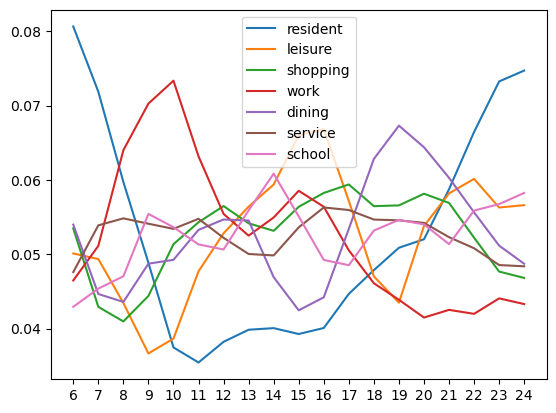

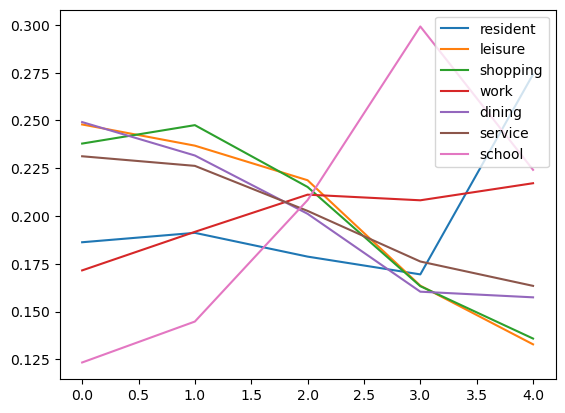

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16926/16926 [04:28<00:00, 63.04it/s]


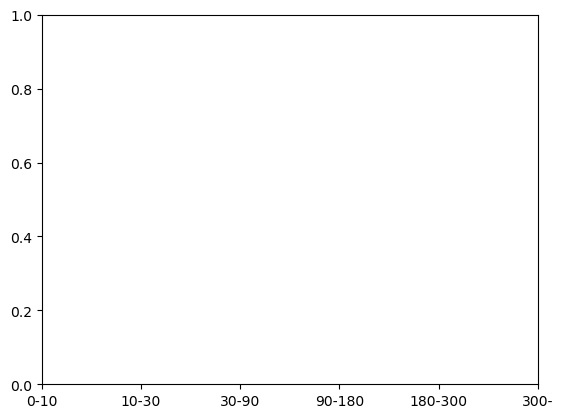

In [36]:
useinferpois, candidateplaces, pd_visittime_paras, pd_duration_paras = run_semantic(point_poi, poly_poi, StP)


  0%|                                                                                                                                                                             | 0/17402 [00:00<?, ?it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|                                                                                                                                                                   | 7/17402 [00:03<2:39:19,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▏                                                                                                                                                                 | 14/17402 [00:07<2:36:09,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▏                                                                                                                                                                 | 21/17402 [00:11<3:00:51,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▎                                                                                                                                                                 | 28/17402 [00:15<3:02:54,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▎                                                                                                                                                                 | 35/17402 [00:20<3:03:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▍                                                                                                                                                                 | 42/17402 [00:24<3:01:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▍                                                                                                                                                                 | 49/17402 [00:29<3:10:00,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▌                                                                                                                                                                 | 56/17402 [00:34<3:10:33,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▌                                                                                                                                                                 | 64/17402 [00:39<3:00:50,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▋                                                                                                                                                                 | 71/17402 [00:43<3:03:55,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  0%|▊                                                                                                                                                                 | 81/17402 [00:49<3:00:13,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|▊                                                                                                                                                                 | 90/17402 [00:55<2:56:06,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|▉                                                                                                                                                                | 100/17402 [01:01<2:54:39,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█                                                                                                                                                                | 110/17402 [01:07<2:55:00,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█                                                                                                                                                                | 117/17402 [01:11<3:00:21,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▏                                                                                                                                                               | 127/17402 [01:17<2:55:41,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▏                                                                                                                                                               | 134/17402 [01:22<3:00:01,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▎                                                                                                                                                               | 141/17402 [01:26<3:01:23,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▍                                                                                                                                                               | 153/17402 [01:33<2:46:54,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▍                                                                                                                                                               | 160/17402 [01:37<3:00:00,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▌                                                                                                                                                               | 168/17402 [01:42<2:57:02,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▋                                                                                                                                                               | 176/17402 [01:47<2:59:16,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▋                                                                                                                                                               | 184/17402 [01:52<3:01:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▊                                                                                                                                                               | 192/17402 [01:57<3:02:12,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▊                                                                                                                                                               | 199/17402 [02:01<2:59:58,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▉                                                                                                                                                               | 206/17402 [02:06<3:03:44,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|█▉                                                                                                                                                               | 213/17402 [02:10<3:01:08,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██                                                                                                                                                               | 220/17402 [02:15<3:01:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██                                                                                                                                                               | 227/17402 [02:19<3:01:48,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██▏                                                                                                                                                              | 234/17402 [02:24<2:58:20,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██▏                                                                                                                                                              | 241/17402 [02:28<3:01:50,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██▎                                                                                                                                                              | 248/17402 [02:33<3:10:03,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  1%|██▎                                                                                                                                                              | 255/17402 [02:37<2:59:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▍                                                                                                                                                              | 263/17402 [02:42<3:01:19,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▍                                                                                                                                                              | 270/17402 [02:46<3:00:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▌                                                                                                                                                              | 279/17402 [02:52<2:53:41,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▋                                                                                                                                                              | 288/17402 [02:58<2:58:04,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▋                                                                                                                                                              | 295/17402 [03:02<3:01:35,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▊                                                                                                                                                              | 302/17402 [03:06<2:58:30,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▊                                                                                                                                                              | 309/17402 [03:11<3:02:21,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▉                                                                                                                                                              | 317/17402 [03:16<3:00:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|██▉                                                                                                                                                              | 324/17402 [03:20<2:59:41,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███                                                                                                                                                              | 331/17402 [03:25<2:59:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▏                                                                                                                                                             | 338/17402 [03:29<3:00:04,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▏                                                                                                                                                             | 345/17402 [03:34<2:58:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▎                                                                                                                                                             | 353/17402 [03:39<2:50:44,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▎                                                                                                                                                             | 361/17402 [03:43<2:42:04,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▍                                                                                                                                                             | 368/17402 [03:47<3:00:33,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▍                                                                                                                                                             | 375/17402 [03:51<2:57:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▌                                                                                                                                                             | 382/17402 [03:56<3:00:23,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▌                                                                                                                                                             | 389/17402 [04:00<2:57:49,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▋                                                                                                                                                             | 396/17402 [04:05<2:59:52,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▋                                                                                                                                                             | 403/17402 [04:09<2:58:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▊                                                                                                                                                             | 411/17402 [04:14<2:55:51,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▊                                                                                                                                                             | 418/17402 [04:19<2:58:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▉                                                                                                                                                             | 425/17402 [04:23<2:59:22,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  2%|███▉                                                                                                                                                             | 432/17402 [04:27<3:01:42,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████                                                                                                                                                             | 440/17402 [04:33<3:04:56,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▏                                                                                                                                                            | 447/17402 [04:37<3:00:14,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▎                                                                                                                                                            | 461/17402 [04:44<2:46:11,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▎                                                                                                                                                            | 469/17402 [04:49<2:43:31,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▍                                                                                                                                                            | 476/17402 [04:54<2:55:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▍                                                                                                                                                            | 485/17402 [04:59<2:53:43,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▌                                                                                                                                                            | 493/17402 [05:04<2:51:09,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▋                                                                                                                                                            | 500/17402 [05:08<2:57:36,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▋                                                                                                                                                            | 507/17402 [05:13<2:58:43,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▊                                                                                                                                                            | 515/17402 [05:18<2:57:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▊                                                                                                                                                            | 523/17402 [05:23<2:53:56,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▉                                                                                                                                                            | 531/17402 [05:28<2:53:22,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|████▉                                                                                                                                                            | 540/17402 [05:34<3:00:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████                                                                                                                                                            | 547/17402 [05:38<3:00:43,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▏                                                                                                                                                           | 556/17402 [05:44<2:50:51,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▏                                                                                                                                                           | 563/17402 [05:48<2:56:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▎                                                                                                                                                           | 574/17402 [05:55<2:46:44,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▍                                                                                                                                                           | 584/17402 [06:01<2:51:19,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▍                                                                                                                                                           | 592/17402 [06:06<2:56:26,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  3%|█████▌                                                                                                                                                           | 602/17402 [06:12<2:51:06,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|█████▋                                                                                                                                                           | 611/17402 [06:17<2:35:07,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|█████▊                                                                                                                                                           | 623/17402 [06:24<2:42:34,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|█████▉                                                                                                                                                           | 636/17402 [06:32<2:57:23,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|█████▉                                                                                                                                                           | 645/17402 [06:38<2:50:39,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████                                                                                                                                                           | 657/17402 [06:45<2:57:46,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▏                                                                                                                                                          | 670/17402 [06:53<2:29:59,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▎                                                                                                                                                          | 683/17402 [07:01<2:48:36,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▍                                                                                                                                                          | 693/17402 [07:07<2:52:29,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▍                                                                                                                                                          | 702/17402 [07:13<2:50:21,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▋                                                                                                                                                          | 720/17402 [07:24<2:42:47,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▊                                                                                                                                                          | 736/17402 [07:33<2:45:09,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▉                                                                                                                                                          | 748/17402 [07:40<2:53:25,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|██████▉                                                                                                                                                          | 755/17402 [07:45<2:56:48,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|███████▏                                                                                                                                                         | 771/17402 [07:55<2:50:41,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  4%|███████▏                                                                                                                                                         | 780/17402 [08:00<2:52:28,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▎                                                                                                                                                         | 792/17402 [08:08<2:48:28,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▍                                                                                                                                                         | 805/17402 [08:15<2:50:01,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▌                                                                                                                                                         | 814/17402 [08:21<2:54:19,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▌                                                                                                                                                         | 821/17402 [08:26<3:00:23,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▋                                                                                                                                                         | 829/17402 [08:30<2:48:42,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▊                                                                                                                                                         | 844/17402 [08:40<2:53:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▉                                                                                                                                                         | 852/17402 [08:44<2:42:17,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|███████▉                                                                                                                                                         | 859/17402 [08:49<2:55:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████                                                                                                                                                         | 866/17402 [08:53<2:55:13,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████                                                                                                                                                         | 873/17402 [08:58<2:56:09,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▏                                                                                                                                                        | 880/17402 [09:02<2:52:10,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▏                                                                                                                                                        | 887/17402 [09:06<3:01:17,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▎                                                                                                                                                        | 895/17402 [09:11<2:52:47,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▎                                                                                                                                                        | 902/17402 [09:16<2:59:14,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▍                                                                                                                                                        | 909/17402 [09:20<2:54:46,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▍                                                                                                                                                        | 916/17402 [09:25<2:53:32,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▌                                                                                                                                                        | 923/17402 [09:29<2:54:11,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▌                                                                                                                                                        | 930/17402 [09:34<2:51:58,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▋                                                                                                                                                        | 937/17402 [09:38<2:52:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▋                                                                                                                                                        | 944/17402 [09:43<2:54:17,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  5%|████████▊                                                                                                                                                        | 951/17402 [09:47<2:55:48,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|████████▊                                                                                                                                                        | 958/17402 [09:51<2:52:42,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|████████▉                                                                                                                                                        | 965/17402 [09:56<2:53:57,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|████████▉                                                                                                                                                        | 972/17402 [10:00<2:52:46,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████                                                                                                                                                        | 980/17402 [10:05<2:52:46,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▏                                                                                                                                                       | 987/17402 [10:10<2:51:57,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▏                                                                                                                                                       | 995/17402 [10:15<2:49:11,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▏                                                                                                                                                      | 1002/17402 [10:19<2:52:16,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▎                                                                                                                                                      | 1009/17402 [10:24<2:48:53,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▎                                                                                                                                                      | 1016/17402 [10:28<2:59:41,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▍                                                                                                                                                      | 1024/17402 [10:33<2:57:15,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▍                                                                                                                                                      | 1033/17402 [10:39<2:56:27,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▌                                                                                                                                                      | 1041/17402 [10:44<2:52:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▋                                                                                                                                                      | 1050/17402 [10:50<2:45:39,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▋                                                                                                                                                      | 1059/17402 [10:56<2:54:00,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▊                                                                                                                                                      | 1067/17402 [11:01<2:54:03,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▊                                                                                                                                                      | 1074/17402 [11:05<2:51:34,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|█████████▉                                                                                                                                                      | 1084/17402 [11:11<2:50:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████                                                                                                                                                      | 1094/17402 [11:17<2:46:49,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▏                                                                                                                                                     | 1102/17402 [11:22<2:46:13,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▏                                                                                                                                                     | 1109/17402 [11:27<2:52:45,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▎                                                                                                                                                     | 1116/17402 [11:31<2:51:05,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▎                                                                                                                                                     | 1123/17402 [11:36<2:50:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  6%|██████████▍                                                                                                                                                     | 1130/17402 [11:40<2:50:48,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▍                                                                                                                                                     | 1137/17402 [11:44<2:32:34,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▌                                                                                                                                                     | 1144/17402 [11:48<2:49:27,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▌                                                                                                                                                     | 1152/17402 [11:53<2:48:23,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▋                                                                                                                                                     | 1161/17402 [11:59<2:49:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▋                                                                                                                                                     | 1168/17402 [12:03<2:51:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▊                                                                                                                                                     | 1175/17402 [12:08<2:51:19,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▉                                                                                                                                                     | 1183/17402 [12:13<2:48:45,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|██████████▉                                                                                                                                                     | 1191/17402 [12:18<2:52:27,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████                                                                                                                                                     | 1204/17402 [12:25<2:10:09,  2.07it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▏                                                                                                                                                    | 1211/17402 [12:30<2:50:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▏                                                                                                                                                    | 1218/17402 [12:35<2:53:43,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▎                                                                                                                                                    | 1225/17402 [12:39<2:51:17,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▎                                                                                                                                                    | 1233/17402 [12:44<2:56:12,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▍                                                                                                                                                    | 1240/17402 [12:49<2:53:58,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▍                                                                                                                                                    | 1247/17402 [12:53<2:52:42,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▌                                                                                                                                                    | 1255/17402 [12:58<2:49:00,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▌                                                                                                                                                    | 1262/17402 [13:03<2:49:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▋                                                                                                                                                    | 1270/17402 [13:08<2:45:27,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▋                                                                                                                                                    | 1277/17402 [13:12<2:51:07,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▊                                                                                                                                                    | 1284/17402 [13:17<2:49:18,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▊                                                                                                                                                    | 1291/17402 [13:21<2:51:41,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  7%|███████████▉                                                                                                                                                    | 1300/17402 [13:27<2:47:08,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████                                                                                                                                                    | 1307/17402 [13:31<2:57:52,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████                                                                                                                                                    | 1315/17402 [13:36<2:46:32,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▏                                                                                                                                                   | 1323/17402 [13:41<2:46:48,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▏                                                                                                                                                   | 1330/17402 [13:46<2:49:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▎                                                                                                                                                   | 1337/17402 [13:50<2:48:18,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▎                                                                                                                                                   | 1344/17402 [13:55<2:53:32,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▍                                                                                                                                                   | 1351/17402 [13:59<2:50:01,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▌                                                                                                                                                   | 1360/17402 [14:05<2:39:44,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▌                                                                                                                                                   | 1367/17402 [14:09<2:47:32,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▋                                                                                                                                                   | 1374/17402 [14:13<2:49:59,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▋                                                                                                                                                   | 1381/17402 [14:18<2:46:27,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▊                                                                                                                                                   | 1388/17402 [14:22<2:51:30,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▊                                                                                                                                                   | 1395/17402 [14:27<2:50:04,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▉                                                                                                                                                   | 1403/17402 [14:32<2:53:06,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|████████████▉                                                                                                                                                   | 1410/17402 [14:36<2:52:33,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████                                                                                                                                                   | 1417/17402 [14:41<2:50:52,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████                                                                                                                                                   | 1424/17402 [14:45<2:47:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▏                                                                                                                                                  | 1432/17402 [14:50<2:47:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▏                                                                                                                                                  | 1439/17402 [14:55<2:47:02,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▎                                                                                                                                                  | 1446/17402 [14:59<2:48:11,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▎                                                                                                                                                  | 1453/17402 [15:04<2:50:57,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▍                                                                                                                                                  | 1460/17402 [15:08<2:48:41,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▍                                                                                                                                                  | 1467/17402 [15:13<2:48:47,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  8%|█████████████▌                                                                                                                                                  | 1474/17402 [15:17<2:35:19,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▌                                                                                                                                                  | 1481/17402 [15:21<2:50:22,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▋                                                                                                                                                  | 1489/17402 [15:26<2:50:32,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▊                                                                                                                                                  | 1496/17402 [15:31<2:48:17,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▊                                                                                                                                                  | 1503/17402 [15:35<2:47:43,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▉                                                                                                                                                  | 1510/17402 [15:40<2:46:41,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|█████████████▉                                                                                                                                                  | 1517/17402 [15:44<2:46:53,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████                                                                                                                                                  | 1524/17402 [15:48<2:46:12,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████                                                                                                                                                  | 1531/17402 [15:53<2:47:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▏                                                                                                                                                 | 1539/17402 [15:58<2:44:14,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▏                                                                                                                                                 | 1546/17402 [16:02<2:48:10,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▎                                                                                                                                                 | 1553/17402 [16:07<2:47:22,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▎                                                                                                                                                 | 1560/17402 [16:11<2:46:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▍                                                                                                                                                 | 1567/17402 [16:16<2:47:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▍                                                                                                                                                 | 1574/17402 [16:20<2:46:22,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▌                                                                                                                                                 | 1584/17402 [16:26<2:42:08,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▋                                                                                                                                                 | 1593/17402 [16:32<2:49:06,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▋                                                                                                                                                 | 1602/17402 [16:38<2:42:18,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▊                                                                                                                                                 | 1609/17402 [16:42<2:47:34,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▊                                                                                                                                                 | 1616/17402 [16:46<2:46:04,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|██████████████▉                                                                                                                                                 | 1625/17402 [16:52<2:44:00,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|███████████████                                                                                                                                                 | 1632/17402 [16:57<2:46:28,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|███████████████                                                                                                                                                 | 1639/17402 [17:01<2:49:45,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|███████████████▏                                                                                                                                                | 1646/17402 [17:05<2:45:28,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

  9%|███████████████▏                                                                                                                                                | 1653/17402 [17:10<2:46:33,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▎                                                                                                                                                | 1660/17402 [17:14<2:46:36,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▎                                                                                                                                                | 1667/17402 [17:19<2:46:43,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▍                                                                                                                                                | 1674/17402 [17:23<2:46:35,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▍                                                                                                                                                | 1681/17402 [17:28<2:44:17,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▌                                                                                                                                                | 1688/17402 [17:32<2:45:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▌                                                                                                                                                | 1695/17402 [17:36<2:46:53,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▋                                                                                                                                                | 1702/17402 [17:41<2:46:05,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▋                                                                                                                                                | 1711/17402 [17:47<2:45:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▊                                                                                                                                                | 1718/17402 [17:51<2:46:39,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▊                                                                                                                                                | 1725/17402 [17:55<2:44:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▉                                                                                                                                                | 1732/17402 [18:00<2:44:46,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|███████████████▉                                                                                                                                                | 1739/17402 [18:04<2:45:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████                                                                                                                                                | 1752/17402 [18:12<2:30:03,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▏                                                                                                                                               | 1759/17402 [18:16<2:39:14,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▏                                                                                                                                               | 1766/17402 [18:20<2:45:13,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▎                                                                                                                                               | 1775/17402 [18:26<2:39:13,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▍                                                                                                                                               | 1783/17402 [18:31<2:40:54,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▍                                                                                                                                               | 1793/17402 [18:37<2:43:10,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▌                                                                                                                                               | 1800/17402 [18:42<2:47:06,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▋                                                                                                                                               | 1809/17402 [18:48<2:41:07,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▋                                                                                                                                               | 1817/17402 [18:53<2:44:04,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 10%|████████████████▊                                                                                                                                               | 1826/17402 [18:58<2:44:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|████████████████▊                                                                                                                                               | 1834/17402 [19:03<2:44:31,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|████████████████▉                                                                                                                                               | 1841/17402 [19:08<2:43:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|████████████████▉                                                                                                                                               | 1848/17402 [19:12<2:47:24,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████                                                                                                                                               | 1855/17402 [19:17<2:45:11,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████                                                                                                                                               | 1862/17402 [19:21<2:43:33,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▏                                                                                                                                              | 1870/17402 [19:26<2:39:47,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▎                                                                                                                                              | 1878/17402 [19:31<2:43:07,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▎                                                                                                                                              | 1885/17402 [19:35<2:43:34,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▍                                                                                                                                              | 1892/17402 [19:40<2:43:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▍                                                                                                                                              | 1900/17402 [19:45<2:40:35,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▌                                                                                                                                              | 1907/17402 [19:49<2:43:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▌                                                                                                                                              | 1916/17402 [19:55<2:42:49,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▋                                                                                                                                              | 1923/17402 [19:59<2:42:03,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▋                                                                                                                                              | 1930/17402 [20:04<2:43:47,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▊                                                                                                                                              | 1937/17402 [20:08<2:45:32,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▊                                                                                                                                              | 1944/17402 [20:13<2:47:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|█████████████████▉                                                                                                                                              | 1953/17402 [20:18<2:46:01,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████                                                                                                                                              | 1960/17402 [20:23<2:52:31,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████                                                                                                                                              | 1968/17402 [20:28<2:47:30,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████▏                                                                                                                                             | 1975/17402 [20:33<2:54:37,  1.47it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████▏                                                                                                                                             | 1983/17402 [20:37<2:38:19,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 11%|██████████████████▎                                                                                                                                             | 1994/17402 [20:44<2:36:17,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▍                                                                                                                                             | 2002/17402 [20:49<2:39:01,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▍                                                                                                                                             | 2010/17402 [20:54<2:40:55,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▌                                                                                                                                             | 2017/17402 [20:59<2:41:08,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▌                                                                                                                                             | 2024/17402 [21:03<2:43:11,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▋                                                                                                                                             | 2033/17402 [21:09<2:36:44,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▊                                                                                                                                             | 2041/17402 [21:14<2:39:18,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▊                                                                                                                                             | 2052/17402 [21:20<2:18:07,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|██████████████████▉                                                                                                                                             | 2062/17402 [21:26<2:26:49,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████                                                                                                                                             | 2069/17402 [21:30<2:38:06,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████                                                                                                                                             | 2078/17402 [21:36<2:36:08,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▏                                                                                                                                            | 2088/17402 [21:42<2:40:05,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▎                                                                                                                                            | 2095/17402 [21:46<2:42:17,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▎                                                                                                                                            | 2102/17402 [21:51<2:43:31,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▍                                                                                                                                            | 2109/17402 [21:55<2:48:29,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▍                                                                                                                                            | 2116/17402 [22:00<2:44:14,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▌                                                                                                                                            | 2123/17402 [22:04<2:39:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▌                                                                                                                                            | 2130/17402 [22:09<2:40:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▋                                                                                                                                            | 2139/17402 [22:14<2:37:02,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▋                                                                                                                                            | 2146/17402 [22:18<2:38:42,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▊                                                                                                                                            | 2153/17402 [22:23<2:42:08,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▊                                                                                                                                            | 2161/17402 [22:28<2:39:30,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 12%|███████████████████▉                                                                                                                                            | 2168/17402 [22:33<2:51:35,  1.48it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████                                                                                                                                            | 2176/17402 [22:38<2:40:59,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████                                                                                                                                            | 2183/17402 [22:42<2:40:00,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▏                                                                                                                                           | 2190/17402 [22:47<2:42:29,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▏                                                                                                                                           | 2197/17402 [22:51<2:40:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▎                                                                                                                                           | 2204/17402 [22:56<2:41:03,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▎                                                                                                                                           | 2212/17402 [23:01<2:38:31,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▍                                                                                                                                           | 2219/17402 [23:05<2:40:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▍                                                                                                                                           | 2226/17402 [23:09<2:43:39,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▌                                                                                                                                           | 2233/17402 [23:14<2:43:46,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▌                                                                                                                                           | 2240/17402 [23:18<2:41:21,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▋                                                                                                                                           | 2247/17402 [23:23<2:41:50,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▋                                                                                                                                           | 2254/17402 [23:27<2:45:09,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▊                                                                                                                                           | 2261/17402 [23:32<2:41:31,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▊                                                                                                                                           | 2268/17402 [23:36<2:39:56,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▉                                                                                                                                           | 2275/17402 [23:41<2:40:10,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|████████████████████▉                                                                                                                                           | 2283/17402 [23:46<2:46:47,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████                                                                                                                                           | 2290/17402 [23:50<2:43:36,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████                                                                                                                                           | 2297/17402 [23:55<2:40:10,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▏                                                                                                                                          | 2305/17402 [24:00<2:36:54,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▎                                                                                                                                          | 2313/17402 [24:05<2:37:07,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▎                                                                                                                                          | 2320/17402 [24:09<2:38:36,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▍                                                                                                                                          | 2327/17402 [24:14<2:39:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▍                                                                                                                                          | 2334/17402 [24:18<2:37:18,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▌                                                                                                                                          | 2342/17402 [24:23<2:40:40,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 13%|█████████████████████▌                                                                                                                                          | 2349/17402 [24:28<2:42:43,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▋                                                                                                                                          | 2357/17402 [24:33<2:48:18,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▋                                                                                                                                          | 2364/17402 [24:38<2:38:43,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▊                                                                                                                                          | 2371/17402 [24:42<2:37:48,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▊                                                                                                                                          | 2379/17402 [24:47<2:05:09,  2.00it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|█████████████████████▉                                                                                                                                          | 2389/17402 [24:52<2:32:59,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████                                                                                                                                          | 2396/17402 [24:57<2:42:25,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████                                                                                                                                          | 2403/17402 [25:01<2:49:28,  1.48it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▏                                                                                                                                         | 2410/17402 [25:06<2:47:48,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▏                                                                                                                                         | 2417/17402 [25:10<2:40:00,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▎                                                                                                                                         | 2424/17402 [25:15<2:39:04,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▎                                                                                                                                         | 2431/17402 [25:19<2:39:01,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▍                                                                                                                                         | 2438/17402 [25:24<2:38:24,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▍                                                                                                                                         | 2445/17402 [25:28<2:38:54,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▌                                                                                                                                         | 2452/17402 [25:33<2:37:23,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▌                                                                                                                                         | 2459/17402 [25:37<2:37:15,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▋                                                                                                                                         | 2467/17402 [25:42<2:33:25,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▋                                                                                                                                         | 2474/17402 [25:47<2:38:10,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▊                                                                                                                                         | 2482/17402 [25:52<2:33:06,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▉                                                                                                                                         | 2491/17402 [25:57<2:34:13,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|██████████████████████▉                                                                                                                                         | 2498/17402 [26:02<2:37:46,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|███████████████████████                                                                                                                                         | 2505/17402 [26:06<2:38:23,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|███████████████████████                                                                                                                                         | 2512/17402 [26:11<2:38:34,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 14%|███████████████████████▏                                                                                                                                        | 2519/17402 [26:15<2:36:06,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▏                                                                                                                                        | 2527/17402 [26:20<2:33:31,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▎                                                                                                                                        | 2534/17402 [26:24<2:32:43,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▎                                                                                                                                        | 2541/17402 [26:29<2:42:52,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▍                                                                                                                                        | 2548/17402 [26:34<2:44:07,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▌                                                                                                                                        | 2556/17402 [26:39<2:39:59,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▌                                                                                                                                        | 2563/17402 [26:43<2:34:56,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▋                                                                                                                                        | 2572/17402 [26:49<2:34:30,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▋                                                                                                                                        | 2579/17402 [26:53<2:34:57,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▊                                                                                                                                        | 2586/17402 [26:58<2:36:13,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▊                                                                                                                                        | 2594/17402 [27:03<2:35:41,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▉                                                                                                                                        | 2602/17402 [27:08<2:35:23,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|███████████████████████▉                                                                                                                                        | 2609/17402 [27:12<2:36:52,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████                                                                                                                                        | 2617/17402 [27:17<2:37:57,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▏                                                                                                                                       | 2624/17402 [27:22<2:35:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▏                                                                                                                                       | 2631/17402 [27:26<2:36:13,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▎                                                                                                                                       | 2638/17402 [27:31<2:36:16,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▎                                                                                                                                       | 2645/17402 [27:35<2:36:59,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▍                                                                                                                                       | 2652/17402 [27:39<2:36:32,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▍                                                                                                                                       | 2659/17402 [27:44<2:34:40,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▌                                                                                                                                       | 2666/17402 [27:48<2:40:11,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▌                                                                                                                                       | 2673/17402 [27:53<2:41:54,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▋                                                                                                                                       | 2680/17402 [27:58<2:35:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▋                                                                                                                                       | 2687/17402 [28:02<2:37:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 15%|████████████████████████▊                                                                                                                                       | 2694/17402 [28:07<2:39:22,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|████████████████████████▊                                                                                                                                       | 2701/17402 [28:11<2:34:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|████████████████████████▉                                                                                                                                       | 2708/17402 [28:15<2:36:03,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|████████████████████████▉                                                                                                                                       | 2715/17402 [28:20<2:34:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████                                                                                                                                       | 2723/17402 [28:25<2:29:00,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████                                                                                                                                       | 2730/17402 [28:29<2:39:26,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▏                                                                                                                                      | 2737/17402 [28:34<2:36:13,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▏                                                                                                                                      | 2744/17402 [28:38<2:35:24,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▎                                                                                                                                      | 2751/17402 [28:43<2:35:53,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▎                                                                                                                                      | 2758/17402 [28:47<2:38:01,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▍                                                                                                                                      | 2765/17402 [28:52<2:36:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▌                                                                                                                                      | 2775/17402 [28:58<2:29:39,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▌                                                                                                                                      | 2782/17402 [29:02<2:34:18,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▋                                                                                                                                      | 2791/17402 [29:08<2:24:45,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▋                                                                                                                                      | 2798/17402 [29:12<2:35:25,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▊                                                                                                                                      | 2809/17402 [29:19<2:19:08,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▉                                                                                                                                      | 2817/17402 [29:23<2:31:13,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|█████████████████████████▉                                                                                                                                      | 2824/17402 [29:28<2:36:50,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████                                                                                                                                      | 2836/17402 [29:34<2:09:21,  1.88it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████▏                                                                                                                                     | 2843/17402 [29:38<2:33:47,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████▏                                                                                                                                     | 2855/17402 [29:45<2:26:43,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████▎                                                                                                                                     | 2863/17402 [29:50<2:20:07,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 16%|██████████████████████████▍                                                                                                                                     | 2870/17402 [29:54<2:31:49,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▍                                                                                                                                     | 2879/17402 [30:00<2:29:08,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▌                                                                                                                                     | 2888/17402 [30:05<2:30:43,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▋                                                                                                                                     | 2898/17402 [30:11<2:16:13,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▋                                                                                                                                     | 2905/17402 [30:15<2:32:36,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▊                                                                                                                                     | 2913/17402 [30:20<2:26:50,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▉                                                                                                                                     | 2924/17402 [30:26<2:22:48,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|██████████████████████████▉                                                                                                                                     | 2931/17402 [30:31<2:40:37,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████                                                                                                                                     | 2943/17402 [30:39<2:26:08,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████                                                                                                                                     | 2950/17402 [30:43<2:33:24,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▏                                                                                                                                    | 2959/17402 [30:49<2:25:56,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▎                                                                                                                                    | 2967/17402 [30:54<2:31:08,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▎                                                                                                                                    | 2975/17402 [30:59<2:30:44,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▍                                                                                                                                    | 2982/17402 [31:03<2:32:18,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▍                                                                                                                                    | 2989/17402 [31:08<2:34:03,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▌                                                                                                                                    | 2999/17402 [31:14<2:28:59,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▋                                                                                                                                    | 3006/17402 [31:18<2:32:01,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▋                                                                                                                                    | 3013/17402 [31:23<2:31:12,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▊                                                                                                                                    | 3022/17402 [31:28<2:28:43,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▊                                                                                                                                    | 3030/17402 [31:34<2:29:06,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 17%|███████████████████████████▉                                                                                                                                    | 3039/17402 [31:39<2:28:57,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████                                                                                                                                    | 3046/17402 [31:43<2:28:52,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████                                                                                                                                    | 3053/17402 [31:48<2:31:46,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▏                                                                                                                                   | 3060/17402 [31:52<2:31:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▏                                                                                                                                   | 3067/17402 [31:57<2:30:30,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▎                                                                                                                                   | 3074/17402 [32:01<2:30:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▎                                                                                                                                   | 3081/17402 [32:06<2:29:43,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▍                                                                                                                                   | 3088/17402 [32:10<2:31:12,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▍                                                                                                                                   | 3095/17402 [32:15<2:29:13,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▌                                                                                                                                   | 3102/17402 [32:19<2:28:41,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▌                                                                                                                                   | 3109/17402 [32:23<2:31:39,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▋                                                                                                                                   | 3116/17402 [32:28<2:32:38,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▋                                                                                                                                   | 3123/17402 [32:32<2:39:39,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▊                                                                                                                                   | 3130/17402 [32:37<2:39:34,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▊                                                                                                                                   | 3137/17402 [32:42<2:33:01,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▉                                                                                                                                   | 3144/17402 [32:46<2:29:28,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|████████████████████████████▉                                                                                                                                   | 3151/17402 [32:51<2:32:47,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████                                                                                                                                   | 3163/17402 [32:58<2:19:17,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▏                                                                                                                                  | 3173/17402 [33:03<2:20:28,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▎                                                                                                                                  | 3184/17402 [33:10<2:31:39,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▎                                                                                                                                  | 3194/17402 [33:16<2:24:08,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▍                                                                                                                                  | 3208/17402 [33:25<2:27:49,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 18%|█████████████████████████████▌                                                                                                                                  | 3216/17402 [33:30<2:27:03,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▋                                                                                                                                  | 3223/17402 [33:34<2:28:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▋                                                                                                                                  | 3232/17402 [33:40<2:29:55,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▊                                                                                                                                  | 3239/17402 [33:44<2:29:54,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▊                                                                                                                                  | 3247/17402 [33:49<2:26:14,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|█████████████████████████████▉                                                                                                                                  | 3255/17402 [33:53<2:05:13,  1.88it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████                                                                                                                                  | 3263/17402 [33:58<2:28:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████                                                                                                                                  | 3270/17402 [34:03<2:30:16,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▏                                                                                                                                 | 3277/17402 [34:07<2:27:39,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▏                                                                                                                                 | 3285/17402 [34:12<2:29:40,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▎                                                                                                                                 | 3292/17402 [34:17<2:36:02,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▎                                                                                                                                 | 3299/17402 [34:21<2:32:04,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▍                                                                                                                                 | 3306/17402 [34:26<2:29:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▍                                                                                                                                 | 3313/17402 [34:30<2:34:33,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▌                                                                                                                                 | 3320/17402 [34:35<2:36:27,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▌                                                                                                                                 | 3327/17402 [34:39<2:29:06,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▋                                                                                                                                 | 3334/17402 [34:44<2:27:53,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▋                                                                                                                                 | 3341/17402 [34:48<2:26:50,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 19%|██████████████████████████████▊                                                                                                                                 | 3350/17402 [34:54<2:22:41,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▏                                                                                                                                | 3397/17402 [35:15<1:42:41,  2.27it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▎                                                                                                                                | 3409/17402 [35:23<2:22:34,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▍                                                                                                                                | 3426/17402 [35:33<2:26:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▌                                                                                                                                | 3433/17402 [35:37<2:27:19,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▋                                                                                                                                | 3441/17402 [35:42<2:10:52,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▋                                                                                                                                | 3448/17402 [35:46<2:18:43,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▊                                                                                                                                | 3459/17402 [35:53<2:17:48,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▉                                                                                                                                | 3467/17402 [35:58<2:23:21,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|███████████████████████████████▉                                                                                                                                | 3474/17402 [36:03<2:25:47,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████                                                                                                                                | 3481/17402 [36:07<2:26:40,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████                                                                                                                                | 3490/17402 [36:13<2:10:35,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▏                                                                                                                               | 3499/17402 [36:18<2:14:01,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▏                                                                                                                               | 3507/17402 [36:23<2:29:30,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▎                                                                                                                               | 3516/17402 [36:28<2:20:52,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▍                                                                                                                               | 3527/17402 [36:35<2:25:53,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▌                                                                                                                               | 3537/17402 [36:41<2:23:30,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▌                                                                                                                               | 3545/17402 [36:46<2:26:50,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▋                                                                                                                               | 3556/17402 [36:53<2:20:18,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 20%|████████████████████████████████▊                                                                                                                               | 3564/17402 [36:58<2:19:58,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|████████████████████████████████▊                                                                                                                               | 3572/17402 [37:03<2:21:23,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|████████████████████████████████▉                                                                                                                               | 3580/17402 [37:08<2:24:42,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|████████████████████████████████▉                                                                                                                               | 3588/17402 [37:13<2:25:17,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████                                                                                                                               | 3595/17402 [37:17<2:28:00,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▏                                                                                                                              | 3603/17402 [37:22<2:07:21,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▏                                                                                                                              | 3612/17402 [37:27<2:15:19,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▎                                                                                                                              | 3624/17402 [37:34<1:40:06,  2.29it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▍                                                                                                                              | 3635/17402 [37:40<2:12:44,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▍                                                                                                                              | 3642/17402 [37:45<2:22:54,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▌                                                                                                                              | 3652/17402 [37:50<2:19:24,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▋                                                                                                                              | 3660/17402 [37:55<2:23:18,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▋                                                                                                                              | 3668/17402 [38:00<2:22:55,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▊                                                                                                                              | 3677/17402 [38:06<2:23:01,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▊                                                                                                                              | 3684/17402 [38:10<2:23:41,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|█████████████████████████████████▉                                                                                                                              | 3692/17402 [38:15<2:22:52,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████                                                                                                                              | 3701/17402 [38:21<2:20:32,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████                                                                                                                              | 3710/17402 [38:26<2:15:31,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████▏                                                                                                                             | 3718/17402 [38:31<2:26:45,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████▏                                                                                                                             | 3725/17402 [38:36<2:28:26,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████▎                                                                                                                             | 3733/17402 [38:41<2:27:35,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 21%|██████████████████████████████████▍                                                                                                                             | 3741/17402 [38:46<2:31:28,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▍                                                                                                                             | 3750/17402 [38:52<2:27:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▌                                                                                                                             | 3759/17402 [38:58<2:30:51,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▋                                                                                                                             | 3766/17402 [39:02<2:31:01,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▋                                                                                                                             | 3774/17402 [39:08<2:30:59,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▊                                                                                                                             | 3782/17402 [39:13<2:28:57,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▊                                                                                                                             | 3789/17402 [39:18<2:30:13,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▉                                                                                                                             | 3796/17402 [39:22<2:30:40,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|██████████████████████████████████▉                                                                                                                             | 3804/17402 [39:27<2:27:35,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████                                                                                                                             | 3812/17402 [39:33<2:28:26,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████                                                                                                                             | 3819/17402 [39:37<2:30:50,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▏                                                                                                                            | 3826/17402 [39:42<2:24:19,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▏                                                                                                                            | 3833/17402 [39:46<2:24:50,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▎                                                                                                                            | 3842/17402 [39:52<2:20:33,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▍                                                                                                                            | 3849/17402 [39:56<2:22:01,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▍                                                                                                                            | 3859/17402 [40:02<2:12:19,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▌                                                                                                                            | 3866/17402 [40:07<2:21:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▋                                                                                                                            | 3875/17402 [40:12<2:19:29,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▋                                                                                                                            | 3883/17402 [40:17<2:20:38,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▊                                                                                                                            | 3900/17402 [40:27<2:00:11,  1.87it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 22%|███████████████████████████████████▉                                                                                                                            | 3909/17402 [40:32<2:26:10,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████                                                                                                                            | 3917/17402 [40:38<2:21:33,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████                                                                                                                            | 3924/17402 [40:42<2:26:49,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▏                                                                                                                           | 3932/17402 [40:47<2:19:16,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▏                                                                                                                           | 3939/17402 [40:51<2:21:16,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▎                                                                                                                           | 3949/17402 [40:58<2:15:57,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▍                                                                                                                           | 3958/17402 [41:03<2:18:21,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▍                                                                                                                           | 3968/17402 [41:09<2:17:58,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▌                                                                                                                           | 3980/17402 [41:17<2:17:16,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▋                                                                                                                           | 3989/17402 [41:22<2:17:06,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▊                                                                                                                           | 3999/17402 [41:28<2:23:55,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▊                                                                                                                           | 4006/17402 [41:33<2:23:34,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▉                                                                                                                           | 4013/17402 [41:37<2:20:56,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|████████████████████████████████████▉                                                                                                                           | 4022/17402 [41:43<2:18:37,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████                                                                                                                           | 4032/17402 [41:49<2:21:42,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▏                                                                                                                          | 4042/17402 [41:56<2:21:30,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▏                                                                                                                          | 4049/17402 [42:00<2:19:31,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▎                                                                                                                          | 4056/17402 [42:05<2:18:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▍                                                                                                                          | 4066/17402 [42:11<2:22:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▍                                                                                                                          | 4074/17402 [42:16<2:25:55,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 23%|█████████████████████████████████████▌                                                                                                                          | 4083/17402 [42:22<2:28:32,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|█████████████████████████████████████▌                                                                                                                          | 4092/17402 [42:28<2:19:12,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|█████████████████████████████████████▋                                                                                                                          | 4100/17402 [42:33<2:26:44,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|█████████████████████████████████████▊                                                                                                                          | 4111/17402 [42:40<2:15:11,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|█████████████████████████████████████▉                                                                                                                          | 4124/17402 [42:48<2:15:31,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████                                                                                                                          | 4138/17402 [42:56<2:13:08,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████                                                                                                                          | 4146/17402 [43:01<2:16:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▏                                                                                                                         | 4157/17402 [43:08<2:17:05,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▎                                                                                                                         | 4166/17402 [43:13<2:18:10,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▍                                                                                                                         | 4176/17402 [43:19<2:13:12,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▍                                                                                                                         | 4184/17402 [43:24<2:16:53,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▌                                                                                                                         | 4196/17402 [43:32<2:14:13,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▋                                                                                                                         | 4207/17402 [43:38<2:15:13,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|██████████████████████████████████████▉                                                                                                                         | 4235/17402 [43:51<2:12:57,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|███████████████████████████████████████                                                                                                                         | 4243/17402 [43:56<2:13:04,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|███████████████████████████████████████                                                                                                                         | 4251/17402 [44:01<2:12:49,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 24%|███████████████████████████████████████▏                                                                                                                        | 4262/17402 [44:08<2:13:34,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▎                                                                                                                        | 4273/17402 [44:15<2:13:28,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▎                                                                                                                        | 4282/17402 [44:20<2:13:20,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▍                                                                                                                        | 4292/17402 [44:26<2:16:11,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▌                                                                                                                        | 4300/17402 [44:32<2:26:01,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▌                                                                                                                        | 4308/17402 [44:37<2:23:24,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▋                                                                                                                        | 4318/17402 [44:43<2:19:17,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▊                                                                                                                        | 4328/17402 [44:49<2:09:40,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▊                                                                                                                        | 4335/17402 [44:54<2:15:38,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|███████████████████████████████████████▉                                                                                                                        | 4343/17402 [44:59<2:15:14,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████                                                                                                                        | 4351/17402 [45:04<2:15:28,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████                                                                                                                        | 4359/17402 [45:09<2:14:29,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▏                                                                                                                       | 4370/17402 [45:15<2:10:54,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▎                                                                                                                       | 4382/17402 [45:23<2:10:00,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▎                                                                                                                       | 4391/17402 [45:28<2:15:07,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▍                                                                                                                       | 4401/17402 [45:35<2:18:29,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▌                                                                                                                       | 4416/17402 [45:43<2:12:50,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 25%|████████████████████████████████████████▋                                                                                                                       | 4426/17402 [45:49<2:12:13,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|████████████████████████████████████████▊                                                                                                                       | 4438/17402 [45:57<2:08:39,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|████████████████████████████████████████▉                                                                                                                       | 4451/17402 [46:05<2:12:16,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████                                                                                                                       | 4467/17402 [46:14<2:11:42,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▏                                                                                                                      | 4478/17402 [46:21<2:16:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▎                                                                                                                      | 4487/17402 [46:26<2:10:04,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▍                                                                                                                      | 4501/17402 [46:35<2:19:32,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▍                                                                                                                      | 4511/17402 [46:42<2:19:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▌                                                                                                                      | 4522/17402 [46:49<2:12:24,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▋                                                                                                                      | 4529/17402 [46:53<2:13:19,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▋                                                                                                                      | 4537/17402 [46:58<2:11:55,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▊                                                                                                                      | 4553/17402 [47:07<2:10:18,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|█████████████████████████████████████████▉                                                                                                                      | 4560/17402 [47:12<2:19:27,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████                                                                                                                      | 4571/17402 [47:19<2:17:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████▏                                                                                                                     | 4583/17402 [47:27<2:13:36,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████▏                                                                                                                     | 4591/17402 [47:32<2:22:16,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████▎                                                                                                                     | 4599/17402 [47:37<2:20:21,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 26%|██████████████████████████████████████████▍                                                                                                                     | 4609/17402 [47:44<2:20:45,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▍                                                                                                                     | 4616/17402 [47:48<2:14:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▌                                                                                                                     | 4631/17402 [47:57<2:07:12,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▋                                                                                                                     | 4644/17402 [48:05<2:07:52,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▊                                                                                                                     | 4658/17402 [48:13<2:09:55,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|██████████████████████████████████████████▉                                                                                                                     | 4670/17402 [48:20<2:06:42,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████                                                                                                                     | 4677/17402 [48:24<2:09:05,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████                                                                                                                     | 4688/17402 [48:31<2:14:34,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▏                                                                                                                    | 4695/17402 [48:36<2:20:00,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▎                                                                                                                    | 4705/17402 [48:42<2:16:41,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▎                                                                                                                    | 4714/17402 [48:48<2:16:43,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▍                                                                                                                    | 4727/17402 [48:56<2:17:53,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▌                                                                                                                    | 4737/17402 [49:03<2:18:38,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▋                                                                                                                    | 4747/17402 [49:09<2:18:02,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▋                                                                                                                    | 4758/17402 [49:16<2:12:32,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▊                                                                                                                    | 4765/17402 [49:21<2:21:23,  1.49it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▉                                                                                                                    | 4774/17402 [49:26<2:17:14,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 27%|███████████████████████████████████████████▉                                                                                                                    | 4782/17402 [49:32<2:17:49,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████                                                                                                                    | 4791/17402 [49:37<2:11:28,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████                                                                                                                    | 4799/17402 [49:42<2:10:23,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▏                                                                                                                   | 4806/17402 [49:47<2:12:57,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▎                                                                                                                   | 4813/17402 [49:51<2:12:42,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▎                                                                                                                   | 4825/17402 [49:59<2:11:27,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▍                                                                                                                   | 4833/17402 [50:04<2:17:36,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▌                                                                                                                   | 4842/17402 [50:10<2:17:33,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▋                                                                                                                   | 4854/17402 [50:17<2:10:57,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▋                                                                                                                   | 4867/17402 [50:25<1:50:23,  1.89it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▊                                                                                                                   | 4880/17402 [50:33<2:15:30,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|████████████████████████████████████████████▉                                                                                                                   | 4888/17402 [50:39<2:17:46,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████                                                                                                                   | 4897/17402 [50:44<2:14:57,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████                                                                                                                   | 4904/17402 [50:49<2:12:38,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▏                                                                                                                  | 4914/17402 [50:54<2:01:58,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▎                                                                                                                  | 4923/17402 [51:00<2:06:34,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▎                                                                                                                  | 4932/17402 [51:05<2:05:10,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▍                                                                                                                  | 4944/17402 [51:12<2:01:22,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 28%|█████████████████████████████████████████████▌                                                                                                                  | 4953/17402 [51:18<2:07:28,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▌                                                                                                                  | 4961/17402 [51:22<2:05:01,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▋                                                                                                                  | 4971/17402 [51:29<2:06:48,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▊                                                                                                                  | 4982/17402 [51:35<2:07:32,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▊                                                                                                                  | 4989/17402 [51:40<2:10:09,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|█████████████████████████████████████████████▉                                                                                                                  | 4996/17402 [51:44<2:10:46,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████                                                                                                                  | 5012/17402 [51:52<1:44:10,  1.98it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▏                                                                                                                 | 5019/17402 [51:57<2:09:20,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▏                                                                                                                 | 5027/17402 [52:02<2:10:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▎                                                                                                                 | 5035/17402 [52:07<2:09:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▎                                                                                                                 | 5043/17402 [52:12<2:09:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▍                                                                                                                 | 5051/17402 [52:17<2:09:08,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▌                                                                                                                 | 5059/17402 [52:22<2:13:49,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▋                                                                                                                 | 5072/17402 [52:30<2:10:12,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▋                                                                                                                 | 5080/17402 [52:35<2:13:22,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▊                                                                                                                 | 5087/17402 [52:40<2:11:34,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▊                                                                                                                 | 5094/17402 [52:44<2:11:42,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▉                                                                                                                 | 5101/17402 [52:49<2:09:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|██████████████████████████████████████████████▉                                                                                                                 | 5108/17402 [52:53<2:10:09,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|███████████████████████████████████████████████                                                                                                                 | 5116/17402 [52:58<2:06:36,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|███████████████████████████████████████████████                                                                                                                 | 5123/17402 [53:03<2:08:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 29%|███████████████████████████████████████████████▏                                                                                                                | 5130/17402 [53:07<2:11:34,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▏                                                                                                                | 5138/17402 [53:12<2:08:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▎                                                                                                                | 5145/17402 [53:17<2:09:45,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▎                                                                                                                | 5152/17402 [53:21<2:09:43,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▍                                                                                                                | 5160/17402 [53:26<2:07:16,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▌                                                                                                                | 5167/17402 [53:31<2:09:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▌                                                                                                                | 5174/17402 [53:35<2:08:57,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▋                                                                                                                | 5181/17402 [53:39<2:08:42,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▋                                                                                                                | 5188/17402 [53:44<2:09:06,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▊                                                                                                                | 5197/17402 [53:49<2:03:21,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▊                                                                                                                | 5204/17402 [53:54<2:09:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|███████████████████████████████████████████████▉                                                                                                                | 5211/17402 [53:59<2:15:32,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████                                                                                                                | 5222/17402 [54:06<2:01:33,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████                                                                                                                | 5229/17402 [54:11<2:08:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▏                                                                                                               | 5237/17402 [54:16<2:10:50,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▏                                                                                                               | 5244/17402 [54:20<2:10:26,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▎                                                                                                               | 5251/17402 [54:25<2:05:34,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▎                                                                                                               | 5259/17402 [54:30<2:13:45,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▍                                                                                                               | 5269/17402 [54:37<2:13:00,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▌                                                                                                               | 5278/17402 [54:42<2:13:10,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▌                                                                                                               | 5285/17402 [54:47<2:10:59,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▋                                                                                                               | 5292/17402 [54:51<2:11:13,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▋                                                                                                               | 5299/17402 [54:56<2:07:16,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 30%|████████████████████████████████████████████████▊                                                                                                               | 5306/17402 [55:00<2:07:08,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|████████████████████████████████████████████████▉                                                                                                               | 5316/17402 [55:06<2:06:22,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|████████████████████████████████████████████████▉                                                                                                               | 5323/17402 [55:11<2:05:19,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████                                                                                                               | 5330/17402 [55:15<2:06:14,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▏                                                                                                              | 5346/17402 [55:25<1:49:26,  1.84it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▏                                                                                                              | 5354/17402 [55:30<2:05:42,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▎                                                                                                              | 5365/17402 [55:37<2:04:06,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▍                                                                                                              | 5375/17402 [55:43<2:02:13,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▌                                                                                                              | 5388/17402 [55:51<1:57:19,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▋                                                                                                              | 5400/17402 [55:58<2:02:56,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▊                                                                                                              | 5411/17402 [56:05<2:03:45,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▊                                                                                                              | 5419/17402 [56:10<2:03:29,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▉                                                                                                              | 5427/17402 [56:15<2:10:53,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|█████████████████████████████████████████████████▉                                                                                                              | 5434/17402 [56:20<2:06:55,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████                                                                                                              | 5442/17402 [56:25<2:00:55,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████                                                                                                              | 5449/17402 [56:29<2:09:19,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████▏                                                                                                             | 5456/17402 [56:34<2:14:18,  1.48it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████▏                                                                                                             | 5463/17402 [56:38<2:06:59,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████▎                                                                                                             | 5470/17402 [56:43<2:06:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 31%|██████████████████████████████████████████████████▎                                                                                                             | 5478/17402 [56:48<2:05:41,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▍                                                                                                             | 5485/17402 [56:52<2:08:00,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▍                                                                                                             | 5492/17402 [56:57<2:08:43,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▌                                                                                                             | 5501/17402 [57:02<2:03:36,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▋                                                                                                             | 5511/17402 [57:08<1:56:16,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▊                                                                                                             | 5524/17402 [57:16<2:06:31,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|██████████████████████████████████████████████████▉                                                                                                             | 5534/17402 [57:23<2:08:43,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████                                                                                                             | 5553/17402 [57:31<1:30:58,  2.17it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▏                                                                                                            | 5566/17402 [57:39<1:57:38,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▎                                                                                                            | 5576/17402 [57:44<1:55:56,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▍                                                                                                            | 5598/17402 [57:56<1:52:19,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▌                                                                                                            | 5610/17402 [58:03<1:57:37,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▋                                                                                                            | 5618/17402 [58:07<1:45:29,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▊                                                                                                            | 5630/17402 [58:14<1:35:00,  2.07it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▉                                                                                                            | 5644/17402 [58:20<1:32:58,  2.11it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 32%|███████████████████████████████████████████████████▉                                                                                                            | 5655/17402 [58:27<1:46:15,  1.84it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████                                                                                                            | 5667/17402 [58:33<1:57:19,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▏                                                                                                           | 5674/17402 [58:38<2:09:02,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▏                                                                                                           | 5682/17402 [58:43<2:01:28,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▍                                                                                                           | 5700/17402 [58:53<1:58:13,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▍                                                                                                           | 5710/17402 [58:59<1:53:09,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▌                                                                                                           | 5721/17402 [59:05<1:52:39,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▊                                                                                                           | 5738/17402 [59:14<1:49:45,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▊                                                                                                           | 5750/17402 [59:21<2:01:27,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▉                                                                                                           | 5758/17402 [59:27<2:05:39,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████                                                                                                           | 5767/17402 [59:32<1:58:41,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████                                                                                                           | 5774/17402 [59:37<2:03:51,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████▏                                                                                                          | 5782/17402 [59:42<2:00:57,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████▎                                                                                                          | 5792/17402 [59:48<1:49:31,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████▎                                                                                                          | 5799/17402 [59:52<2:04:48,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|█████████████████████████████████████████████████████▍                                                                                                          | 5806/17402 [59:57<2:04:45,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▊                                                                                                         | 5813/17402 [1:00:01<2:06:50,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▊                                                                                                         | 5820/17402 [1:00:06<2:06:22,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 33%|████████████████████████████████████████████████████▉                                                                                                         | 5829/17402 [1:00:12<1:57:33,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|████████████████████████████████████████████████████▉                                                                                                         | 5836/17402 [1:00:16<2:05:34,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████                                                                                                         | 5843/17402 [1:00:21<2:04:44,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████                                                                                                         | 5850/17402 [1:00:25<2:02:08,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5857/17402 [1:00:30<1:59:01,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▏                                                                                                        | 5864/17402 [1:00:34<2:04:19,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5871/17402 [1:00:39<2:04:55,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▎                                                                                                        | 5878/17402 [1:00:43<2:02:40,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5885/17402 [1:00:48<2:01:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▍                                                                                                        | 5892/17402 [1:00:52<2:03:44,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▌                                                                                                        | 5899/17402 [1:00:57<2:03:41,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5907/17402 [1:01:02<2:03:41,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▋                                                                                                        | 5914/17402 [1:01:06<2:01:26,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5922/17402 [1:01:11<2:00:12,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▊                                                                                                        | 5929/17402 [1:01:16<2:03:34,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▉                                                                                                        | 5936/17402 [1:01:21<2:03:44,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|█████████████████████████████████████████████████████▉                                                                                                        | 5943/17402 [1:01:25<2:03:51,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████                                                                                                        | 5950/17402 [1:01:30<2:02:37,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████                                                                                                        | 5958/17402 [1:01:35<2:01:43,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5965/17402 [1:01:39<2:04:13,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▏                                                                                                       | 5973/17402 [1:01:44<2:02:27,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▎                                                                                                       | 5981/17402 [1:01:49<1:59:55,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5989/17402 [1:01:54<2:01:05,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▍                                                                                                       | 5996/17402 [1:01:59<2:02:57,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 34%|██████████████████████████████████████████████████████▌                                                                                                       | 6003/17402 [1:02:03<2:03:23,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▌                                                                                                       | 6013/17402 [1:02:10<1:58:05,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▋                                                                                                       | 6022/17402 [1:02:15<2:00:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▋                                                                                                       | 6030/17402 [1:02:20<1:57:40,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▊                                                                                                       | 6037/17402 [1:02:25<2:00:06,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▉                                                                                                       | 6048/17402 [1:02:30<1:31:02,  2.08it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|██████████████████████████████████████████████████████▉                                                                                                       | 6055/17402 [1:02:35<2:01:47,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████                                                                                                       | 6062/17402 [1:02:39<2:03:24,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████                                                                                                       | 6069/17402 [1:02:44<2:03:38,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▏                                                                                                      | 6076/17402 [1:02:48<2:02:43,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▏                                                                                                      | 6083/17402 [1:02:53<2:02:34,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▎                                                                                                      | 6090/17402 [1:02:57<1:58:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▎                                                                                                      | 6097/17402 [1:03:02<1:57:29,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▍                                                                                                      | 6106/17402 [1:03:07<1:56:40,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▌                                                                                                      | 6114/17402 [1:03:12<1:54:44,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▌                                                                                                      | 6121/17402 [1:03:17<1:57:15,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▋                                                                                                      | 6129/17402 [1:03:22<1:57:45,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▋                                                                                                      | 6136/17402 [1:03:26<1:58:37,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▊                                                                                                      | 6143/17402 [1:03:30<1:59:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▊                                                                                                      | 6152/17402 [1:03:36<1:57:23,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|███████████████████████████████████████████████████████▉                                                                                                      | 6161/17402 [1:03:42<1:57:39,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 35%|████████████████████████████████████████████████████████                                                                                                      | 6170/17402 [1:03:47<1:58:37,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████                                                                                                      | 6180/17402 [1:03:54<1:55:10,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████▎                                                                                                     | 6206/17402 [1:04:06<1:31:01,  2.05it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████▌                                                                                                     | 6223/17402 [1:04:15<1:33:13,  2.00it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████▋                                                                                                     | 6246/17402 [1:04:28<1:32:18,  2.01it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|████████████████████████████████████████████████████████▉                                                                                                     | 6273/17402 [1:04:44<1:48:01,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▏                                                                                                    | 6294/17402 [1:04:57<1:50:10,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▏                                                                                                    | 6301/17402 [1:05:01<1:58:48,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▎                                                                                                    | 6308/17402 [1:05:06<1:58:45,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▎                                                                                                    | 6315/17402 [1:05:10<1:58:44,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▍                                                                                                    | 6322/17402 [1:05:15<1:59:36,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▍                                                                                                    | 6332/17402 [1:05:21<1:44:51,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▌                                                                                                    | 6339/17402 [1:05:25<1:56:40,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 36%|█████████████████████████████████████████████████████████▋                                                                                                    | 6347/17402 [1:05:30<1:53:02,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|█████████████████████████████████████████████████████████▊                                                                                                    | 6366/17402 [1:05:40<1:37:47,  1.88it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|█████████████████████████████████████████████████████████▊                                                                                                    | 6373/17402 [1:05:44<1:54:22,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▏                                                                                                   | 6402/17402 [1:05:57<1:51:00,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▏                                                                                                   | 6410/17402 [1:06:02<1:56:24,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▎                                                                                                   | 6417/17402 [1:06:06<1:58:45,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▎                                                                                                   | 6424/17402 [1:06:11<1:56:52,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▍                                                                                                   | 6431/17402 [1:06:15<1:56:12,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▍                                                                                                   | 6438/17402 [1:06:20<1:57:04,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▌                                                                                                   | 6445/17402 [1:06:24<1:51:27,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▌                                                                                                   | 6452/17402 [1:06:29<1:58:22,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▋                                                                                                   | 6459/17402 [1:06:33<1:58:55,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▋                                                                                                   | 6466/17402 [1:06:38<1:59:46,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▊                                                                                                   | 6473/17402 [1:06:42<1:58:59,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▊                                                                                                   | 6480/17402 [1:06:47<2:04:22,  1.46it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6487/17402 [1:06:52<1:55:44,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|██████████████████████████████████████████████████████████▉                                                                                                   | 6495/17402 [1:06:57<1:56:20,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|███████████████████████████████████████████████████████████                                                                                                   | 6502/17402 [1:07:01<1:54:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|███████████████████████████████████████████████████████████                                                                                                   | 6509/17402 [1:07:06<1:55:10,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 37%|███████████████████████████████████████████████████████████▏                                                                                                  | 6516/17402 [1:07:10<1:54:59,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▎                                                                                                  | 6537/17402 [1:07:20<1:22:46,  2.19it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▍                                                                                                  | 6544/17402 [1:07:24<1:51:12,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▍                                                                                                  | 6551/17402 [1:07:29<1:54:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▌                                                                                                  | 6558/17402 [1:07:33<1:55:37,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6568/17402 [1:07:39<1:24:07,  2.15it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▋                                                                                                  | 6575/17402 [1:07:43<1:51:29,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▊                                                                                                  | 6582/17402 [1:07:48<1:54:05,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▉                                                                                                  | 6599/17402 [1:07:57<2:15:46,  1.33it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|███████████████████████████████████████████████████████████▉                                                                                                  | 6606/17402 [1:08:03<2:06:02,  1.43it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████                                                                                                  | 6613/17402 [1:08:07<1:54:48,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████                                                                                                  | 6620/17402 [1:08:12<1:54:21,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▏                                                                                                 | 6627/17402 [1:08:16<1:54:05,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6652/17402 [1:08:28<1:36:56,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▍                                                                                                 | 6659/17402 [1:08:32<1:50:34,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▌                                                                                                 | 6667/17402 [1:08:37<1:55:27,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▌                                                                                                 | 6676/17402 [1:08:43<1:52:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▋                                                                                                 | 6685/17402 [1:08:48<1:48:40,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 38%|████████████████████████████████████████████████████████████▊                                                                                                 | 6692/17402 [1:08:53<1:52:34,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|████████████████████████████████████████████████████████████▊                                                                                                 | 6701/17402 [1:08:58<1:49:06,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|████████████████████████████████████████████████████████████▉                                                                                                 | 6708/17402 [1:09:02<1:52:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|████████████████████████████████████████████████████████████▉                                                                                                 | 6715/17402 [1:09:07<1:55:40,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████                                                                                                 | 6728/17402 [1:09:14<1:14:36,  2.38it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▏                                                                                                | 6736/17402 [1:09:19<1:49:01,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▏                                                                                                | 6743/17402 [1:09:23<1:52:42,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▎                                                                                                | 6750/17402 [1:09:28<1:53:18,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▍                                                                                                | 6763/17402 [1:09:35<1:48:49,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▍                                                                                                | 6770/17402 [1:09:40<1:52:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6777/17402 [1:09:44<1:54:03,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▌                                                                                                | 6784/17402 [1:09:49<1:52:00,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6791/17402 [1:09:53<1:51:43,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▋                                                                                                | 6798/17402 [1:09:57<1:52:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▊                                                                                                | 6805/17402 [1:10:02<1:52:49,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▊                                                                                                | 6812/17402 [1:10:06<1:52:51,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▉                                                                                                | 6819/17402 [1:10:11<1:51:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|█████████████████████████████████████████████████████████████▉                                                                                                | 6826/17402 [1:10:15<1:50:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████                                                                                                | 6833/17402 [1:10:20<1:52:42,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████                                                                                                | 6840/17402 [1:10:24<1:50:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████▏                                                                                               | 6856/17402 [1:10:32<1:24:36,  2.08it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████▎                                                                                               | 6864/17402 [1:10:37<1:49:01,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 39%|██████████████████████████████████████████████████████████████▍                                                                                               | 6872/17402 [1:10:42<1:50:59,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▌                                                                                               | 6884/17402 [1:10:49<1:46:44,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▌                                                                                               | 6891/17402 [1:10:53<1:49:29,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▋                                                                                               | 6898/17402 [1:10:58<1:53:18,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▋                                                                                               | 6906/17402 [1:11:03<1:49:15,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▊                                                                                               | 6925/17402 [1:11:12<1:47:35,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|██████████████████████████████████████████████████████████████▉                                                                                               | 6932/17402 [1:11:16<1:49:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████                                                                                               | 6939/17402 [1:11:21<1:50:15,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████                                                                                               | 6947/17402 [1:11:25<1:36:44,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▏                                                                                              | 6954/17402 [1:11:29<1:49:31,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▏                                                                                              | 6961/17402 [1:11:34<1:50:50,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▎                                                                                              | 6975/17402 [1:11:41<1:42:26,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▍                                                                                              | 6982/17402 [1:11:45<1:49:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▍                                                                                              | 6989/17402 [1:11:50<1:48:10,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▌                                                                                              | 6996/17402 [1:11:54<1:50:36,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▌                                                                                              | 7003/17402 [1:11:59<1:51:03,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▋                                                                                              | 7011/17402 [1:12:04<1:46:45,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▋                                                                                              | 7019/17402 [1:12:09<1:46:24,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▊                                                                                              | 7027/17402 [1:12:14<1:51:27,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▊                                                                                              | 7034/17402 [1:12:18<1:50:08,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 40%|███████████████████████████████████████████████████████████████▉                                                                                              | 7041/17402 [1:12:23<1:55:08,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████                                                                                              | 7054/17402 [1:12:29<1:47:29,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████                                                                                              | 7061/17402 [1:12:34<1:52:49,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▏                                                                                             | 7068/17402 [1:12:39<1:53:02,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▎                                                                                             | 7077/17402 [1:12:44<1:46:38,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▎                                                                                             | 7084/17402 [1:12:49<1:49:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 7091/17402 [1:12:53<1:48:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▍                                                                                             | 7098/17402 [1:12:58<1:49:21,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 7105/17402 [1:13:02<1:48:55,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▌                                                                                             | 7116/17402 [1:13:08<1:15:47,  2.26it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 7123/17402 [1:13:13<1:47:44,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▋                                                                                             | 7130/17402 [1:13:17<1:47:36,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▊                                                                                             | 7142/17402 [1:13:24<1:46:13,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 7149/17402 [1:13:29<1:49:58,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|████████████████████████████████████████████████████████████████▉                                                                                             | 7159/17402 [1:13:35<1:45:10,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████                                                                                             | 7166/17402 [1:13:39<1:46:31,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 7173/17402 [1:13:44<1:48:24,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▏                                                                                            | 7180/17402 [1:13:48<1:46:33,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▎                                                                                            | 7188/17402 [1:13:53<1:47:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▍                                                                                            | 7204/17402 [1:14:02<1:19:51,  2.13it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 41%|█████████████████████████████████████████████████████████████████▌                                                                                            | 7220/17402 [1:14:12<1:44:13,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 7228/17402 [1:14:17<1:44:19,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▋                                                                                            | 7235/17402 [1:14:21<1:46:45,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 7243/17402 [1:14:26<1:45:04,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▊                                                                                            | 7254/17402 [1:14:33<1:51:03,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|█████████████████████████████████████████████████████████████████▉                                                                                            | 7264/17402 [1:14:39<1:45:01,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████                                                                                            | 7278/17402 [1:14:48<1:44:34,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▏                                                                                           | 7291/17402 [1:14:56<1:42:24,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▎                                                                                           | 7308/17402 [1:15:06<1:38:54,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▍                                                                                           | 7323/17402 [1:15:15<1:43:40,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▌                                                                                           | 7337/17402 [1:15:23<1:41:27,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▋                                                                                           | 7351/17402 [1:15:31<1:39:54,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|██████████████████████████████████████████████████████████████████▉                                                                                           | 7372/17402 [1:15:44<1:43:57,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|███████████████████████████████████████████████████████████████████                                                                                           | 7385/17402 [1:15:52<1:36:59,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 42%|███████████████████████████████████████████████████████████████████                                                                                           | 7392/17402 [1:15:56<1:40:58,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▏                                                                                          | 7399/17402 [1:16:00<1:41:30,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▏                                                                                          | 7406/17402 [1:16:05<1:42:06,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▎                                                                                          | 7416/17402 [1:16:10<1:26:30,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7423/17402 [1:16:14<1:42:13,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▍                                                                                          | 7430/17402 [1:16:18<1:32:52,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7437/17402 [1:16:23<1:44:28,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▌                                                                                          | 7444/17402 [1:16:27<1:38:47,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7451/17402 [1:16:31<1:38:04,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▋                                                                                          | 7459/17402 [1:16:36<1:30:52,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7466/17402 [1:16:40<1:42:05,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▊                                                                                          | 7473/17402 [1:16:44<1:40:40,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7480/17402 [1:16:49<1:37:25,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|███████████████████████████████████████████████████████████████████▉                                                                                          | 7487/17402 [1:16:53<1:36:51,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7494/17402 [1:16:57<1:36:59,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████                                                                                          | 7501/17402 [1:17:01<1:24:20,  1.96it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7508/17402 [1:17:05<1:35:44,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▏                                                                                         | 7515/17402 [1:17:10<1:43:31,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7522/17402 [1:17:14<1:39:33,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▎                                                                                         | 7529/17402 [1:17:18<1:43:47,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▍                                                                                         | 7536/17402 [1:17:23<1:40:40,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7546/17402 [1:17:28<1:32:24,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▌                                                                                         | 7553/17402 [1:17:33<1:41:54,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7560/17402 [1:17:37<1:40:46,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 43%|████████████████████████████████████████████████████████████████████▋                                                                                         | 7567/17402 [1:17:41<1:44:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7574/17402 [1:17:46<1:42:52,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|████████████████████████████████████████████████████████████████████▊                                                                                         | 7581/17402 [1:17:50<1:32:32,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7589/17402 [1:17:54<1:28:31,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|████████████████████████████████████████████████████████████████████▉                                                                                         | 7596/17402 [1:17:58<1:39:51,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7603/17402 [1:18:02<1:44:16,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████                                                                                         | 7610/17402 [1:18:07<1:42:08,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7617/17402 [1:18:11<1:40:35,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▏                                                                                        | 7624/17402 [1:18:15<1:42:10,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7632/17402 [1:18:19<1:27:32,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▎                                                                                        | 7639/17402 [1:18:23<1:40:01,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7646/17402 [1:18:27<1:32:22,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▍                                                                                        | 7653/17402 [1:18:32<1:45:34,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7660/17402 [1:18:36<1:48:21,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▌                                                                                        | 7667/17402 [1:18:40<1:39:32,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7674/17402 [1:18:45<1:39:10,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▋                                                                                        | 7682/17402 [1:18:49<1:28:47,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▊                                                                                        | 7689/17402 [1:18:53<1:29:40,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7696/17402 [1:18:58<1:41:25,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|█████████████████████████████████████████████████████████████████████▉                                                                                        | 7703/17402 [1:19:02<1:37:01,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7710/17402 [1:19:06<1:33:18,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████                                                                                        | 7717/17402 [1:19:10<1:36:25,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████▏                                                                                       | 7725/17402 [1:19:15<1:38:19,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████▏                                                                                       | 7732/17402 [1:19:19<1:25:12,  1.89it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 44%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7739/17402 [1:19:23<1:31:17,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▎                                                                                       | 7746/17402 [1:19:27<1:30:21,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7753/17402 [1:19:31<1:35:13,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▍                                                                                       | 7760/17402 [1:19:36<1:39:13,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▌                                                                                       | 7767/17402 [1:19:40<1:40:12,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▌                                                                                       | 7774/17402 [1:19:44<1:39:27,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7781/17402 [1:19:48<1:38:46,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▋                                                                                       | 7788/17402 [1:19:52<1:38:55,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7795/17402 [1:19:57<1:41:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▊                                                                                       | 7802/17402 [1:20:01<1:42:52,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▉                                                                                       | 7810/17402 [1:20:05<1:12:05,  2.22it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|██████████████████████████████████████████████████████████████████████▉                                                                                       | 7817/17402 [1:20:09<1:39:30,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████                                                                                       | 7824/17402 [1:20:14<1:42:37,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7837/17402 [1:20:22<1:33:53,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▏                                                                                      | 7844/17402 [1:20:26<1:40:36,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▎                                                                                      | 7851/17402 [1:20:31<1:41:07,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▎                                                                                      | 7859/17402 [1:20:36<1:40:33,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7866/17402 [1:20:40<1:41:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▍                                                                                      | 7873/17402 [1:20:45<1:43:07,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▌                                                                                      | 7880/17402 [1:20:49<1:41:00,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▌                                                                                      | 7887/17402 [1:20:54<1:42:02,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▋                                                                                      | 7894/17402 [1:20:58<1:41:56,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▋                                                                                      | 7901/17402 [1:21:03<1:41:29,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 45%|███████████████████████████████████████████████████████████████████████▊                                                                                      | 7908/17402 [1:21:07<1:41:08,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|███████████████████████████████████████████████████████████████████████▉                                                                                      | 7921/17402 [1:21:15<1:35:26,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|███████████████████████████████████████████████████████████████████████▉                                                                                      | 7928/17402 [1:21:20<1:40:06,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████                                                                                      | 7936/17402 [1:21:25<1:38:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▏                                                                                     | 7945/17402 [1:21:30<1:38:31,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▏                                                                                     | 7952/17402 [1:21:35<1:40:49,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▎                                                                                     | 7959/17402 [1:21:39<1:40:23,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▎                                                                                     | 7966/17402 [1:21:44<1:41:47,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7976/17402 [1:21:49<1:27:21,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▍                                                                                     | 7983/17402 [1:21:54<1:39:47,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▌                                                                                     | 7992/17402 [1:21:59<1:34:37,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▋                                                                                     | 8001/17402 [1:22:05<1:34:29,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 8014/17402 [1:22:12<1:29:28,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▊                                                                                     | 8026/17402 [1:22:19<1:36:08,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|████████████████████████████████████████████████████████████████████████▉                                                                                     | 8037/17402 [1:22:26<1:26:16,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|█████████████████████████████████████████████████████████████████████████                                                                                     | 8048/17402 [1:22:33<1:42:00,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|█████████████████████████████████████████████████████████████████████████▏                                                                                    | 8058/17402 [1:22:39<1:39:37,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|█████████████████████████████████████████████████████████████████████████▎                                                                                    | 8069/17402 [1:22:46<1:36:02,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 46%|█████████████████████████████████████████████████████████████████████████▍                                                                                    | 8087/17402 [1:22:56<1:34:29,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                    | 8099/17402 [1:23:03<1:30:46,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▋                                                                                    | 8110/17402 [1:23:10<1:32:39,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▊                                                                                    | 8129/17402 [1:23:21<1:34:17,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 8138/17402 [1:23:27<1:40:32,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|█████████████████████████████████████████████████████████████████████████▉                                                                                    | 8149/17402 [1:23:34<1:34:08,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████                                                                                    | 8159/17402 [1:23:40<1:35:02,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▏                                                                                   | 8174/17402 [1:23:49<1:33:27,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▎                                                                                   | 8182/17402 [1:23:54<1:35:52,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▌                                                                                   | 8216/17402 [1:24:14<1:29:09,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 8233/17402 [1:24:24<1:31:44,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▊                                                                                   | 8244/17402 [1:24:31<1:39:31,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|██████████████████████████████████████████████████████████████████████████▉                                                                                   | 8253/17402 [1:24:37<1:37:38,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 47%|███████████████████████████████████████████████████████████████████████████                                                                                   | 8262/17402 [1:24:43<1:37:32,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████                                                                                   | 8269/17402 [1:24:47<1:35:25,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 8278/17402 [1:24:53<1:36:01,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▏                                                                                  | 8286/17402 [1:24:58<1:35:30,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▎                                                                                  | 8296/17402 [1:25:03<1:27:52,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 8304/17402 [1:25:08<1:36:15,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▍                                                                                  | 8311/17402 [1:25:13<1:36:40,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 8318/17402 [1:25:17<1:35:17,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▌                                                                                  | 8325/17402 [1:25:22<1:37:05,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 8332/17402 [1:25:26<1:37:52,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▋                                                                                  | 8339/17402 [1:25:31<1:37:59,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                  | 8346/17402 [1:25:35<1:37:37,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▊                                                                                  | 8353/17402 [1:25:40<1:37:37,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 8360/17402 [1:25:44<1:36:40,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|███████████████████████████████████████████████████████████████████████████▉                                                                                  | 8367/17402 [1:25:49<1:36:48,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 8374/17402 [1:25:53<1:38:39,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████                                                                                  | 8381/17402 [1:25:58<1:36:55,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 8388/17402 [1:26:03<1:37:26,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▏                                                                                 | 8397/17402 [1:26:08<1:35:33,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8404/17402 [1:26:13<1:36:51,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▎                                                                                 | 8411/17402 [1:26:17<1:36:45,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 8418/17402 [1:26:22<1:36:49,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▍                                                                                 | 8425/17402 [1:26:26<1:37:11,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▌                                                                                 | 8432/17402 [1:26:31<1:41:06,  1.48it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 48%|████████████████████████████████████████████████████████████████████████████▌                                                                                 | 8439/17402 [1:26:36<1:38:07,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▋                                                                                 | 8447/17402 [1:26:41<1:36:34,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8458/17402 [1:26:47<1:32:03,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▊                                                                                 | 8465/17402 [1:26:52<1:37:09,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8472/17402 [1:26:56<1:35:24,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|████████████████████████████████████████████████████████████████████████████▉                                                                                 | 8479/17402 [1:27:02<1:46:06,  1.40it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████                                                                                 | 8486/17402 [1:27:06<1:38:13,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████                                                                                 | 8493/17402 [1:27:11<1:35:05,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8501/17402 [1:27:16<1:33:07,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▏                                                                                | 8508/17402 [1:27:21<1:35:34,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▎                                                                                | 8515/17402 [1:27:25<1:37:09,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▍                                                                                | 8524/17402 [1:27:31<1:29:14,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▍                                                                                | 8534/17402 [1:27:37<1:29:08,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▌                                                                                | 8544/17402 [1:27:43<1:31:17,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8553/17402 [1:27:48<1:29:34,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▋                                                                                | 8560/17402 [1:27:53<1:32:36,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▊                                                                                | 8567/17402 [1:27:57<1:32:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▊                                                                                | 8575/17402 [1:28:02<1:31:39,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|█████████████████████████████████████████████████████████████████████████████▉                                                                                | 8584/17402 [1:28:08<1:29:26,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8593/17402 [1:28:14<1:33:12,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 49%|██████████████████████████████████████████████████████████████████████████████                                                                                | 8604/17402 [1:28:20<1:30:41,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                               | 8616/17402 [1:28:27<1:28:55,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▎                                                                               | 8624/17402 [1:28:33<1:30:41,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▍                                                                               | 8635/17402 [1:28:40<1:33:22,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▌                                                                               | 8650/17402 [1:28:49<1:25:35,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8663/17402 [1:28:57<1:30:22,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▋                                                                               | 8673/17402 [1:29:03<1:30:41,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8680/17402 [1:29:07<1:18:26,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▊                                                                               | 8687/17402 [1:29:11<1:29:26,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|██████████████████████████████████████████████████████████████████████████████▉                                                                               | 8695/17402 [1:29:16<1:25:57,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████                                                                               | 8703/17402 [1:29:21<1:30:41,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                              | 8715/17402 [1:29:28<1:27:56,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▏                                                                              | 8724/17402 [1:29:34<1:31:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▎                                                                              | 8735/17402 [1:29:40<1:27:15,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8747/17402 [1:29:48<1:26:15,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▍                                                                              | 8755/17402 [1:29:53<1:28:12,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|████████████████████████████████████████████████████████████████████████████████▋                                                                               | 8772/17402 [1:30:00<57:07,  2.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 50%|███████████████████████████████████████████████████████████████████████████████▋                                                                              | 8783/17402 [1:30:06<1:25:12,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|███████████████████████████████████████████████████████████████████████████████▊                                                                              | 8794/17402 [1:30:13<1:28:10,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|███████████████████████████████████████████████████████████████████████████████▉                                                                              | 8807/17402 [1:30:21<1:17:34,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████                                                                              | 8817/17402 [1:30:26<1:27:11,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████                                                                              | 8824/17402 [1:30:31<1:33:15,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▏                                                                             | 8833/17402 [1:30:37<1:30:08,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8844/17402 [1:30:43<1:28:10,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▎                                                                             | 8851/17402 [1:30:48<1:32:29,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▍                                                                             | 8861/17402 [1:30:54<1:28:36,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▌                                                                             | 8868/17402 [1:30:58<1:21:03,  1.75it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▌                                                                             | 8879/17402 [1:31:05<1:27:57,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▋                                                                             | 8891/17402 [1:31:11<1:24:22,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▊                                                                             | 8903/17402 [1:31:20<2:02:55,  1.15it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|████████████████████████████████████████████████████████████████████████████████▉                                                                             | 8912/17402 [1:31:26<1:35:23,  1.48it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████                                                                             | 8924/17402 [1:31:33<1:23:34,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████                                                                             | 8931/17402 [1:31:38<1:29:32,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████▏                                                                            | 8938/17402 [1:31:42<1:29:11,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                            | 8952/17402 [1:31:51<1:24:05,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 51%|█████████████████████████████████████████████████████████████████████████████████▎                                                                            | 8960/17402 [1:31:56<1:25:43,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▍                                                                            | 8970/17402 [1:32:02<1:27:53,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8978/17402 [1:32:07<1:28:17,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▌                                                                            | 8988/17402 [1:32:13<1:25:02,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▋                                                                            | 8999/17402 [1:32:20<1:24:44,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▊                                                                            | 9012/17402 [1:32:28<1:25:41,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|█████████████████████████████████████████████████████████████████████████████████▉                                                                            | 9028/17402 [1:32:38<1:23:58,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▏                                                                           | 9051/17402 [1:32:51<1:21:49,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▎                                                                           | 9068/17402 [1:33:01<1:23:48,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▌                                                                           | 9098/17402 [1:33:19<1:20:51,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▋                                                                           | 9109/17402 [1:33:25<1:04:47,  2.13it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 52%|██████████████████████████████████████████████████████████████████████████████████▊                                                                           | 9126/17402 [1:33:35<1:24:57,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|██████████████████████████████████████████████████████████████████████████████████▉                                                                           | 9141/17402 [1:33:44<1:23:29,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▏                                                                          | 9164/17402 [1:33:59<1:24:51,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▎                                                                          | 9177/17402 [1:34:07<1:23:38,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▍                                                                          | 9193/17402 [1:34:16<1:16:49,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▌                                                                          | 9208/17402 [1:34:25<1:18:23,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▋                                                                          | 9224/17402 [1:34:35<1:25:15,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|███████████████████████████████████████████████████████████████████████████████████▉                                                                          | 9250/17402 [1:34:50<1:20:16,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 9266/17402 [1:35:00<1:19:23,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 9285/17402 [1:35:12<1:24:50,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 53%|████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 9310/17402 [1:35:27<1:21:21,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 9321/17402 [1:35:34<1:20:42,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 9330/17402 [1:35:39<1:23:40,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 9345/17402 [1:35:48<1:19:12,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████                                                                         | 9364/17402 [1:35:59<1:13:58,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 9389/17402 [1:36:13<1:25:50,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 9406/17402 [1:36:24<1:19:13,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 9429/17402 [1:36:38<1:22:06,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 9445/17402 [1:36:48<1:19:20,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 9461/17402 [1:36:58<1:17:36,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 54%|██████████████████████████████████████████████████████████████████████████████████████                                                                        | 9474/17402 [1:37:05<1:17:40,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 9493/17402 [1:37:17<1:21:39,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9502/17402 [1:37:23<1:21:24,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 9509/17402 [1:37:27<1:27:21,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 9542/17402 [1:37:47<1:18:19,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 9576/17402 [1:38:06<1:12:13,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 9618/17402 [1:38:30<1:15:52,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 55%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 9655/17402 [1:38:52<1:20:36,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 9669/17402 [1:39:01<1:22:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 9676/17402 [1:39:06<1:24:06,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 9685/17402 [1:39:11<1:19:53,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9693/17402 [1:39:16<1:19:44,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████                                                                      | 9700/17402 [1:39:21<1:21:58,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9708/17402 [1:39:26<1:20:51,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 9715/17402 [1:39:30<1:20:40,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 9725/17402 [1:39:37<1:19:28,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9739/17402 [1:39:45<1:15:48,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 9747/17402 [1:39:50<1:17:39,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 9758/17402 [1:39:57<1:18:09,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 9768/17402 [1:40:03<1:17:41,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 9778/17402 [1:40:09<1:16:15,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 9785/17402 [1:40:13<1:20:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 9792/17402 [1:40:18<1:19:25,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 9799/17402 [1:40:22<1:21:37,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9807/17402 [1:40:27<1:21:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                     | 9815/17402 [1:40:33<1:24:14,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 9822/17402 [1:40:37<1:23:03,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 56%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 9829/17402 [1:40:42<1:19:33,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 9836/17402 [1:40:46<1:19:17,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 9843/17402 [1:40:50<1:19:25,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 9852/17402 [1:40:56<1:15:23,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9860/17402 [1:41:01<1:19:14,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 9870/17402 [1:41:07<1:16:03,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 9880/17402 [1:41:13<1:15:52,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 9888/17402 [1:41:18<1:19:14,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 9898/17402 [1:41:24<1:18:01,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 9911/17402 [1:41:31<1:15:05,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████                                                                    | 9924/17402 [1:41:39<1:17:27,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 9932/17402 [1:41:44<1:18:02,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9941/17402 [1:41:50<1:14:00,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 9952/17402 [1:41:57<1:16:44,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 9962/17402 [1:42:03<1:16:55,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 9974/17402 [1:42:10<1:13:40,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9982/17402 [1:42:15<1:17:13,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 9993/17402 [1:42:22<1:16:47,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 57%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 10000/17402 [1:42:26<1:18:06,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 10009/17402 [1:42:32<1:20:13,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 10017/17402 [1:42:37<1:11:35,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 10027/17402 [1:42:43<1:15:20,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 10039/17402 [1:42:50<1:14:15,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 10048/17402 [1:42:55<1:15:23,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 10058/17402 [1:43:02<1:16:32,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 10068/17402 [1:43:08<1:13:45,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 10077/17402 [1:43:13<1:15:14,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 10086/17402 [1:43:19<1:15:57,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████                                                                  | 10094/17402 [1:43:24<1:17:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 10101/17402 [1:43:29<1:17:45,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 10110/17402 [1:43:34<1:14:23,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 10117/17402 [1:43:39<1:18:21,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 10124/17402 [1:43:43<1:17:53,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 10132/17402 [1:43:48<1:17:27,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 10140/17402 [1:43:53<1:16:30,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 10147/17402 [1:43:58<1:16:55,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 10154/17402 [1:44:02<1:17:22,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 10161/17402 [1:44:07<1:18:38,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 10169/17402 [1:44:12<1:18:03,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 58%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 10176/17402 [1:44:16<1:16:24,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 10183/17402 [1:44:21<1:16:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 10190/17402 [1:44:25<1:14:01,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 10197/17402 [1:44:30<1:16:54,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 10204/17402 [1:44:34<1:19:53,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 10213/17402 [1:44:40<1:18:09,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 10220/17402 [1:44:45<1:17:38,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 10229/17402 [1:44:50<1:14:15,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 10238/17402 [1:44:56<1:14:39,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 10245/17402 [1:45:00<1:17:15,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 10253/17402 [1:45:05<1:16:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 10260/17402 [1:45:10<1:17:50,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 10267/17402 [1:45:15<1:16:02,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 10275/17402 [1:45:20<1:15:01,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 10282/17402 [1:45:24<1:14:18,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 10290/17402 [1:45:29<1:13:14,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 10297/17402 [1:45:33<1:15:06,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 10306/17402 [1:45:39<1:13:46,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                | 10313/17402 [1:45:43<1:11:28,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                | 10320/17402 [1:45:48<1:14:07,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 10327/17402 [1:45:52<1:14:10,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 10336/17402 [1:45:58<1:11:53,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 10345/17402 [1:46:03<1:15:20,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 10352/17402 [1:46:08<1:08:07,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 10359/17402 [1:46:12<1:14:19,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 10367/17402 [1:46:17<1:13:22,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 10375/17402 [1:46:22<1:14:47,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 10384/17402 [1:46:28<1:13:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 10391/17402 [1:46:32<1:16:54,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 10400/17402 [1:46:38<1:13:21,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 10407/17402 [1:46:42<1:14:30,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 10416/17402 [1:46:48<1:08:55,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████                                                               | 10425/17402 [1:46:53<1:10:32,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 10434/17402 [1:46:59<1:11:36,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 10445/17402 [1:47:05<1:11:02,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 10452/17402 [1:47:10<1:12:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 10462/17402 [1:47:16<1:14:13,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 10469/17402 [1:47:20<1:08:03,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 10477/17402 [1:47:25<1:12:08,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 10484/17402 [1:47:30<1:13:04,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 10491/17402 [1:47:34<1:12:32,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 10498/17402 [1:47:38<1:13:50,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 10505/17402 [1:47:43<1:15:15,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 10512/17402 [1:47:47<1:13:11,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 10519/17402 [1:47:52<1:13:20,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 60%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 10526/17402 [1:47:56<1:12:44,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████                                                              | 10535/17402 [1:48:02<1:09:53,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████                                                              | 10543/17402 [1:48:07<1:06:32,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10550/17402 [1:48:11<1:15:05,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 10557/17402 [1:48:16<1:13:08,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 10566/17402 [1:48:21<1:11:18,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10575/17402 [1:48:27<1:11:58,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 10582/17402 [1:48:32<1:12:05,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10590/17402 [1:48:37<1:15:46,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 10598/17402 [1:48:42<1:11:56,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 10606/17402 [1:48:47<1:10:42,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10614/17402 [1:48:52<1:12:25,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 10621/17402 [1:48:57<1:12:41,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10628/17402 [1:49:01<1:13:36,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 10635/17402 [1:49:06<1:13:14,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10643/17402 [1:49:11<1:10:34,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 10652/17402 [1:49:16<1:10:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10661/17402 [1:49:22<1:09:57,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 10668/17402 [1:49:27<1:12:09,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 10677/17402 [1:49:32<1:10:17,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10684/17402 [1:49:37<1:12:28,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 10693/17402 [1:49:42<1:10:56,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10700/17402 [1:49:47<1:12:15,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 10708/17402 [1:49:52<1:11:15,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 10716/17402 [1:49:57<1:11:13,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10725/17402 [1:50:03<1:08:38,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 10733/17402 [1:50:08<1:11:52,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10740/17402 [1:50:12<1:12:57,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 10747/17402 [1:50:17<1:12:18,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10754/17402 [1:50:21<1:11:21,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 10764/17402 [1:50:28<1:06:47,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 10775/17402 [1:50:35<1:11:38,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 10789/17402 [1:50:42<1:08:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10796/17402 [1:50:47<1:09:26,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 10804/17402 [1:50:52<1:02:11,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10811/17402 [1:50:56<1:08:24,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 10818/17402 [1:51:00<1:09:42,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10825/17402 [1:51:05<1:10:05,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 10834/17402 [1:51:10<1:09:28,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 10842/17402 [1:51:15<1:06:41,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 10850/17402 [1:51:20<1:07:23,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 10862/17402 [1:51:28<1:10:33,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 10870/17402 [1:51:33<1:07:18,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10878/17402 [1:51:38<1:07:15,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 10890/17402 [1:51:45<1:06:25,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 10901/17402 [1:51:52<1:04:31,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 10911/17402 [1:51:58<1:04:58,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 10929/17402 [1:52:08<1:07:04,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 10936/17402 [1:52:12<1:07:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 10946/17402 [1:52:18<1:07:05,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 10956/17402 [1:52:24<52:32,  2.04it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 10966/17402 [1:52:30<1:08:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10974/17402 [1:52:35<1:09:24,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 10984/17402 [1:52:41<1:05:19,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10992/17402 [1:52:46<1:03:53,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 10999/17402 [1:52:50<1:07:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 11007/17402 [1:52:55<1:04:59,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 11015/17402 [1:53:00<1:03:26,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 11025/17402 [1:53:06<1:07:33,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 11032/17402 [1:53:10<1:00:57,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 63%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 11042/17402 [1:53:17<1:04:17,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 11051/17402 [1:53:22<1:06:16,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 11060/17402 [1:53:28<1:04:51,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 11069/17402 [1:53:33<1:05:30,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 11080/17402 [1:53:40<1:04:21,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 11089/17402 [1:53:46<1:04:20,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 11097/17402 [1:53:51<1:03:50,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 11104/17402 [1:53:55<1:05:36,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 11113/17402 [1:54:01<1:04:09,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 11124/17402 [1:54:07<1:01:54,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 11132/17402 [1:54:12<1:03:57,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 11139/17402 [1:54:17<1:06:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 11151/17402 [1:54:24<1:02:23,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 11162/17402 [1:54:31<1:06:07,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 11174/17402 [1:54:38<1:04:01,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 11186/17402 [1:54:46<1:07:01,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 11205/17402 [1:54:58<1:06:33,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 11218/17402 [1:55:06<1:07:13,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 11231/17402 [1:55:15<1:04:43,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 11238/17402 [1:55:19<1:07:57,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 11254/17402 [1:55:30<1:06:35,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 11262/17402 [1:55:35<1:07:06,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 11273/17402 [1:55:42<1:06:51,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 11281/17402 [1:55:47<1:04:34,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 11289/17402 [1:55:52<1:02:50,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 11298/17402 [1:55:57<1:00:48,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 11308/17402 [1:56:04<1:01:57,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 11319/17402 [1:56:10<1:01:56,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 11328/17402 [1:56:16<1:02:17,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 11335/17402 [1:56:20<1:03:05,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 11344/17402 [1:56:26<59:19,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 11352/17402 [1:56:31<1:06:15,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 11360/17402 [1:56:36<1:07:00,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 11370/17402 [1:56:42<1:02:16,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 11387/17402 [1:56:53<1:02:46,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 11397/17402 [1:56:59<1:00:46,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 11407/17402 [1:57:05<1:01:50,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 11418/17402 [1:57:12<55:44,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 11432/17402 [1:57:20<59:07,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 11448/17402 [1:57:29<58:12,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 11470/17402 [1:57:42<58:03,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 11483/17402 [1:57:50<1:00:25,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 11495/17402 [1:57:58<59:13,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 11507/17402 [1:58:05<1:00:02,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 11524/17402 [1:58:15<58:30,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 11531/17402 [1:58:20<1:04:46,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 11541/17402 [1:58:26<1:00:06,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 11548/17402 [1:58:31<1:01:55,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 11557/17402 [1:58:36<1:02:53,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 11567/17402 [1:58:42<1:02:40,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 11577/17402 [1:58:49<1:03:21,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 11592/17402 [1:58:58<57:02,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 11603/17402 [1:59:05<59:58,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 11611/17402 [1:59:10<58:50,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 11627/17402 [1:59:20<57:33,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 11638/17402 [1:59:26<59:55,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 11647/17402 [1:59:32<52:24,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 11659/17402 [1:59:39<56:12,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 11671/17402 [1:59:46<57:06,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 11690/17402 [1:59:57<55:04,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 11705/17402 [2:00:06<56:46,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 11718/17402 [2:00:14<59:15,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11725/17402 [2:00:18<55:10,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 11736/17402 [2:00:24<56:01,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11743/17402 [2:00:29<1:00:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11750/17402 [2:00:33<1:02:43,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11757/17402 [2:00:38<1:00:05,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11764/17402 [2:00:42<1:00:38,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11771/17402 [2:00:47<1:01:31,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11779/17402 [2:00:52<1:00:10,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 11786/17402 [2:00:56<50:12,  1.86it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 11793/17402 [2:01:01<58:54,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11809/17402 [2:01:08<55:59,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 11816/17402 [2:01:13<54:37,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 11832/17402 [2:01:22<56:39,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 11846/17402 [2:01:31<57:27,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11854/17402 [2:01:36<56:19,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 11861/17402 [2:01:40<57:18,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 11873/17402 [2:01:47<56:06,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11881/17402 [2:01:52<56:51,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 11888/17402 [2:01:57<57:45,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 11896/17402 [2:02:02<57:26,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 11907/17402 [2:02:08<55:11,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 11930/17402 [2:02:22<53:04,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11945/17402 [2:02:31<56:41,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 11955/17402 [2:02:38<58:59,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11962/17402 [2:02:42<56:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 11970/17402 [2:02:47<56:13,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11977/17402 [2:02:52<58:04,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 11984/17402 [2:02:56<57:08,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 11991/17402 [2:03:01<57:22,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 12008/17402 [2:03:11<53:46,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 12021/17402 [2:03:20<1:09:42,  1.29it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 12036/17402 [2:03:29<54:01,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 12050/17402 [2:03:38<53:57,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 12058/17402 [2:03:42<54:39,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 12076/17402 [2:03:53<52:06,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 12088/17402 [2:04:00<53:48,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 12095/17402 [2:04:05<55:10,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 12105/17402 [2:04:11<53:24,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 12112/17402 [2:04:15<55:20,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 12127/17402 [2:04:24<52:44,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 12134/17402 [2:04:29<58:10,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 12142/17402 [2:04:34<55:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 12151/17402 [2:04:40<54:23,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 12159/17402 [2:04:45<54:01,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 12167/17402 [2:04:50<54:23,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 12175/17402 [2:04:55<54:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 12183/17402 [2:05:00<54:49,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 12190/17402 [2:05:04<55:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 12197/17402 [2:05:09<54:41,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 12205/17402 [2:05:14<54:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 12212/17402 [2:05:18<55:32,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 12219/17402 [2:05:23<54:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 12226/17402 [2:05:27<54:58,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 12233/17402 [2:05:32<55:01,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 12240/17402 [2:05:36<54:31,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 12251/17402 [2:05:43<52:45,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 12258/17402 [2:05:47<54:15,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 12265/17402 [2:05:52<54:31,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 12289/17402 [2:06:03<41:16,  2.06it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 12296/17402 [2:06:07<53:00,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 12303/17402 [2:06:12<56:30,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 12312/17402 [2:06:18<54:11,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 12319/17402 [2:06:22<57:37,  1.47it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 12328/17402 [2:06:28<47:34,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 12338/17402 [2:06:33<47:58,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 12346/17402 [2:06:38<53:57,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 12356/17402 [2:06:44<50:59,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 12378/17402 [2:06:59<58:15,  1.44it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 12390/17402 [2:07:06<50:29,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 12403/17402 [2:07:14<51:52,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 12410/17402 [2:07:19<53:53,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 12418/17402 [2:07:24<52:59,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 12426/17402 [2:07:29<52:03,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 12437/17402 [2:07:35<53:31,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 12444/17402 [2:07:40<52:29,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 12452/17402 [2:07:45<49:43,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 12460/17402 [2:07:50<50:55,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 12470/17402 [2:07:56<48:54,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 12479/17402 [2:08:01<50:39,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 12486/17402 [2:08:06<52:23,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 12494/17402 [2:08:11<51:26,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 12502/17402 [2:08:16<49:53,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 12509/17402 [2:08:20<52:41,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 12518/17402 [2:08:26<51:28,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 12526/17402 [2:08:31<48:23,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 12534/17402 [2:08:36<52:20,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 12541/17402 [2:08:41<51:52,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 12548/17402 [2:08:45<51:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 12556/17402 [2:08:50<50:37,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 12564/17402 [2:08:55<50:17,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 12571/17402 [2:08:59<37:55,  2.12it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 12579/17402 [2:09:03<48:38,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 12587/17402 [2:09:08<50:54,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 12595/17402 [2:09:13<50:45,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 12602/17402 [2:09:18<50:14,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 12615/17402 [2:09:26<47:33,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 12623/17402 [2:09:31<50:10,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 12631/17402 [2:09:36<52:34,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 12638/17402 [2:09:40<50:33,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 12648/17402 [2:09:47<48:36,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 12657/17402 [2:09:52<49:22,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 12672/17402 [2:10:00<36:40,  2.15it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 12679/17402 [2:10:04<48:28,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 12689/17402 [2:10:11<49:31,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 12703/17402 [2:10:18<36:04,  2.17it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12724/17402 [2:10:31<44:50,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 12734/17402 [2:10:37<47:34,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 12747/17402 [2:10:45<46:02,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 12768/17402 [2:10:56<47:29,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 12779/17402 [2:11:02<46:52,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12792/17402 [2:11:10<48:31,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 12799/17402 [2:11:15<49:09,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12806/17402 [2:11:19<49:09,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 12817/17402 [2:11:26<46:55,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 12826/17402 [2:11:32<46:29,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12833/17402 [2:11:36<47:43,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 12843/17402 [2:11:42<49:03,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12850/17402 [2:11:47<48:33,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 12857/17402 [2:11:52<49:26,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12864/17402 [2:11:56<49:42,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 12872/17402 [2:12:01<48:55,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 12880/17402 [2:12:06<47:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 12887/17402 [2:12:11<47:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 12895/17402 [2:12:16<47:00,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 12902/17402 [2:12:20<47:07,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 12909/17402 [2:12:25<46:01,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 12916/17402 [2:12:29<48:35,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 12923/17402 [2:12:34<49:19,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 12939/17402 [2:12:42<43:07,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12946/17402 [2:12:47<48:18,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 12954/17402 [2:12:52<45:30,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12961/17402 [2:12:56<47:22,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 12968/17402 [2:13:01<46:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 12975/17402 [2:13:05<46:48,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 12982/17402 [2:13:09<46:38,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 12989/17402 [2:13:14<46:54,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 12998/17402 [2:13:19<46:08,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 13005/17402 [2:13:24<46:11,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 13012/17402 [2:13:28<46:52,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 13019/17402 [2:13:33<45:56,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 13026/17402 [2:13:37<46:05,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 13035/17402 [2:13:43<46:52,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 13042/17402 [2:13:47<45:51,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 13049/17402 [2:13:52<46:21,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 13056/17402 [2:13:56<46:03,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 13063/17402 [2:14:01<46:08,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 13073/17402 [2:14:07<44:08,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 13080/17402 [2:14:11<45:29,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 13092/17402 [2:14:18<41:40,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 13099/17402 [2:14:23<46:44,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 13108/17402 [2:14:28<45:00,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 13115/17402 [2:14:33<48:36,  1.47it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 13122/17402 [2:14:37<46:08,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 13131/17402 [2:14:43<44:29,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 13138/17402 [2:14:48<45:10,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 13145/17402 [2:14:52<44:52,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 13154/17402 [2:14:57<32:35,  2.17it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 13161/17402 [2:15:01<42:54,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 13169/17402 [2:15:06<43:42,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 13176/17402 [2:15:10<44:23,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 13183/17402 [2:15:15<45:17,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 13190/17402 [2:15:19<44:38,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 13197/17402 [2:15:24<44:14,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 13204/17402 [2:15:28<44:35,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 13212/17402 [2:15:33<44:13,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 13219/17402 [2:15:38<44:25,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 13227/17402 [2:15:43<44:00,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 13234/17402 [2:15:47<44:18,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 13242/17402 [2:15:52<42:41,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 13250/17402 [2:15:57<42:58,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 13257/17402 [2:16:02<43:46,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 13266/17402 [2:16:07<42:28,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 13273/17402 [2:16:12<43:53,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 13282/17402 [2:16:17<43:02,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 13289/17402 [2:16:22<43:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 13297/17402 [2:16:27<43:41,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 13304/17402 [2:16:31<44:43,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 13312/17402 [2:16:37<42:32,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 13319/17402 [2:16:41<43:28,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 13327/17402 [2:16:46<43:30,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 13338/17402 [2:16:53<40:48,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 13349/17402 [2:17:00<42:27,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 13360/17402 [2:17:06<41:15,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 13369/17402 [2:17:12<41:49,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 13378/17402 [2:17:18<41:09,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 13388/17402 [2:17:23<38:37,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 13395/17402 [2:17:28<41:32,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 13405/17402 [2:17:34<38:14,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 13415/17402 [2:17:40<36:46,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 13429/17402 [2:17:48<38:13,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 13436/17402 [2:17:53<41:37,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 13444/17402 [2:17:58<41:03,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 13459/17402 [2:18:06<39:45,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 13468/17402 [2:18:12<40:22,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 13488/17402 [2:18:24<39:03,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 13495/17402 [2:18:27<35:49,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 13508/17402 [2:18:36<41:39,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 13535/17402 [2:18:52<38:45,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 13545/17402 [2:18:58<40:15,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 13555/17402 [2:19:04<39:27,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 13566/17402 [2:19:11<39:24,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 13578/17402 [2:19:18<39:01,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 13588/17402 [2:19:24<39:27,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 13599/17402 [2:19:31<38:06,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 13607/17402 [2:19:36<39:17,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 13619/17402 [2:19:43<37:52,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 13632/17402 [2:19:51<39:26,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 13641/17402 [2:19:57<37:51,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 13651/17402 [2:20:03<38:43,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 13672/17402 [2:20:15<37:34,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 13684/17402 [2:20:23<39:23,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 13694/17402 [2:20:29<40:14,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 13702/17402 [2:20:34<32:16,  1.91it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 13712/17402 [2:20:40<37:16,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 13719/17402 [2:20:44<39:03,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 13728/17402 [2:20:49<37:32,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13740/17402 [2:20:56<28:22,  2.15it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 13747/17402 [2:21:00<37:26,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 13757/17402 [2:21:06<35:50,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 13764/17402 [2:21:10<31:08,  1.95it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 13772/17402 [2:21:15<38:09,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13779/17402 [2:21:19<38:17,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 13786/17402 [2:21:24<38:07,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 13793/17402 [2:21:28<38:18,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 13805/17402 [2:21:35<37:30,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 13819/17402 [2:21:42<24:22,  2.45it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 13826/17402 [2:21:47<35:05,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 13835/17402 [2:21:52<35:32,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 13850/17402 [2:22:01<35:45,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 13857/17402 [2:22:05<36:45,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 13866/17402 [2:22:11<36:38,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 13873/17402 [2:22:15<37:12,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 13889/17402 [2:22:24<30:26,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 13896/17402 [2:22:28<36:16,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 13904/17402 [2:22:33<35:50,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 13911/17402 [2:22:38<36:46,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 13918/17402 [2:22:42<36:40,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 13925/17402 [2:22:46<36:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 13932/17402 [2:22:51<36:19,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 13940/17402 [2:22:56<33:36,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 13949/17402 [2:23:01<35:18,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 13956/17402 [2:23:05<35:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 13963/17402 [2:23:09<36:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 13979/17402 [2:23:18<35:12,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 13986/17402 [2:23:23<36:09,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 13995/17402 [2:23:29<36:36,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 14002/17402 [2:23:33<36:02,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 14010/17402 [2:23:38<34:28,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 14017/17402 [2:23:42<35:57,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 14024/17402 [2:23:47<35:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 14031/17402 [2:23:51<35:16,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 14039/17402 [2:23:56<35:04,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 14047/17402 [2:24:01<35:13,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 14054/17402 [2:24:06<34:55,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 14062/17402 [2:24:11<34:24,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 14069/17402 [2:24:15<34:53,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 14078/17402 [2:24:21<34:08,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 14086/17402 [2:24:26<33:21,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 14097/17402 [2:24:33<34:09,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 14113/17402 [2:24:42<32:44,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 14120/17402 [2:24:46<36:02,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 14137/17402 [2:24:55<28:15,  1.93it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 14145/17402 [2:25:00<33:16,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 14156/17402 [2:25:07<33:52,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 14163/17402 [2:25:11<34:21,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 14179/17402 [2:25:21<31:42,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 14192/17402 [2:25:27<27:55,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 14206/17402 [2:25:35<30:51,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 14215/17402 [2:25:40<33:19,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 14222/17402 [2:25:45<32:56,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 14231/17402 [2:25:50<28:36,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 14247/17402 [2:25:59<30:19,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 14255/17402 [2:26:04<32:55,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 14266/17402 [2:26:10<31:23,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 14273/17402 [2:26:14<25:13,  2.07it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 14282/17402 [2:26:19<31:37,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 14290/17402 [2:26:24<29:51,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 14298/17402 [2:26:29<32:40,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 14316/17402 [2:26:39<26:32,  1.94it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 14324/17402 [2:26:44<31:58,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 14332/17402 [2:26:49<31:34,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 14340/17402 [2:26:54<31:48,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 14348/17402 [2:26:59<30:24,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 14359/17402 [2:27:05<28:18,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 14368/17402 [2:27:10<30:25,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 14384/17402 [2:27:19<29:57,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 14396/17402 [2:27:26<30:09,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 14406/17402 [2:27:32<30:39,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 14415/17402 [2:27:37<30:25,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 14423/17402 [2:27:42<30:10,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 14430/17402 [2:27:47<30:35,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 14445/17402 [2:27:55<28:50,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 14461/17402 [2:28:04<27:36,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 14469/17402 [2:28:08<28:44,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 14486/17402 [2:28:17<25:21,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 14497/17402 [2:28:24<26:57,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 14507/17402 [2:28:30<28:46,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 14515/17402 [2:28:34<28:13,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 14523/17402 [2:28:39<29:08,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 14531/17402 [2:28:45<31:20,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 14540/17402 [2:28:50<29:43,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 14547/17402 [2:28:54<29:31,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 14555/17402 [2:28:58<21:06,  2.25it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 14562/17402 [2:29:01<20:20,  2.33it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 14569/17402 [2:29:04<20:12,  2.34it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 14576/17402 [2:29:07<22:54,  2.06it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 14583/17402 [2:29:12<28:43,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 14592/17402 [2:29:17<28:39,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 14601/17402 [2:29:22<26:21,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 14608/17402 [2:29:27<28:46,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 14618/17402 [2:29:32<26:43,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 14626/17402 [2:29:37<28:42,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 14639/17402 [2:29:44<24:03,  1.91it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 14655/17402 [2:29:53<25:46,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 14664/17402 [2:29:58<25:56,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 14678/17402 [2:30:06<28:10,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 14686/17402 [2:30:11<28:22,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 14695/17402 [2:30:17<27:24,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 14703/17402 [2:30:22<27:36,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 14712/17402 [2:30:27<27:08,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 14719/17402 [2:30:32<29:41,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 14726/17402 [2:30:37<28:49,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 14733/17402 [2:30:41<29:40,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 14747/17402 [2:30:49<27:04,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 14757/17402 [2:30:56<26:40,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 14766/17402 [2:31:01<28:10,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 14774/17402 [2:31:06<28:58,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 14784/17402 [2:31:13<28:09,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 14793/17402 [2:31:18<26:54,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 14800/17402 [2:31:22<26:48,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 14809/17402 [2:31:28<26:27,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 14816/17402 [2:31:32<26:50,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 14829/17402 [2:31:40<26:13,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 14839/17402 [2:31:46<25:48,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 14849/17402 [2:31:52<26:12,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 14858/17402 [2:31:58<26:46,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 14865/17402 [2:32:03<26:56,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 14872/17402 [2:32:07<26:52,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 14882/17402 [2:32:13<26:08,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 14893/17402 [2:32:20<25:33,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 14906/17402 [2:32:27<25:18,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 14916/17402 [2:32:33<21:33,  1.92it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 14927/17402 [2:32:39<24:51,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 14934/17402 [2:32:44<26:58,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 14942/17402 [2:32:49<24:55,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 14954/17402 [2:32:56<24:11,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 14971/17402 [2:33:06<24:15,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 14982/17402 [2:33:13<25:36,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 14993/17402 [2:33:19<23:32,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 15003/17402 [2:33:25<24:03,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 15010/17402 [2:33:30<24:55,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 15017/17402 [2:33:34<25:37,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 15025/17402 [2:33:39<25:37,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 15034/17402 [2:33:45<22:52,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 15048/17402 [2:33:52<16:02,  2.45it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 15058/17402 [2:33:57<21:22,  1.83it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 15065/17402 [2:34:02<24:22,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 15074/17402 [2:34:07<23:47,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 15089/17402 [2:34:16<21:24,  1.80it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 15099/17402 [2:34:22<23:11,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 15113/17402 [2:34:30<23:47,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 15127/17402 [2:34:38<18:54,  2.00it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 15143/17402 [2:34:47<22:59,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 15150/17402 [2:34:52<24:29,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 15158/17402 [2:34:57<23:05,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 15167/17402 [2:35:03<24:16,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 15178/17402 [2:35:09<21:00,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 15187/17402 [2:35:15<24:04,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 15196/17402 [2:35:20<20:10,  1.82it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 15207/17402 [2:35:26<21:31,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 15222/17402 [2:35:35<22:18,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 15238/17402 [2:35:45<21:11,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 15251/17402 [2:35:52<22:36,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 15258/17402 [2:35:57<22:12,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 15269/17402 [2:36:03<21:33,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 15281/17402 [2:36:11<21:03,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 15289/17402 [2:36:15<20:44,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 15299/17402 [2:36:21<21:36,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 15307/17402 [2:36:26<21:15,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 15332/17402 [2:36:40<16:49,  2.05it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 15341/17402 [2:36:46<21:50,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 15354/17402 [2:36:54<20:20,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 15363/17402 [2:36:59<20:32,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 15375/17402 [2:37:07<20:11,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 15387/17402 [2:37:14<20:53,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 15394/17402 [2:37:19<21:51,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 15401/17402 [2:37:23<18:54,  1.76it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 15408/17402 [2:37:27<20:55,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 15416/17402 [2:37:32<21:19,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 15423/17402 [2:37:37<20:59,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 15430/17402 [2:37:41<21:07,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 15437/17402 [2:37:46<20:56,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 15446/17402 [2:37:51<20:42,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 15457/17402 [2:37:57<18:52,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 15464/17402 [2:38:02<20:17,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 15475/17402 [2:38:08<19:22,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 15490/17402 [2:38:17<19:09,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 15500/17402 [2:38:24<20:42,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 15507/17402 [2:38:28<19:26,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 15514/17402 [2:38:32<18:23,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 15521/17402 [2:38:37<20:16,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 15529/17402 [2:38:42<20:21,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 15536/17402 [2:38:46<19:44,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 15546/17402 [2:38:52<18:52,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 15554/17402 [2:38:57<17:25,  1.77it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 15563/17402 [2:39:03<18:55,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 15570/17402 [2:39:07<18:08,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 15578/17402 [2:39:12<19:48,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 15587/17402 [2:39:17<18:52,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 15598/17402 [2:39:24<18:40,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 15608/17402 [2:39:30<18:20,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 15617/17402 [2:39:36<18:19,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 15630/17402 [2:39:44<18:17,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 15647/17402 [2:39:53<14:23,  2.03it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 15657/17402 [2:39:59<17:54,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 15665/17402 [2:40:04<16:44,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 15677/17402 [2:40:11<16:35,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 15686/17402 [2:40:17<17:36,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 15695/17402 [2:40:22<17:30,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 15702/17402 [2:40:27<17:43,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 15709/17402 [2:40:31<18:38,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 15716/17402 [2:40:36<18:46,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 15730/17402 [2:40:45<16:24,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 15737/17402 [2:40:49<17:11,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 15754/17402 [2:40:59<16:56,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 15762/17402 [2:41:04<17:14,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 15773/17402 [2:41:11<17:10,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 15781/17402 [2:41:16<17:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 15788/17402 [2:41:20<16:48,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 15799/17402 [2:41:29<19:17,  1.38it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 15809/17402 [2:41:36<17:05,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 15816/17402 [2:41:40<17:39,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 15824/17402 [2:41:45<16:33,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 15834/17402 [2:41:51<13:33,  1.93it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 15845/17402 [2:41:58<16:41,  1.55it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 15853/17402 [2:42:03<16:58,  1.52it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 15860/17402 [2:42:08<17:08,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 15868/17402 [2:42:13<17:03,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 15876/17402 [2:42:18<16:39,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 15886/17402 [2:42:25<15:28,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 15897/17402 [2:42:31<15:52,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 15908/17402 [2:42:38<15:14,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 15922/17402 [2:42:47<14:32,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 15929/17402 [2:42:51<15:21,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 15942/17402 [2:42:59<14:36,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 15957/17402 [2:43:08<14:09,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 15970/17402 [2:43:16<14:10,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 15983/17402 [2:43:24<14:02,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 15998/17402 [2:43:33<14:09,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 16012/17402 [2:43:42<14:00,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 16023/17402 [2:43:48<13:52,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 16040/17402 [2:43:58<13:48,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 16052/17402 [2:44:05<11:58,  1.88it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 16068/17402 [2:44:15<13:43,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 16078/17402 [2:44:21<13:37,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 16094/17402 [2:44:31<13:37,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 16106/17402 [2:44:38<11:39,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 16117/17402 [2:44:45<11:33,  1.85it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 16132/17402 [2:44:53<12:28,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 16152/17402 [2:45:03<11:36,  1.79it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 16185/17402 [2:45:22<12:02,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 16212/17402 [2:45:38<11:35,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 16221/17402 [2:45:44<12:06,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 16235/17402 [2:45:52<11:28,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 16253/17402 [2:46:03<10:34,  1.81it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 16278/17402 [2:46:19<11:45,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 16293/17402 [2:46:28<11:00,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 16304/17402 [2:46:35<11:57,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 16319/17402 [2:46:44<11:18,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 16326/17402 [2:46:48<10:38,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 16344/17402 [2:46:59<10:54,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 16356/17402 [2:47:06<10:38,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 16375/17402 [2:47:18<08:22,  2.04it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 16393/17402 [2:47:28<10:02,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 16405/17402 [2:47:36<10:00,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 16424/17402 [2:47:47<09:36,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 16446/17402 [2:48:00<09:12,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 16457/17402 [2:48:06<08:05,  1.95it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 16471/17402 [2:48:14<09:19,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 16489/17402 [2:48:25<08:54,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 16500/17402 [2:48:32<09:16,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 16507/17402 [2:48:36<08:33,  1.74it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 16516/17402 [2:48:41<08:50,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 16530/17402 [2:48:50<08:44,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 16538/17402 [2:48:55<09:05,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 16549/17402 [2:49:01<08:42,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 16569/17402 [2:49:13<08:06,  1.71it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 16576/17402 [2:49:18<08:40,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 16583/17402 [2:49:22<08:36,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 16592/17402 [2:49:28<08:24,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16599/17402 [2:49:32<08:25,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16606/17402 [2:49:37<08:23,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 16613/17402 [2:49:41<08:14,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 16621/17402 [2:49:46<08:11,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 16628/17402 [2:49:50<08:09,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 16635/17402 [2:49:55<08:01,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 16642/17402 [2:49:59<08:03,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 16650/17402 [2:50:04<07:48,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 16657/17402 [2:50:09<07:49,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 16672/17402 [2:50:17<07:16,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 16680/17402 [2:50:22<07:31,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 16688/17402 [2:50:27<07:29,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 16698/17402 [2:50:33<07:23,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16707/17402 [2:50:39<07:20,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16715/17402 [2:50:44<07:08,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 16727/17402 [2:50:51<06:37,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 16734/17402 [2:50:56<07:04,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 16751/17402 [2:51:06<06:23,  1.70it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 16762/17402 [2:51:12<06:31,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 16779/17402 [2:51:22<05:49,  1.78it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 16793/17402 [2:51:31<06:11,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 16805/17402 [2:51:38<05:46,  1.72it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 16817/17402 [2:51:45<05:53,  1.66it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 16835/17402 [2:51:54<04:27,  2.12it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 16849/17402 [2:52:03<05:27,  1.69it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 16858/17402 [2:52:08<05:33,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 16866/17402 [2:52:13<05:32,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 16878/17402 [2:52:20<05:12,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 16894/17402 [2:52:31<05:16,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 16901/17402 [2:52:36<05:26,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 16908/17402 [2:52:41<05:21,  1.54it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16915/17402 [2:52:45<05:03,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16923/17402 [2:52:50<04:57,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 16933/17402 [2:52:56<04:45,  1.64it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 16942/17402 [2:53:02<04:52,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 16949/17402 [2:53:06<04:48,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 16957/17402 [2:53:11<04:42,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 16964/17402 [2:53:16<04:36,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 16971/17402 [2:53:20<04:32,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16981/17402 [2:53:26<04:23,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16988/17402 [2:53:31<04:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 16996/17402 [2:53:36<04:16,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 17004/17402 [2:53:41<03:56,  1.68it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 17011/17402 [2:53:45<04:04,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 17018/17402 [2:53:49<04:03,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 17025/17402 [2:53:54<03:57,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 17033/17402 [2:53:59<03:33,  1.73it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 17040/17402 [2:54:03<03:48,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 17047/17402 [2:54:07<03:43,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 17054/17402 [2:54:12<03:37,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 17061/17402 [2:54:16<03:35,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 17068/17402 [2:54:21<03:30,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 17075/17402 [2:54:25<03:22,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 17090/17402 [2:54:34<03:19,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 17099/17402 [2:54:40<03:10,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 17107/17402 [2:54:45<03:02,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 17115/17402 [2:54:50<02:59,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 17122/17402 [2:54:54<02:55,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 17129/17402 [2:54:59<02:53,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 17136/17402 [2:55:03<02:47,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 17143/17402 [2:55:08<02:43,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 17151/17402 [2:55:13<02:39,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 17158/17402 [2:55:17<02:32,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 17165/17402 [2:55:22<02:30,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 17172/17402 [2:55:26<02:24,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 17179/17402 [2:55:30<02:21,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 17190/17402 [2:55:37<02:10,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 17205/17402 [2:55:46<01:58,  1.67it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 17213/17402 [2:55:51<01:54,  1.65it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 17220/17402 [2:55:55<01:52,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 17228/17402 [2:56:00<01:49,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 17235/17402 [2:56:05<01:44,  1.60it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 17242/17402 [2:56:09<01:42,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 17250/17402 [2:56:14<01:35,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 17257/17402 [2:56:18<01:31,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 17264/17402 [2:56:23<01:31,  1.51it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 17271/17402 [2:56:27<01:25,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 17278/17402 [2:56:32<01:22,  1.50it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 17286/17402 [2:56:37<01:16,  1.53it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 17296/17402 [2:56:43<01:04,  1.63it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 17303/17402 [2:56:48<01:02,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 17312/17402 [2:56:53<00:56,  1.61it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 17319/17402 [2:56:58<00:53,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 17327/17402 [2:57:03<00:47,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 17336/17402 [2:57:09<00:41,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 17347/17402 [2:57:15<00:34,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 17354/17402 [2:57:20<00:30,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 17361/17402 [2:57:24<00:25,  1.58it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 17369/17402 [2:57:29<00:20,  1.59it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 17377/17402 [2:57:34<00:15,  1.62it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 17384/17402 [2:57:39<00:11,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 17392/17402 [2:57:44<00:06,  1.56it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 17399/17402 [2:57:48<00:01,  1.57it/s]/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/var/folders/nh/y065sg_x0gbcpl5_qbr215hm0000gp/T/ipykernel_53257/3336288008.py:415: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  allusepois.append(semantic.cal_POI_pr(sp_gdf, sp_buffer_gdf, sp_radius_gdf, j))
/opt/anaconda3/lib/python3.9/site-packages/geopandas/array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 / Pseudo-Mercator (the single no

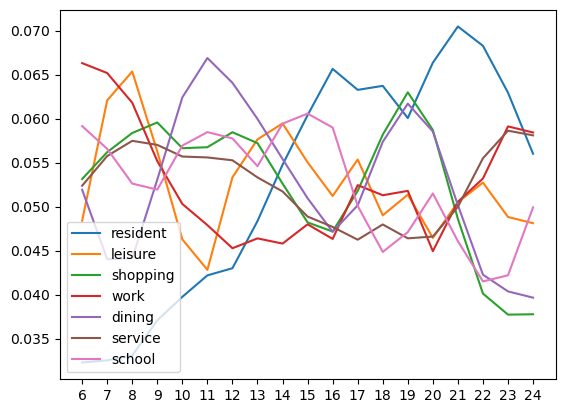

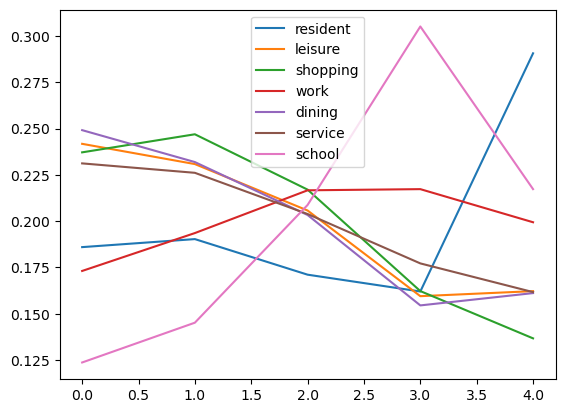

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17402/17402 [04:35<00:00, 63.17it/s]


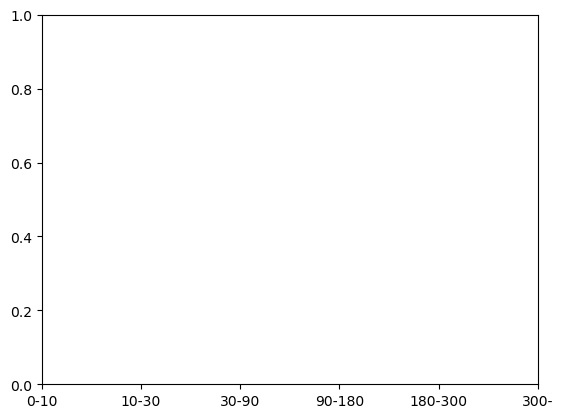

In [37]:
useinferpoisO, candidateplacesO, pd_visittime_parasO, pd_duration_parasO = run_semantic(point_poi, poly_poi, StPO)

In [84]:
def userProbability(useinferpois, candidateplaces):
    i = 0
    n = useinferpois.shape[0]
    categoryFreq = {}
    nStops = 0
    user_tfidf = []
    userProb = [{}] * 200
    while i < n:
        j = i
        while(j < n and useinferpois.iloc[j]['user'] == useinferpois.iloc[i]['user']):
            j += 1
        freq = useinferpois.iloc[i:j]['UPAPP_final'].value_counts()
        for ind, val in freq.items():
            categoryFreq[ind] = categoryFreq.get(ind,0) + val
        
        nStops += (j-i)
        i = j-1
        i += 1
        
    inverseFreq = {}
    for ind, val in categoryFreq.items():
        inverseFreq[ind] = math.log(nStops/categoryFreq.get(ind,0) ,10)
    
    i = 0
    while i < n:
        j = i
        while(j < n and useinferpois.iloc[j]['user'] == useinferpois.iloc[i]['user']):
            j += 1
        freq = useinferpois.iloc[i:j]['UPAPP_final'].value_counts()
        s = 0
        for ind, val in freq.items():
            s += val
        for ind, val in freq.items():
            freq[ind] = val / s
        
        j = i
        while(j < n and useinferpois.iloc[j]['user'] == useinferpois.iloc[i]['user']):
            user_tfidf.append(freq[useinferpois.iloc[j]['UPAPP_final']] * inverseFreq[useinferpois.iloc[j]['UPAPP_final']])
            j += 1
        
        s = sum(user_tfidf[i:j])
        j = i
        categories = {}
        while(j < n and useinferpois.iloc[j]['user'] == useinferpois.iloc[i]['user']):
            categories[useinferpois.iloc[j]['UPAPP_final']] = user_tfidf[j] / s
            j += 1
        
        userProb[useinferpois.iloc[i]['user']] = categories
        i = j-1
        i += 1
        
    return userProb

200

In [87]:

newcp

,poiname,label,datatype,id,starttime,endtime,maxradius,type,user,spid,geometry,TF-IDF,spatialpr,visittimes,durations,visitprs,durationprs,finalpr,date,userpr
0,清华大学紫荆学生公寓6号楼,resident,point,24009,2008-10-23 17:45:00,2008-10-23 18:05:19,115.309661,1.0,0,0.0,POINT (12948760.399 4867385.624),0.131689,0.256389,1065,20.316667,0.047867,0.186312,3.240352e-08,16926,0.000108
1,清华大学紫荆学生公寓5号楼,resident,point,24099,2008-10-23 17:45:00,2008-10-23 18:05:19,115.309661,1.0,0,0.0,POINT (12948789.836 4867330.760),0.131689,0.594772,1065,20.316667,0.047867,0.186312,7.516973e-08,16926,0.000108
2,清华大学紫荆学生公寓4号楼,resident,point,24205,2008-10-23 17:45:00,2008-10-23 18:05:19,115.309661,1.0,0,0.0,POINT (12948853.144 4867313.742),0.131689,0.817874,1065,20.316667,0.047867,0.186312,1.033663e-07,16926,0.000108
3,中国铁通北京北区清华支局(清华园荷清苑7东南),work,point,105393,2008-10-23 17:45:00,2008-10-23 18:05:19,115.309661,1.0,0,0.0,POINT (12948936.567 4867164.425),0.042264,0.458093,1065,20.316667,0.046098,0.171592,1.331732e-08,16926,0.000087
4,C楼理发,service,point,374101,2008-10-23 17:45:00,2008-10-23 18:05:19,115.309661,1.0,0,0.0,POINT (12948920.572 4867185.392),0.106277,0.616876,1065,20.316667,0.054666,0.231288,2.172532e-07,16926,0.000262
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1187392,国家专利技术北京展示交易中心,service,point,452888,2008-02-17 13:25:01,2008-02-17 18:30:08,100.000000,2.0,181,16925.0,POINT (12946639.491 4863458.154),0.082279,0.530527,805,305.116667,0.049839,0.163496,1.010892e-05,16926,0.028420
1187393,中国农业银行,shopping,polygon,4069,2008-02-17 13:25:01,2008-02-17 18:30:08,NaN,NaN,181,16925.0,"POLYGON ((12946443.944 4863362.812, 12946443.1...",0.316542,0.378389,805,305.116667,0.053149,0.135934,6.945626e-05,16926,0.080264
1187394,海淀基督教堂 Haidian Church,leisure,polygon,4375,2008-02-17 13:25:01,2008-02-17 18:30:08,NaN,NaN,181,16925.0,"POLYGON ((12946586.311 4863303.698, 12946595.5...",0.029137,0.091413,805,305.116667,0.059378,0.132908,8.062192e-07,16926,0.038355
1187395,北京大地花园酒店,shopping,polygon,4377,2008-02-17 13:25:01,2008-02-17 18:30:08,NaN,NaN,181,16925.0,"POLYGON ((12946444.189 4863330.661, 12946488.7...",0.316542,0.037635,805,305.116667,0.053149,0.135934,6.908262e-06,16926,0.080264


In [127]:
def reannotate(useinferpois, candidateplaces):
    
    userProb = userProbability(useinferpois, candidateplaces)
    
    newcp = candidateplaces.copy()
    probs = []
    for i in newcp.index:
        probs.append(userProb[newcp['user'][i]].get(newcp['label'][i], 0.001))
    newcp['userpr'] = probs
    newcp['finalpr'] = newcp['finalpr'] * newcp['userpr']
    
    nuip = useinferpois.copy()
    n = nuip.shape[0]
    i = 0
    cnt = 0
    
    while(i < n):
        allpt = newcp[newcp['spid'] == nuip.iloc[i]['spid']].copy()
        if len(allpt) == 0:
            i += 1
            continue
        finalprs = allpt.finalpr.to_list()
        maxfinalid = finalprs.index(max(finalprs))
        maxfinalid += allpt.head(1).index
        if(i % 1000 == 0):
            print(i)
        
        poiname = allpt['poiname'][maxfinalid].values[0]
        label = allpt['label'][maxfinalid].values[0]
#         print(poiname, type(poiname))
        cnt += (nuip.at[i,'infer_poi'] != poiname)
        nuip.at[i,'infer_poi'] = poiname
        nuip.at[i,'UPAPP_final'] = label
        i += 1
#         break
    
    change = cnt*100.0/n
    print('Updated %f%% of the total points' % change)
    return nuip

reannotate(useinferpois, candidateplaces)

0
1000
2000
3000
4000
5000
6000
8000
9000
10000
11000
12000
13000
14000
15000
16000
Updated 18.964906% of the total points


,user,date,spid,starttime,endtime,lon,lat,maxradius,type,duration,visit,geometry,labelcount_select,infer_poi,UPAPP_final
0,0,2008-10-23,0,2008-10-23 17:45:00,2008-10-23 18:05:19,116.321506,40.009010,115.309661,1,20.316667,1065,"POLYGON ((12949050.778 4867251.688, 12949049.8...","[2, 0, 1, 0, 0, 2, 5]",清华大学,school
1,0,2008-10-23,1,2008-10-23 18:44:51,2008-10-23 19:11:12,116.321692,40.008981,78.629103,1,26.350000,1124,"POLYGON ((12949071.472 4867247.500, 12949070.5...","[1, 0, 1, 0, 0, 1, 2]",清华大学,school
2,0,2008-10-24,2,2008-10-24 10:11:29,2008-10-24 10:47:06,116.322117,40.008888,93.591193,1,35.616667,611,"POLYGON ((12949118.857 4867233.974, 12949117.8...","[0, 1, 1, 1, 0, 3, 2]",清华大学,school
3,0,2008-10-24,3,2008-10-24 10:47:06,2008-10-24 23:59:59,116.320562,40.008811,100.000000,3,792.883333,647,"POLYGON ((12948945.731 4867222.753, 12948944.7...","[0, 0, 0, 0, 0, 0, 6]",清华大学,school
4,0,2008-10-28,4,2008-10-28 08:40:31,2008-10-28 09:11:36,116.296907,40.011428,91.115346,1,31.083333,520,"POLYGON ((12946312.505 4867603.107, 12946311.5...","[0, 1, 0, 0, 0, 0, 0]",圆明园遗址公园,leisure
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16921,181,2008-01-01,16921,2008-01-01 11:24:32,2008-01-01 13:48:47,116.354893,39.963453,83.187998,1,144.250000,684,"POLYGON ((12952767.477 4860632.838, 12952766.5...","[3, 0, 0, 0, 0, 1, 2]",北京邮电大学,school
16922,181,2008-01-01,16922,2008-01-01 14:19:12,2008-01-01 14:32:53,116.359711,39.961083,50.708808,1,13.683333,859,"POLYGON ((12953303.790 4860288.626, 12953302.8...","[0, 1, 1, 1, 3, 1, 4]",北京师范大学,school
16923,181,2008-01-01,16923,2008-01-01 14:42:12,2008-01-01 15:23:39,116.359130,39.959650,98.622333,1,41.450000,882,"POLYGON ((12953239.101 4860080.459, 12953238.1...","[0, 1, 0, 0, 0, 1, 4]",北京师范大学,school
16924,181,2008-01-28,16924,2008-01-28 13:45:51,2008-01-28 15:14:35,116.315378,39.894622,45.814255,1,88.733333,825,"POLYGON ((12948368.626 4850640.863, 12948367.6...","[0, 0, 2, 0, 10, 2, 0]",开元楼开封灌汤包,dining


In [123]:
18.958998%

We updated 28.985507% of the total points
